# ARIMAX_N with GRIDSEARCH_CV and PCA on ADM0, MONTHLY

In [1]:
import pandas as pd

# pd.set_option('display.max_rows', 500)
# pd.set_option('display.max_columns', 500)

import warnings
warnings.simplefilter('ignore')

import warnings
from statsmodels.tools.sm_exceptions import ConvergenceWarning
warnings.simplefilter('ignore', ConvergenceWarning)
    
import time
import datetime

import os

## Model Specifications

In [2]:
TARGET_VARIABLE = "SUM(COUNT_PRO)"
SEASONAL_PERIODICITY = 12 # for data frequency & seasonality S

SEASONALITY = False
NEIGHBORS = True # X_N
SOCIO_ECO_VARS = False # X_SE
N_LAGS_X = 1 # todo: remove or change behavior from max lags to lag
DIM_REDUCTION_METHOD = "PCA"

if SEASONALITY:
    CV_FOLDS = 5
else:
    CV_FOLDS = 1

In [3]:
MODEL_NAME = "PRO_"
if SEASONALITY:
    MODEL_NAME += "S" 
    
MODEL_NAME += "ARIMA"

if SOCIO_ECO_VARS and NEIGHBORS:
    MODEL_NAME += "X_SE+N"
    
if SOCIO_ECO_VARS and not NEIGHBORS:
    MODEL_NAME += "X_SE"
    
if not SOCIO_ECO_VARS and NEIGHBORS:
    MODEL_NAME += "X_N"
    
if SEASONAL_PERIODICITY ==  12:
    MODEL_NAME += "_MONTHLY"
elif SEASONAL_PERIODICITY == 4:
    MODEL_NAME += "_QUARTERLY"

MODEL_NAME

'PRO_ARIMAX_N_MONTHLY'

### Hyperparameter Grid

In [4]:
# create a set of sarima configs to try
PARAM_GRID = list()
# parameter options to try

### PCA
if NEIGHBORS or SOCIO_ECO_VARS:
    n_components = range(0, 4) # include up to three main components
else:
    n_components = [0]
    

### ARMA
p_params = range(4) # AR 3
d_params = range(2) # Differencing 1
q_params = range(4) # MA 3


### SEASONALITY
if SEASONALITY:
    P_params = range(3) # 5
    D_params = range(2) # 1
    Q_params = range(3) # 2
    
    ### TREND
    # t_params = ['n','c','t','ct'] # Form of Trend
    # t_params = ['n', 't', 'ct'] # Form of Trend
    t_params = ["n"]

    ### SEASONAL PERIODICITY
    m_params = [SEASONAL_PERIODICITY]   
else:
    P_params = [0]
    D_params = [0]
    Q_params = [0]

    t_params = ["n"] # Form of Trend

    m_params = [0] 

for n in n_components:
    for p in p_params:
        for d in d_params:
            for q in q_params:
                for P in P_params:
                    for D in D_params:
                        for Q in Q_params:
                            for m in m_params:
                                for t in t_params:
                                    cfg = [n, (p, d, q), (P, D, Q, m), t]
                                    PARAM_GRID.append(cfg)
len(PARAM_GRID)    

128

## Model Training

In [5]:
from common_functions import *
from forecasters import *

#### Training Method

In [6]:
def varimax(target_variable="SUM(FATALITIES)", 
            target_country="MLI", 
            predictor_countries=["BFA"], 
            n_lags_X = N_LAGS_X, 
            seasonal_periodicity = SEASONAL_PERIODICITY):
        
    ### GET DATA
    y, X = getData(target_variable = target_variable, 
                   target_country = target_country, 
                   predictor_countries = predictor_countries,
                   socio_eco_vars = SOCIO_ECO_VARS,
                   n_lags_X = N_LAGS_X, 
                   seasonal_periodicity = SEASONAL_PERIODICITY)
    
    ### SPLIT DATA
    X_train, X_test, y_train, y_test = train_test_split(y = y,
                                                        X = X, 
                                                        forecast_horizon = SEASONAL_PERIODICITY)
    
    ### TRAINING WITH GRIDSEARCHCV
    gscv = GridSearchCV(param_grid = PARAM_GRID,
                        forecaster = TimeSeriesForecasterPCA_LinInt,
                        seasonal_periodicity = SEASONAL_PERIODICITY,
                        cv_folds = CV_FOLDS)
    training_res = gscv.train(X_train, y_train)

    if training_res is not None:
        model = gscv
        # print ARIMA summary
        print(training_res)
        print(model.best_model_result.mle_retvals)
        plt.tight_layout()
        model.best_model_result.plot_diagnostics(figsize=(16*0.7, 10*0.7), lags = SEASONAL_PERIODICITY+1)
        best_parameters = str(model.best_model_cv_results)
        
    else:
        print("No model fitted --> Prediction with Naive Model ")
        model = NoChange().fit(X_train, y_train)
        best_parameters = np.nan
        
                    
    ### PREDICTION
    prediction_results = model.evaluate_model(X_test, y_test, fh = SEASONAL_PERIODICITY)
    
    ### ADJUST RESULT DF
    prediction_results["GID_0"] = target_country
    prediction_results["MONTH"] = pd.to_datetime(prediction_results["MONTH"].astype(str)) 
    prediction_results["PARAMETERS"] = best_parameters

    print(prediction_results)

    return prediction_results

#### Automated Training for all 234 Countries 

In [7]:
acled_monthly_adm0 = pd.read_csv("../data/TB003_EVENT_OUTCOMES_MONTHLY_START_DATE.csv")
gid0_neighbors = pd.read_csv("../data/GID_0_Neighbours.csv")
# gid_list = acled_monthly_adm0["GID_0"].unique()[::-1] #reverse
gid_list = acled_monthly_adm0["GID_0"].unique()
len(gid_list)

234

File already exists.
######## ABW (1/234) #########
0
Neighbor countries: []
Getting Data for ABW
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (38, 0)
y: (38, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 8 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.23104906018664842, 'fold_results': [0.23104906018664842]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_ABW   No. Observations:                   26
Model:                        SARIMAX   Log Likelihood                 -12.041
Date:                Fri, 16 Sep 2022   AIC                             26.081
Time:                        13:46:06   BIC                             27.339
Sample:                    01-31-2019   HQIC                            26.443
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.1478      0.022      6.805      0.000 

<Figure size 432x288 with 0 Axes>

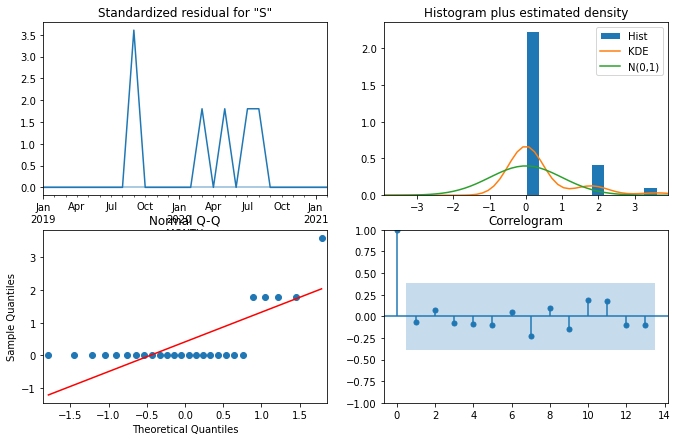

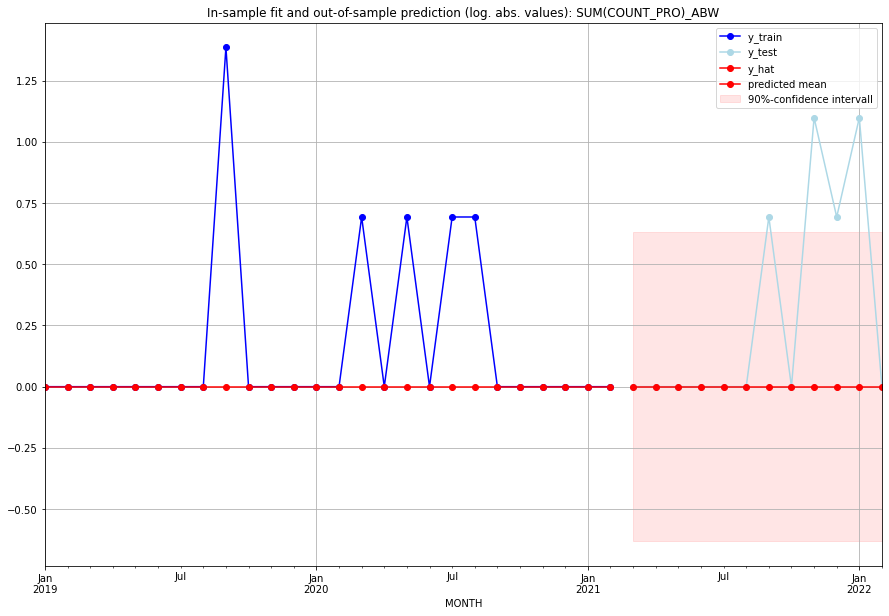

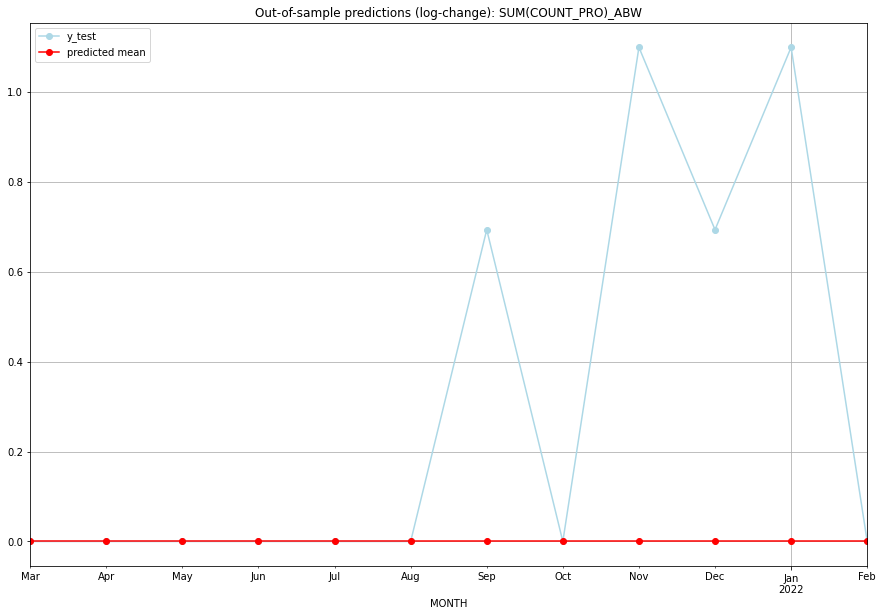

TADDA: 0.2986265782046758
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0        0.000000   ABW   
1  2021-04-01       0.0         0.0           0.0        0.000000   ABW   
2  2021-05-01       0.0         0.0           0.0        0.000000   ABW   
3  2021-06-01       0.0         0.0           0.0        0.000000   ABW   
4  2021-07-01       0.0         0.0           0.0        0.000000   ABW   
5  2021-08-01       0.0         0.0           0.0        0.000000   ABW   
6  2021-09-01       0.0         1.0           0.0        0.693147   ABW   
7  2021-10-01       0.0         0.0           0.0        0.000000   ABW   
8  2021-11-01       0.0         2.0           0.0        1.098612   ABW   
9  2021-12-01       0.0         1.0           0.0        0.693147   ABW   
10 2022-01-01       0.0         2.0           0.0        1.098612   ABW   
11 2022-02-01       0.0         0.0           0.0    

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.348608253541068, 'fold_results': [0.348608253541068]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_AFG   No. Observations:                   50
Model:               SARIMAX(0, 1, 0)   Log Likelihood                 -65.565
Date:                Fri, 16 Sep 2022   AIC                            133.129
Time:                        13:46:29   BIC                            135.021
Sample:                    01-31-2017   HQIC                           133.847
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.8506      0.211      4.035      0.000     

<Figure size 432x288 with 0 Axes>

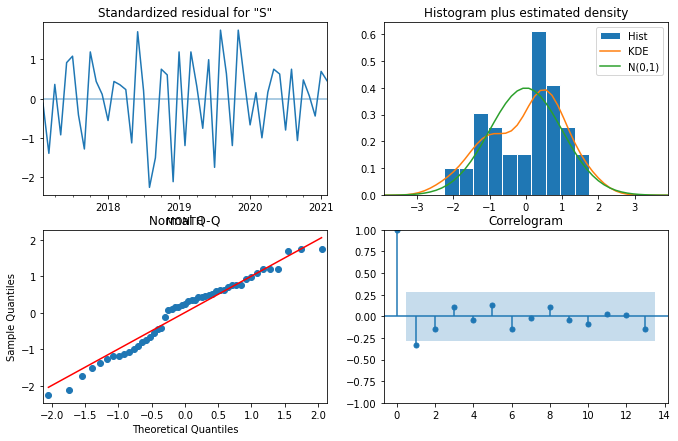

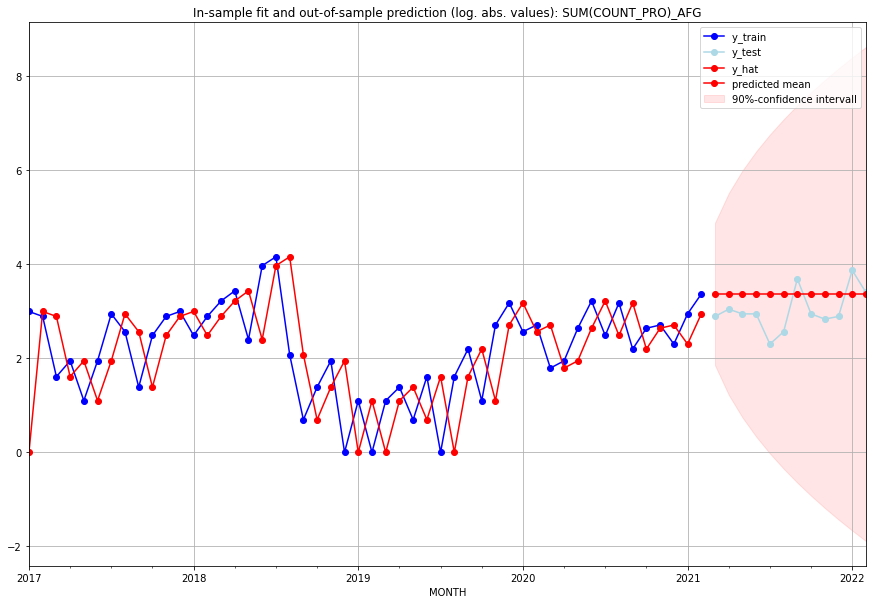

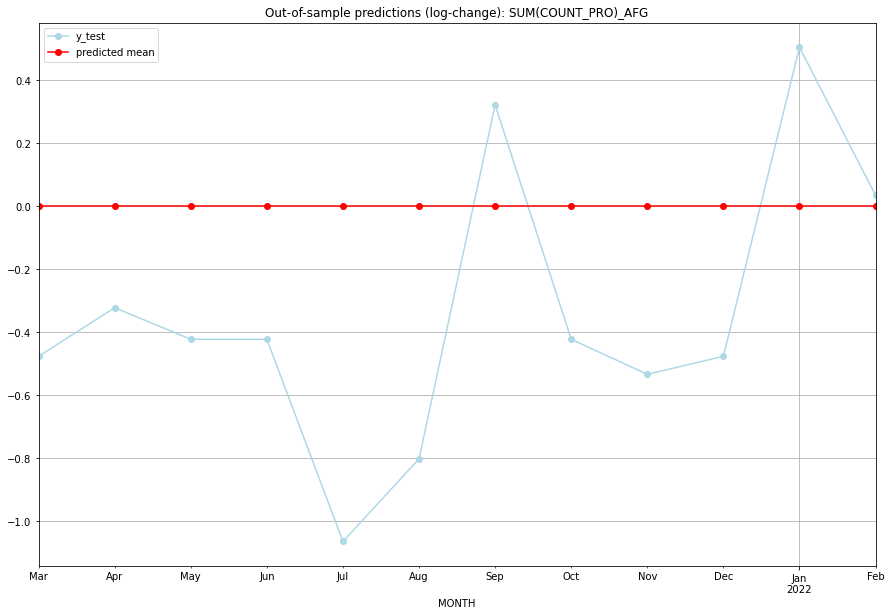

TADDA: 0.48381017842299623
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01      28.0        17.0           0.0       -0.476924   AFG   
1  2021-04-01      28.0        20.0           0.0       -0.322773   AFG   
2  2021-05-01      28.0        18.0           0.0       -0.422857   AFG   
3  2021-06-01      28.0        18.0           0.0       -0.422857   AFG   
4  2021-07-01      28.0         9.0           0.0       -1.064711   AFG   
5  2021-08-01      28.0        12.0           0.0       -0.802346   AFG   
6  2021-09-01      28.0        39.0           0.0        0.321584   AFG   
7  2021-10-01      28.0        18.0           0.0       -0.422857   AFG   
8  2021-11-01      28.0        16.0           0.0       -0.534082   AFG   
9  2021-12-01      28.0        17.0           0.0       -0.476924   AFG   
10 2022-01-01      28.0        47.0           0.0        0.503905   AFG   
11 2022-02-01      28.0        29.0           0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.4135703858549924, 'fold_results': [0.4135703858549924]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_AGO   No. Observations:                  289
Model:               SARIMAX(0, 1, 0)   Log Likelihood                -283.384
Date:                Fri, 16 Sep 2022   AIC                            568.767
Time:                        13:46:58   BIC                            572.430
Sample:                    02-28-1997   HQIC                           570.235
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.4190      0.018     23.810      0.000   

<Figure size 432x288 with 0 Axes>

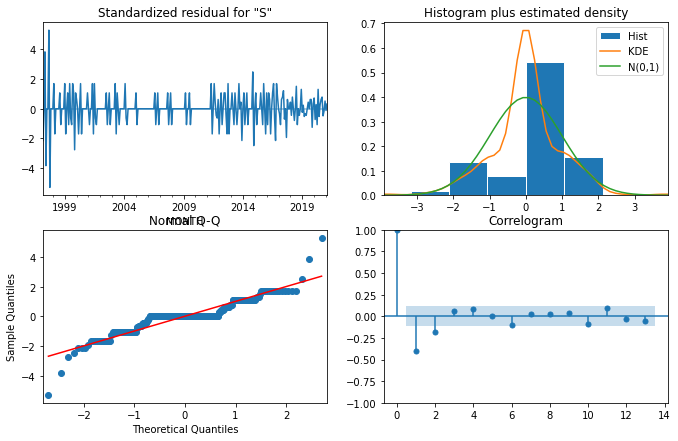

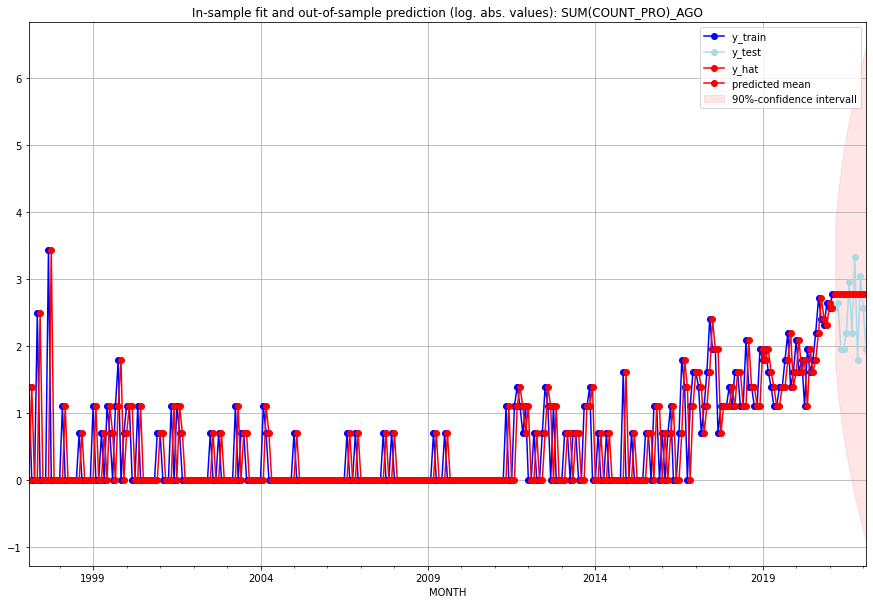

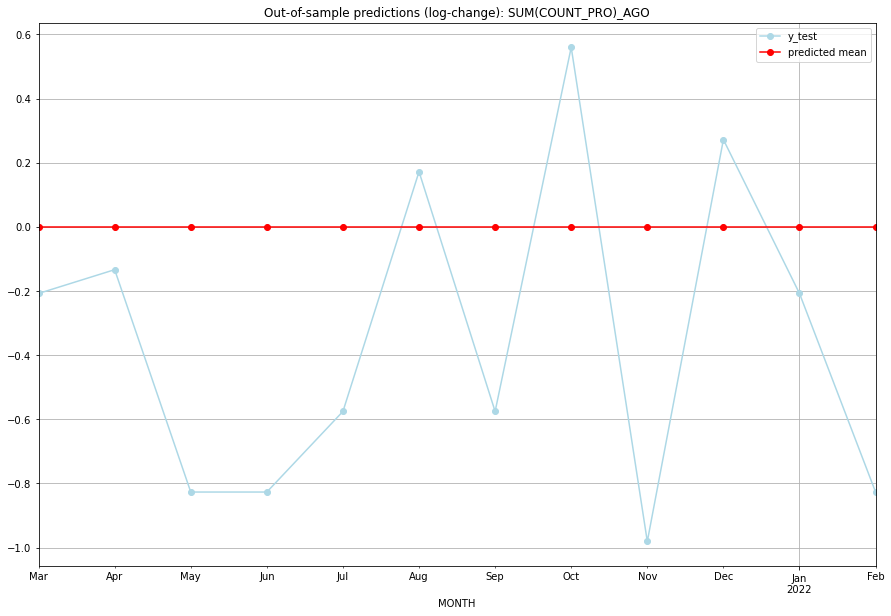

TADDA: 0.5136502620749157
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01      15.0        12.0           0.0       -0.207639   AGO   
1  2021-04-01      15.0        13.0           0.0       -0.133531   AGO   
2  2021-05-01      15.0         6.0           0.0       -0.826679   AGO   
3  2021-06-01      15.0         6.0           0.0       -0.826679   AGO   
4  2021-07-01      15.0         8.0           0.0       -0.575364   AGO   
5  2021-08-01      15.0        18.0           0.0        0.171850   AGO   
6  2021-09-01      15.0         8.0           0.0       -0.575364   AGO   
7  2021-10-01      15.0        27.0           0.0        0.559616   AGO   
8  2021-11-01      15.0         5.0           0.0       -0.980829   AGO   
9  2021-12-01      15.0        20.0           0.0        0.271934   AGO   
10 2022-01-01      15.0        12.0           0.0       -0.207639   AGO   
11 2022-02-01      15.0         6.0           0.0    

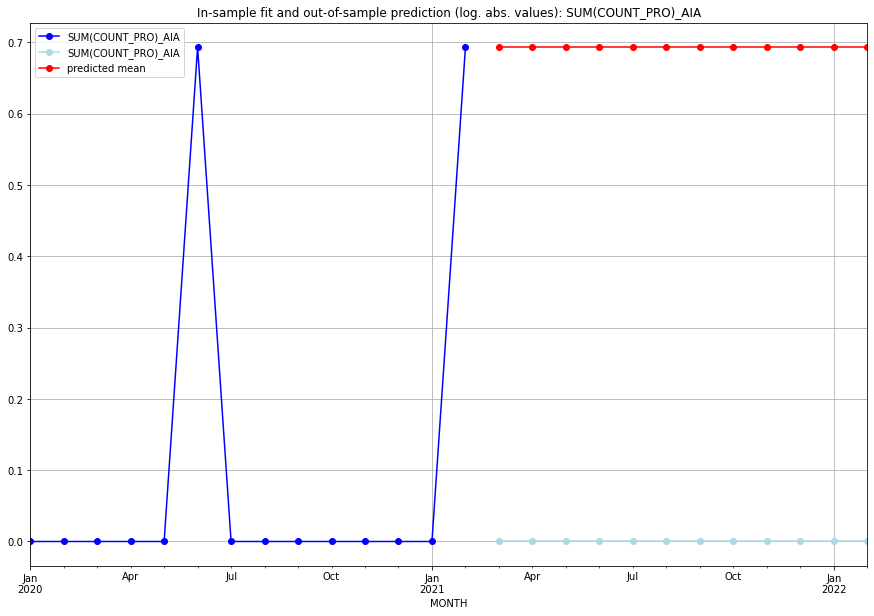

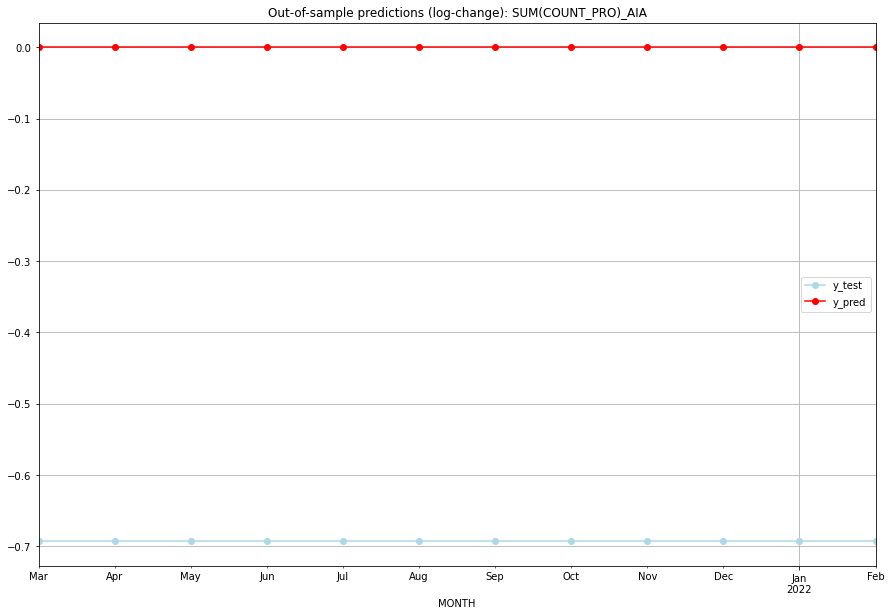

TADDA: 0.6931471805599453
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  0.693147         0.0           0.0       -0.693147   AIA   
1  2021-04-01  0.693147         0.0           0.0       -0.693147   AIA   
2  2021-05-01  0.693147         0.0           0.0       -0.693147   AIA   
3  2021-06-01  0.693147         0.0           0.0       -0.693147   AIA   
4  2021-07-01  0.693147         0.0           0.0       -0.693147   AIA   
5  2021-08-01  0.693147         0.0           0.0       -0.693147   AIA   
6  2021-09-01  0.693147         0.0           0.0       -0.693147   AIA   
7  2021-10-01  0.693147         0.0           0.0       -0.693147   AIA   
8  2021-11-01  0.693147         0.0           0.0       -0.693147   AIA   
9  2021-12-01  0.693147         0.0           0.0       -0.693147   AIA   
10 2022-01-01  0.693147         0.0           0.0       -0.693147   AIA   
11 2022-02-01  0.693147         0.0           0.0    

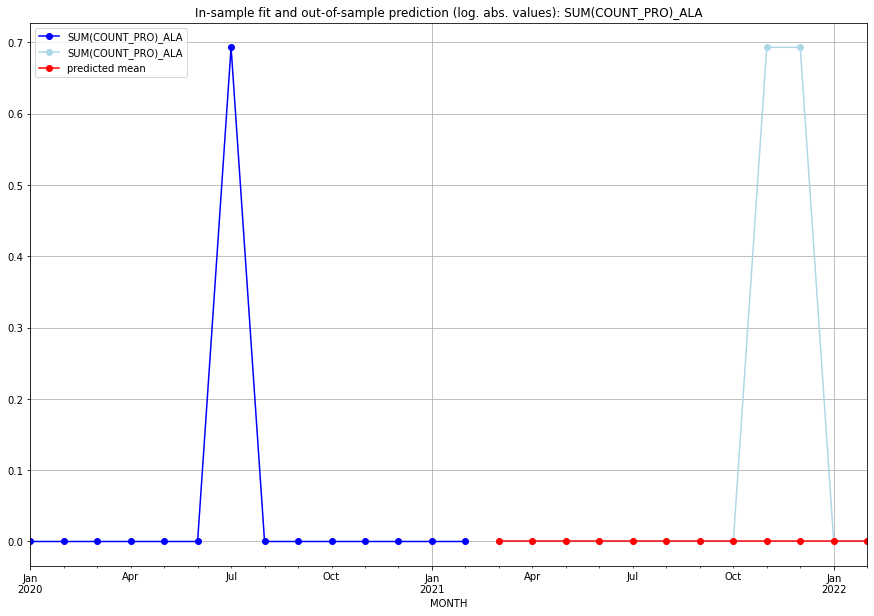

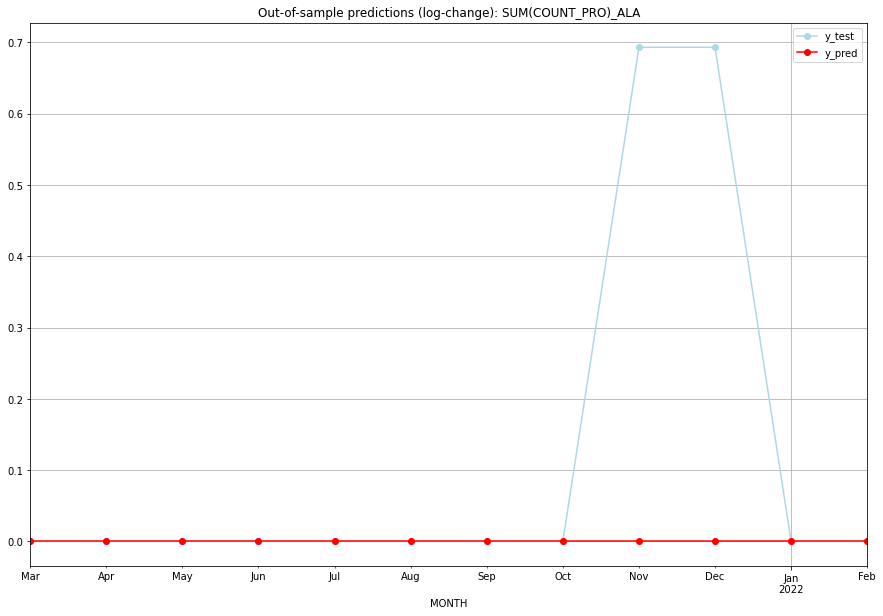

TADDA: 0.11552453009332421
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0    0.000000           0.0        0.000000   ALA   
1  2021-04-01       0.0    0.000000           0.0        0.000000   ALA   
2  2021-05-01       0.0    0.000000           0.0        0.000000   ALA   
3  2021-06-01       0.0    0.000000           0.0        0.000000   ALA   
4  2021-07-01       0.0    0.000000           0.0        0.000000   ALA   
5  2021-08-01       0.0    0.000000           0.0        0.000000   ALA   
6  2021-09-01       0.0    0.000000           0.0        0.000000   ALA   
7  2021-10-01       0.0    0.000000           0.0        0.000000   ALA   
8  2021-11-01       0.0    0.693147           0.0        0.693147   ALA   
9  2021-12-01       0.0    0.693147           0.0        0.693147   ALA   
10 2022-01-01       0.0    0.000000           0.0        0.000000   ALA   
11 2022-02-01       0.0    0.000000           0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [3, (2, 0, 1), (0, 0, 0, 0), 'n'], 'cv_score': 0.5895246196152044, 'fold_results': [0.5895246196152044]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_ALB   No. Observations:                   38
Model:               SARIMAX(2, 0, 1)   Log Likelihood                 -35.117
Date:                Fri, 16 Sep 2022   AIC                             84.233
Time:                        13:47:46   BIC                             95.696
Sample:                    01-31-2018   HQIC                            88.312
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            -0.2251      0.064     -3.543      0.000   

<Figure size 432x288 with 0 Axes>

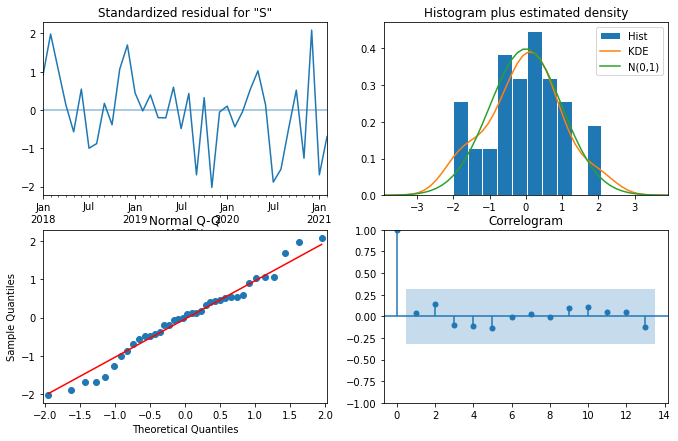

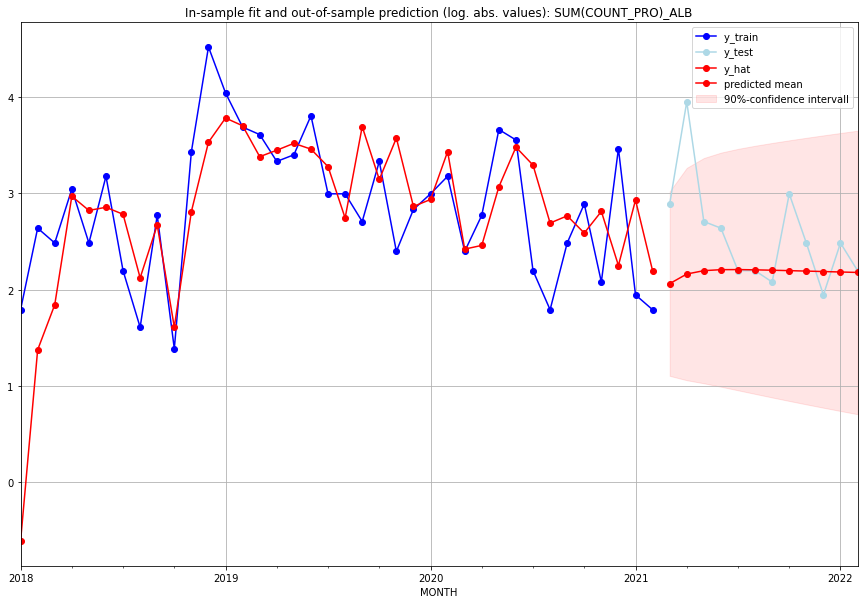

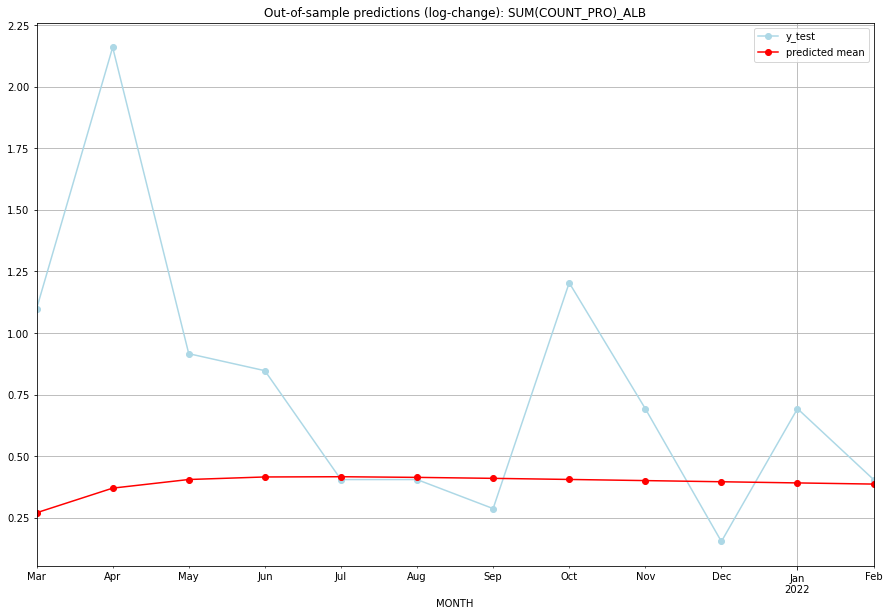

TADDA: 0.4461373308846183
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  6.865623        17.0      0.270742        1.098612   ALB   
1  2021-04-01  7.692241        51.0      0.370671        2.159484   ALB   
2  2021-05-01  8.001838        14.0      0.405669        0.916291   ALB   
3  2021-06-01  8.095223        13.0      0.415990        0.847298   ALB   
4  2021-07-01  8.103832         8.0      0.416936        0.405465   ALB   
5  2021-08-01  8.080097         8.0      0.414325        0.405465   ALB   
6  2021-09-01  8.044252         7.0      0.410370        0.287682   ALB   
7  2021-10-01  8.004008        19.0      0.405910        1.203973   ALB   
8  2021-11-01  7.962290        11.0      0.401266        0.693147   ALB   
9  2021-12-01  7.920203         6.0      0.396559        0.154151   ALB   
10 2022-01-01  7.878164        11.0      0.391835        0.693147   ALB   
11 2022-02-01  7.836331         8.0      0.387112    

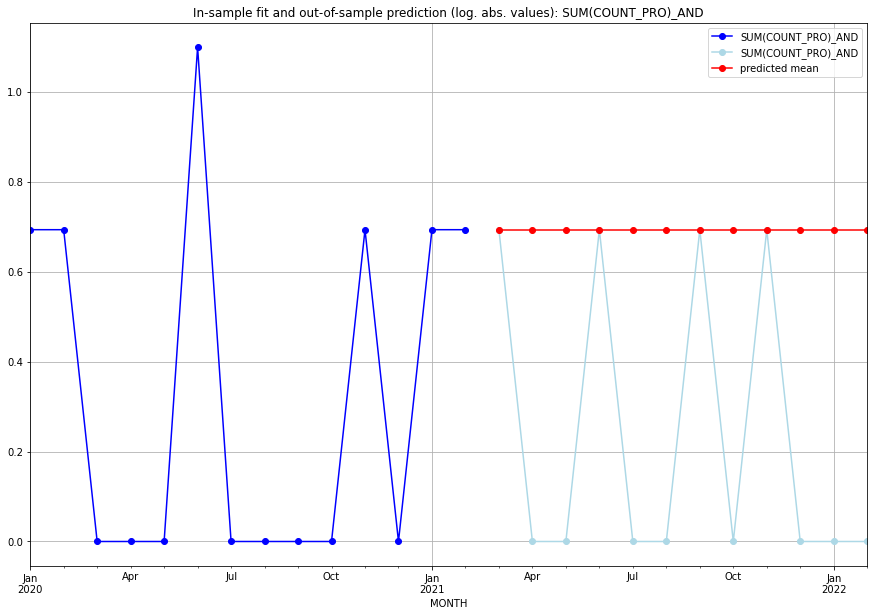

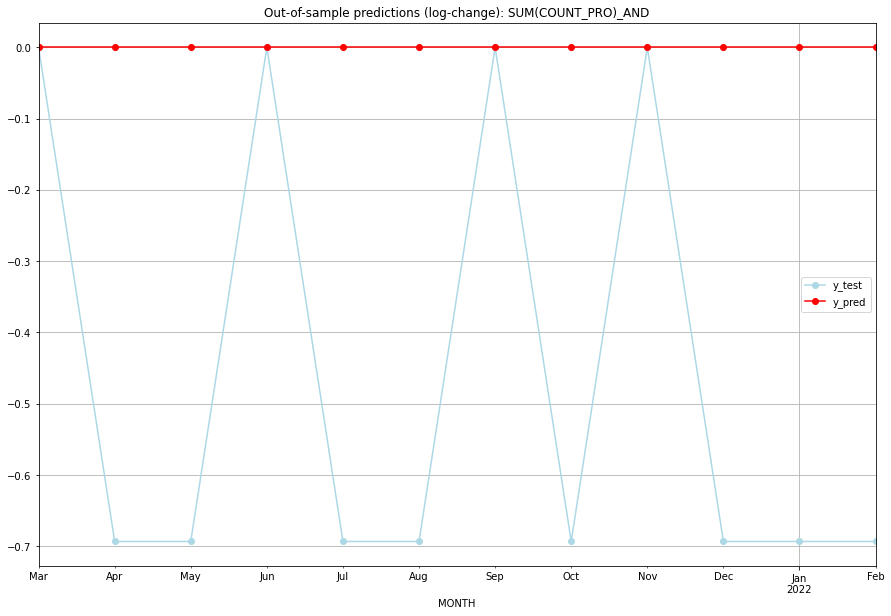

TADDA: 0.46209812037329684
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  0.693147    0.693147           0.0        0.000000   AND   
1  2021-04-01  0.693147    0.000000           0.0       -0.693147   AND   
2  2021-05-01  0.693147    0.000000           0.0       -0.693147   AND   
3  2021-06-01  0.693147    0.693147           0.0        0.000000   AND   
4  2021-07-01  0.693147    0.000000           0.0       -0.693147   AND   
5  2021-08-01  0.693147    0.000000           0.0       -0.693147   AND   
6  2021-09-01  0.693147    0.693147           0.0        0.000000   AND   
7  2021-10-01  0.693147    0.000000           0.0       -0.693147   AND   
8  2021-11-01  0.693147    0.693147           0.0        0.000000   AND   
9  2021-12-01  0.693147    0.000000           0.0       -0.693147   AND   
10 2022-01-01  0.693147    0.000000           0.0       -0.693147   AND   
11 2022-02-01  0.693147    0.000000           0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.0, 'fold_results': [0.0]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_ARE   No. Observations:                   50
Model:                        SARIMAX   Log Likelihood                  17.714
Date:                Fri, 16 Sep 2022   AIC                            -33.428
Time:                        13:48:12   BIC                            -31.516
Sample:                    01-31-2017   HQIC                           -32.700
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.0288      0.002     13.994      0.000       0.025       0.033
Ljung-Bo

<Figure size 432x288 with 0 Axes>

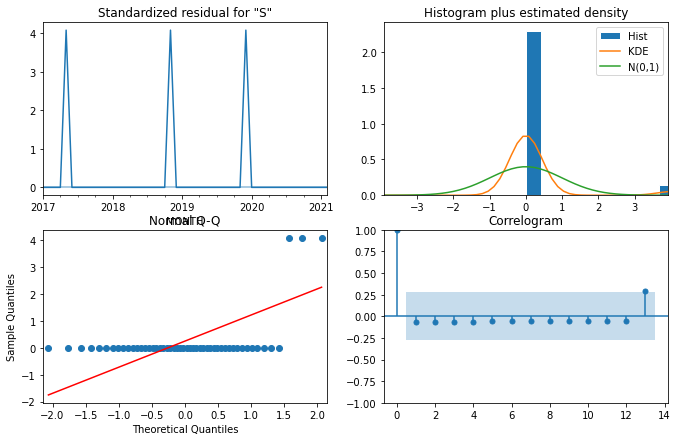

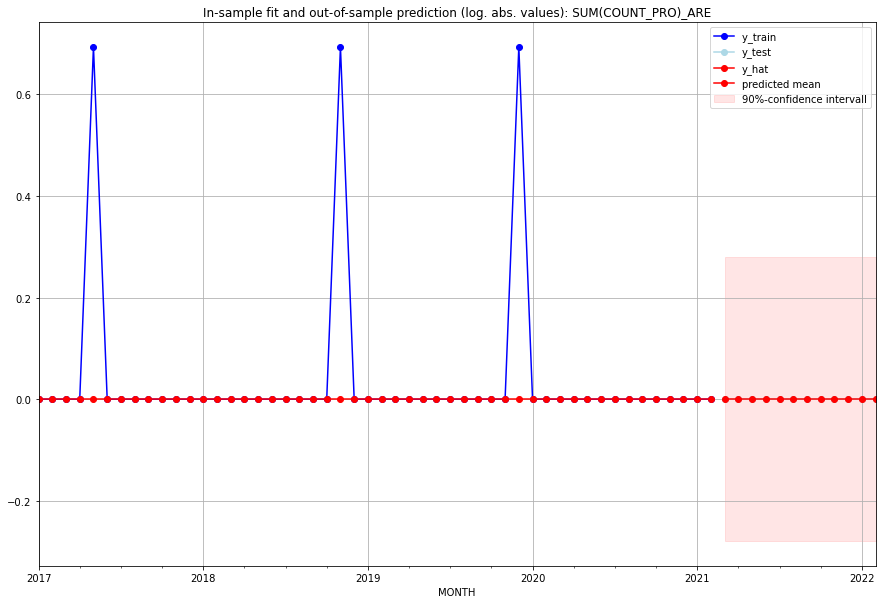

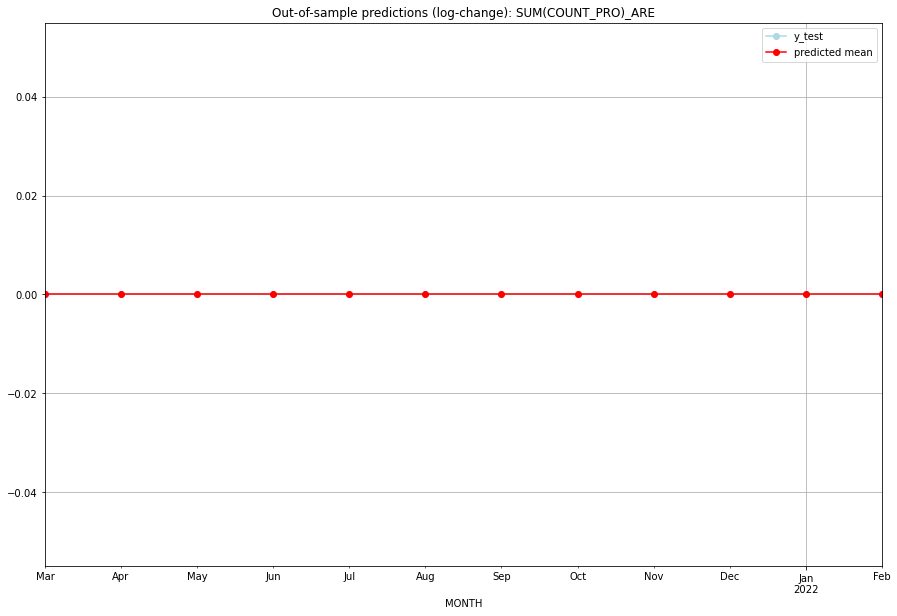

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   ARE   
1  2021-04-01       0.0         0.0           0.0             0.0   ARE   
2  2021-05-01       0.0         0.0           0.0             0.0   ARE   
3  2021-06-01       0.0         0.0           0.0             0.0   ARE   
4  2021-07-01       0.0         0.0           0.0             0.0   ARE   
5  2021-08-01       0.0         0.0           0.0             0.0   ARE   
6  2021-09-01       0.0         0.0           0.0             0.0   ARE   
7  2021-10-01       0.0         0.0           0.0             0.0   ARE   
8  2021-11-01       0.0         0.0           0.0             0.0   ARE   
9  2021-12-01       0.0         0.0           0.0             0.0   ARE   
10 2022-01-01       0.0         0.0           0.0             0.0   ARE   
11 2022-02-01       0.0         0.0           0.0             0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (2, 1, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.40547537200590567, 'fold_results': [0.40547537200590567]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_ARG   No. Observations:                   38
Model:               SARIMAX(2, 1, 3)   Log Likelihood                  -8.448
Date:                Fri, 16 Sep 2022   AIC                             28.896
Time:                        13:48:34   BIC                             38.562
Sample:                    01-31-2018   HQIC                            32.304
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -1.1383      0.386     -2.950      0.003 

<Figure size 432x288 with 0 Axes>

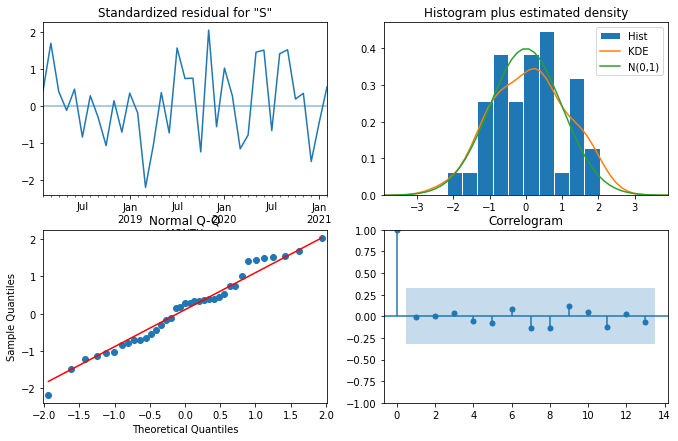

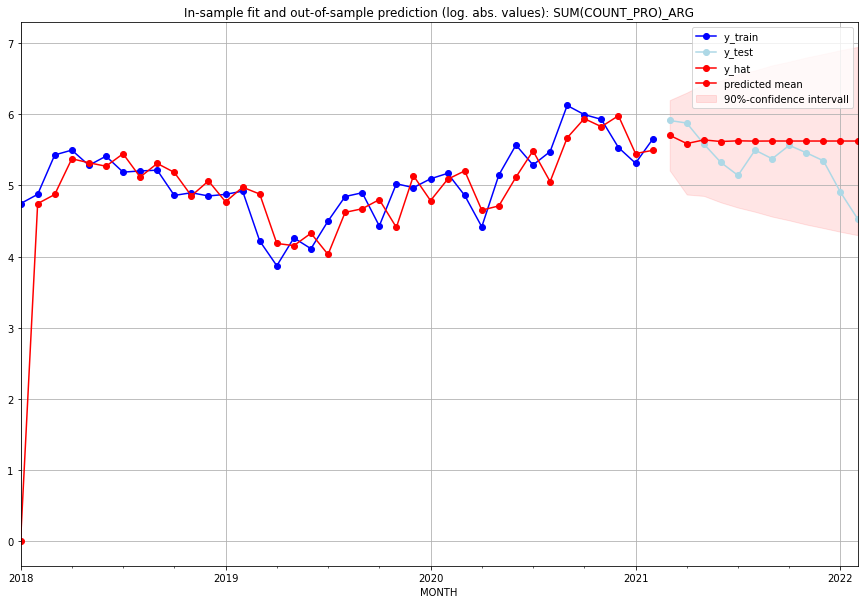

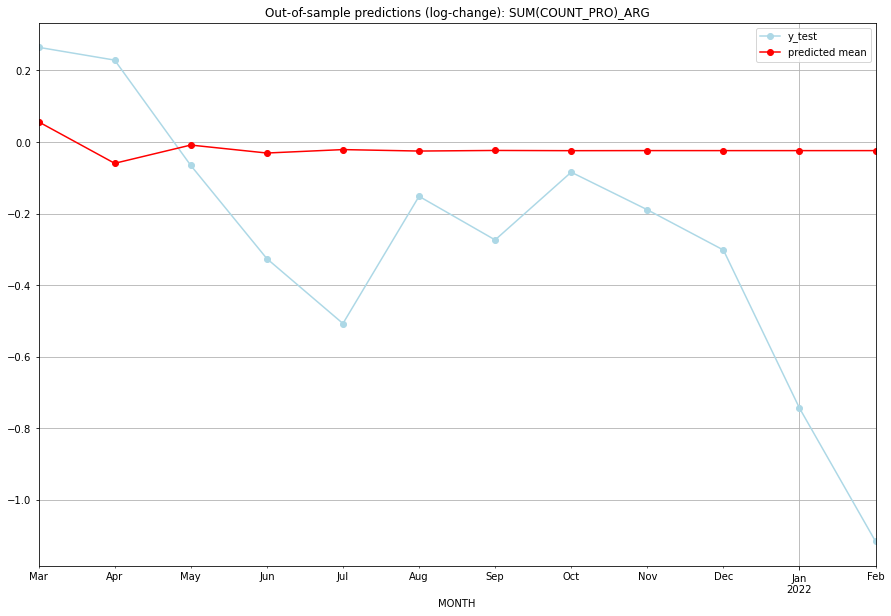

TADDA: 0.3404649373701658
Evaluation finished.
        MONTH    FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  299.456437       369.0      0.056329        0.264529   ARG   
1  2021-04-01  266.562991       356.0     -0.059619        0.228762   ARG   
2  2021-05-01  280.563009       265.0     -0.008618       -0.065478   ARG   
3  2021-06-01  274.364794       204.0     -0.030877       -0.325964   ARG   
4  2021-07-01  277.019078       170.0     -0.021285       -0.507311   ARG   
5  2021-08-01  275.895988       243.0     -0.025332       -0.151806   ARG   
6  2021-09-01  276.352156       215.0     -0.023686       -0.273696   ARG   
7  2021-10-01  276.179112       260.0     -0.024310       -0.084454   ARG   
8  2021-11-01  276.235178       234.0     -0.024108       -0.189389   ARG   
9  2021-12-01  276.224767       209.0     -0.024146       -0.301867   ARG   
10 2022-01-01  276.219309       134.0     -0.024165       -0.743699   ARG   
11 2022-02-01  276.228736    

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [2, (3, 1, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.5039076651767173, 'fold_results': [0.5039076651767173]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_ARM   No. Observations:                   38
Model:               SARIMAX(3, 1, 3)   Log Likelihood                 -25.417
Date:                Fri, 16 Sep 2022   AIC                             68.834
Time:                        13:48:56   BIC                             83.332
Sample:                    01-31-2018   HQIC                            73.945
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1             0.1748      0.124      1.406      0.160   

<Figure size 432x288 with 0 Axes>

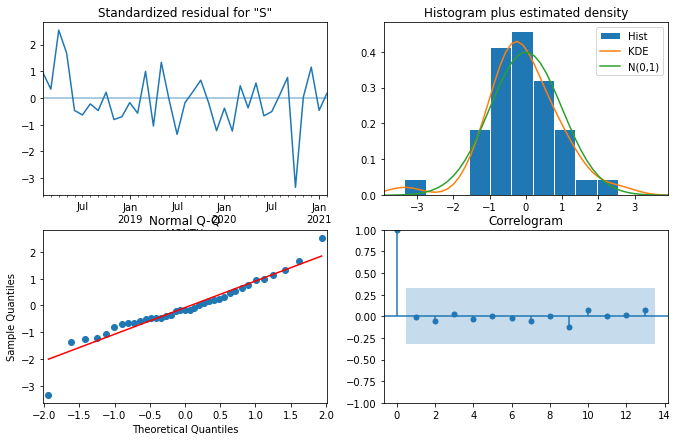

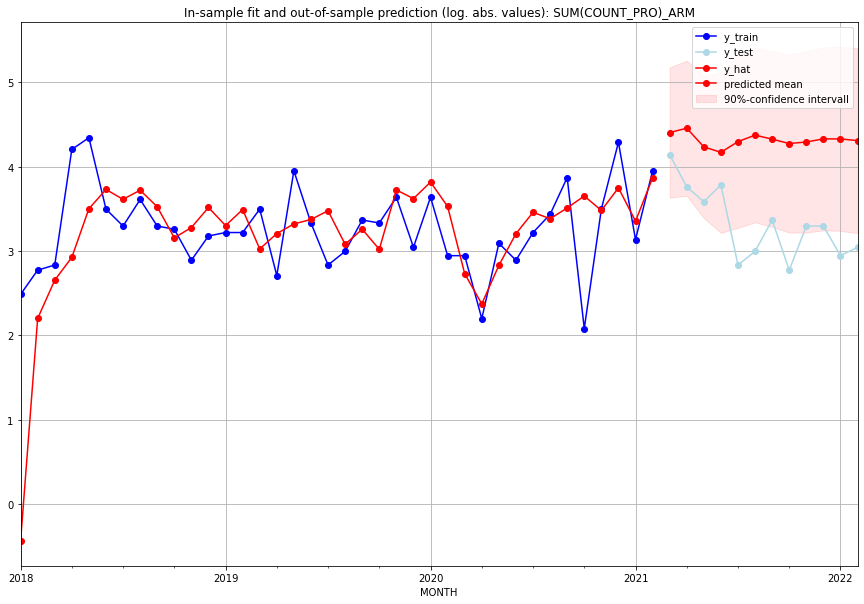

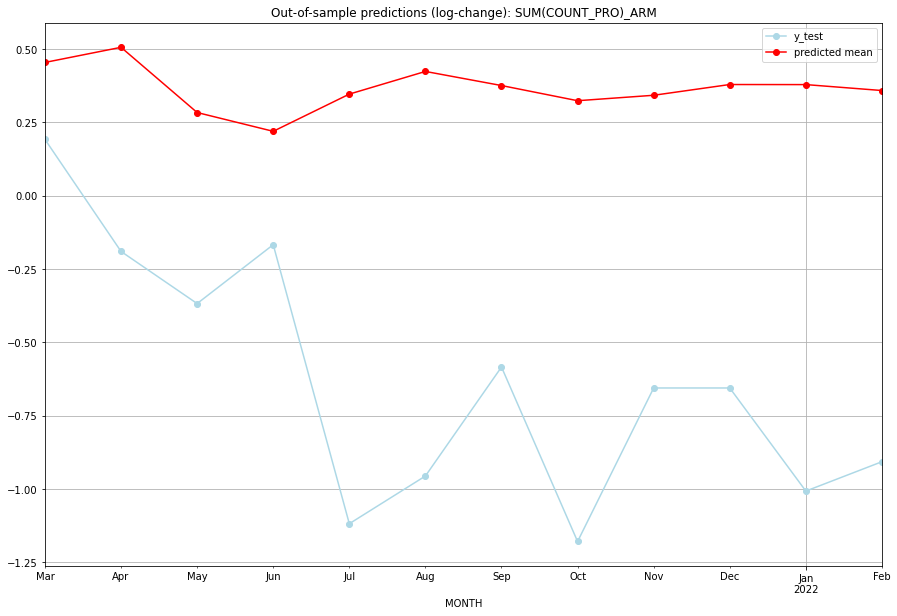

TADDA: 1.326582254445677
Evaluation finished.
        MONTH   FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  80.892166        62.0      0.454160        0.191891   ARM   
1  2021-04-01  85.227235        42.0      0.505742       -0.190044   ARM   
2  2021-05-01  68.040851        35.0      0.283455       -0.367725   ARM   
3  2021-06-01  63.757765        43.0      0.219410       -0.167054   ARM   
4  2021-07-01  72.513193        16.0      0.346221       -1.118030   ARM   
5  2021-08-01  78.418466        19.0      0.423487       -0.955511   ARM   
6  2021-09-01  74.692035        28.0      0.375429       -0.583948   ARM   
7  2021-10-01  70.877451        15.0      0.323719       -1.178655   ARM   
8  2021-11-01  72.222126        26.0      0.342254       -0.655407   ARM   
9  2021-12-01  74.956563        26.0      0.378918       -0.655407   ARM   
10 2022-01-01  74.934811        18.0      0.378632       -1.006805   ARM   
11 2022-02-01  73.416879        20.0      

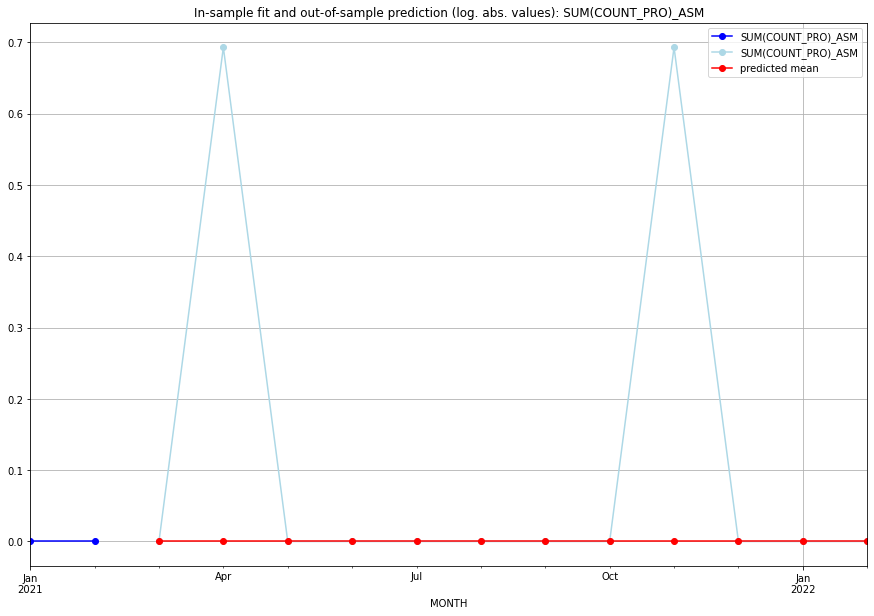

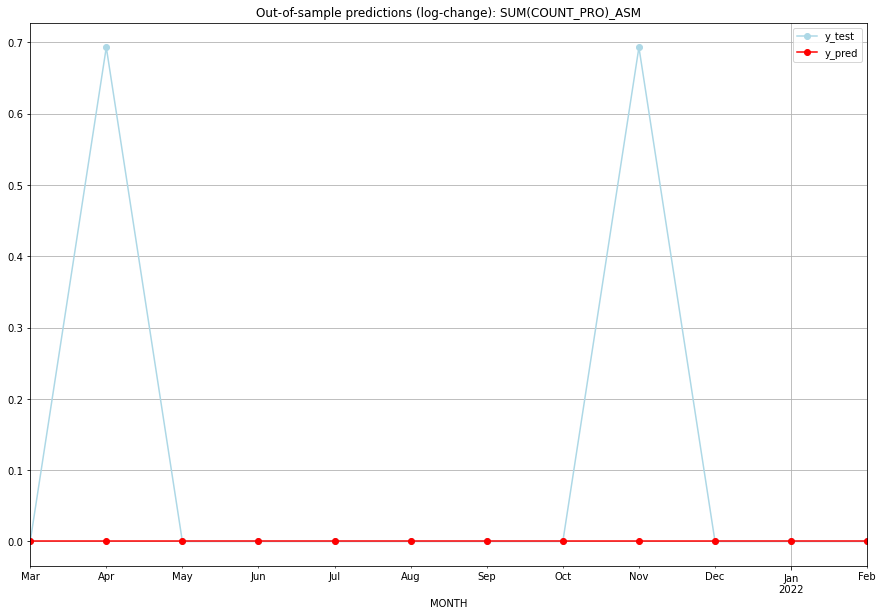

TADDA: 0.11552453009332421
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0    0.000000           0.0        0.000000   ASM   
1  2021-04-01       0.0    0.693147           0.0        0.693147   ASM   
2  2021-05-01       0.0    0.000000           0.0        0.000000   ASM   
3  2021-06-01       0.0    0.000000           0.0        0.000000   ASM   
4  2021-07-01       0.0    0.000000           0.0        0.000000   ASM   
5  2021-08-01       0.0    0.000000           0.0        0.000000   ASM   
6  2021-09-01       0.0    0.000000           0.0        0.000000   ASM   
7  2021-10-01       0.0    0.000000           0.0        0.000000   ASM   
8  2021-11-01       0.0    0.693147           0.0        0.693147   ASM   
9  2021-12-01       0.0    0.000000           0.0        0.000000   ASM   
10 2022-01-01       0.0    0.000000           0.0        0.000000   ASM   
11 2022-02-01       0.0    0.000000           0.0   

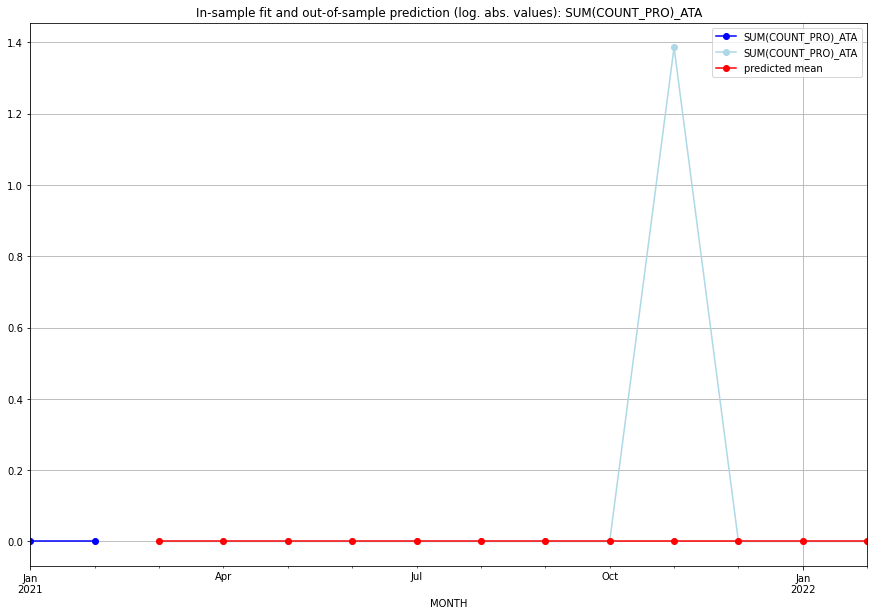

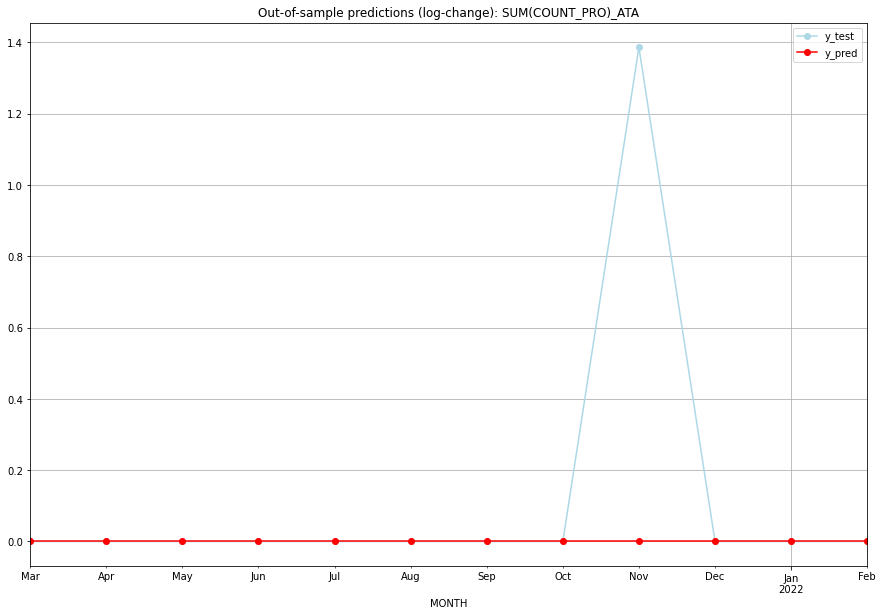

TADDA: 0.11552453009332421
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0    0.000000           0.0        0.000000   ATA   
1  2021-04-01       0.0    0.000000           0.0        0.000000   ATA   
2  2021-05-01       0.0    0.000000           0.0        0.000000   ATA   
3  2021-06-01       0.0    0.000000           0.0        0.000000   ATA   
4  2021-07-01       0.0    0.000000           0.0        0.000000   ATA   
5  2021-08-01       0.0    0.000000           0.0        0.000000   ATA   
6  2021-09-01       0.0    0.000000           0.0        0.000000   ATA   
7  2021-10-01       0.0    0.000000           0.0        0.000000   ATA   
8  2021-11-01       0.0    1.386294           0.0        1.386294   ATA   
9  2021-12-01       0.0    0.000000           0.0        0.000000   ATA   
10 2022-01-01       0.0    0.000000           0.0        0.000000   ATA   
11 2022-02-01       0.0    0.000000           0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (2, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.355250958034792, 'fold_results': [0.355250958034792]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_ATG   No. Observations:                   38
Model:               SARIMAX(2, 0, 0)   Log Likelihood                 -30.021
Date:                Fri, 16 Sep 2022   AIC                             66.043
Time:                        13:49:25   BIC                             70.956
Sample:                    01-31-2018   HQIC                            67.791
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.3017      0.196      1.542      0.123     

<Figure size 432x288 with 0 Axes>

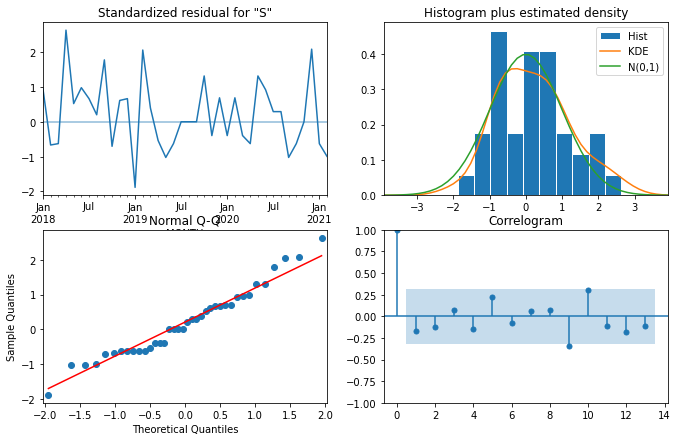

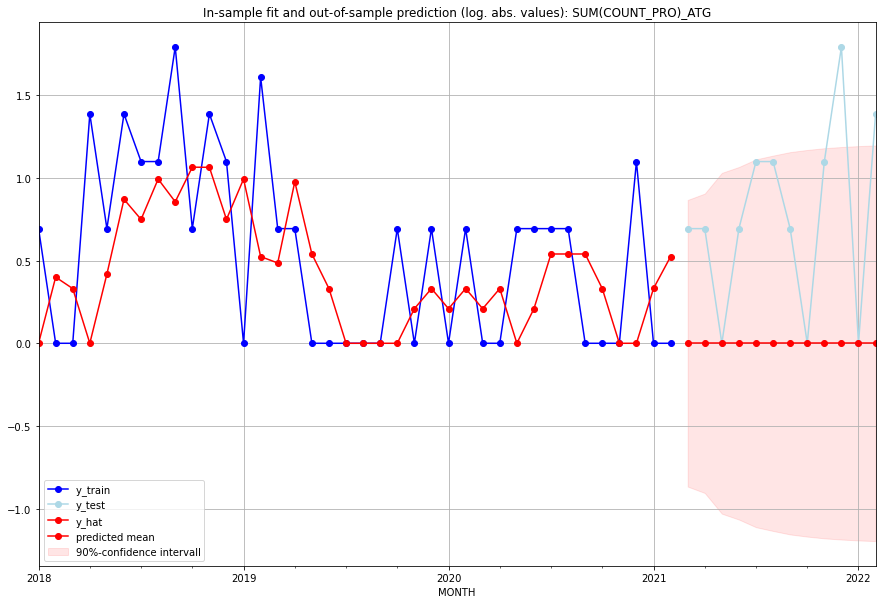

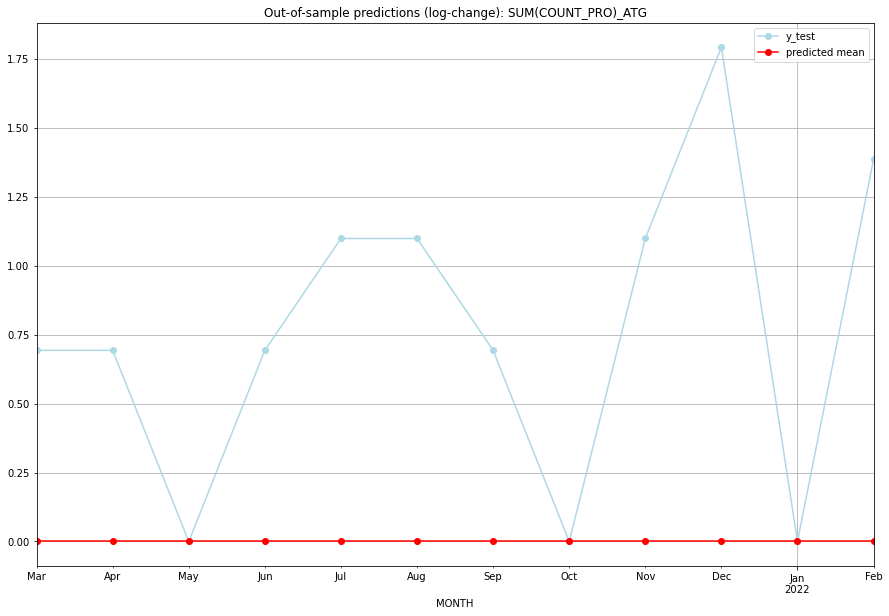

TADDA: 0.770539951549338
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         1.0  2.251400e-17        0.693147   ATG   
1  2021-04-01       0.0         1.0  9.073031e-18        0.693147   ATG   
2  2021-05-01       0.0         0.0  1.347794e-17        0.000000   ATG   
3  2021-06-01       0.0         1.0  8.394373e-18        0.693147   ATG   
4  2021-07-01       0.0         2.0  8.962316e-18        1.098612   ATG   
5  2021-08-01       0.0         2.0  6.708390e-18        1.098612   ATG   
6  2021-09-01       0.0         1.0  6.299410e-18        0.693147   ATG   
7  2021-10-01       0.0         0.0  5.100738e-18        0.000000   ATG   
8  2021-11-01       0.0         2.0  4.544025e-18        1.098612   ATG   
9  2021-12-01       0.0         5.0  3.804224e-18        1.791759   ATG   
10 2022-01-01       0.0         0.0  3.315456e-18        0.000000   ATG   
11 2022-02-01       0.0         3.0  2.815069e-18     

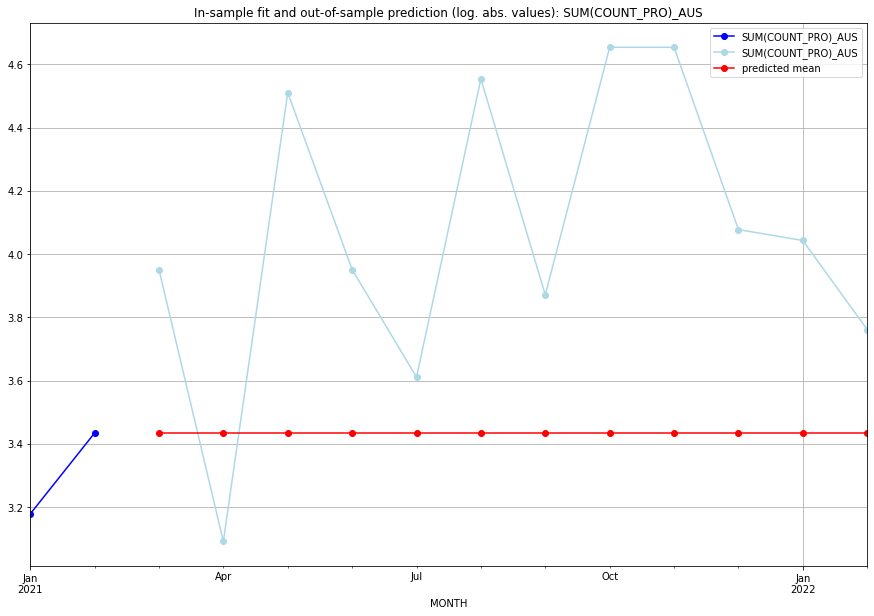

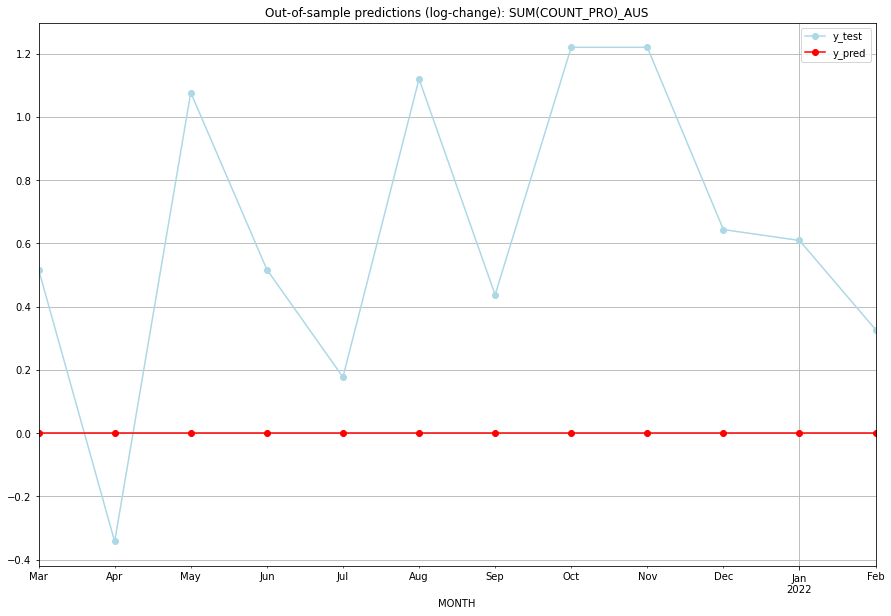

TADDA: 0.6840114823642883
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  3.433987    3.951244           0.0        0.517257   AUS   
1  2021-04-01  3.433987    3.091042           0.0       -0.342945   AUS   
2  2021-05-01  3.433987    4.510860           0.0        1.076872   AUS   
3  2021-06-01  3.433987    3.951244           0.0        0.517257   AUS   
4  2021-07-01  3.433987    3.610918           0.0        0.176931   AUS   
5  2021-08-01  3.433987    4.553877           0.0        1.119890   AUS   
6  2021-09-01  3.433987    3.871201           0.0        0.437214   AUS   
7  2021-10-01  3.433987    4.653960           0.0        1.219973   AUS   
8  2021-11-01  3.433987    4.653960           0.0        1.219973   AUS   
9  2021-12-01  3.433987    4.077537           0.0        0.643550   AUS   
10 2022-01-01  3.433987    4.043051           0.0        0.609064   AUS   
11 2022-02-01  3.433987    3.761200           0.0    

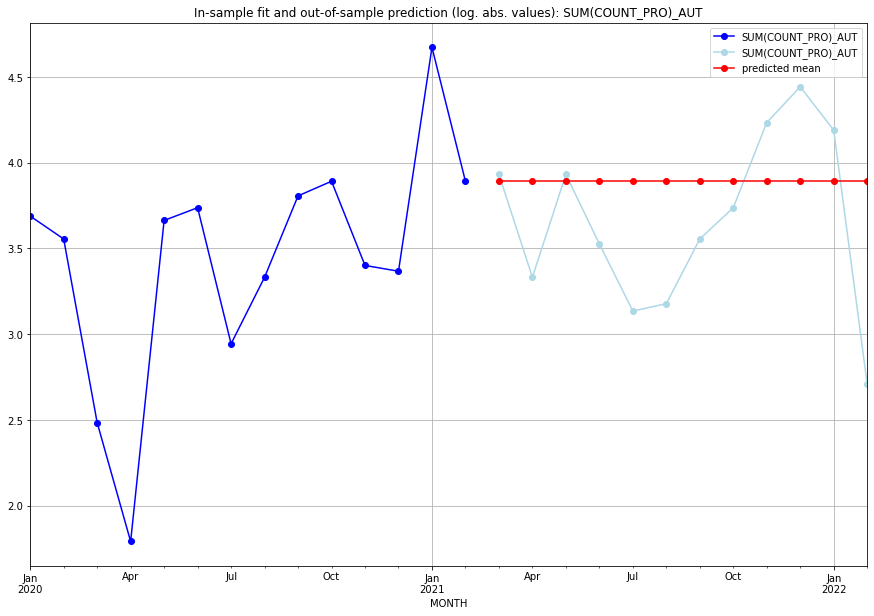

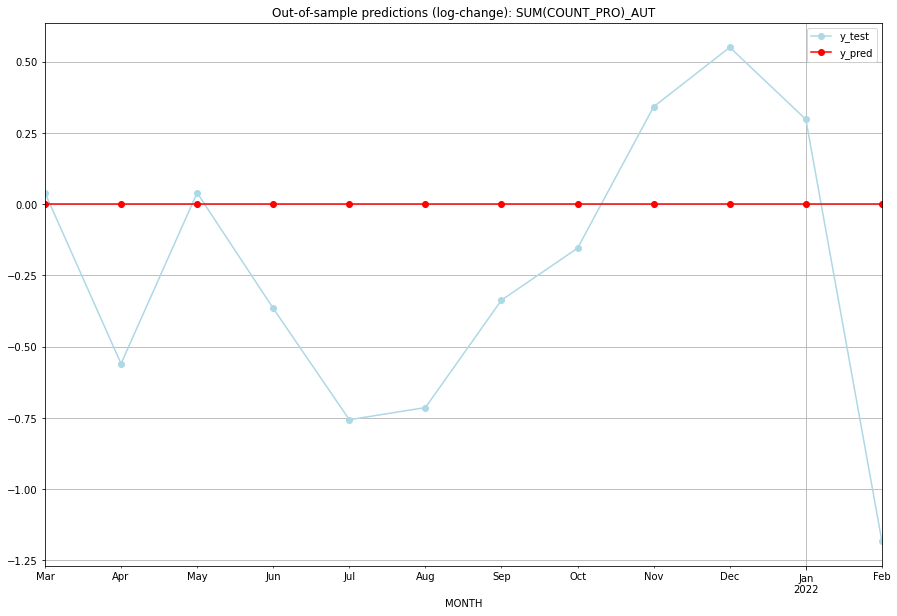

TADDA: 0.44504361690337113
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01   3.89182    3.931826           0.0        0.040005   AUT   
1  2021-04-01   3.89182    3.332205           0.0       -0.559616   AUT   
2  2021-05-01   3.89182    3.931826           0.0        0.040005   AUT   
3  2021-06-01   3.89182    3.526361           0.0       -0.365460   AUT   
4  2021-07-01   3.89182    3.135494           0.0       -0.756326   AUT   
5  2021-08-01   3.89182    3.178054           0.0       -0.713766   AUT   
6  2021-09-01   3.89182    3.555348           0.0       -0.336472   AUT   
7  2021-10-01   3.89182    3.737670           0.0       -0.154151   AUT   
8  2021-11-01   3.89182    4.234107           0.0        0.342286   AUT   
9  2021-12-01   3.89182    4.442651           0.0        0.550831   AUT   
10 2022-01-01   3.89182    4.189655           0.0        0.297834   AUT   
11 2022-02-01   3.89182    2.708050           0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [2, (2, 1, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.726159344510084, 'fold_results': [0.726159344510084]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_AZE   No. Observations:                   38
Model:               SARIMAX(2, 1, 3)   Log Likelihood                 -38.253
Date:                Fri, 16 Sep 2022   AIC                             92.505
Time:                        13:49:59   BIC                            105.392
Sample:                    01-31-2018   HQIC                            97.048
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            -0.0042      0.040     -0.104      0.918     

<Figure size 432x288 with 0 Axes>

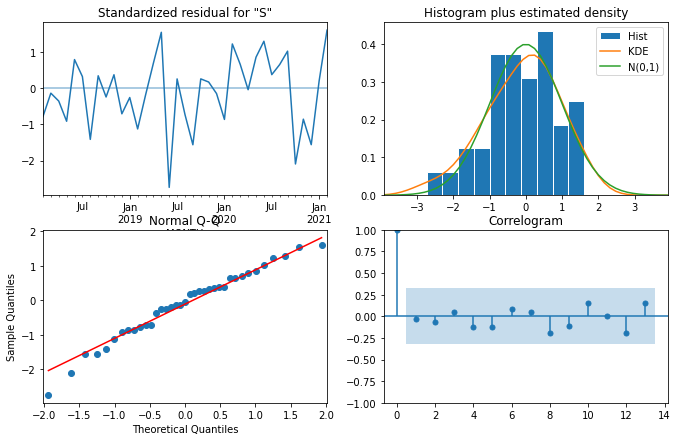

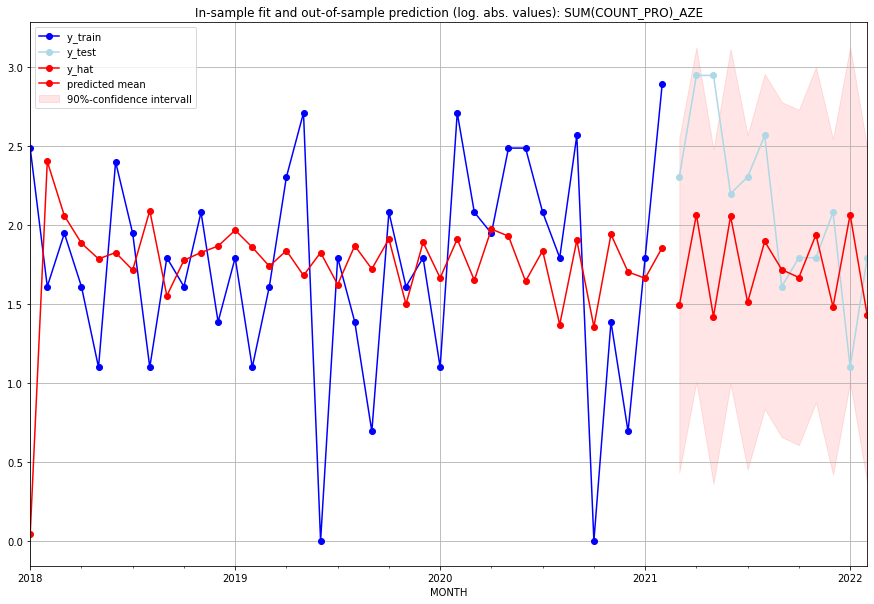

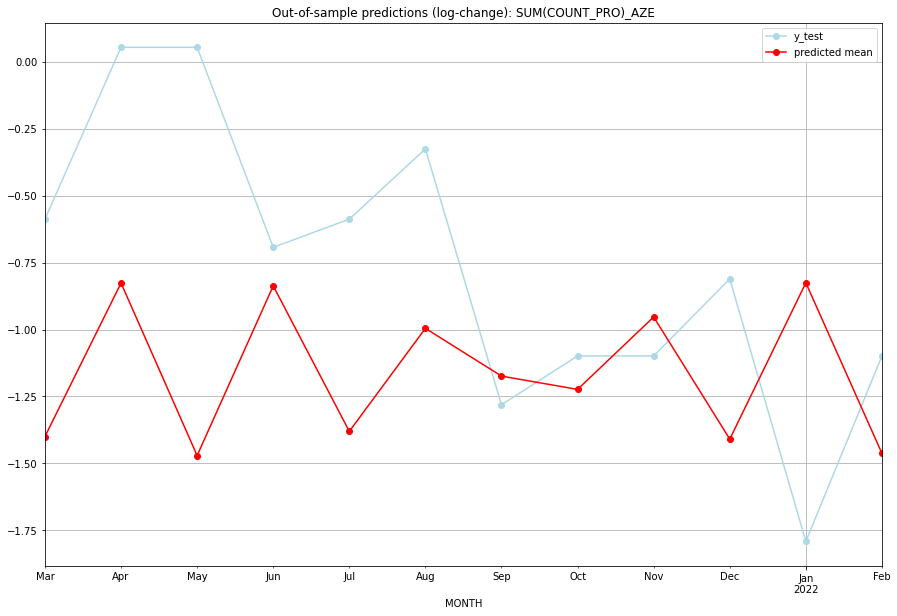

TADDA: 0.7856395974704538
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  3.439533         9.0     -1.399823       -0.587787   AZE   
1  2021-04-01  6.876734        18.0     -0.826458        0.054067   AZE   
2  2021-05-01  3.135024        18.0     -1.470879        0.054067   AZE   
3  2021-06-01  6.794198         8.0     -0.836992       -0.693147   AZE   
4  2021-07-01  3.526453         9.0     -1.380433       -0.587787   AZE   
5  2021-08-01  5.651038        12.0     -0.995599       -0.325422   AZE   
6  2021-09-01  4.564509         4.0     -1.173963       -1.280934   AZE   
7  2021-10-01  4.294603         5.0     -1.223684       -1.098612   AZE   
8  2021-11-01  5.939613         5.0     -0.953126       -1.098612   AZE   
9  2021-12-01  3.397002         7.0     -1.409449       -0.810930   AZE   
10 2022-01-01  6.882590         2.0     -0.825715       -1.791759   AZE   
11 2022-02-01  3.169051         5.0     -1.462683    

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.4984161039367238, 'fold_results': [0.4984161039367238]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_BDI   No. Observations:                  289
Model:               SARIMAX(0, 1, 0)   Log Likelihood                -283.303
Date:                Fri, 16 Sep 2022   AIC                            568.606
Time:                        13:50:25   BIC                            572.268
Sample:                    02-28-1997   HQIC                           570.073
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.4187      0.017     24.412      0.000   

<Figure size 432x288 with 0 Axes>

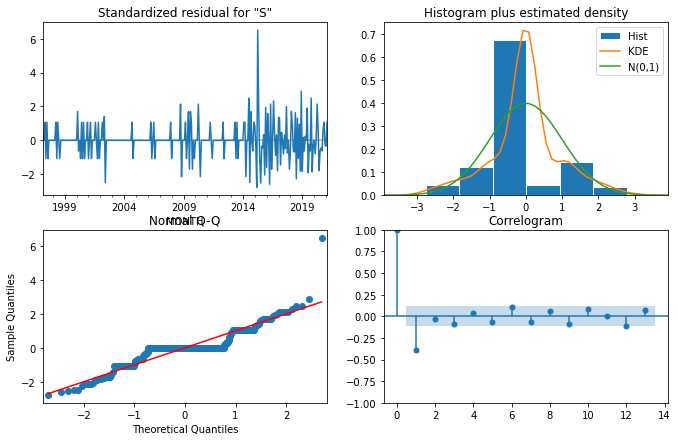

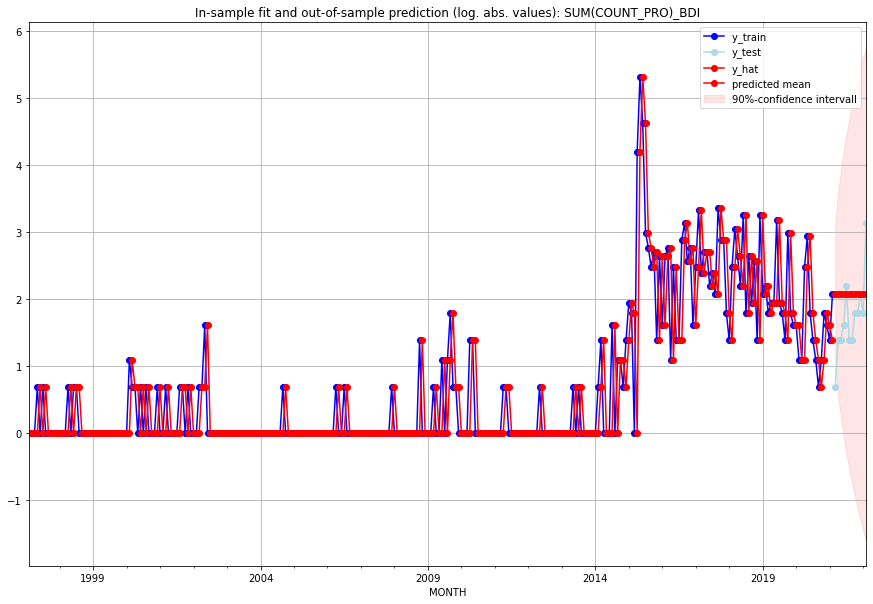

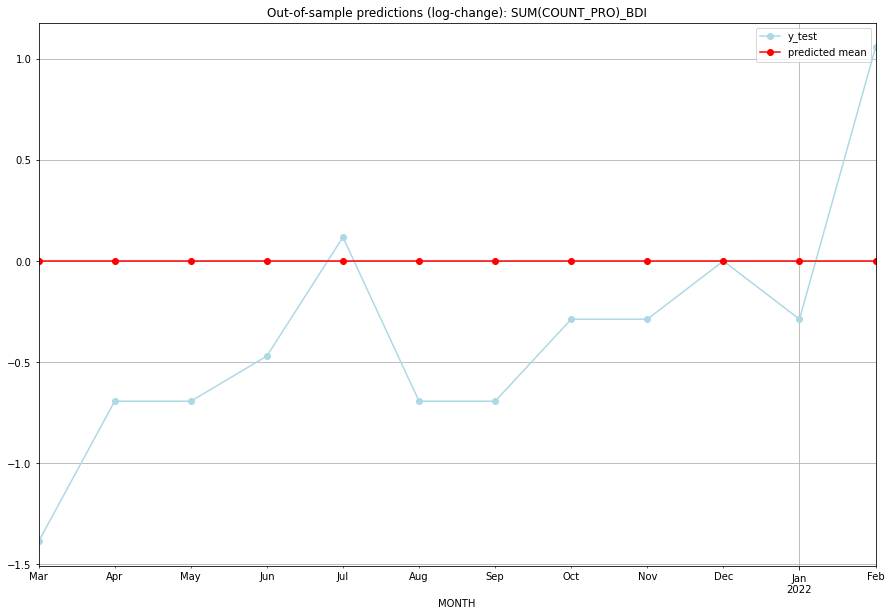

TADDA: 0.5554807199888708
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       7.0         1.0           0.0       -1.386294   BDI   
1  2021-04-01       7.0         3.0           0.0       -0.693147   BDI   
2  2021-05-01       7.0         3.0           0.0       -0.693147   BDI   
3  2021-06-01       7.0         4.0           0.0       -0.470004   BDI   
4  2021-07-01       7.0         8.0           0.0        0.117783   BDI   
5  2021-08-01       7.0         3.0           0.0       -0.693147   BDI   
6  2021-09-01       7.0         3.0           0.0       -0.693147   BDI   
7  2021-10-01       7.0         5.0           0.0       -0.287682   BDI   
8  2021-11-01       7.0         5.0           0.0       -0.287682   BDI   
9  2021-12-01       7.0         7.0           0.0        0.000000   BDI   
10 2022-01-01       7.0         5.0           0.0       -0.287682   BDI   
11 2022-02-01       7.0        22.0           0.0    

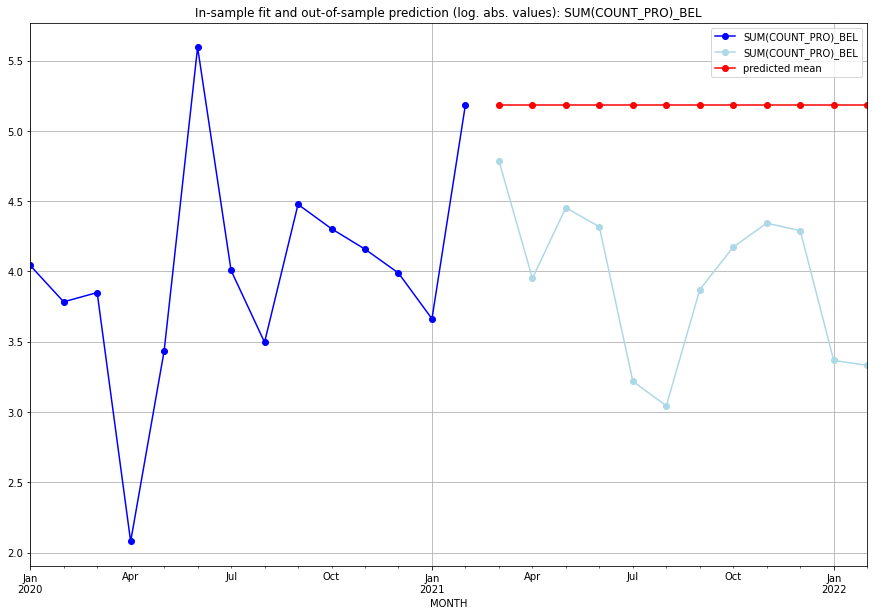

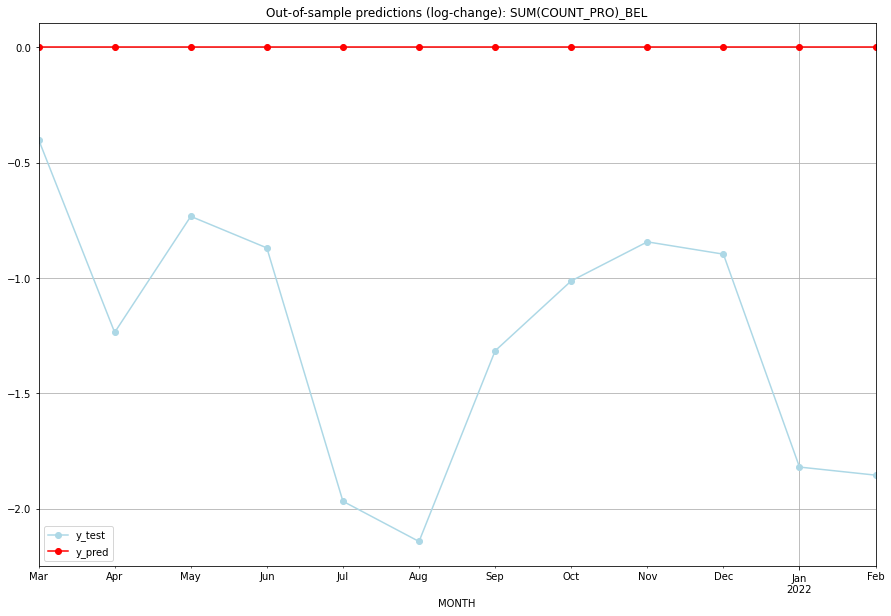

TADDA: 1.2579422543647387
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  5.187386    4.787492           0.0       -0.399894   BEL   
1  2021-04-01  5.187386    3.951244           0.0       -1.236142   BEL   
2  2021-05-01  5.187386    4.454347           0.0       -0.733039   BEL   
3  2021-06-01  5.187386    4.317488           0.0       -0.869898   BEL   
4  2021-07-01  5.187386    3.218876           0.0       -1.968510   BEL   
5  2021-08-01  5.187386    3.044522           0.0       -2.142863   BEL   
6  2021-09-01  5.187386    3.871201           0.0       -1.316185   BEL   
7  2021-10-01  5.187386    4.174387           0.0       -1.012999   BEL   
8  2021-11-01  5.187386    4.343805           0.0       -0.843580   BEL   
9  2021-12-01  5.187386    4.290459           0.0       -0.896926   BEL   
10 2022-01-01  5.187386    3.367296           0.0       -1.820090   BEL   
11 2022-02-01  5.187386    3.332205           0.0    

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [3, (2, 1, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.5859984495181974, 'fold_results': [0.5859984495181974]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_BEN   No. Observations:                  289
Model:               SARIMAX(2, 1, 3)   Log Likelihood                -158.165
Date:                Fri, 16 Sep 2022   AIC                            334.329
Time:                        13:51:08   BIC                            367.296
Sample:                    02-28-1997   HQIC                           347.540
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1             0.0879      0.021      4.219      0.000   

<Figure size 432x288 with 0 Axes>

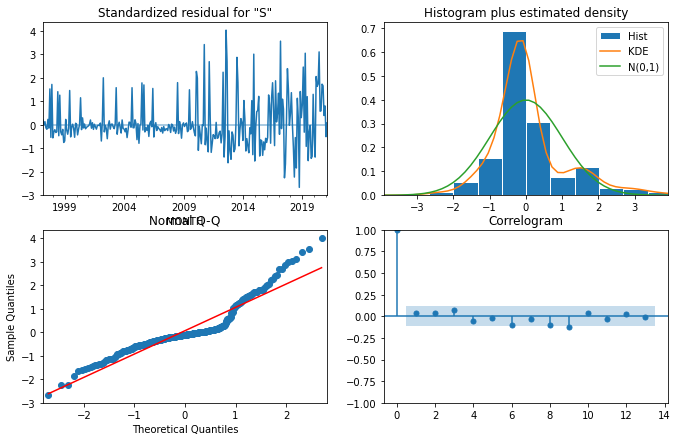

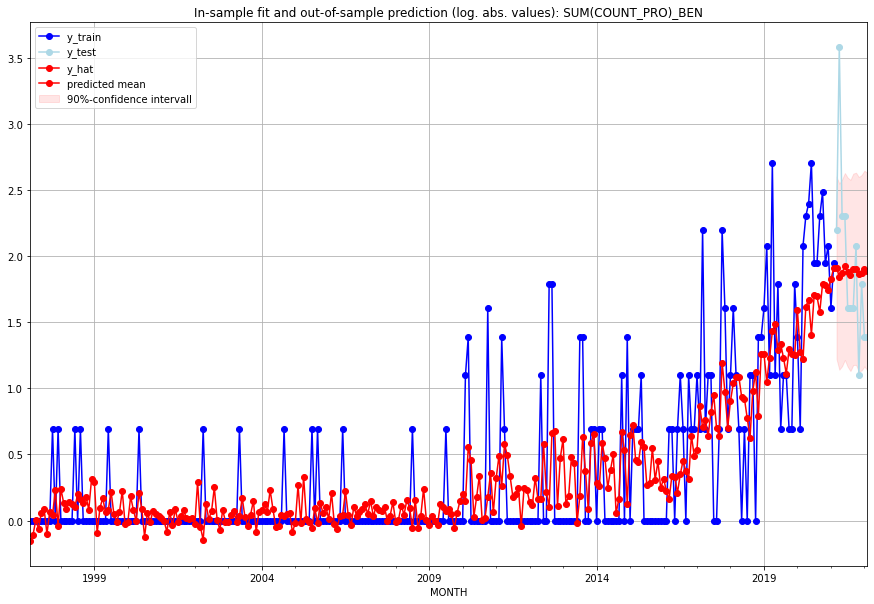

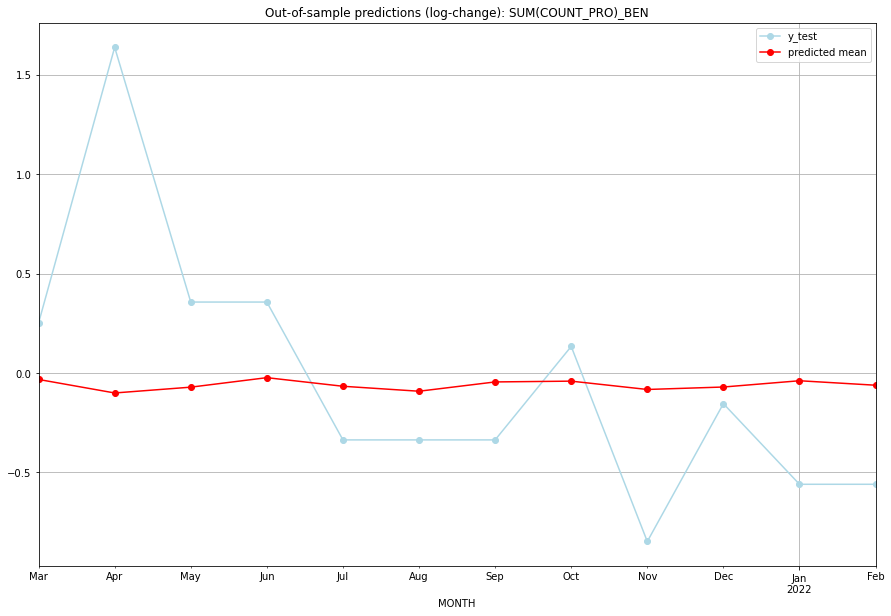

TADDA: 0.49550704140492535
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  5.775965         8.0     -0.032528        0.251314   BEN   
1  2021-04-01  5.330650        35.0     -0.100507        1.637609   BEN   
2  2021-05-01  5.518483         9.0     -0.071269        0.356675   BEN   
3  2021-06-01  5.837164         9.0     -0.023537        0.356675   BEN   
4  2021-07-01  5.547957         4.0     -0.066757       -0.336472   BEN   
5  2021-08-01  5.386429         4.0     -0.091735       -0.336472   BEN   
6  2021-09-01  5.692008         4.0     -0.044996       -0.336472   BEN   
7  2021-10-01  5.718798         7.0     -0.041001        0.133531   BEN   
8  2021-11-01  5.443198         2.0     -0.082885       -0.847298   BEN   
9  2021-12-01  5.522982         5.0     -0.070579       -0.154151   BEN   
10 2022-01-01  5.732109         3.0     -0.039022       -0.559616   BEN   
11 2022-02-01  5.582292         3.0     -0.061527   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (2, 0, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.16747359061063513, 'fold_results': [0.16747359061063513]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_BES   No. Observations:                  289
Model:               SARIMAX(2, 0, 3)   Log Likelihood                 208.404
Date:                Fri, 16 Sep 2022   AIC                           -404.807
Time:                        13:51:35   BIC                           -382.809
Sample:                    02-28-1997   HQIC                          -395.993
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.2097      0.032      6.487      0.000 

<Figure size 432x288 with 0 Axes>

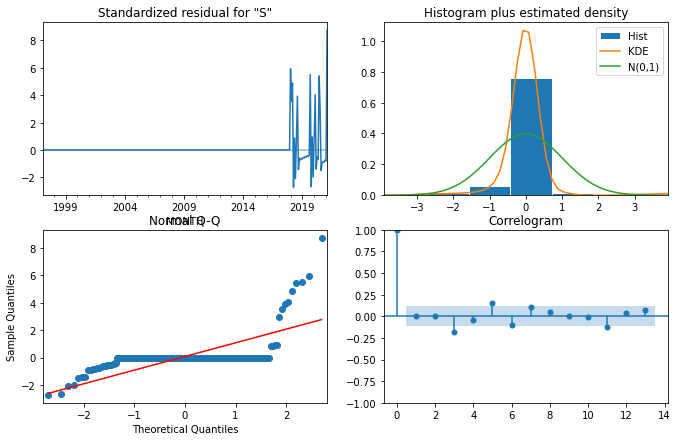

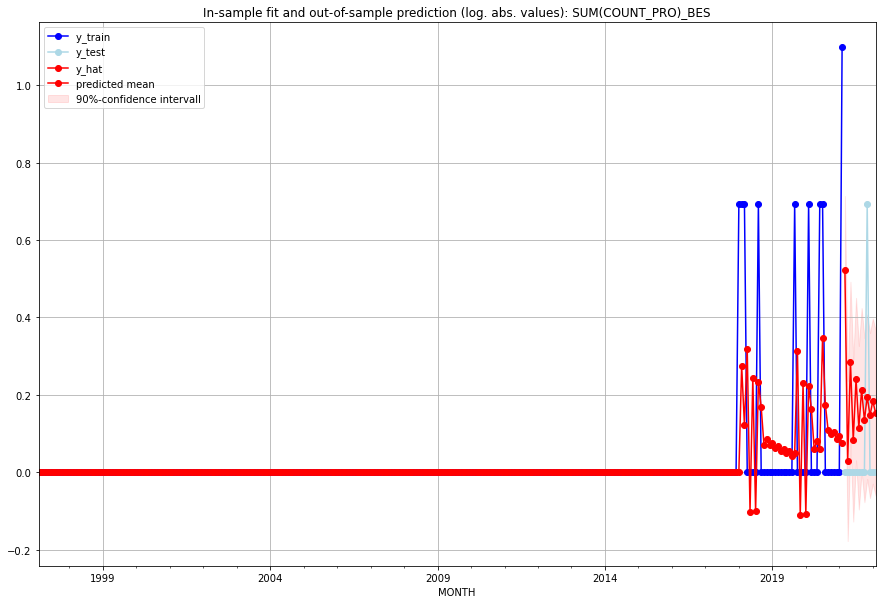

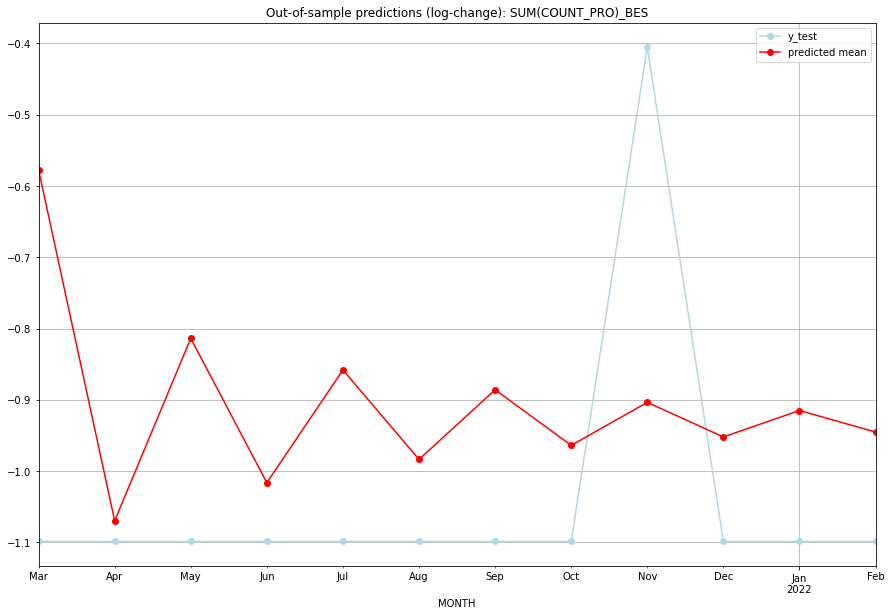

TADDA: 0.21691465784298533
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  0.684292         0.0     -0.577267       -1.098612   BES   
1  2021-04-01  0.029402         0.0     -1.069634       -1.098612   BES   
2  2021-05-01  0.329589         0.0     -0.813743       -1.098612   BES   
3  2021-06-01  0.085953         0.0     -1.016155       -1.098612   BES   
4  2021-07-01  0.272051         0.0     -0.857981       -1.098612   BES   
5  2021-08-01  0.121996         0.0     -0.983503       -1.098612   BES   
6  2021-09-01  0.237131         0.0     -0.885818       -1.098612   BES   
7  2021-10-01  0.144388         0.0     -0.963742       -1.098612   BES   
8  2021-11-01  0.215451         1.0     -0.903497       -0.405465   BES   
9  2021-12-01  0.157955         0.0     -0.951957       -1.098612   BES   
10 2022-01-01  0.201686         0.0     -0.914887       -1.098612   BES   
11 2022-02-01  0.165916         0.0     -0.945105   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [3, (1, 0, 1), (0, 0, 0, 0), 'n'], 'cv_score': 0.28248816067633076, 'fold_results': [0.28248816067633076]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_BFA   No. Observations:                  289
Model:               SARIMAX(1, 0, 1)   Log Likelihood                -274.407
Date:                Fri, 16 Sep 2022   AIC                            560.815
Time:                        13:52:05   BIC                            582.813
Sample:                    02-28-1997   HQIC                           569.629
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1             0.0709      0.028      2.578      0.010 

<Figure size 432x288 with 0 Axes>

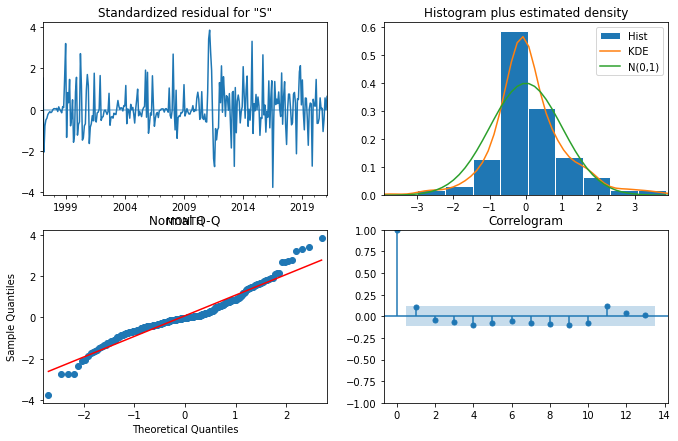

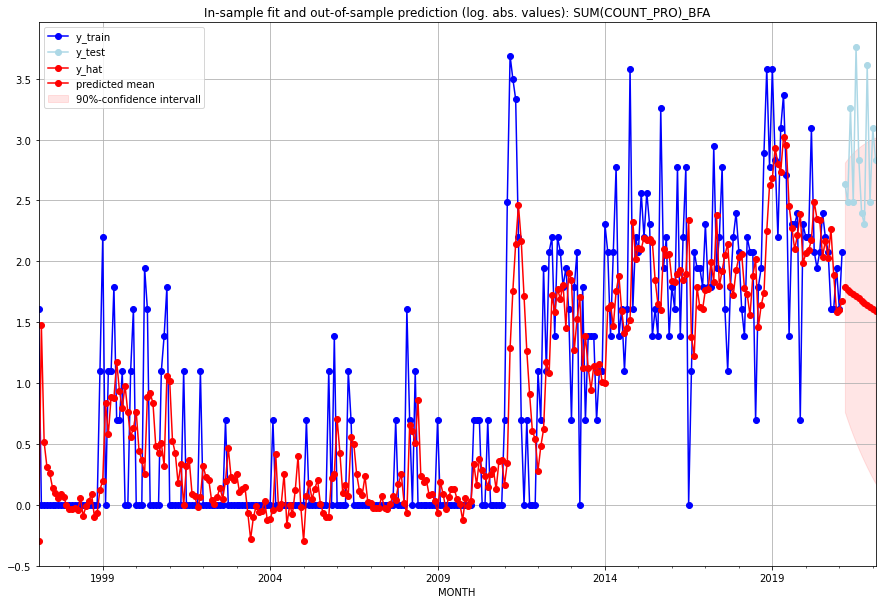

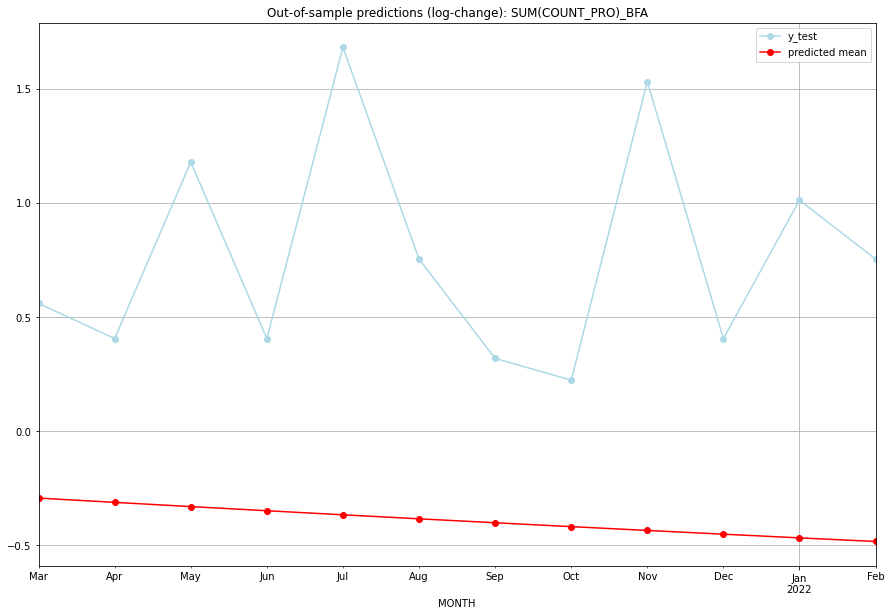

TADDA: 1.551965125553491
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  4.964178        13.0     -0.293670        0.559616   BFA   
1  2021-04-01  4.853184        11.0     -0.312456        0.405465   BFA   
2  2021-05-01  4.746056        25.0     -0.330928        1.178655   BFA   
3  2021-06-01  4.642627        11.0     -0.349092        0.405465   BFA   
4  2021-07-01  4.542738        42.0     -0.366953        1.681759   BFA   
5  2021-08-01  4.446240        16.0     -0.384516        0.753772   BFA   
6  2021-09-01  4.352990        10.0     -0.401786        0.318454   BFA   
7  2021-10-01  4.262852         9.0     -0.418768        0.223144   BFA   
8  2021-11-01  4.175698        36.0     -0.435467        1.531476   BFA   
9  2021-12-01  4.091406        11.0     -0.451888        0.405465   BFA   
10 2022-01-01  4.009858        21.0     -0.468034        1.011601   BFA   
11 2022-02-01  3.930943        16.0     -0.483911     

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.28544312175202996, 'fold_results': [0.28544312175202996]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_BGD   No. Observations:                  134
Model:               SARIMAX(0, 1, 0)   Log Likelihood                -112.637
Date:                Fri, 16 Sep 2022   AIC                            227.275
Time:                        13:52:28   BIC                            230.165
Sample:                    01-31-2010   HQIC                           228.449
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.3185      0.031     10.146      0.000 

<Figure size 432x288 with 0 Axes>

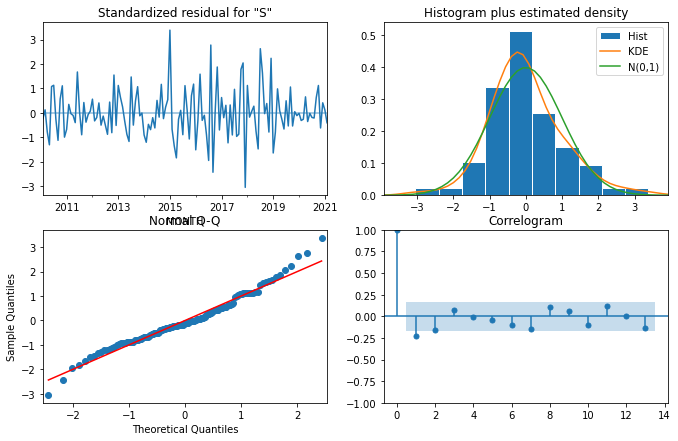

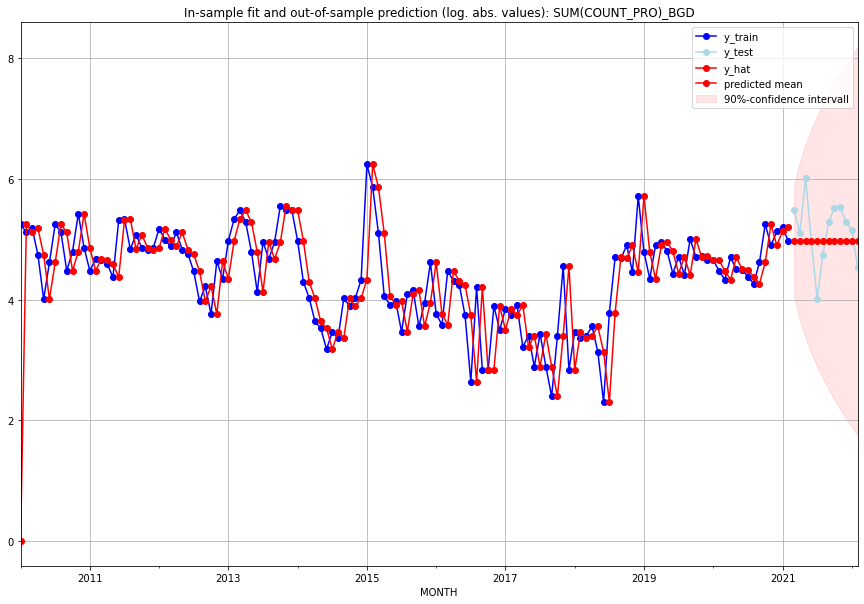

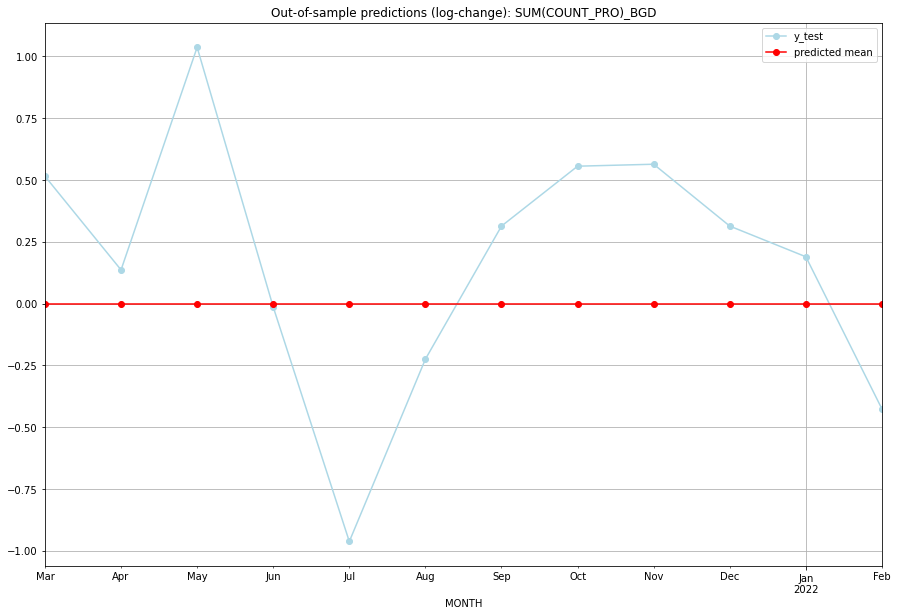

TADDA: 0.4375633666476491
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01     143.0       240.0           0.0        0.514984   BGD   
1  2021-04-01     143.0       164.0           0.0        0.136132   BGD   
2  2021-05-01     143.0       405.0           0.0        1.036540   BGD   
3  2021-06-01     143.0       141.0           0.0       -0.013986   BGD   
4  2021-07-01     143.0        54.0           0.0       -0.962480   BGD   
5  2021-08-01     143.0       114.0           0.0       -0.224881   BGD   
6  2021-09-01     143.0       196.0           0.0        0.313390   BGD   
7  2021-10-01     143.0       250.0           0.0        0.555640   BGD   
8  2021-11-01     143.0       252.0           0.0        0.563576   BGD   
9  2021-12-01     143.0       196.0           0.0        0.313390   BGD   
10 2022-01-01     143.0       173.0           0.0        0.189242   BGD   
11 2022-02-01     143.0        93.0           0.0    

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (2, 0, 2), (0, 0, 0, 0), 'n'], 'cv_score': 0.6435093399181159, 'fold_results': [0.6435093399181159]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_BGR   No. Observations:                   38
Model:               SARIMAX(2, 0, 2)   Log Likelihood                 -30.870
Date:                Fri, 16 Sep 2022   AIC                             71.740
Time:                        13:52:49   BIC                             79.928
Sample:                    01-31-2018   HQIC                            74.653
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          1.5241      0.446      3.420      0.001   

<Figure size 432x288 with 0 Axes>

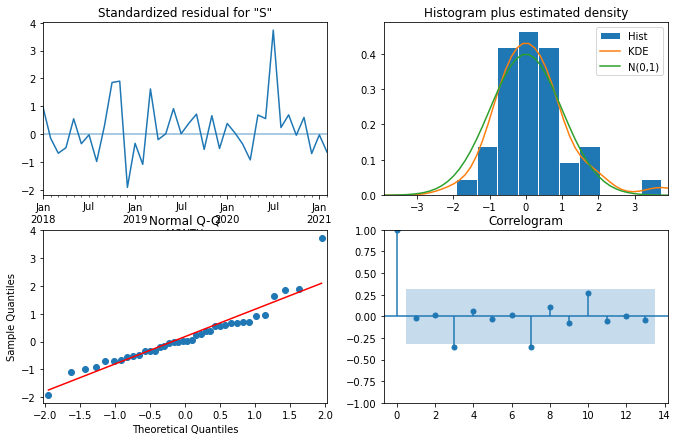

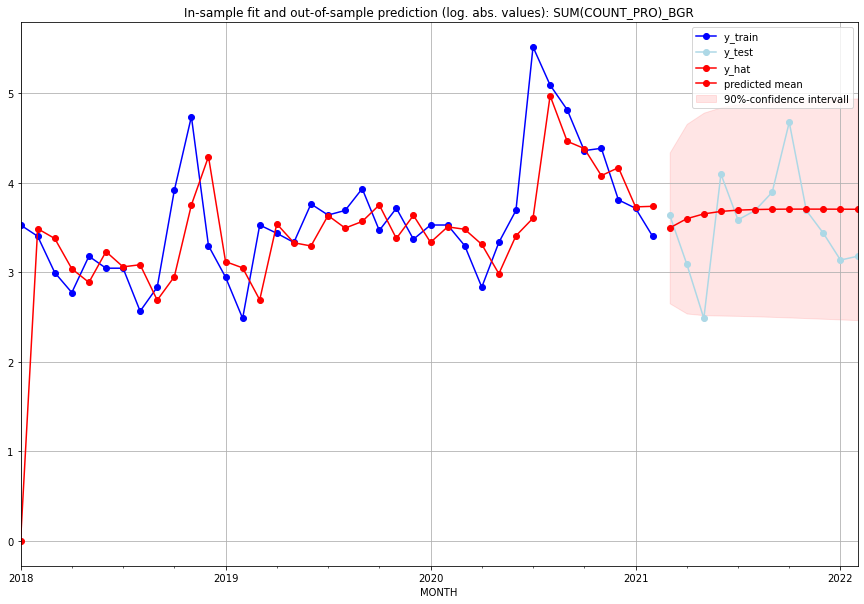

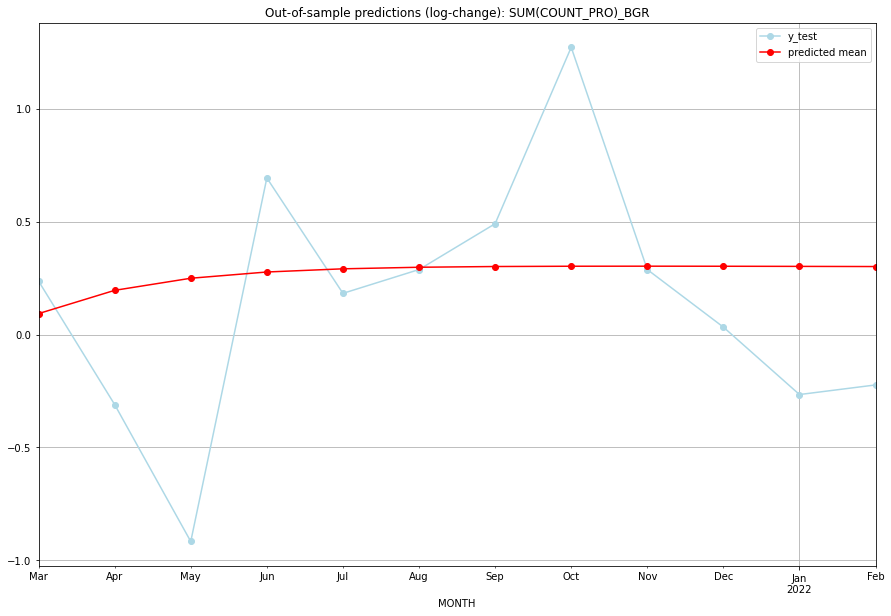

TADDA: 0.4943637802460891
Evaluation finished.
        MONTH   FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  31.913520        37.0      0.092686        0.236389   BGR   
1  2021-04-01  35.482351        21.0      0.195631       -0.310155   BGR   
2  2021-05-01  37.489465        11.0      0.249187       -0.916291   BGR   
3  2021-06-01  38.568848        59.0      0.276845        0.693147   BGR   
4  2021-07-01  39.129807        35.0      0.290922        0.182322   BGR   
5  2021-08-01  39.409928        39.0      0.297878        0.287682   BGR   
6  2021-09-01  39.540343        48.0      0.301100        0.490623   BGR   
7  2021-10-01  39.591626       106.0      0.302364        1.271631   BGR   
8  2021-11-01  39.601272        39.0      0.302602        0.287682   BGR   
9  2021-12-01  39.589068        30.0      0.302301        0.032790   BGR   
10 2022-01-01  39.565422        22.0      0.301719       -0.265703   BGR   
11 2022-02-01  39.535796        23.0     

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [3, (3, 0, 3), (0, 0, 0, 0), 'n'], 'cv_score': 1.103831208105729, 'fold_results': [1.103831208105729]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_BHR   No. Observations:                   62
Model:               SARIMAX(3, 0, 3)   Log Likelihood                 -53.460
Date:                Fri, 16 Sep 2022   AIC                            126.920
Time:                        13:53:08   BIC                            148.191
Sample:                    01-31-2016   HQIC                           135.271
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            -0.1968      0.099     -1.979      0.048     

<Figure size 432x288 with 0 Axes>

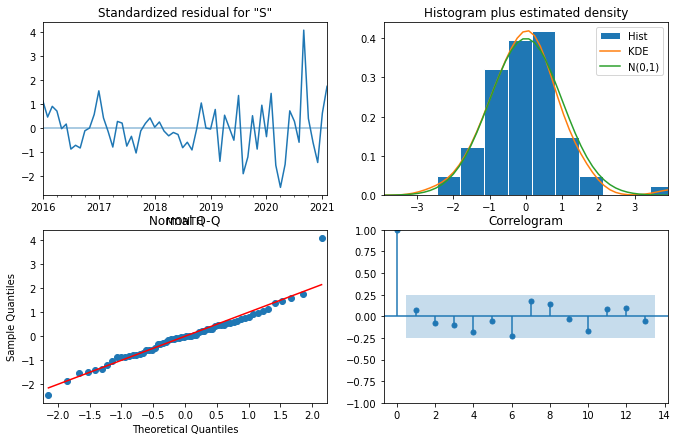

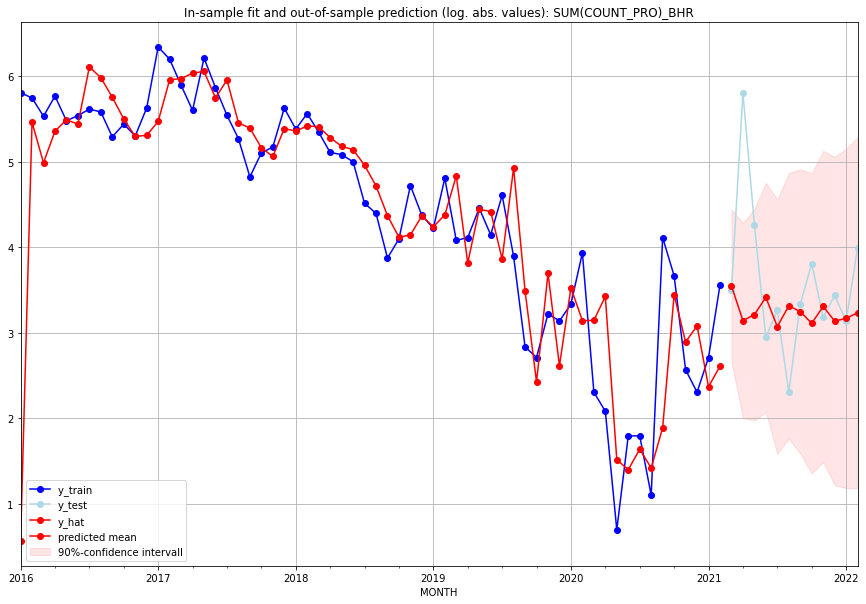

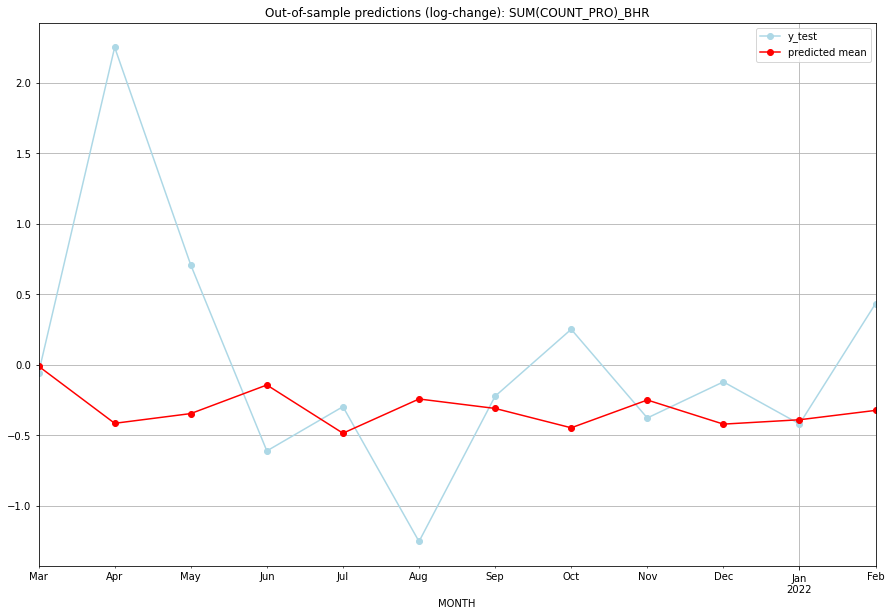

TADDA: 0.7469126786748896
Evaluation finished.
        MONTH   FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  33.637578        32.0     -0.010409       -0.058841   BHR   
1  2021-04-01  22.108821       331.0     -0.415134        2.249787   BHR   
2  2021-05-01  23.758504        70.0     -0.346179        0.707332   BHR   
3  2021-06-01  29.320936        18.0     -0.143510       -0.610909   BHR   
4  2021-07-01  20.542749        25.0     -0.485309       -0.297252   BHR   
5  2021-08-01  26.457150         9.0     -0.242721       -1.252763   BHR   
6  2021-09-01  24.677483        27.0     -0.309734       -0.223144   BHR   
7  2021-10-01  21.385893        44.0     -0.446917        0.251314   BHR   
8  2021-11-01  26.259788        23.0     -0.249935       -0.377294   BHR   
9  2021-12-01  21.975773        30.0     -0.420908       -0.121361   BHR   
10 2022-01-01  22.697927        22.0     -0.389960       -0.419854   BHR   
11 2022-02-01  24.325095        53.0     

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.2986265782046758, 'fold_results': [0.2986265782046758]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_BHS   No. Observations:                   38
Model:                        SARIMAX   Log Likelihood                 -43.267
Date:                Fri, 16 Sep 2022   AIC                             88.534
Time:                        13:53:19   BIC                             90.172
Sample:                    01-31-2018   HQIC                            89.117
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.5708      0.123      4.654      0.000   

<Figure size 432x288 with 0 Axes>

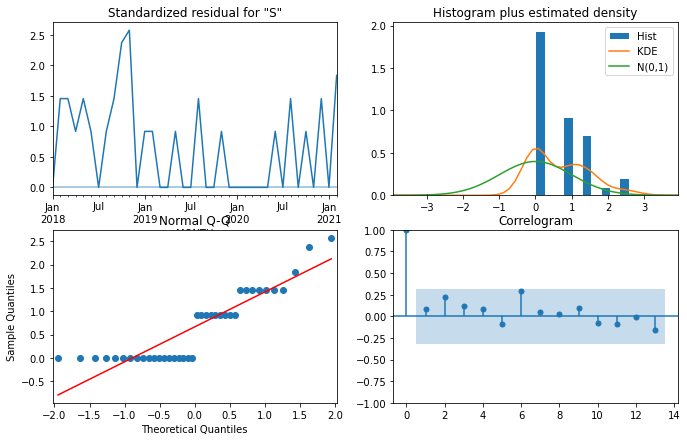

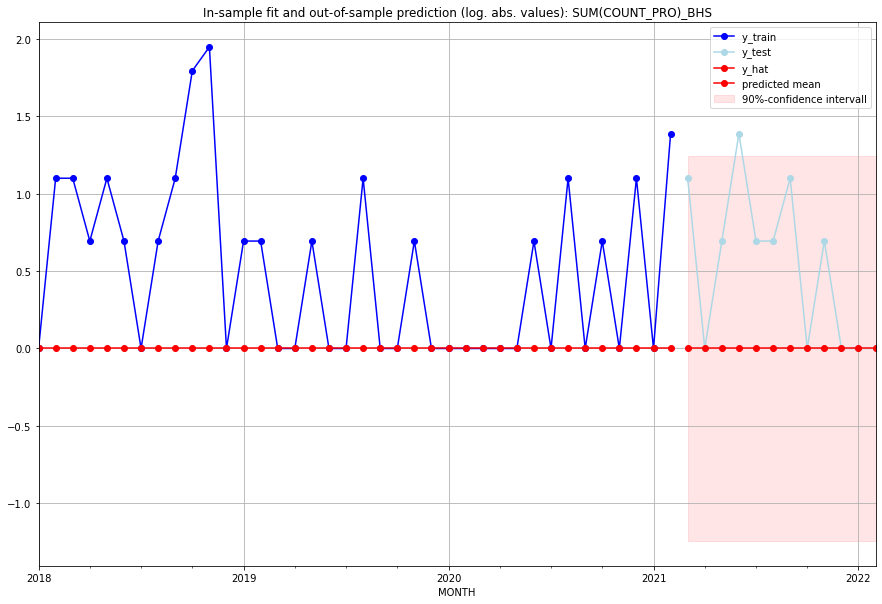

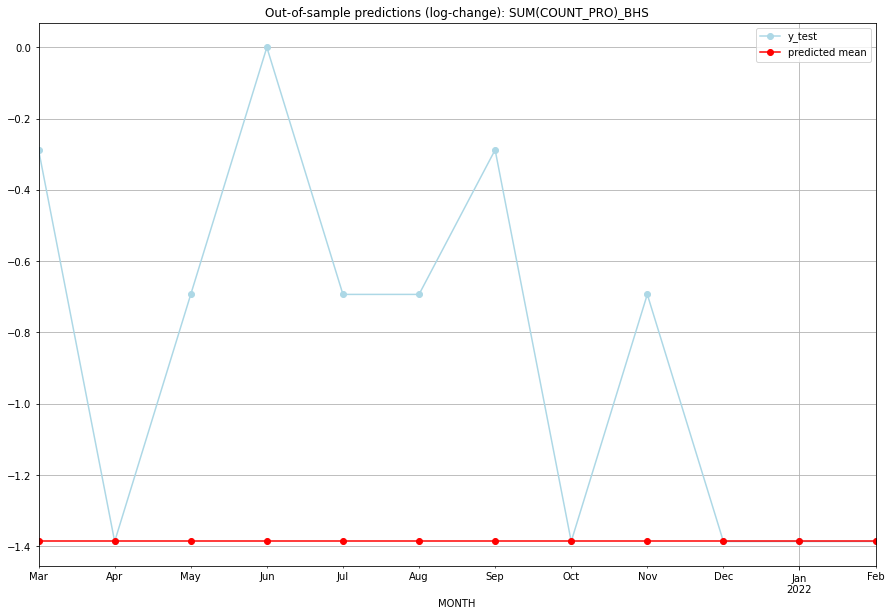

TADDA: 0.5296756383913243
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         2.0     -1.386294       -0.287682   BHS   
1  2021-04-01       0.0         0.0     -1.386294       -1.386294   BHS   
2  2021-05-01       0.0         1.0     -1.386294       -0.693147   BHS   
3  2021-06-01       0.0         3.0     -1.386294        0.000000   BHS   
4  2021-07-01       0.0         1.0     -1.386294       -0.693147   BHS   
5  2021-08-01       0.0         1.0     -1.386294       -0.693147   BHS   
6  2021-09-01       0.0         2.0     -1.386294       -0.287682   BHS   
7  2021-10-01       0.0         0.0     -1.386294       -1.386294   BHS   
8  2021-11-01       0.0         1.0     -1.386294       -0.693147   BHS   
9  2021-12-01       0.0         0.0     -1.386294       -1.386294   BHS   
10 2022-01-01       0.0         0.0     -1.386294       -1.386294   BHS   
11 2022-02-01       0.0         0.0     -1.386294    

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [2, (3, 1, 1), (0, 0, 0, 0), 'n'], 'cv_score': 0.3487946009370663, 'fold_results': [0.3487946009370663]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_BIH   No. Observations:                   38
Model:               SARIMAX(3, 1, 1)   Log Likelihood                 -28.489
Date:                Fri, 16 Sep 2022   AIC                             70.978
Time:                        13:53:38   BIC                             82.255
Sample:                    01-31-2018   HQIC                            74.954
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1             0.0753      0.067      1.122      0.262   

<Figure size 432x288 with 0 Axes>

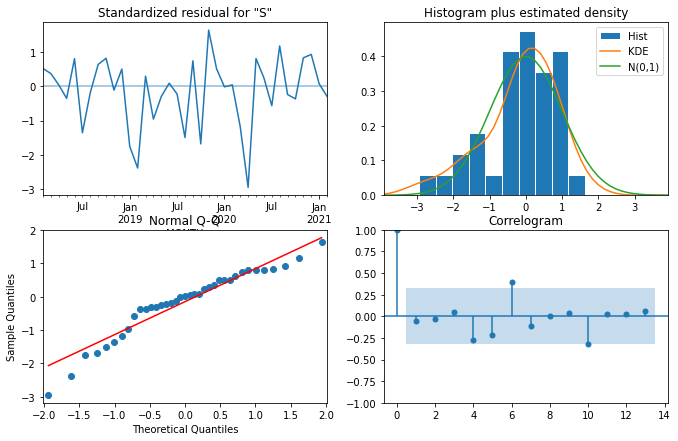

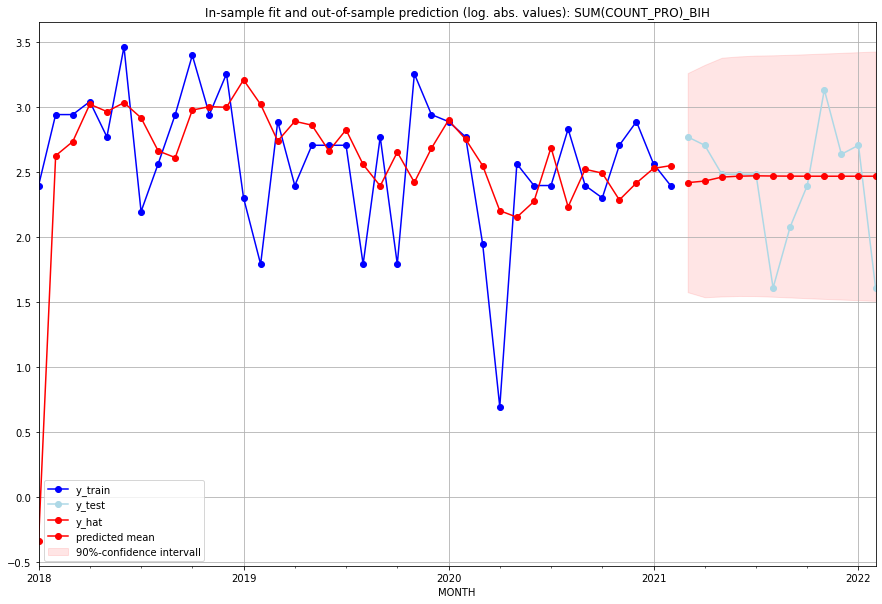

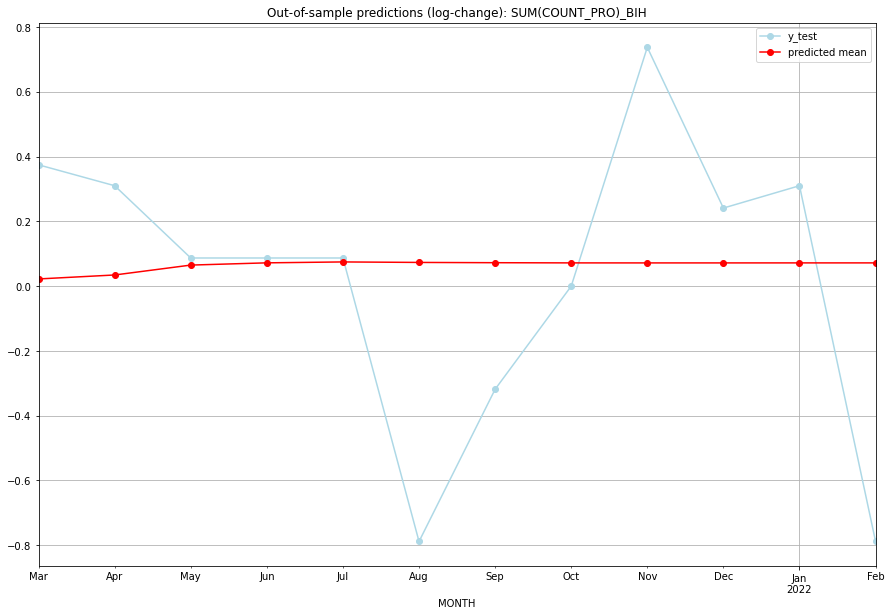

TADDA: 0.34608630638189153
Evaluation finished.
        MONTH   FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  10.247958        15.0      0.022291        0.374693   BIH   
1  2021-04-01  10.386735        14.0      0.034554        0.310155   BIH   
2  2021-05-01  10.739843        11.0      0.065093        0.087011   BIH   
3  2021-06-01  10.821454        11.0      0.072021        0.087011   BIH   
4  2021-07-01  10.854721        11.0      0.074831        0.087011   BIH   
5  2021-08-01  10.836509         4.0      0.073293       -0.788457   BIH   
6  2021-09-01  10.826552         7.0      0.072452       -0.318454   BIH   
7  2021-10-01  10.819678        10.0      0.071871        0.000000   BIH   
8  2021-11-01  10.818817        22.0      0.071798        0.737599   BIH   
9  2021-12-01  10.819018        13.0      0.071815        0.241162   BIH   
10 2022-01-01  10.819633        14.0      0.071867        0.310155   BIH   
11 2022-02-01  10.819887         4.0    

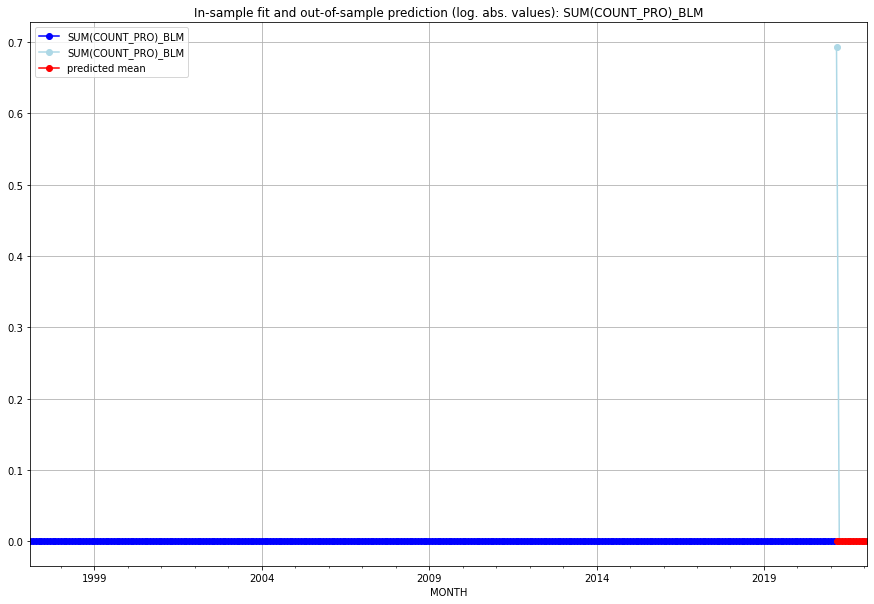

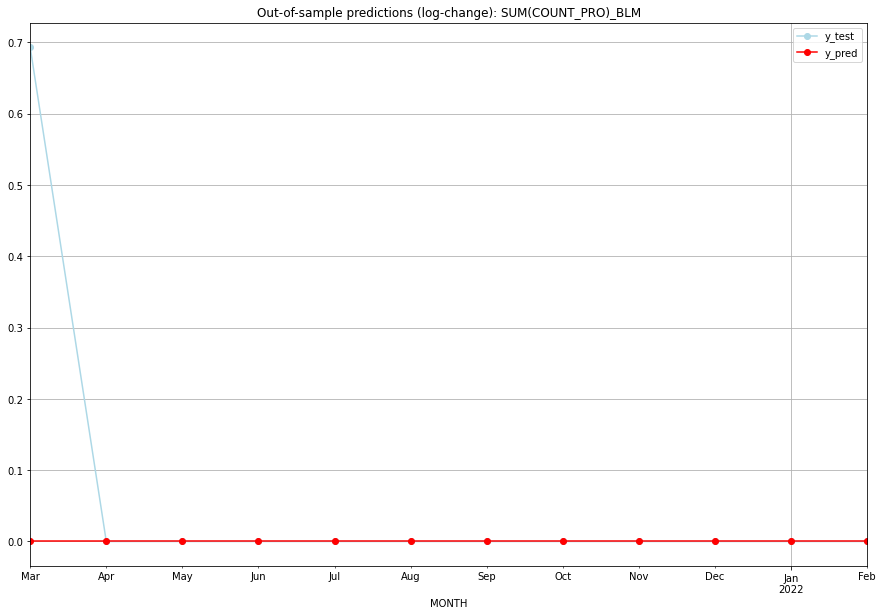

TADDA: 0.057762265046662105
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0    0.693147           0.0        0.693147   BLM   
1  2021-04-01       0.0    0.000000           0.0        0.000000   BLM   
2  2021-05-01       0.0    0.000000           0.0        0.000000   BLM   
3  2021-06-01       0.0    0.000000           0.0        0.000000   BLM   
4  2021-07-01       0.0    0.000000           0.0        0.000000   BLM   
5  2021-08-01       0.0    0.000000           0.0        0.000000   BLM   
6  2021-09-01       0.0    0.000000           0.0        0.000000   BLM   
7  2021-10-01       0.0    0.000000           0.0        0.000000   BLM   
8  2021-11-01       0.0    0.000000           0.0        0.000000   BLM   
9  2021-12-01       0.0    0.000000           0.0        0.000000   BLM   
10 2022-01-01       0.0    0.000000           0.0        0.000000   BLM   
11 2022-02-01       0.0    0.000000           0.0  

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (1, 1, 3), (0, 0, 0, 0), 'n'], 'cv_score': 1.82050100696165, 'fold_results': [1.82050100696165]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_BLR   No. Observations:                   38
Model:               SARIMAX(1, 1, 3)   Log Likelihood                 -35.324
Date:                Fri, 16 Sep 2022   AIC                             80.647
Time:                        13:54:08   BIC                             88.702
Sample:                    01-31-2018   HQIC                            83.487
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.8701      0.352     -2.469      0.014      -

<Figure size 432x288 with 0 Axes>

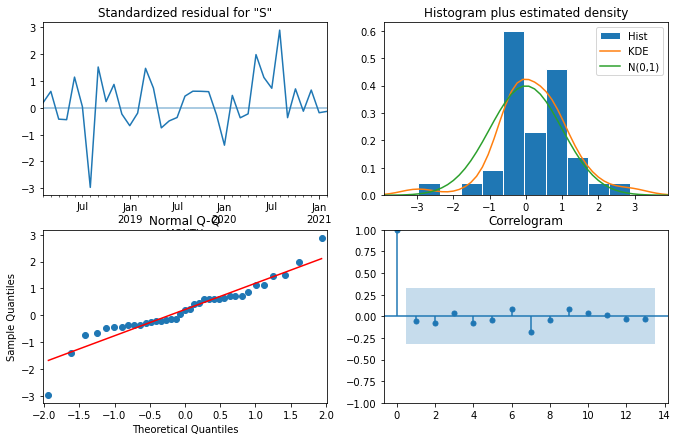

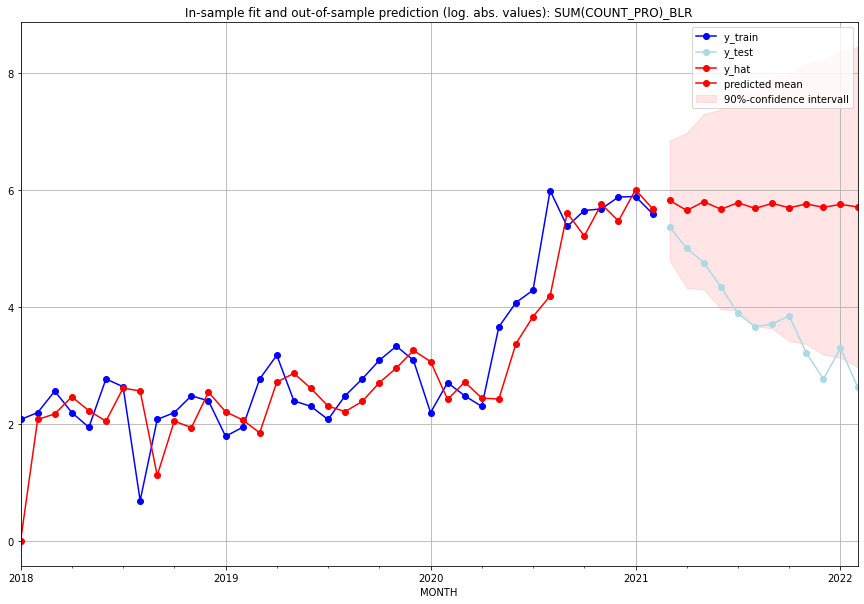

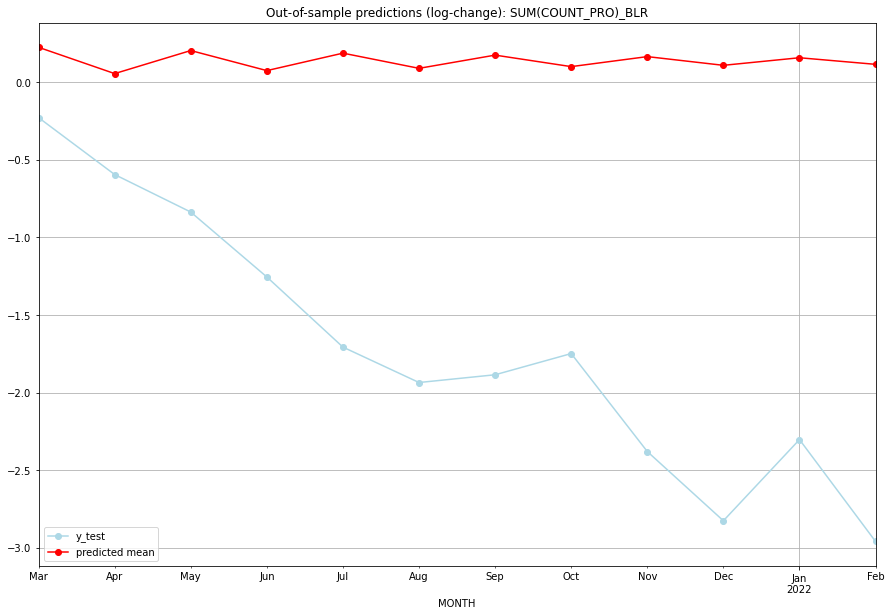

TADDA: 1.9985868961371513
Evaluation finished.
        MONTH    FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  337.279530       214.0      0.225451       -0.227784   BLR   
1  2021-04-01  284.562882       148.0      0.056040       -0.594476   BLR   
2  2021-05-01  330.297450       116.0      0.204595       -0.836248   BLR   
3  2021-06-01  290.124887        76.0      0.075330       -1.254617   BLR   
4  2021-07-01  324.782958        48.0      0.187809       -1.706602   BLR   
5  2021-08-01  294.408154        38.0      0.089936       -1.934860   BLR   
6  2021-09-01  320.668762        40.0      0.175100       -1.884850   BLR   
7  2021-10-01  297.693133        46.0      0.100995       -1.748274   BLR   
8  2021-11-01  317.588266        24.0      0.165478       -2.379546   BLR   
9  2021-12-01  300.204658        15.0      0.109368       -2.825833   BLR   
10 2022-01-01  315.275485        26.0      0.158192       -2.302585   BLR   
11 2022-02-01  302.120317    

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [2, (3, 1, 2), (0, 0, 0, 0), 'n'], 'cv_score': 0.45848370495452634, 'fold_results': [0.45848370495452634]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_BLZ   No. Observations:                   38
Model:               SARIMAX(3, 1, 2)   Log Likelihood                 -34.439
Date:                Fri, 16 Sep 2022   AIC                             84.877
Time:                        13:54:27   BIC                             97.764
Sample:                    01-31-2018   HQIC                            89.421
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            -0.0845      0.059     -1.440      0.150 

<Figure size 432x288 with 0 Axes>

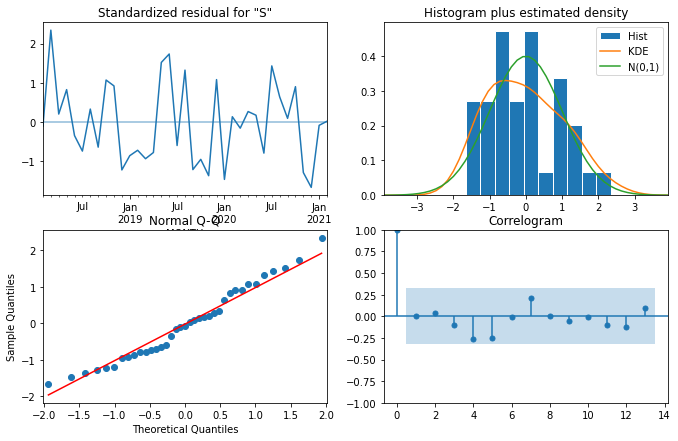

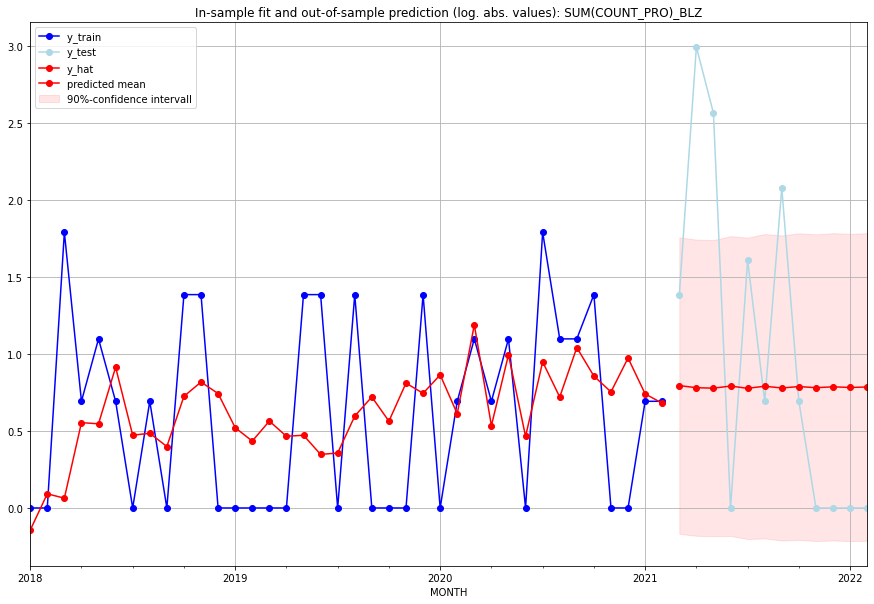

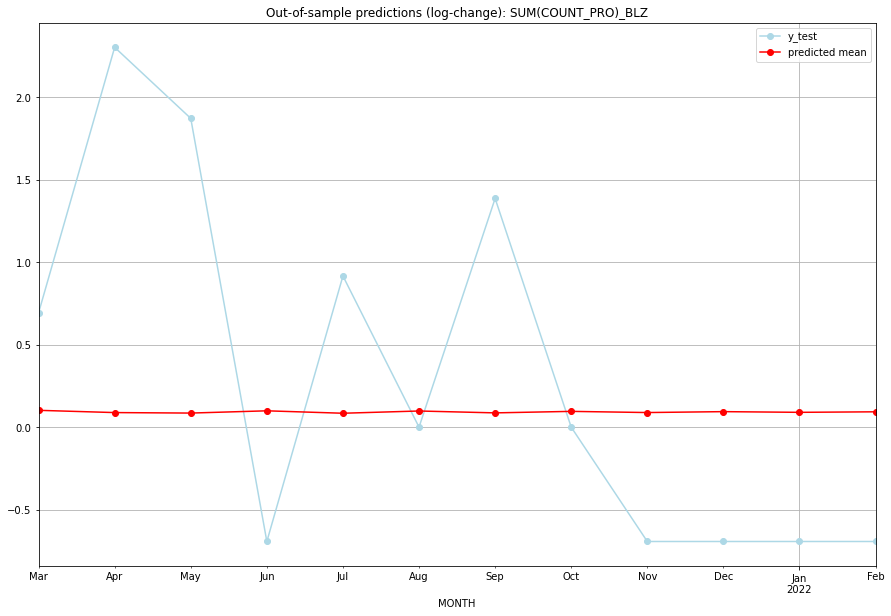

TADDA: 0.9426329508410561
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  1.214737         3.0      0.101987        0.693147   BLZ   
1  2021-04-01  1.184676        19.0      0.088320        2.302585   BLZ   
2  2021-05-01  1.178150        12.0      0.085329        1.871802   BLZ   
3  2021-06-01  1.208160         0.0      0.099012       -0.693147   BLZ   
4  2021-07-01  1.175906         4.0      0.084298        0.916291   BLZ   
5  2021-08-01  1.205672         1.0      0.097885        0.000000   BLZ   
6  2021-09-01  1.180740         7.0      0.086517        1.386294   BLZ   
7  2021-10-01  1.200739         1.0      0.095646        0.000000   BLZ   
8  2021-11-01  1.185093         0.0      0.088511       -0.693147   BLZ   
9  2021-12-01  1.197123         0.0      0.094002       -0.693147   BLZ   
10 2022-01-01  1.187954         0.0      0.089819       -0.693147   BLZ   
11 2022-02-01  1.194890         0.0      0.092985    

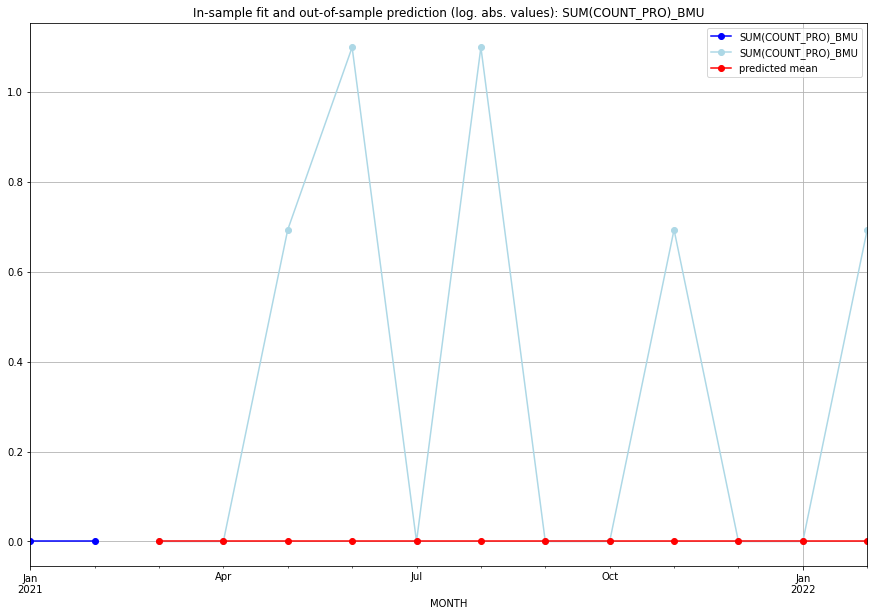

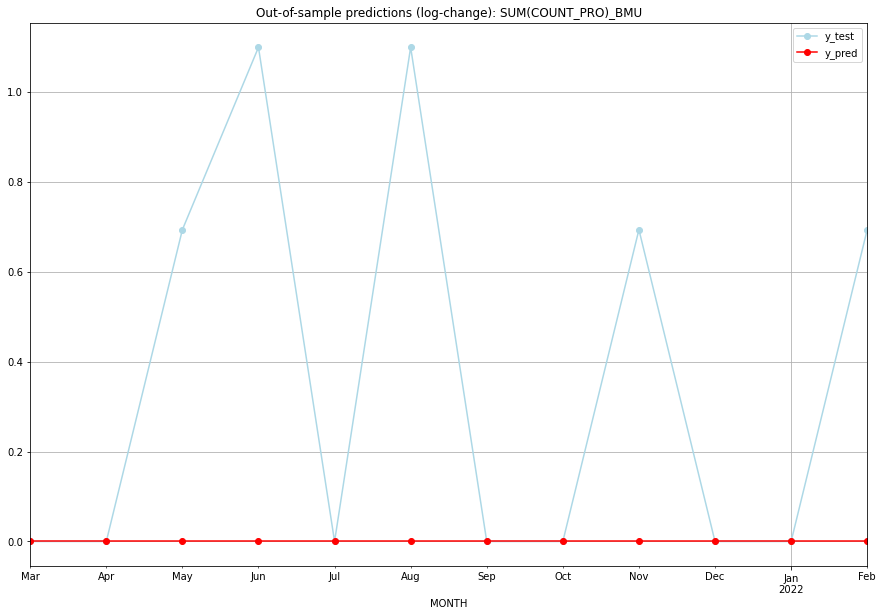

TADDA: 0.35638884325133796
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0    0.000000           0.0        0.000000   BMU   
1  2021-04-01       0.0    0.000000           0.0        0.000000   BMU   
2  2021-05-01       0.0    0.693147           0.0        0.693147   BMU   
3  2021-06-01       0.0    1.098612           0.0        1.098612   BMU   
4  2021-07-01       0.0    0.000000           0.0        0.000000   BMU   
5  2021-08-01       0.0    1.098612           0.0        1.098612   BMU   
6  2021-09-01       0.0    0.000000           0.0        0.000000   BMU   
7  2021-10-01       0.0    0.000000           0.0        0.000000   BMU   
8  2021-11-01       0.0    0.693147           0.0        0.693147   BMU   
9  2021-12-01       0.0    0.000000           0.0        0.000000   BMU   
10 2022-01-01       0.0    0.000000           0.0        0.000000   BMU   
11 2022-02-01       0.0    0.693147           0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (2, 0, 2), (0, 0, 0, 0), 'n'], 'cv_score': 0.409903595568677, 'fold_results': [0.409903595568677]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_BOL   No. Observations:                   38
Model:               SARIMAX(2, 0, 2)   Log Likelihood                 -31.078
Date:                Fri, 16 Sep 2022   AIC                             72.156
Time:                        13:54:54   BIC                             80.344
Sample:                    01-31-2018   HQIC                            75.069
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.1418      0.213      0.665      0.506     

<Figure size 432x288 with 0 Axes>

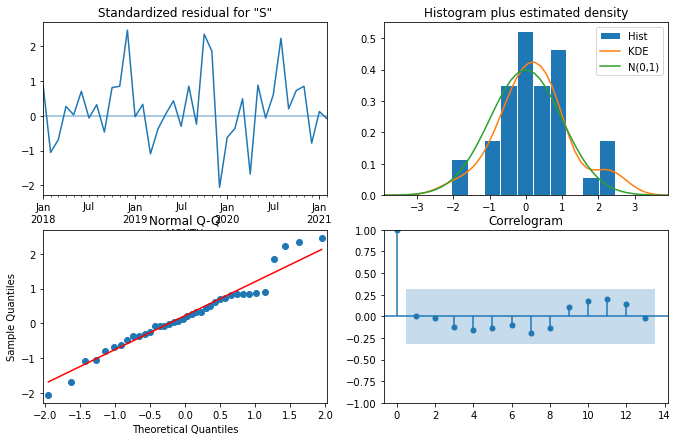

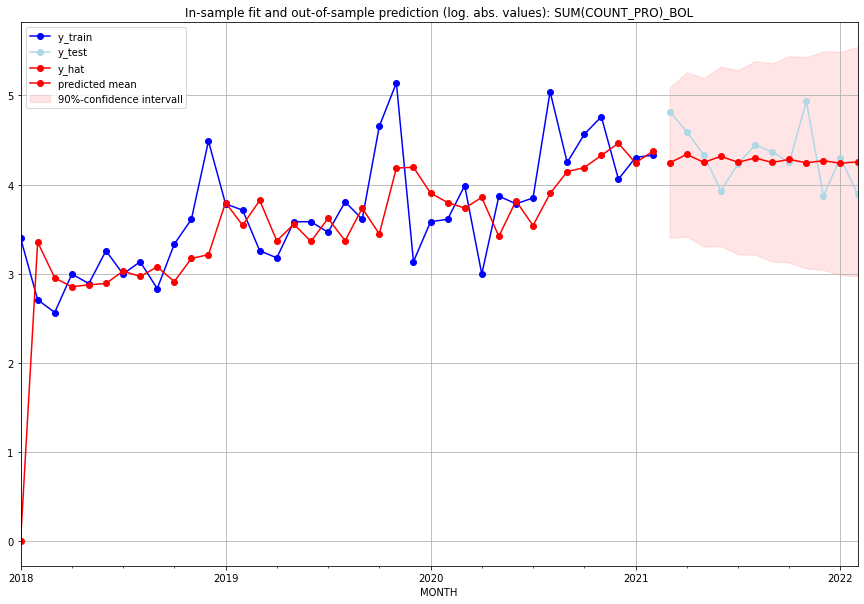

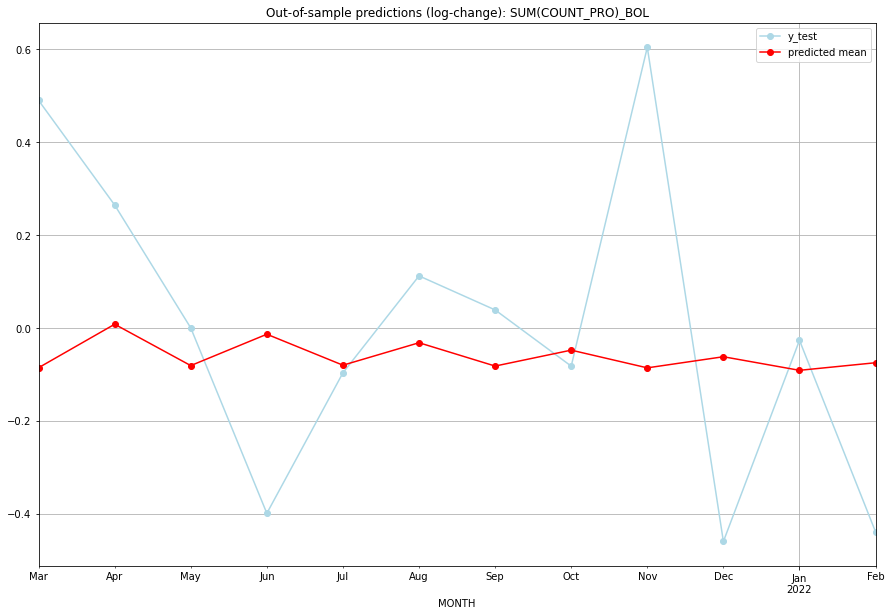

TADDA: 0.28456720099429245
Evaluation finished.
        MONTH   FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  68.762356       123.0     -0.085639        0.489548   BOL   
1  2021-04-01  75.604130        98.0      0.007918        0.264387   BOL   
2  2021-05-01  69.081372        75.0     -0.081076        0.000000   BOL   
3  2021-06-01  73.973466        50.0     -0.013599       -0.398908   BOL   
4  2021-07-01  69.141306        68.0     -0.080221       -0.096627   BOL   
5  2021-08-01  72.613922        84.0     -0.031899        0.111918   BOL   
6  2021-09-01  69.010736        78.0     -0.082085        0.038715   BOL   
7  2021-10-01  71.450422        69.0     -0.047831       -0.082238   BOL   
8  2021-11-01  68.741401       138.0     -0.085939        0.603741   BOL   
9  2021-12-01  70.429871        47.0     -0.062017       -0.459532   BOL   
10 2022-01-01  68.371935        73.0     -0.091251       -0.026668   BOL   
11 2022-02-01  69.514431        48.0    

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (2, 0, 2), (0, 0, 0, 0), 'n'], 'cv_score': 0.19104643561826817, 'fold_results': [0.19104643561826817]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_BRA   No. Observations:                   38
Model:               SARIMAX(2, 0, 2)   Log Likelihood                 -33.720
Date:                Fri, 16 Sep 2022   AIC                             77.440
Time:                        13:55:20   BIC                             85.628
Sample:                    01-31-2018   HQIC                            80.353
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1      -1.954e-05      0.131     -0.000      1.000 

<Figure size 432x288 with 0 Axes>

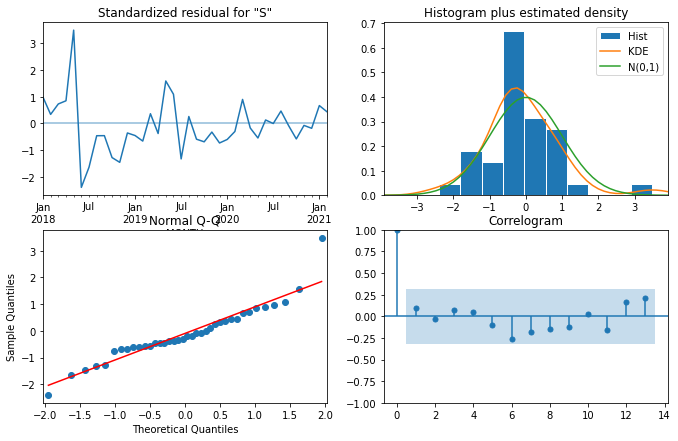

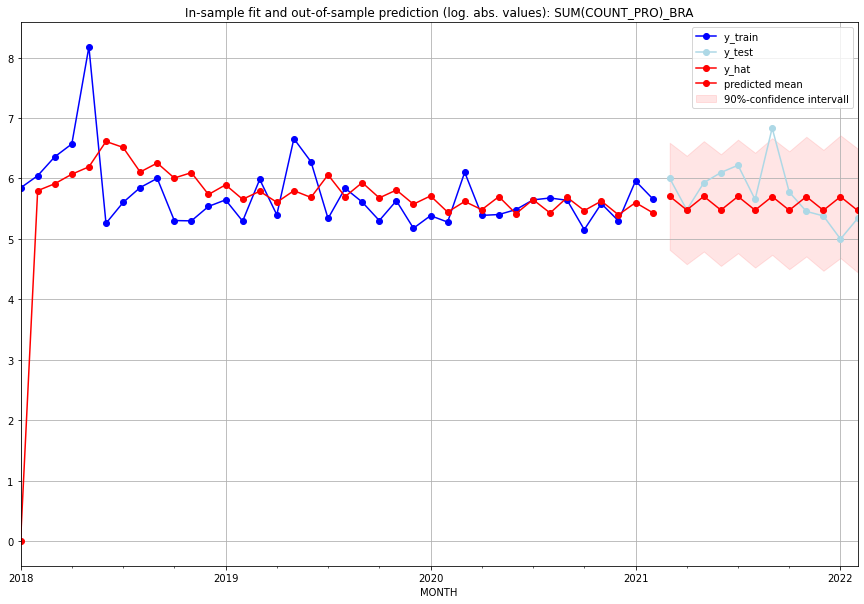

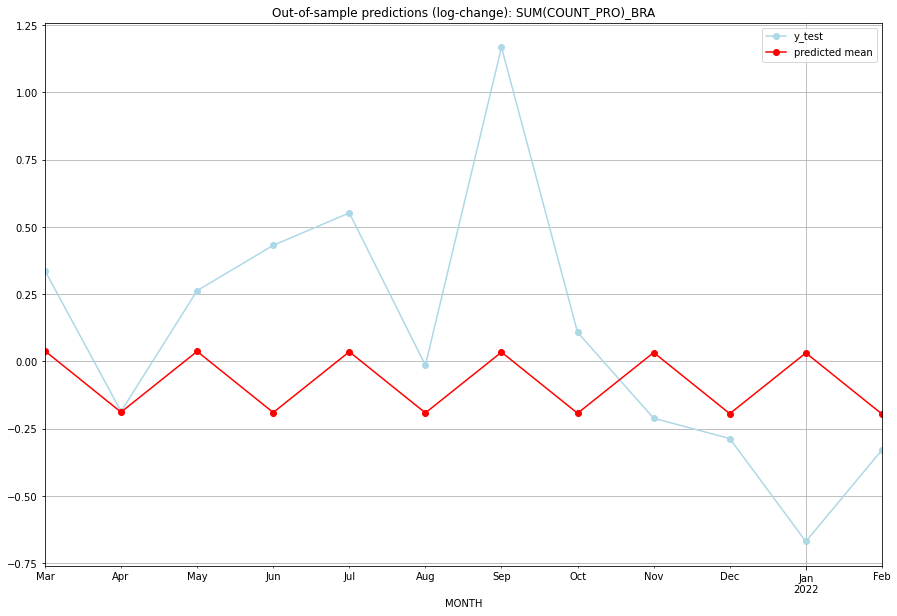

TADDA: 0.40780061338131895
Evaluation finished.
        MONTH    FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  299.485000       404.0      0.038971        0.337460   BRA   
1  2021-04-01  238.380020       239.0     -0.188374       -0.185788   BRA   
2  2021-05-01  299.045040       375.0      0.037506        0.263162   BRA   
3  2021-06-01  238.041409       444.0     -0.189790        0.431648   BRA   
4  2021-07-01  298.605838       501.0      0.036041        0.552173   BRA   
5  2021-08-01  237.703365       284.0     -0.191205       -0.013938   BRA   
6  2021-09-01  298.167391       928.0      0.034577        1.167682   BRA   
7  2021-10-01  237.365887       321.0     -0.192620        0.108125   BRA   
8  2021-11-01  297.729697       233.0      0.033112       -0.211106   BRA   
9  2021-12-01  237.028972       216.0     -0.194034       -0.286529   BRA   
10 2022-01-01  297.292757       147.0      0.031649       -0.669214   BRA   
11 2022-02-01  236.692620   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.39017760226035164, 'fold_results': [0.39017760226035164]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_BRB   No. Observations:                   38
Model:                        SARIMAX   Log Likelihood                 -17.343
Date:                Fri, 16 Sep 2022   AIC                             36.685
Time:                        13:55:34   BIC                             38.323
Sample:                    01-31-2018   HQIC                            37.268
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.1459      0.020      7.260      0.000 

<Figure size 432x288 with 0 Axes>

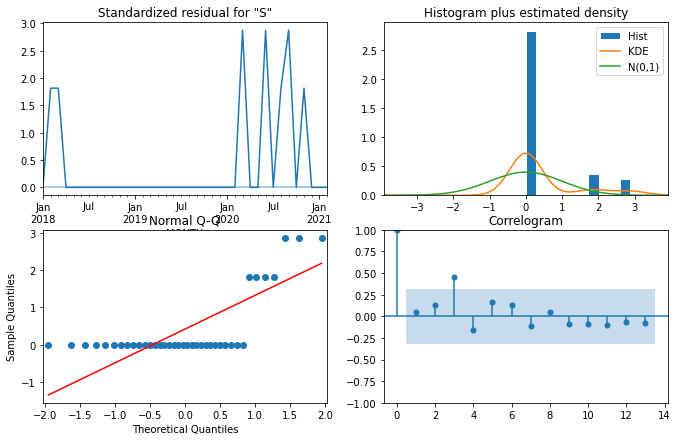

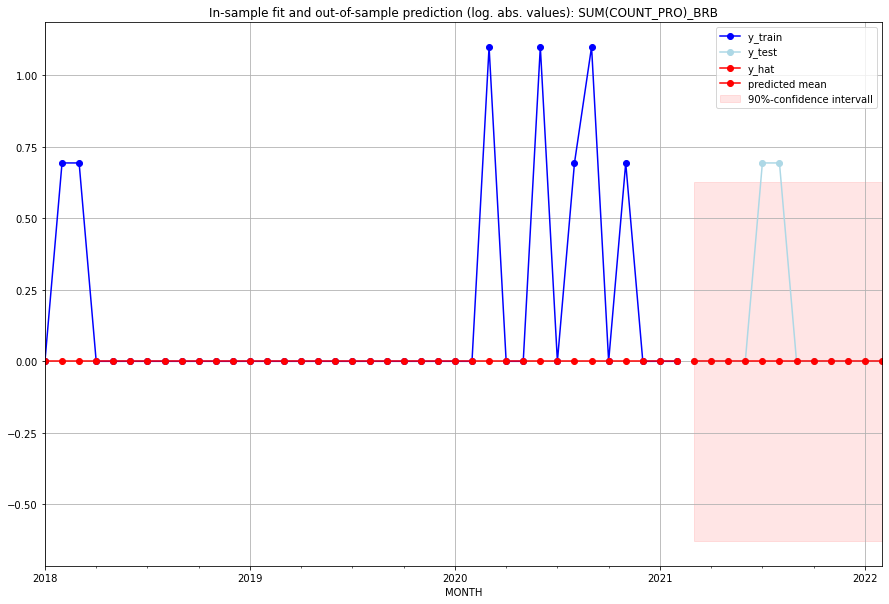

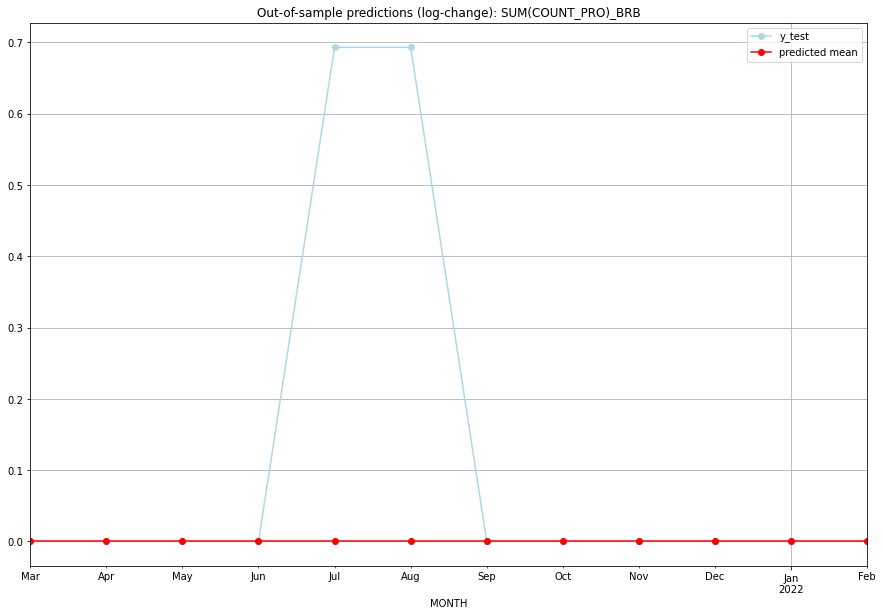

TADDA: 0.11552453009332421
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0        0.000000   BRB   
1  2021-04-01       0.0         0.0           0.0        0.000000   BRB   
2  2021-05-01       0.0         0.0           0.0        0.000000   BRB   
3  2021-06-01       0.0         0.0           0.0        0.000000   BRB   
4  2021-07-01       0.0         1.0           0.0        0.693147   BRB   
5  2021-08-01       0.0         1.0           0.0        0.693147   BRB   
6  2021-09-01       0.0         0.0           0.0        0.000000   BRB   
7  2021-10-01       0.0         0.0           0.0        0.000000   BRB   
8  2021-11-01       0.0         0.0           0.0        0.000000   BRB   
9  2021-12-01       0.0         0.0           0.0        0.000000   BRB   
10 2022-01-01       0.0         0.0           0.0        0.000000   BRB   
11 2022-02-01       0.0         0.0           0.0   

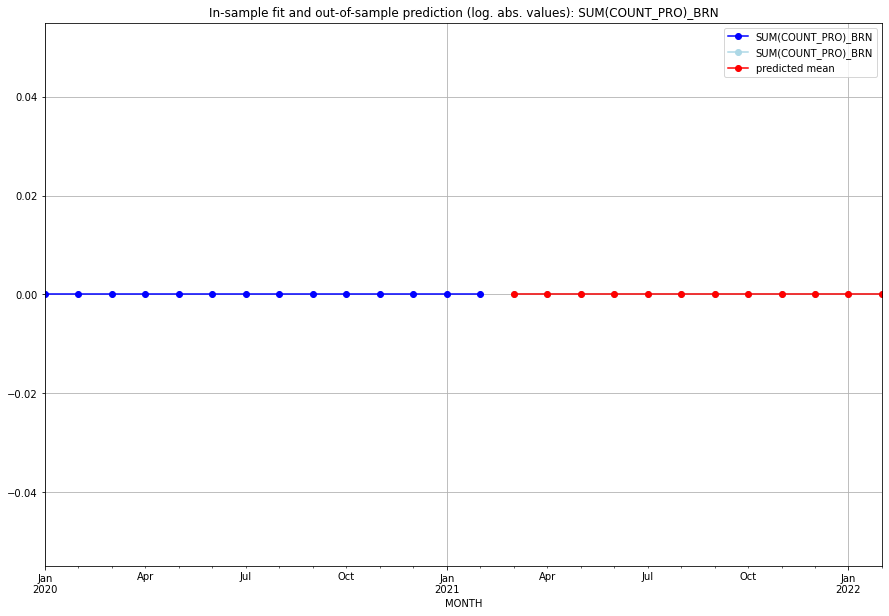

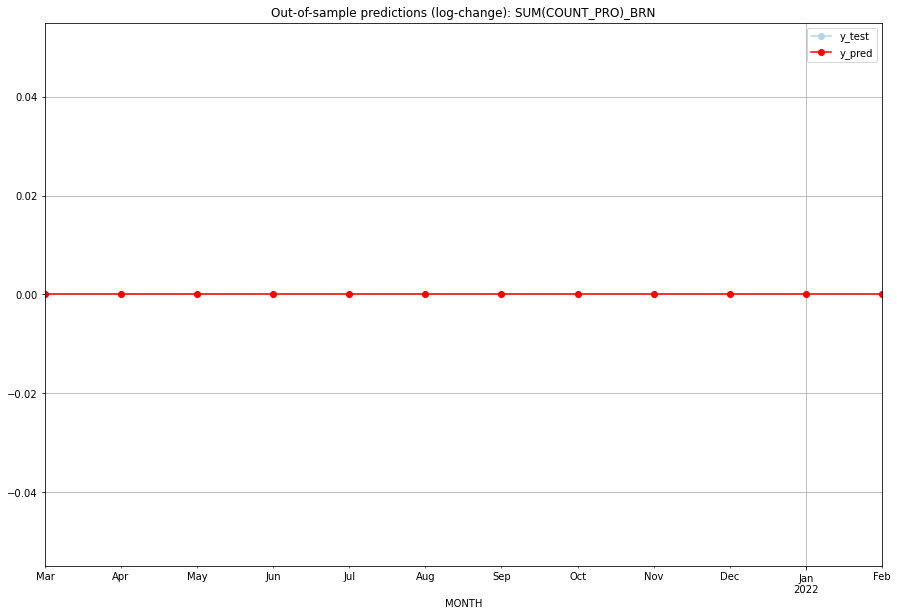

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   BRN   
1  2021-04-01       0.0         0.0           0.0             0.0   BRN   
2  2021-05-01       0.0         0.0           0.0             0.0   BRN   
3  2021-06-01       0.0         0.0           0.0             0.0   BRN   
4  2021-07-01       0.0         0.0           0.0             0.0   BRN   
5  2021-08-01       0.0         0.0           0.0             0.0   BRN   
6  2021-09-01       0.0         0.0           0.0             0.0   BRN   
7  2021-10-01       0.0         0.0           0.0             0.0   BRN   
8  2021-11-01       0.0         0.0           0.0             0.0   BRN   
9  2021-12-01       0.0         0.0           0.0             0.0   BRN   
10 2022-01-01       0.0         0.0           0.0             0.0   BRN   
11 2022-02-01       0.0         0.0           0.0             0.0   

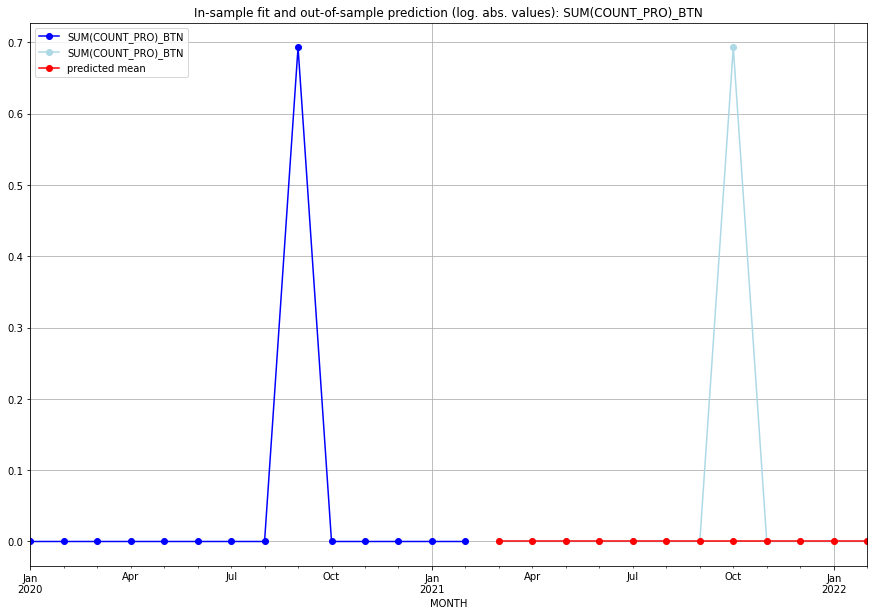

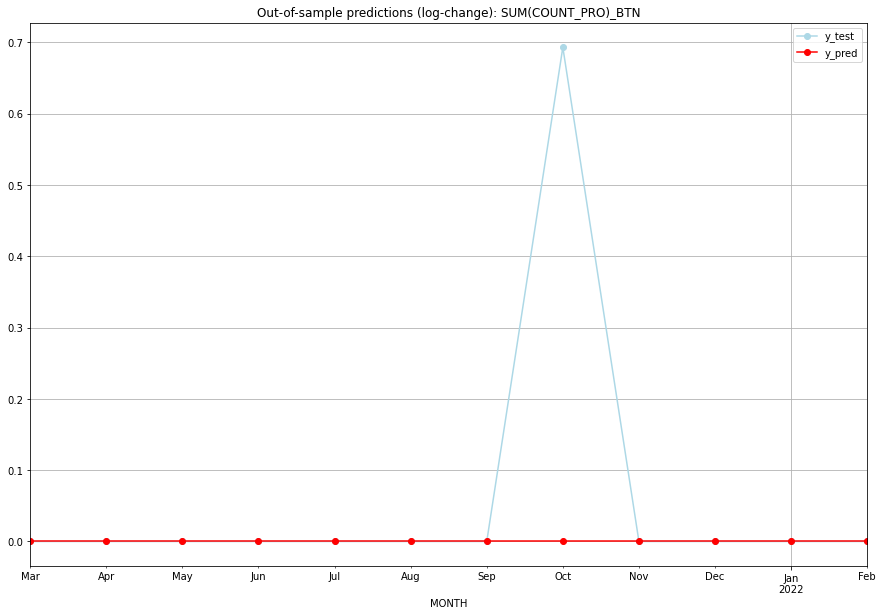

TADDA: 0.057762265046662105
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0    0.000000           0.0        0.000000   BTN   
1  2021-04-01       0.0    0.000000           0.0        0.000000   BTN   
2  2021-05-01       0.0    0.000000           0.0        0.000000   BTN   
3  2021-06-01       0.0    0.000000           0.0        0.000000   BTN   
4  2021-07-01       0.0    0.000000           0.0        0.000000   BTN   
5  2021-08-01       0.0    0.000000           0.0        0.000000   BTN   
6  2021-09-01       0.0    0.000000           0.0        0.000000   BTN   
7  2021-10-01       0.0    0.693147           0.0        0.693147   BTN   
8  2021-11-01       0.0    0.000000           0.0        0.000000   BTN   
9  2021-12-01       0.0    0.000000           0.0        0.000000   BTN   
10 2022-01-01       0.0    0.000000           0.0        0.000000   BTN   
11 2022-02-01       0.0    0.000000           0.0  

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.17328679513998632, 'fold_results': [0.17328679513998632]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_BWA   No. Observations:                  289
Model:                        SARIMAX   Log Likelihood                -108.569
Date:                Fri, 16 Sep 2022   AIC                            219.138
Time:                        13:56:14   BIC                            222.805
Sample:                    02-28-1997   HQIC                           220.608
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.1241      0.005     25.939      0.000 

<Figure size 432x288 with 0 Axes>

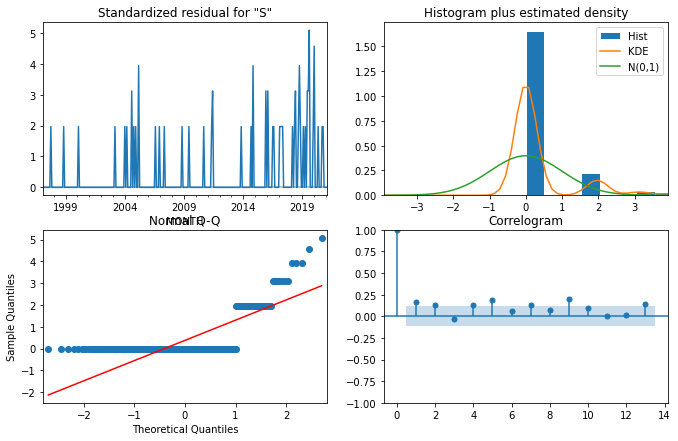

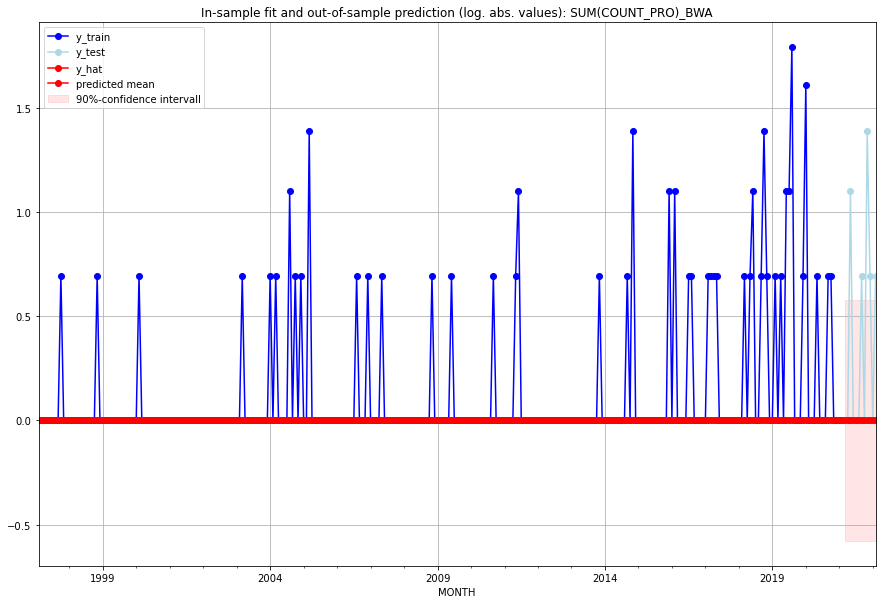

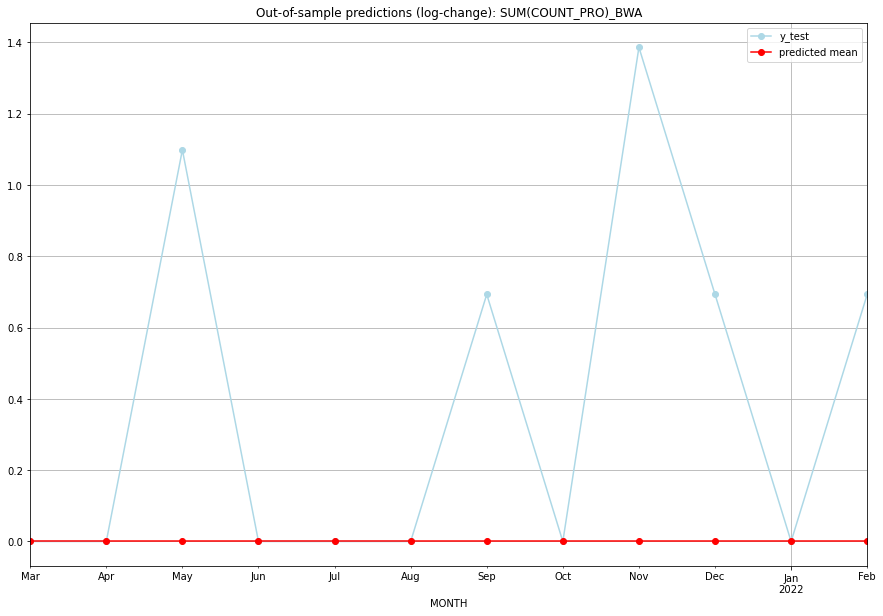

TADDA: 0.3803623492889863
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0        0.000000   BWA   
1  2021-04-01       0.0         0.0           0.0        0.000000   BWA   
2  2021-05-01       0.0         2.0           0.0        1.098612   BWA   
3  2021-06-01       0.0         0.0           0.0        0.000000   BWA   
4  2021-07-01       0.0         0.0           0.0        0.000000   BWA   
5  2021-08-01       0.0         0.0           0.0        0.000000   BWA   
6  2021-09-01       0.0         1.0           0.0        0.693147   BWA   
7  2021-10-01       0.0         0.0           0.0        0.000000   BWA   
8  2021-11-01       0.0         3.0           0.0        1.386294   BWA   
9  2021-12-01       0.0         1.0           0.0        0.693147   BWA   
10 2022-01-01       0.0         0.0           0.0        0.000000   BWA   
11 2022-02-01       0.0         1.0           0.0    

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [1, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.46052958041628794, 'fold_results': [0.46052958041628794]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_CAF   No. Observations:                  289
Model:                        SARIMAX   Log Likelihood                -405.722
Date:                Fri, 16 Sep 2022   AIC                            815.444
Time:                        13:56:42   BIC                            822.777
Sample:                    02-28-1997   HQIC                           818.383
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1             0.1541      0.016      9.646      0.000 

<Figure size 432x288 with 0 Axes>

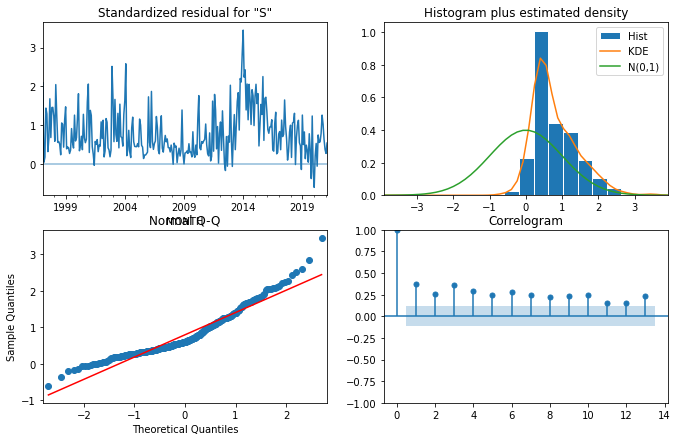

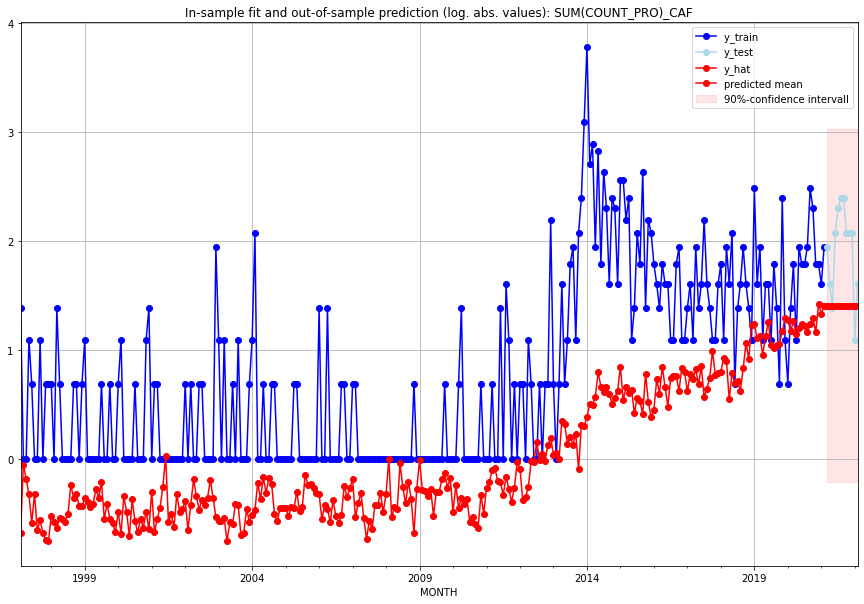

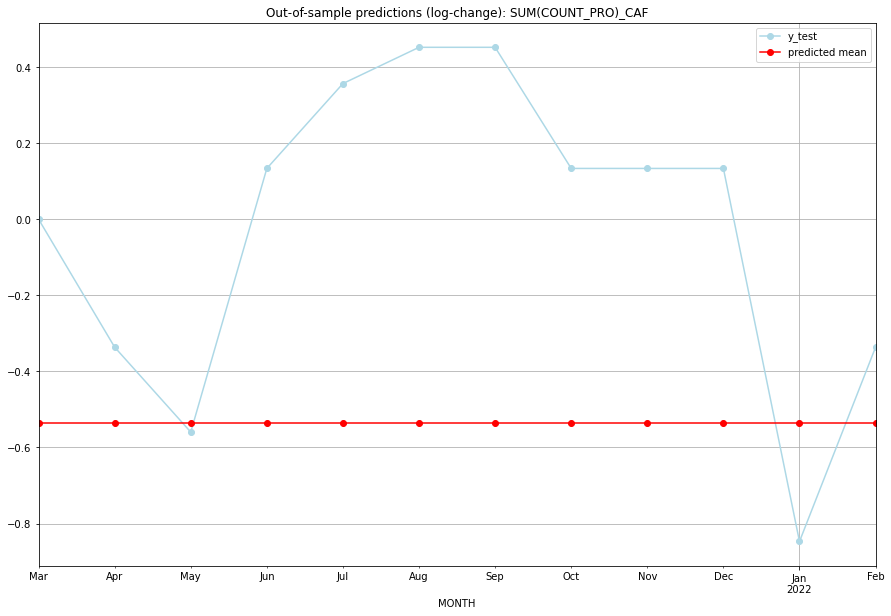

TADDA: 0.8809060913989142
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  3.095005         6.0     -0.536142        0.000000   CAF   
1  2021-04-01  3.095005         4.0     -0.536142       -0.336472   CAF   
2  2021-05-01  3.095005         3.0     -0.536142       -0.559616   CAF   
3  2021-06-01  3.095005         7.0     -0.536142        0.133531   CAF   
4  2021-07-01  3.095005         9.0     -0.536142        0.356675   CAF   
5  2021-08-01  3.095005        10.0     -0.536142        0.451985   CAF   
6  2021-09-01  3.095005        10.0     -0.536142        0.451985   CAF   
7  2021-10-01  3.095005         7.0     -0.536142        0.133531   CAF   
8  2021-11-01  3.095005         7.0     -0.536142        0.133531   CAF   
9  2021-12-01  3.095005         7.0     -0.536142        0.133531   CAF   
10 2022-01-01  3.095005         2.0     -0.536142       -0.847298   CAF   
11 2022-02-01  3.095005         4.0     -0.536142    

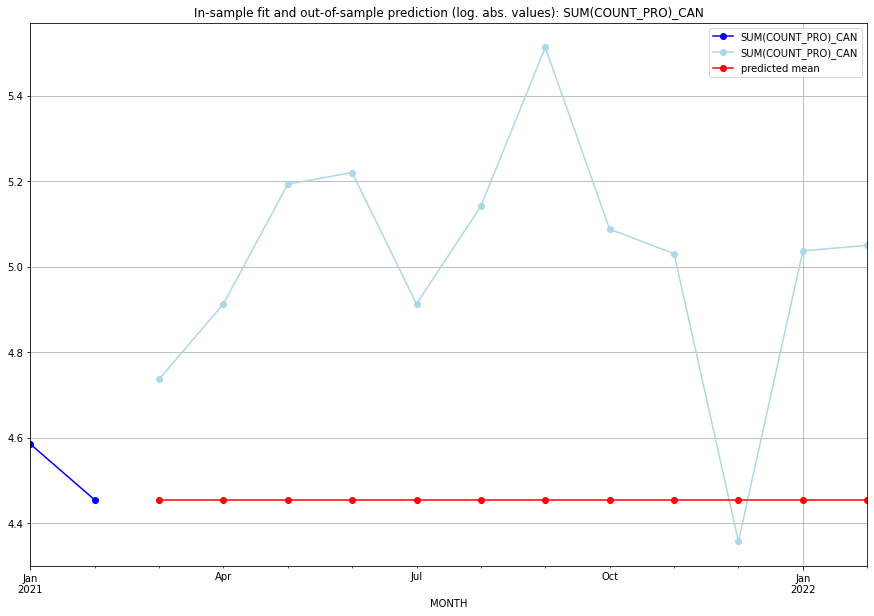

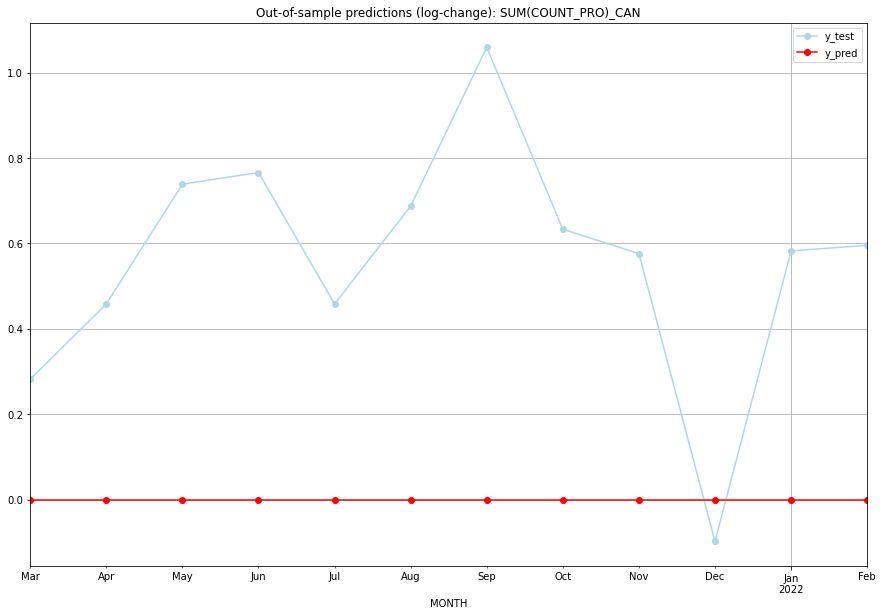

TADDA: 0.5778811896305083
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  4.454347    4.736198           0.0        0.281851   CAN   
1  2021-04-01  4.454347    4.912655           0.0        0.458308   CAN   
2  2021-05-01  4.454347    5.192957           0.0        0.738610   CAN   
3  2021-06-01  4.454347    5.220356           0.0        0.766009   CAN   
4  2021-07-01  4.454347    4.912655           0.0        0.458308   CAN   
5  2021-08-01  4.454347    5.141664           0.0        0.687316   CAN   
6  2021-09-01  4.454347    5.513429           0.0        1.059081   CAN   
7  2021-10-01  4.454347    5.087596           0.0        0.633249   CAN   
8  2021-11-01  4.454347    5.030438           0.0        0.576091   CAN   
9  2021-12-01  4.454347    4.356709           0.0       -0.097638   CAN   
10 2022-01-01  4.454347    5.036953           0.0        0.582605   CAN   
11 2022-02-01  4.454347    5.049856           0.0    

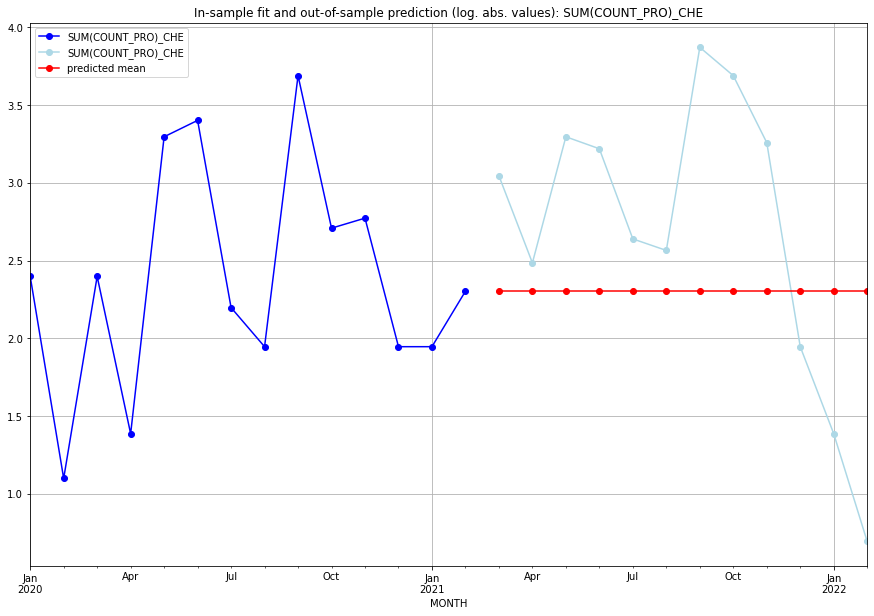

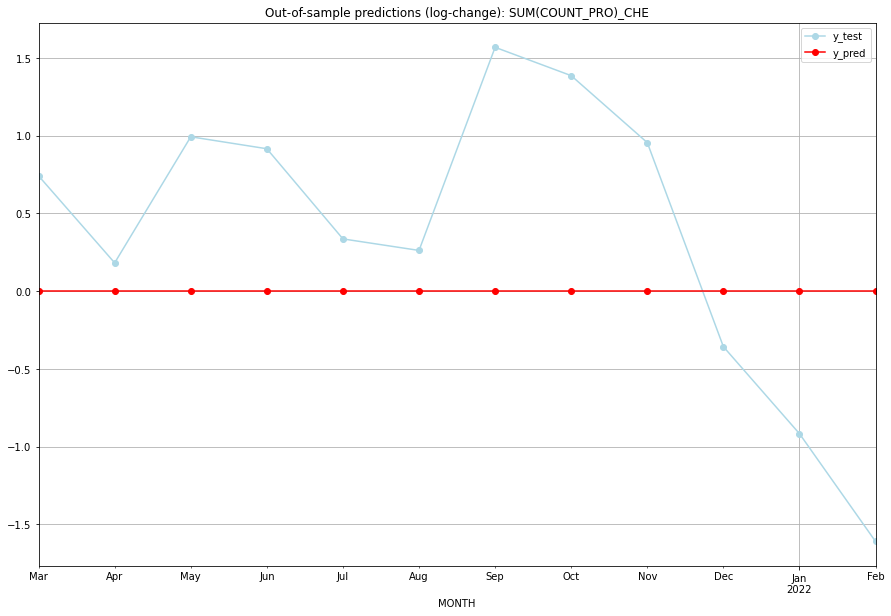

TADDA: 0.8521219349837196
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  2.302585    3.044522           0.0        0.741937   CHE   
1  2021-04-01  2.302585    2.484907           0.0        0.182322   CHE   
2  2021-05-01  2.302585    3.295837           0.0        0.993252   CHE   
3  2021-06-01  2.302585    3.218876           0.0        0.916291   CHE   
4  2021-07-01  2.302585    2.639057           0.0        0.336472   CHE   
5  2021-08-01  2.302585    2.564949           0.0        0.262364   CHE   
6  2021-09-01  2.302585    3.871201           0.0        1.568616   CHE   
7  2021-10-01  2.302585    3.688879           0.0        1.386294   CHE   
8  2021-11-01  2.302585    3.258097           0.0        0.955511   CHE   
9  2021-12-01  2.302585    1.945910           0.0       -0.356675   CHE   
10 2022-01-01  2.302585    1.386294           0.0       -0.916291   CHE   
11 2022-02-01  2.302585    0.693147           0.0    

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [2, (3, 0, 1), (0, 0, 0, 0), 'n'], 'cv_score': 0.5428281879567111, 'fold_results': [0.5428281879567111]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_CHL   No. Observations:                   38
Model:               SARIMAX(3, 0, 1)   Log Likelihood                 -34.241
Date:                Fri, 16 Sep 2022   AIC                             82.482
Time:                        13:57:12   BIC                             93.945
Sample:                    01-31-2018   HQIC                            86.560
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1             0.1018      0.070      1.455      0.146   

<Figure size 432x288 with 0 Axes>

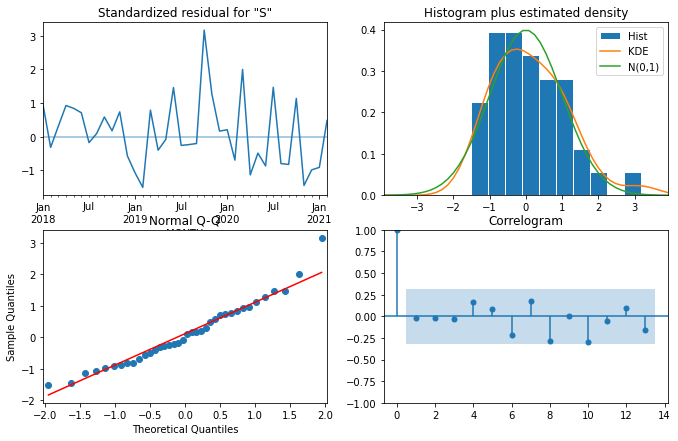

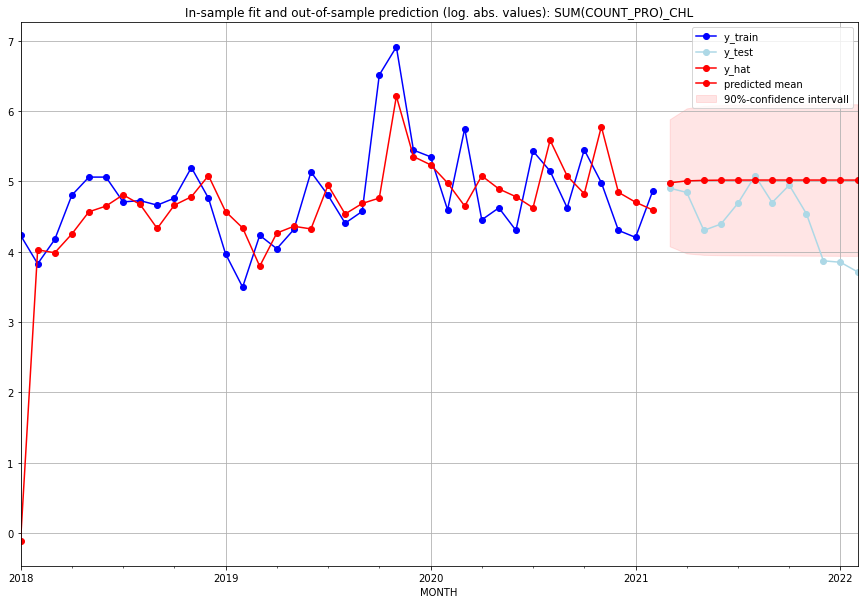

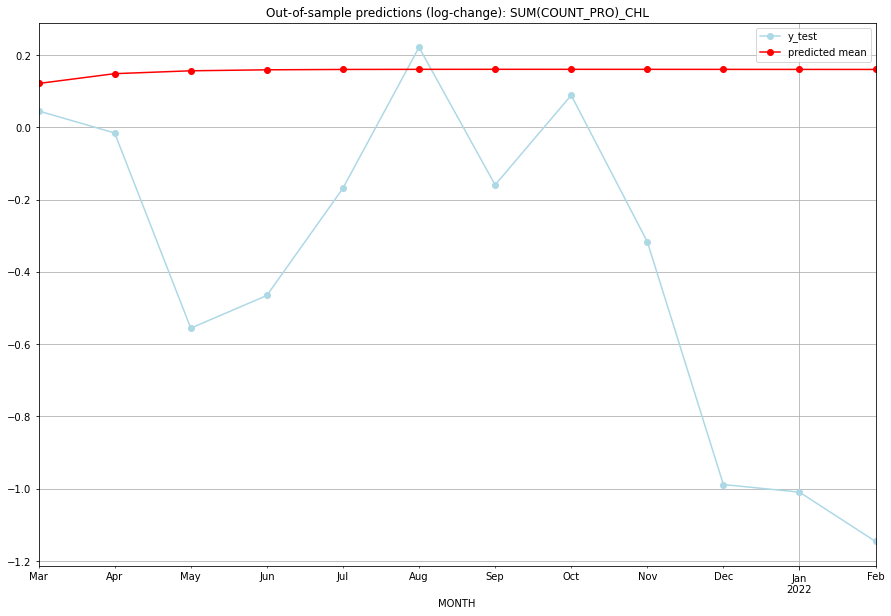

TADDA: 0.6574172989878607
Evaluation finished.
        MONTH    FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  144.663504       134.0      0.121487        0.045462   CHL   
1  2021-04-01  148.670578       126.0      0.148624       -0.015625   CHL   
2  2021-05-01  149.868371        73.0      0.156595       -0.555747   CHL   
3  2021-06-01  150.281235        80.0      0.159328       -0.465363   CHL   
4  2021-07-01  150.428227       108.0      0.160299       -0.168465   CHL   
5  2021-08-01  150.476461       160.0      0.160618        0.221592   CHL   
6  2021-09-01  150.486717       109.0      0.160686       -0.159332   CHL   
7  2021-10-01  150.482198       140.0      0.160656        0.088947   CHL   
8  2021-11-01  150.471908        93.0      0.160588       -0.316518   CHL   
9  2021-12-01  150.459362        47.0      0.160505       -0.988611   CHL   
10 2022-01-01  150.445934        46.0      0.160416       -1.009665   CHL   
11 2022-02-01  150.432163    

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (1, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.4657457120695589, 'fold_results': [0.4657457120695589]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_CHN   No. Observations:                   38
Model:               SARIMAX(1, 1, 0)   Log Likelihood                 -25.710
Date:                Fri, 16 Sep 2022   AIC                             55.419
Time:                        13:57:32   BIC                             58.641
Sample:                    01-31-2018   HQIC                            56.555
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.2364      0.096     -2.473      0.013   

<Figure size 432x288 with 0 Axes>

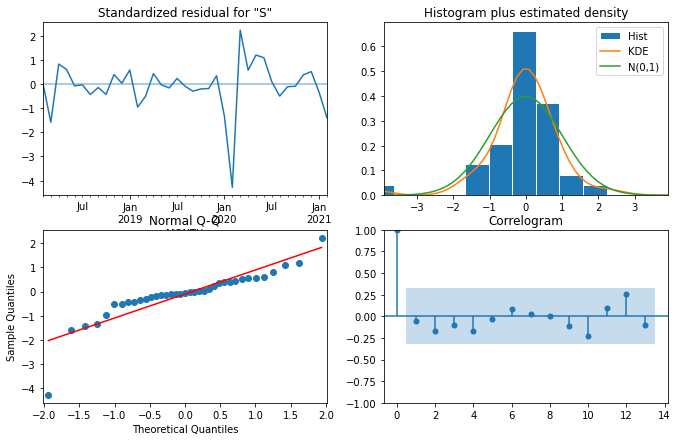

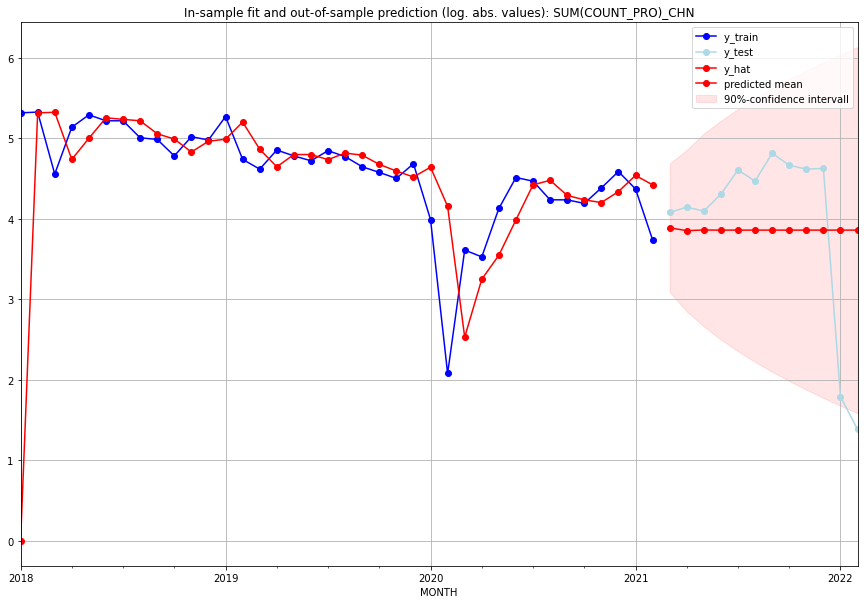

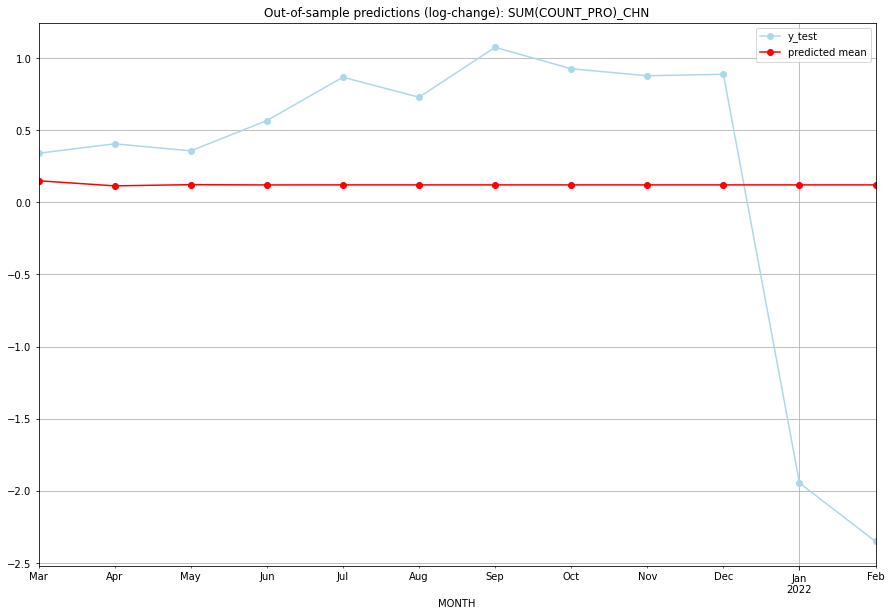

TADDA: 0.8815559682808857
Evaluation finished.
        MONTH   FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  47.764527        58.0      0.149334        0.339868   CHN   
1  2021-04-01  46.073262        62.0      0.114036        0.405465   CHN   
2  2021-05-01  46.467656        59.0      0.122379        0.356675   CHN   
3  2021-06-01  46.374136        73.0      0.120407        0.566395   CHN   
4  2021-07-01  46.396224        99.0      0.120873        0.867501   CHN   
5  2021-08-01  46.391002        86.0      0.120763        0.728239   CHN   
6  2021-09-01  46.392237       122.0      0.120789        1.074515   CHN   
7  2021-10-01  46.391945       105.0      0.120783        0.925769   CHN   
8  2021-11-01  46.392014       100.0      0.120784        0.877451   CHN   
9  2021-12-01  46.391998       101.0      0.120784        0.887303   CHN   
10 2022-01-01  46.392001         5.0      0.120784       -1.945910   CHN   
11 2022-02-01  46.392001         3.0     

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.7088440431964083, 'fold_results': [0.7088440431964083]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_CIV   No. Observations:                  289
Model:               SARIMAX(0, 1, 0)   Log Likelihood                -397.295
Date:                Fri, 16 Sep 2022   AIC                            796.590
Time:                        13:57:51   BIC                            800.253
Sample:                    02-28-1997   HQIC                           798.058
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.9241      0.060     15.435      0.000   

<Figure size 432x288 with 0 Axes>

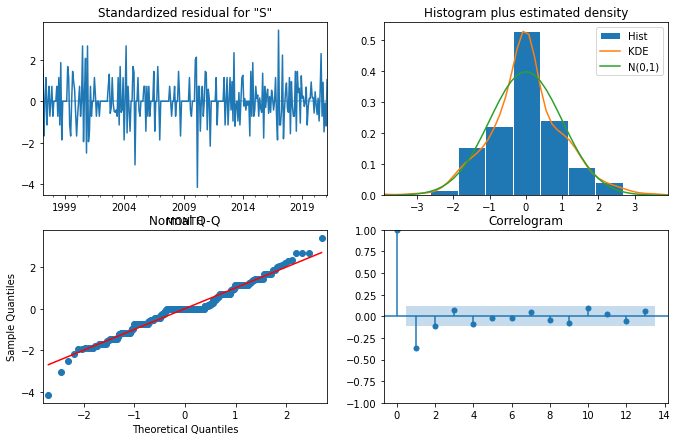

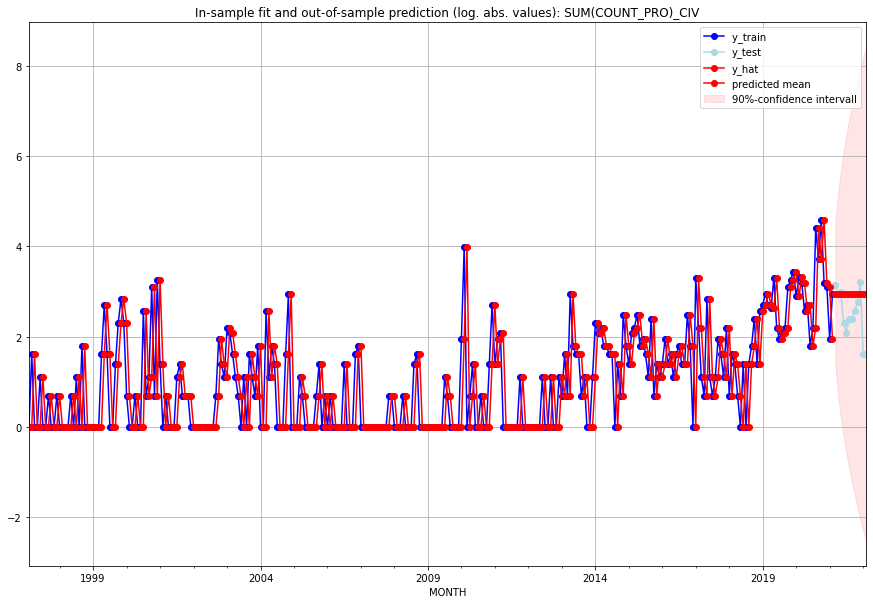

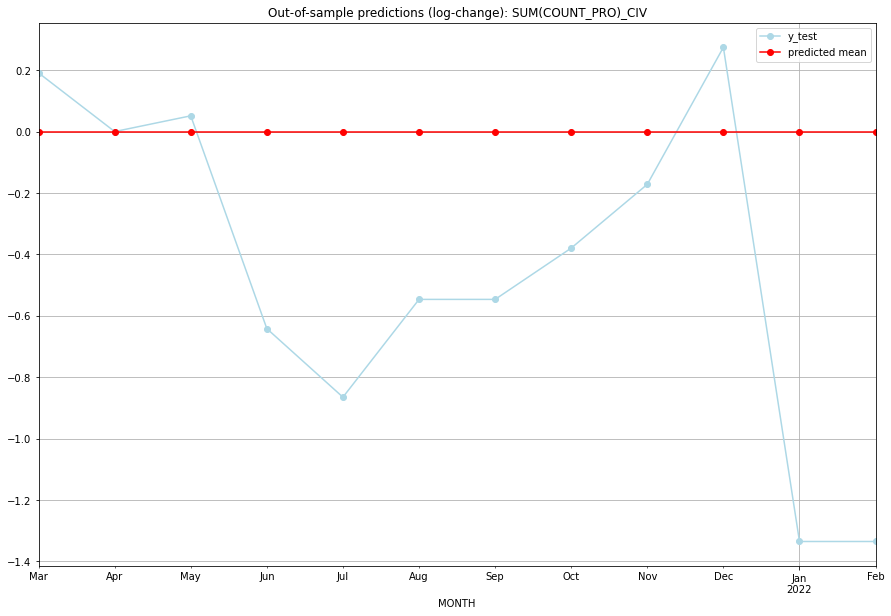

TADDA: 0.52817217711195
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01      18.0        22.0           0.0        0.191055   CIV   
1  2021-04-01      18.0        18.0           0.0        0.000000   CIV   
2  2021-05-01      18.0        19.0           0.0        0.051293   CIV   
3  2021-06-01      18.0         9.0           0.0       -0.641854   CIV   
4  2021-07-01      18.0         7.0           0.0       -0.864997   CIV   
5  2021-08-01      18.0        10.0           0.0       -0.546544   CIV   
6  2021-09-01      18.0        10.0           0.0       -0.546544   CIV   
7  2021-10-01      18.0        12.0           0.0       -0.379490   CIV   
8  2021-11-01      18.0        15.0           0.0       -0.171850   CIV   
9  2021-12-01      18.0        24.0           0.0        0.274437   CIV   
10 2022-01-01      18.0         4.0           0.0       -1.335001   CIV   
11 2022-02-01      18.0         4.0           0.0      

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [1, (0, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.2629538571075853, 'fold_results': [0.2629538571075853]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_CMR   No. Observations:                  289
Model:               SARIMAX(0, 1, 0)   Log Likelihood                -249.478
Date:                Fri, 16 Sep 2022   AIC                            502.956
Time:                        13:58:12   BIC                            510.282
Sample:                    02-28-1997   HQIC                           505.892
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            -0.0163      0.028     -0.587      0.557   

<Figure size 432x288 with 0 Axes>

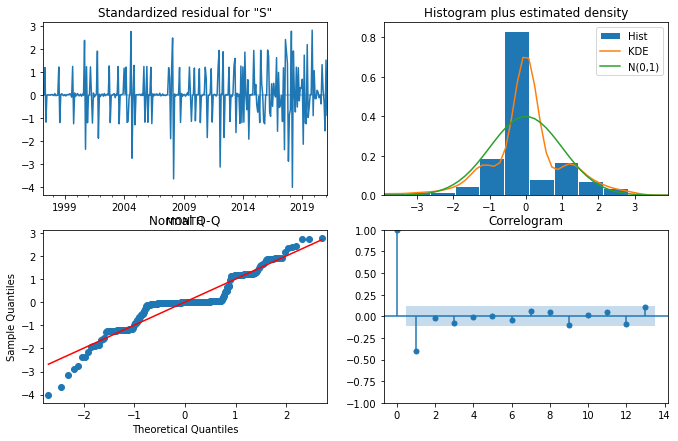

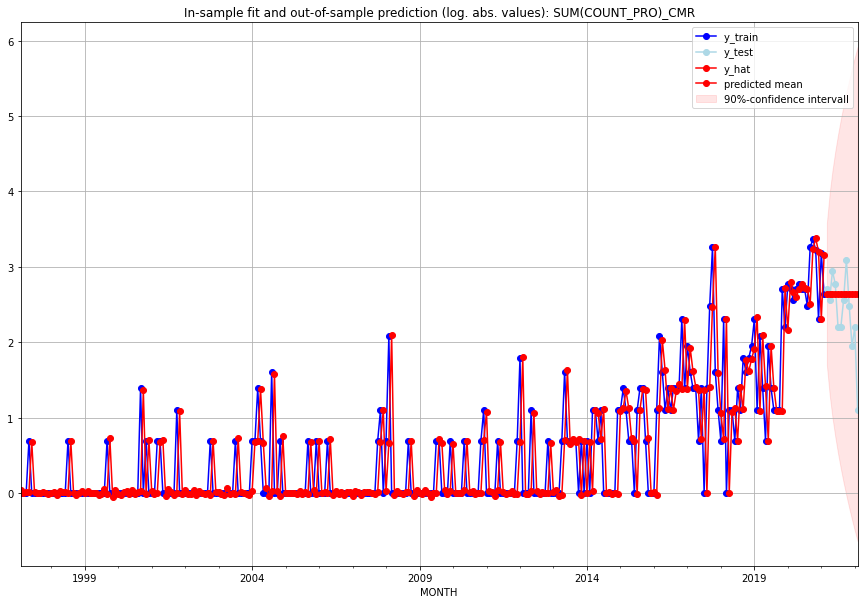

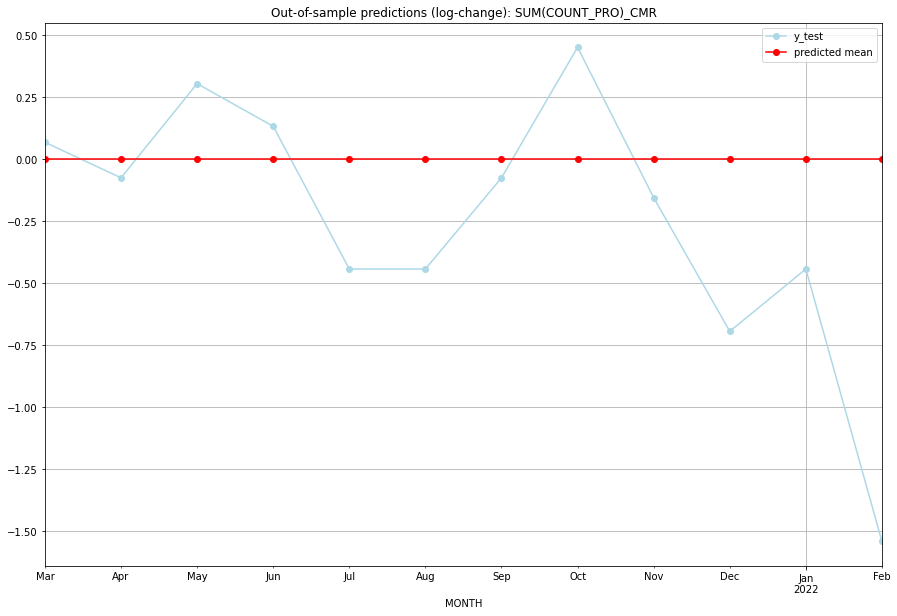

TADDA: 0.40177901165705204
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01      13.0        14.0           0.0        0.068993   CMR   
1  2021-04-01      13.0        12.0           0.0       -0.074108   CMR   
2  2021-05-01      13.0        18.0           0.0        0.305382   CMR   
3  2021-06-01      13.0        15.0           0.0        0.133531   CMR   
4  2021-07-01      13.0         8.0           0.0       -0.441833   CMR   
5  2021-08-01      13.0         8.0           0.0       -0.441833   CMR   
6  2021-09-01      13.0        12.0           0.0       -0.074108   CMR   
7  2021-10-01      13.0        21.0           0.0        0.451985   CMR   
8  2021-11-01      13.0        11.0           0.0       -0.154151   CMR   
9  2021-12-01      13.0         6.0           0.0       -0.693147   CMR   
10 2022-01-01      13.0         8.0           0.0       -0.441833   CMR   
11 2022-02-01      13.0         2.0           0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 1, 1), (0, 0, 0, 0), 'n'], 'cv_score': 0.33321913188738944, 'fold_results': [0.33321913188738944]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_COD   No. Observations:                  289
Model:               SARIMAX(0, 1, 1)   Log Likelihood                -269.869
Date:                Fri, 16 Sep 2022   AIC                            543.739
Time:                        13:58:32   BIC                            551.065
Sample:                    02-28-1997   HQIC                           546.675
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ma.L1         -0.6819      0.046    -14.783      0.000 

[12 rows x 72 columns]


<Figure size 432x288 with 0 Axes>

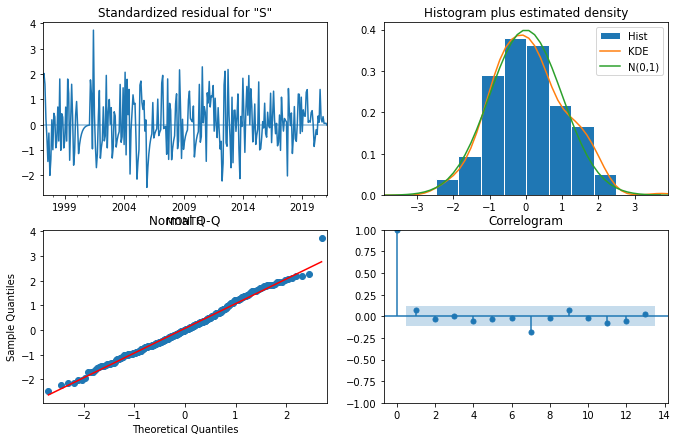

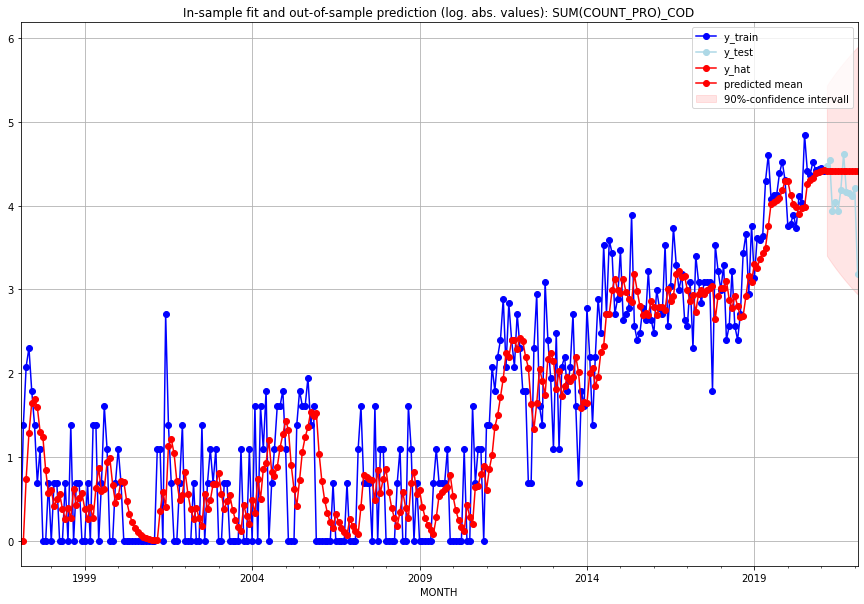

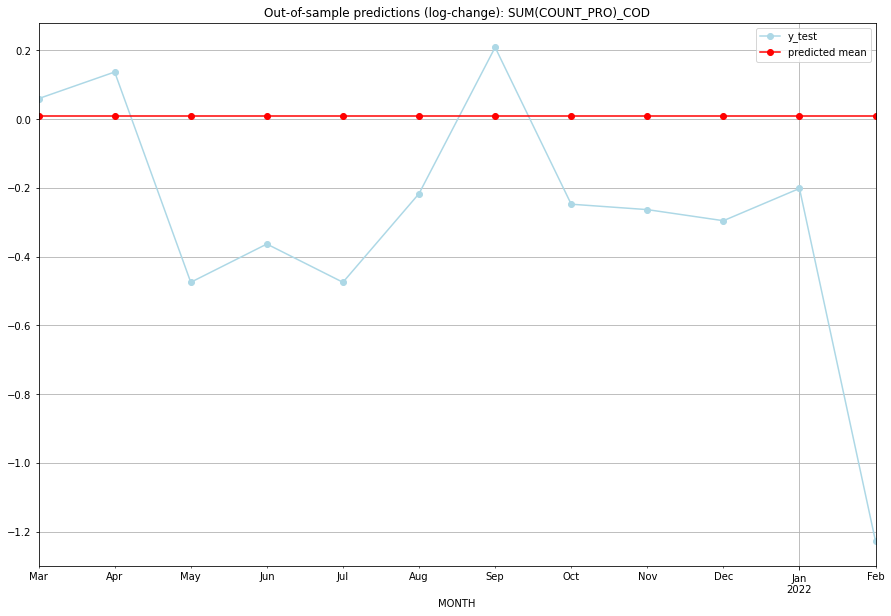

TADDA: 0.3584838283082605
Evaluation finished.
        MONTH   FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  81.709137        86.0      0.008611        0.059189   COD   
1  2021-04-01  81.709137        93.0      0.008611        0.136576   COD   
2  2021-05-01  81.709137        50.0      0.008611       -0.474894   COD   
3  2021-06-01  81.709137        56.0      0.008611       -0.363668   COD   
4  2021-07-01  81.709137        50.0      0.008611       -0.474894   COD   
5  2021-08-01  81.709137        65.0      0.008611       -0.217065   COD   
6  2021-09-01  81.709137       100.0      0.008611        0.208401   COD   
7  2021-10-01  81.709137        63.0      0.008611       -0.247836   COD   
8  2021-11-01  81.709137        62.0      0.008611       -0.263585   COD   
9  2021-12-01  81.709137        60.0      0.008611       -0.295845   COD   
10 2022-01-01  81.709137        66.0      0.008611       -0.202027   COD   
11 2022-02-01  81.709137        23.0     

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [1, (0, 1, 1), (0, 0, 0, 0), 'n'], 'cv_score': 0.5294109711436639, 'fold_results': [0.5294109711436639]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_COG   No. Observations:                  289
Model:               SARIMAX(0, 1, 1)   Log Likelihood                -123.264
Date:                Fri, 16 Sep 2022   AIC                            252.529
Time:                        13:58:52   BIC                            263.518
Sample:                    02-28-1997   HQIC                           256.933
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1             0.0142      0.015      0.976      0.329   

<Figure size 432x288 with 0 Axes>

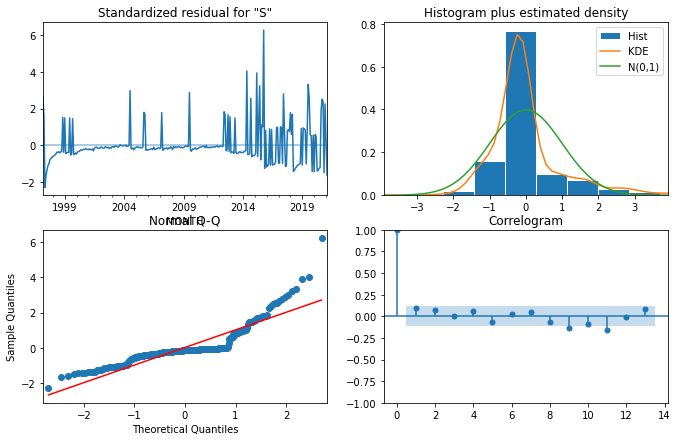

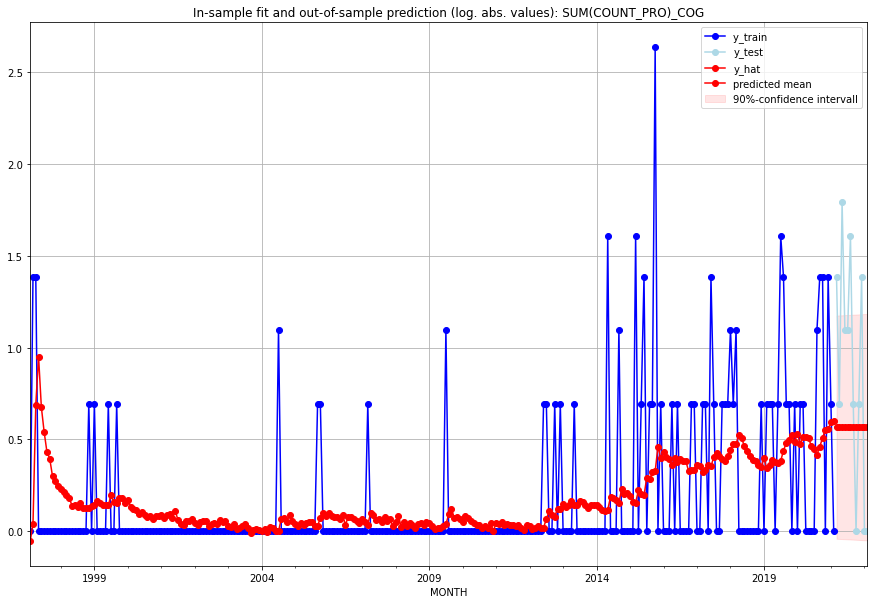

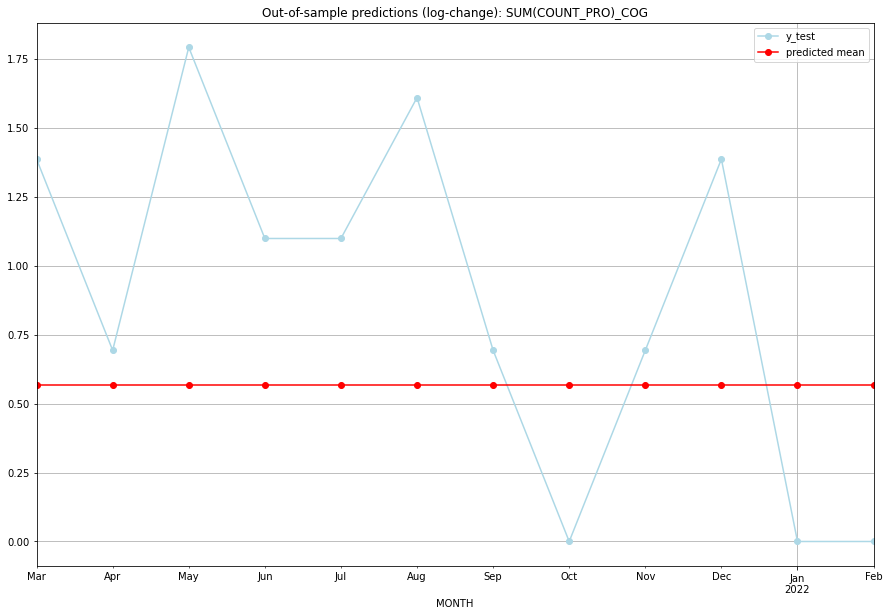

TADDA: 0.5874022247378
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01   0.76286         3.0      0.566938        1.386294   COG   
1  2021-04-01   0.76286         1.0      0.566938        0.693147   COG   
2  2021-05-01   0.76286         5.0      0.566938        1.791759   COG   
3  2021-06-01   0.76286         2.0      0.566938        1.098612   COG   
4  2021-07-01   0.76286         2.0      0.566938        1.098612   COG   
5  2021-08-01   0.76286         4.0      0.566938        1.609438   COG   
6  2021-09-01   0.76286         1.0      0.566938        0.693147   COG   
7  2021-10-01   0.76286         0.0      0.566938        0.000000   COG   
8  2021-11-01   0.76286         1.0      0.566938        0.693147   COG   
9  2021-12-01   0.76286         3.0      0.566938        1.386294   COG   
10 2022-01-01   0.76286         0.0      0.566938        0.000000   COG   
11 2022-02-01   0.76286         0.0      0.566938       

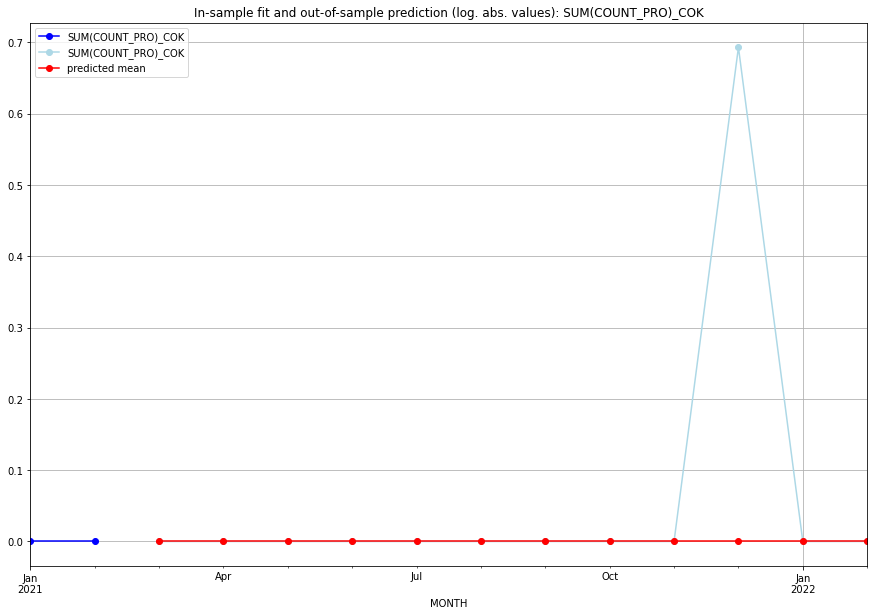

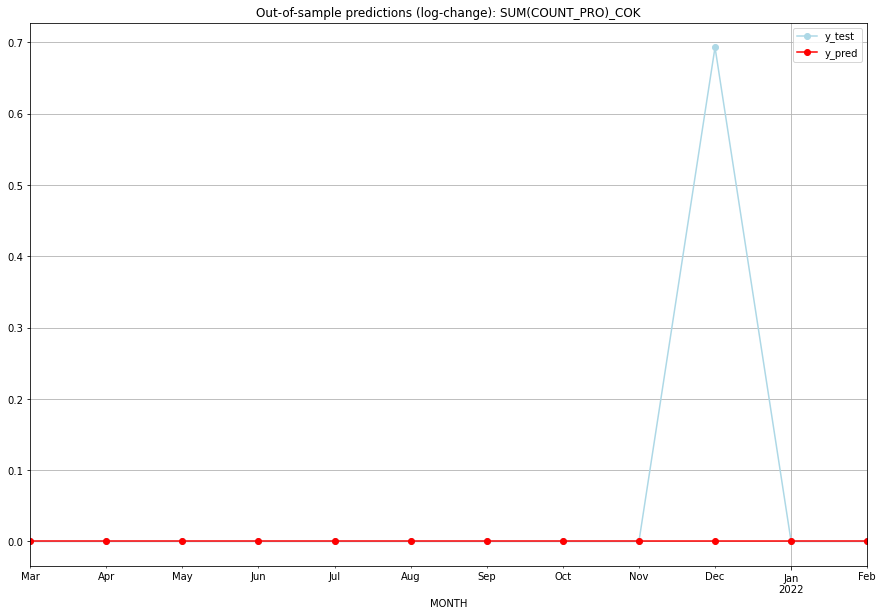

TADDA: 0.057762265046662105
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0    0.000000           0.0        0.000000   COK   
1  2021-04-01       0.0    0.000000           0.0        0.000000   COK   
2  2021-05-01       0.0    0.000000           0.0        0.000000   COK   
3  2021-06-01       0.0    0.000000           0.0        0.000000   COK   
4  2021-07-01       0.0    0.000000           0.0        0.000000   COK   
5  2021-08-01       0.0    0.000000           0.0        0.000000   COK   
6  2021-09-01       0.0    0.000000           0.0        0.000000   COK   
7  2021-10-01       0.0    0.000000           0.0        0.000000   COK   
8  2021-11-01       0.0    0.000000           0.0        0.000000   COK   
9  2021-12-01       0.0    0.693147           0.0        0.693147   COK   
10 2022-01-01       0.0    0.000000           0.0        0.000000   COK   
11 2022-02-01       0.0    0.000000           0.0  

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [3, (0, 1, 2), (0, 0, 0, 0), 'n'], 'cv_score': 0.2436327306462016, 'fold_results': [0.2436327306462016]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_COL   No. Observations:                   38
Model:               SARIMAX(0, 1, 2)   Log Likelihood                 -47.605
Date:                Fri, 16 Sep 2022   AIC                            107.211
Time:                        13:59:05   BIC                            116.876
Sample:                    01-31-2018   HQIC                           110.619
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1             0.1981      0.103      1.923      0.054   

<Figure size 432x288 with 0 Axes>

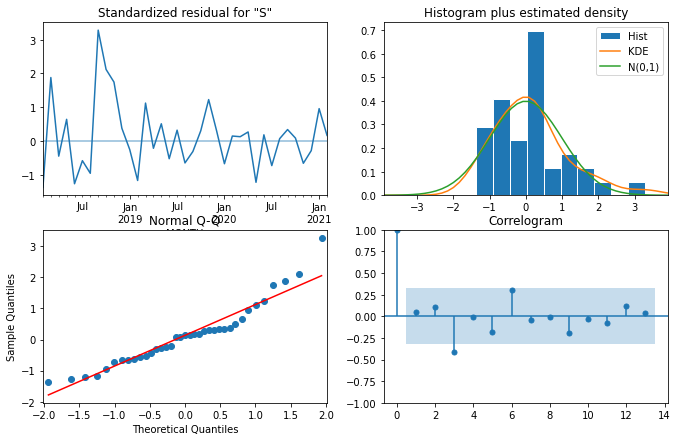

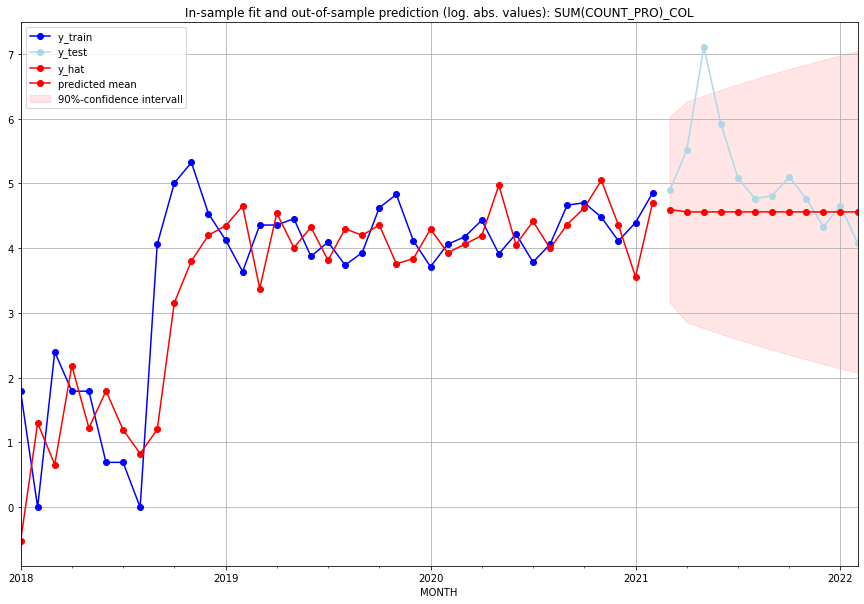

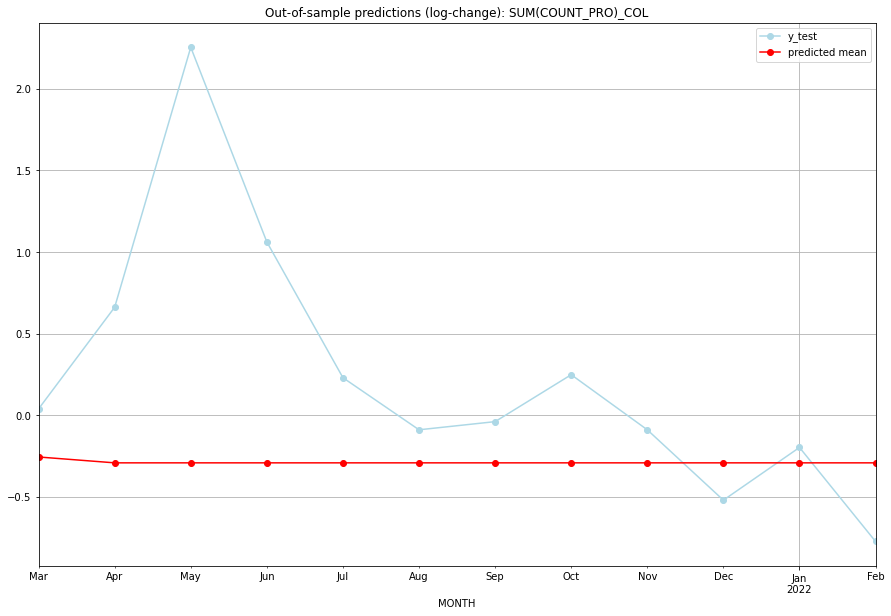

TADDA: 0.7828014837625314
Evaluation finished.
        MONTH   FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  98.041818       132.0     -0.256488        0.038319   COL   
1  2021-04-01  94.542540       247.0     -0.292459        0.661398   COL   
2  2021-05-01  94.542540      1219.0     -0.292459        2.254576   COL   
3  2021-06-01  94.542540       369.0     -0.292459        1.061473   COL   
4  2021-07-01  94.542540       160.0     -0.292459        0.229374   COL   
5  2021-08-01  94.542540       116.0     -0.292459       -0.089856   COL   
6  2021-09-01  94.542540       122.0     -0.292459       -0.039846   COL   
7  2021-10-01  94.542540       163.0     -0.292459        0.247836   COL   
8  2021-11-01  94.542540       116.0     -0.292459       -0.089856   COL   
9  2021-12-01  94.542540        75.0     -0.292459       -0.521297   COL   
10 2022-01-01  94.542540       104.0     -0.292459       -0.198070   COL   
11 2022-02-01  94.542540        58.0     

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.5908397363146743, 'fold_results': [0.5908397363146743]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_COM   No. Observations:                  289
Model:               SARIMAX(0, 1, 0)   Log Likelihood                  63.147
Date:                Fri, 16 Sep 2022   AIC                           -124.295
Time:                        13:59:12   BIC                           -120.632
Sample:                    02-28-1997   HQIC                          -122.827
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.0378      0.001     58.227      0.000   

<Figure size 432x288 with 0 Axes>

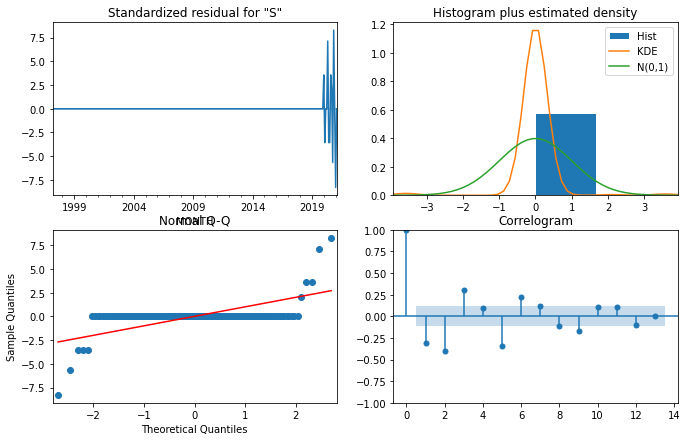

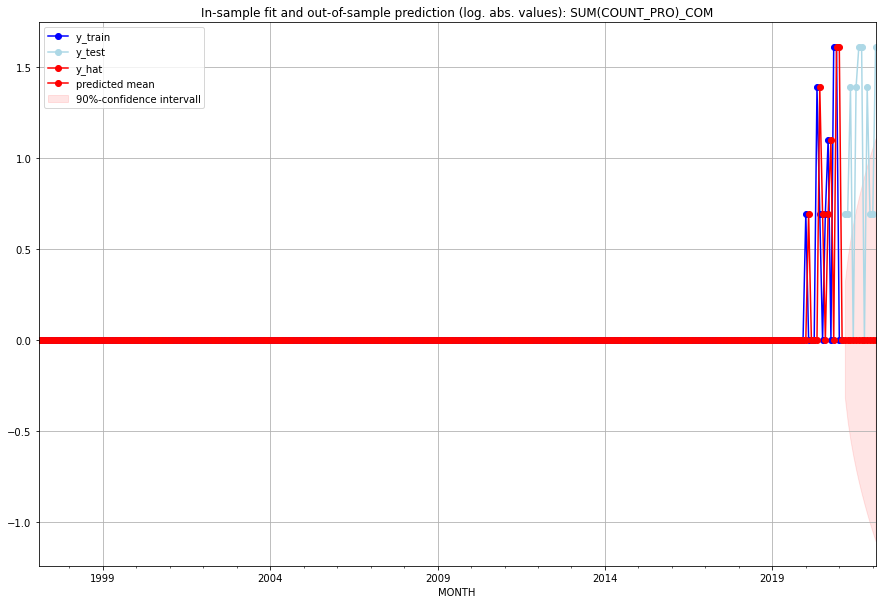

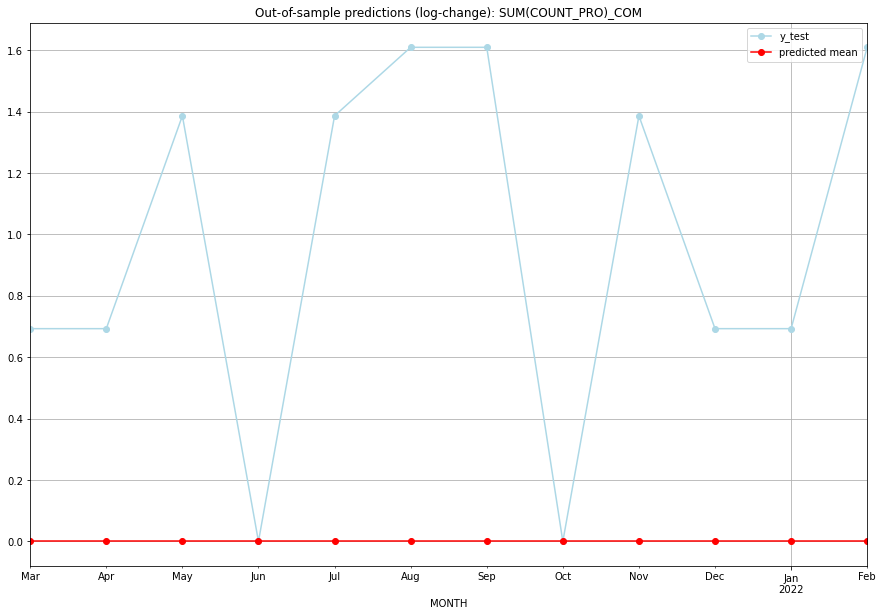

TADDA: 0.9799821285751461
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         1.0           0.0        0.693147   COM   
1  2021-04-01       0.0         1.0           0.0        0.693147   COM   
2  2021-05-01       0.0         3.0           0.0        1.386294   COM   
3  2021-06-01       0.0         0.0           0.0        0.000000   COM   
4  2021-07-01       0.0         3.0           0.0        1.386294   COM   
5  2021-08-01       0.0         4.0           0.0        1.609438   COM   
6  2021-09-01       0.0         4.0           0.0        1.609438   COM   
7  2021-10-01       0.0         0.0           0.0        0.000000   COM   
8  2021-11-01       0.0         3.0           0.0        1.386294   COM   
9  2021-12-01       0.0         1.0           0.0        0.693147   COM   
10 2022-01-01       0.0         1.0           0.0        0.693147   COM   
11 2022-02-01       0.0         4.0           0.0    

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (2, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 1.301269849351157, 'fold_results': [1.301269849351157]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_CPV   No. Observations:                  289
Model:               SARIMAX(2, 0, 0)   Log Likelihood                  -0.268
Date:                Fri, 16 Sep 2022   AIC                              6.536
Time:                        13:59:18   BIC                             17.536
Sample:                    02-28-1997   HQIC                            10.944
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.4117      0.026     15.677      0.000     

<Figure size 432x288 with 0 Axes>

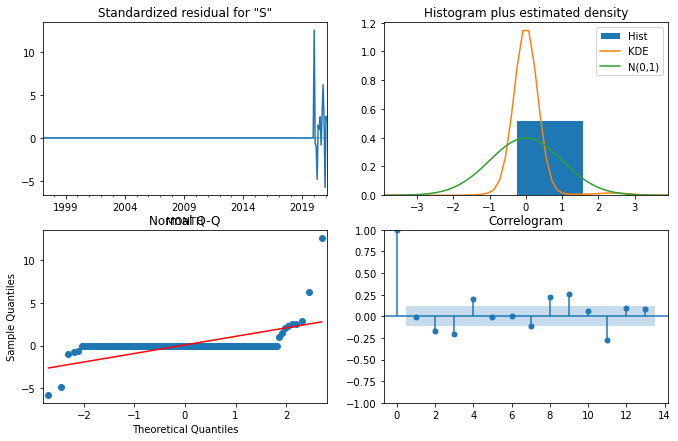

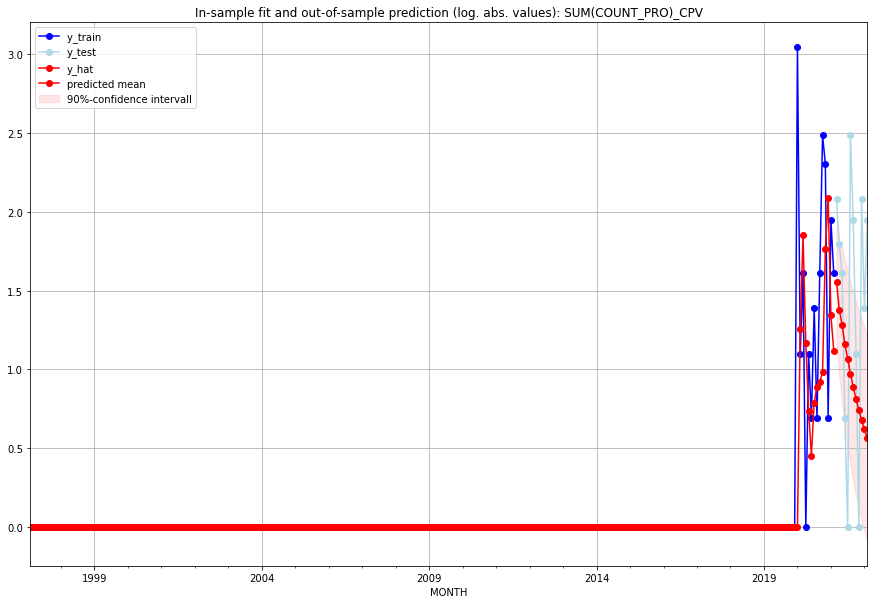

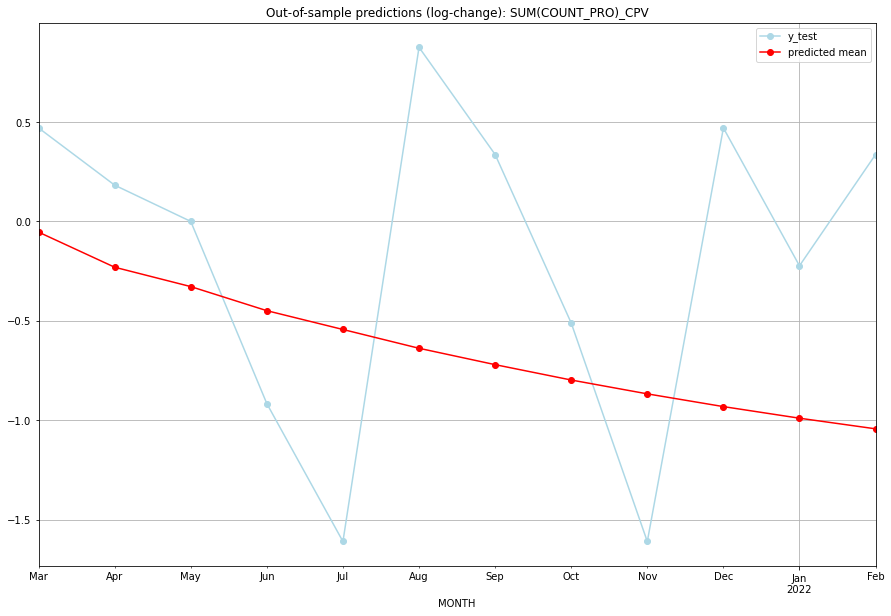

TADDA: 1.1300131018944546
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  3.738135         7.0     -0.053794        0.470004   CPV   
1  2021-04-01  2.971263         5.0     -0.230354        0.182322   CPV   
2  2021-05-01  2.602773         4.0     -0.327734        0.000000   CPV   
3  2021-06-01  2.191800         1.0     -0.448853       -0.916291   CPV   
4  2021-07-01  1.903824         0.0     -0.543409       -1.609438   CPV   
5  2021-08-01  1.641943        11.0     -0.637923        0.875469   CPV   
6  2021-09-01  1.433202         6.0     -0.720230        0.336472   CPV   
7  2021-10-01  1.252289         2.0     -0.797491       -0.510826   CPV   
8  2021-11-01  1.100899         0.0     -0.867073       -1.609438   CPV   
9  2021-12-01  0.970448         7.0     -0.931177        0.470004   CPV   
10 2022-01-01  0.858808         3.0     -0.989502       -0.223144   CPV   
11 2022-02-01  0.762095         6.0     -1.042934    

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [2, (0, 1, 2), (0, 0, 0, 0), 'n'], 'cv_score': 0.8410503814483117, 'fold_results': [0.8410503814483117]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_CRI   No. Observations:                   38
Model:               SARIMAX(0, 1, 2)   Log Likelihood                 -46.181
Date:                Fri, 16 Sep 2022   AIC                            102.362
Time:                        13:59:29   BIC                            110.417
Sample:                    01-31-2018   HQIC                           105.202
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1             0.0610      0.110      0.554      0.580   

<Figure size 432x288 with 0 Axes>

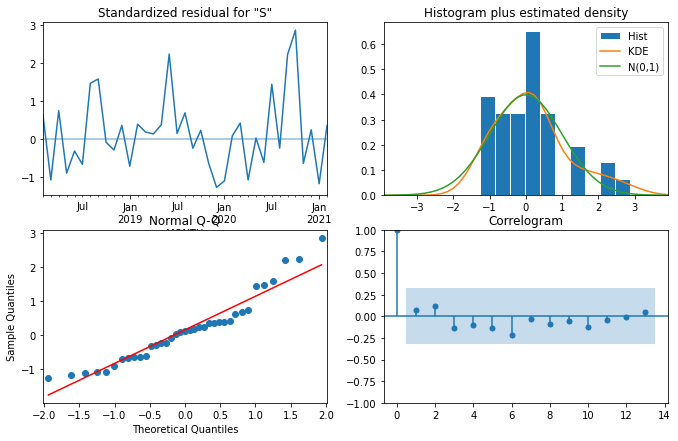

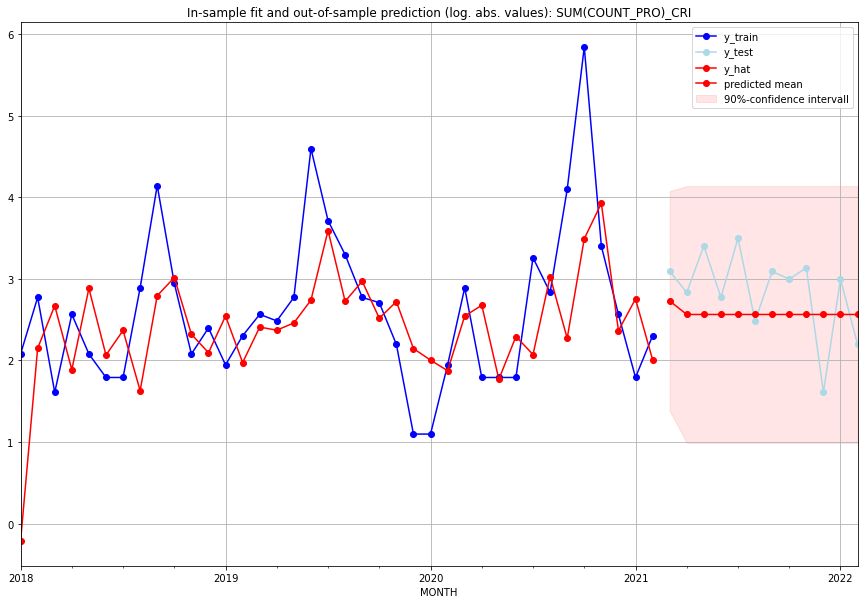

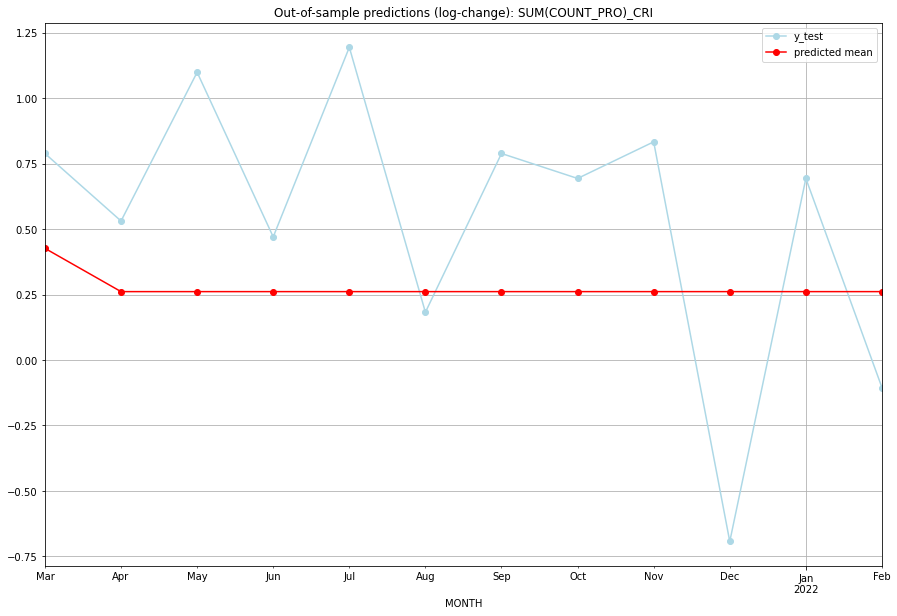

TADDA: 0.5413542271966965
Evaluation finished.
        MONTH   FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  14.314571        21.0       0.42622        0.788457   CRI   
1  2021-04-01  11.982279        16.0       0.26100        0.530628   CRI   
2  2021-05-01  11.982279        29.0       0.26100        1.098612   CRI   
3  2021-06-01  11.982279        15.0       0.26100        0.470004   CRI   
4  2021-07-01  11.982279        32.0       0.26100        1.193922   CRI   
5  2021-08-01  11.982279        11.0       0.26100        0.182322   CRI   
6  2021-09-01  11.982279        21.0       0.26100        0.788457   CRI   
7  2021-10-01  11.982279        19.0       0.26100        0.693147   CRI   
8  2021-11-01  11.982279        22.0       0.26100        0.832909   CRI   
9  2021-12-01  11.982279         4.0       0.26100       -0.693147   CRI   
10 2022-01-01  11.982279        19.0       0.26100        0.693147   CRI   
11 2022-02-01  11.982279         8.0     

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (3, 1, 2), (0, 0, 0, 0), 'n'], 'cv_score': 0.3289581738735141, 'fold_results': [0.3289581738735141]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_CUB   No. Observations:                   38
Model:               SARIMAX(3, 1, 2)   Log Likelihood                 -18.637
Date:                Fri, 16 Sep 2022   AIC                             49.273
Time:                        13:59:37   BIC                             58.939
Sample:                    01-31-2018   HQIC                            52.681
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.1445      0.150      0.961      0.337   

<Figure size 432x288 with 0 Axes>

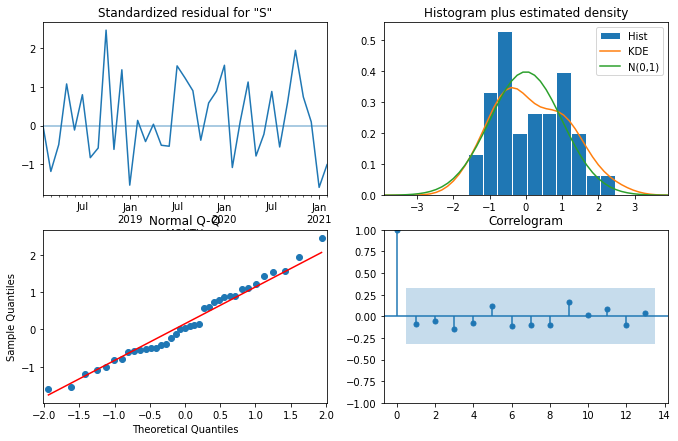

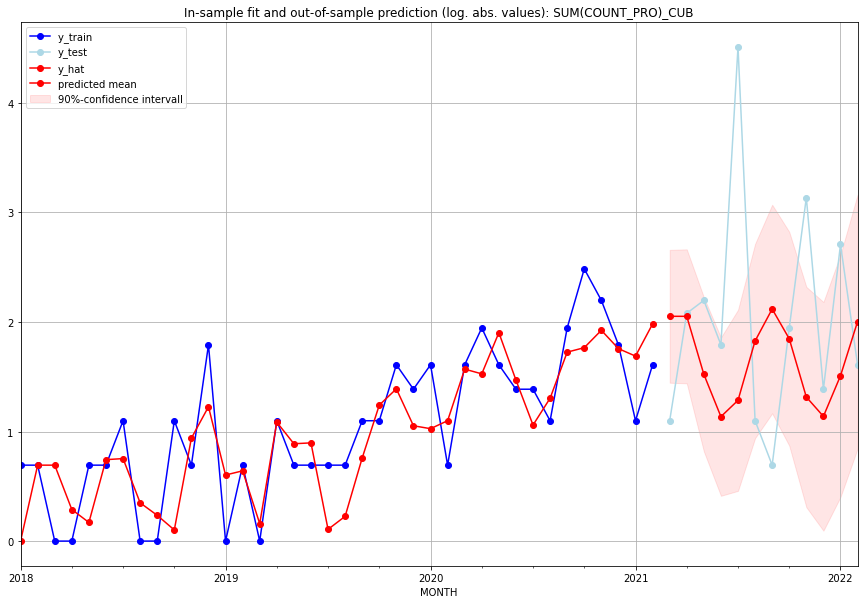

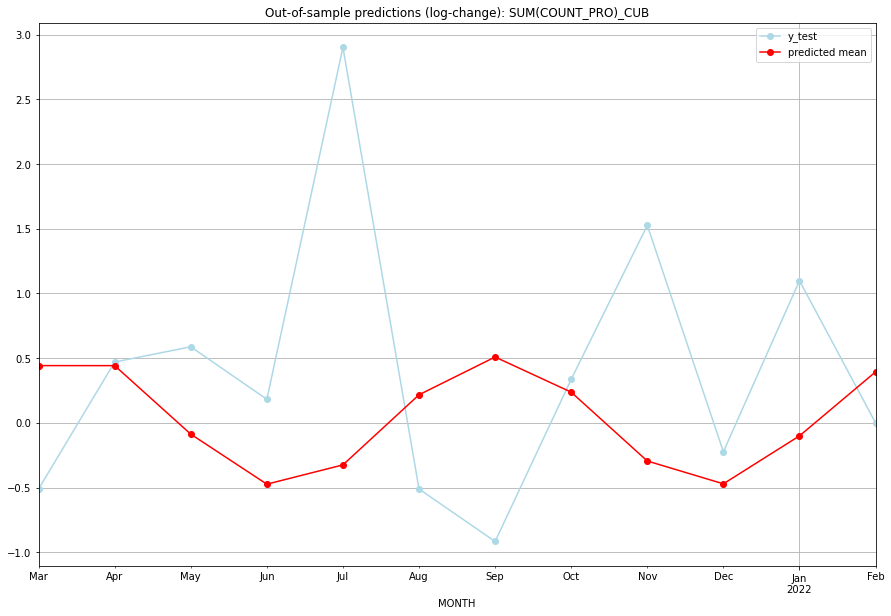

TADDA: 1.1583314370435265
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  6.782907         2.0      0.442492       -0.510826   CUB   
1  2021-04-01  6.780296         7.0      0.442156        0.470004   CUB   
2  2021-05-01  3.583457         8.0     -0.086984        0.587787   CUB   
3  2021-06-01  2.114154         5.0     -0.473480        0.182322   CUB   
4  2021-07-01  2.614223        90.0     -0.324561        2.901422   CUB   
5  2021-08-01  5.213253         2.0      0.217247       -0.510826   CUB   
6  2021-09-01  7.317205         1.0      0.508888       -0.916291   CUB   
7  2021-10-01  5.338597         6.0      0.237219        0.336472   CUB   
8  2021-11-01  2.724366        22.0     -0.294541        1.526056   CUB   
9  2021-12-01  2.122524         3.0     -0.470796       -0.223144   CUB   
10 2022-01-01  3.522841        14.0     -0.100298        1.098612   CUB   
11 2022-02-01  6.415253         4.0      0.394101    

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (3, 1, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.5080062570385998, 'fold_results': [0.5080062570385998]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_CUW   No. Observations:                   38
Model:               SARIMAX(3, 1, 3)   Log Likelihood                 -32.121
Date:                Fri, 16 Sep 2022   AIC                             78.243
Time:                        13:59:46   BIC                             89.519
Sample:                    01-31-2018   HQIC                            82.218
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -1.7130      0.485     -3.529      0.000   

<Figure size 432x288 with 0 Axes>

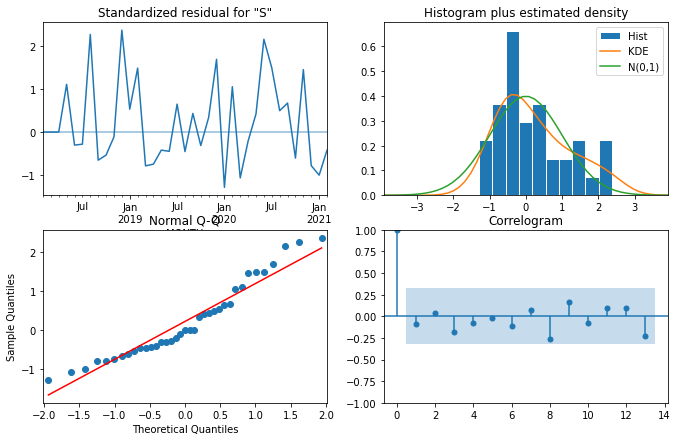

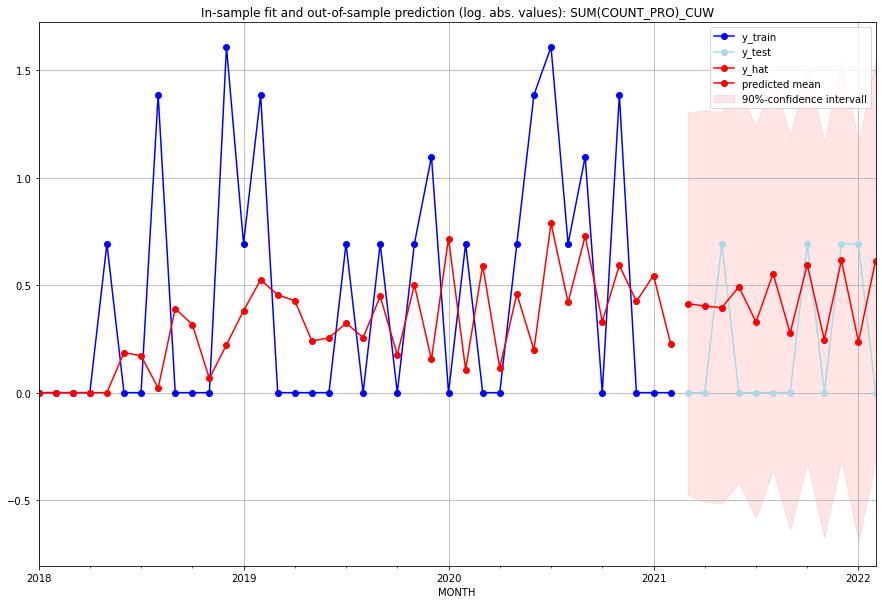

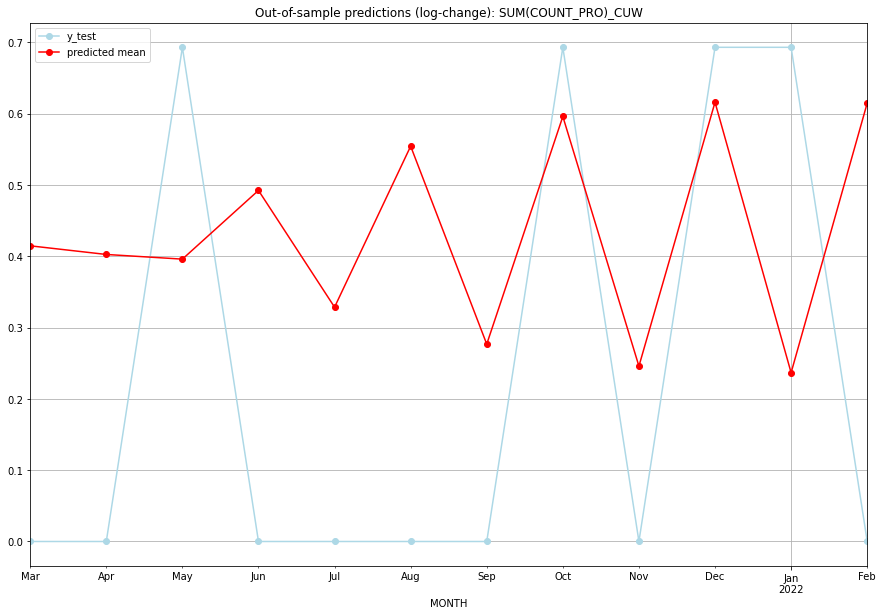

TADDA: 0.3548345819793473
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  0.513929         0.0      0.414708        0.000000   CUW   
1  2021-04-01  0.495703         0.0      0.402596        0.000000   CUW   
2  2021-05-01  0.485934         1.0      0.396043        0.693147   CUW   
3  2021-06-01  0.636279         0.0      0.492425        0.000000   CUW   
4  2021-07-01  0.389124         0.0      0.328673        0.000000   CUW   
5  2021-08-01  0.740974         0.0      0.554445        0.000000   CUW   
6  2021-09-01  0.318920         0.0      0.276813        0.000000   CUW   
7  2021-10-01  0.815058         1.0      0.596117        0.693147   CUW   
8  2021-11-01  0.278824         0.0      0.245941        0.000000   CUW   
9  2021-12-01  0.851627         1.0      0.616065        0.693147   CUW   
10 2022-01-01  0.267170         1.0      0.236786        0.693147   CUW   
11 2022-02-01  0.849355         0.0      0.614837    

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.11552453009332421, 'fold_results': [0.11552453009332421]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_CYM   No. Observations:                   26
Model:                        SARIMAX   Log Likelihood                   0.710
Date:                Fri, 16 Sep 2022   AIC                              0.580
Time:                        13:59:54   BIC                              1.838
Sample:                    01-31-2019   HQIC                             0.942
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.0554      0.008      7.059      0.000 

<Figure size 432x288 with 0 Axes>

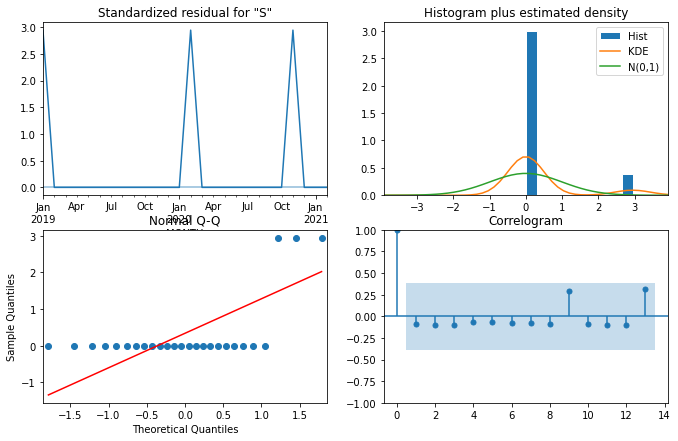

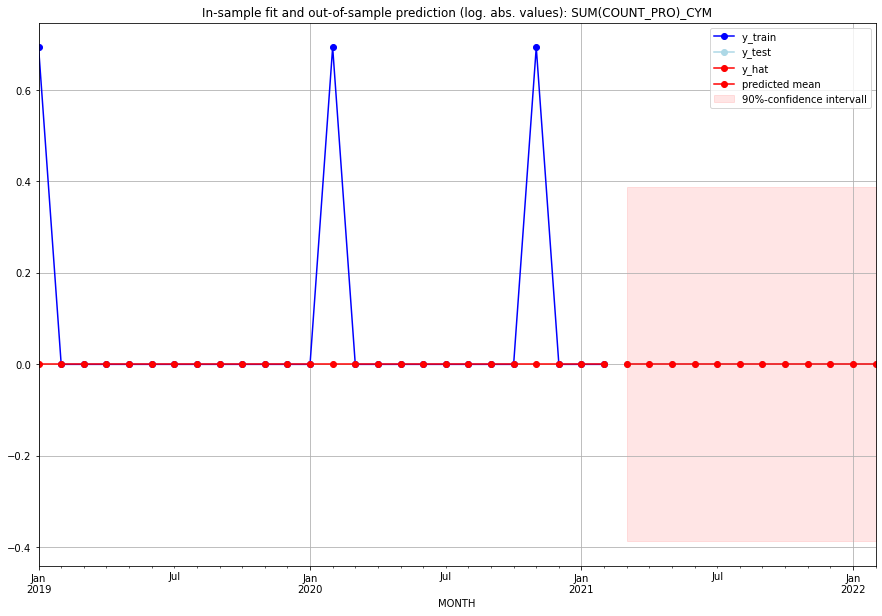

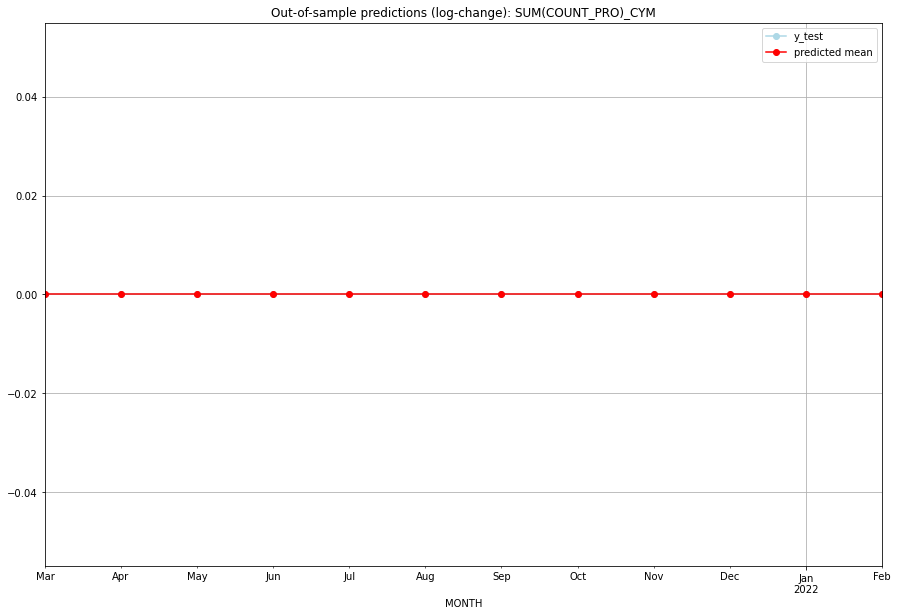

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   CYM   
1  2021-04-01       0.0         0.0           0.0             0.0   CYM   
2  2021-05-01       0.0         0.0           0.0             0.0   CYM   
3  2021-06-01       0.0         0.0           0.0             0.0   CYM   
4  2021-07-01       0.0         0.0           0.0             0.0   CYM   
5  2021-08-01       0.0         0.0           0.0             0.0   CYM   
6  2021-09-01       0.0         0.0           0.0             0.0   CYM   
7  2021-10-01       0.0         0.0           0.0             0.0   CYM   
8  2021-11-01       0.0         0.0           0.0             0.0   CYM   
9  2021-12-01       0.0         0.0           0.0             0.0   CYM   
10 2022-01-01       0.0         0.0           0.0             0.0   CYM   
11 2022-02-01       0.0         0.0           0.0             0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [1, (0, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.5547866959195262, 'fold_results': [0.5547866959195262]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_CYP   No. Observations:                   38
Model:               SARIMAX(0, 1, 0)   Log Likelihood                 -46.682
Date:                Fri, 16 Sep 2022   AIC                             97.364
Time:                        14:00:08   BIC                            100.585
Sample:                    01-31-2018   HQIC                            98.499
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1             0.0654      0.064      1.019      0.308   

<Figure size 432x288 with 0 Axes>

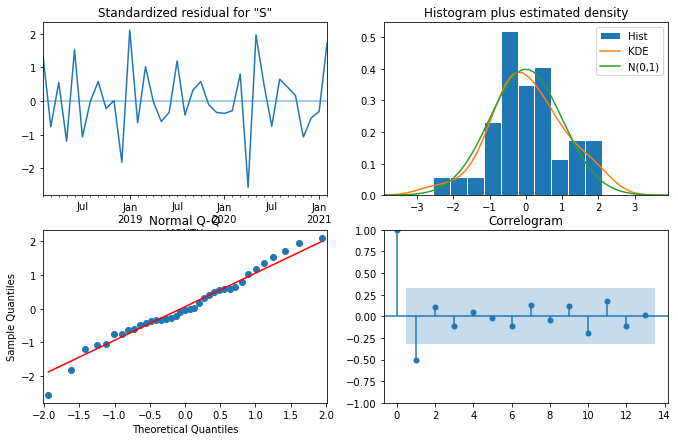

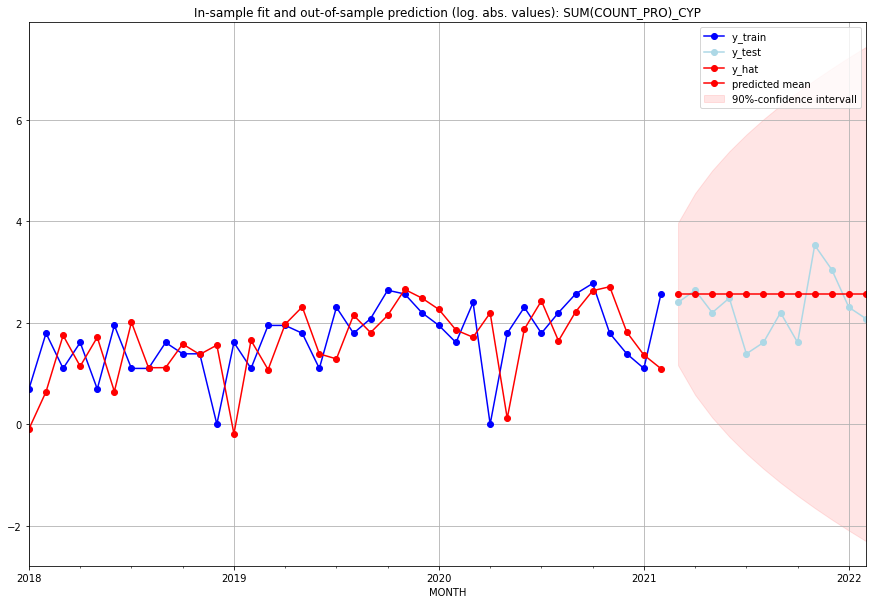

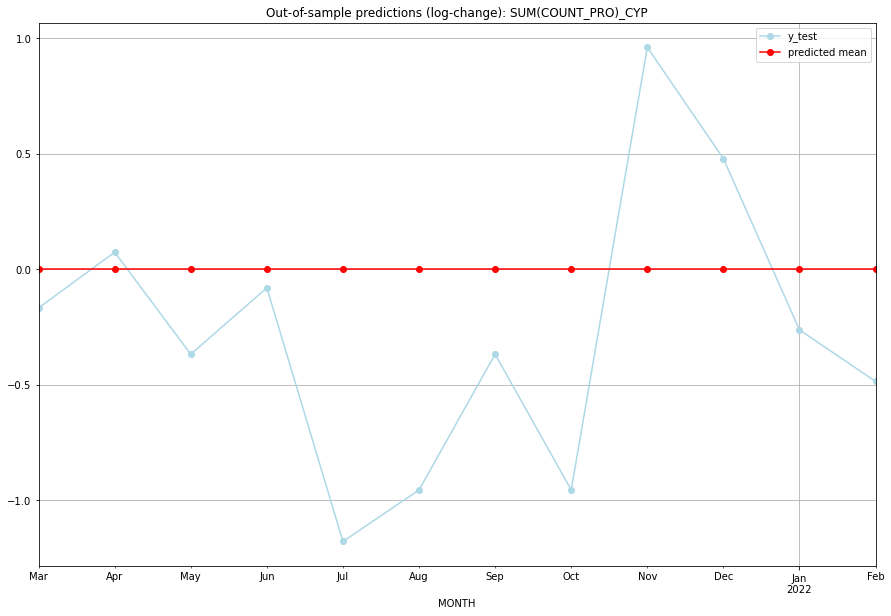

TADDA: 0.5279323782336065
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01      12.0        10.0           0.0       -0.167054   CYP   
1  2021-04-01      12.0        13.0           0.0        0.074108   CYP   
2  2021-05-01      12.0         8.0           0.0       -0.367725   CYP   
3  2021-06-01      12.0        11.0           0.0       -0.080043   CYP   
4  2021-07-01      12.0         3.0           0.0       -1.178655   CYP   
5  2021-08-01      12.0         4.0           0.0       -0.955511   CYP   
6  2021-09-01      12.0         8.0           0.0       -0.367725   CYP   
7  2021-10-01      12.0         4.0           0.0       -0.955511   CYP   
8  2021-11-01      12.0        33.0           0.0        0.961411   CYP   
9  2021-12-01      12.0        20.0           0.0        0.479573   CYP   
10 2022-01-01      12.0         9.0           0.0       -0.262364   CYP   
11 2022-02-01      12.0         7.0           0.0    

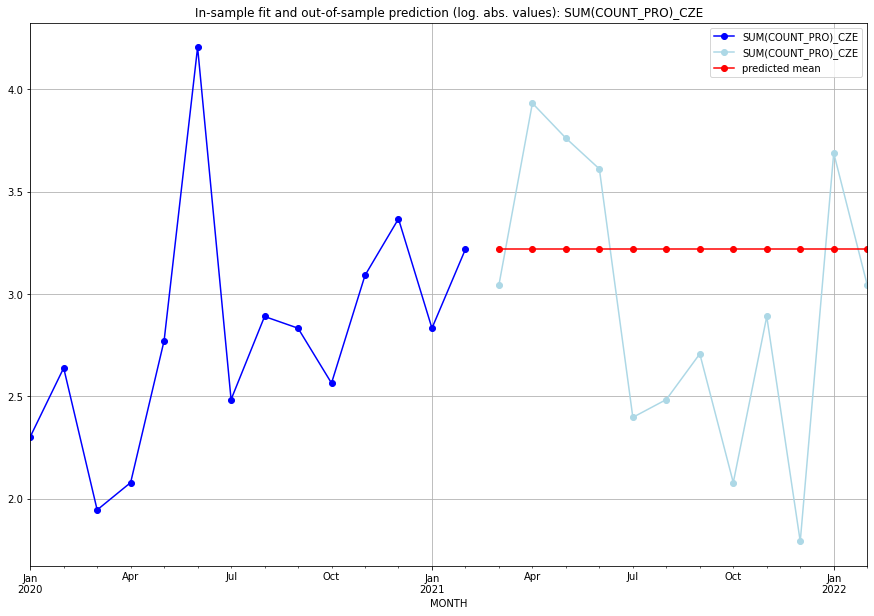

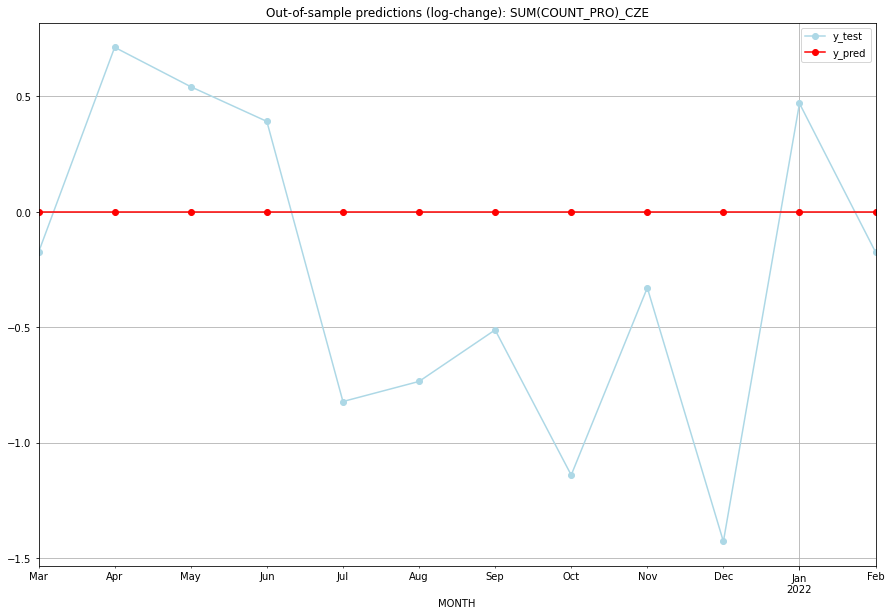

TADDA: 0.6189047205591139
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  3.218876    3.044522           0.0       -0.174353   CZE   
1  2021-04-01  3.218876    3.931826           0.0        0.712950   CZE   
2  2021-05-01  3.218876    3.761200           0.0        0.542324   CZE   
3  2021-06-01  3.218876    3.610918           0.0        0.392042   CZE   
4  2021-07-01  3.218876    2.397895           0.0       -0.820981   CZE   
5  2021-08-01  3.218876    2.484907           0.0       -0.733969   CZE   
6  2021-09-01  3.218876    2.708050           0.0       -0.510826   CZE   
7  2021-10-01  3.218876    2.079442           0.0       -1.139434   CZE   
8  2021-11-01  3.218876    2.890372           0.0       -0.328504   CZE   
9  2021-12-01  3.218876    1.791759           0.0       -1.427116   CZE   
10 2022-01-01  3.218876    3.688879           0.0        0.470004   CZE   
11 2022-02-01  3.218876    3.044522           0.0    

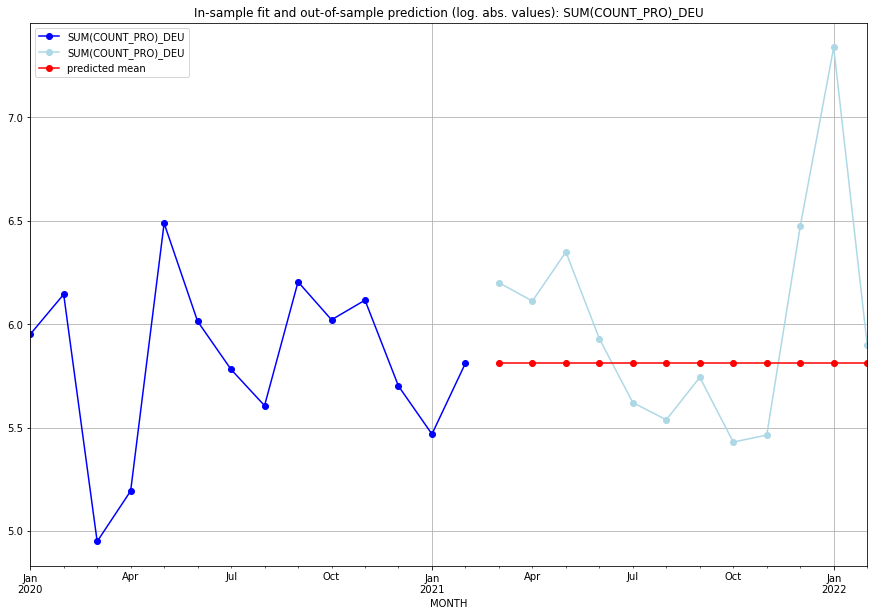

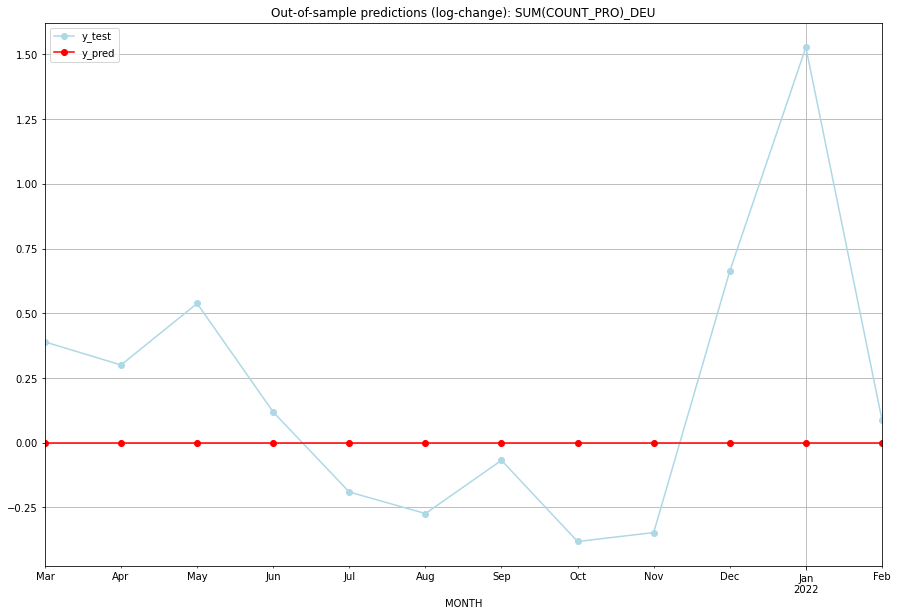

TADDA: 0.40726525763417376
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  5.811141    6.200509           0.0        0.389368   DEU   
1  2021-04-01  5.811141    6.111467           0.0        0.300326   DEU   
2  2021-05-01  5.811141    6.349139           0.0        0.537998   DEU   
3  2021-06-01  5.811141    5.929589           0.0        0.118448   DEU   
4  2021-07-01  5.811141    5.620401           0.0       -0.190740   DEU   
5  2021-08-01  5.811141    5.537334           0.0       -0.273807   DEU   
6  2021-09-01  5.811141    5.743003           0.0       -0.068138   DEU   
7  2021-10-01  5.811141    5.429346           0.0       -0.381795   DEU   
8  2021-11-01  5.811141    5.463832           0.0       -0.347309   DEU   
9  2021-12-01  5.811141    6.473891           0.0        0.662750   DEU   
10 2022-01-01  5.811141    7.338888           0.0        1.527747   DEU   
11 2022-02-01  5.811141    5.899897           0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [2, (3, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.7952504442794682, 'fold_results': [0.7952504442794682]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_DJI   No. Observations:                  289
Model:               SARIMAX(3, 1, 0)   Log Likelihood                -111.520
Date:                Fri, 16 Sep 2022   AIC                            235.039
Time:                        14:00:54   BIC                            257.017
Sample:                    02-28-1997   HQIC                           243.847
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1             0.0333      0.022      1.517      0.129   

<Figure size 432x288 with 0 Axes>

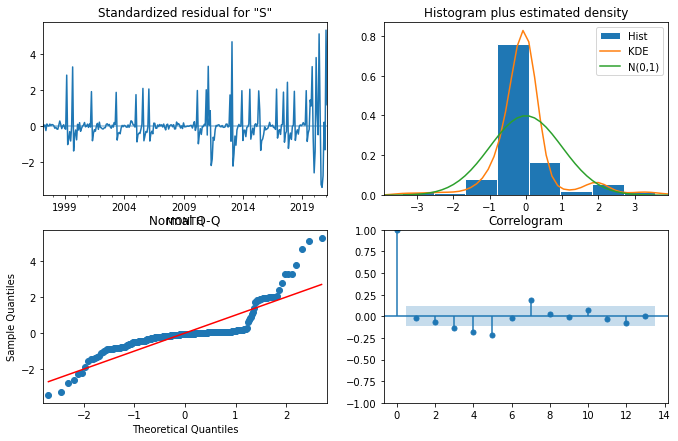

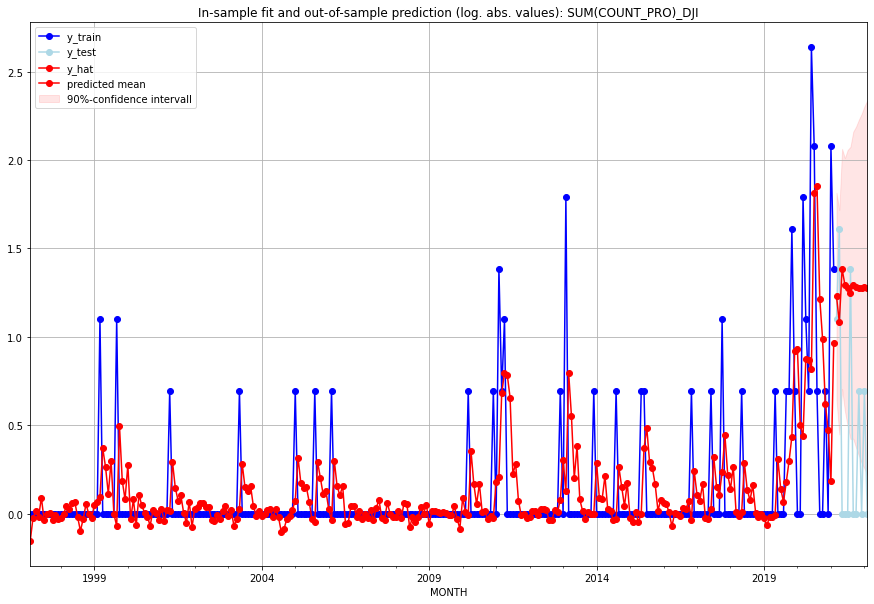

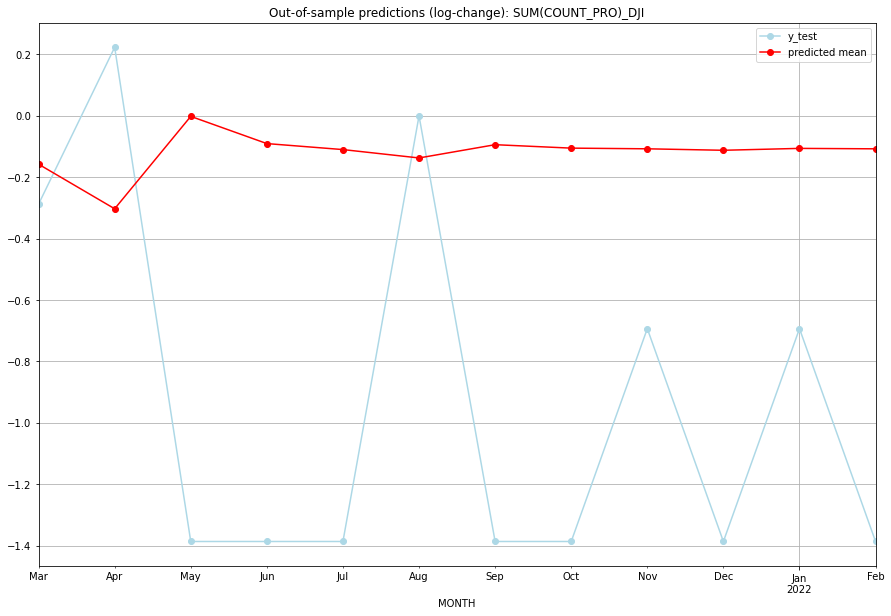

TADDA: 0.9459811762314527
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  2.416980         2.0     -0.157537       -0.287682   DJI   
1  2021-04-01  1.955331         4.0     -0.302684        0.223144   DJI   
2  2021-05-01  2.992976         0.0     -0.001757       -1.386294   DJI   
3  2021-06-01  2.654244         0.0     -0.090405       -1.386294   DJI   
4  2021-07-01  2.583572         0.0     -0.109934       -1.386294   DJI   
5  2021-08-01  2.487208         3.0     -0.137193        0.000000   DJI   
6  2021-09-01  2.641102         0.0     -0.094008       -1.386294   DJI   
7  2021-10-01  2.600571         0.0     -0.105202       -1.386294   DJI   
8  2021-11-01  2.592628         1.0     -0.107411       -0.693147   DJI   
9  2021-12-01  2.575459         0.0     -0.112201       -1.386294   DJI   
10 2022-01-01  2.597516         1.0     -0.106051       -0.693147   DJI   
11 2022-02-01  2.592447         0.0     -0.107461    

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.23104906018664842, 'fold_results': [0.23104906018664842]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_DMA   No. Observations:                   38
Model:                        SARIMAX   Log Likelihood                 -42.309
Date:                Fri, 16 Sep 2022   AIC                             86.618
Time:                        14:01:08   BIC                             88.255
Sample:                    01-31-2018   HQIC                            87.200
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.5428      0.105      5.190      0.000 

<Figure size 432x288 with 0 Axes>

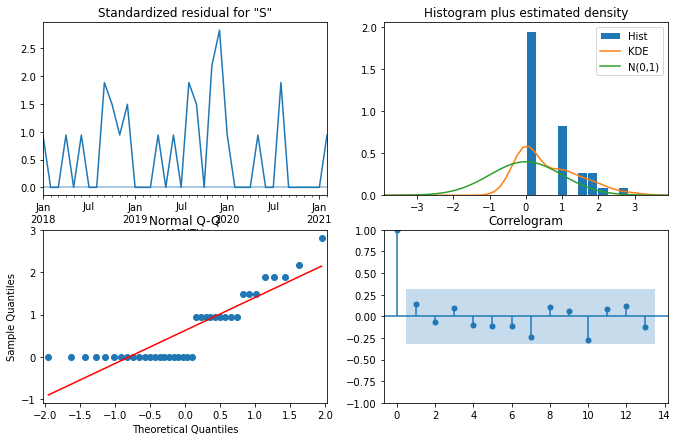

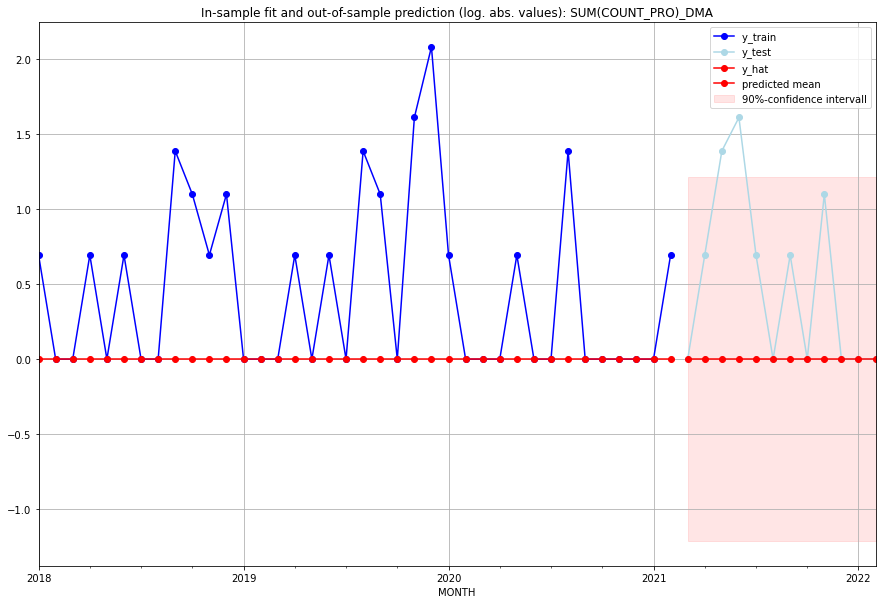

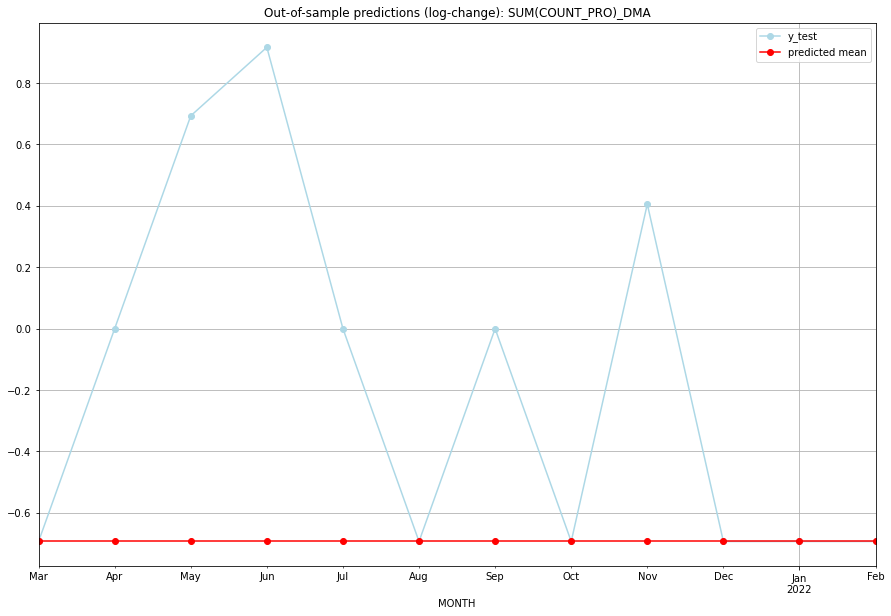

TADDA: 0.6877689704651476
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0     -0.693147       -0.693147   DMA   
1  2021-04-01       0.0         1.0     -0.693147        0.000000   DMA   
2  2021-05-01       0.0         3.0     -0.693147        0.693147   DMA   
3  2021-06-01       0.0         4.0     -0.693147        0.916291   DMA   
4  2021-07-01       0.0         1.0     -0.693147        0.000000   DMA   
5  2021-08-01       0.0         0.0     -0.693147       -0.693147   DMA   
6  2021-09-01       0.0         1.0     -0.693147        0.000000   DMA   
7  2021-10-01       0.0         0.0     -0.693147       -0.693147   DMA   
8  2021-11-01       0.0         2.0     -0.693147        0.405465   DMA   
9  2021-12-01       0.0         0.0     -0.693147       -0.693147   DMA   
10 2022-01-01       0.0         0.0     -0.693147       -0.693147   DMA   
11 2022-02-01       0.0         0.0     -0.693147    

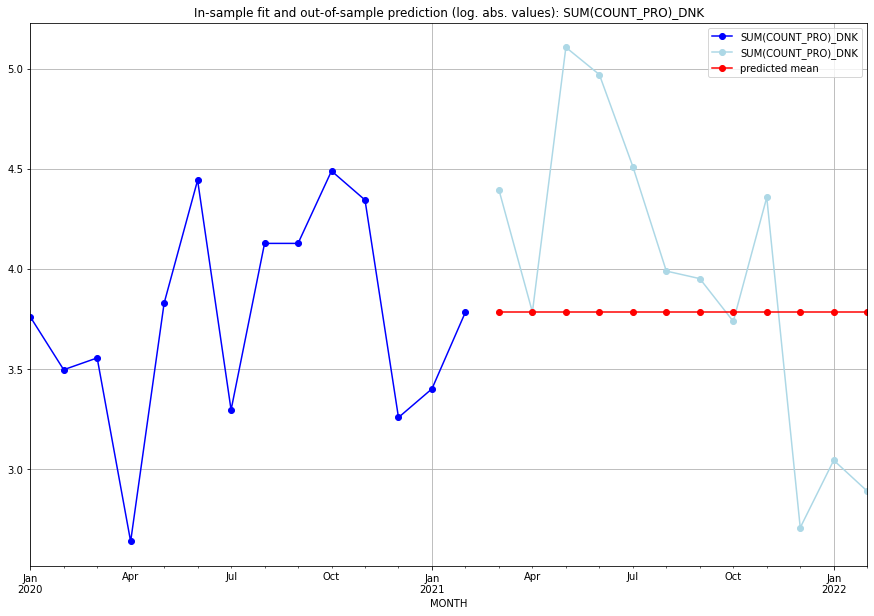

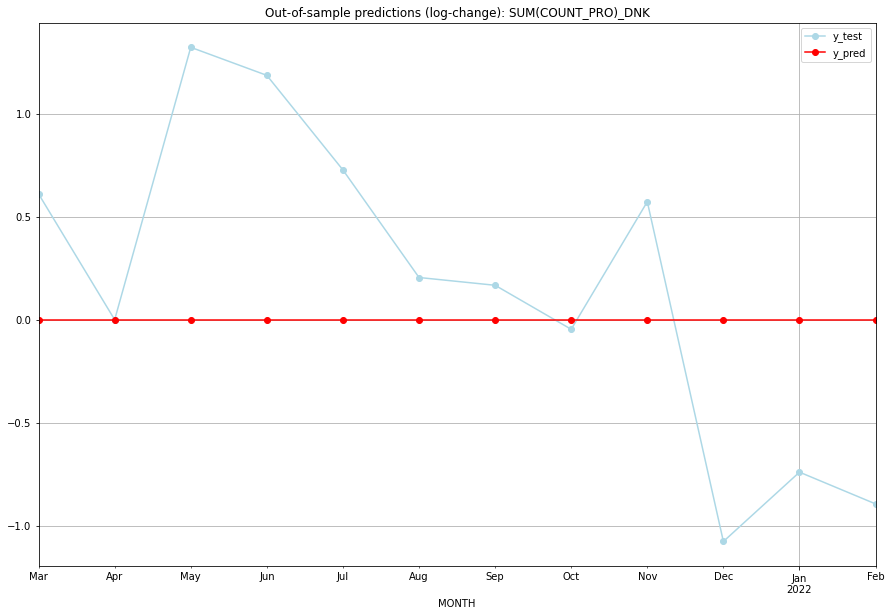

TADDA: 0.6287350924784348
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01   3.78419    4.394449           0.0        0.610260   DNK   
1  2021-04-01   3.78419    3.784190           0.0        0.000000   DNK   
2  2021-05-01   3.78419    5.105945           0.0        1.321756   DNK   
3  2021-06-01   3.78419    4.969813           0.0        1.185624   DNK   
4  2021-07-01   3.78419    4.510860           0.0        0.726670   DNK   
5  2021-08-01   3.78419    3.988984           0.0        0.204794   DNK   
6  2021-09-01   3.78419    3.951244           0.0        0.167054   DNK   
7  2021-10-01   3.78419    3.737670           0.0       -0.046520   DNK   
8  2021-11-01   3.78419    4.356709           0.0        0.572519   DNK   
9  2021-12-01   3.78419    2.708050           0.0       -1.076139   DNK   
10 2022-01-01   3.78419    3.044522           0.0       -0.739667   DNK   
11 2022-02-01   3.78419    2.890372           0.0    

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.852924234337153, 'fold_results': [0.852924234337153]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_DOM   No. Observations:                   38
Model:               SARIMAX(0, 1, 0)   Log Likelihood                 -57.408
Date:                Fri, 16 Sep 2022   AIC                            116.816
Time:                        14:01:26   BIC                            118.427
Sample:                    01-31-2018   HQIC                           117.384
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         1.3037      0.303      4.303      0.000     

<Figure size 432x288 with 0 Axes>

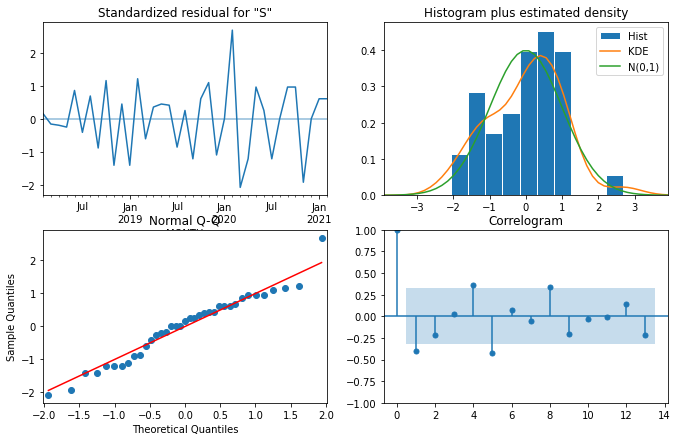

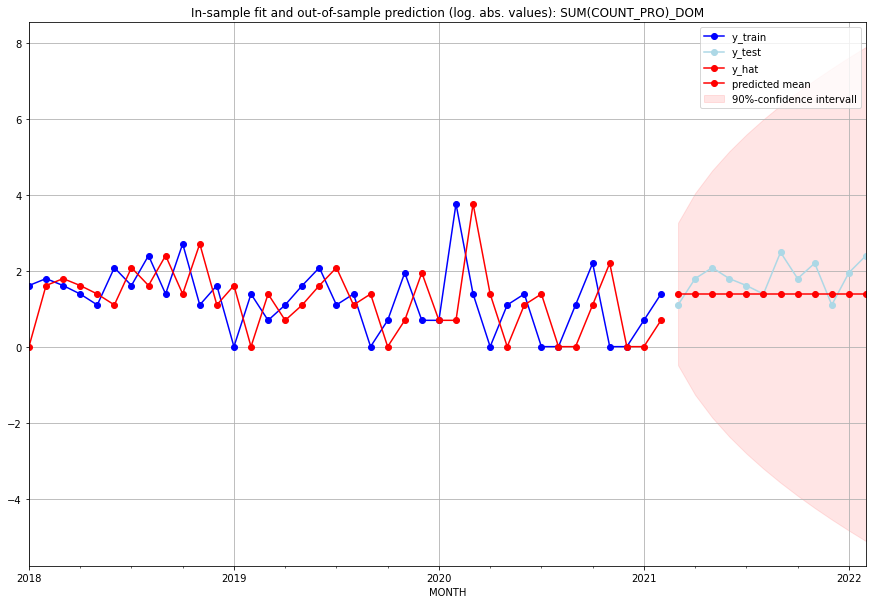

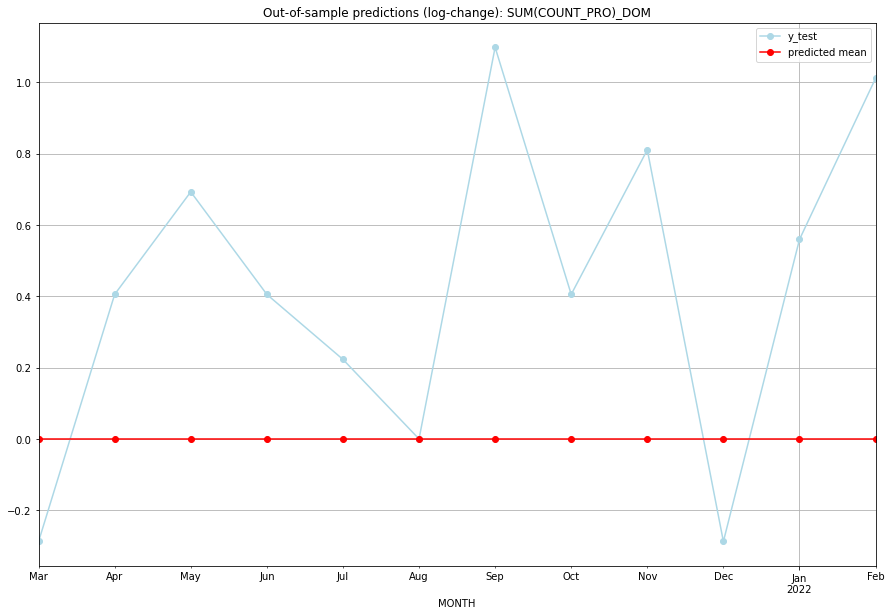

TADDA: 0.5157341171333792
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       3.0         2.0           0.0       -0.287682   DOM   
1  2021-04-01       3.0         5.0           0.0        0.405465   DOM   
2  2021-05-01       3.0         7.0           0.0        0.693147   DOM   
3  2021-06-01       3.0         5.0           0.0        0.405465   DOM   
4  2021-07-01       3.0         4.0           0.0        0.223144   DOM   
5  2021-08-01       3.0         3.0           0.0        0.000000   DOM   
6  2021-09-01       3.0        11.0           0.0        1.098612   DOM   
7  2021-10-01       3.0         5.0           0.0        0.405465   DOM   
8  2021-11-01       3.0         8.0           0.0        0.810930   DOM   
9  2021-12-01       3.0         2.0           0.0       -0.287682   DOM   
10 2022-01-01       3.0         6.0           0.0        0.559616   DOM   
11 2022-02-01       3.0        10.0           0.0    

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.43021338298755724, 'fold_results': [0.43021338298755724]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_DZA   No. Observations:                  289
Model:               SARIMAX(0, 1, 0)   Log Likelihood                -371.568
Date:                Fri, 16 Sep 2022   AIC                            745.135
Time:                        14:01:53   BIC                            748.798
Sample:                    02-28-1997   HQIC                           746.603
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.7729      0.051     15.222      0.000 

<Figure size 432x288 with 0 Axes>

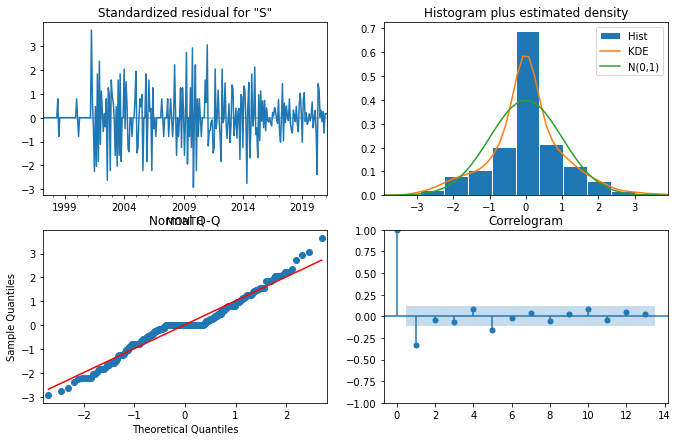

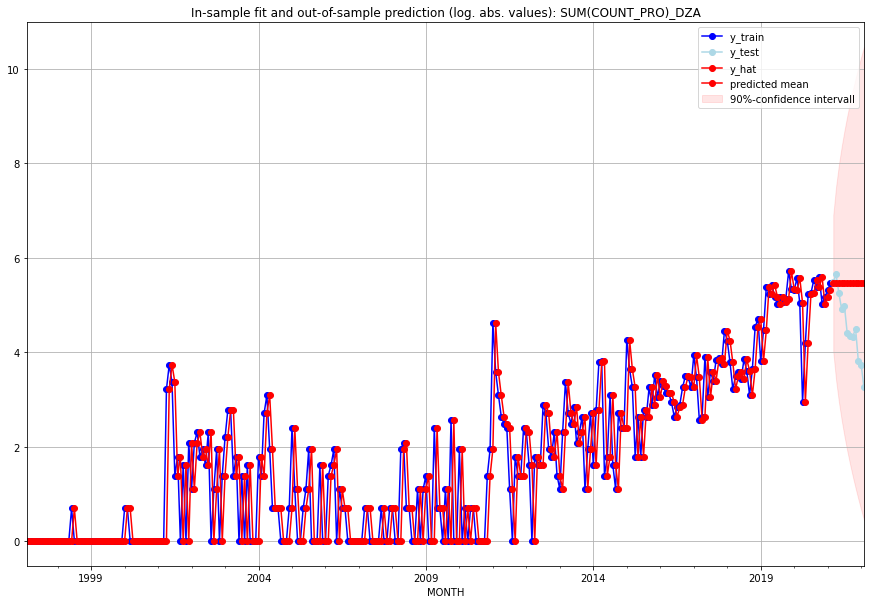

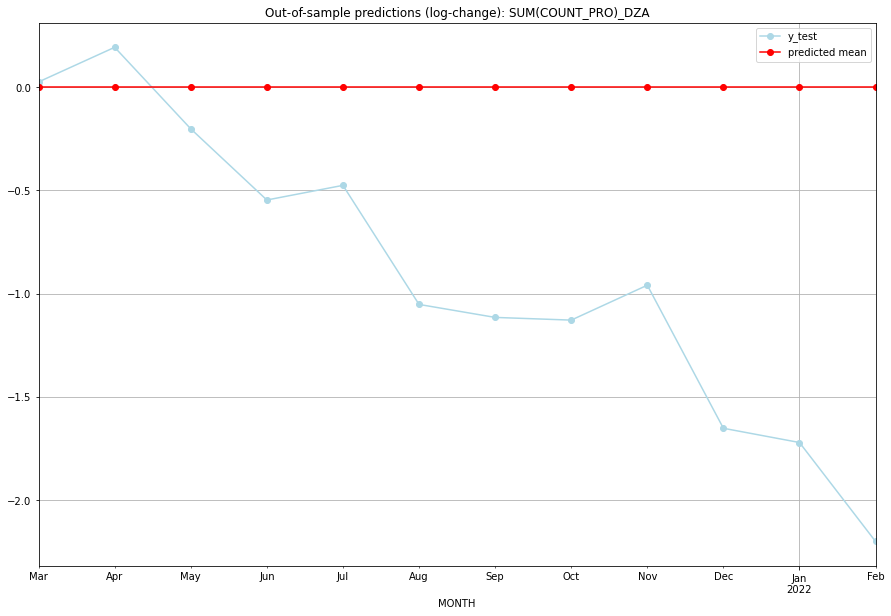

TADDA: 0.9397264184692253
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01     234.0       240.0           0.0        0.025211   DZA   
1  2021-04-01     234.0       284.0           0.0        0.192904   DZA   
2  2021-05-01     234.0       191.0           0.0       -0.202090   DZA   
3  2021-06-01     234.0       135.0           0.0       -0.546931   DZA   
4  2021-07-01     234.0       145.0           0.0       -0.475979   DZA   
5  2021-08-01     234.0        81.0           0.0       -1.052866   DZA   
6  2021-09-01     234.0        76.0           0.0       -1.115780   DZA   
7  2021-10-01     234.0        75.0           0.0       -1.128852   DZA   
8  2021-11-01     234.0        89.0           0.0       -0.959776   DZA   
9  2021-12-01     234.0        44.0           0.0       -1.652923   DZA   
10 2022-01-01     234.0        41.0           0.0       -1.721916   DZA   
11 2022-02-01     234.0        25.0           0.0    

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [3, (2, 1, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.46631949709675063, 'fold_results': [0.46631949709675063]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_ECU   No. Observations:                   38
Model:               SARIMAX(2, 1, 3)   Log Likelihood                 -30.379
Date:                Fri, 16 Sep 2022   AIC                             78.759
Time:                        14:02:10   BIC                             93.257
Sample:                    01-31-2018   HQIC                            83.870
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1             0.1973      0.124      1.596      0.110 

<Figure size 432x288 with 0 Axes>

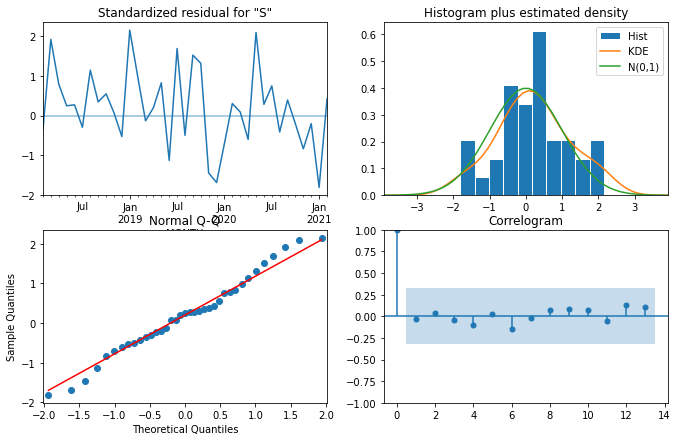

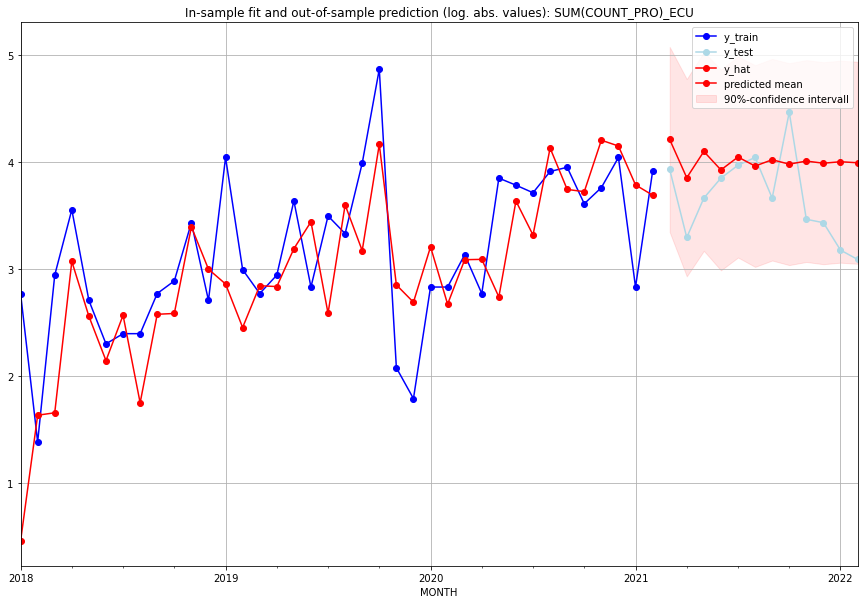

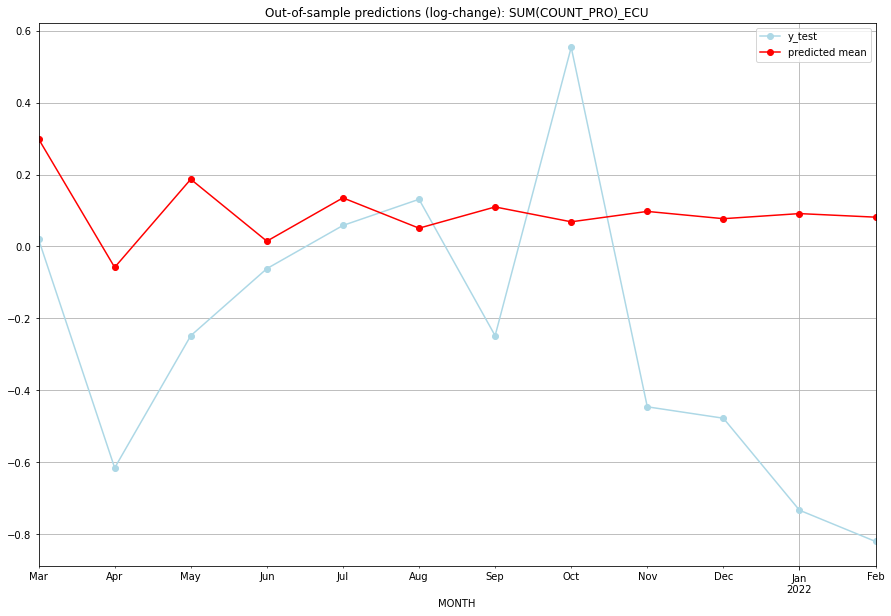

TADDA: 0.48615973958419306
Evaluation finished.
        MONTH   FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  66.421750        50.0      0.298945        0.019803   ECU   
1  2021-04-01  46.168500        26.0     -0.058297       -0.616186   ECU   
2  2021-05-01  59.271439        38.0      0.186835       -0.248461   ECU   
3  2021-06-01  49.733016        46.0      0.014554       -0.061875   ECU   
4  2021-07-01  56.228970        52.0      0.135037        0.058269   ECU   
5  2021-08-01  51.599982        56.0      0.050693        0.131028   ECU   
6  2021-09-01  54.798605        38.0      0.109726       -0.248461   ECU   
7  2021-10-01  52.540028        86.0      0.068407        0.553885   ECU   
8  2021-11-01  54.111043        31.0      0.097327       -0.446287   ECU   
9  2021-12-01  53.006680        30.0      0.077085       -0.478036   ECU   
10 2022-01-01  53.777306        23.0      0.091253       -0.733969   ECU   
11 2022-02-01  53.236777        21.0    

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [2, (0, 0, 1), (0, 0, 0, 0), 'n'], 'cv_score': 0.6287742010241173, 'fold_results': [0.6287742010241173]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_EGY   No. Observations:                  289
Model:               SARIMAX(0, 0, 1)   Log Likelihood                -499.872
Date:                Fri, 16 Sep 2022   AIC                           1007.743
Time:                        14:02:38   BIC                           1022.409
Sample:                    02-28-1997   HQIC                          1013.620
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1             0.2428      0.040      6.078      0.000   

<Figure size 432x288 with 0 Axes>

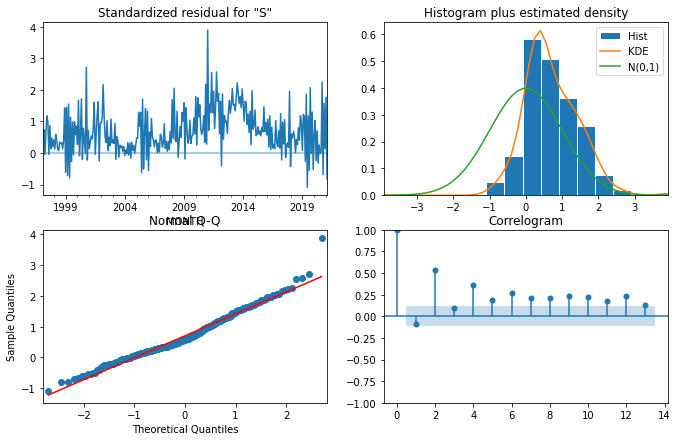

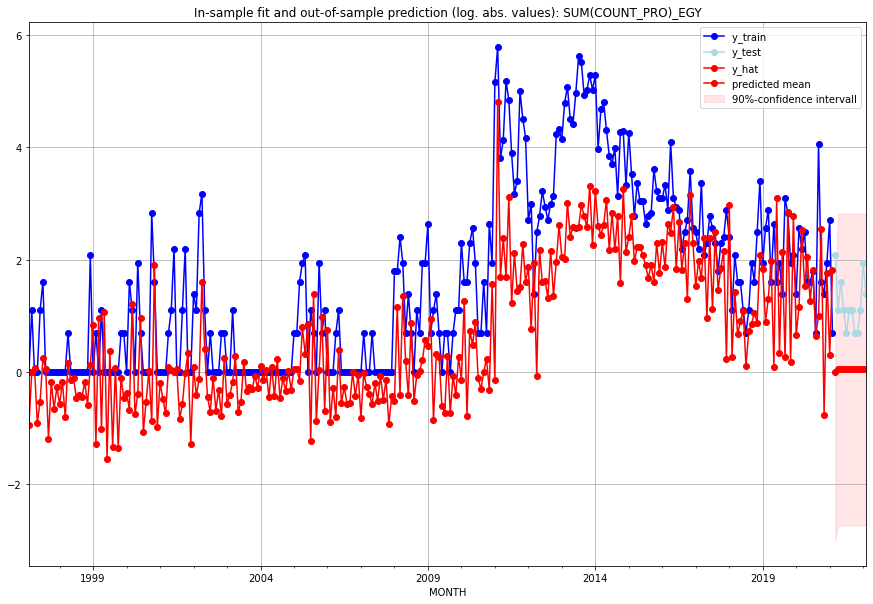

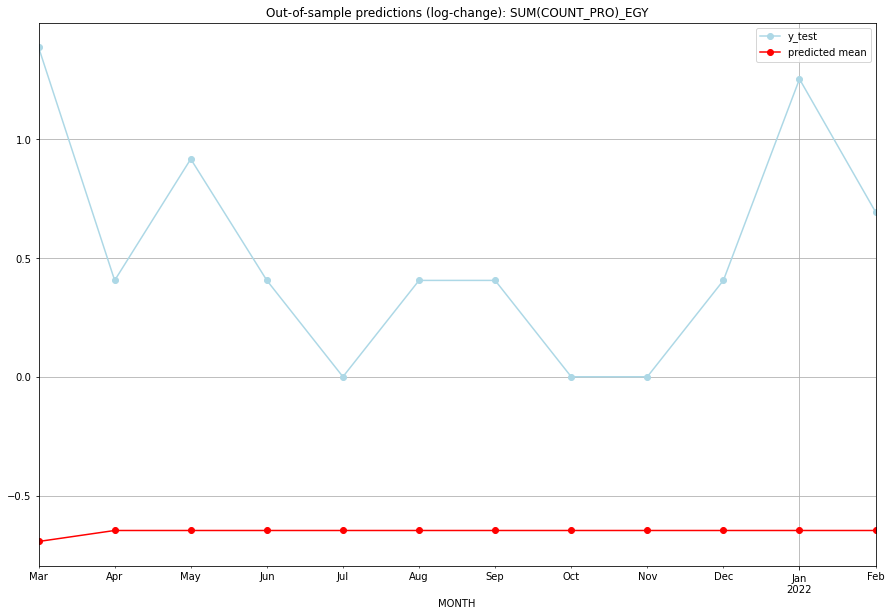

TADDA: 1.662691382890162
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  0.000000         7.0     -0.693147        1.386294   EGY   
1  2021-04-01  0.047384         2.0     -0.646852        0.405465   EGY   
2  2021-05-01  0.047384         4.0     -0.646852        0.916291   EGY   
3  2021-06-01  0.047384         2.0     -0.646852        0.405465   EGY   
4  2021-07-01  0.047384         1.0     -0.646852        0.000000   EGY   
5  2021-08-01  0.047384         2.0     -0.646852        0.405465   EGY   
6  2021-09-01  0.047384         2.0     -0.646852        0.405465   EGY   
7  2021-10-01  0.047384         1.0     -0.646852        0.000000   EGY   
8  2021-11-01  0.047384         1.0     -0.646852        0.000000   EGY   
9  2021-12-01  0.047384         2.0     -0.646852        0.405465   EGY   
10 2022-01-01  0.047384         6.0     -0.646852        1.252763   EGY   
11 2022-02-01  0.047384         3.0     -0.646852     

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.0, 'fold_results': [0.0]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_ERI   No. Observations:                  289
Model:                        SARIMAX   Log Likelihood                 119.386
Date:                Fri, 16 Sep 2022   AIC                           -236.771
Time:                        14:03:15   BIC                           -233.105
Sample:                    02-28-1997   HQIC                          -235.302
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.0256      0.000     63.482      0.000       0.025       0.026
Ljung-Bo

<Figure size 432x288 with 0 Axes>

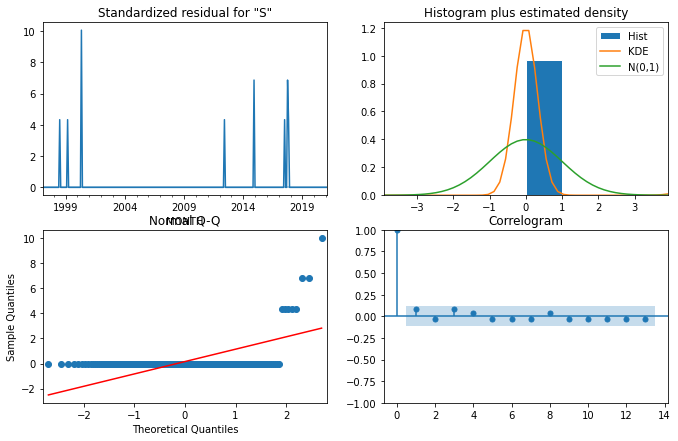

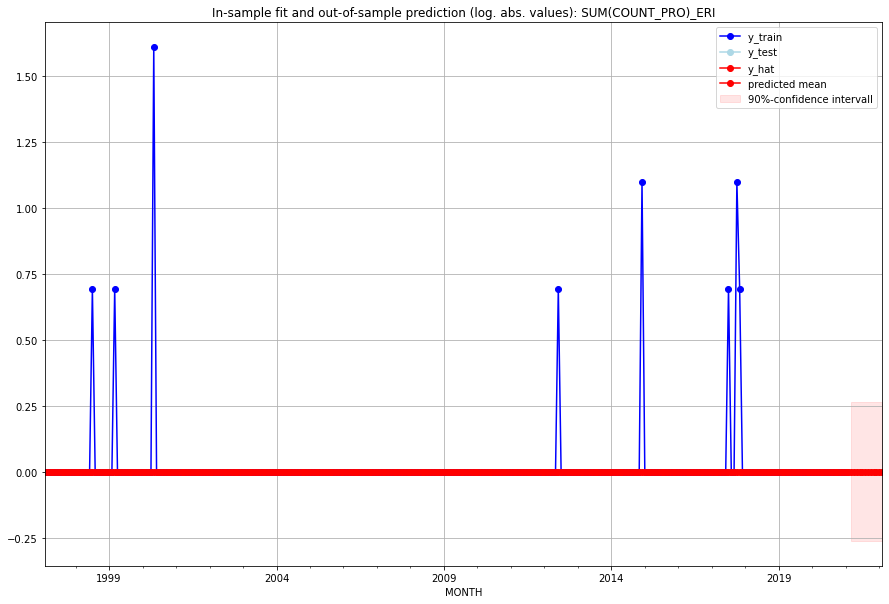

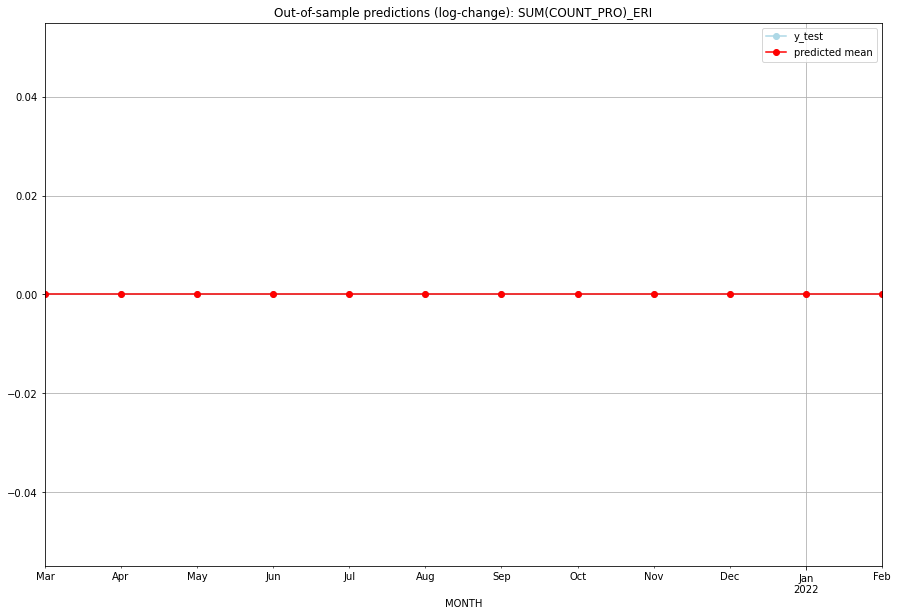

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   ERI   
1  2021-04-01       0.0         0.0           0.0             0.0   ERI   
2  2021-05-01       0.0         0.0           0.0             0.0   ERI   
3  2021-06-01       0.0         0.0           0.0             0.0   ERI   
4  2021-07-01       0.0         0.0           0.0             0.0   ERI   
5  2021-08-01       0.0         0.0           0.0             0.0   ERI   
6  2021-09-01       0.0         0.0           0.0             0.0   ERI   
7  2021-10-01       0.0         0.0           0.0             0.0   ERI   
8  2021-11-01       0.0         0.0           0.0             0.0   ERI   
9  2021-12-01       0.0         0.0           0.0             0.0   ERI   
10 2022-01-01       0.0         0.0           0.0             0.0   ERI   
11 2022-02-01       0.0         0.0           0.0             0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.6988762389811768, 'fold_results': [0.6988762389811768]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_ESH   No. Observations:                  289
Model:               SARIMAX(0, 1, 0)   Log Likelihood                -228.751
Date:                Fri, 16 Sep 2022   AIC                            459.501
Time:                        14:03:49   BIC                            463.164
Sample:                    02-28-1997   HQIC                           460.969
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.2867      0.019     15.166      0.000   

<Figure size 432x288 with 0 Axes>

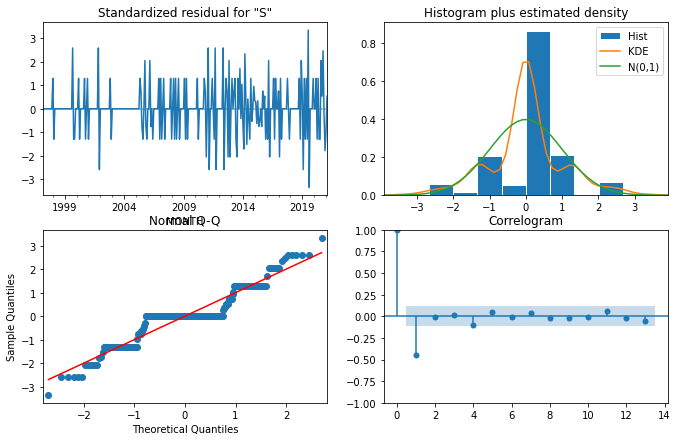

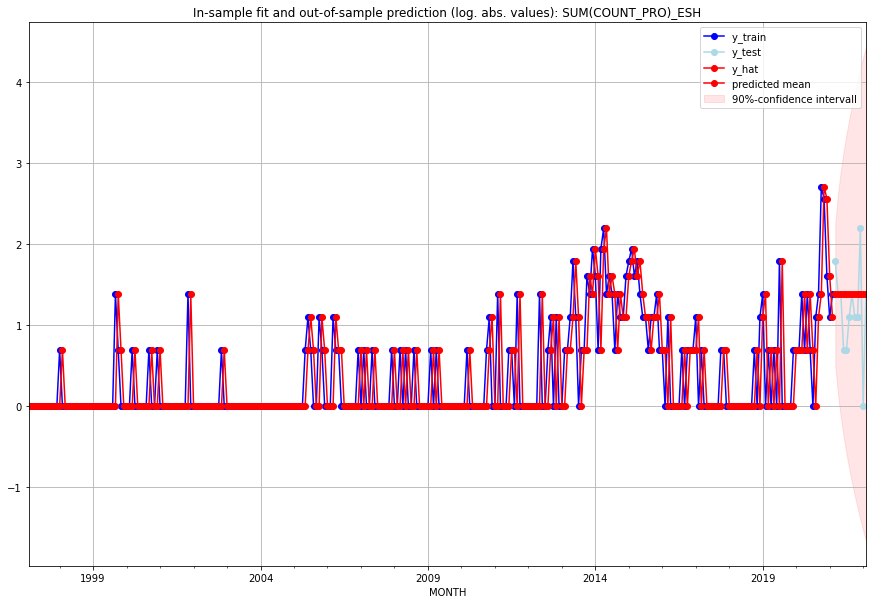

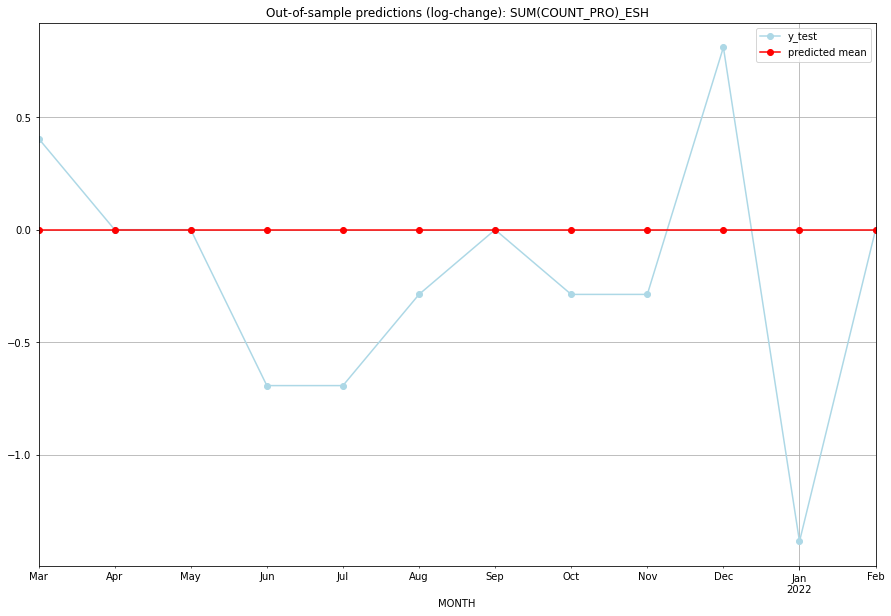

TADDA: 0.4043358553266348
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       3.0         5.0           0.0        0.405465   ESH   
1  2021-04-01       3.0         3.0           0.0        0.000000   ESH   
2  2021-05-01       3.0         3.0           0.0        0.000000   ESH   
3  2021-06-01       3.0         1.0           0.0       -0.693147   ESH   
4  2021-07-01       3.0         1.0           0.0       -0.693147   ESH   
5  2021-08-01       3.0         2.0           0.0       -0.287682   ESH   
6  2021-09-01       3.0         3.0           0.0        0.000000   ESH   
7  2021-10-01       3.0         2.0           0.0       -0.287682   ESH   
8  2021-11-01       3.0         2.0           0.0       -0.287682   ESH   
9  2021-12-01       3.0         8.0           0.0        0.810930   ESH   
10 2022-01-01       3.0         0.0           0.0       -1.386294   ESH   
11 2022-02-01       3.0         3.0           0.0    

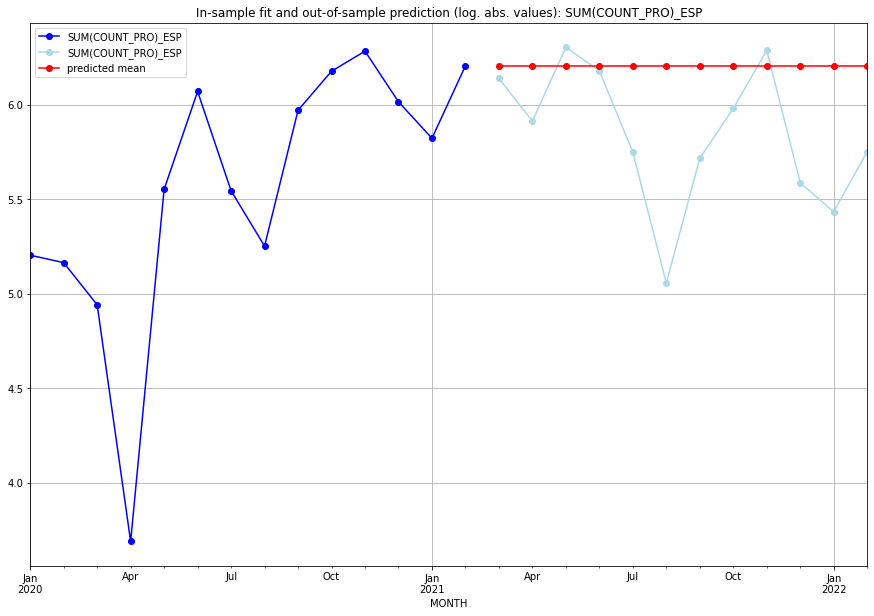

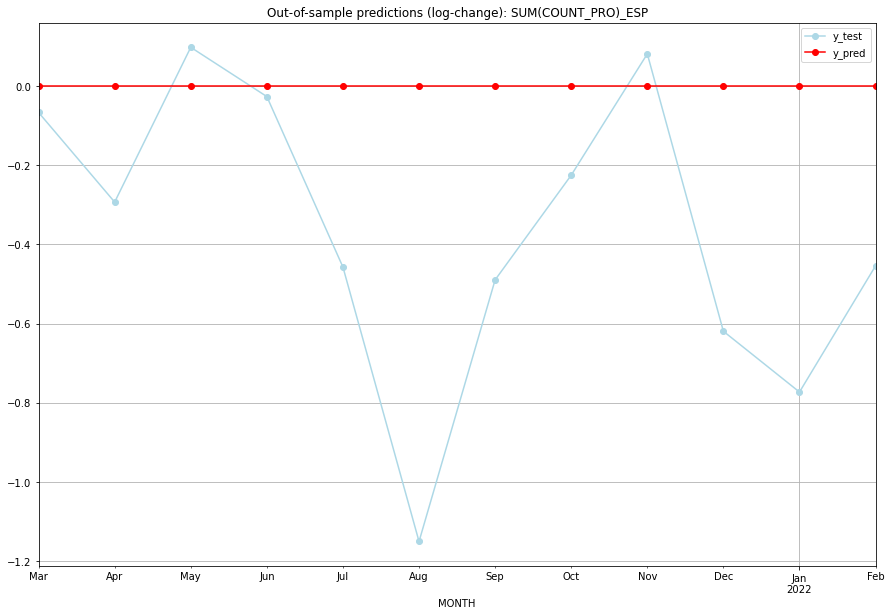

TADDA: 0.3944905466807254
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  6.206576    6.139885           0.0       -0.066691   ESP   
1  2021-04-01  6.206576    5.913503           0.0       -0.293073   ESP   
2  2021-05-01  6.206576    6.304449           0.0        0.097873   ESP   
3  2021-06-01  6.206576    6.180017           0.0       -0.026559   ESP   
4  2021-07-01  6.206576    5.749393           0.0       -0.457183   ESP   
5  2021-08-01  6.206576    5.056246           0.0       -1.150330   ESP   
6  2021-09-01  6.206576    5.717028           0.0       -0.489548   ESP   
7  2021-10-01  6.206576    5.981414           0.0       -0.225162   ESP   
8  2021-11-01  6.206576    6.287859           0.0        0.081283   ESP   
9  2021-12-01  6.206576    5.587249           0.0       -0.619327   ESP   
10 2022-01-01  6.206576    5.433722           0.0       -0.772854   ESP   
11 2022-02-01  6.206576    5.752573           0.0    

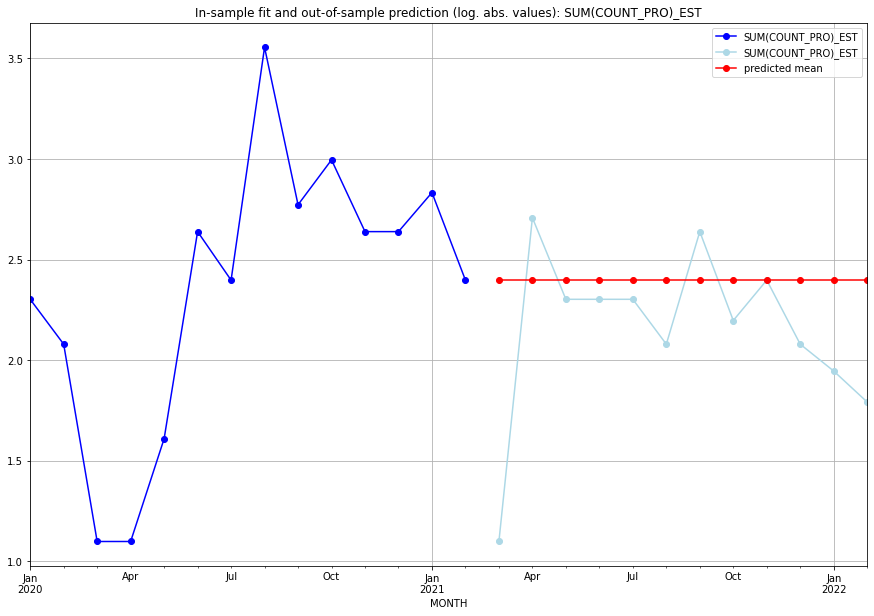

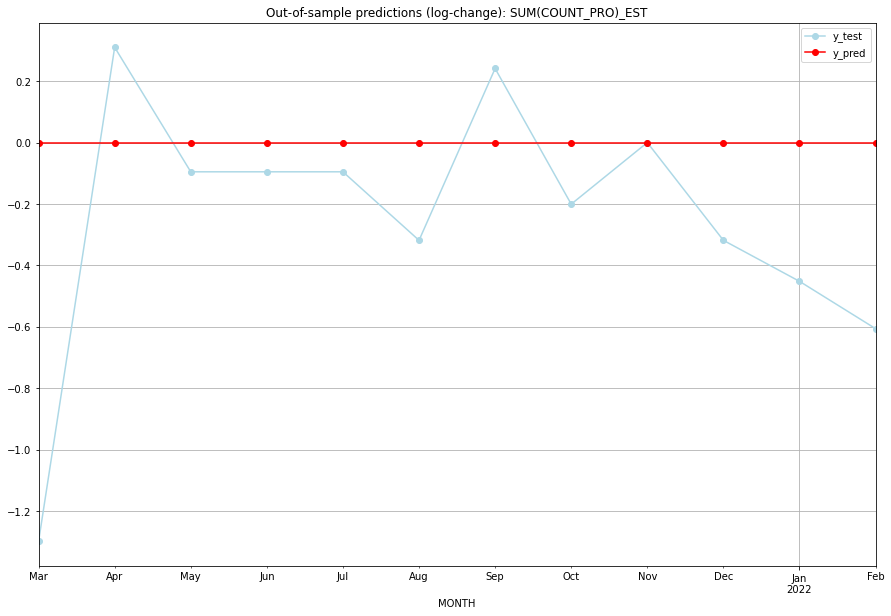

TADDA: 0.3360191328063797
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  2.397895    1.098612           0.0       -1.299283   EST   
1  2021-04-01  2.397895    2.708050           0.0        0.310155   EST   
2  2021-05-01  2.397895    2.302585           0.0       -0.095310   EST   
3  2021-06-01  2.397895    2.302585           0.0       -0.095310   EST   
4  2021-07-01  2.397895    2.302585           0.0       -0.095310   EST   
5  2021-08-01  2.397895    2.079442           0.0       -0.318454   EST   
6  2021-09-01  2.397895    2.639057           0.0        0.241162   EST   
7  2021-10-01  2.397895    2.197225           0.0       -0.200671   EST   
8  2021-11-01  2.397895    2.397895           0.0        0.000000   EST   
9  2021-12-01  2.397895    2.079442           0.0       -0.318454   EST   
10 2022-01-01  2.397895    1.945910           0.0       -0.451985   EST   
11 2022-02-01  2.397895    1.791759           0.0    

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [1, (3, 0, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.8548435279915197, 'fold_results': [0.8548435279915197]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_ETH   No. Observations:                  289
Model:               SARIMAX(3, 0, 3)   Log Likelihood                -342.806
Date:                Fri, 16 Sep 2022   AIC                            701.611
Time:                        14:04:49   BIC                            730.943
Sample:                    02-28-1997   HQIC                           713.364
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1             0.0084      0.042      0.198      0.843   

<Figure size 432x288 with 0 Axes>

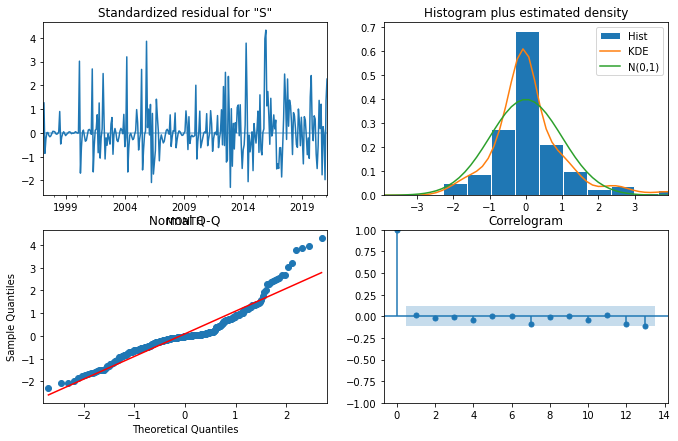

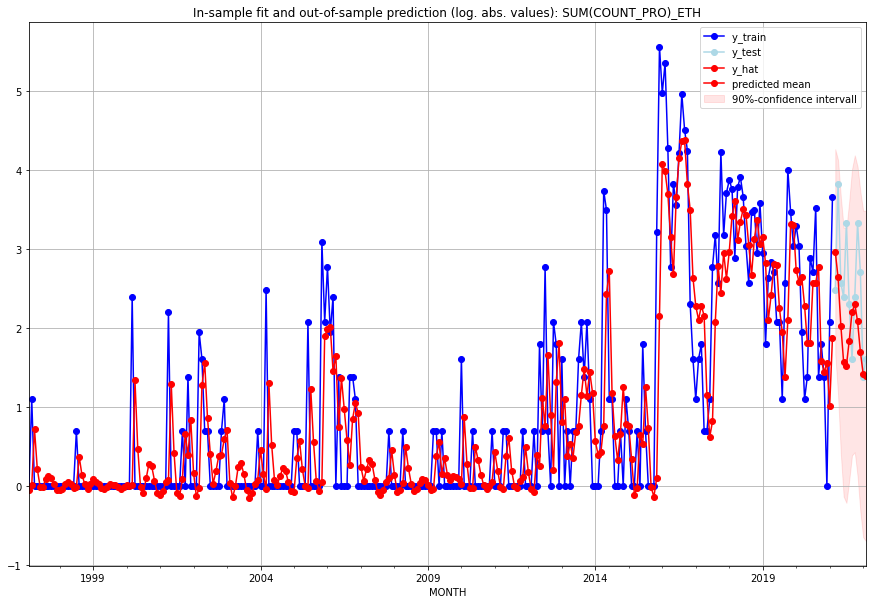

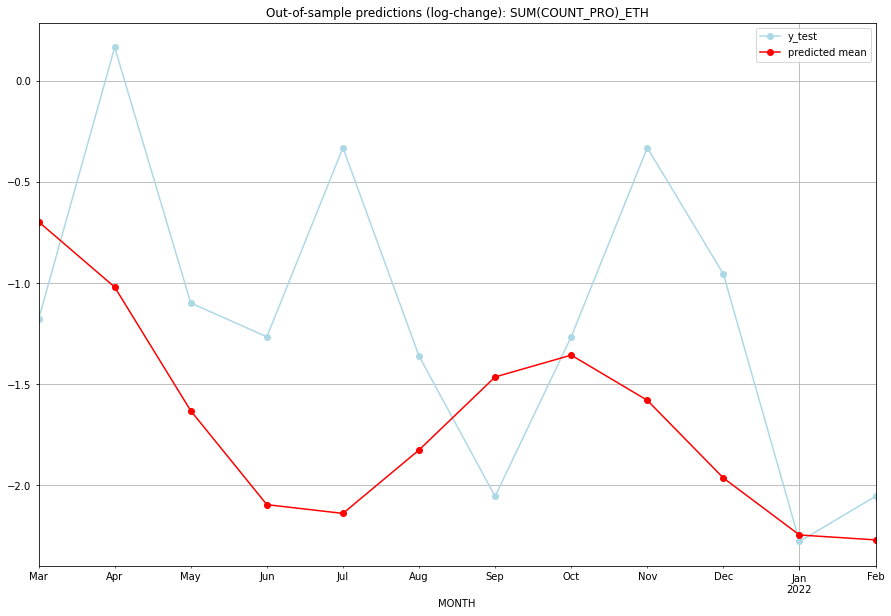

TADDA: 0.7919733936317209
Evaluation finished.
        MONTH   FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  18.423839        11.0     -0.697060       -1.178655   ETH   
1  2021-04-01  13.065827        45.0     -1.019813        0.165080   ETH   
2  2021-05-01   6.631026        12.0     -1.631339       -1.098612   ETH   
3  2021-06-01   3.798784        10.0     -2.095199       -1.265666   ETH   
4  2021-07-01   3.595395        27.0     -2.138507       -0.331357   ETH   
5  2021-08-01   5.287311         9.0     -1.825028       -1.360977   ETH   
6  2021-09-01   8.020100         4.0     -1.464106       -2.054124   ETH   
7  2021-10-01   9.047295        10.0     -1.356258       -1.265666   ETH   
8  2021-11-01   7.037382        27.0     -1.579458       -0.331357   ETH   
9  2021-12-01   4.474468        14.0     -1.963467       -0.955511   ETH   
10 2022-01-01   3.130546         3.0     -2.245152       -2.277267   ETH   
11 2022-02-01   3.032152         4.0     

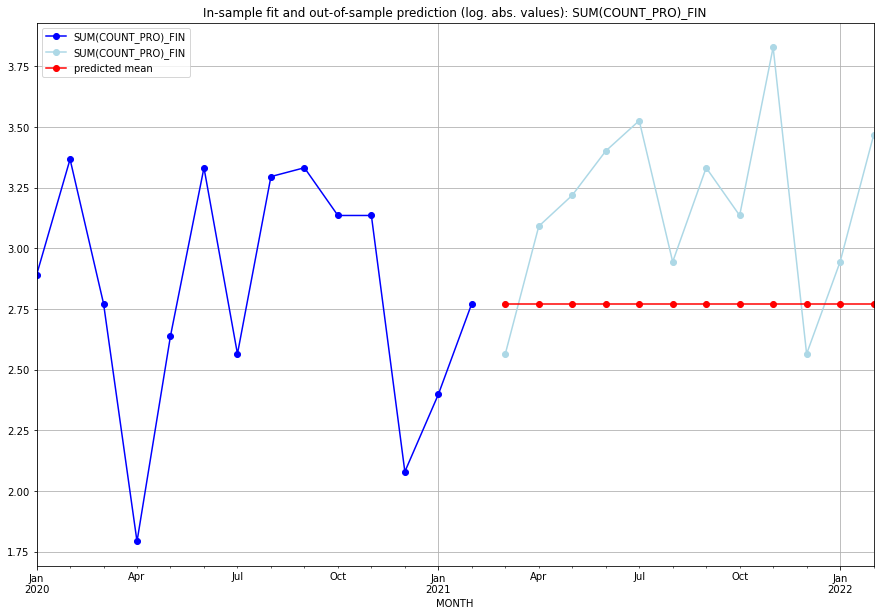

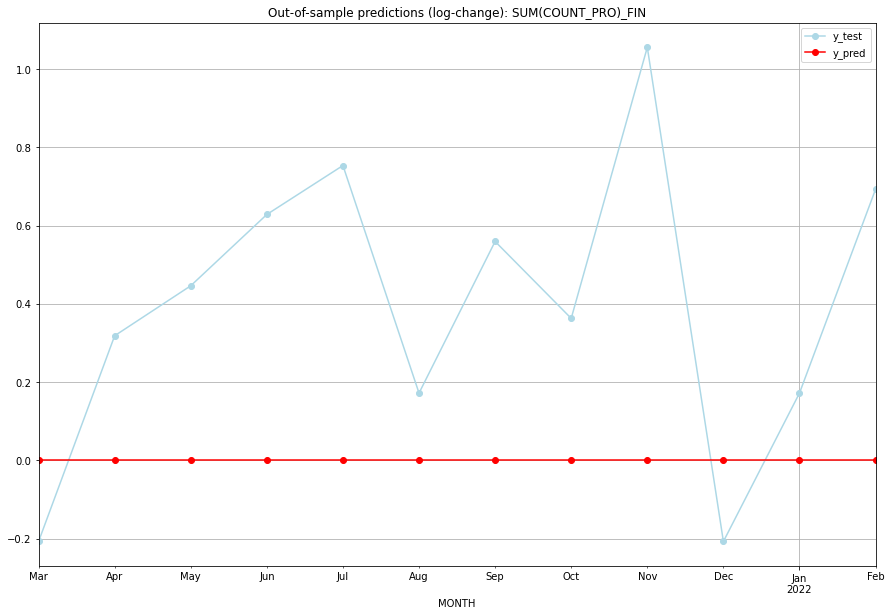

TADDA: 0.46481847294913053
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  2.772589    2.564949           0.0       -0.207639   FIN   
1  2021-04-01  2.772589    3.091042           0.0        0.318454   FIN   
2  2021-05-01  2.772589    3.218876           0.0        0.446287   FIN   
3  2021-06-01  2.772589    3.401197           0.0        0.628609   FIN   
4  2021-07-01  2.772589    3.526361           0.0        0.753772   FIN   
5  2021-08-01  2.772589    2.944439           0.0        0.171850   FIN   
6  2021-09-01  2.772589    3.332205           0.0        0.559616   FIN   
7  2021-10-01  2.772589    3.135494           0.0        0.362905   FIN   
8  2021-11-01  2.772589    3.828641           0.0        1.056053   FIN   
9  2021-12-01  2.772589    2.564949           0.0       -0.207639   FIN   
10 2022-01-01  2.772589    2.944439           0.0        0.171850   FIN   
11 2022-02-01  2.772589    3.465736           0.0   

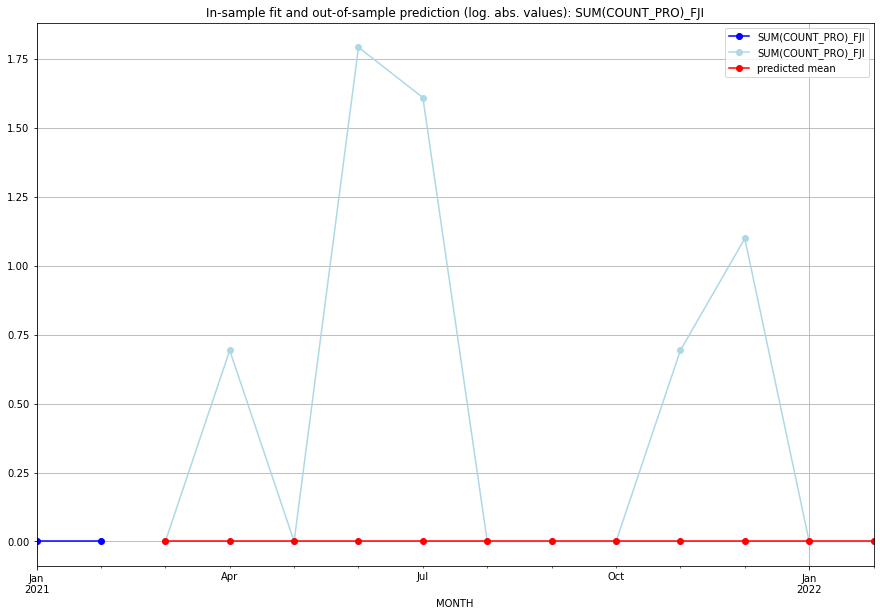

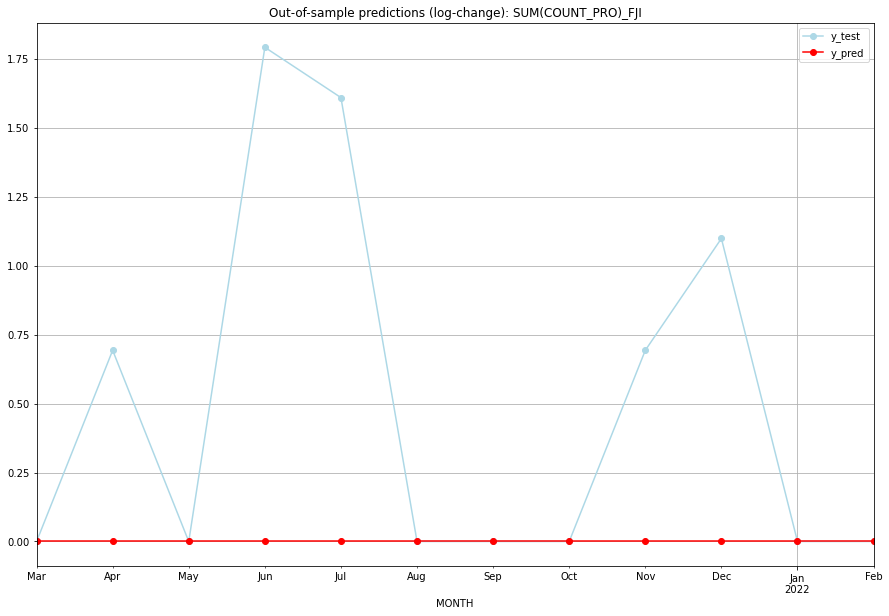

TADDA: 0.4905086692875131
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0    0.000000           0.0        0.000000   FJI   
1  2021-04-01       0.0    0.693147           0.0        0.693147   FJI   
2  2021-05-01       0.0    0.000000           0.0        0.000000   FJI   
3  2021-06-01       0.0    1.791759           0.0        1.791759   FJI   
4  2021-07-01       0.0    1.609438           0.0        1.609438   FJI   
5  2021-08-01       0.0    0.000000           0.0        0.000000   FJI   
6  2021-09-01       0.0    0.000000           0.0        0.000000   FJI   
7  2021-10-01       0.0    0.000000           0.0        0.000000   FJI   
8  2021-11-01       0.0    0.693147           0.0        0.693147   FJI   
9  2021-12-01       0.0    1.098612           0.0        1.098612   FJI   
10 2022-01-01       0.0    0.000000           0.0        0.000000   FJI   
11 2022-02-01       0.0    0.000000           0.0    

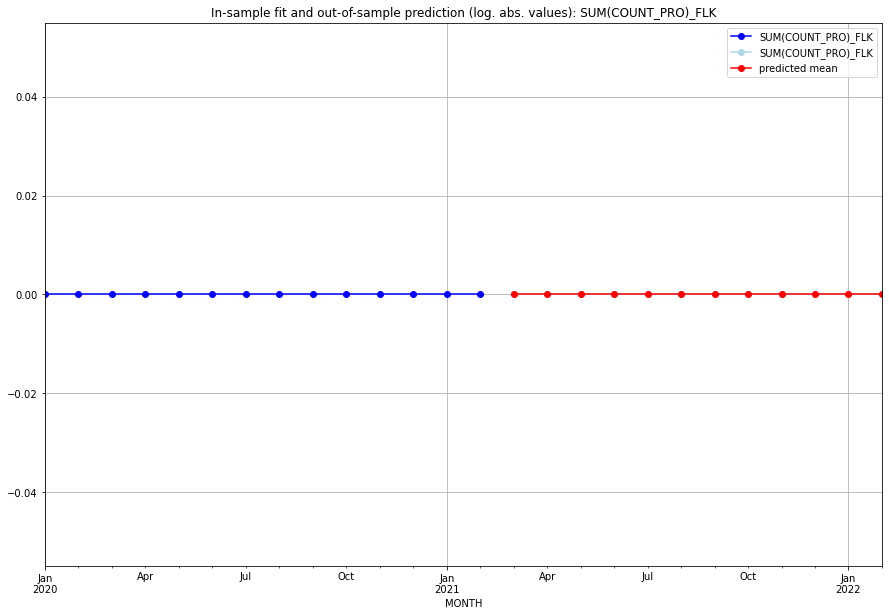

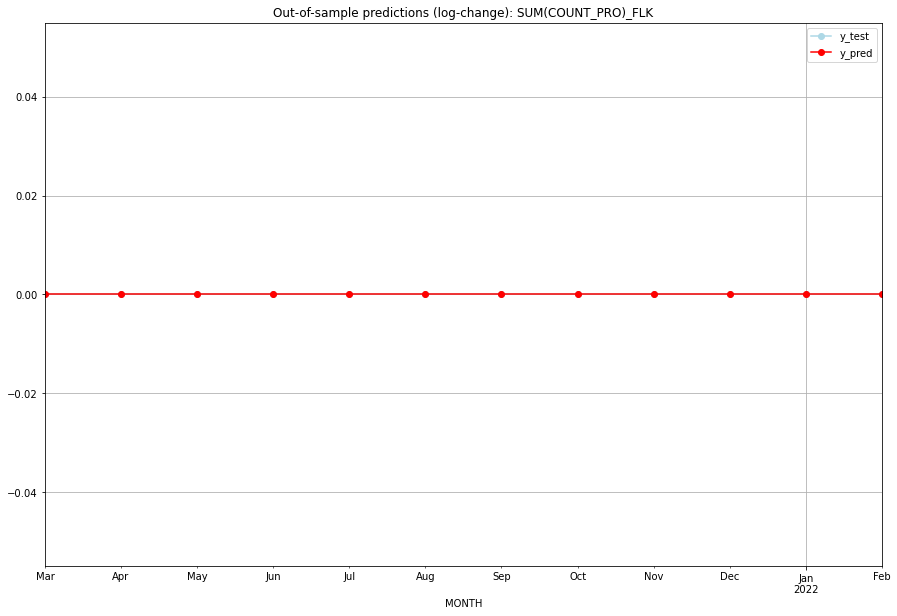

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   FLK   
1  2021-04-01       0.0         0.0           0.0             0.0   FLK   
2  2021-05-01       0.0         0.0           0.0             0.0   FLK   
3  2021-06-01       0.0         0.0           0.0             0.0   FLK   
4  2021-07-01       0.0         0.0           0.0             0.0   FLK   
5  2021-08-01       0.0         0.0           0.0             0.0   FLK   
6  2021-09-01       0.0         0.0           0.0             0.0   FLK   
7  2021-10-01       0.0         0.0           0.0             0.0   FLK   
8  2021-11-01       0.0         0.0           0.0             0.0   FLK   
9  2021-12-01       0.0         0.0           0.0             0.0   FLK   
10 2022-01-01       0.0         0.0           0.0             0.0   FLK   
11 2022-02-01       0.0         0.0           0.0             0.0   

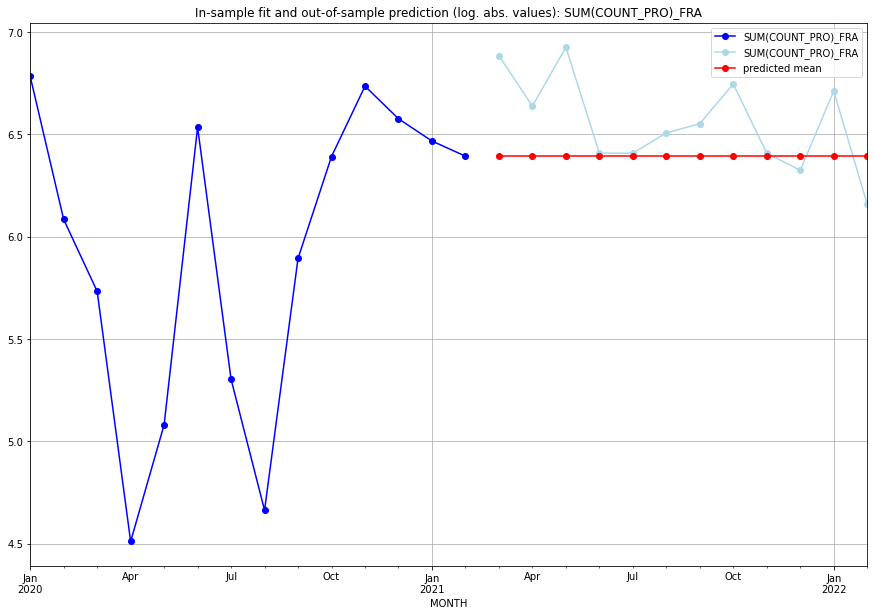

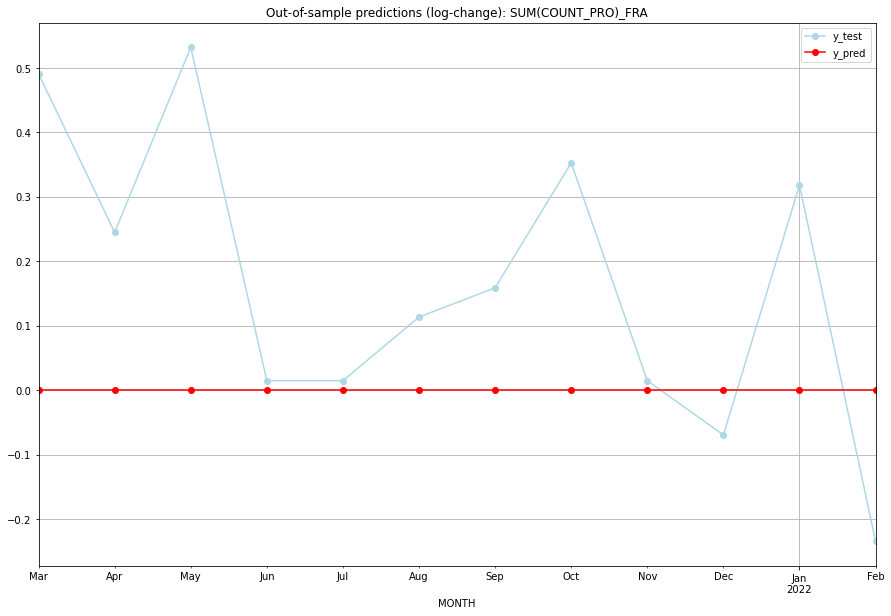

TADDA: 0.21333281267242735
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  6.393591    6.884487           0.0        0.490896   FRA   
1  2021-04-01  6.393591    6.638568           0.0        0.244977   FRA   
2  2021-05-01  6.393591    6.925595           0.0        0.532004   FRA   
3  2021-06-01  6.393591    6.408529           0.0        0.014938   FRA   
4  2021-07-01  6.393591    6.408529           0.0        0.014938   FRA   
5  2021-08-01  6.393591    6.507278           0.0        0.113687   FRA   
6  2021-09-01  6.393591    6.552508           0.0        0.158917   FRA   
7  2021-10-01  6.393591    6.746412           0.0        0.352821   FRA   
8  2021-11-01  6.393591    6.408529           0.0        0.014938   FRA   
9  2021-12-01  6.393591    6.324359           0.0       -0.069232   FRA   
10 2022-01-01  6.393591    6.711740           0.0        0.318150   FRA   
11 2022-02-01  6.393591    6.159095           0.0   

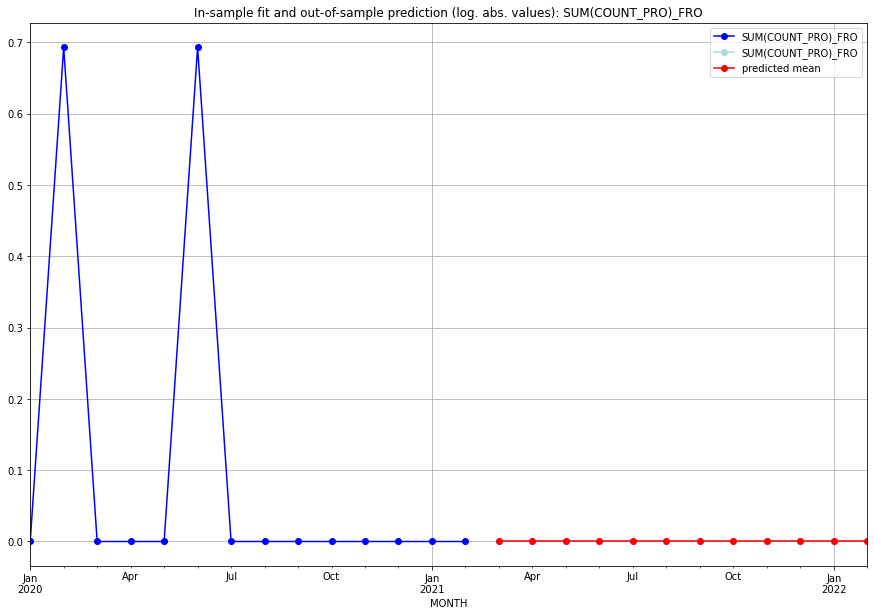

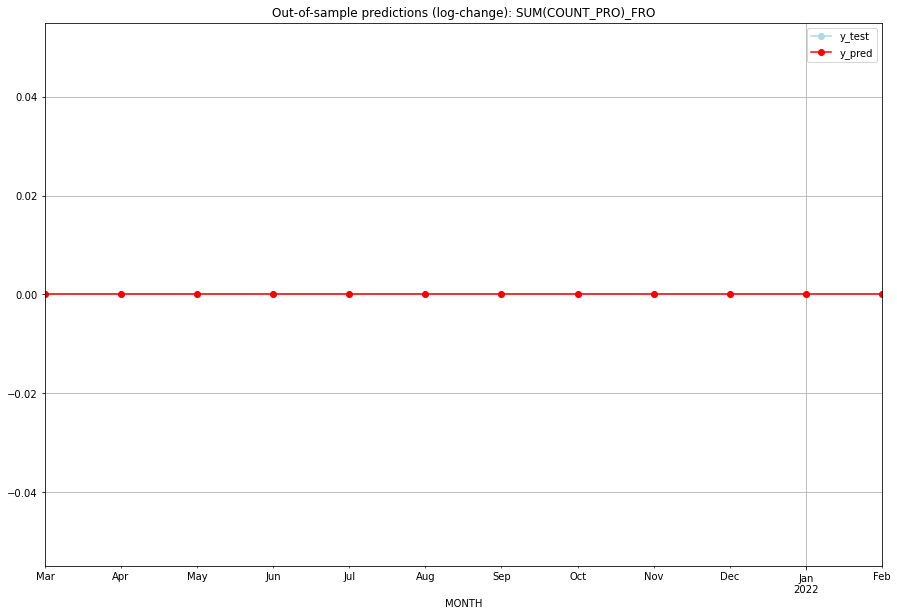

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   FRO   
1  2021-04-01       0.0         0.0           0.0             0.0   FRO   
2  2021-05-01       0.0         0.0           0.0             0.0   FRO   
3  2021-06-01       0.0         0.0           0.0             0.0   FRO   
4  2021-07-01       0.0         0.0           0.0             0.0   FRO   
5  2021-08-01       0.0         0.0           0.0             0.0   FRO   
6  2021-09-01       0.0         0.0           0.0             0.0   FRO   
7  2021-10-01       0.0         0.0           0.0             0.0   FRO   
8  2021-11-01       0.0         0.0           0.0             0.0   FRO   
9  2021-12-01       0.0         0.0           0.0             0.0   FRO   
10 2022-01-01       0.0         0.0           0.0             0.0   FRO   
11 2022-02-01       0.0         0.0           0.0             0.0   

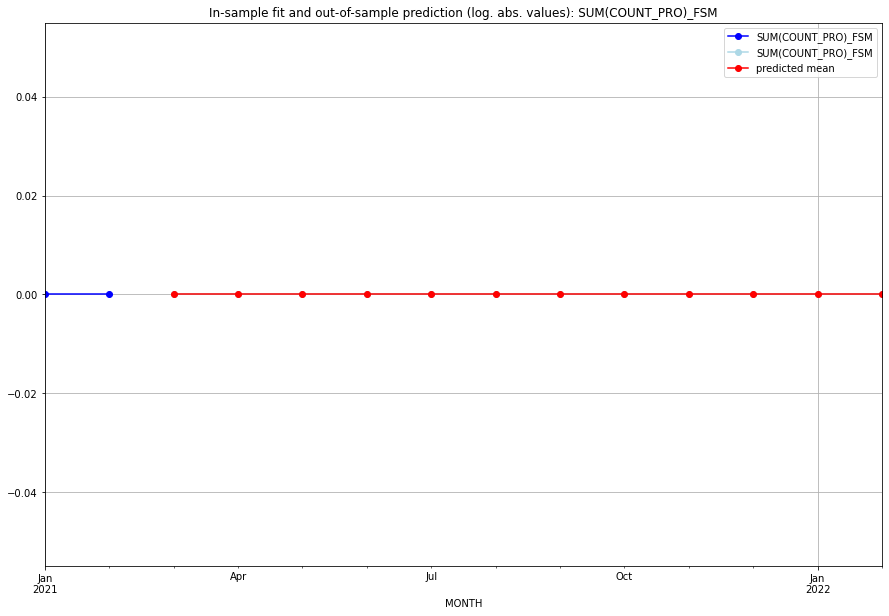

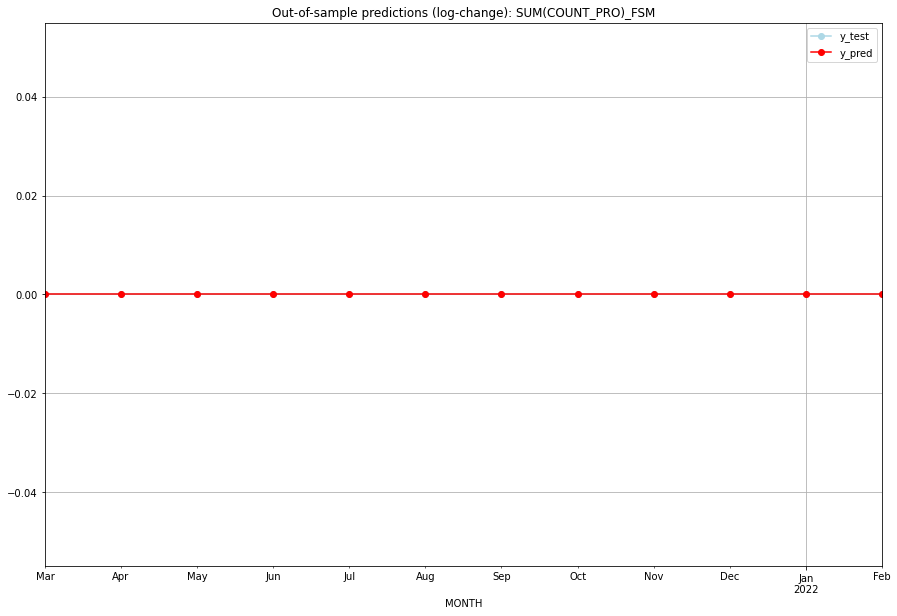

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   FSM   
1  2021-04-01       0.0         0.0           0.0             0.0   FSM   
2  2021-05-01       0.0         0.0           0.0             0.0   FSM   
3  2021-06-01       0.0         0.0           0.0             0.0   FSM   
4  2021-07-01       0.0         0.0           0.0             0.0   FSM   
5  2021-08-01       0.0         0.0           0.0             0.0   FSM   
6  2021-09-01       0.0         0.0           0.0             0.0   FSM   
7  2021-10-01       0.0         0.0           0.0             0.0   FSM   
8  2021-11-01       0.0         0.0           0.0             0.0   FSM   
9  2021-12-01       0.0         0.0           0.0             0.0   FSM   
10 2022-01-01       0.0         0.0           0.0             0.0   FSM   
11 2022-02-01       0.0         0.0           0.0             0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [3, (1, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.3053794404719872, 'fold_results': [0.3053794404719872]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_GAB   No. Observations:                  289
Model:               SARIMAX(1, 1, 0)   Log Likelihood                -210.666
Date:                Fri, 16 Sep 2022   AIC                            431.331
Time:                        14:06:24   BIC                            449.646
Sample:                    02-28-1997   HQIC                           438.671
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            -0.0195      0.030     -0.658      0.511   

<Figure size 432x288 with 0 Axes>

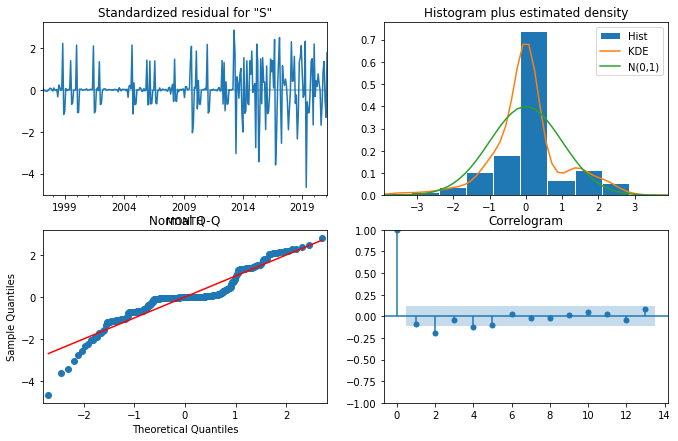

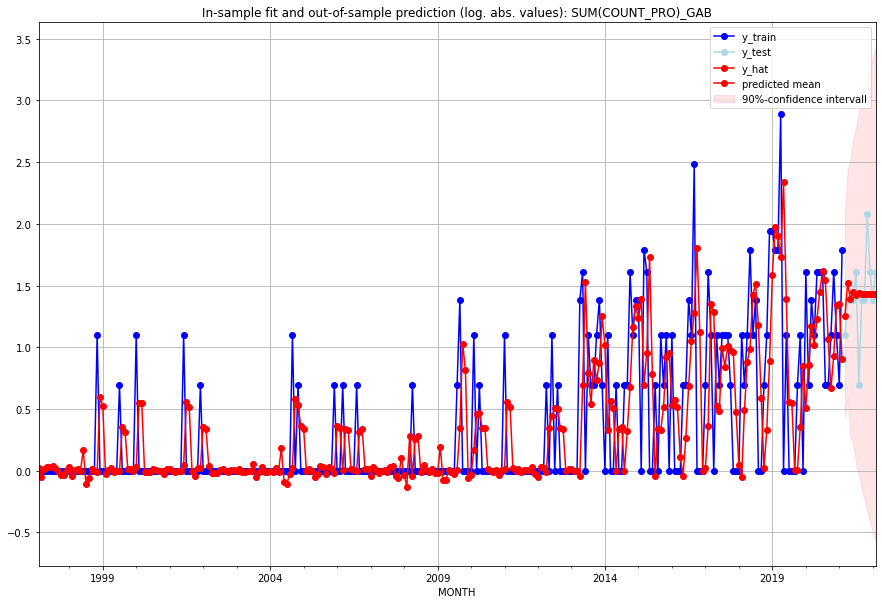

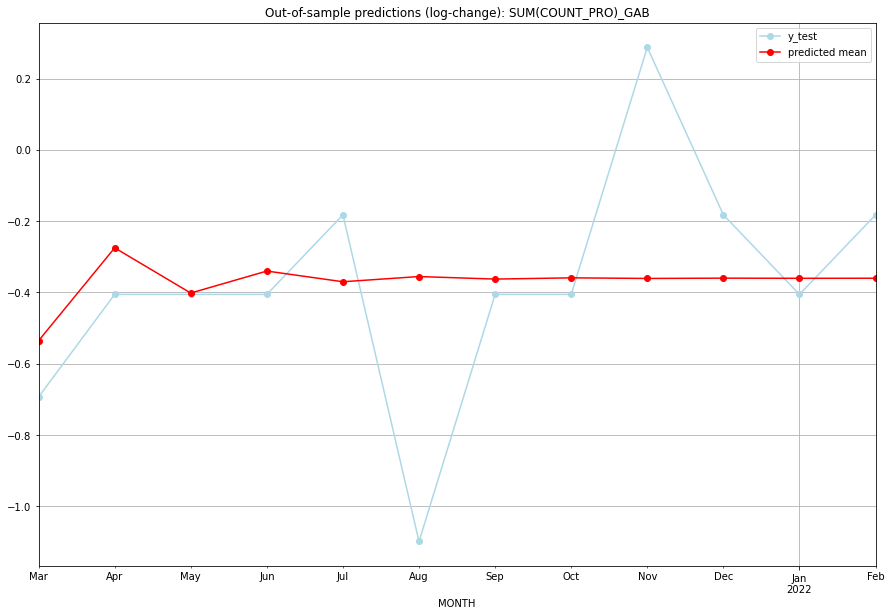

TADDA: 0.23229692761324947
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  2.512594         2.0     -0.535405       -0.693147   GAB   
1  2021-04-01  3.557946         3.0     -0.274887       -0.405465   GAB   
2  2021-05-01  3.015289         3.0     -0.401650       -0.405465   GAB   
3  2021-06-01  3.270751         3.0     -0.339970       -0.405465   GAB   
4  2021-07-01  3.144480         4.0     -0.369982       -0.182322   GAB   
5  2021-08-01  3.205448         1.0     -0.355379       -1.098612   GAB   
6  2021-09-01  3.175671         3.0     -0.362484       -0.405465   GAB   
7  2021-10-01  3.190133         3.0     -0.359027       -0.405465   GAB   
8  2021-11-01  3.183090         7.0     -0.360709        0.287682   GAB   
9  2021-12-01  3.186515         4.0     -0.359891       -0.182322   GAB   
10 2022-01-01  3.184848         3.0     -0.360289       -0.405465   GAB   
11 2022-02-01  3.185659         4.0     -0.360095   

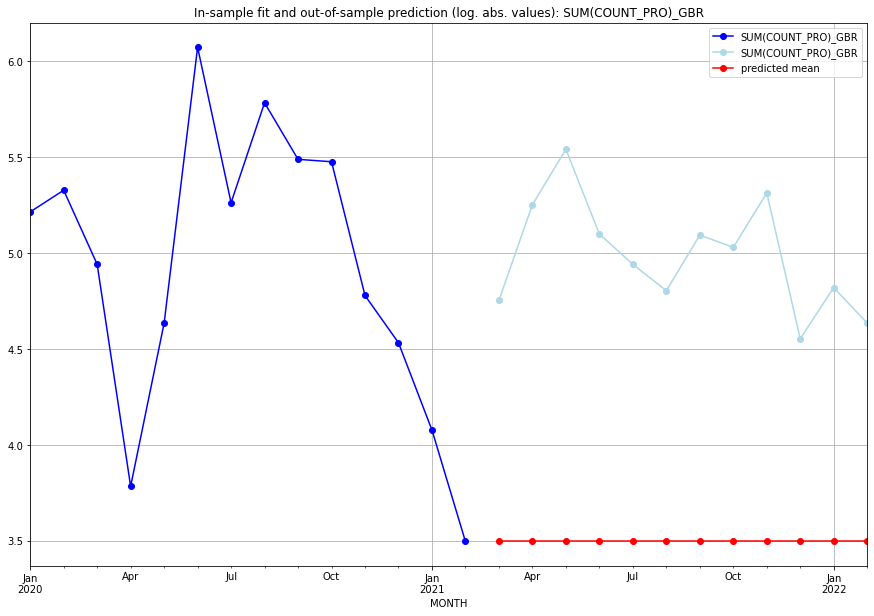

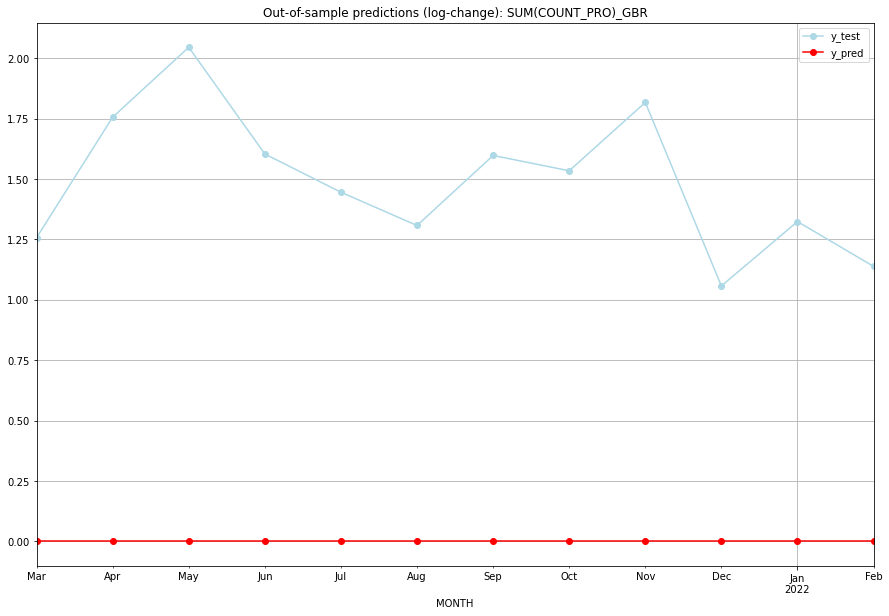

TADDA: 1.4900706557130519
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  3.496508    4.753590           0.0        1.257083   GBR   
1  2021-04-01  3.496508    5.252273           0.0        1.755766   GBR   
2  2021-05-01  3.496508    5.541264           0.0        2.044756   GBR   
3  2021-06-01  3.496508    5.099866           0.0        1.603359   GBR   
4  2021-07-01  3.496508    4.941642           0.0        1.445135   GBR   
5  2021-08-01  3.496508    4.804021           0.0        1.307513   GBR   
6  2021-09-01  3.496508    5.093750           0.0        1.597243   GBR   
7  2021-10-01  3.496508    5.030438           0.0        1.533930   GBR   
8  2021-11-01  3.496508    5.313206           0.0        1.816698   GBR   
9  2021-12-01  3.496508    4.553877           0.0        1.057369   GBR   
10 2022-01-01  3.496508    4.820282           0.0        1.323774   GBR   
11 2022-02-01  3.496508    4.634729           0.0    

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (2, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.47386025330847575, 'fold_results': [0.47386025330847575]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_GEO   No. Observations:                   38
Model:               SARIMAX(2, 1, 0)   Log Likelihood                 -24.448
Date:                Fri, 16 Sep 2022   AIC                             54.896
Time:                        14:07:10   BIC                             59.729
Sample:                    01-31-2018   HQIC                            56.600
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.1289      0.125     -1.029      0.304 

<Figure size 432x288 with 0 Axes>

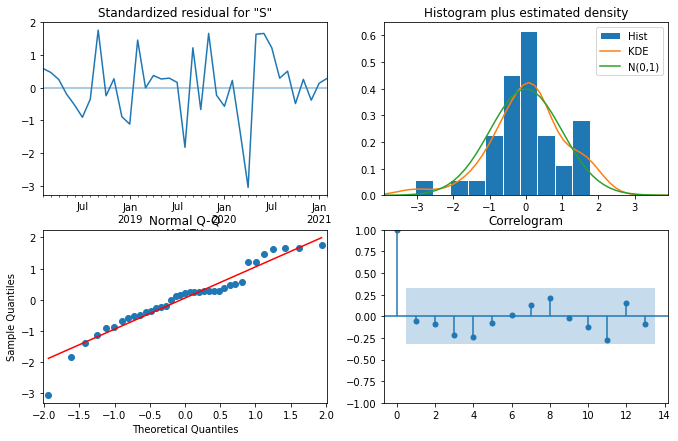

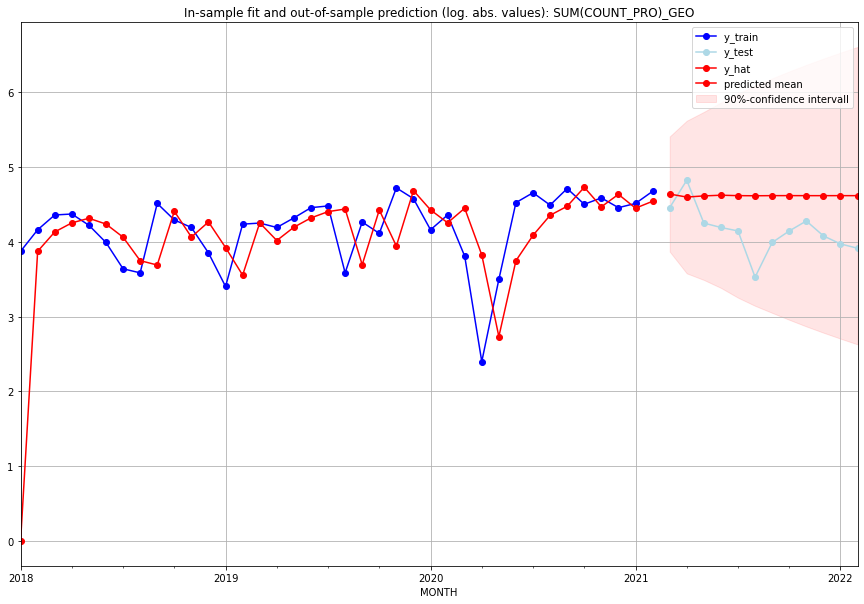

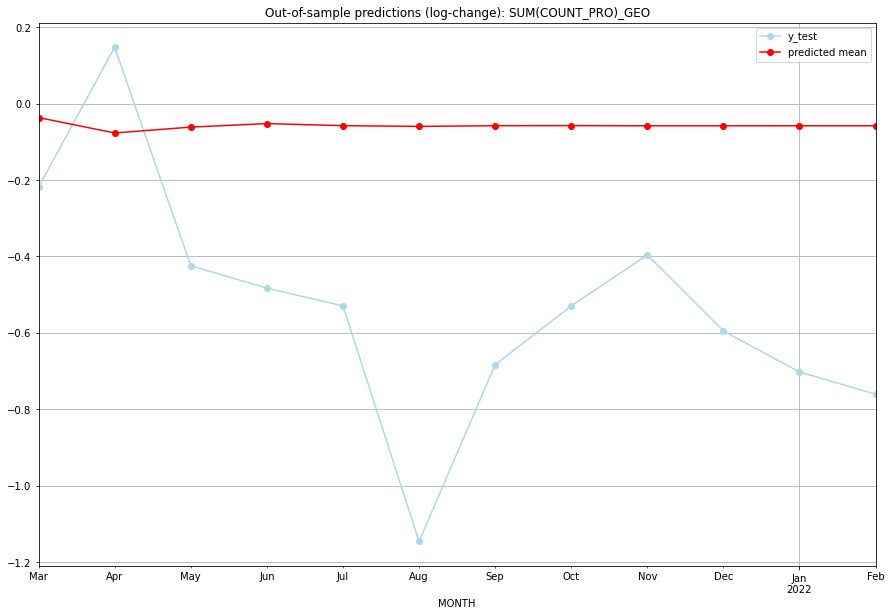

TADDA: 0.5130491100911051
Evaluation finished.
        MONTH    FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  102.158181        85.0     -0.036565       -0.218482   GEO   
1  2021-04-01   98.088505       123.0     -0.076815        0.147453   GEO   
2  2021-05-01   99.620116        69.0     -0.061477       -0.424334   GEO   
3  2021-06-01  100.549732        65.0     -0.052280       -0.483174   GEO   
4  2021-07-01   99.998450        62.0     -0.057724       -0.529694   GEO   
5  2021-08-01   99.811642        33.0     -0.059575       -1.146468   GEO   
6  2021-09-01   99.988193        53.0     -0.057825       -0.683845   GEO   
7  2021-10-01  100.017322        62.0     -0.057537       -0.529694   GEO   
8  2021-11-01   99.964512        71.0     -0.058060       -0.396163   GEO   
9  2021-12-01   99.963234        58.0     -0.058072       -0.595291   GEO   
10 2022-01-01   99.978056        52.0     -0.057926       -0.702537   GEO   
11 2022-02-01   99.976500    

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.29862657820467586, 'fold_results': [0.29862657820467586]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_GGY   No. Observations:                  289
Model:                        SARIMAX   Log Likelihood                 232.965
Date:                Fri, 16 Sep 2022   AIC                           -463.929
Time:                        14:07:37   BIC                           -460.263
Sample:                    02-28-1997   HQIC                          -462.460
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.0117      0.000     78.201      0.000 

<Figure size 432x288 with 0 Axes>

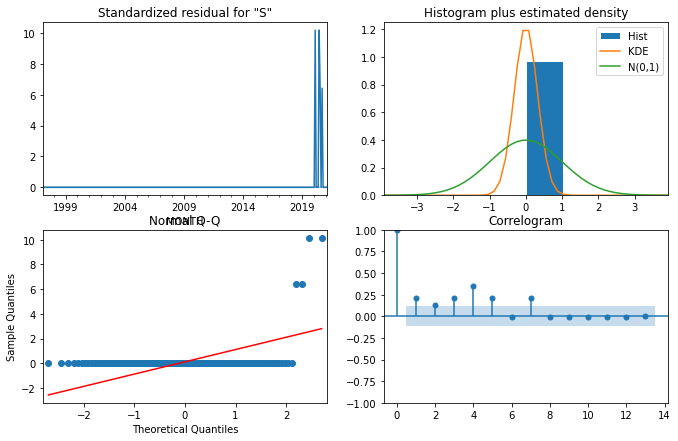

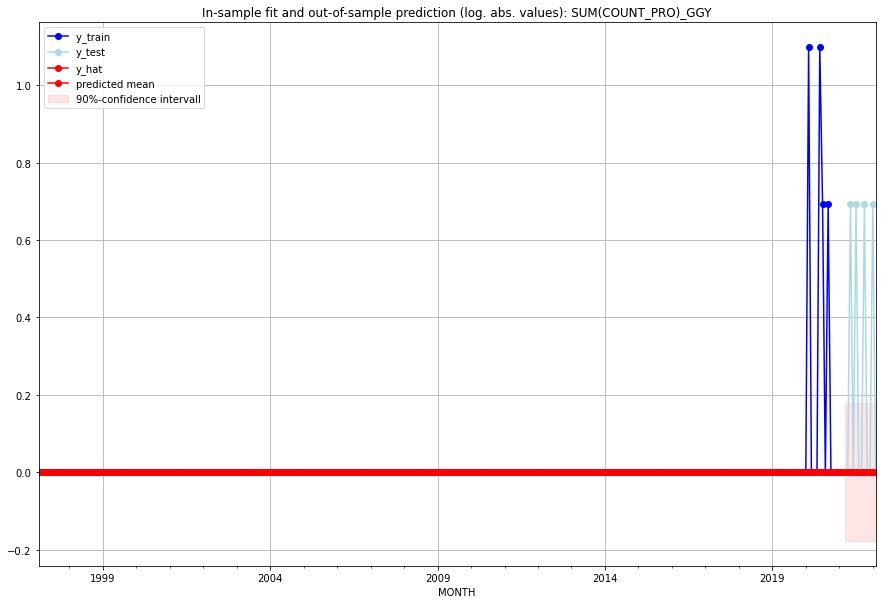

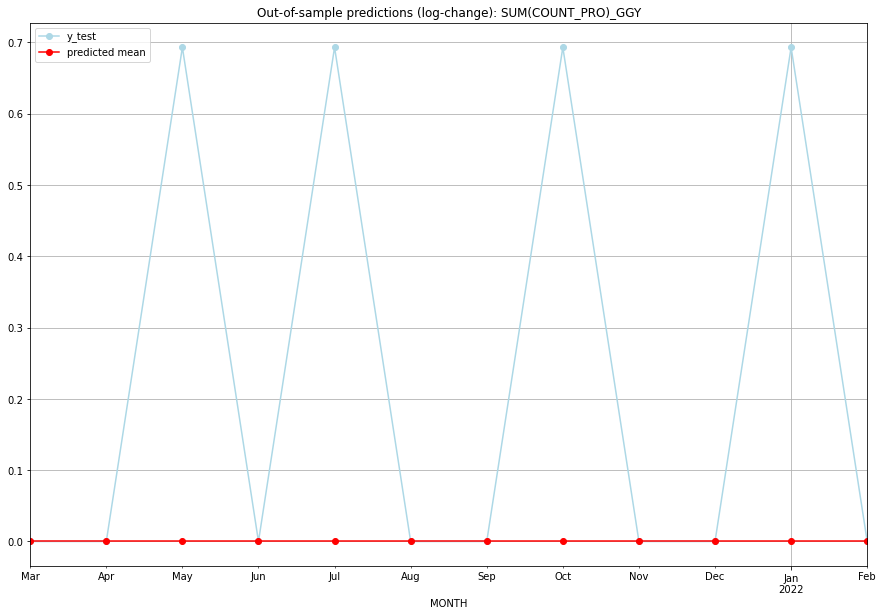

TADDA: 0.23104906018664842
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0        0.000000   GGY   
1  2021-04-01       0.0         0.0           0.0        0.000000   GGY   
2  2021-05-01       0.0         1.0           0.0        0.693147   GGY   
3  2021-06-01       0.0         0.0           0.0        0.000000   GGY   
4  2021-07-01       0.0         1.0           0.0        0.693147   GGY   
5  2021-08-01       0.0         0.0           0.0        0.000000   GGY   
6  2021-09-01       0.0         0.0           0.0        0.000000   GGY   
7  2021-10-01       0.0         1.0           0.0        0.693147   GGY   
8  2021-11-01       0.0         0.0           0.0        0.000000   GGY   
9  2021-12-01       0.0         0.0           0.0        0.000000   GGY   
10 2022-01-01       0.0         1.0           0.0        0.693147   GGY   
11 2022-02-01       0.0         0.0           0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [1, (3, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.5440460607106297, 'fold_results': [0.5440460607106297]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_GHA   No. Observations:                  289
Model:               SARIMAX(3, 0, 0)   Log Likelihood                -226.853
Date:                Fri, 16 Sep 2022   AIC                            463.706
Time:                        14:08:14   BIC                            482.038
Sample:                    02-28-1997   HQIC                           471.052
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1             0.0135      0.021      0.653      0.514   

<Figure size 432x288 with 0 Axes>

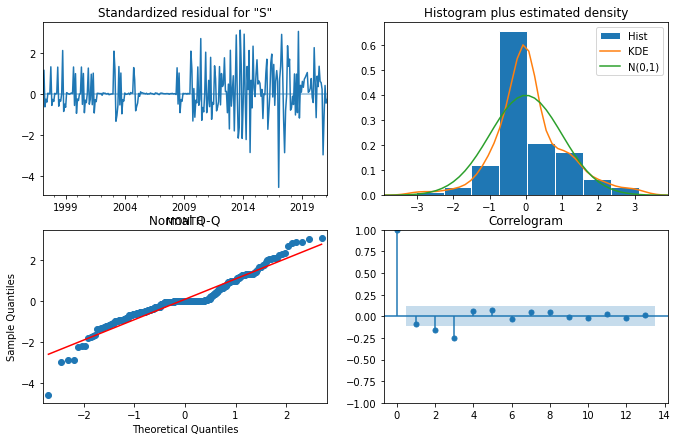

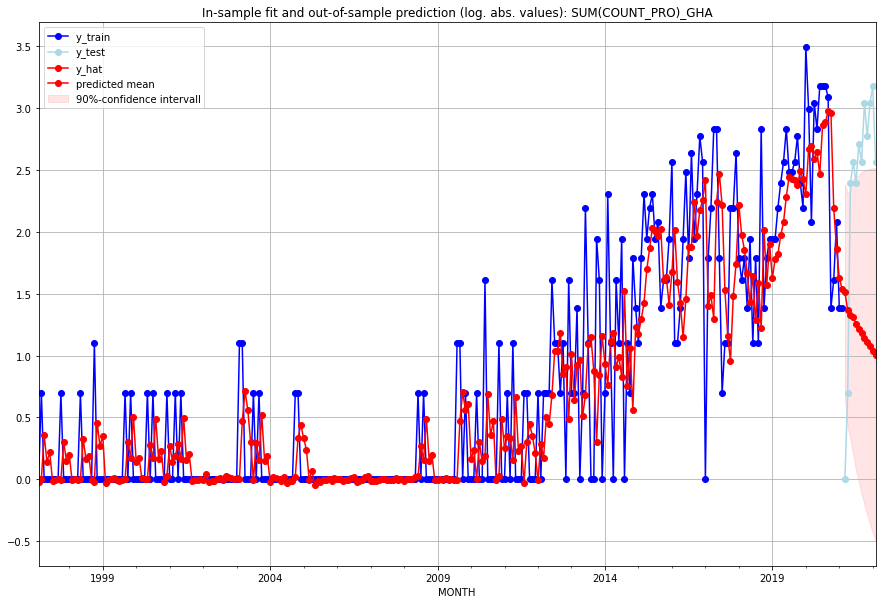

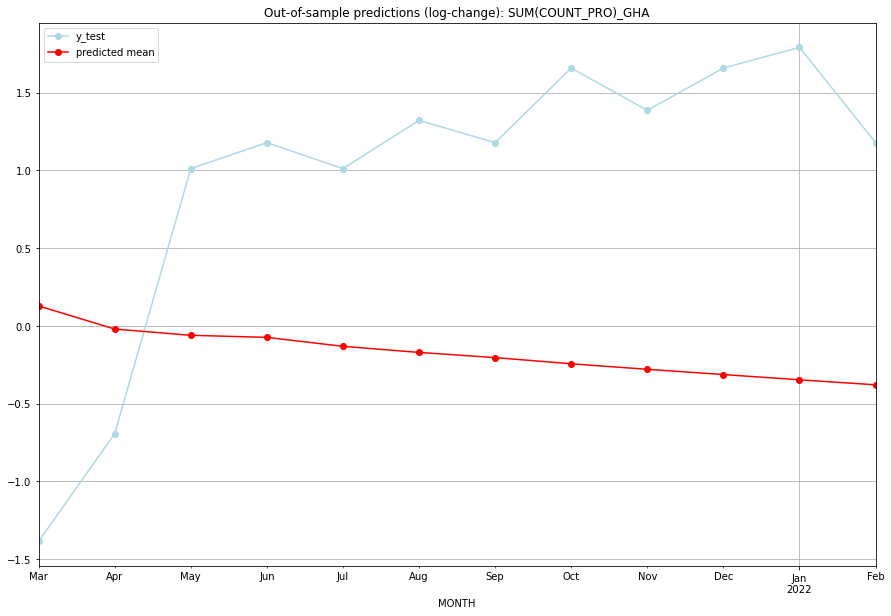

TADDA: 1.6742888437990757
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  3.549699         0.0      0.128767       -1.386294   GHA   
1  2021-04-01  2.920565         1.0     -0.020058       -0.693147   GHA   
2  2021-05-01  2.766107        10.0     -0.060252        1.011601   GHA   
3  2021-06-01  2.716127        12.0     -0.073612        1.178655   GHA   
4  2021-07-01  2.508002        10.0     -0.131248        1.011601   GHA   
5  2021-08-01  2.373465        14.0     -0.170354        1.321756   GHA   
6  2021-09-01  2.262574        12.0     -0.203778        1.178655   GHA   
7  2021-10-01  2.135838        20.0     -0.243398        1.658228   GHA   
8  2021-11-01  2.026062        15.0     -0.279032        1.386294   GHA   
9  2021-12-01  1.925809        20.0     -0.312723        1.658228   GHA   
10 2022-01-01  1.828690        23.0     -0.346481        1.791759   GHA   
11 2022-02-01  1.739059        12.0     -0.378680    

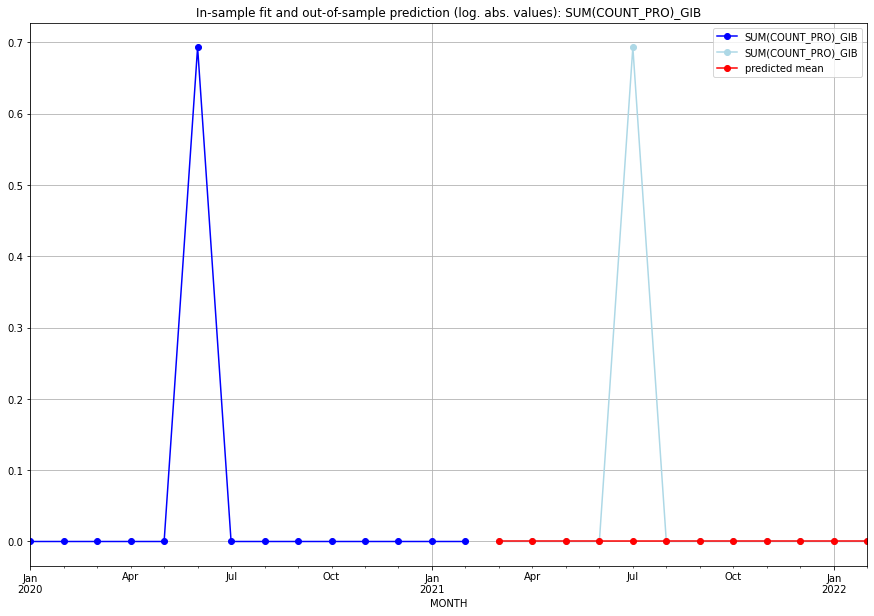

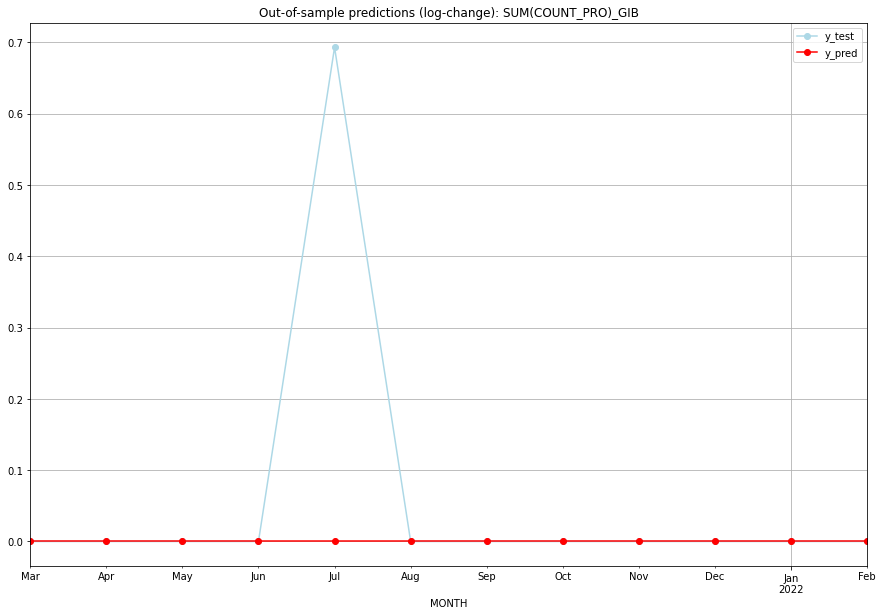

TADDA: 0.057762265046662105
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0    0.000000           0.0        0.000000   GIB   
1  2021-04-01       0.0    0.000000           0.0        0.000000   GIB   
2  2021-05-01       0.0    0.000000           0.0        0.000000   GIB   
3  2021-06-01       0.0    0.000000           0.0        0.000000   GIB   
4  2021-07-01       0.0    0.693147           0.0        0.693147   GIB   
5  2021-08-01       0.0    0.000000           0.0        0.000000   GIB   
6  2021-09-01       0.0    0.000000           0.0        0.000000   GIB   
7  2021-10-01       0.0    0.000000           0.0        0.000000   GIB   
8  2021-11-01       0.0    0.000000           0.0        0.000000   GIB   
9  2021-12-01       0.0    0.000000           0.0        0.000000   GIB   
10 2022-01-01       0.0    0.000000           0.0        0.000000   GIB   
11 2022-02-01       0.0    0.000000           0.0  

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 1, 1), (0, 0, 0, 0), 'n'], 'cv_score': 0.5217333446120761, 'fold_results': [0.5217333446120761]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_GIN   No. Observations:                  289
Model:               SARIMAX(0, 1, 1)   Log Likelihood                -302.690
Date:                Fri, 16 Sep 2022   AIC                            609.380
Time:                        14:08:53   BIC                            616.706
Sample:                    02-28-1997   HQIC                           612.316
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ma.L1         -0.8135      0.029    -27.588      0.000   

<Figure size 432x288 with 0 Axes>

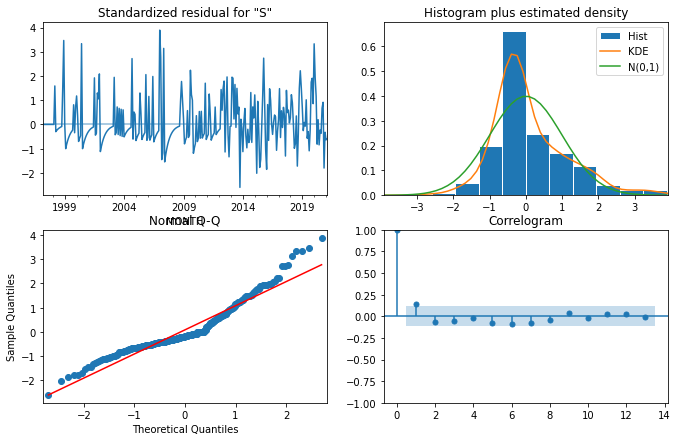

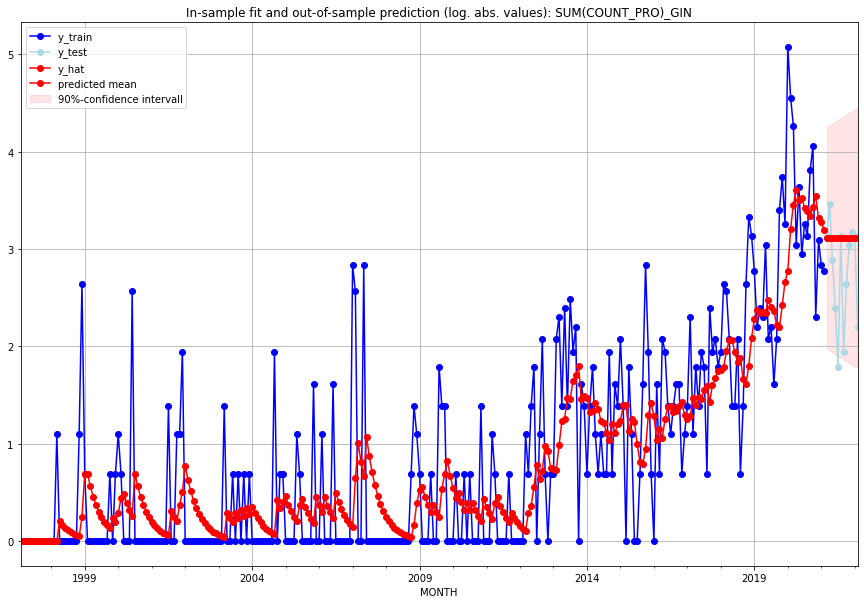

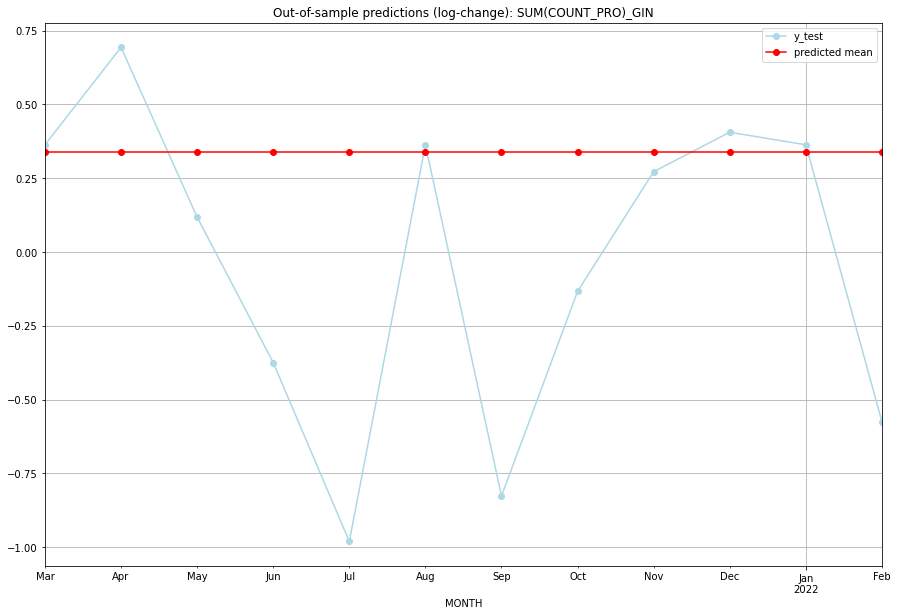

TADDA: 0.5891198291230598
Evaluation finished.
        MONTH   FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  21.481503        22.0      0.340104        0.362905   GIN   
1  2021-04-01  21.481503        31.0      0.340104        0.693147   GIN   
2  2021-05-01  21.481503        17.0      0.340104        0.117783   GIN   
3  2021-06-01  21.481503        10.0      0.340104       -0.374693   GIN   
4  2021-07-01  21.481503         5.0      0.340104       -0.980829   GIN   
5  2021-08-01  21.481503        22.0      0.340104        0.362905   GIN   
6  2021-09-01  21.481503         6.0      0.340104       -0.826679   GIN   
7  2021-10-01  21.481503        13.0      0.340104       -0.133531   GIN   
8  2021-11-01  21.481503        20.0      0.340104        0.271934   GIN   
9  2021-12-01  21.481503        23.0      0.340104        0.405465   GIN   
10 2022-01-01  21.481503        22.0      0.340104        0.362905   GIN   
11 2022-02-01  21.481503         8.0     

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.5611168243197798, 'fold_results': [0.5611168243197798]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_GLP   No. Observations:                   38
Model:               SARIMAX(0, 1, 0)   Log Likelihood                 -47.333
Date:                Fri, 16 Sep 2022   AIC                             96.665
Time:                        14:09:12   BIC                             98.276
Sample:                    01-31-2018   HQIC                            97.233
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.7563      0.201      3.759      0.000   

<Figure size 432x288 with 0 Axes>

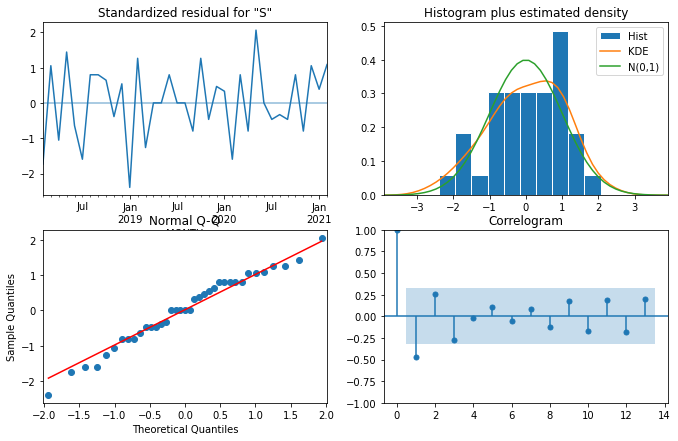

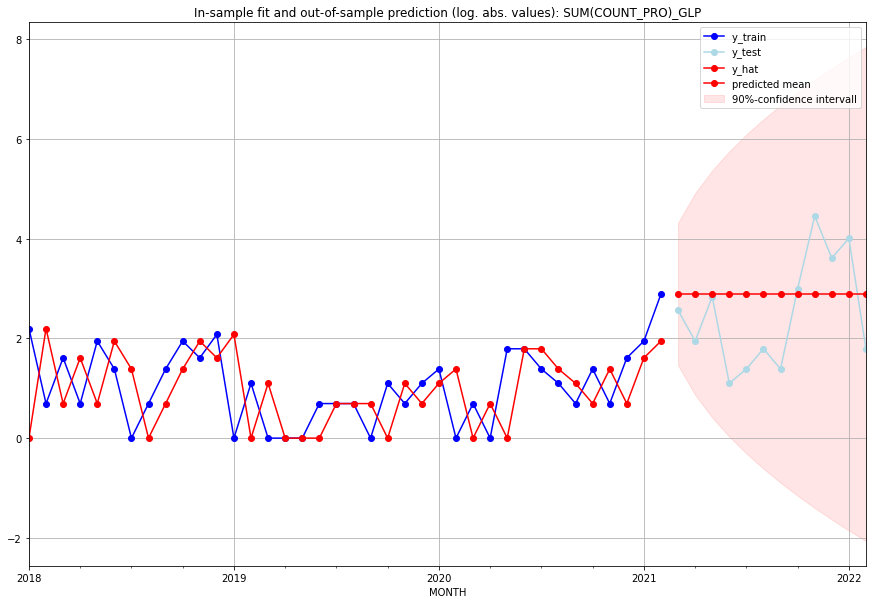

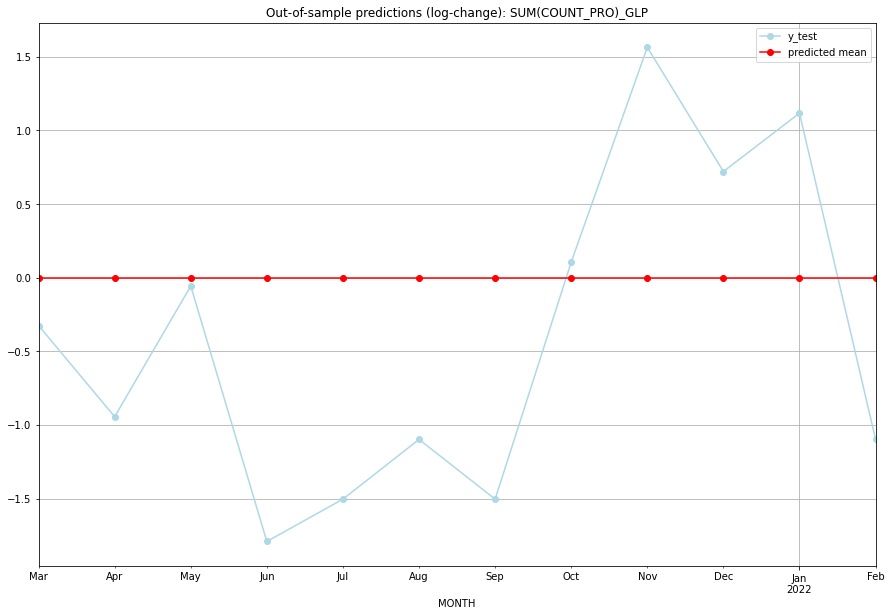

TADDA: 0.9859187416109821
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01      17.0        12.0           0.0       -0.325422   GLP   
1  2021-04-01      17.0         6.0           0.0       -0.944462   GLP   
2  2021-05-01      17.0        16.0           0.0       -0.057158   GLP   
3  2021-06-01      17.0         2.0           0.0       -1.791759   GLP   
4  2021-07-01      17.0         3.0           0.0       -1.504077   GLP   
5  2021-08-01      17.0         5.0           0.0       -1.098612   GLP   
6  2021-09-01      17.0         3.0           0.0       -1.504077   GLP   
7  2021-10-01      17.0        19.0           0.0        0.105361   GLP   
8  2021-11-01      17.0        85.0           0.0        1.563976   GLP   
9  2021-12-01      17.0        36.0           0.0        0.720546   GLP   
10 2022-01-01      17.0        54.0           0.0        1.116961   GLP   
11 2022-02-01      17.0         5.0           0.0    

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [3, (0, 1, 1), (0, 0, 0, 0), 'n'], 'cv_score': 0.35678341381228934, 'fold_results': [0.35678341381228934]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_GMB   No. Observations:                  289
Model:               SARIMAX(0, 1, 1)   Log Likelihood                -165.416
Date:                Fri, 16 Sep 2022   AIC                            340.833
Time:                        14:09:53   BIC                            359.148
Sample:                    02-28-1997   HQIC                           348.172
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            -0.0005      0.020     -0.027      0.979 

<Figure size 432x288 with 0 Axes>

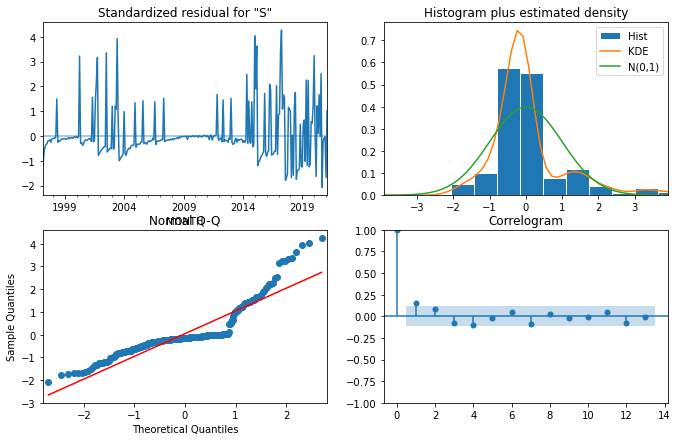

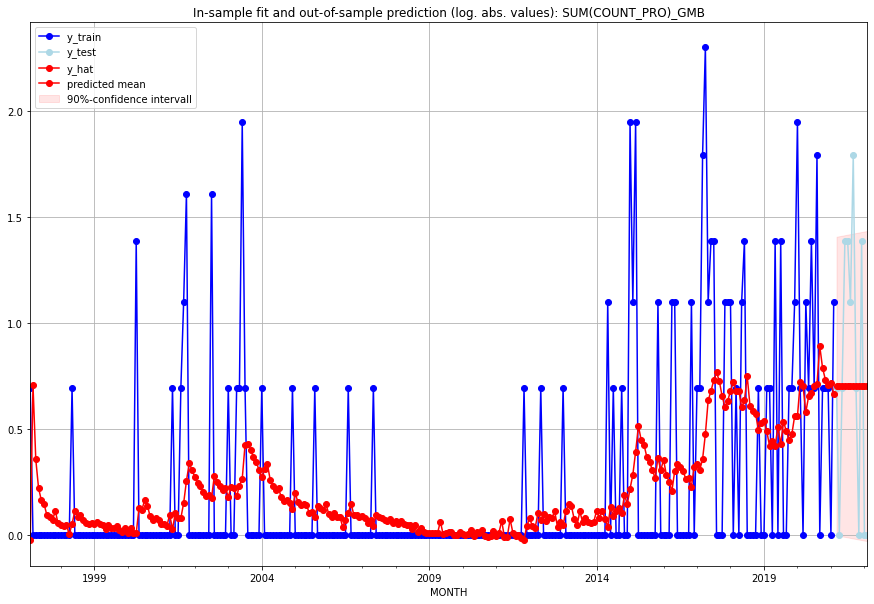

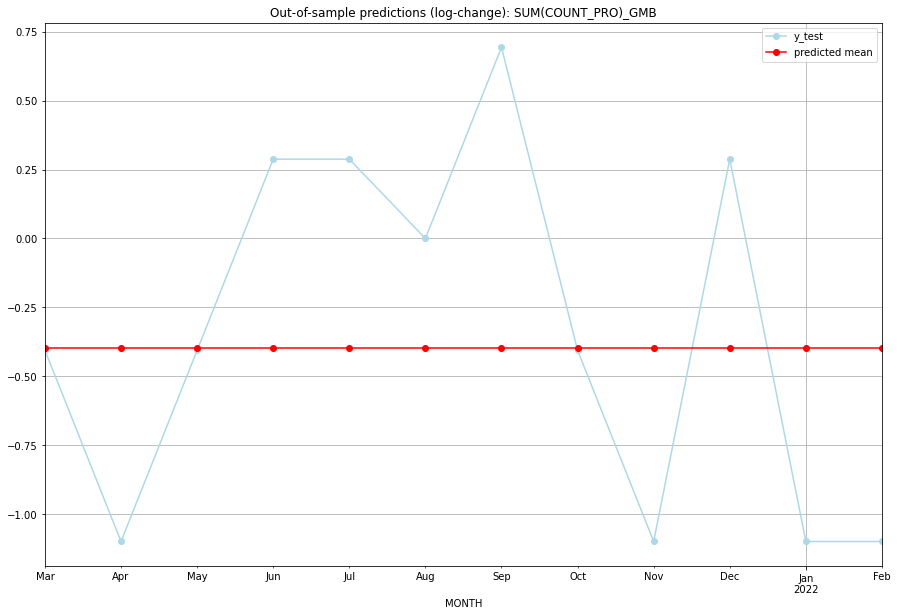

TADDA: 0.6634122054000692
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  1.017094         1.0     -0.396954       -0.405465   GMB   
1  2021-04-01  1.017094         0.0     -0.396954       -1.098612   GMB   
2  2021-05-01  1.017094         1.0     -0.396954       -0.405465   GMB   
3  2021-06-01  1.017094         3.0     -0.396954        0.287682   GMB   
4  2021-07-01  1.017094         3.0     -0.396954        0.287682   GMB   
5  2021-08-01  1.017094         2.0     -0.396954        0.000000   GMB   
6  2021-09-01  1.017094         5.0     -0.396954        0.693147   GMB   
7  2021-10-01  1.017094         1.0     -0.396954       -0.405465   GMB   
8  2021-11-01  1.017094         0.0     -0.396954       -1.098612   GMB   
9  2021-12-01  1.017094         3.0     -0.396954        0.287682   GMB   
10 2022-01-01  1.017094         0.0     -0.396954       -1.098612   GMB   
11 2022-02-01  1.017094         0.0     -0.396954    

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.47191337334466216, 'fold_results': [0.47191337334466216]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_GNB   No. Observations:                  289
Model:                        SARIMAX   Log Likelihood                -155.615
Date:                Fri, 16 Sep 2022   AIC                            313.230
Time:                        14:10:41   BIC                            316.896
Sample:                    02-28-1997   HQIC                           314.699
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.1719      0.007     26.072      0.000 

<Figure size 432x288 with 0 Axes>

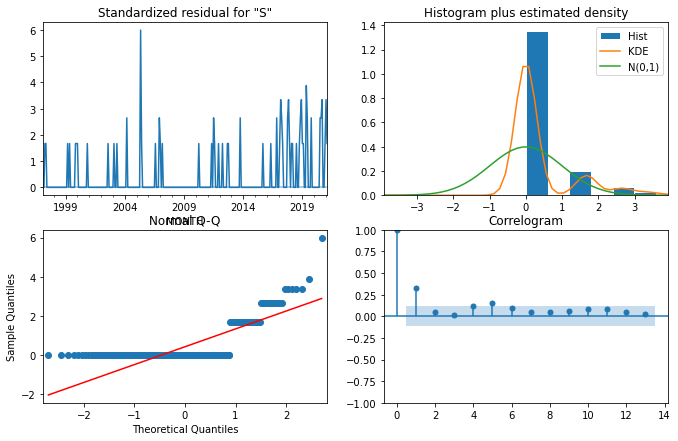

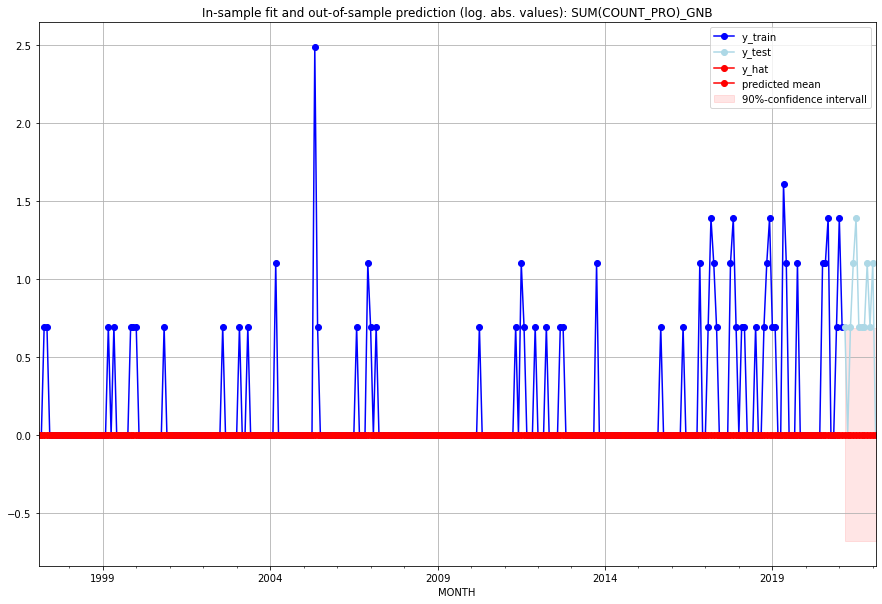

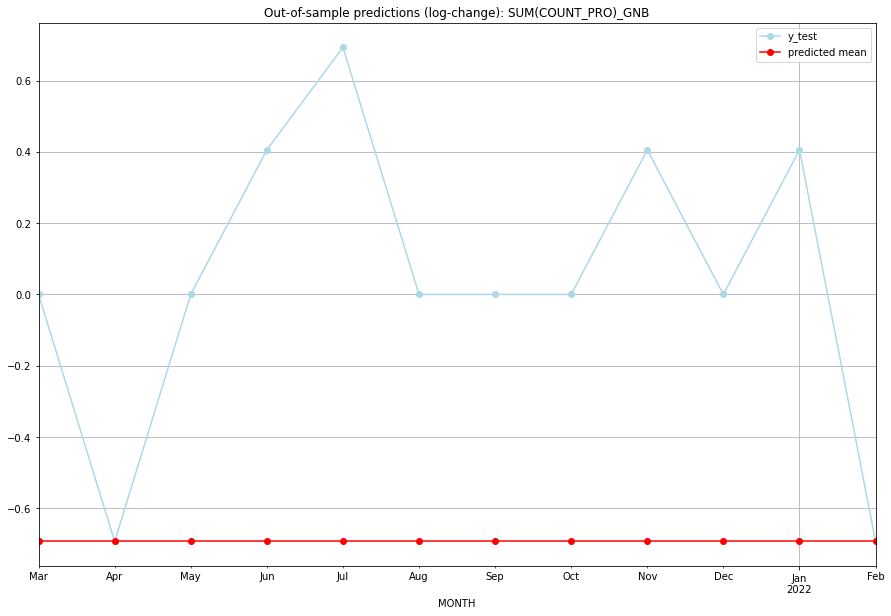

TADDA: 0.9678002527269727
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         1.0     -0.693147        0.000000   GNB   
1  2021-04-01       0.0         0.0     -0.693147       -0.693147   GNB   
2  2021-05-01       0.0         1.0     -0.693147        0.000000   GNB   
3  2021-06-01       0.0         2.0     -0.693147        0.405465   GNB   
4  2021-07-01       0.0         3.0     -0.693147        0.693147   GNB   
5  2021-08-01       0.0         1.0     -0.693147        0.000000   GNB   
6  2021-09-01       0.0         1.0     -0.693147        0.000000   GNB   
7  2021-10-01       0.0         1.0     -0.693147        0.000000   GNB   
8  2021-11-01       0.0         2.0     -0.693147        0.405465   GNB   
9  2021-12-01       0.0         1.0     -0.693147        0.000000   GNB   
10 2022-01-01       0.0         2.0     -0.693147        0.405465   GNB   
11 2022-02-01       0.0         0.0     -0.693147    

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.057762265046662105, 'fold_results': [0.057762265046662105]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_GNQ   No. Observations:                  289
Model:                        SARIMAX   Log Likelihood                 118.483
Date:                Fri, 16 Sep 2022   AIC                           -234.967
Time:                        14:11:29   BIC                           -231.300
Sample:                    02-28-1997   HQIC                          -233.498
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.0258      0.001     40.043      0.00

<Figure size 432x288 with 0 Axes>

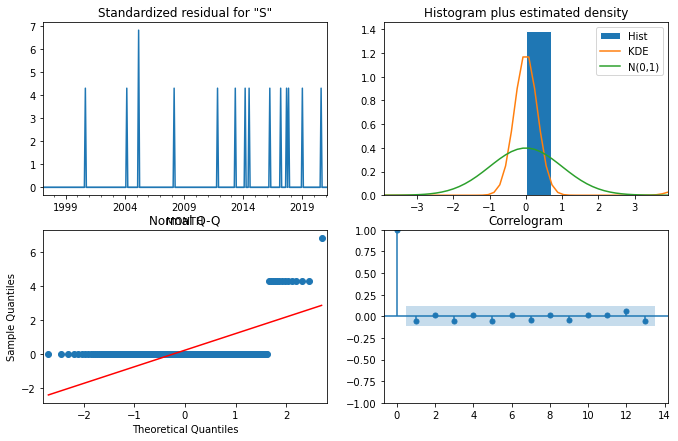

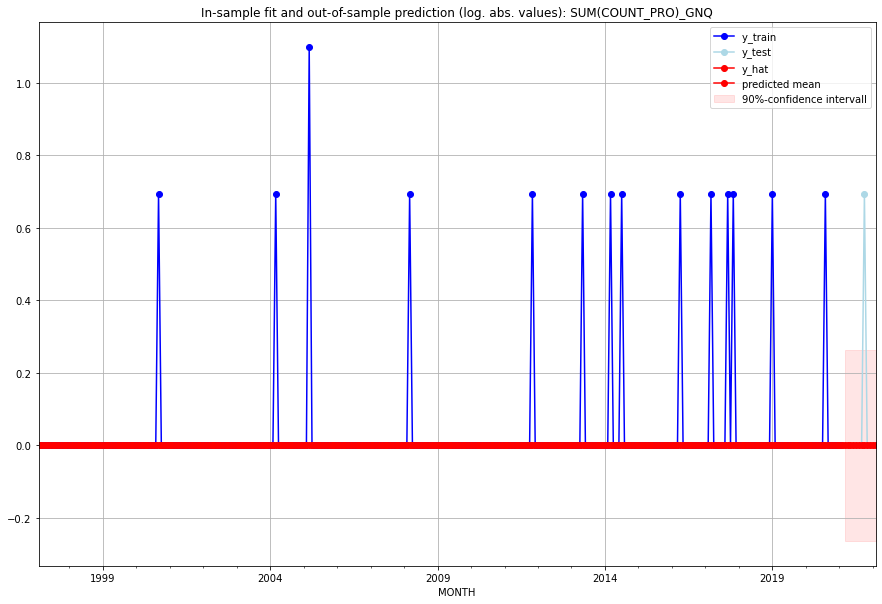

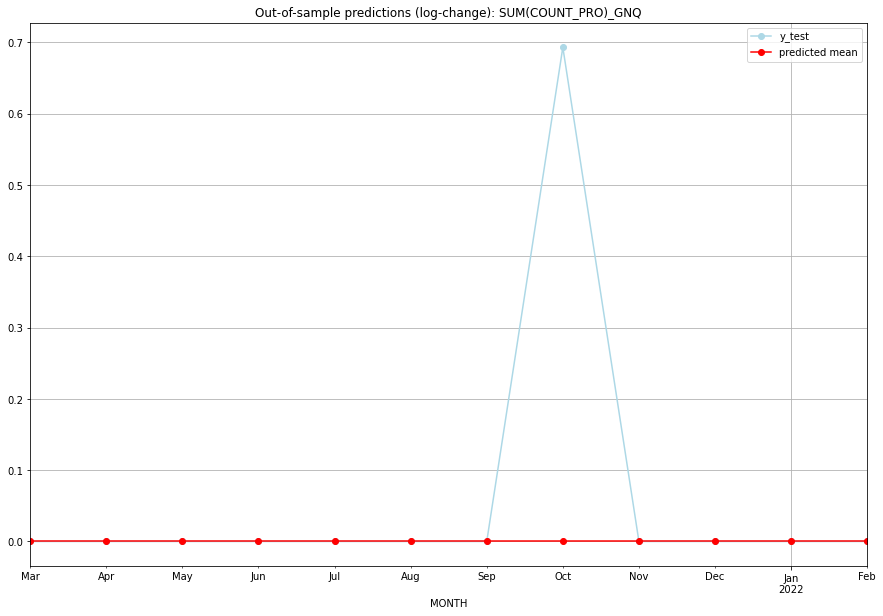

TADDA: 0.057762265046662105
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0        0.000000   GNQ   
1  2021-04-01       0.0         0.0           0.0        0.000000   GNQ   
2  2021-05-01       0.0         0.0           0.0        0.000000   GNQ   
3  2021-06-01       0.0         0.0           0.0        0.000000   GNQ   
4  2021-07-01       0.0         0.0           0.0        0.000000   GNQ   
5  2021-08-01       0.0         0.0           0.0        0.000000   GNQ   
6  2021-09-01       0.0         0.0           0.0        0.000000   GNQ   
7  2021-10-01       0.0         1.0           0.0        0.693147   GNQ   
8  2021-11-01       0.0         0.0           0.0        0.000000   GNQ   
9  2021-12-01       0.0         0.0           0.0        0.000000   GNQ   
10 2022-01-01       0.0         0.0           0.0        0.000000   GNQ   
11 2022-02-01       0.0         0.0           0.0  

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [2, (3, 1, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.3964199473701853, 'fold_results': [0.3964199473701853]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_GRC   No. Observations:                   38
Model:               SARIMAX(3, 1, 3)   Log Likelihood                 -23.391
Date:                Fri, 16 Sep 2022   AIC                             64.783
Time:                        14:11:53   BIC                             79.281
Sample:                    01-31-2018   HQIC                            69.894
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            -0.1837      0.036     -5.056      0.000   

<Figure size 432x288 with 0 Axes>

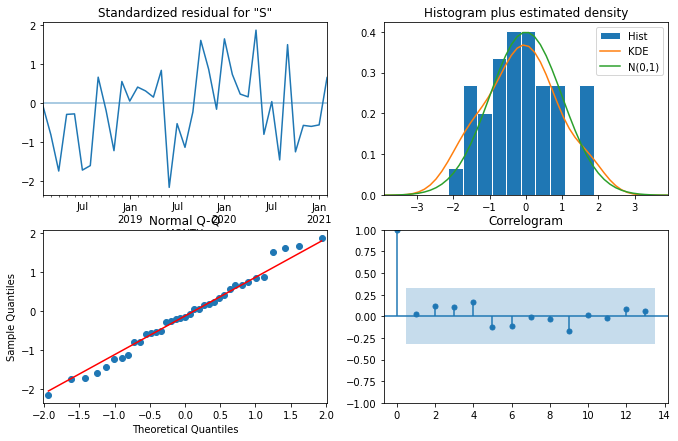

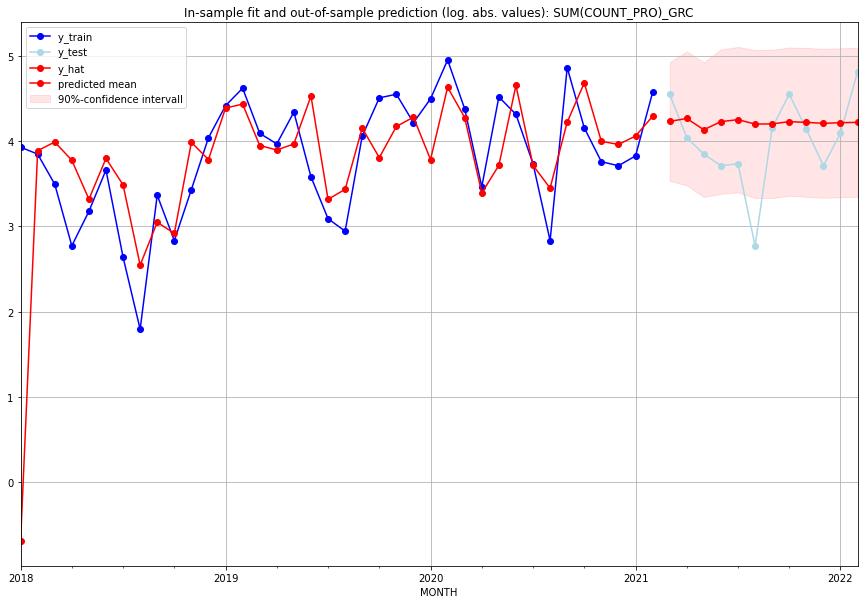

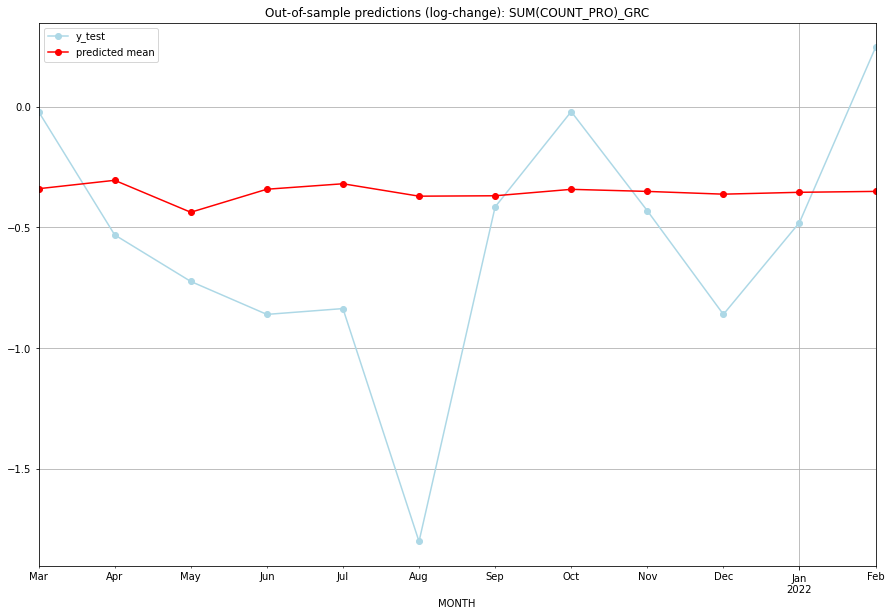

TADDA: 0.44326571069014736
Evaluation finished.
        MONTH   FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  68.018422        94.0     -0.340338       -0.020834   GRC   
1  2021-04-01  70.464545        56.0     -0.305510       -0.531660   GRC   
2  2021-05-01  61.600535        46.0     -0.437937       -0.724563   GRC   
3  2021-06-01  67.868457        40.0     -0.342513       -0.861139   GRC   
4  2021-07-01  69.447275        41.0     -0.319846       -0.837041   GRC   
5  2021-08-01  65.916086        15.0     -0.371272       -1.802122   GRC   
6  2021-09-01  66.027656        63.0     -0.369606       -0.415828   GRC   
7  2021-10-01  67.838077        94.0     -0.342954       -0.020834   GRC   
8  2021-11-01  67.250812        62.0     -0.351522       -0.431576   GRC   
9  2021-12-01  66.475108        40.0     -0.362952       -0.861139   GRC   
10 2022-01-01  66.998860        59.0     -0.355220       -0.480366   GRC   
11 2022-02-01  67.254455       123.0    

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.11552453009332421, 'fold_results': [0.11552453009332421]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_GRD   No. Observations:                   38
Model:                        SARIMAX   Log Likelihood                 -21.734
Date:                Fri, 16 Sep 2022   AIC                             45.469
Time:                        14:12:13   BIC                             47.106
Sample:                    01-31-2018   HQIC                            46.051
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.1838      0.031      5.899      0.000 

<Figure size 432x288 with 0 Axes>

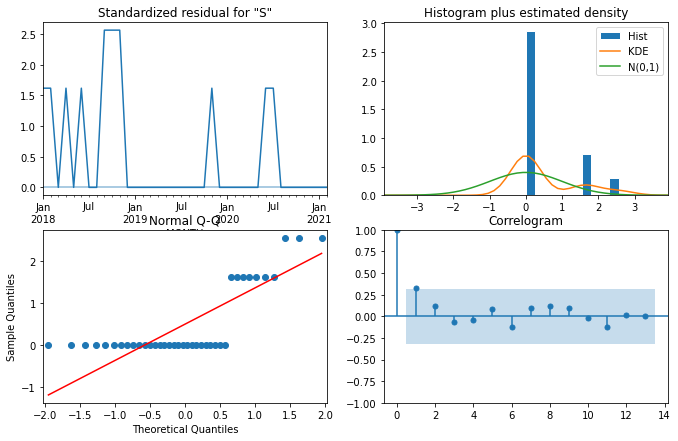

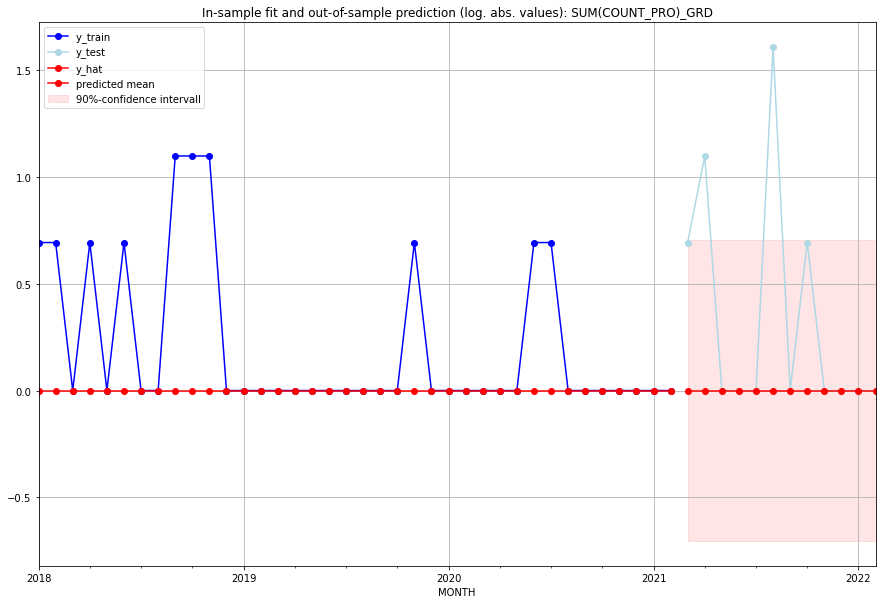

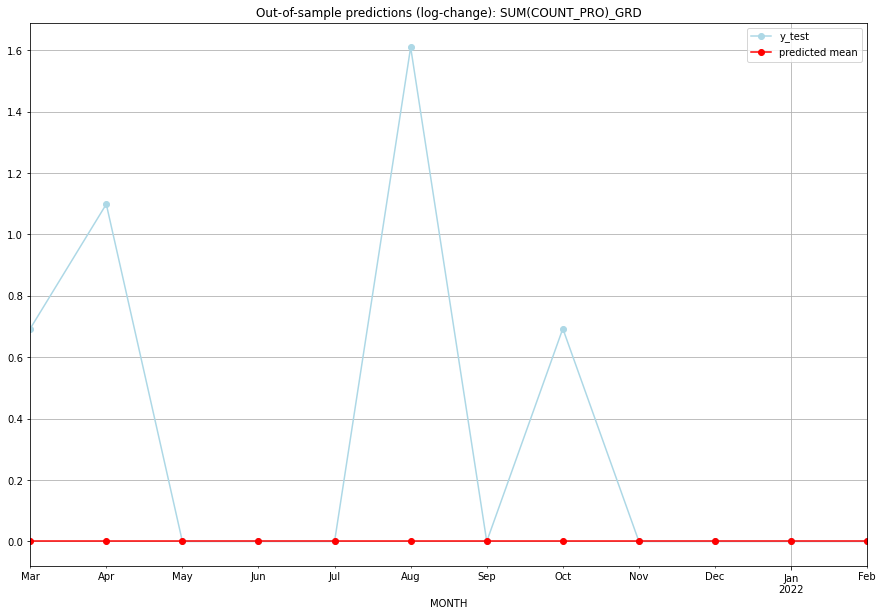

TADDA: 0.34119538018517503
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         1.0           0.0        0.693147   GRD   
1  2021-04-01       0.0         2.0           0.0        1.098612   GRD   
2  2021-05-01       0.0         0.0           0.0        0.000000   GRD   
3  2021-06-01       0.0         0.0           0.0        0.000000   GRD   
4  2021-07-01       0.0         0.0           0.0        0.000000   GRD   
5  2021-08-01       0.0         4.0           0.0        1.609438   GRD   
6  2021-09-01       0.0         0.0           0.0        0.000000   GRD   
7  2021-10-01       0.0         1.0           0.0        0.693147   GRD   
8  2021-11-01       0.0         0.0           0.0        0.000000   GRD   
9  2021-12-01       0.0         0.0           0.0        0.000000   GRD   
10 2022-01-01       0.0         0.0           0.0        0.000000   GRD   
11 2022-02-01       0.0         0.0           0.0   

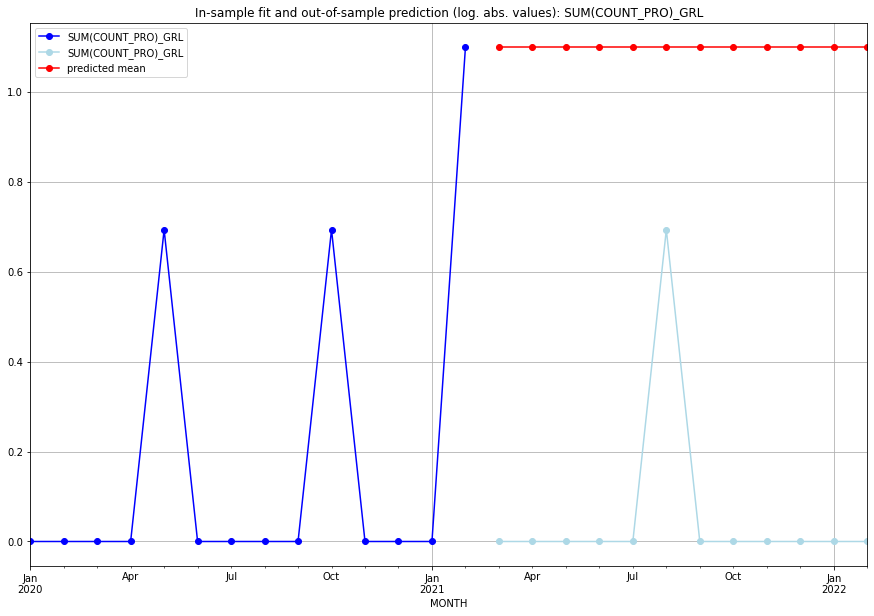

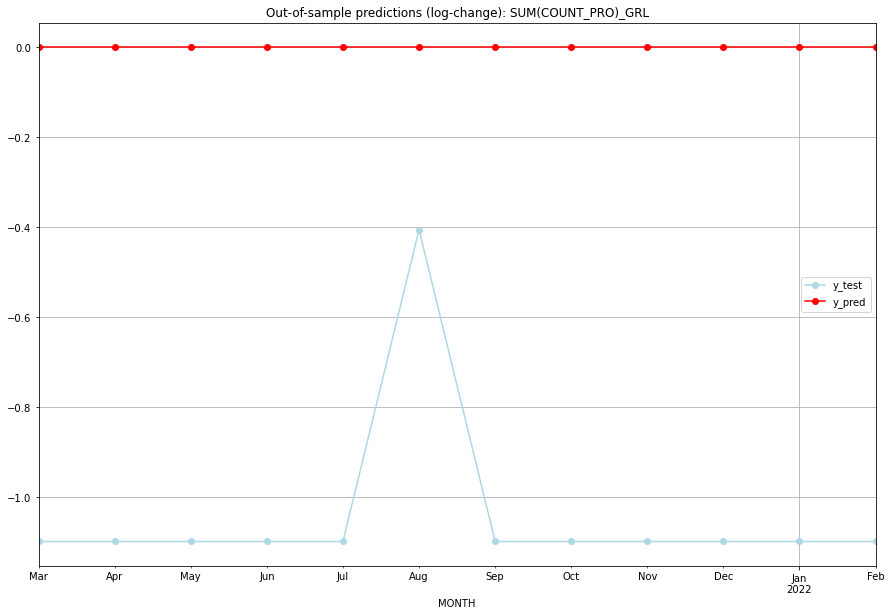

TADDA: 1.0408500236214475
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  1.098612    0.000000           0.0       -1.098612   GRL   
1  2021-04-01  1.098612    0.000000           0.0       -1.098612   GRL   
2  2021-05-01  1.098612    0.000000           0.0       -1.098612   GRL   
3  2021-06-01  1.098612    0.000000           0.0       -1.098612   GRL   
4  2021-07-01  1.098612    0.000000           0.0       -1.098612   GRL   
5  2021-08-01  1.098612    0.693147           0.0       -0.405465   GRL   
6  2021-09-01  1.098612    0.000000           0.0       -1.098612   GRL   
7  2021-10-01  1.098612    0.000000           0.0       -1.098612   GRL   
8  2021-11-01  1.098612    0.000000           0.0       -1.098612   GRL   
9  2021-12-01  1.098612    0.000000           0.0       -1.098612   GRL   
10 2022-01-01  1.098612    0.000000           0.0       -1.098612   GRL   
11 2022-02-01  1.098612    0.000000           0.0    

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [3, (0, 1, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.4603913275868419, 'fold_results': [0.4603913275868419]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_GTM   No. Observations:                   38
Model:               SARIMAX(0, 1, 3)   Log Likelihood                 -27.835
Date:                Fri, 16 Sep 2022   AIC                             69.670
Time:                        14:12:46   BIC                             80.947
Sample:                    01-31-2018   HQIC                            73.646
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            -0.0676      0.038     -1.760      0.078   

<Figure size 432x288 with 0 Axes>

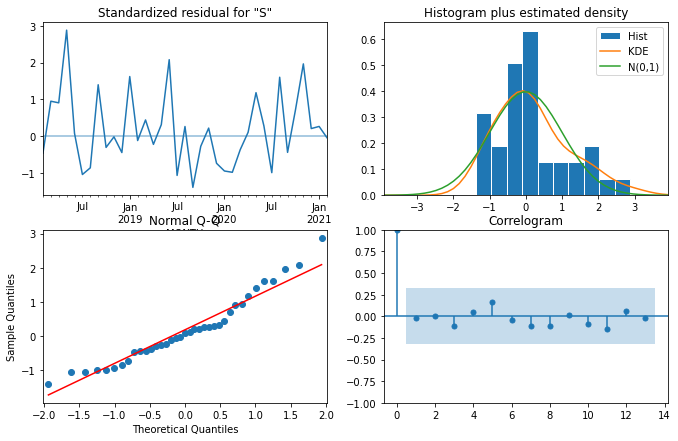

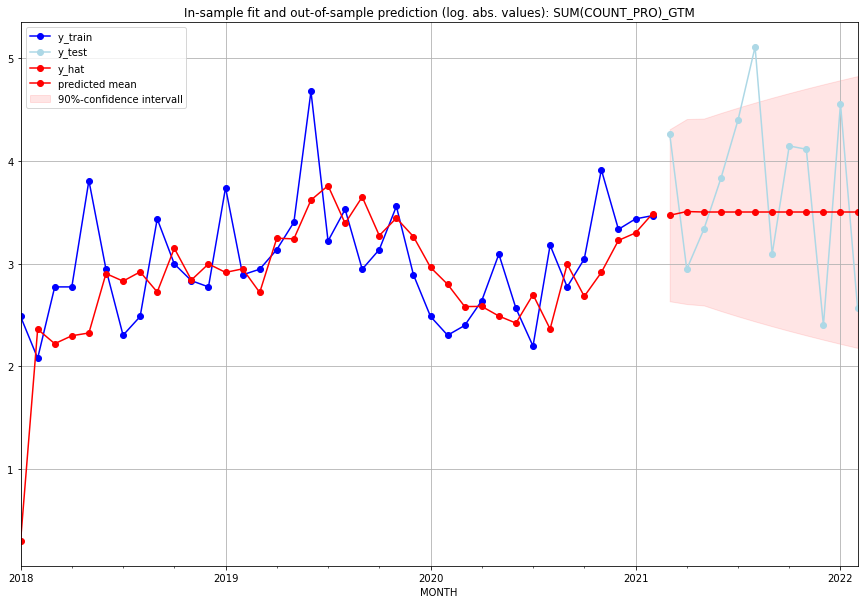

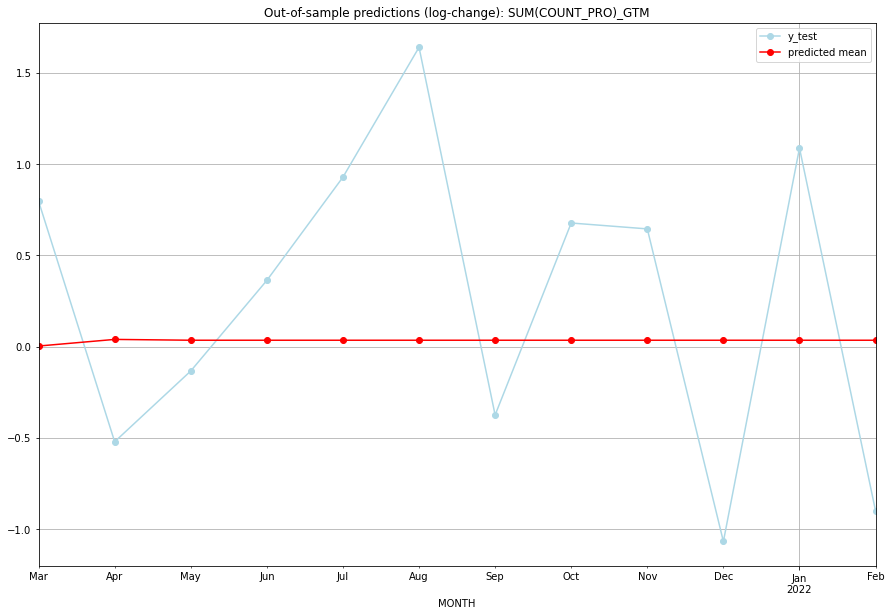

TADDA: 0.773622538005725
Evaluation finished.
        MONTH   FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  31.104042        70.0      0.003246        0.796944   GTM   
1  2021-04-01  32.290659        18.0      0.039541       -0.521297   GTM   
2  2021-05-01  32.140421        27.0      0.035018       -0.133531   GTM   
3  2021-06-01  32.140421        45.0      0.035018        0.362905   GTM   
4  2021-07-01  32.140421        80.0      0.035018        0.928713   GTM   
5  2021-08-01  32.140421       164.0      0.035018        1.640210   GTM   
6  2021-09-01  32.140421        21.0      0.035018       -0.374693   GTM   
7  2021-10-01  32.140421        62.0      0.035018        0.677399   GTM   
8  2021-11-01  32.140421        60.0      0.035018        0.645138   GTM   
9  2021-12-01  32.140421        10.0      0.035018       -1.067841   GTM   
10 2022-01-01  32.140421        94.0      0.035018        1.088141   GTM   
11 2022-02-01  32.140421        12.0      

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [2, (3, 0, 1), (0, 0, 0, 0), 'n'], 'cv_score': 0.5308479602334343, 'fold_results': [0.5308479602334343]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_GUF   No. Observations:                   38
Model:               SARIMAX(3, 0, 1)   Log Likelihood                 -37.861
Date:                Fri, 16 Sep 2022   AIC                             89.722
Time:                        14:13:09   BIC                            101.185
Sample:                    01-31-2018   HQIC                            93.801
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1             0.0318      0.063      0.505      0.614   

<Figure size 432x288 with 0 Axes>

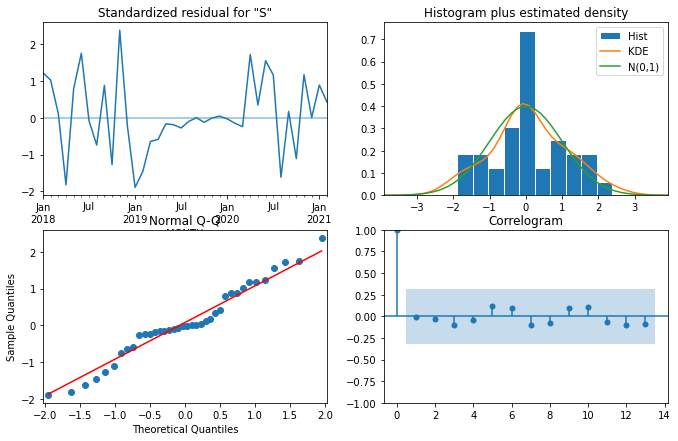

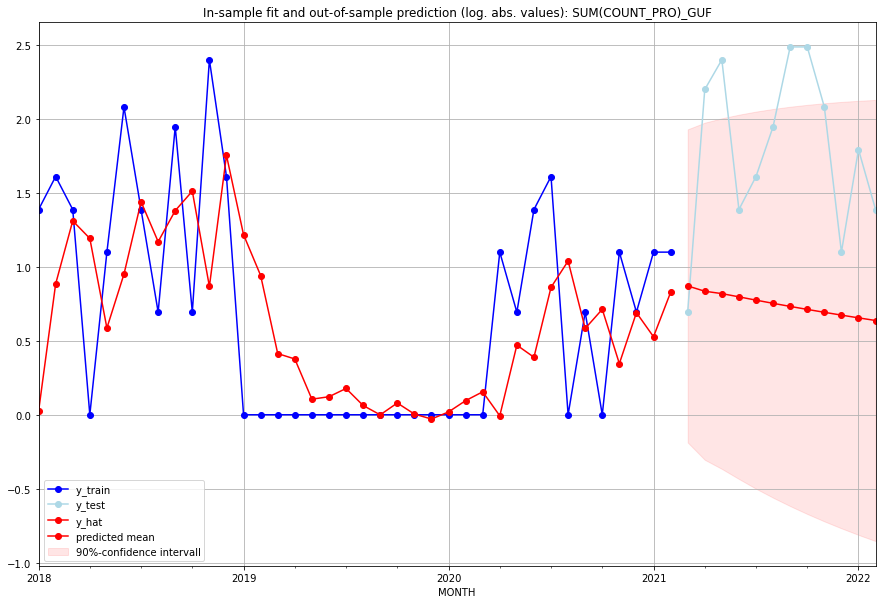

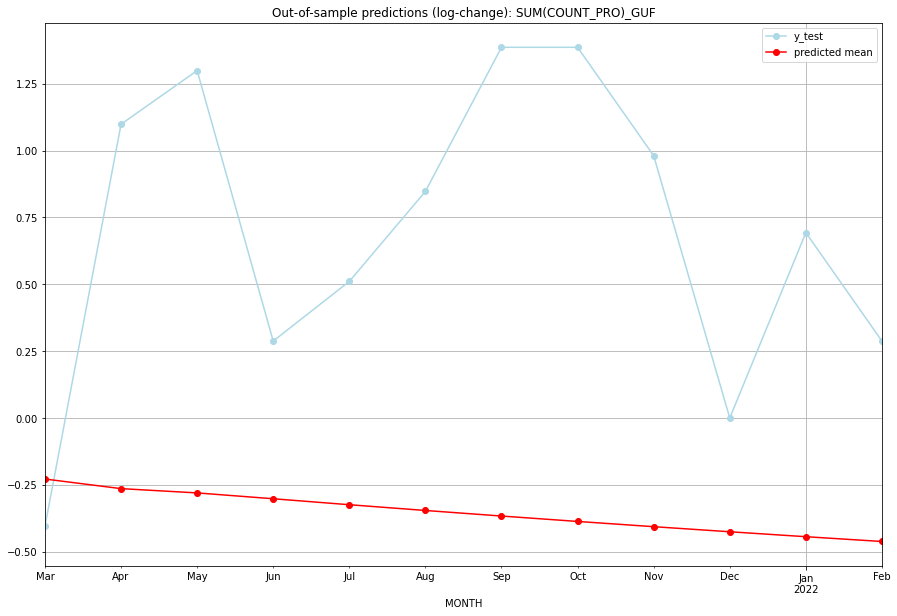

TADDA: 1.3788046460513186
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  1.387721         1.0     -0.228273       -0.405465   GUF   
1  2021-04-01  1.303527         8.0     -0.264171        1.098612   GUF   
2  2021-05-01  1.266860        10.0     -0.280217        1.299283   GUF   
3  2021-06-01  1.217973         3.0     -0.302018        0.287682   GUF   
4  2021-07-01  1.168972         4.0     -0.324359        0.510826   GUF   
5  2021-08-01  1.122821         6.0     -0.345866        0.847298   GUF   
6  2021-09-01  1.079098        11.0     -0.366678        1.386294   GUF   
7  2021-10-01  1.037525        11.0     -0.386877        1.386294   GUF   
8  2021-11-01  0.997971         7.0     -0.406480        0.980829   GUF   
9  2021-12-01  0.960323         2.0     -0.425503        0.000000   GUF   
10 2022-01-01  0.924467         5.0     -0.443963        0.693147   GUF   
11 2022-02-01  0.890299         3.0     -0.461877    

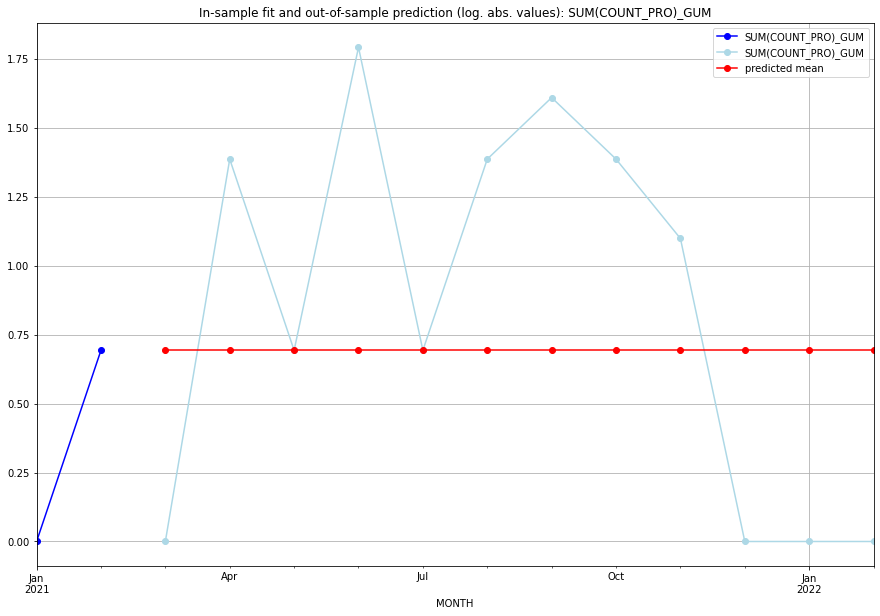

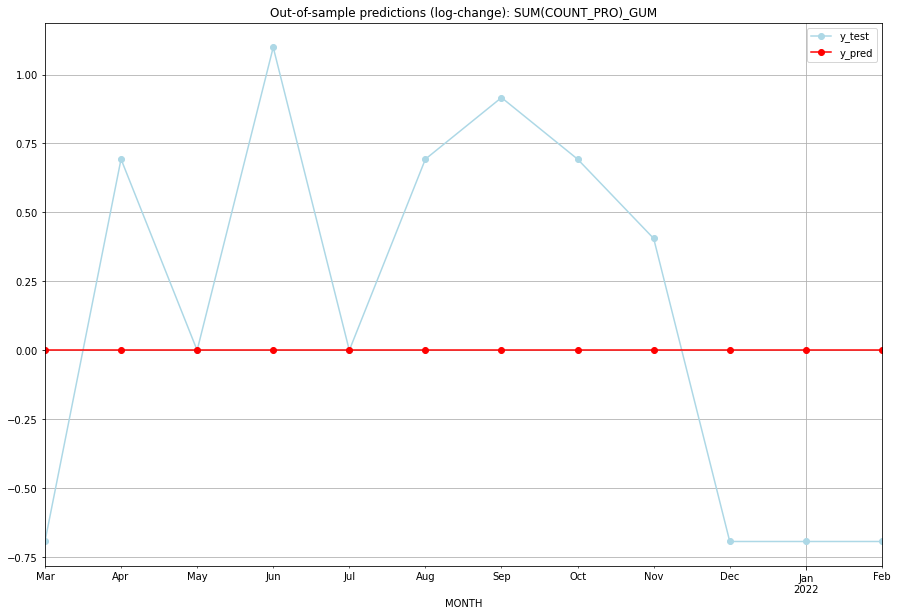

TADDA: 0.6060331993808372
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  0.693147    0.000000           0.0       -0.693147   GUM   
1  2021-04-01  0.693147    1.386294           0.0        0.693147   GUM   
2  2021-05-01  0.693147    0.693147           0.0        0.000000   GUM   
3  2021-06-01  0.693147    1.791759           0.0        1.098612   GUM   
4  2021-07-01  0.693147    0.693147           0.0        0.000000   GUM   
5  2021-08-01  0.693147    1.386294           0.0        0.693147   GUM   
6  2021-09-01  0.693147    1.609438           0.0        0.916291   GUM   
7  2021-10-01  0.693147    1.386294           0.0        0.693147   GUM   
8  2021-11-01  0.693147    1.098612           0.0        0.405465   GUM   
9  2021-12-01  0.693147    0.000000           0.0       -0.693147   GUM   
10 2022-01-01  0.693147    0.000000           0.0       -0.693147   GUM   
11 2022-02-01  0.693147    0.000000           0.0    

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 1, 3), (0, 0, 0, 0), 'n'], 'cv_score': 1.0488362334458403, 'fold_results': [1.0488362334458403]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_GUY   No. Observations:                   38
Model:               SARIMAX(0, 1, 3)   Log Likelihood                 -46.067
Date:                Fri, 16 Sep 2022   AIC                            100.135
Time:                        14:13:42   BIC                            106.578
Sample:                    01-31-2018   HQIC                           102.406
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ma.L1         -0.6753      0.172     -3.927      0.000   

<Figure size 432x288 with 0 Axes>

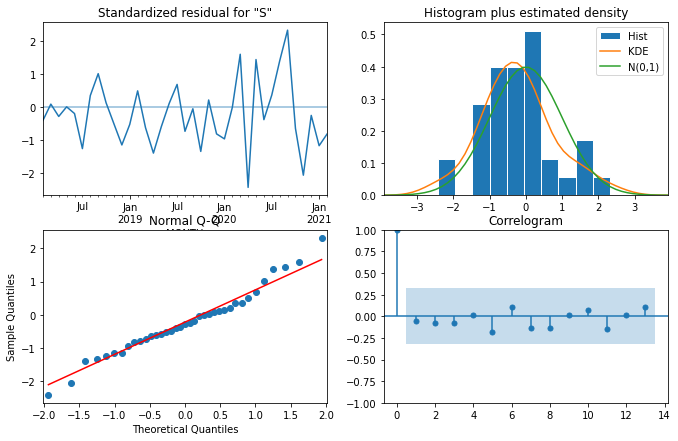

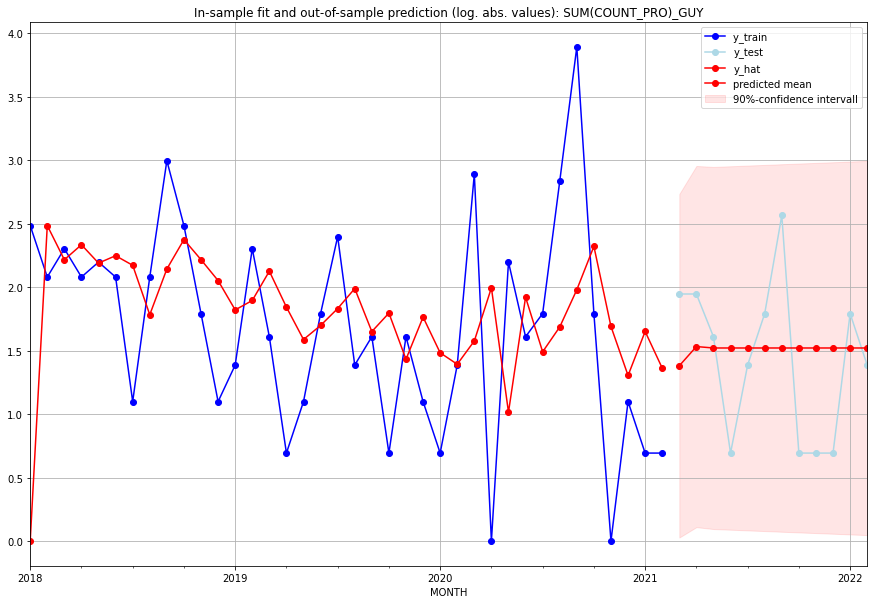

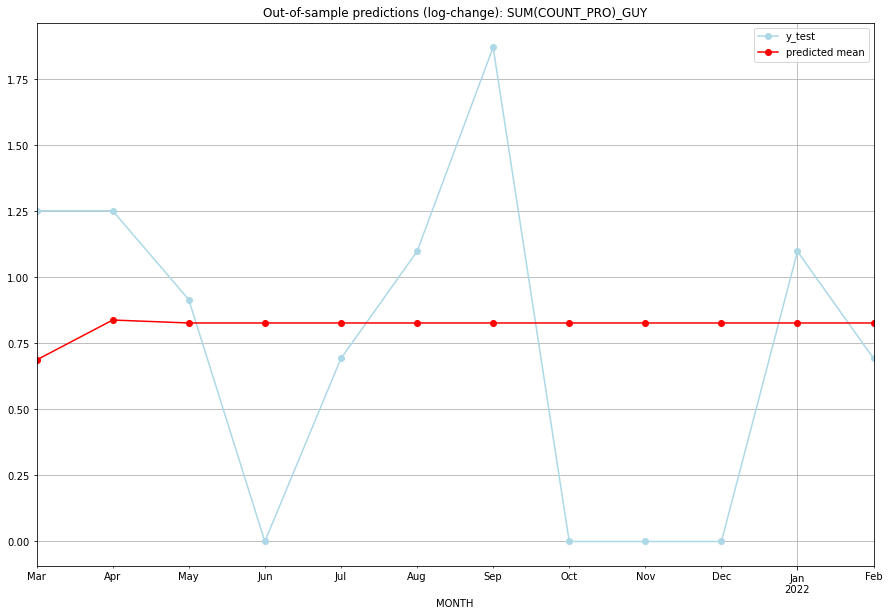

TADDA: 0.5194532391179582
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  2.977682         6.0      0.687552        1.252763   GUY   
1  2021-04-01  3.627250         6.0      0.838816        1.252763   GUY   
2  2021-05-01  3.575774         4.0      0.827629        0.916291   GUY   
3  2021-06-01  3.575774         1.0      0.827629        0.000000   GUY   
4  2021-07-01  3.575774         3.0      0.827629        0.693147   GUY   
5  2021-08-01  3.575774         5.0      0.827629        1.098612   GUY   
6  2021-09-01  3.575774        12.0      0.827629        1.871802   GUY   
7  2021-10-01  3.575774         1.0      0.827629        0.000000   GUY   
8  2021-11-01  3.575774         1.0      0.827629        0.000000   GUY   
9  2021-12-01  3.575774         1.0      0.827629        0.000000   GUY   
10 2022-01-01  3.575774         5.0      0.827629        1.098612   GUY   
11 2022-02-01  3.575774         3.0      0.827629    

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [2, (1, 0, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.2729709659452925, 'fold_results': [0.2729709659452925]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_HKG   No. Observations:                   38
Model:               SARIMAX(1, 0, 3)   Log Likelihood                 -16.310
Date:                Fri, 16 Sep 2022   AIC                             46.620
Time:                        14:14:04   BIC                             58.083
Sample:                    01-31-2018   HQIC                            50.698
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            -0.1386      0.053     -2.600      0.009   

<Figure size 432x288 with 0 Axes>

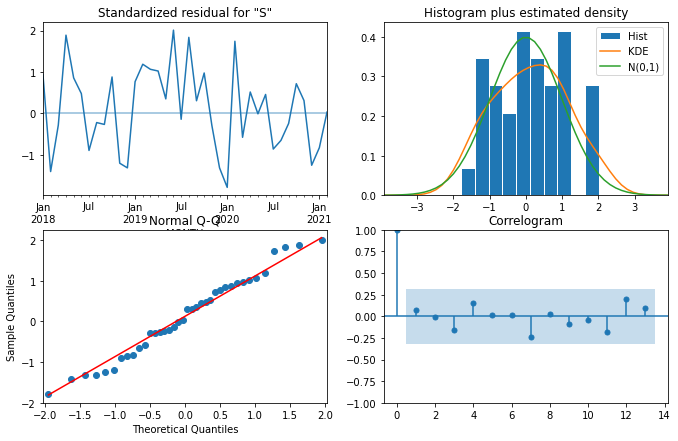

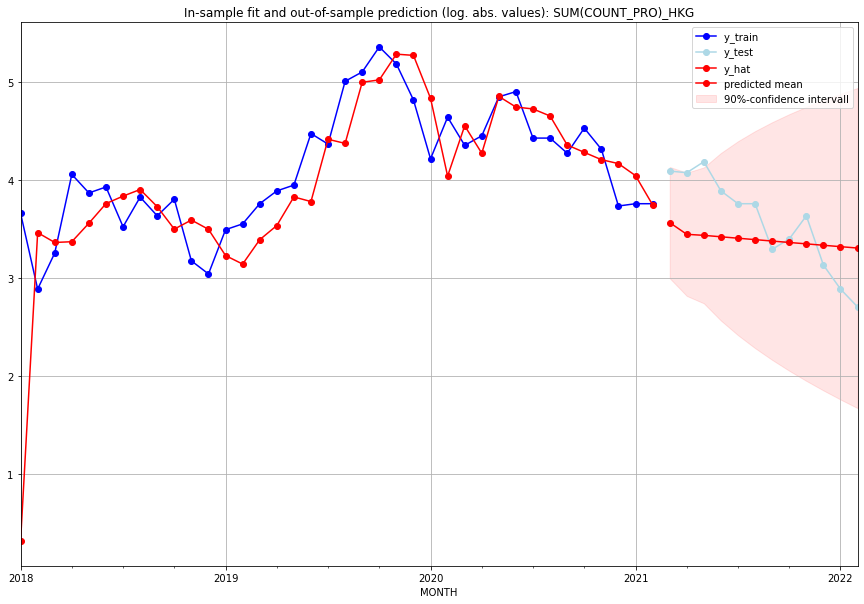

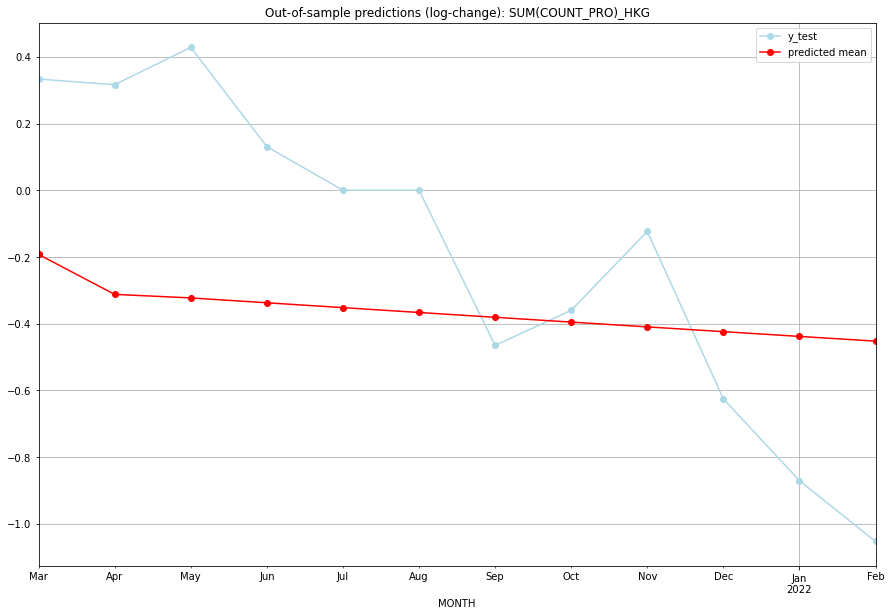

TADDA: 0.49153164423241913
Evaluation finished.
        MONTH   FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  34.468357        59.0     -0.192559        0.333144   HKG   
1  2021-04-01  30.465858        58.0     -0.312297        0.316337   HKG   
2  2021-05-01  30.134784        65.0     -0.322874        0.428455   HKG   
3  2021-06-01  29.683096        48.0     -0.337488        0.130620   HKG   
4  2021-07-01  29.239595        42.0     -0.352048        0.000000   HKG   
5  2021-08-01  28.804108        42.0     -0.366554        0.000000   HKG   
6  2021-09-01  28.376468        26.0     -0.381006       -0.465363   HKG   
7  2021-10-01  27.956510        29.0     -0.395405       -0.360003   HKG   
8  2021-11-01  27.544076        37.0     -0.409751       -0.123614   HKG   
9  2021-12-01  27.139007        22.0     -0.424043       -0.625706   HKG   
10 2022-01-01  26.741153        17.0     -0.438283       -0.870828   HKG   
11 2022-02-01  26.350363        14.0    

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [1, (1, 0, 2), (0, 0, 0, 0), 'n'], 'cv_score': 0.3491321823438864, 'fold_results': [0.3491321823438864]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_HND   No. Observations:                   38
Model:               SARIMAX(1, 0, 2)   Log Likelihood                 -31.478
Date:                Fri, 16 Sep 2022   AIC                             72.956
Time:                        14:14:29   BIC                             81.144
Sample:                    01-31-2018   HQIC                            75.870
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1             0.0669      0.055      1.221      0.222   

<Figure size 432x288 with 0 Axes>

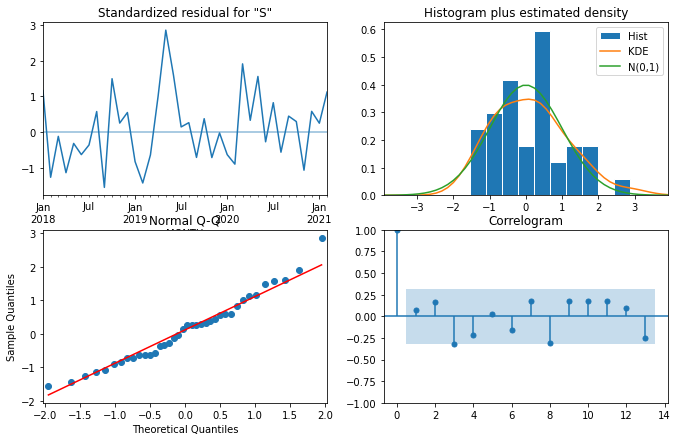

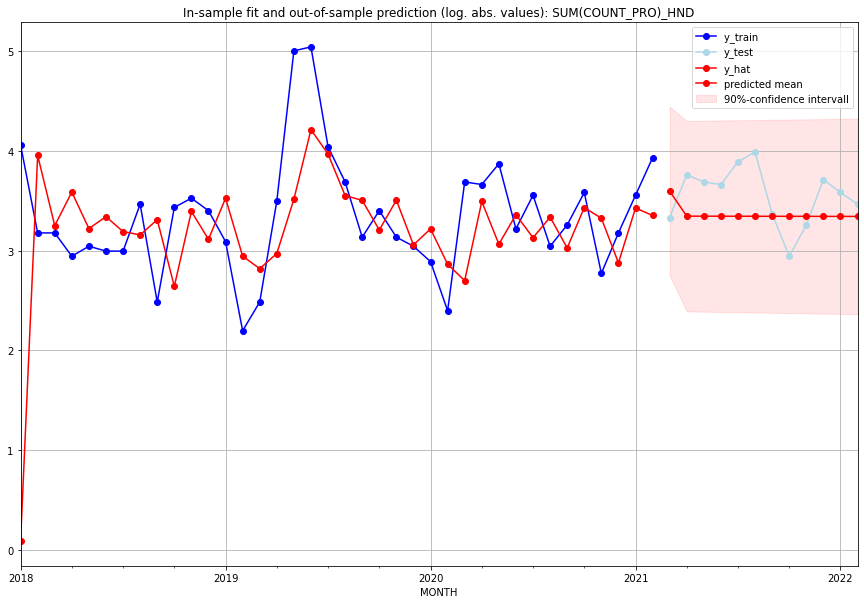

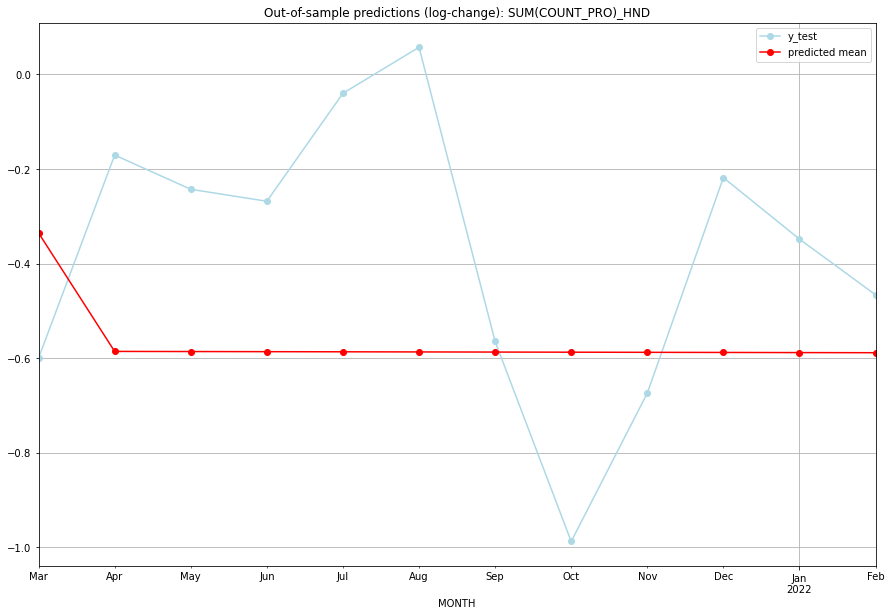

TADDA: 0.3631287970976471
Evaluation finished.
        MONTH   FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  35.470713        27.0     -0.335316       -0.599621   HND   
1  2021-04-01  27.395184        42.0     -0.585606       -0.170626   HND   
2  2021-05-01  27.387320        39.0     -0.585883       -0.242946   HND   
3  2021-06-01  27.379459        38.0     -0.586160       -0.268264   HND   
4  2021-07-01  27.371600        48.0     -0.586437       -0.040005   HND   
5  2021-08-01  27.363744        53.0     -0.586714        0.057158   HND   
6  2021-09-01  27.355891        28.0     -0.586991       -0.564530   HND   
7  2021-10-01  27.348041        18.0     -0.587268       -0.987387   HND   
8  2021-11-01  27.340194        25.0     -0.587545       -0.673729   HND   
9  2021-12-01  27.332349        40.0     -0.587821       -0.218254   HND   
10 2022-01-01  27.324507        35.0     -0.588098       -0.348307   HND   
11 2022-02-01  27.316668        31.0     

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (3, 1, 2), (0, 0, 0, 0), 'n'], 'cv_score': 0.4811347584308449, 'fold_results': [0.4811347584308449]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_HRV   No. Observations:                   38
Model:               SARIMAX(3, 1, 2)   Log Likelihood                 -28.258
Date:                Fri, 16 Sep 2022   AIC                             68.516
Time:                        14:14:58   BIC                             78.181
Sample:                    01-31-2018   HQIC                            71.923
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.7058      0.857     -0.824      0.410   

<Figure size 432x288 with 0 Axes>

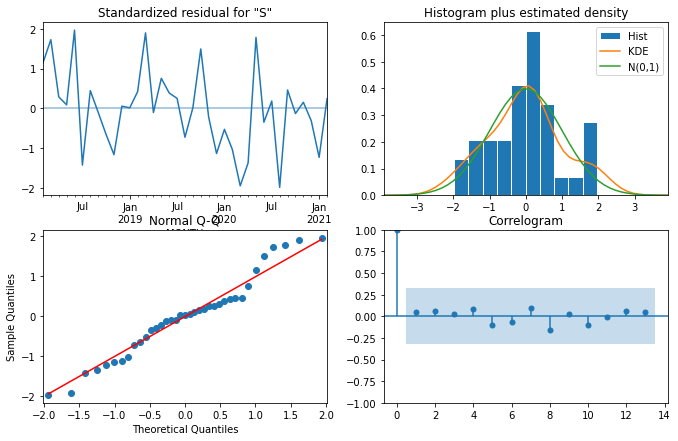

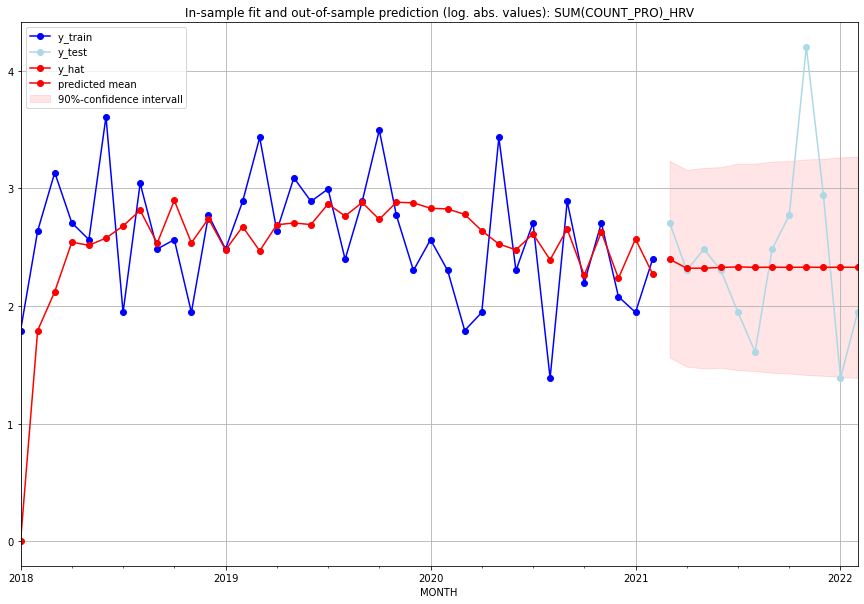

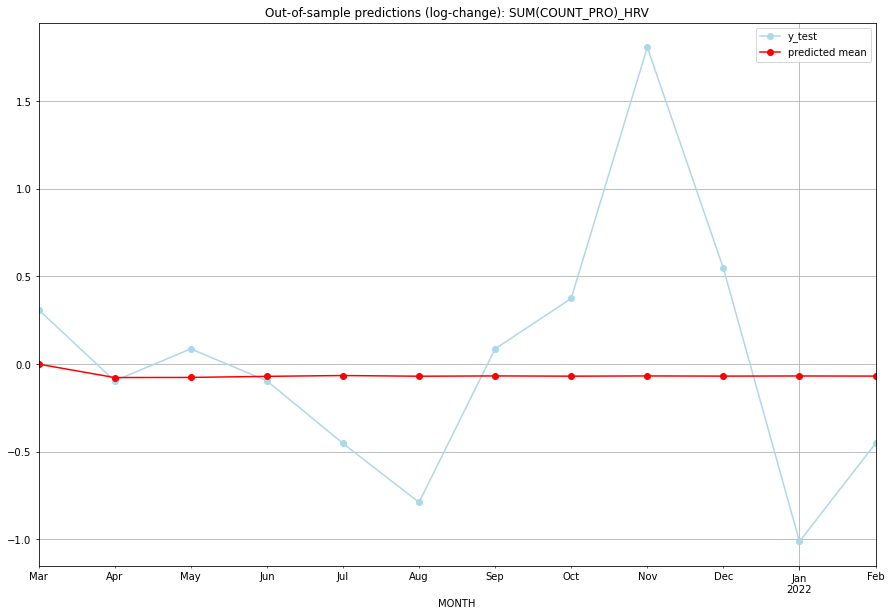

TADDA: 0.5321862277550622
Evaluation finished.
        MONTH   FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  10.000177        14.0      0.000016        0.310155   HRV   
1  2021-04-01   9.188730         9.0     -0.076613       -0.095310   HRV   
2  2021-05-01   9.195941        11.0     -0.075906        0.087011   HRV   
3  2021-06-01   9.258857         9.0     -0.069754       -0.095310   HRV   
4  2021-07-01   9.306631         6.0     -0.065108       -0.451985   HRV   
5  2021-08-01   9.266546         4.0     -0.069005       -0.788457   HRV   
6  2021-09-01   9.283196        11.0     -0.067384        0.087011   HRV   
7  2021-10-01   9.269282        15.0     -0.068738        0.374693   HRV   
8  2021-11-01   9.282385        66.0     -0.067463        1.806797   HRV   
9  2021-12-01   9.272377        18.0     -0.068437        0.546544   HRV   
10 2022-01-01   9.279946         3.0     -0.067700       -1.011601   HRV   
11 2022-02-01   9.273924         6.0     

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (1, 1, 1), (0, 0, 0, 0), 'n'], 'cv_score': 0.43519839174200436, 'fold_results': [0.43519839174200436]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_HTI   No. Observations:                   38
Model:               SARIMAX(1, 1, 1)   Log Likelihood                 -43.671
Date:                Fri, 16 Sep 2022   AIC                             93.343
Time:                        14:15:27   BIC                             98.176
Sample:                    01-31-2018   HQIC                            95.047
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.1367      0.192      0.714      0.475 

<Figure size 432x288 with 0 Axes>

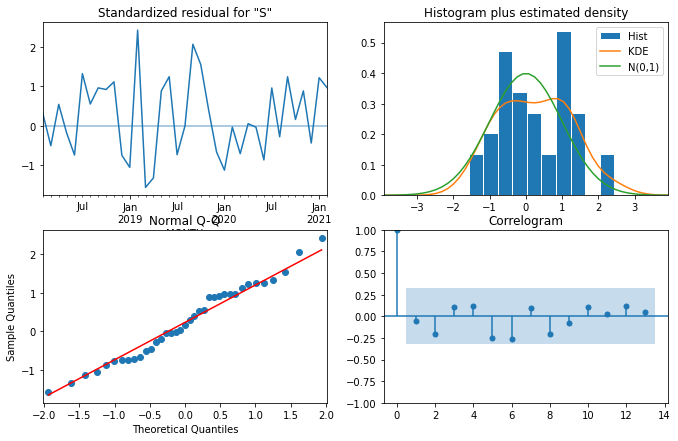

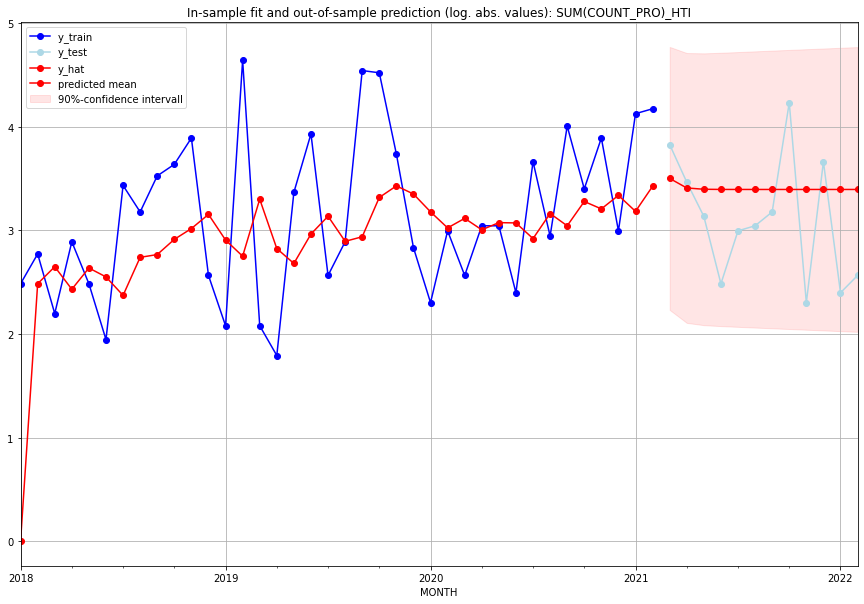

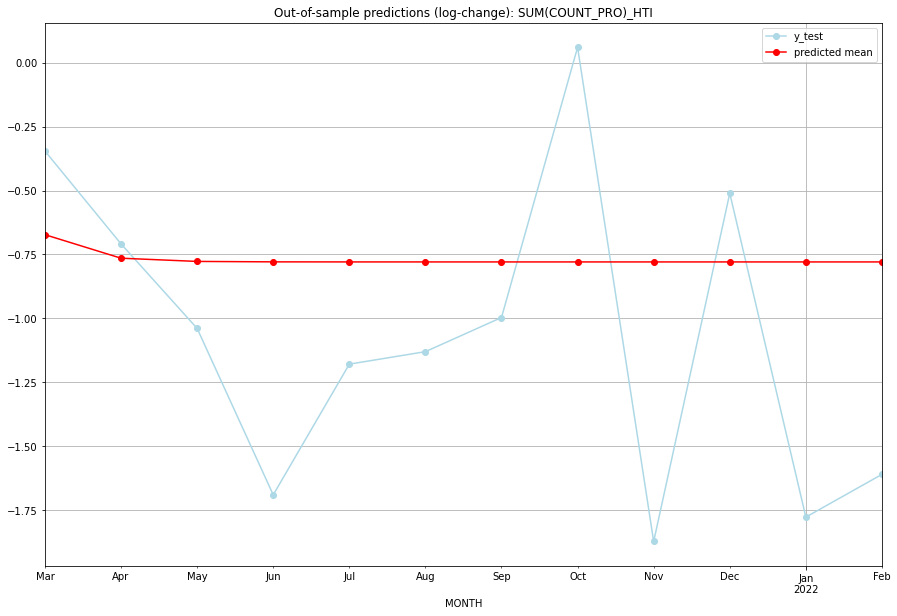

TADDA: 0.6107736512020748
Evaluation finished.
        MONTH   FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  32.174350        45.0     -0.672610       -0.345746   HTI   
1  2021-04-01  29.259778        31.0     -0.764568       -0.708651   HTI   
2  2021-05-01  28.881727        22.0     -0.777140       -1.038893   HTI   
3  2021-06-01  28.830409        11.0     -0.778859       -1.689481   HTI   
4  2021-07-01  28.823400        19.0     -0.779094       -1.178655   HTI   
5  2021-08-01  28.822442        20.0     -0.779126       -1.129865   HTI   
6  2021-09-01  28.822311        23.0     -0.779130       -0.996333   HTI   
7  2021-10-01  28.822293        68.0     -0.779131        0.059719   HTI   
8  2021-11-01  28.822290         9.0     -0.779131       -1.871802   HTI   
9  2021-12-01  28.822290        38.0     -0.779131       -0.510826   HTI   
10 2022-01-01  28.822290        10.0     -0.779131       -1.776492   HTI   
11 2022-02-01  28.822290        12.0     

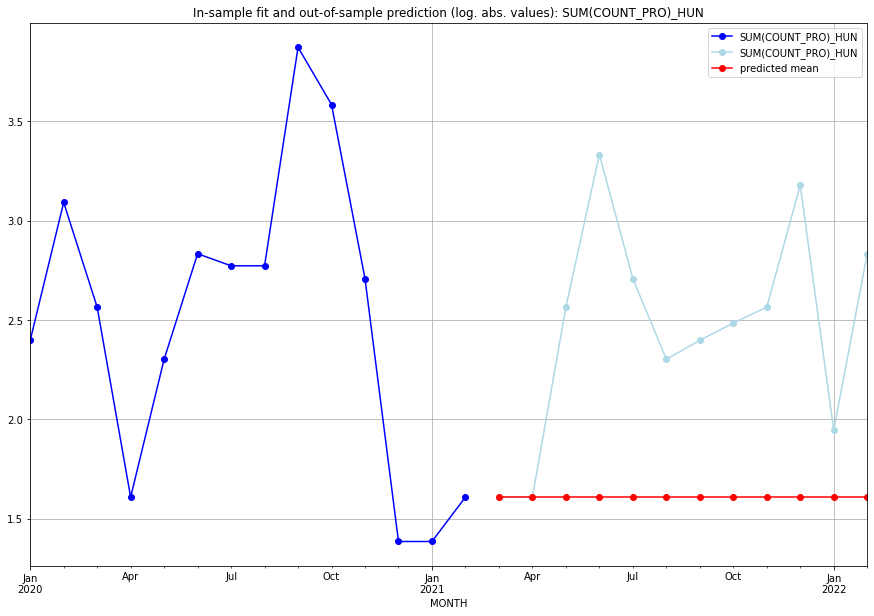

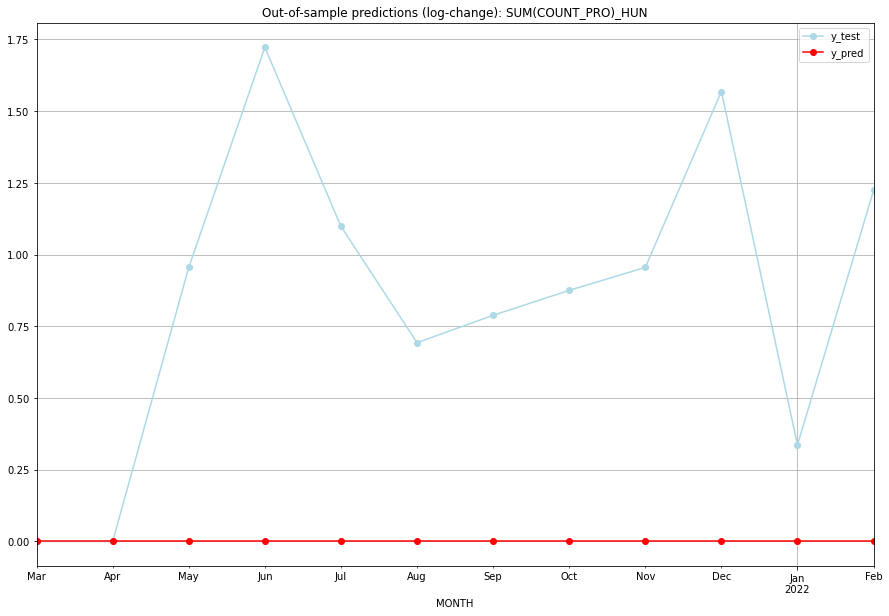

TADDA: 0.8515282200749478
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  1.609438    1.609438           0.0        0.000000   HUN   
1  2021-04-01  1.609438    1.609438           0.0        0.000000   HUN   
2  2021-05-01  1.609438    2.564949           0.0        0.955511   HUN   
3  2021-06-01  1.609438    3.332205           0.0        1.722767   HUN   
4  2021-07-01  1.609438    2.708050           0.0        1.098612   HUN   
5  2021-08-01  1.609438    2.302585           0.0        0.693147   HUN   
6  2021-09-01  1.609438    2.397895           0.0        0.788457   HUN   
7  2021-10-01  1.609438    2.484907           0.0        0.875469   HUN   
8  2021-11-01  1.609438    2.564949           0.0        0.955511   HUN   
9  2021-12-01  1.609438    3.178054           0.0        1.568616   HUN   
10 2022-01-01  1.609438    1.945910           0.0        0.336472   HUN   
11 2022-02-01  1.609438    2.833213           0.0    

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (3, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.4826161442095181, 'fold_results': [0.4826161442095181]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_IDN   No. Observations:                   74
Model:               SARIMAX(3, 1, 0)   Log Likelihood                 -65.762
Date:                Fri, 16 Sep 2022   AIC                            139.523
Time:                        14:16:03   BIC                            148.685
Sample:                    01-31-2015   HQIC                           143.174
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.4702      0.127     -3.703      0.000   

<Figure size 432x288 with 0 Axes>

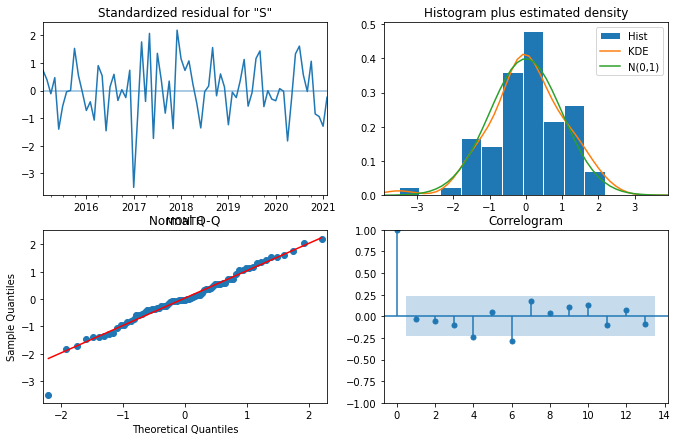

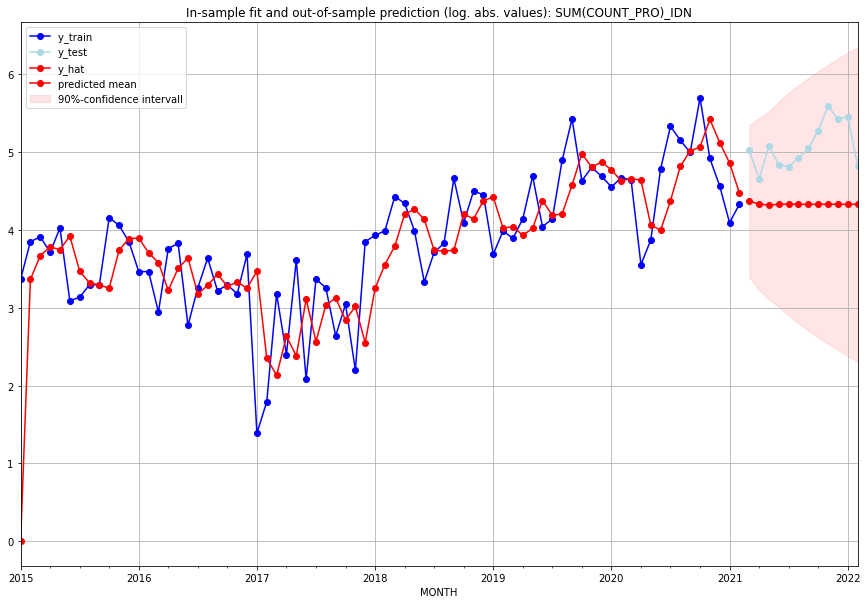

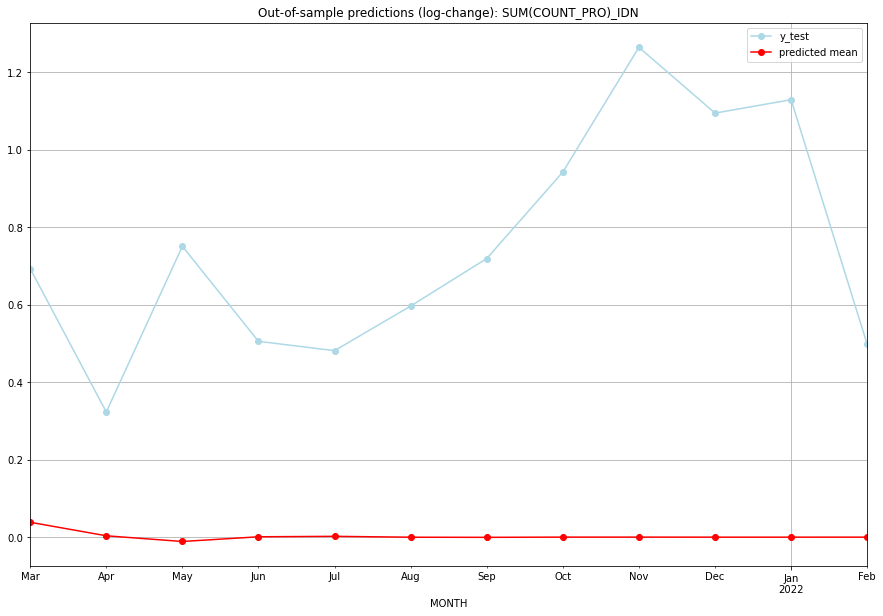

TADDA: 0.7474826234413806
Evaluation finished.
        MONTH   FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  78.003613       151.0      0.038760        0.693147   IDN   
1  2021-04-01  75.295199       104.0      0.003877        0.323227   IDN   
2  2021-05-01  74.181439       160.0     -0.010829        0.750671   IDN   
3  2021-06-01  75.099943       125.0      0.001314        0.505549   IDN   
4  2021-07-01  75.186085       122.0      0.002445        0.481451   IDN   
5  2021-08-01  75.015459       137.0      0.000203        0.596520   IDN   
6  2021-09-01  74.990500       155.0     -0.000125        0.719123   IDN   
7  2021-10-01  75.037140       194.0      0.000489        0.942266   IDN   
8  2021-11-01  75.036890       268.0      0.000485        1.263978   IDN   
9  2021-12-01  75.027584       226.0      0.000363        1.094217   IDN   
10 2022-01-01  75.027799       234.0      0.000366        1.128852   IDN   
11 2022-02-01  75.030051       124.0     

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.35638884325133796, 'fold_results': [0.35638884325133796]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_IMN   No. Observations:                  289
Model:                        SARIMAX   Log Likelihood                 213.732
Date:                Fri, 16 Sep 2022   AIC                           -425.463
Time:                        14:16:25   BIC                           -421.797
Sample:                    02-28-1997   HQIC                          -423.994
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.0133      0.000     70.665      0.000 

<Figure size 432x288 with 0 Axes>

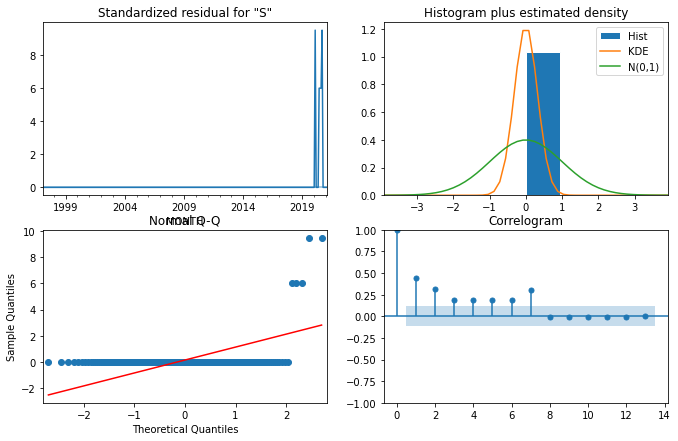

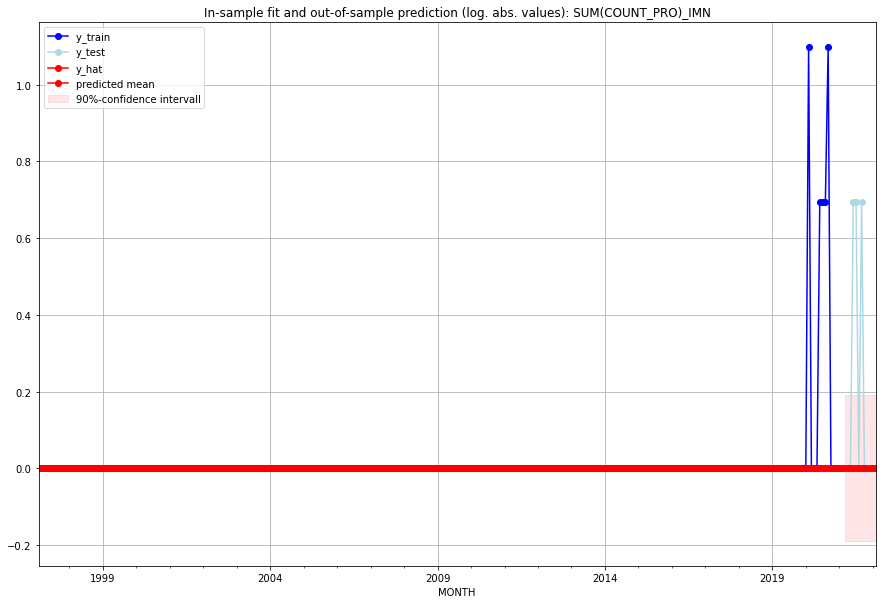

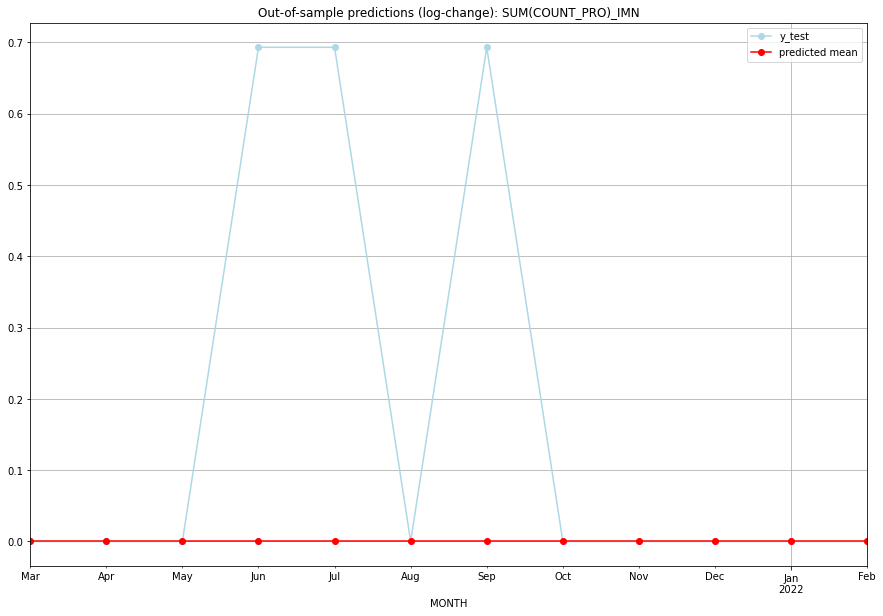

TADDA: 0.17328679513998632
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0        0.000000   IMN   
1  2021-04-01       0.0         0.0           0.0        0.000000   IMN   
2  2021-05-01       0.0         0.0           0.0        0.000000   IMN   
3  2021-06-01       0.0         1.0           0.0        0.693147   IMN   
4  2021-07-01       0.0         1.0           0.0        0.693147   IMN   
5  2021-08-01       0.0         0.0           0.0        0.000000   IMN   
6  2021-09-01       0.0         1.0           0.0        0.693147   IMN   
7  2021-10-01       0.0         0.0           0.0        0.000000   IMN   
8  2021-11-01       0.0         0.0           0.0        0.000000   IMN   
9  2021-12-01       0.0         0.0           0.0        0.000000   IMN   
10 2022-01-01       0.0         0.0           0.0        0.000000   IMN   
11 2022-02-01       0.0         0.0           0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [3, (3, 1, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.3725244184563934, 'fold_results': [0.3725244184563934]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_IND   No. Observations:                   62
Model:               SARIMAX(3, 1, 3)   Log Likelihood                   7.562
Date:                Fri, 16 Sep 2022   AIC                              4.877
Time:                        14:17:04   BIC                             25.985
Sample:                    01-31-2016   HQIC                            13.149
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1             0.0224      0.026      0.872      0.383   

<Figure size 432x288 with 0 Axes>

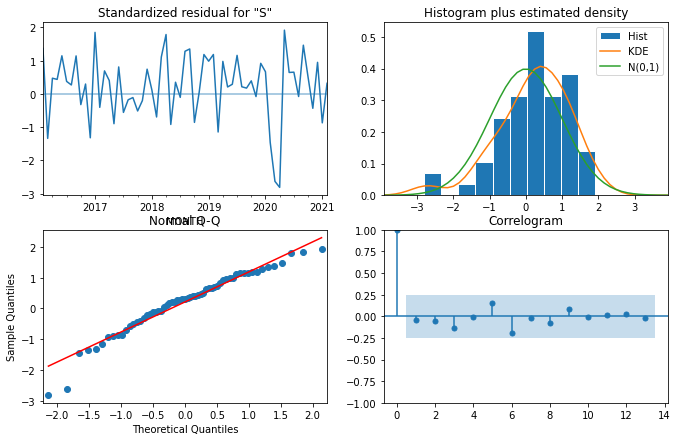

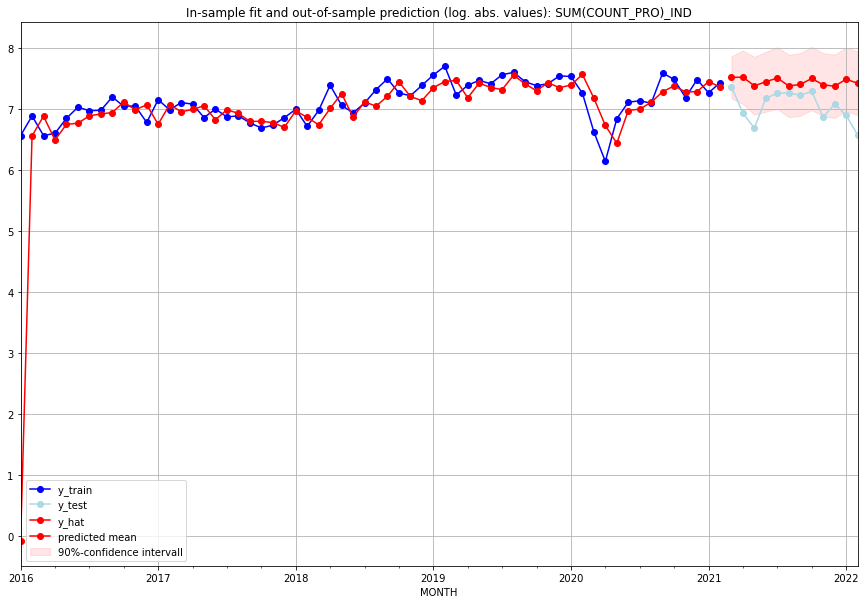

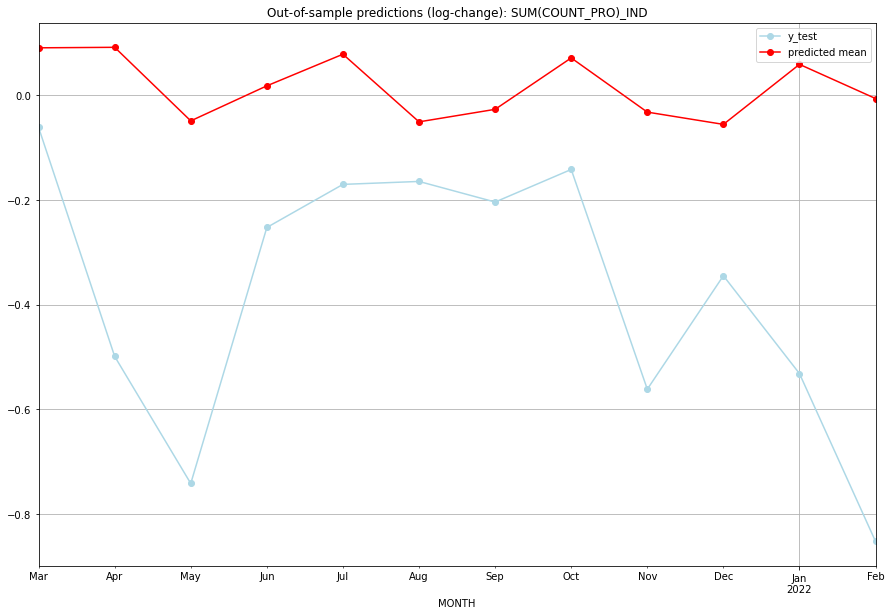

TADDA: 0.42676639270313826
Evaluation finished.
        MONTH     FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  1839.503354      1580.0      0.090650       -0.061331   IND   
1  2021-04-01  1841.294422      1020.0      0.091623       -0.498606   IND   
2  2021-05-01  1599.851005       800.0     -0.048853       -0.741283   IND   
3  2021-06-01  1710.596318      1305.0      0.018038       -0.252420   IND   
4  2021-07-01  1817.170472      1417.0      0.078442       -0.170141   IND   
5  2021-08-01  1596.867473      1425.0     -0.050719       -0.164516   IND   
6  2021-09-01  1635.514824      1370.0     -0.026820       -0.203848   IND   
7  2021-10-01  1804.312437      1458.0      0.071345       -0.141638   IND   
8  2021-11-01  1626.842575       958.0     -0.032133       -0.561253   IND   
9  2021-12-01  1589.156362      1190.0     -0.055557       -0.344596   IND   
10 2022-01-01  1782.267418       987.0      0.059058       -0.531461   IND   
11 2022-02-01  1

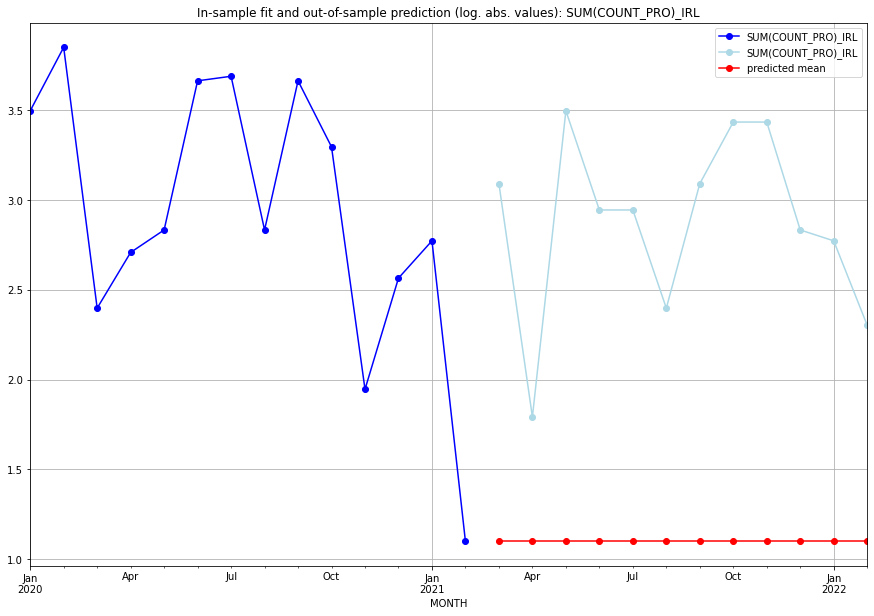

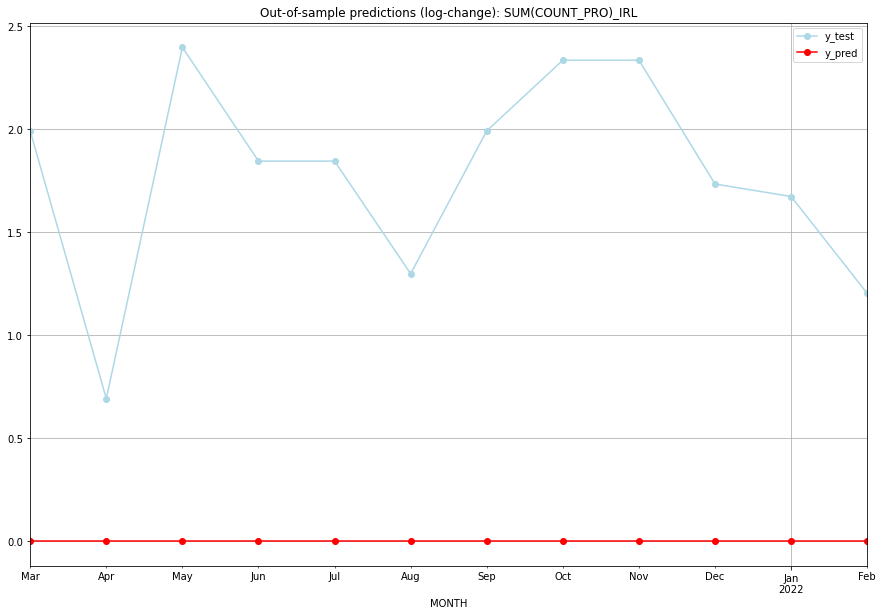

TADDA: 1.7791782727321197
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  1.098612    3.091042           0.0        1.992430   IRL   
1  2021-04-01  1.098612    1.791759           0.0        0.693147   IRL   
2  2021-05-01  1.098612    3.496508           0.0        2.397895   IRL   
3  2021-06-01  1.098612    2.944439           0.0        1.845827   IRL   
4  2021-07-01  1.098612    2.944439           0.0        1.845827   IRL   
5  2021-08-01  1.098612    2.397895           0.0        1.299283   IRL   
6  2021-09-01  1.098612    3.091042           0.0        1.992430   IRL   
7  2021-10-01  1.098612    3.433987           0.0        2.335375   IRL   
8  2021-11-01  1.098612    3.433987           0.0        2.335375   IRL   
9  2021-12-01  1.098612    2.833213           0.0        1.734601   IRL   
10 2022-01-01  1.098612    2.772589           0.0        1.673976   IRL   
11 2022-02-01  1.098612    2.302585           0.0    

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [1, (2, 1, 2), (0, 0, 0, 0), 'n'], 'cv_score': 0.35592525911602885, 'fold_results': [0.35592525911602885]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_IRN   No. Observations:                   62
Model:               SARIMAX(2, 1, 2)   Log Likelihood                 -50.962
Date:                Fri, 16 Sep 2022   AIC                            113.925
Time:                        14:17:44   BIC                            126.590
Sample:                    01-31-2016   HQIC                           118.888
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1             0.1557      0.085      1.824      0.068 

<Figure size 432x288 with 0 Axes>

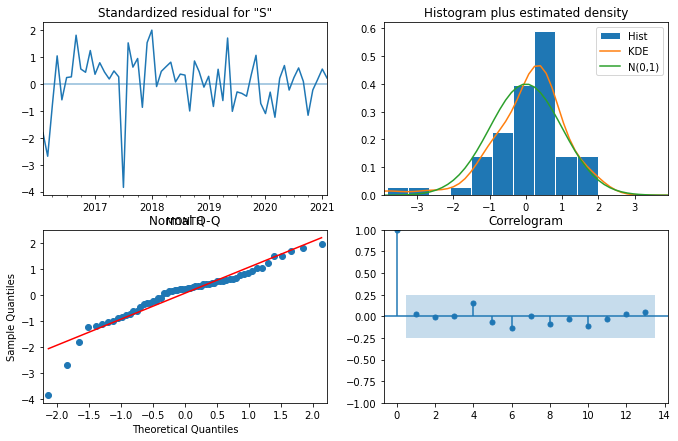

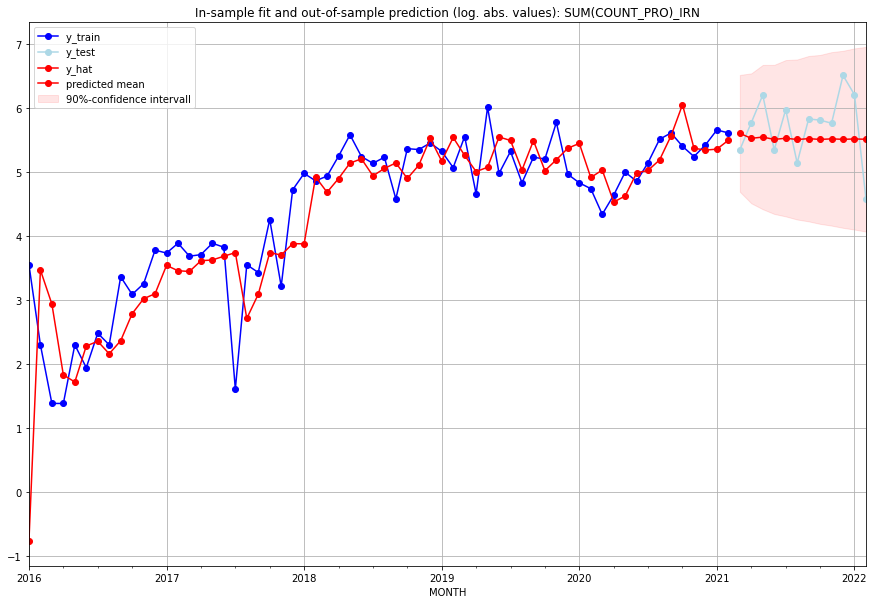

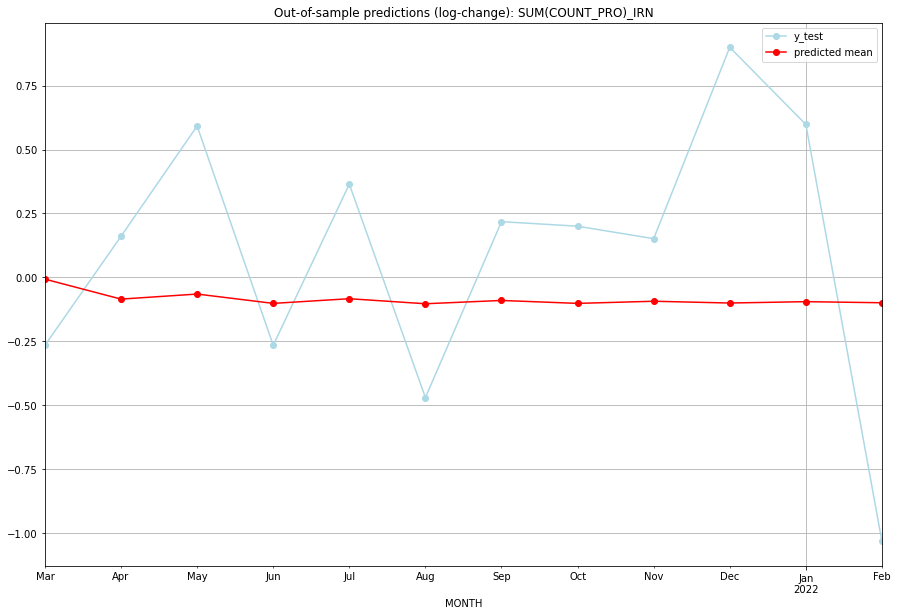

TADDA: 0.5273393687251328
Evaluation finished.
        MONTH    FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  272.185553       210.0     -0.006620       -0.264913   IRN   
1  2021-04-01  251.694916       322.0     -0.084588        0.160881   IRN   
2  2021-05-01  256.733671       496.0     -0.064844        0.591819   IRN   
3  2021-06-01  247.501246       210.0     -0.101323       -0.264913   IRN   
4  2021-07-01  252.081918       395.0     -0.083058        0.364643   IRN   
5  2021-08-01  247.155814       171.0     -0.102714       -0.469277   IRN   
6  2021-09-01  250.366827       341.0     -0.089858        0.218040   IRN   
7  2021-10-01  247.503557       335.0     -0.101314        0.200340   IRN   
8  2021-11-01  249.591498       319.0     -0.092947        0.151550   IRN   
9  2021-12-01  247.861515       675.0     -0.099875        0.899422   IRN   
10 2022-01-01  249.182414       499.0     -0.094581        0.597837   IRN   
11 2022-02-01  248.119838    

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [1, (2, 0, 2), (0, 0, 0, 0), 'n'], 'cv_score': 0.41228971278089505, 'fold_results': [0.41228971278089505]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_IRQ   No. Observations:                   62
Model:               SARIMAX(2, 0, 2)   Log Likelihood                 -69.888
Date:                Fri, 16 Sep 2022   AIC                            151.776
Time:                        14:18:11   BIC                            164.539
Sample:                    01-31-2016   HQIC                           156.787
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1             0.1258      0.092      1.364      0.172 

[12 rows x 48 columns]


<Figure size 432x288 with 0 Axes>

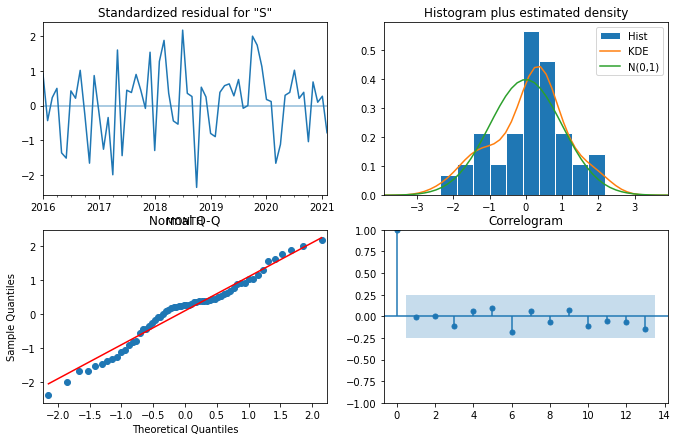

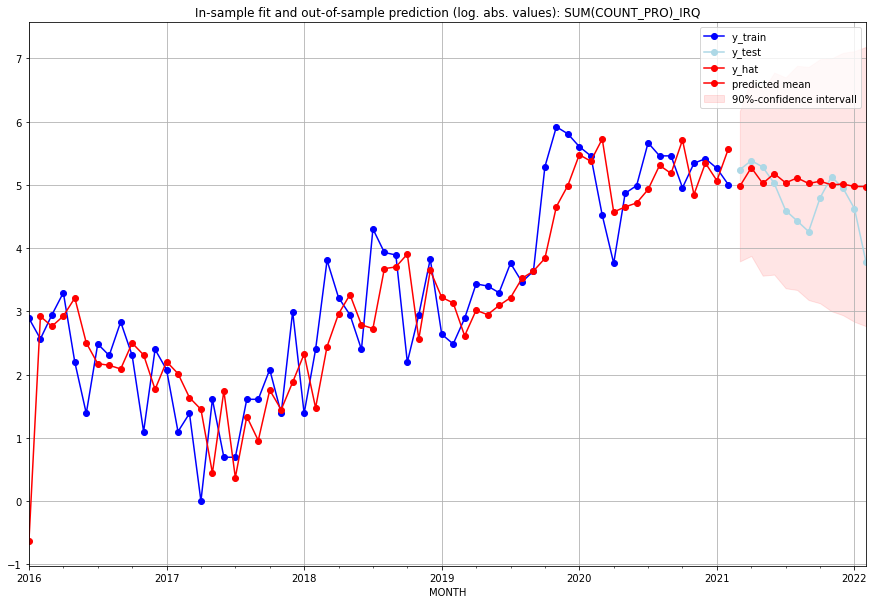

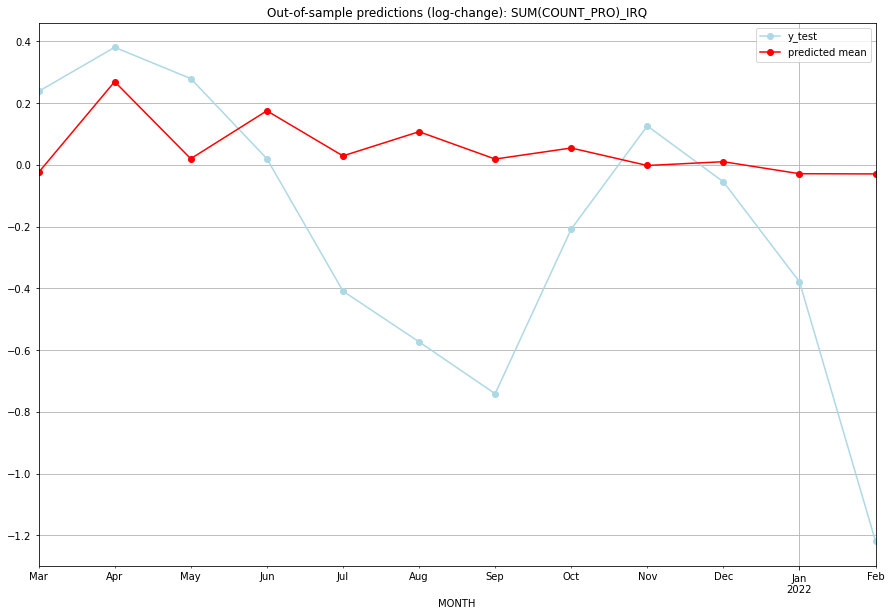

TADDA: 0.4090895357252798
Evaluation finished.
        MONTH    FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  144.365304       188.0     -0.024696        0.237801   IRQ   
1  2021-04-01  194.059096       217.0      0.269356        0.380549   IRQ   
2  2021-05-01  150.968165       196.0      0.019725        0.279257   IRQ   
3  2021-06-01  176.483424       151.0      0.174931        0.019934   IRQ   
4  2021-07-01  152.369546        98.0      0.028904       -0.408826   IRQ   
5  2021-08-01  164.866280        83.0      0.107236       -0.573130   IRQ   
6  2021-09-01  150.809491        70.0      0.018680       -0.741266   IRQ   
7  2021-10-01  156.342120       120.0      0.054476       -0.208156   IRQ   
8  2021-11-01  147.676771       168.0     -0.002172        0.125952   IRQ   
9  2021-12-01  149.515001       140.0      0.010116       -0.055186   IRQ   
10 2022-01-01  143.771507       101.0     -0.028790       -0.378973   IRQ   
11 2022-02-01  143.673528    

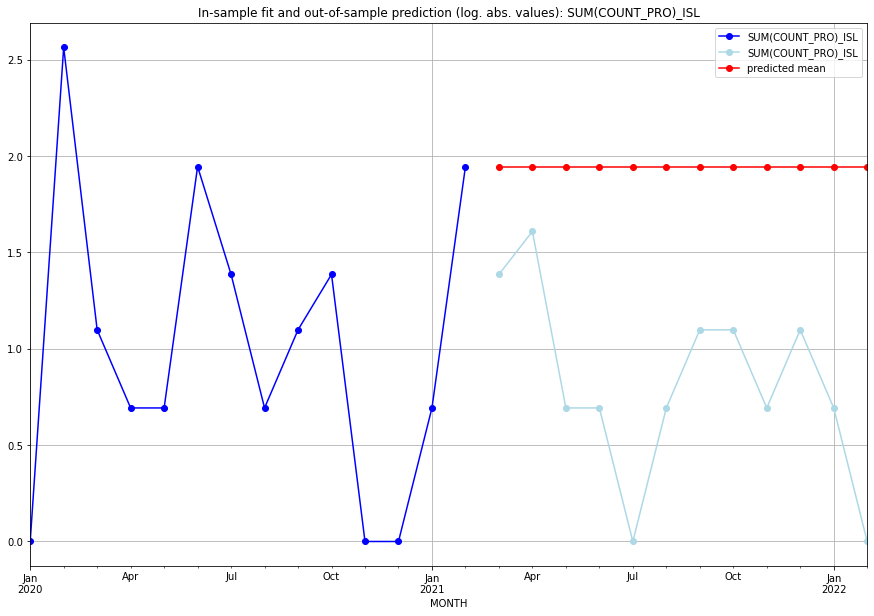

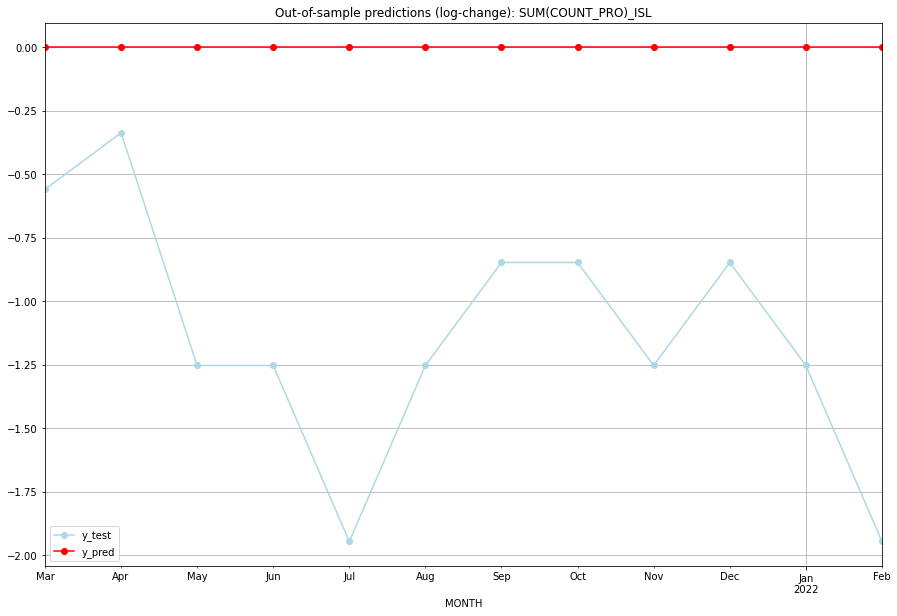

TADDA: 1.1328013955254757
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01   1.94591    1.386294           0.0       -0.559616   ISL   
1  2021-04-01   1.94591    1.609438           0.0       -0.336472   ISL   
2  2021-05-01   1.94591    0.693147           0.0       -1.252763   ISL   
3  2021-06-01   1.94591    0.693147           0.0       -1.252763   ISL   
4  2021-07-01   1.94591    0.000000           0.0       -1.945910   ISL   
5  2021-08-01   1.94591    0.693147           0.0       -1.252763   ISL   
6  2021-09-01   1.94591    1.098612           0.0       -0.847298   ISL   
7  2021-10-01   1.94591    1.098612           0.0       -0.847298   ISL   
8  2021-11-01   1.94591    0.693147           0.0       -1.252763   ISL   
9  2021-12-01   1.94591    1.098612           0.0       -0.847298   ISL   
10 2022-01-01   1.94591    0.693147           0.0       -1.252763   ISL   
11 2022-02-01   1.94591    0.000000           0.0    

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [2, (3, 1, 3), (0, 0, 0, 0), 'n'], 'cv_score': 1.2095842472173786, 'fold_results': [1.2095842472173786]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_ISR   No. Observations:                   62
Model:               SARIMAX(3, 1, 3)   Log Likelihood                 -41.635
Date:                Fri, 16 Sep 2022   AIC                            101.271
Time:                        14:18:44   BIC                            120.268
Sample:                    01-31-2016   HQIC                           108.716
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            -0.0711      0.054     -1.321      0.186   

<Figure size 432x288 with 0 Axes>

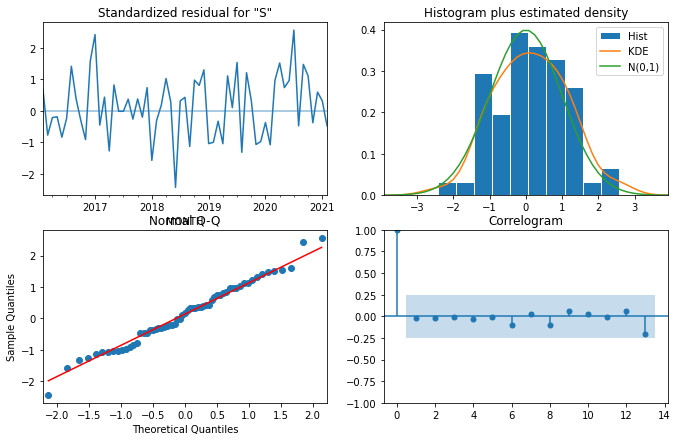

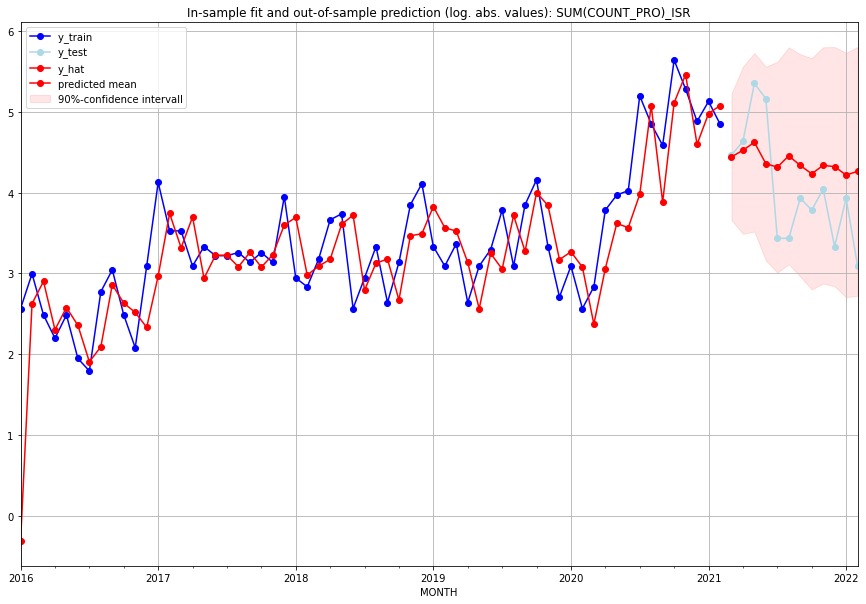

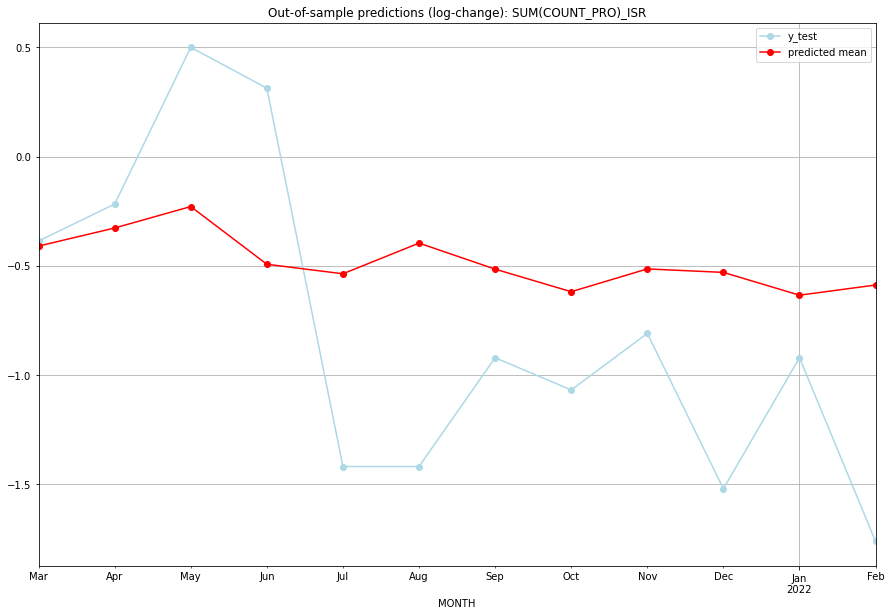

TADDA: 0.6575911131555974
Evaluation finished.
        MONTH    FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01   83.991176        86.0     -0.409483       -0.386122   ISR   
1  2021-04-01   91.323831       102.0     -0.326728       -0.217301   ISR   
2  2021-05-01  100.827212       210.0     -0.228753        0.499828   ISR   
3  2021-06-01   77.207898       174.0     -0.492660        0.312756   ISR   
4  2021-07-01   73.873491        30.0     -0.536230       -1.418043   ISR   
5  2021-08-01   85.149885        30.0     -0.395942       -1.418043   ISR   
6  2021-09-01   75.477359        50.0     -0.515036       -0.920205   ISR   
7  2021-10-01   67.977795        43.0     -0.618246       -1.067841   ISR   
8  2021-11-01   75.554756        56.0     -0.514024       -0.808979   ISR   
9  2021-12-01   74.346780        27.0     -0.529929       -1.519826   ISR   
10 2022-01-01   66.889524        50.0     -0.634149       -0.920205   ISR   
11 2022-02-01   70.118950    

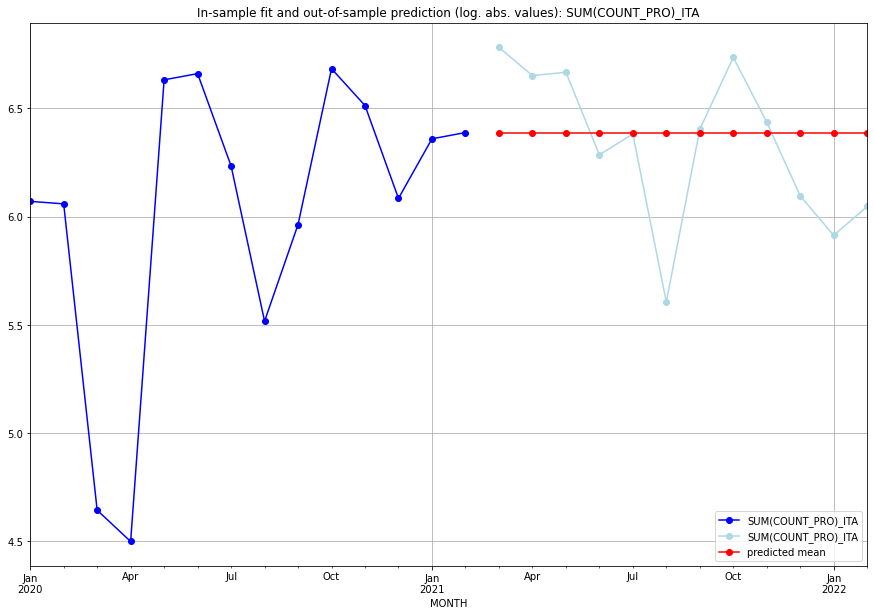

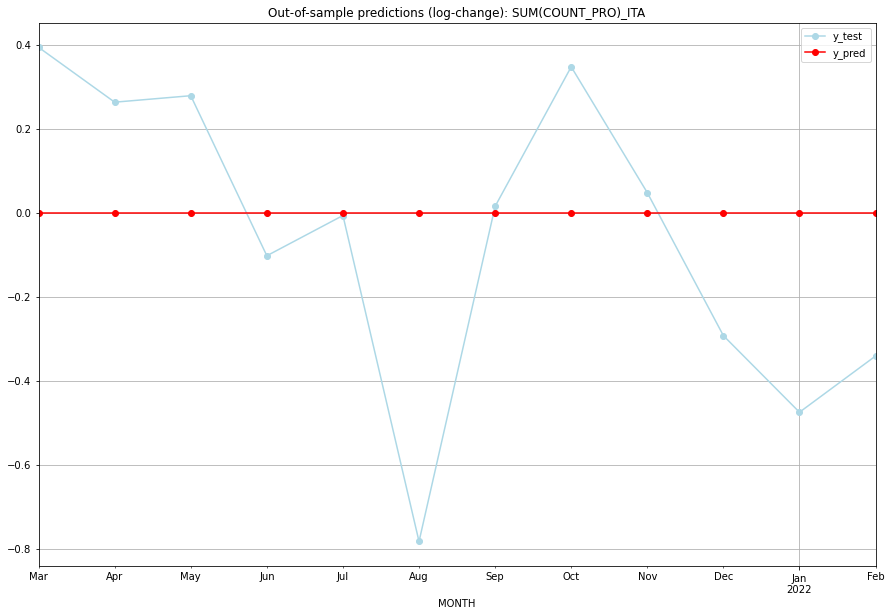

TADDA: 0.2788257814370469
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  6.388561    6.782192           0.0        0.393631   ITA   
1  2021-04-01  6.388561    6.651572           0.0        0.263010   ITA   
2  2021-05-01  6.388561    6.666957           0.0        0.278395   ITA   
3  2021-06-01  6.388561    6.285998           0.0       -0.102563   ITA   
4  2021-07-01  6.388561    6.381816           0.0       -0.006745   ITA   
5  2021-08-01  6.388561    5.605802           0.0       -0.782759   ITA   
6  2021-09-01  6.388561    6.403574           0.0        0.015013   ITA   
7  2021-10-01  6.388561    6.735780           0.0        0.347219   ITA   
8  2021-11-01  6.388561    6.436150           0.0        0.047589   ITA   
9  2021-12-01  6.388561    6.095825           0.0       -0.292737   ITA   
10 2022-01-01  6.388561    5.913503           0.0       -0.475058   ITA   
11 2022-02-01  6.388561    6.047372           0.0    

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (3, 1, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.5777795789224837, 'fold_results': [0.5777795789224837]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_JAM   No. Observations:                   38
Model:               SARIMAX(3, 1, 3)   Log Likelihood                 -30.338
Date:                Fri, 16 Sep 2022   AIC                             74.675
Time:                        14:19:09   BIC                             85.952
Sample:                    01-31-2018   HQIC                            78.651
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -1.2505      1.898     -0.659      0.510   

<Figure size 432x288 with 0 Axes>

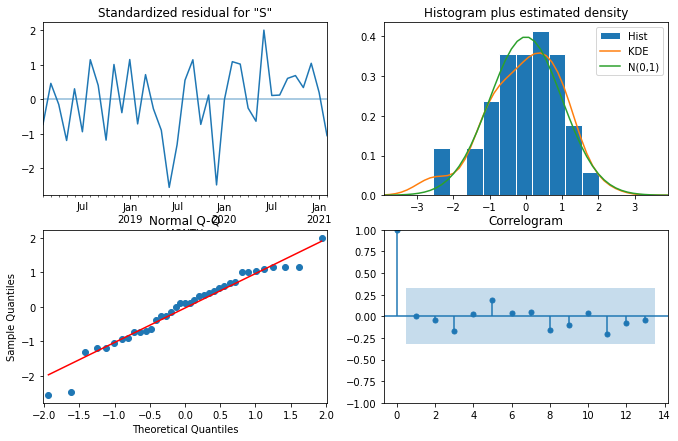

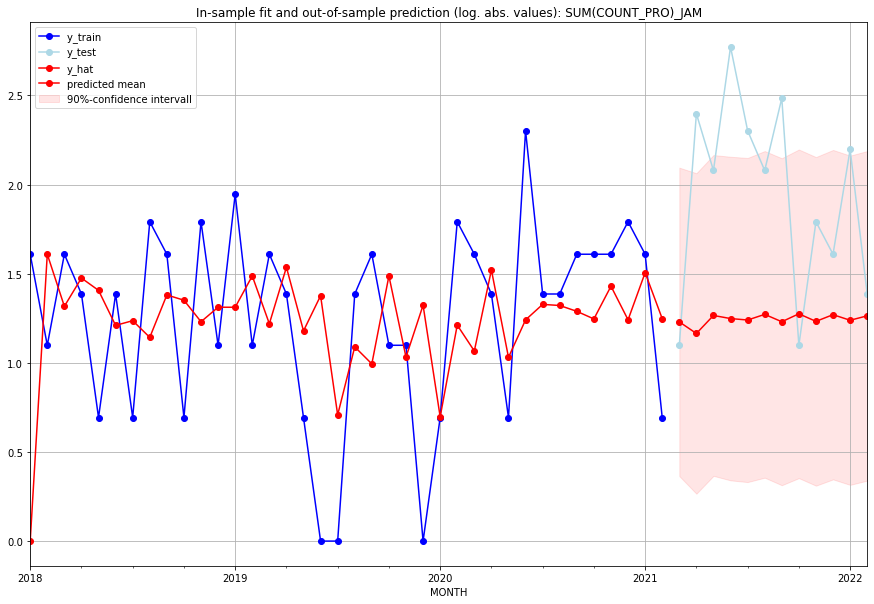

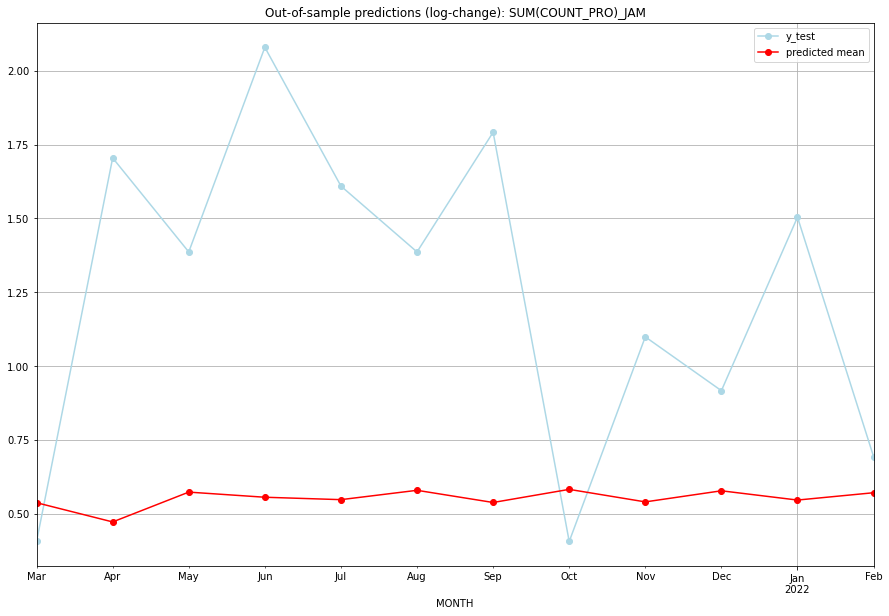

TADDA: 0.7484412261401276
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  2.421007         2.0      0.536788        0.405465   JAM   
1  2021-04-01  2.205500        10.0      0.471721        1.704748   JAM   
2  2021-05-01  2.546272         7.0      0.572750        1.386294   JAM   
3  2021-06-01  2.485141        15.0      0.555361        2.079442   JAM   
4  2021-07-01  2.456802         9.0      0.547197        1.609438   JAM   
5  2021-08-01  2.567911         7.0      0.578833        1.386294   JAM   
6  2021-09-01  2.423736        11.0      0.537585        1.791759   JAM   
7  2021-10-01  2.579272         2.0      0.582012        0.405465   JAM   
8  2021-11-01  2.430597         5.0      0.539587        1.098612   JAM   
9  2021-12-01  2.562078         4.0      0.577197        0.916291   JAM   
10 2022-01-01  2.452065         8.0      0.545826        1.504077   JAM   
11 2022-02-01  2.538735         3.0      0.570622    

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.2648378191956621, 'fold_results': [0.2648378191956621]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_JEY   No. Observations:                  289
Model:                        SARIMAX   Log Likelihood                 267.994
Date:                Fri, 16 Sep 2022   AIC                           -533.988
Time:                        14:19:38   BIC                           -530.321
Sample:                    02-28-1997   HQIC                          -532.519
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.0092      0.000     79.538      0.000   

<Figure size 432x288 with 0 Axes>

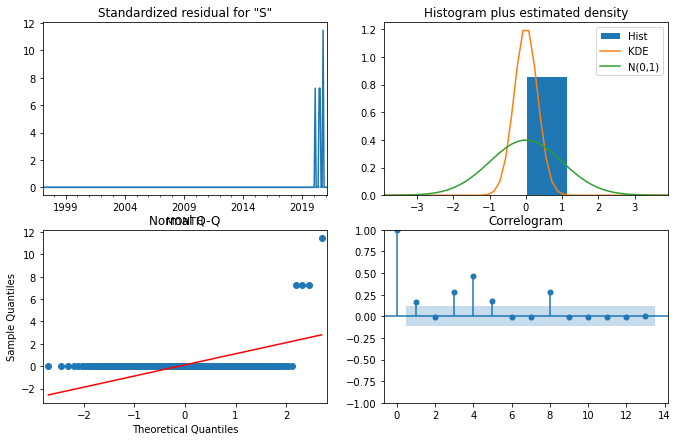

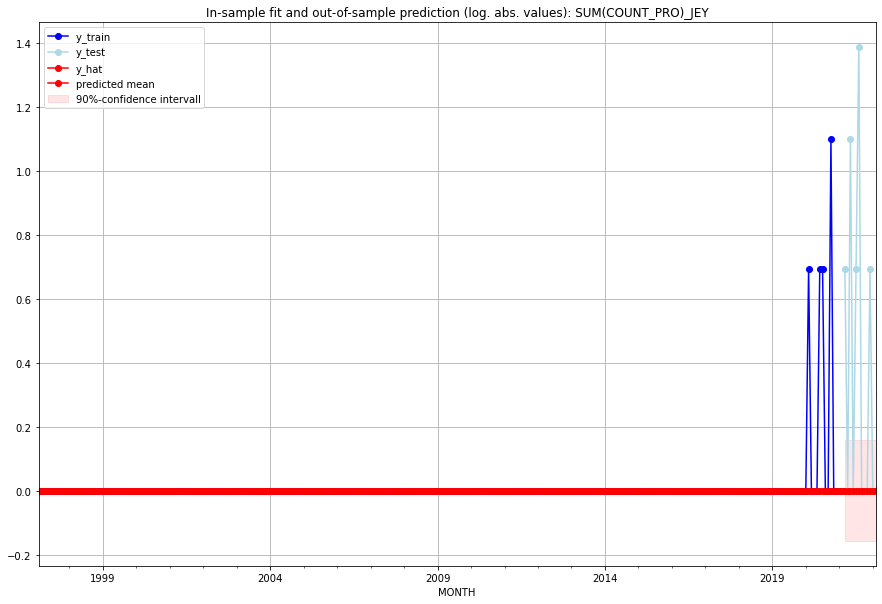

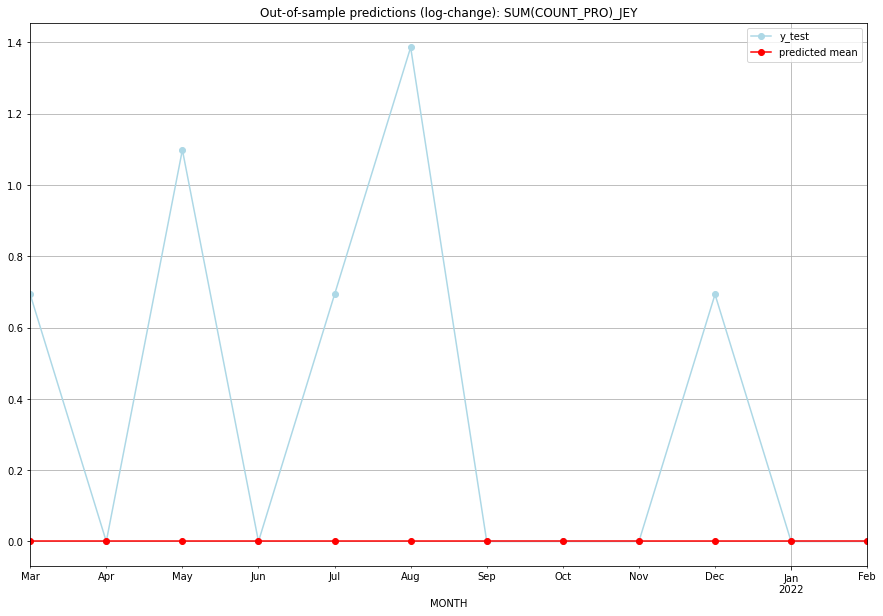

TADDA: 0.3803623492889863
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         1.0           0.0        0.693147   JEY   
1  2021-04-01       0.0         0.0           0.0        0.000000   JEY   
2  2021-05-01       0.0         2.0           0.0        1.098612   JEY   
3  2021-06-01       0.0         0.0           0.0        0.000000   JEY   
4  2021-07-01       0.0         1.0           0.0        0.693147   JEY   
5  2021-08-01       0.0         3.0           0.0        1.386294   JEY   
6  2021-09-01       0.0         0.0           0.0        0.000000   JEY   
7  2021-10-01       0.0         0.0           0.0        0.000000   JEY   
8  2021-11-01       0.0         0.0           0.0        0.000000   JEY   
9  2021-12-01       0.0         1.0           0.0        0.693147   JEY   
10 2022-01-01       0.0         0.0           0.0        0.000000   JEY   
11 2022-02-01       0.0         0.0           0.0    

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [3, (0, 0, 2), (0, 0, 0, 0), 'n'], 'cv_score': 0.5704112974298198, 'fold_results': [0.5704112974298198]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_JOR   No. Observations:                   62
Model:               SARIMAX(0, 0, 2)   Log Likelihood                -109.263
Date:                Fri, 16 Sep 2022   AIC                            230.526
Time:                        14:20:08   BIC                            243.289
Sample:                    01-31-2016   HQIC                           235.537
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            -0.0819      0.113     -0.723      0.470   

<Figure size 432x288 with 0 Axes>

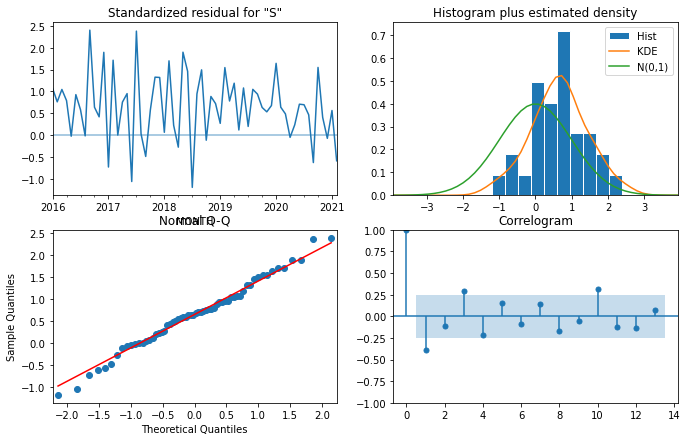

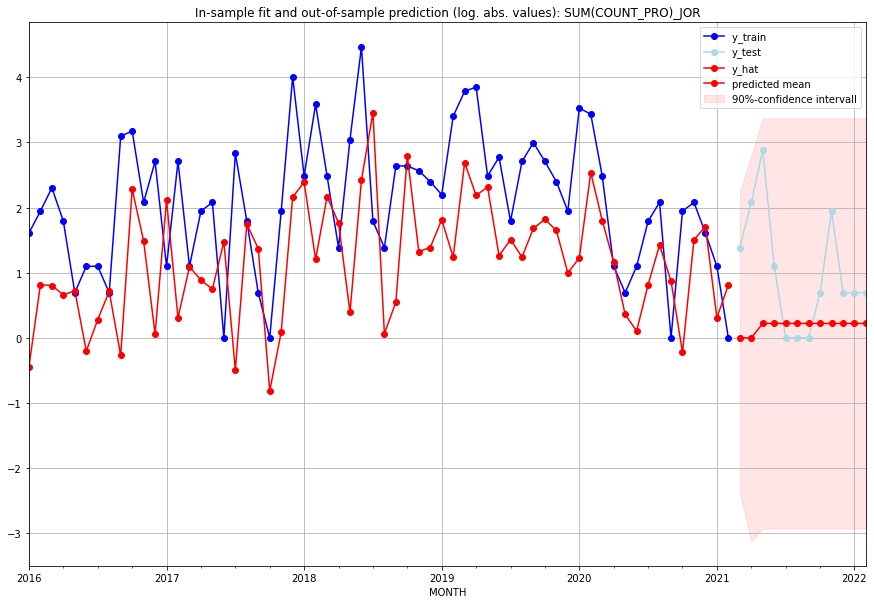

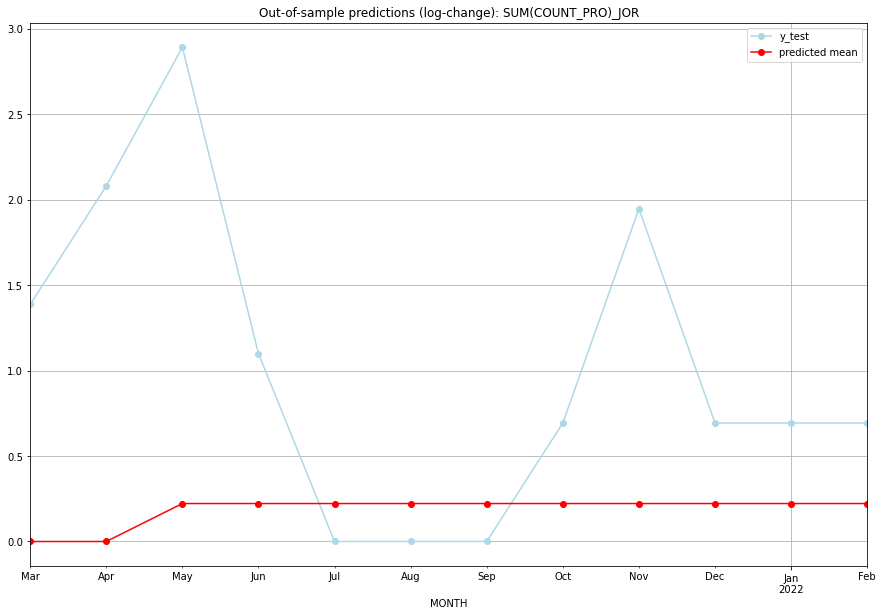

TADDA: 0.9404256303372097
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  0.000000         3.0      0.000000        1.386294   JOR   
1  2021-04-01  0.000000         7.0      0.000000        2.079442   JOR   
2  2021-05-01  0.248606        17.0      0.222028        2.890372   JOR   
3  2021-06-01  0.248606         2.0      0.222028        1.098612   JOR   
4  2021-07-01  0.248606         0.0      0.222028        0.000000   JOR   
5  2021-08-01  0.248606         0.0      0.222028        0.000000   JOR   
6  2021-09-01  0.248606         0.0      0.222028        0.000000   JOR   
7  2021-10-01  0.248606         1.0      0.222028        0.693147   JOR   
8  2021-11-01  0.248606         6.0      0.222028        1.945910   JOR   
9  2021-12-01  0.248606         1.0      0.222028        0.693147   JOR   
10 2022-01-01  0.248606         1.0      0.222028        0.693147   JOR   
11 2022-02-01  0.248606         1.0      0.222028    

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (2, 0, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.33783740675968915, 'fold_results': [0.33783740675968915]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_JPN   No. Observations:                   38
Model:               SARIMAX(2, 0, 3)   Log Likelihood                 -13.748
Date:                Fri, 16 Sep 2022   AIC                             39.496
Time:                        14:20:27   BIC                             49.322
Sample:                    01-31-2018   HQIC                            42.992
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.0004      0.011      0.040      0.968 

<Figure size 432x288 with 0 Axes>

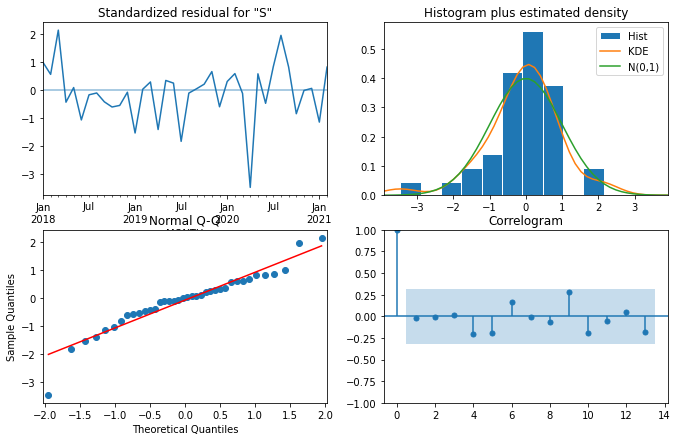

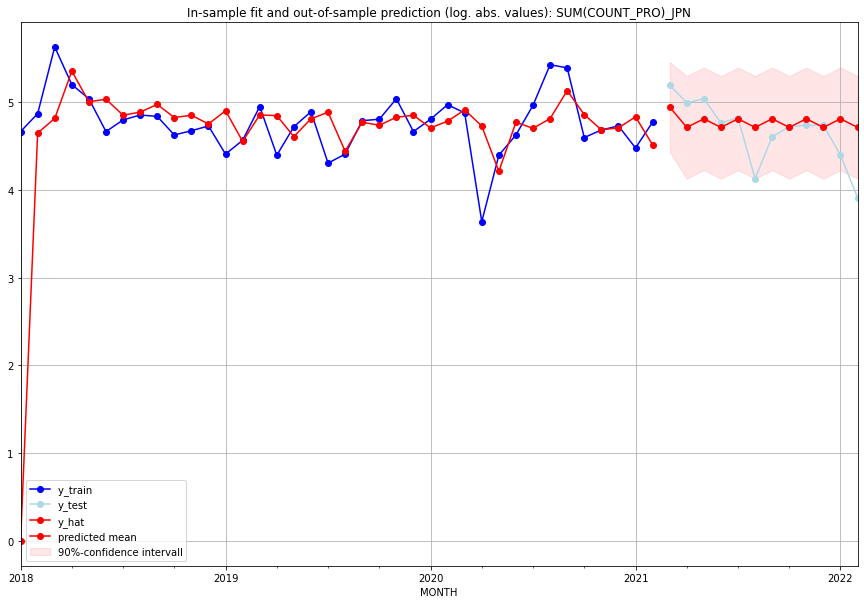

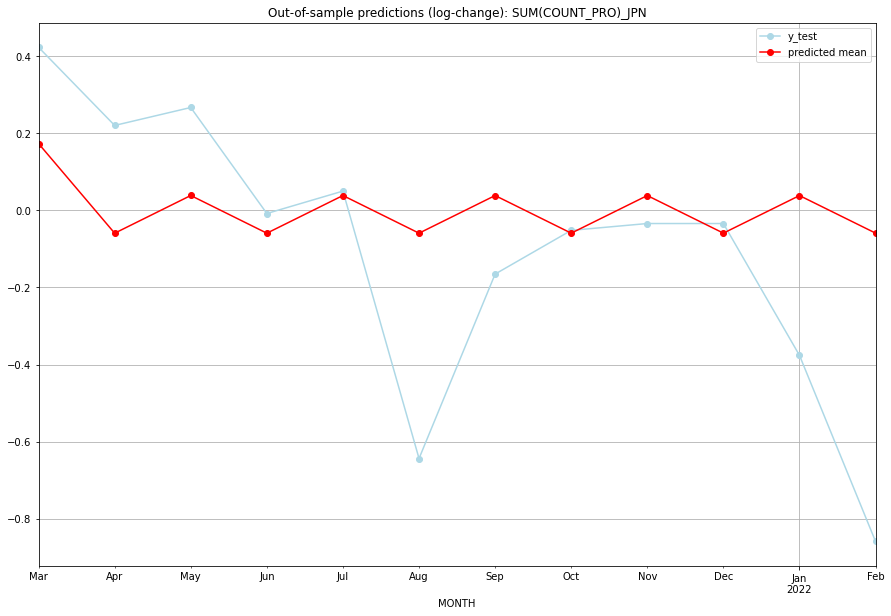

TADDA: 0.25825349142009807
Evaluation finished.
        MONTH    FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  139.239500       179.0      0.172667        0.422272   JPN   
1  2021-04-01  110.175378       146.0     -0.059576        0.219748   JPN   
2  2021-05-01  121.590140       153.0      0.038162        0.266268   JPN   
3  2021-06-01  110.179700       116.0     -0.059537       -0.008511   JPN   
4  2021-07-01  121.584528       123.0      0.038116        0.049597   JPN   
5  2021-08-01  110.184018        61.0     -0.059498       -0.643550   JPN   
6  2021-09-01  121.578921        99.0      0.038070       -0.165514   JPN   
7  2021-10-01  110.188333       111.0     -0.059459       -0.052186   JPN   
8  2021-11-01  121.573319       113.0      0.038025       -0.034486   JPN   
9  2021-12-01  110.192643       113.0     -0.059420       -0.034486   JPN   
10 2022-01-01  121.567721        80.0      0.037979       -0.376235   JPN   
11 2022-02-01  110.196950   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.14675054260195272, 'fold_results': [0.14675054260195272]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_KAZ   No. Observations:                   38
Model:               SARIMAX(0, 1, 0)   Log Likelihood                 -17.204
Date:                Fri, 16 Sep 2022   AIC                             36.408
Time:                        14:20:53   BIC                             38.019
Sample:                    01-31-2018   HQIC                            36.976
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.1484      0.035      4.283      0.000 

<Figure size 432x288 with 0 Axes>

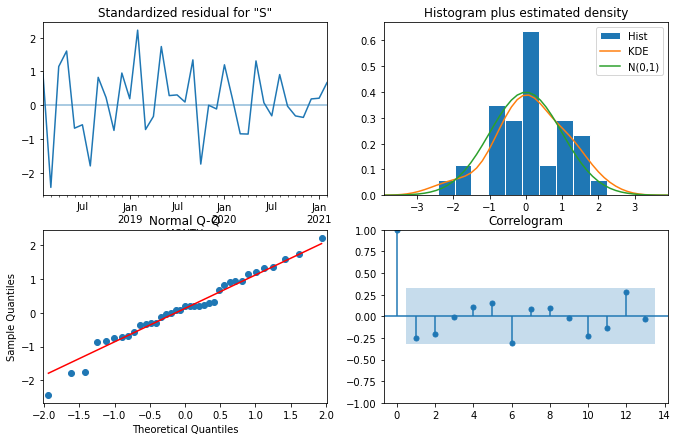

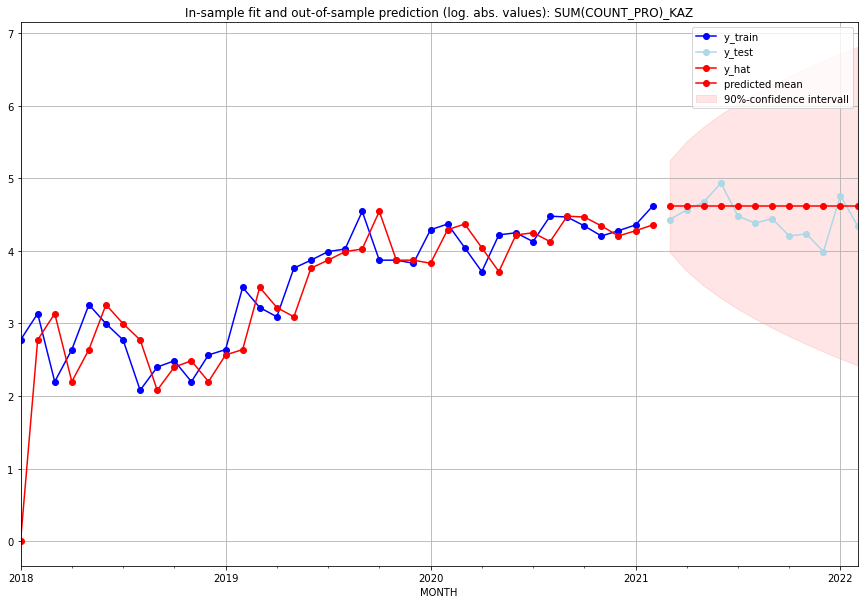

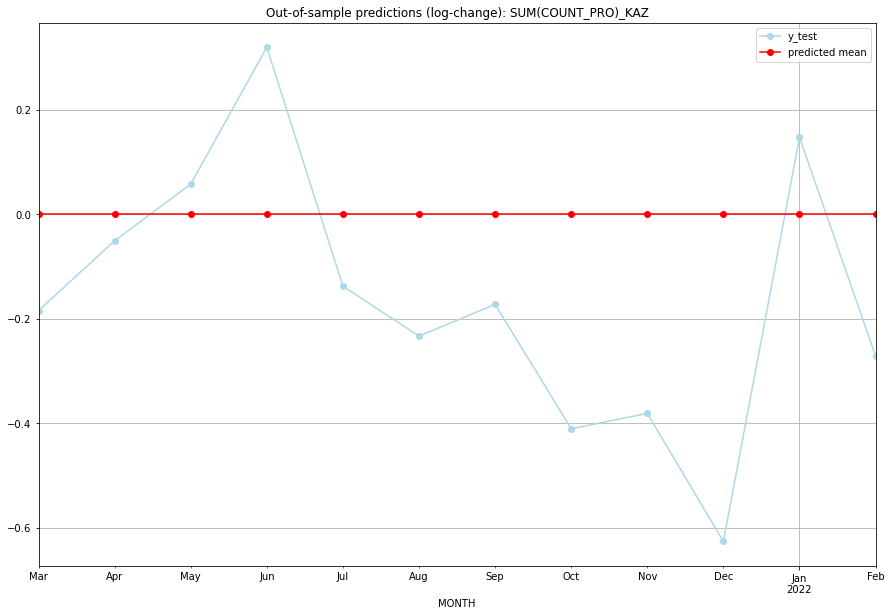

TADDA: 0.24928595958984787
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01     100.0        83.0           0.0       -0.184304   KAZ   
1  2021-04-01     100.0        95.0           0.0       -0.050772   KAZ   
2  2021-05-01     100.0       106.0           0.0        0.057708   KAZ   
3  2021-06-01     100.0       138.0           0.0        0.319353   KAZ   
4  2021-07-01     100.0        87.0           0.0       -0.137784   KAZ   
5  2021-08-01     100.0        79.0           0.0       -0.233094   KAZ   
6  2021-09-01     100.0        84.0           0.0       -0.172469   KAZ   
7  2021-10-01     100.0        66.0           0.0       -0.410428   KAZ   
8  2021-11-01     100.0        68.0           0.0       -0.381014   KAZ   
9  2021-12-01     100.0        53.0           0.0       -0.626136   KAZ   
10 2022-01-01     100.0       116.0           0.0        0.147053   KAZ   
11 2022-02-01     100.0        76.0           0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (3, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.29289690826553366, 'fold_results': [0.29289690826553366]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_KEN   No. Observations:                  289
Model:               SARIMAX(3, 0, 0)   Log Likelihood                -351.445
Date:                Fri, 16 Sep 2022   AIC                            710.890
Time:                        14:21:31   BIC                            725.555
Sample:                    02-28-1997   HQIC                           716.766
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.5103      0.042     12.120      0.000 

<Figure size 432x288 with 0 Axes>

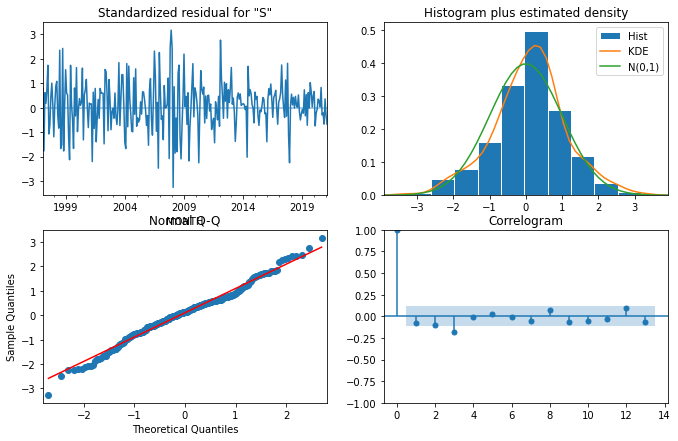

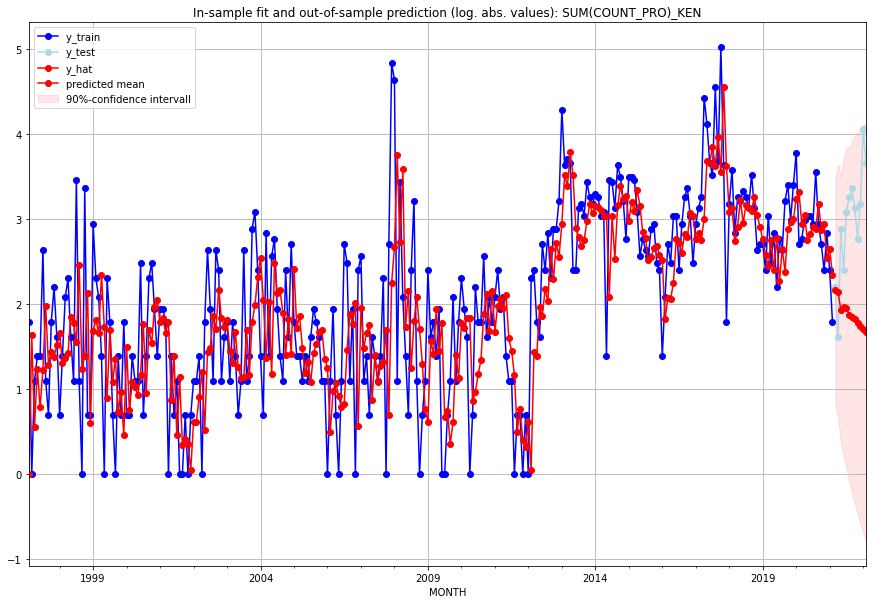

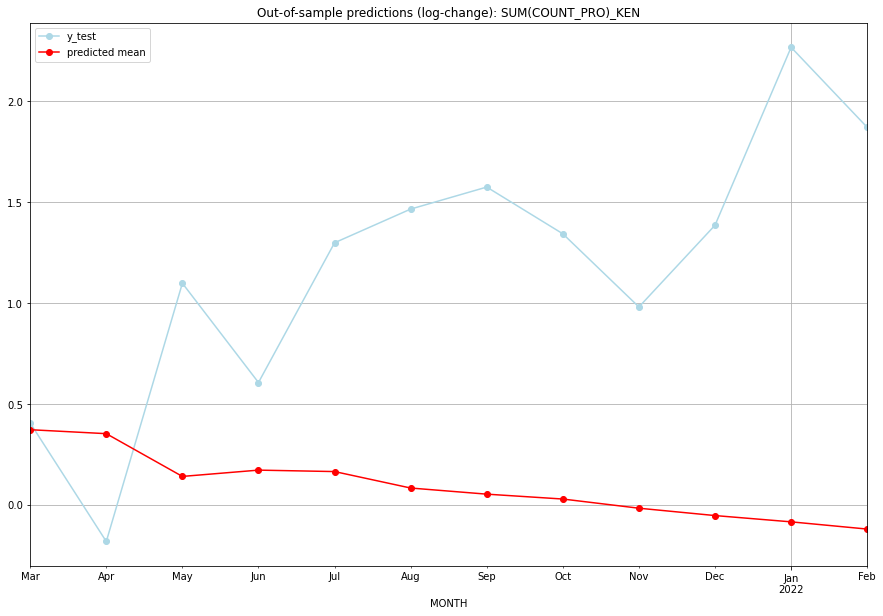

TADDA: 1.2275862220051996
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  7.704787         8.0      0.372114        0.405465   KEN   
1  2021-04-01  7.535339         4.0      0.352456       -0.182322   KEN   
2  2021-05-01  5.904420        17.0      0.140402        1.098612   KEN   
3  2021-06-01  6.123415        10.0      0.171628        0.606136   KEN   
4  2021-07-01  6.072617        21.0      0.164471        1.299283   KEN   
5  2021-08-01  5.518213        25.0      0.082841        1.466337   KEN   
6  2021-09-01  5.323295        28.0      0.052481        1.575536   KEN   
7  2021-10-01  5.171954        22.0      0.028256        1.343735   KEN   
8  2021-11-01  4.897385        15.0     -0.017250        0.980829   KEN   
9  2021-12-01  4.685997        23.0     -0.053753        1.386294   KEN   
10 2022-01-01  4.511578        57.0     -0.084909        2.268684   KEN   
11 2022-02-01  4.317647        38.0     -0.120729    

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.601255847566675, 'fold_results': [0.601255847566675]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_KGZ   No. Observations:                   38
Model:               SARIMAX(0, 1, 0)   Log Likelihood                 -35.175
Date:                Fri, 16 Sep 2022   AIC                             72.350
Time:                        14:21:57   BIC                             73.961
Sample:                    01-31-2018   HQIC                            72.918
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.3920      0.076      5.152      0.000     

<Figure size 432x288 with 0 Axes>

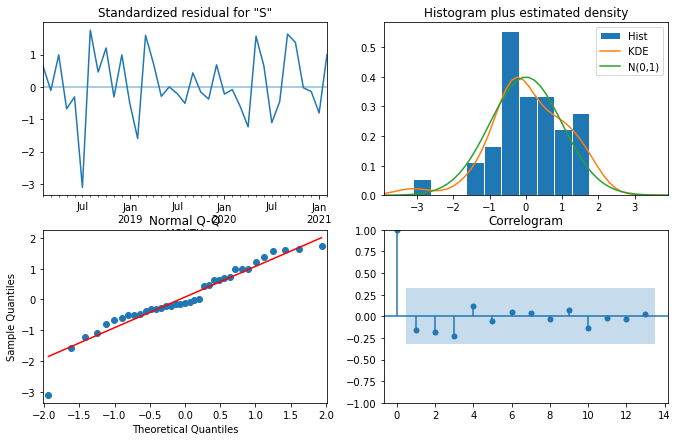

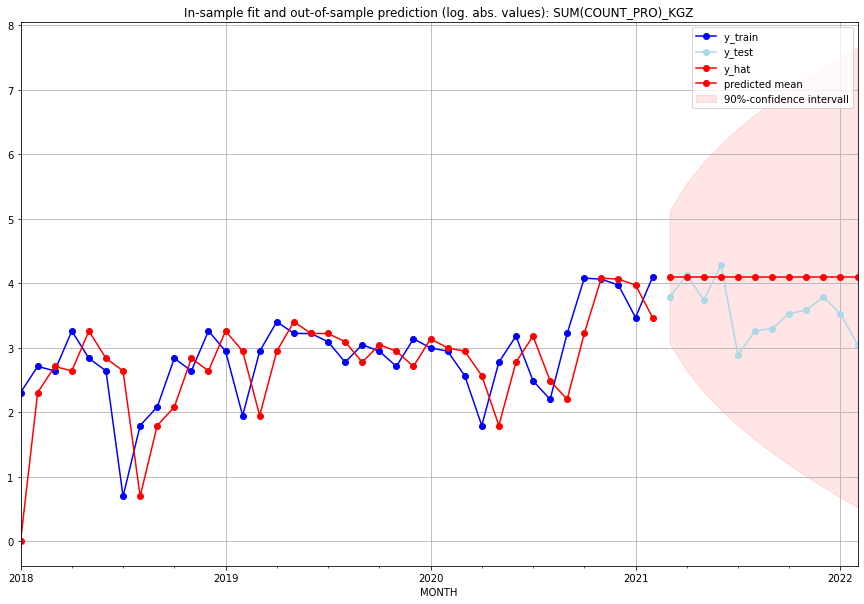

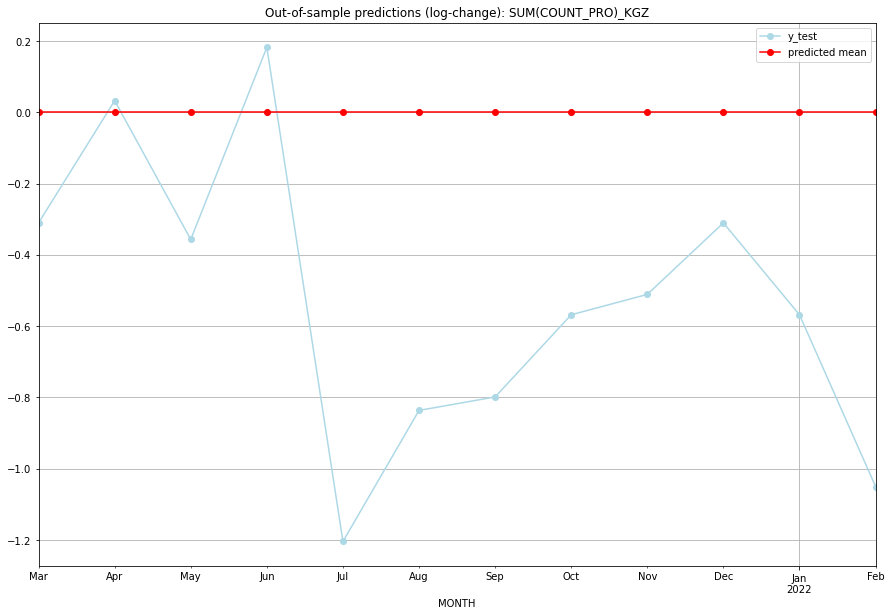

TADDA: 0.560620044032019
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01      59.0        43.0           0.0       -0.310155   KGZ   
1  2021-04-01      59.0        61.0           0.0        0.032790   KGZ   
2  2021-05-01      59.0        41.0           0.0       -0.356675   KGZ   
3  2021-06-01      59.0        71.0           0.0        0.182322   KGZ   
4  2021-07-01      59.0        17.0           0.0       -1.203973   KGZ   
5  2021-08-01      59.0        25.0           0.0       -0.836248   KGZ   
6  2021-09-01      59.0        26.0           0.0       -0.798508   KGZ   
7  2021-10-01      59.0        33.0           0.0       -0.567984   KGZ   
8  2021-11-01      59.0        35.0           0.0       -0.510826   KGZ   
9  2021-12-01      59.0        43.0           0.0       -0.310155   KGZ   
10 2022-01-01      59.0        33.0           0.0       -0.567984   KGZ   
11 2022-02-01      59.0        20.0           0.0     

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (2, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.39789163587689846, 'fold_results': [0.39789163587689846]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_KHM   No. Observations:                  134
Model:               SARIMAX(2, 1, 0)   Log Likelihood                -112.575
Date:                Fri, 16 Sep 2022   AIC                            231.151
Time:                        14:22:24   BIC                            239.822
Sample:                    01-31-2010   HQIC                           234.674
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.4457      0.076     -5.833      0.000 

<Figure size 432x288 with 0 Axes>

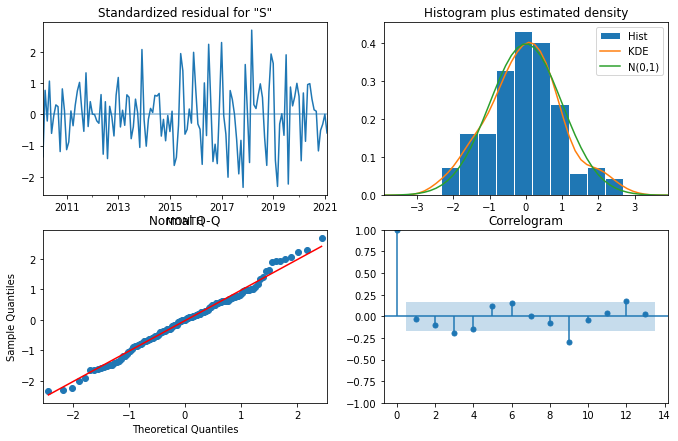

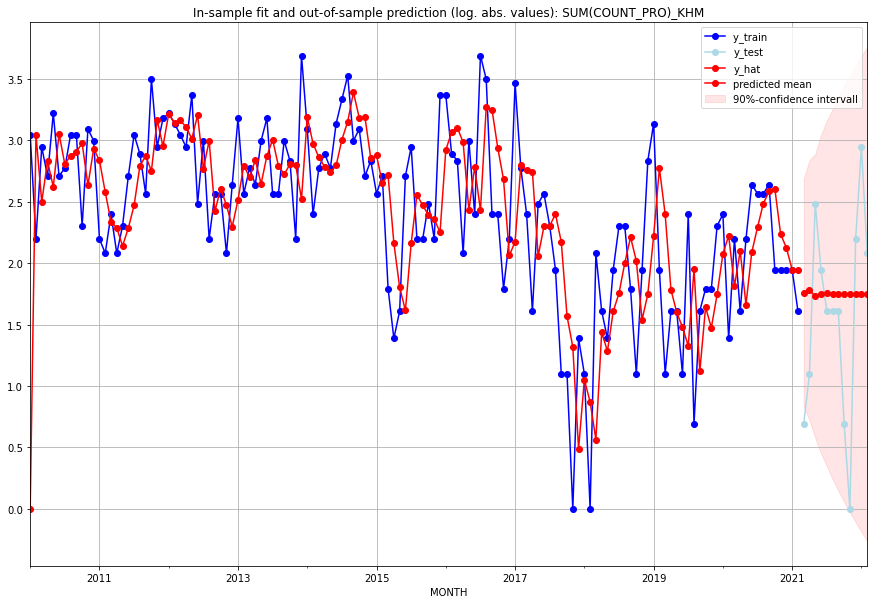

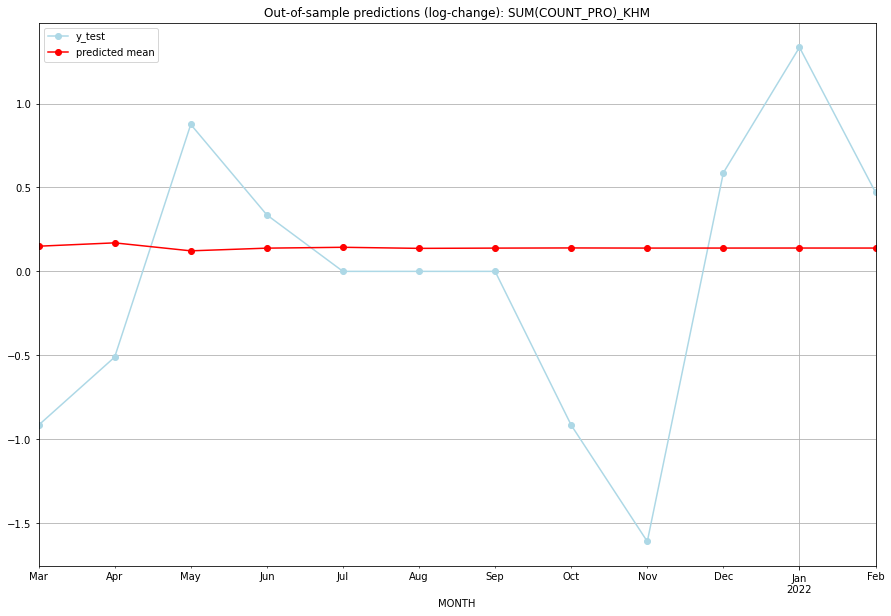

TADDA: 0.7079563592067394
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  4.808947         1.0      0.149961       -0.916291   KHM   
1  2021-04-01  4.925644         2.0      0.169851       -0.510826   KHM   
2  2021-05-01  4.650658        11.0      0.122334        0.875469   KHM   
3  2021-06-01  4.742090         6.0      0.138385        0.336472   KHM   
4  2021-07-01  4.771413         4.0      0.143479        0.000000   KHM   
5  2021-08-01  4.734551         4.0      0.137072        0.000000   KHM   
6  2021-09-01  4.743405         4.0      0.138614        0.000000   KHM   
7  2021-10-01  4.748944         1.0      0.139578       -0.916291   KHM   
8  2021-11-01  4.744190         0.0      0.138751       -1.609438   KHM   
9  2021-12-01  4.744881         8.0      0.138871        0.587787   KHM   
10 2022-01-01  4.745798        18.0      0.139031        1.335001   KHM   
11 2022-02-01  4.745211         7.0      0.138929    

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.053007930662718396, 'fold_results': [0.053007930662718396]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_KNA   No. Observations:                   38
Model:               SARIMAX(0, 0, 3)   Log Likelihood                  11.094
Date:                Fri, 16 Sep 2022   AIC                            -14.188
Time:                        14:22:39   BIC                             -7.638
Sample:                    01-31-2018   HQIC                           -11.857
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ma.L1      -2.357e-06      2e+04  -1.18e-10      1.00

<Figure size 432x288 with 0 Axes>

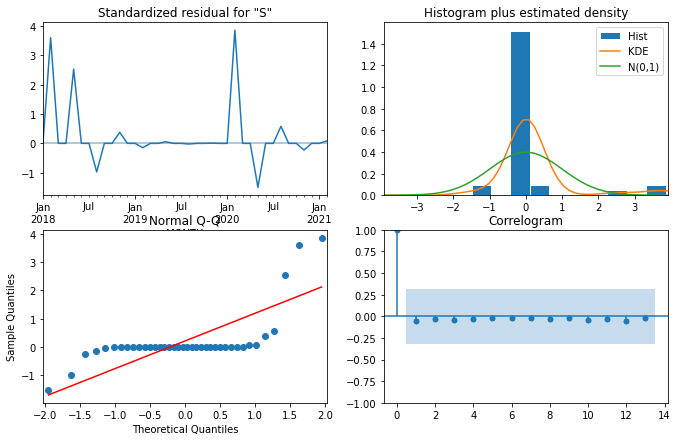

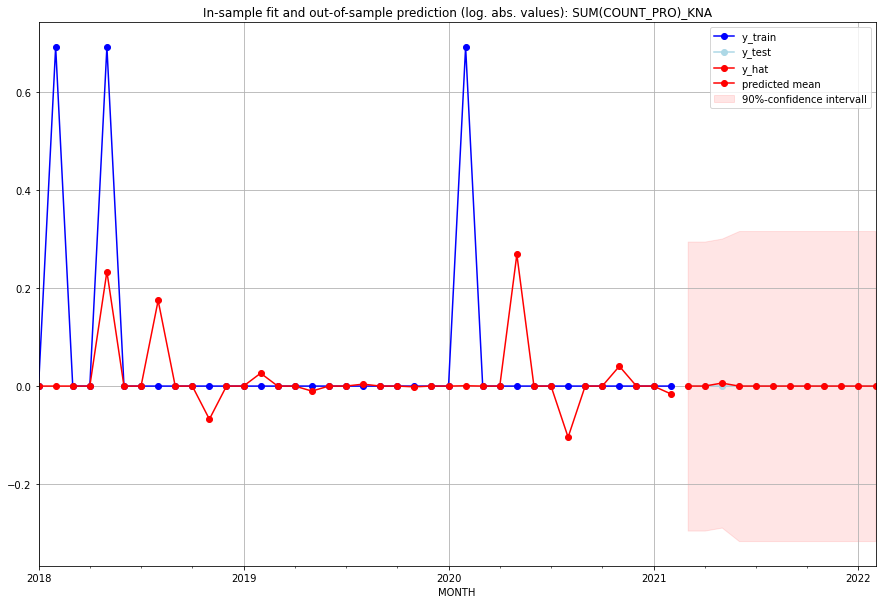

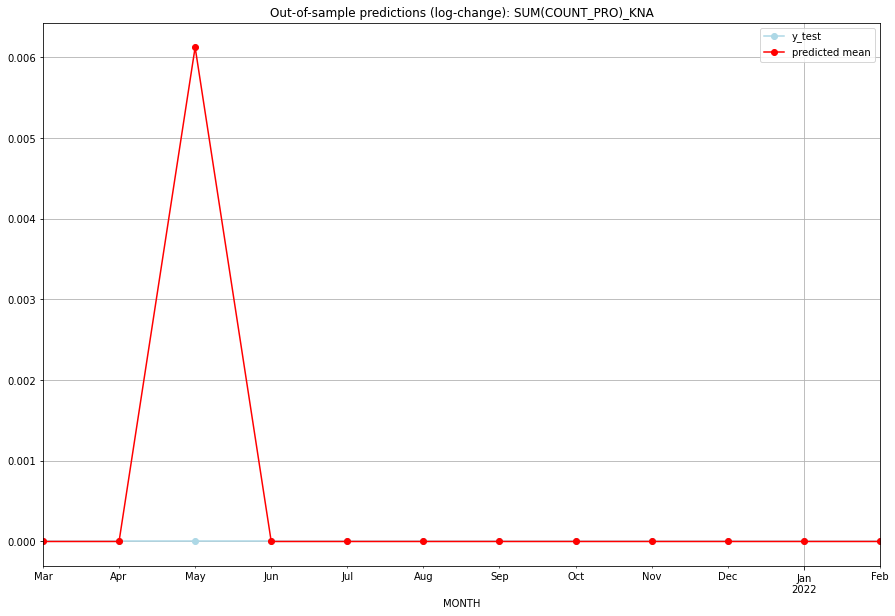

TADDA: 0.0005103323535972751
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  0.000000         0.0      0.000000             0.0   KNA   
1  2021-04-01  0.000000         0.0      0.000000             0.0   KNA   
2  2021-05-01  0.006143         0.0      0.006124             0.0   KNA   
3  2021-06-01  0.000000         0.0      0.000000             0.0   KNA   
4  2021-07-01  0.000000         0.0      0.000000             0.0   KNA   
5  2021-08-01  0.000000         0.0      0.000000             0.0   KNA   
6  2021-09-01  0.000000         0.0      0.000000             0.0   KNA   
7  2021-10-01  0.000000         0.0      0.000000             0.0   KNA   
8  2021-11-01  0.000000         0.0      0.000000             0.0   KNA   
9  2021-12-01  0.000000         0.0      0.000000             0.0   KNA   
10 2022-01-01  0.000000         0.0      0.000000             0.0   KNA   
11 2022-02-01  0.000000         0.0      0.000000 

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [3, (0, 1, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.2275424191236286, 'fold_results': [0.2275424191236286]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_KOR   No. Observations:                   38
Model:               SARIMAX(0, 1, 3)   Log Likelihood                   9.885
Date:                Fri, 16 Sep 2022   AIC                             -5.771
Time:                        14:23:20   BIC                              5.506
Sample:                    01-31-2018   HQIC                            -1.795
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1             0.0125      0.024      0.513      0.608   

<Figure size 432x288 with 0 Axes>

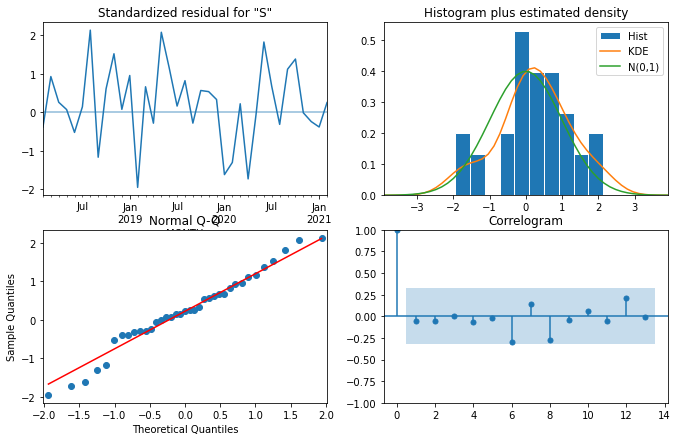

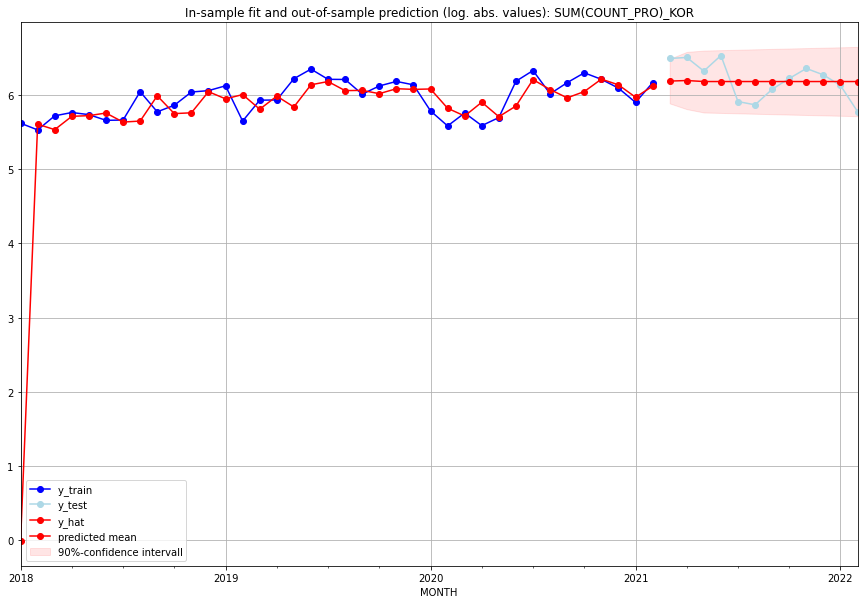

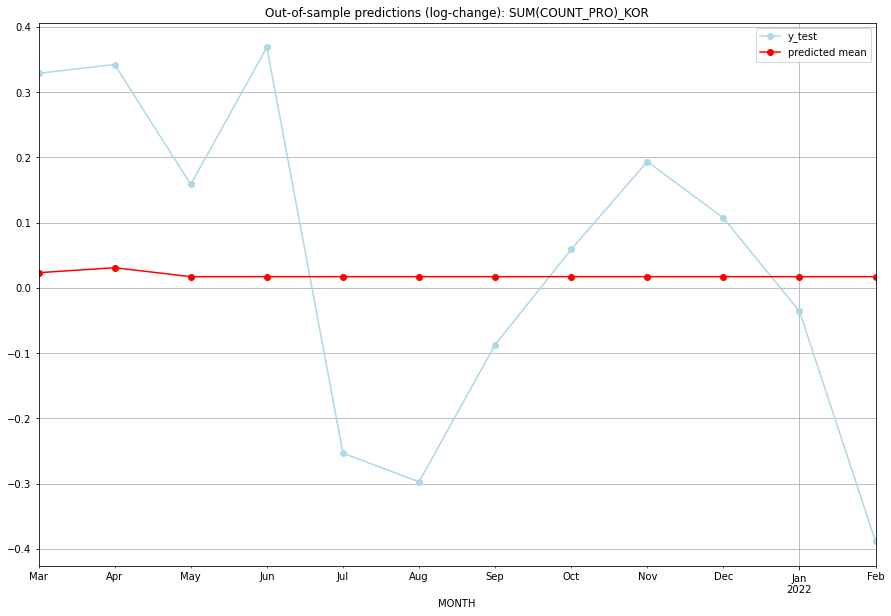

TADDA: 0.22095755571563128
Evaluation finished.
        MONTH    FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  488.167675       663.0      0.023095        0.328671   KOR   
1  2021-04-01  491.927586       672.0      0.030752        0.342135   KOR   
2  2021-05-01  485.190788       559.0      0.016990        0.158326   KOR   
3  2021-06-01  485.190788       690.0      0.016990        0.368529   KOR   
4  2021-07-01  485.190788       370.0      0.016990       -0.253409   KOR   
5  2021-08-01  485.190788       354.0      0.016990       -0.297493   KOR   
6  2021-09-01  485.190788       437.0      0.016990       -0.087392   KOR   
7  2021-10-01  485.190788       506.0      0.016990        0.058900   KOR   
8  2021-11-01  485.190788       579.0      0.016990        0.193417   KOR   
9  2021-12-01  485.190788       531.0      0.016990        0.107033   KOR   
10 2022-01-01  485.190788       460.0      0.016990       -0.036213   KOR   
11 2022-02-01  485.190788   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [3, (0, 0, 2), (0, 0, 0, 0), 'n'], 'cv_score': 0.5649072532921858, 'fold_results': [0.5649072532921858]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_KWT   No. Observations:                   62
Model:               SARIMAX(0, 0, 2)   Log Likelihood                 -58.425
Date:                Fri, 16 Sep 2022   AIC                            128.849
Time:                        14:24:03   BIC                            141.612
Sample:                    01-31-2016   HQIC                           133.860
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            -0.0422      0.063     -0.666      0.505   

<Figure size 432x288 with 0 Axes>

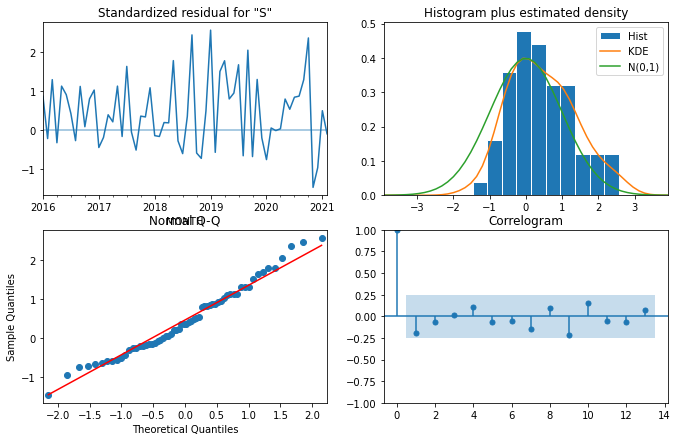

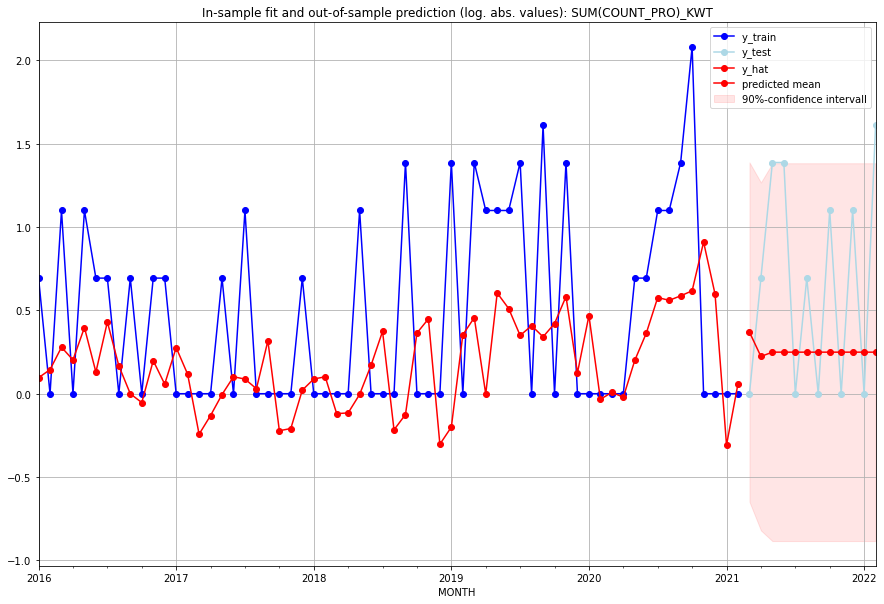

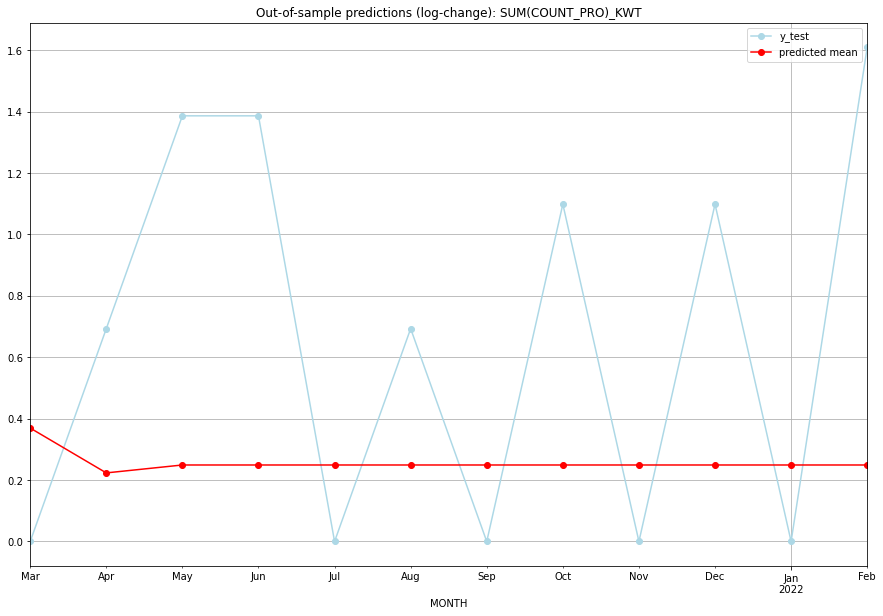

TADDA: 0.6344419833540793
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  0.446915         0.0      0.369433        0.000000   KWT   
1  2021-04-01  0.250297         1.0      0.223381        0.693147   KWT   
2  2021-05-01  0.282930         3.0      0.249147        1.386294   KWT   
3  2021-06-01  0.282930         3.0      0.249147        1.386294   KWT   
4  2021-07-01  0.282930         0.0      0.249147        0.000000   KWT   
5  2021-08-01  0.282930         1.0      0.249147        0.693147   KWT   
6  2021-09-01  0.282930         0.0      0.249147        0.000000   KWT   
7  2021-10-01  0.282930         2.0      0.249147        1.098612   KWT   
8  2021-11-01  0.282930         0.0      0.249147        0.000000   KWT   
9  2021-12-01  0.282930         2.0      0.249147        1.098612   KWT   
10 2022-01-01  0.282930         0.0      0.249147        0.000000   KWT   
11 2022-02-01  0.282930         4.0      0.249147    

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.057762265046662105, 'fold_results': [0.057762265046662105]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_LAO   No. Observations:                  134
Model:                        SARIMAX   Log Likelihood                  43.650
Date:                Fri, 16 Sep 2022   AIC                            -85.301
Time:                        14:24:46   BIC                            -82.403
Sample:                    01-31-2010   HQIC                           -84.123
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.0305      0.001     27.004      0.00

<Figure size 432x288 with 0 Axes>

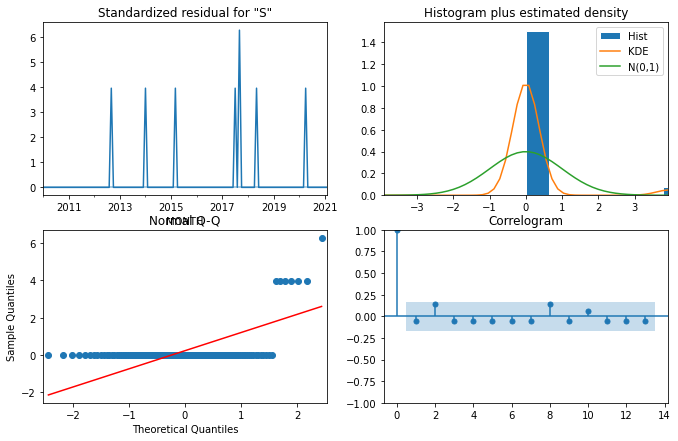

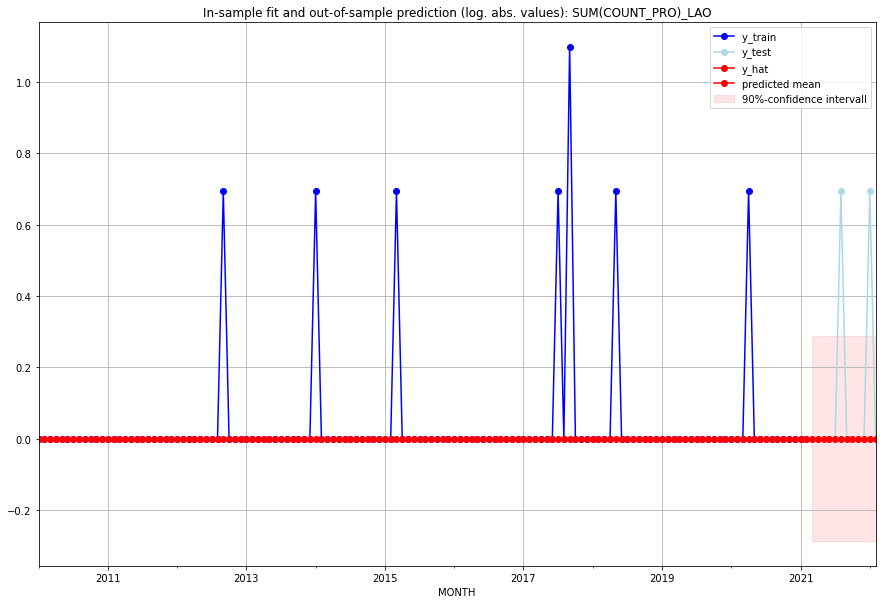

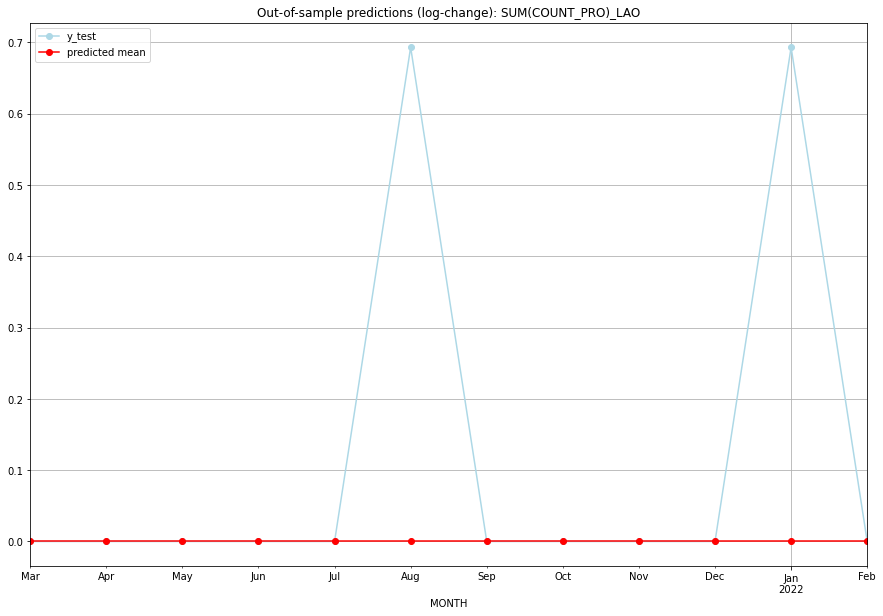

TADDA: 0.11552453009332421
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0        0.000000   LAO   
1  2021-04-01       0.0         0.0           0.0        0.000000   LAO   
2  2021-05-01       0.0         0.0           0.0        0.000000   LAO   
3  2021-06-01       0.0         0.0           0.0        0.000000   LAO   
4  2021-07-01       0.0         0.0           0.0        0.000000   LAO   
5  2021-08-01       0.0         1.0           0.0        0.693147   LAO   
6  2021-09-01       0.0         0.0           0.0        0.000000   LAO   
7  2021-10-01       0.0         0.0           0.0        0.000000   LAO   
8  2021-11-01       0.0         0.0           0.0        0.000000   LAO   
9  2021-12-01       0.0         0.0           0.0        0.000000   LAO   
10 2022-01-01       0.0         1.0           0.0        0.693147   LAO   
11 2022-02-01       0.0         0.0           0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [3, (3, 0, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.856115522583926, 'fold_results': [0.856115522583926]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_LBN   No. Observations:                   62
Model:               SARIMAX(3, 0, 3)   Log Likelihood                 -48.742
Date:                Fri, 16 Sep 2022   AIC                            117.485
Time:                        14:25:13   BIC                            138.756
Sample:                    01-31-2016   HQIC                           125.836
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1             0.0597      0.089      0.668      0.504     

<Figure size 432x288 with 0 Axes>

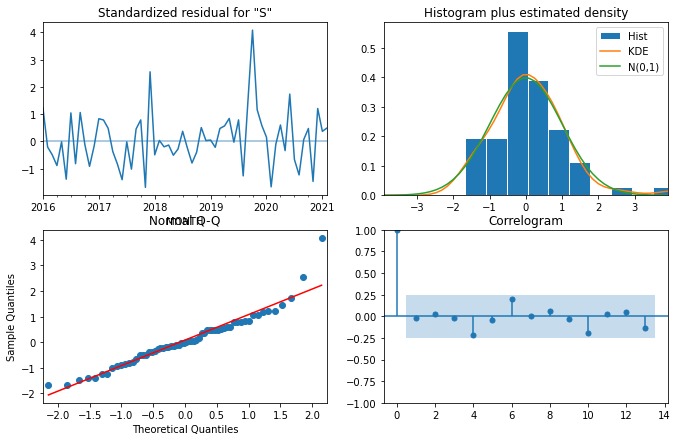

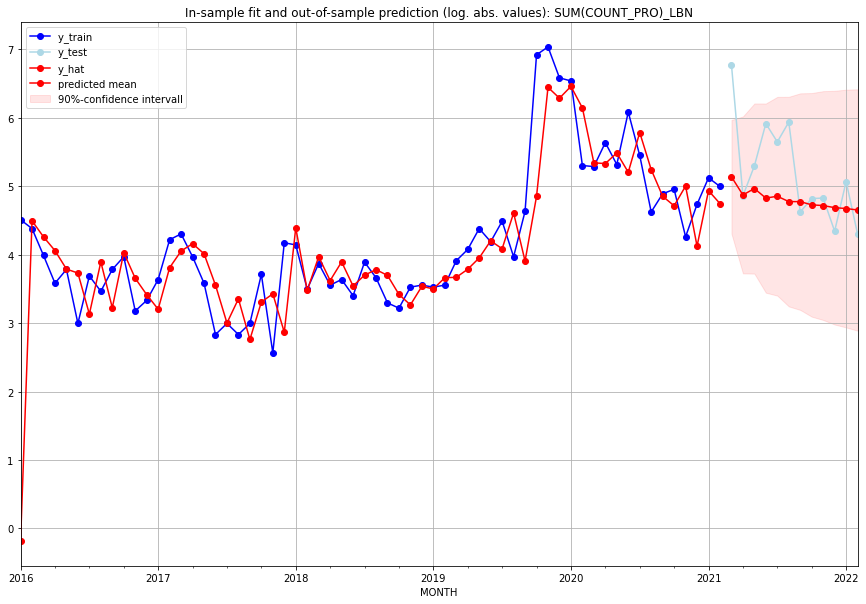

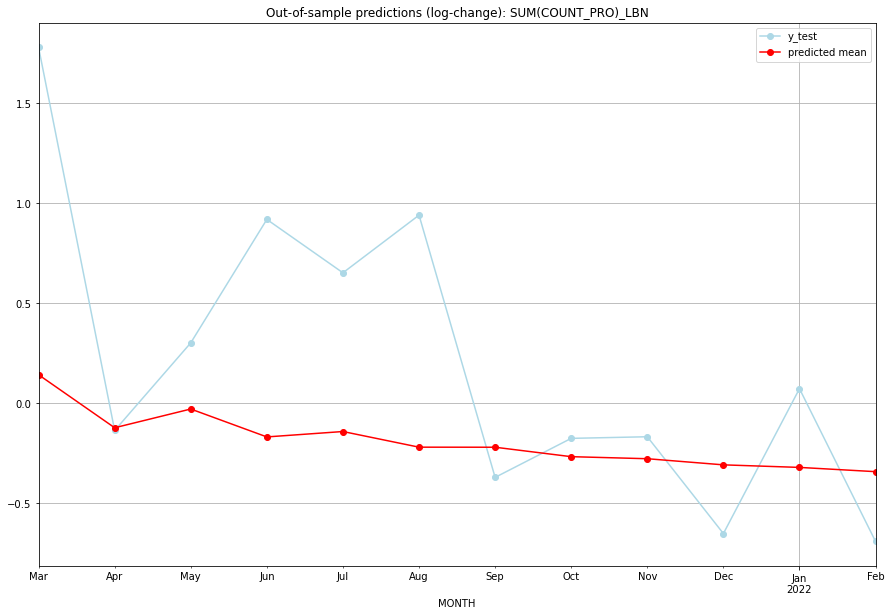

TADDA: 0.61283651096436
Evaluation finished.
        MONTH    FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  169.483822       877.0      0.141428        1.780434   LBN   
1  2021-04-01  129.761413       128.0     -0.123838       -0.137400   LBN   
2  2021-05-01  142.619065       199.0     -0.030048        0.301105   LBN   
3  2021-06-01  123.896732       370.0     -0.169725        0.918990   LBN   
4  2021-07-01  127.314484       283.0     -0.142728        0.651762   LBN   
5  2021-08-01  117.648868       378.0     -0.221044        0.940324   LBN   
6  2021-09-01  117.611566       101.0     -0.221358       -0.372239   LBN   
7  2021-10-01  112.138822       123.0     -0.268597       -0.176931   LBN   
8  2021-11-01  110.985247       124.0     -0.278845       -0.168899   LBN   
9  2021-12-01  107.599995        76.0     -0.309541       -0.653407   LBN   
10 2022-01-01  106.220664       158.0     -0.322323        0.071692   LBN   
11 2022-02-01  103.958644      

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [3, (1, 1, 2), (0, 0, 0, 0), 'n'], 'cv_score': 0.44784270178783164, 'fold_results': [0.44784270178783164]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_LBR   No. Observations:                  289
Model:               SARIMAX(1, 1, 2)   Log Likelihood                -225.942
Date:                Fri, 16 Sep 2022   AIC                            465.884
Time:                        14:25:59   BIC                            491.525
Sample:                    02-28-1997   HQIC                           476.159
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            -0.0064      0.020     -0.314      0.753 

<Figure size 432x288 with 0 Axes>

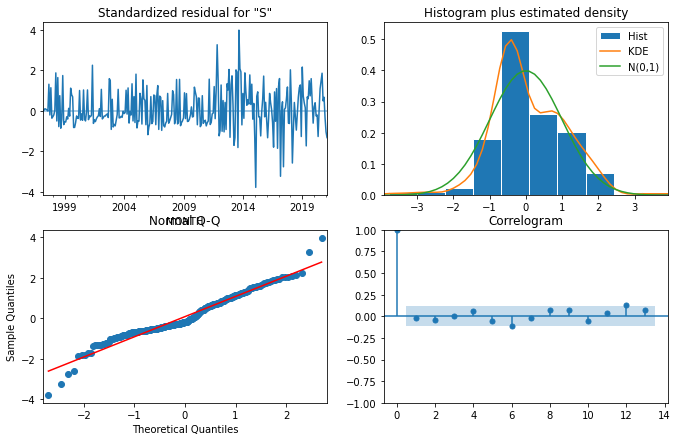

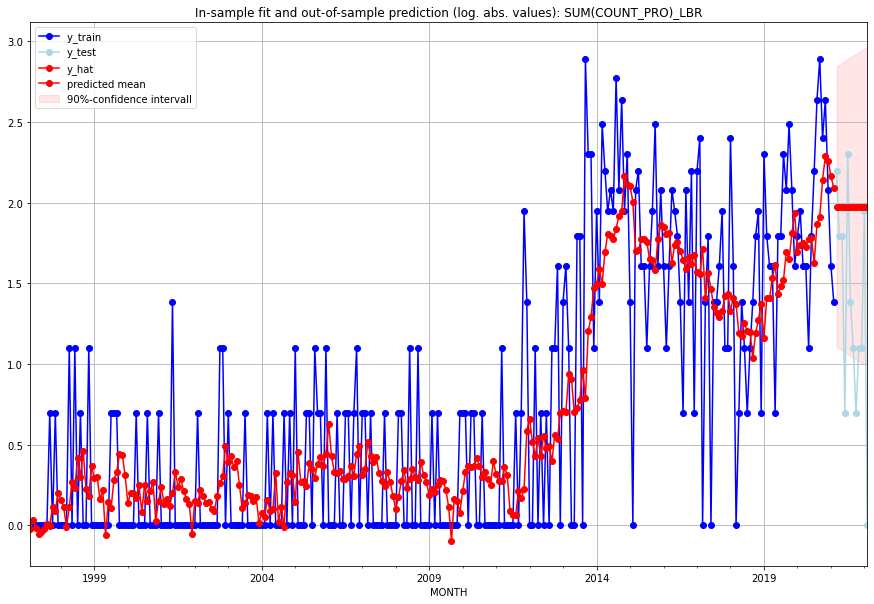

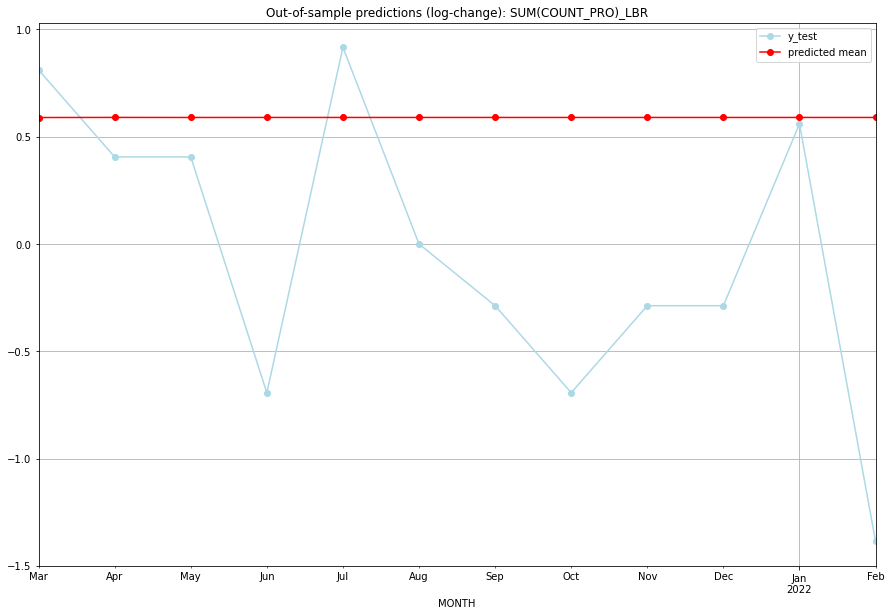

TADDA: 1.020439810769309
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  6.209922         8.0      0.589164        0.810930   LBR   
1  2021-04-01  6.213192         5.0      0.589617        0.405465   LBR   
2  2021-05-01  6.211513         5.0      0.589384        0.405465   LBR   
3  2021-06-01  6.212375         1.0      0.589504       -0.693147   LBR   
4  2021-07-01  6.211932         9.0      0.589443        0.916291   LBR   
5  2021-08-01  6.212160         3.0      0.589474        0.000000   LBR   
6  2021-09-01  6.212043         2.0      0.589458       -0.287682   LBR   
7  2021-10-01  6.212103         1.0      0.589466       -0.693147   LBR   
8  2021-11-01  6.212072         2.0      0.589462       -0.287682   LBR   
9  2021-12-01  6.212088         2.0      0.589464       -0.287682   LBR   
10 2022-01-01  6.212080         6.0      0.589463        0.559616   LBR   
11 2022-02-01  6.212084         0.0      0.589464     

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [1, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.49308669046865194, 'fold_results': [0.49308669046865194]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_LBY   No. Observations:                  289
Model:                        SARIMAX   Log Likelihood                -463.517
Date:                Fri, 16 Sep 2022   AIC                            931.035
Time:                        14:26:40   BIC                            938.368
Sample:                    02-28-1997   HQIC                           933.973
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1             0.2509      0.019     12.945      0.000 

<Figure size 432x288 with 0 Axes>

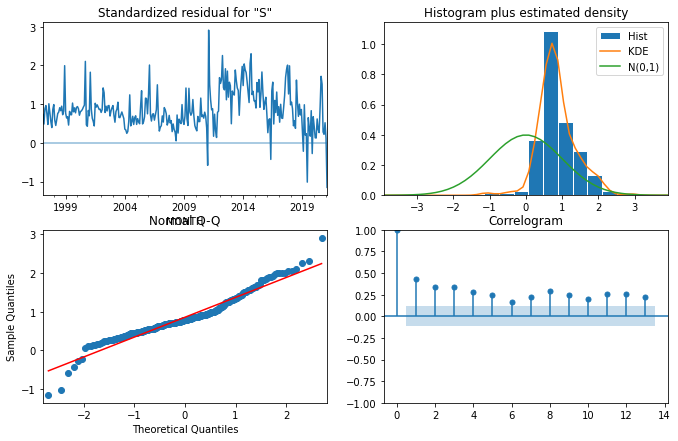

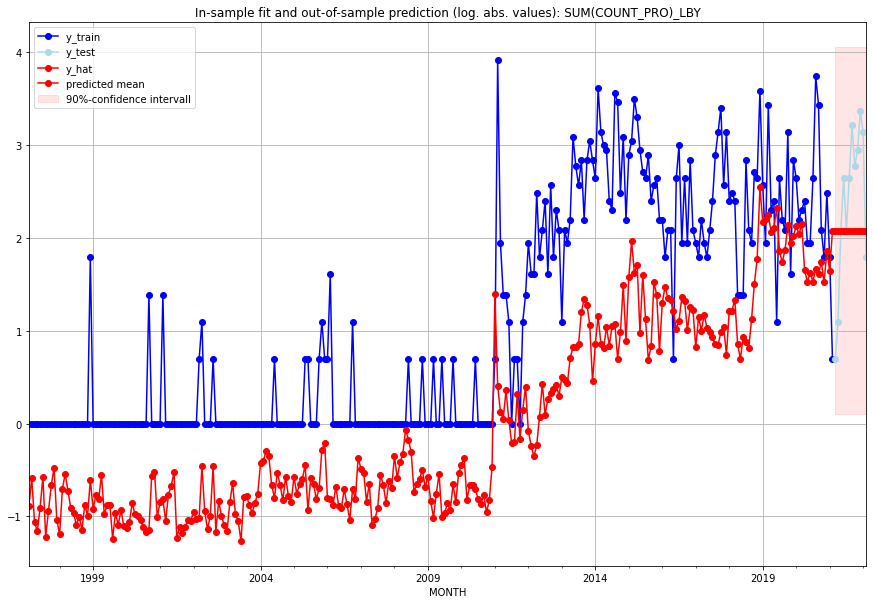

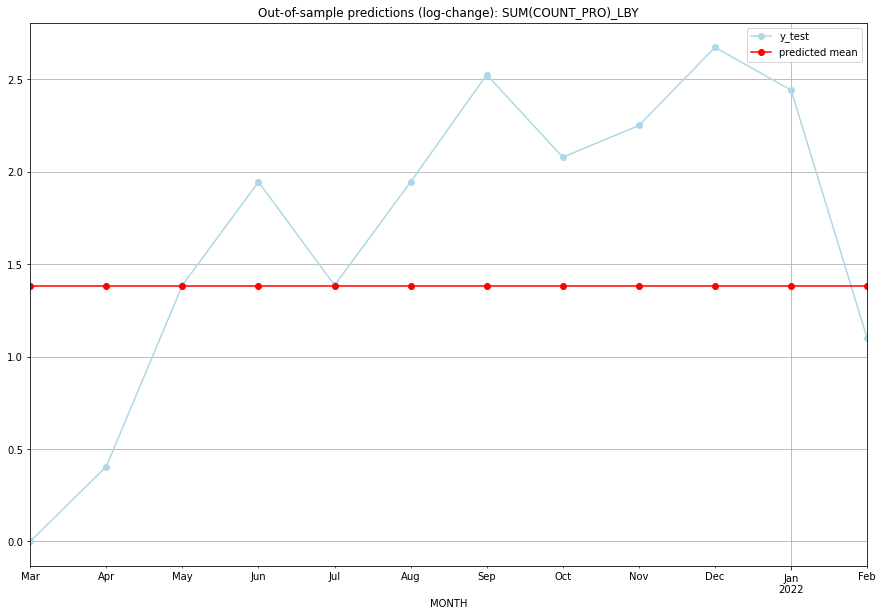

TADDA: 0.7359711418488155
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  6.978521         1.0      1.383606        0.000000   LBY   
1  2021-04-01  6.978521         2.0      1.383606        0.405465   LBY   
2  2021-05-01  6.978521         7.0      1.383606        1.386294   LBY   
3  2021-06-01  6.978521        13.0      1.383606        1.945910   LBY   
4  2021-07-01  6.978521         7.0      1.383606        1.386294   LBY   
5  2021-08-01  6.978521        13.0      1.383606        1.945910   LBY   
6  2021-09-01  6.978521        24.0      1.383606        2.525729   LBY   
7  2021-10-01  6.978521        15.0      1.383606        2.079442   LBY   
8  2021-11-01  6.978521        18.0      1.383606        2.251292   LBY   
9  2021-12-01  6.978521        28.0      1.383606        2.674149   LBY   
10 2022-01-01  6.978521        22.0      1.383606        2.442347   LBY   
11 2022-02-01  6.978521         5.0      1.383606    

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (2, 1, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.38603669653060774, 'fold_results': [0.38603669653060774]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_LCA   No. Observations:                   38
Model:               SARIMAX(2, 1, 3)   Log Likelihood                 -11.567
Date:                Fri, 16 Sep 2022   AIC                             35.134
Time:                        14:26:58   BIC                             44.799
Sample:                    01-31-2018   HQIC                            38.541
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -1.0689      0.200     -5.348      0.000 

<Figure size 432x288 with 0 Axes>

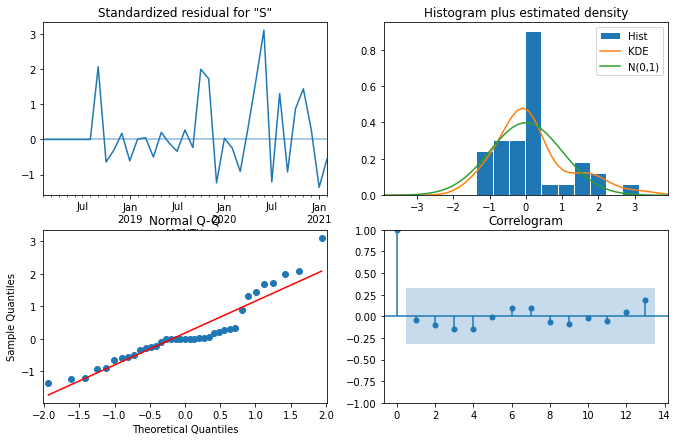

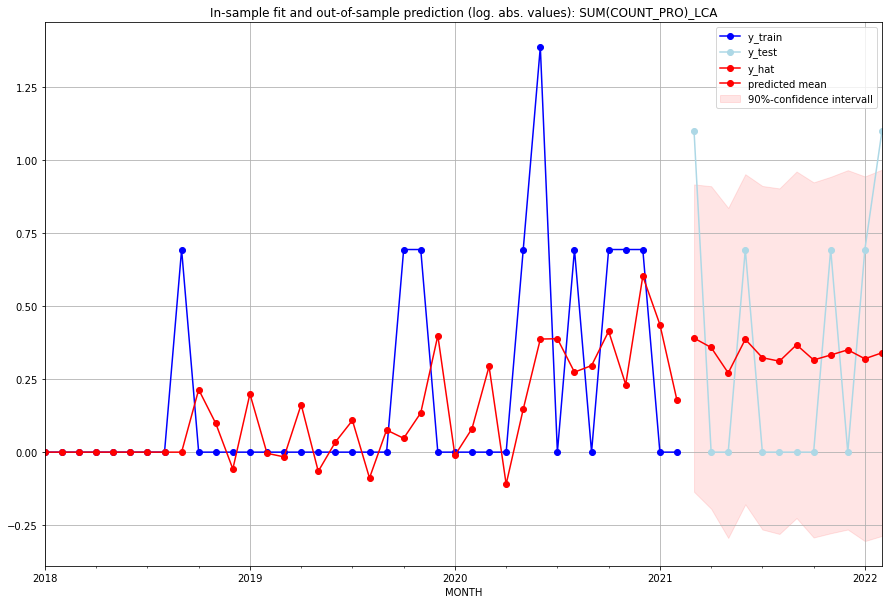

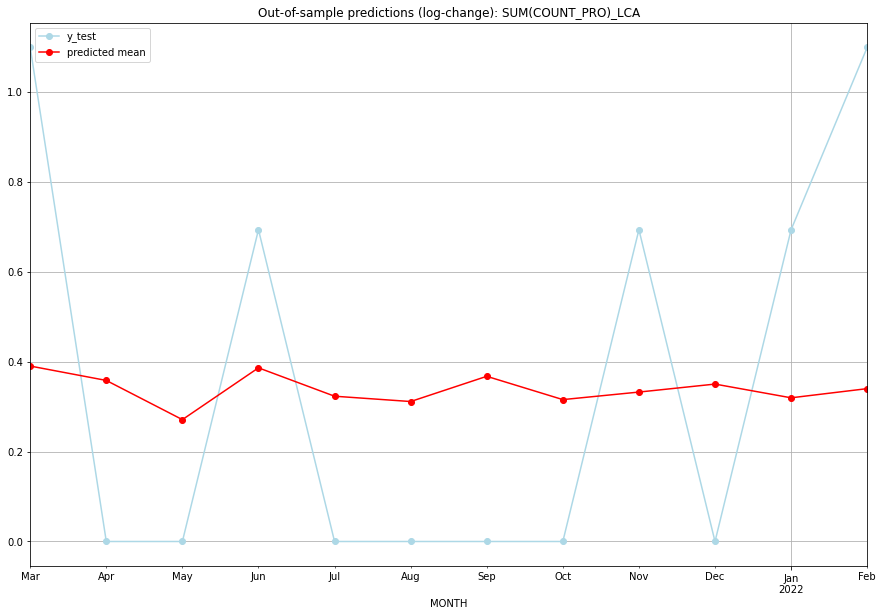

TADDA: 0.4003994162967268
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  0.477016         2.0      0.390024        1.098612   LCA   
1  2021-04-01  0.430524         0.0      0.358041        0.000000   LCA   
2  2021-05-01  0.311178         0.0      0.270926        0.000000   LCA   
3  2021-06-01  0.471179         1.0      0.386064        0.693147   LCA   
4  2021-07-01  0.381215         0.0      0.322963        0.000000   LCA   
5  2021-08-01  0.364991         0.0      0.311148        0.000000   LCA   
6  2021-09-01  0.443714         0.0      0.367219        0.000000   LCA   
7  2021-10-01  0.370831         0.0      0.315417        0.000000   LCA   
8  2021-11-01  0.394015         1.0      0.332188        0.693147   LCA   
9  2021-12-01  0.418959         0.0      0.349923        0.000000   LCA   
10 2022-01-01  0.376329         1.0      0.319420        0.693147   LCA   
11 2022-02-01  0.404689         2.0      0.339816    

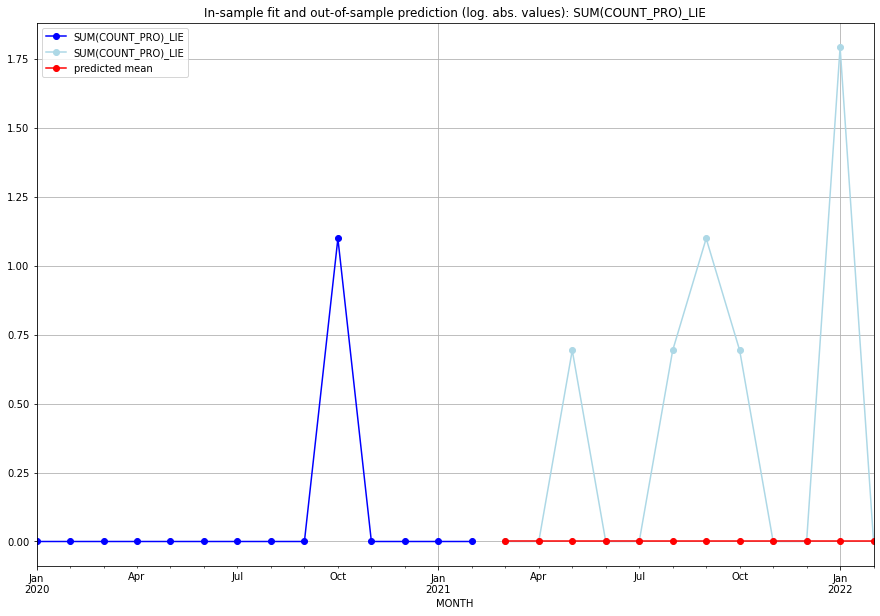

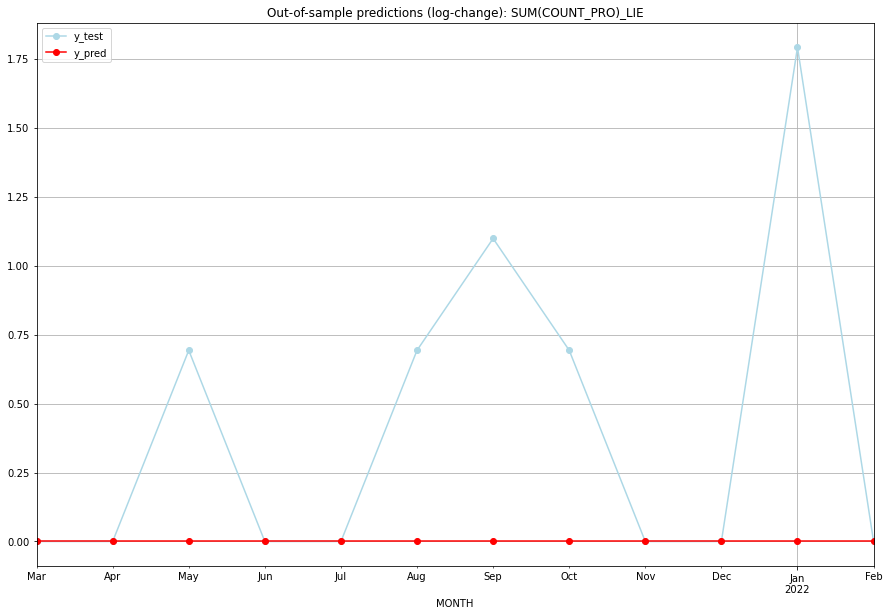

TADDA: 0.41415110829800006
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0    0.000000           0.0        0.000000   LIE   
1  2021-04-01       0.0    0.000000           0.0        0.000000   LIE   
2  2021-05-01       0.0    0.693147           0.0        0.693147   LIE   
3  2021-06-01       0.0    0.000000           0.0        0.000000   LIE   
4  2021-07-01       0.0    0.000000           0.0        0.000000   LIE   
5  2021-08-01       0.0    0.693147           0.0        0.693147   LIE   
6  2021-09-01       0.0    1.098612           0.0        1.098612   LIE   
7  2021-10-01       0.0    0.693147           0.0        0.693147   LIE   
8  2021-11-01       0.0    0.000000           0.0        0.000000   LIE   
9  2021-12-01       0.0    0.000000           0.0        0.000000   LIE   
10 2022-01-01       0.0    1.791759           0.0        1.791759   LIE   
11 2022-02-01       0.0    0.000000           0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [3, (3, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.6014341891521443, 'fold_results': [0.6014341891521443]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_LKA   No. Observations:                  134
Model:               SARIMAX(3, 0, 0)   Log Likelihood                 -98.717
Date:                Fri, 16 Sep 2022   AIC                            211.433
Time:                        14:27:42   BIC                            231.718
Sample:                    01-31-2010   HQIC                           219.676
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1             0.0723      0.074      0.981      0.326   

<Figure size 432x288 with 0 Axes>

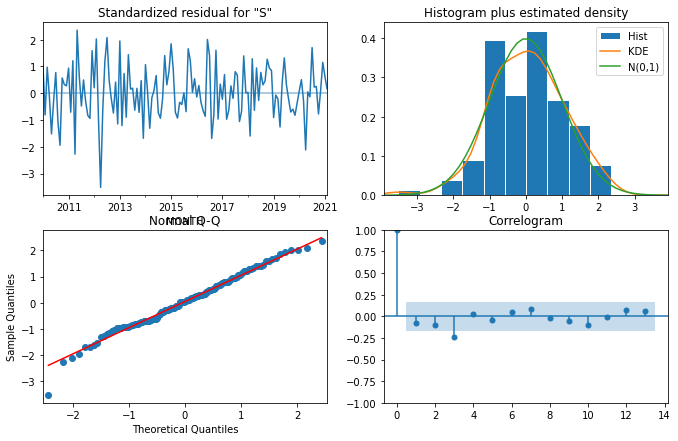

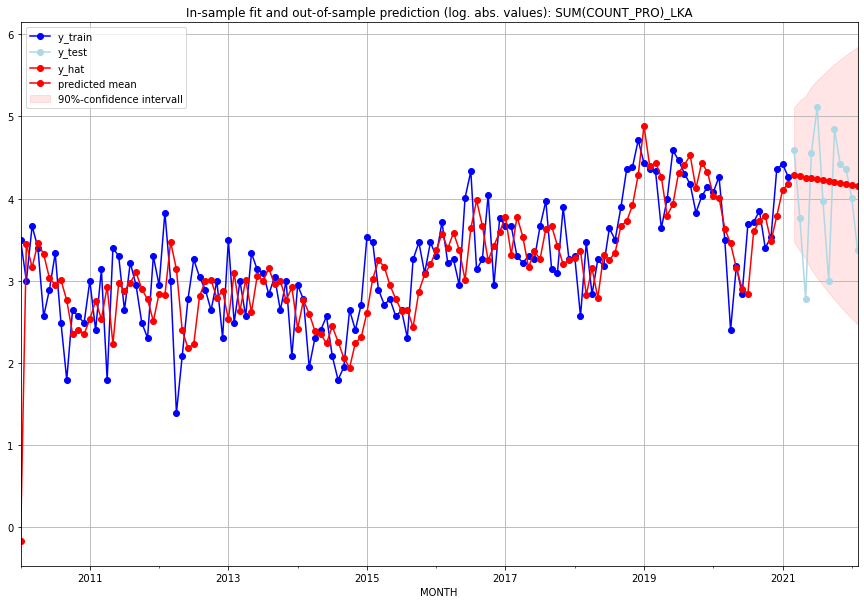

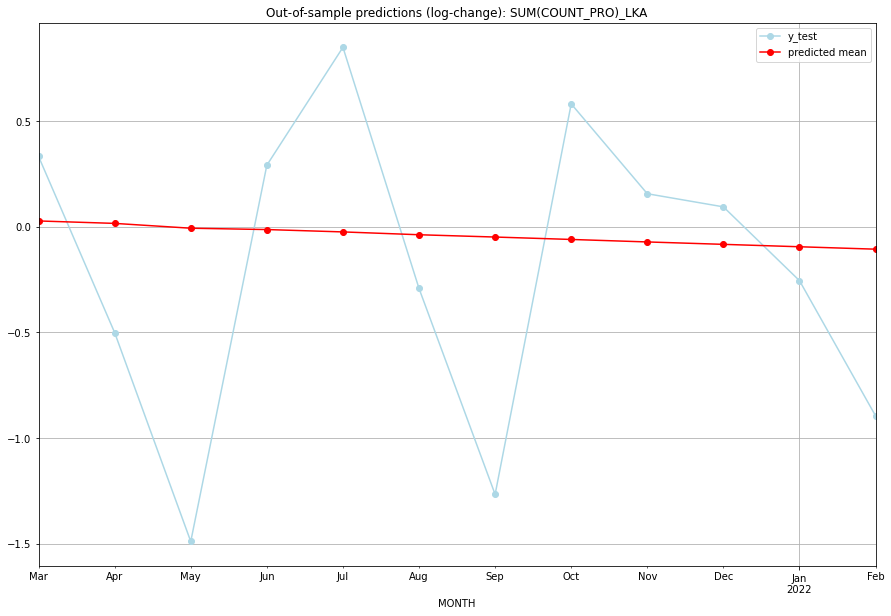

TADDA: 0.6019197697091038
Evaluation finished.
        MONTH   FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  71.963576        98.0      0.027280        0.332440   LKA   
1  2021-04-01  71.128452        42.0      0.015769       -0.501480   LKA   
2  2021-05-01  69.499066        15.0     -0.007080       -1.490091   LKA   
3  2021-06-01  69.053626        94.0     -0.013419        0.291197   LKA   
4  2021-07-01  68.274721       165.0     -0.024600        0.849308   LKA   
5  2021-08-01  67.354305        52.0     -0.037975       -0.292388   LKA   
6  2021-09-01  66.614998        19.0     -0.048850       -1.266948   LKA   
7  2021-10-01  65.847338       126.0     -0.060268        0.581507   LKA   
8  2021-11-01  65.063963        82.0     -0.072056        0.156161   LKA   
9  2021-12-01  64.315845        77.0     -0.083445        0.094029   LKA   
10 2022-01-01  63.574482        54.0     -0.094861       -0.255347   LKA   
11 2022-02-01  62.839368        28.0     

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (2, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.5079705774991825, 'fold_results': [0.5079705774991825]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_LSO   No. Observations:                  289
Model:               SARIMAX(2, 0, 0)   Log Likelihood                 -81.035
Date:                Fri, 16 Sep 2022   AIC                            168.070
Time:                        14:28:26   BIC                            179.070
Sample:                    02-28-1997   HQIC                           172.478
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.2409      0.036      6.697      0.000   

<Figure size 432x288 with 0 Axes>

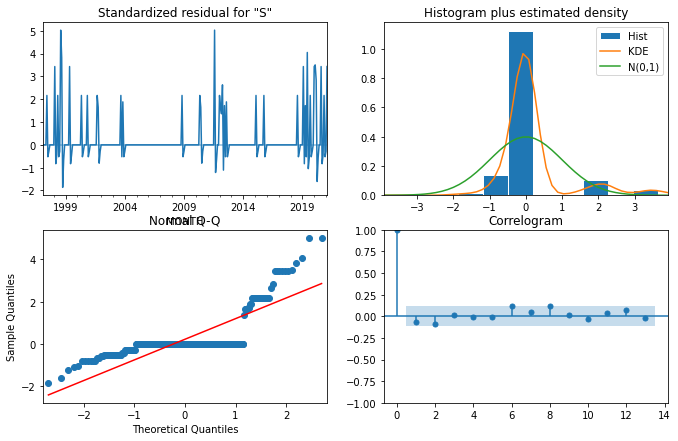

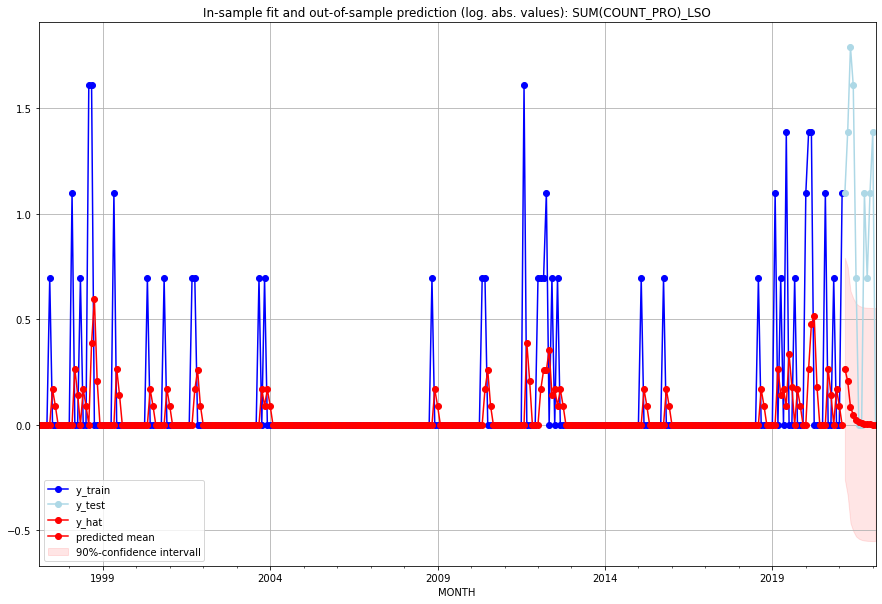

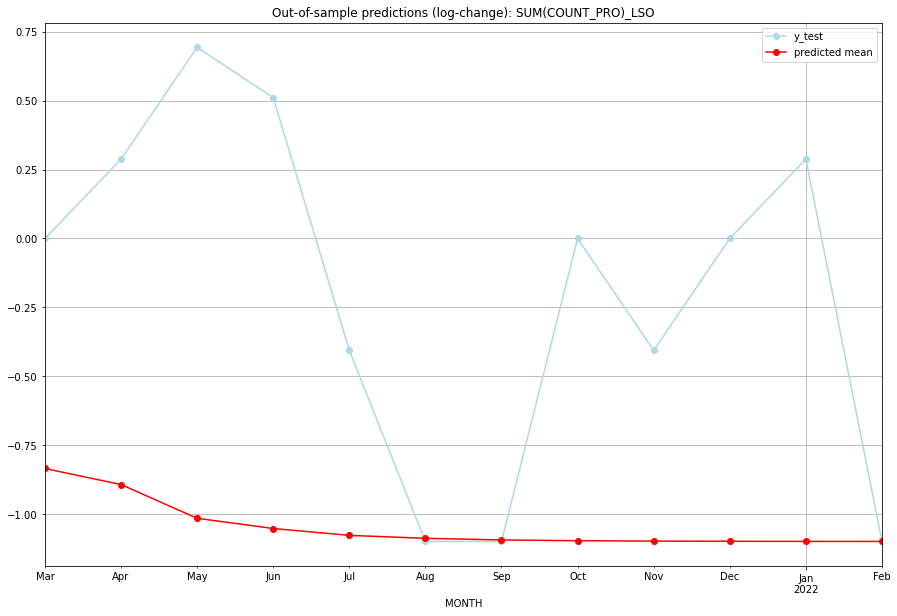

TADDA: 1.1916465584601126
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  0.302982         2.0     -0.833956        0.000000   LSO   
1  2021-04-01  0.229315         3.0     -0.892155        0.287682   LSO   
2  2021-05-01  0.087751         5.0     -1.014500        0.693147   LSO   
3  2021-06-01  0.048206         4.0     -1.051533        0.510826   LSO   
4  2021-07-01  0.022517         1.0     -1.076345       -0.405465   LSO   
5  2021-08-01  0.011546         0.0     -1.087133       -1.098612   LSO   
6  2021-09-01  0.005674         0.0     -1.092955       -1.098612   LSO   
7  2021-10-01  0.002858         2.0     -1.095758        0.000000   LSO   
8  2021-11-01  0.001423         1.0     -1.097190       -0.405465   LSO   
9  2021-12-01  0.000714         2.0     -1.097899        0.000000   LSO   
10 2022-01-01  0.000357         3.0     -1.098256        0.287682   LSO   
11 2022-02-01  0.000179         0.0     -1.098434    

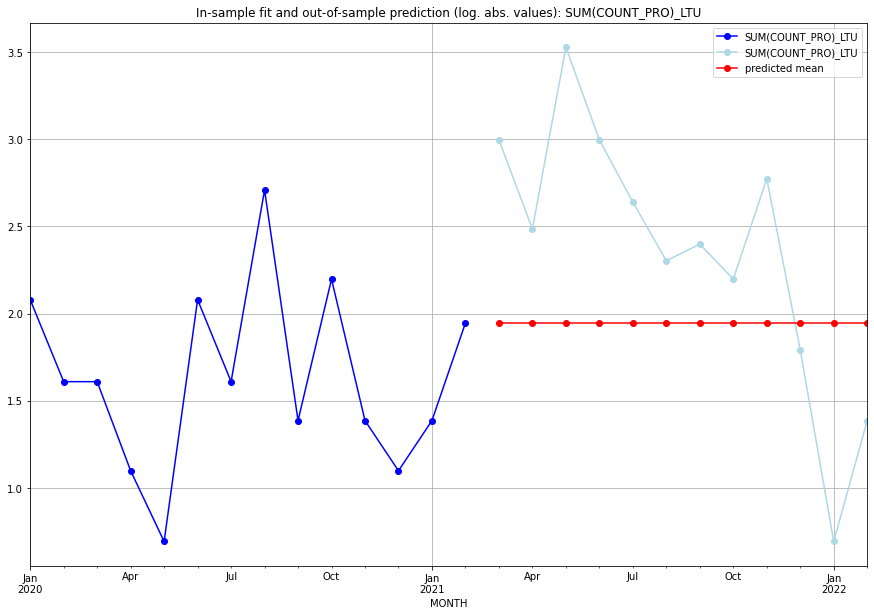

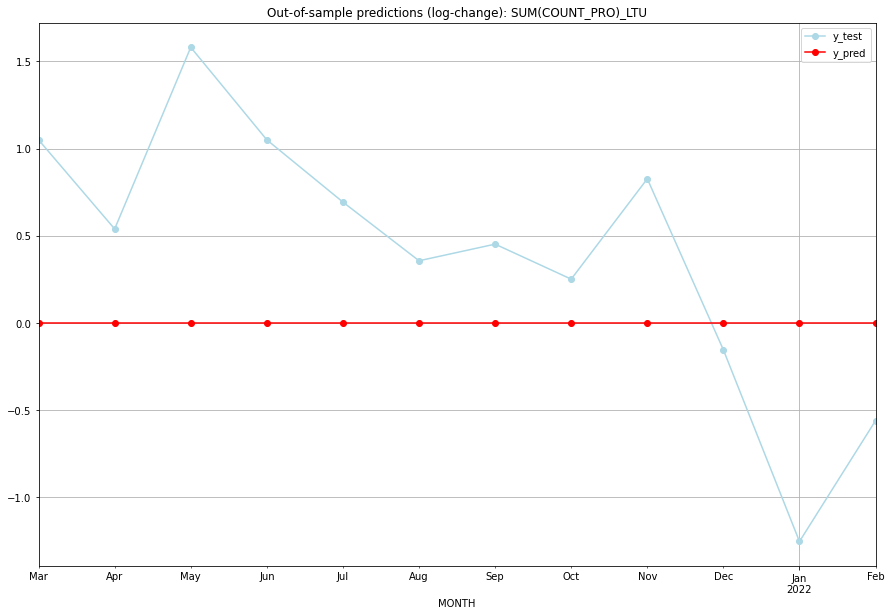

TADDA: 0.7304517342713378
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01   1.94591    2.995732           0.0        1.049822   LTU   
1  2021-04-01   1.94591    2.484907           0.0        0.538997   LTU   
2  2021-05-01   1.94591    3.526361           0.0        1.580450   LTU   
3  2021-06-01   1.94591    2.995732           0.0        1.049822   LTU   
4  2021-07-01   1.94591    2.639057           0.0        0.693147   LTU   
5  2021-08-01   1.94591    2.302585           0.0        0.356675   LTU   
6  2021-09-01   1.94591    2.397895           0.0        0.451985   LTU   
7  2021-10-01   1.94591    2.197225           0.0        0.251314   LTU   
8  2021-11-01   1.94591    2.772589           0.0        0.826679   LTU   
9  2021-12-01   1.94591    1.791759           0.0       -0.154151   LTU   
10 2022-01-01   1.94591    0.693147           0.0       -1.252763   LTU   
11 2022-02-01   1.94591    1.386294           0.0    

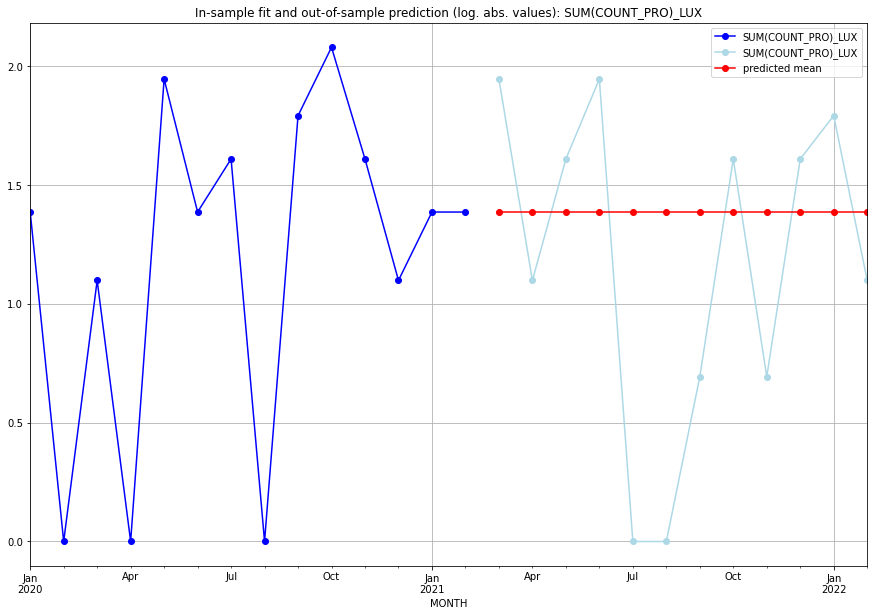

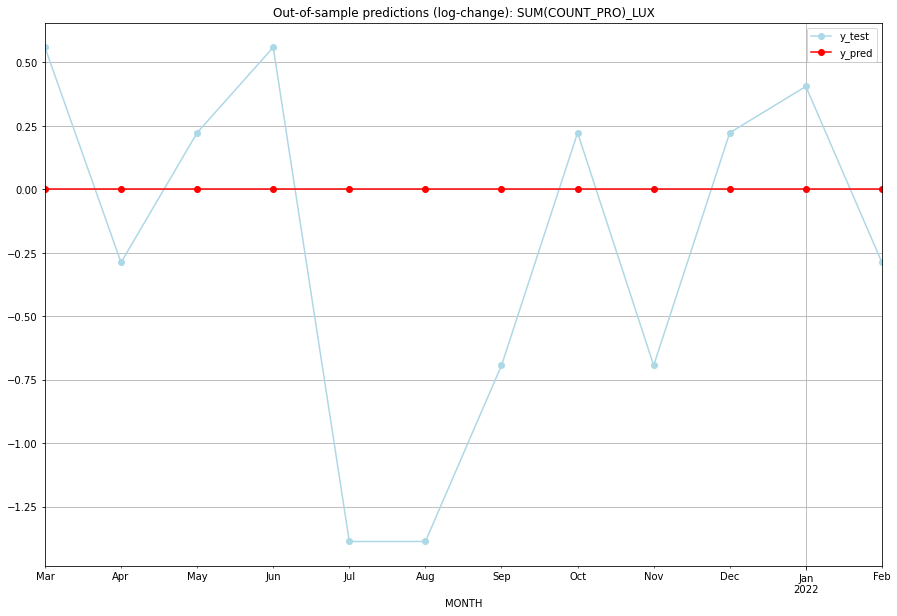

TADDA: 0.5773645471820726
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  1.386294    1.945910           0.0        0.559616   LUX   
1  2021-04-01  1.386294    1.098612           0.0       -0.287682   LUX   
2  2021-05-01  1.386294    1.609438           0.0        0.223144   LUX   
3  2021-06-01  1.386294    1.945910           0.0        0.559616   LUX   
4  2021-07-01  1.386294    0.000000           0.0       -1.386294   LUX   
5  2021-08-01  1.386294    0.000000           0.0       -1.386294   LUX   
6  2021-09-01  1.386294    0.693147           0.0       -0.693147   LUX   
7  2021-10-01  1.386294    1.609438           0.0        0.223144   LUX   
8  2021-11-01  1.386294    0.693147           0.0       -0.693147   LUX   
9  2021-12-01  1.386294    1.609438           0.0        0.223144   LUX   
10 2022-01-01  1.386294    1.791759           0.0        0.405465   LUX   
11 2022-02-01  1.386294    1.098612           0.0    

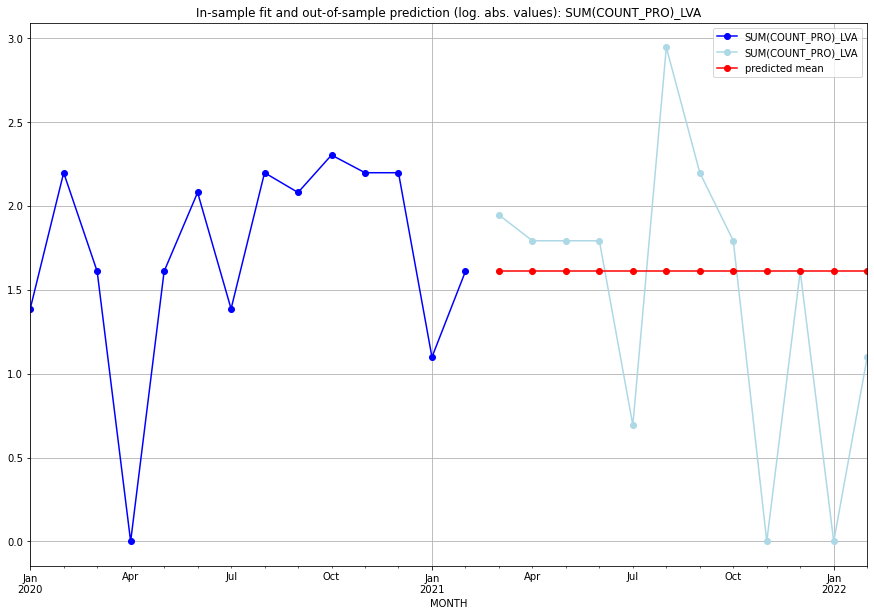

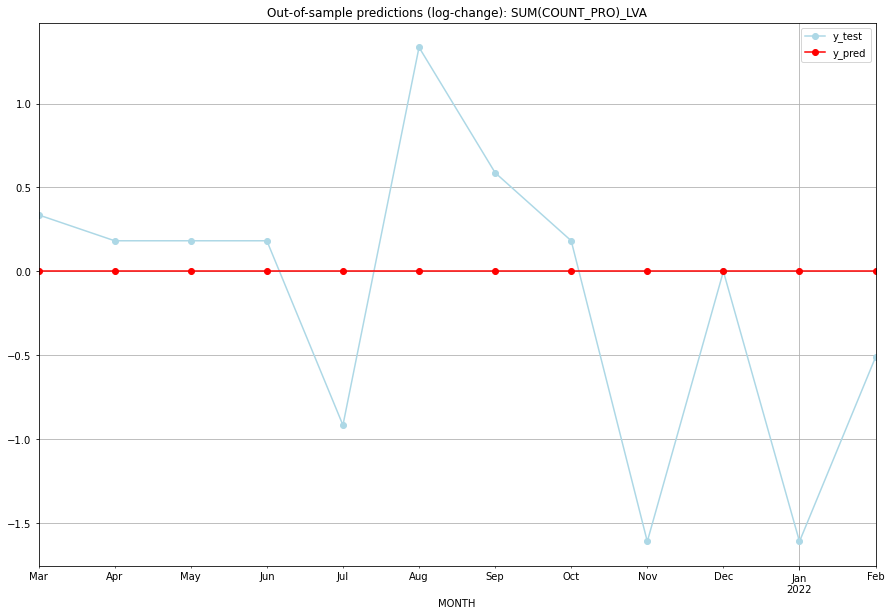

TADDA: 0.6362115313283196
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  1.609438    1.945910           0.0        0.336472   LVA   
1  2021-04-01  1.609438    1.791759           0.0        0.182322   LVA   
2  2021-05-01  1.609438    1.791759           0.0        0.182322   LVA   
3  2021-06-01  1.609438    1.791759           0.0        0.182322   LVA   
4  2021-07-01  1.609438    0.693147           0.0       -0.916291   LVA   
5  2021-08-01  1.609438    2.944439           0.0        1.335001   LVA   
6  2021-09-01  1.609438    2.197225           0.0        0.587787   LVA   
7  2021-10-01  1.609438    1.791759           0.0        0.182322   LVA   
8  2021-11-01  1.609438    0.000000           0.0       -1.609438   LVA   
9  2021-12-01  1.609438    1.609438           0.0        0.000000   LVA   
10 2022-01-01  1.609438    0.000000           0.0       -1.609438   LVA   
11 2022-02-01  1.609438    1.098612           0.0    

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.057762265046662105, 'fold_results': [0.057762265046662105]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_MAC   No. Observations:                   38
Model:                        SARIMAX   Log Likelihood                 -30.472
Date:                Fri, 16 Sep 2022   AIC                             62.945
Time:                        14:29:01   BIC                             64.582
Sample:                    01-31-2018   HQIC                            63.527
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.2911      0.049      5.989      0.00

<Figure size 432x288 with 0 Axes>

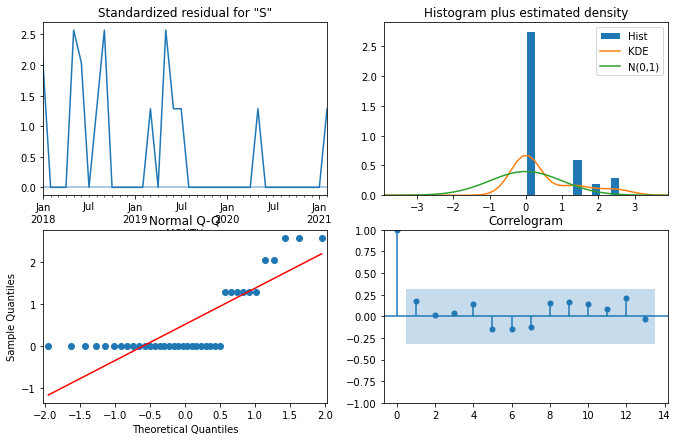

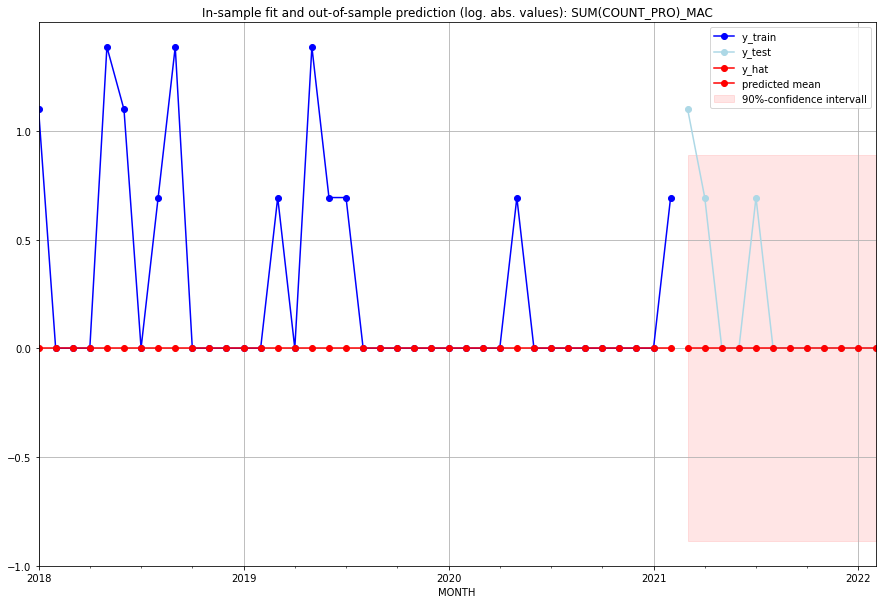

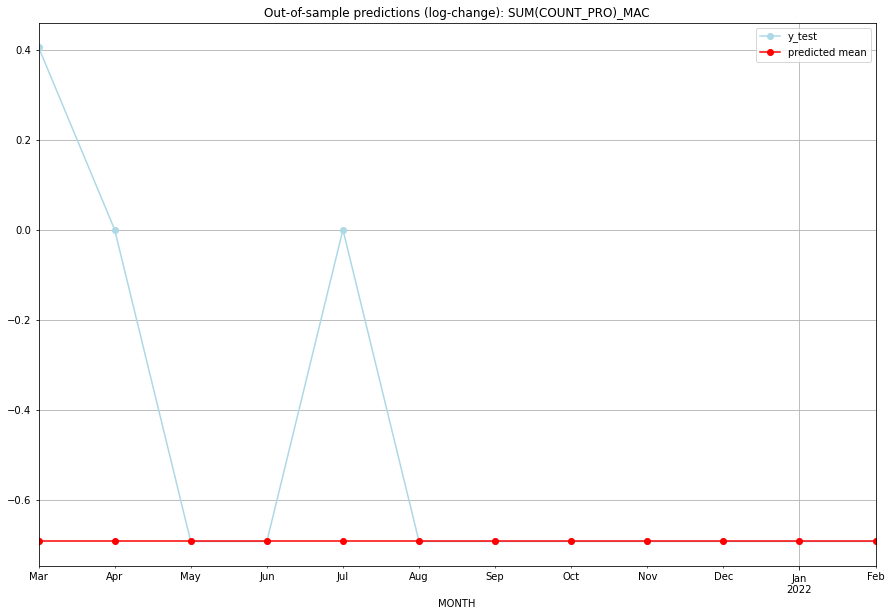

TADDA: 0.2648378191956621
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         2.0     -0.693147        0.405465   MAC   
1  2021-04-01       0.0         1.0     -0.693147        0.000000   MAC   
2  2021-05-01       0.0         0.0     -0.693147       -0.693147   MAC   
3  2021-06-01       0.0         0.0     -0.693147       -0.693147   MAC   
4  2021-07-01       0.0         1.0     -0.693147        0.000000   MAC   
5  2021-08-01       0.0         0.0     -0.693147       -0.693147   MAC   
6  2021-09-01       0.0         0.0     -0.693147       -0.693147   MAC   
7  2021-10-01       0.0         0.0     -0.693147       -0.693147   MAC   
8  2021-11-01       0.0         0.0     -0.693147       -0.693147   MAC   
9  2021-12-01       0.0         0.0     -0.693147       -0.693147   MAC   
10 2022-01-01       0.0         0.0     -0.693147       -0.693147   MAC   
11 2022-02-01       0.0         0.0     -0.693147    

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [3, (2, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.6208592422807483, 'fold_results': [0.6208592422807483]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_MAR   No. Observations:                  289
Model:               SARIMAX(2, 1, 0)   Log Likelihood                -258.586
Date:                Fri, 16 Sep 2022   AIC                            529.173
Time:                        14:29:35   BIC                            551.150
Sample:                    02-28-1997   HQIC                           537.980
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1             0.0191      0.041      0.462      0.644   

<Figure size 432x288 with 0 Axes>

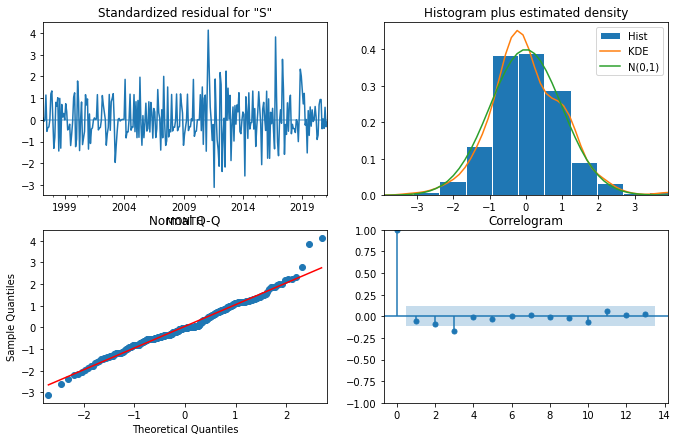

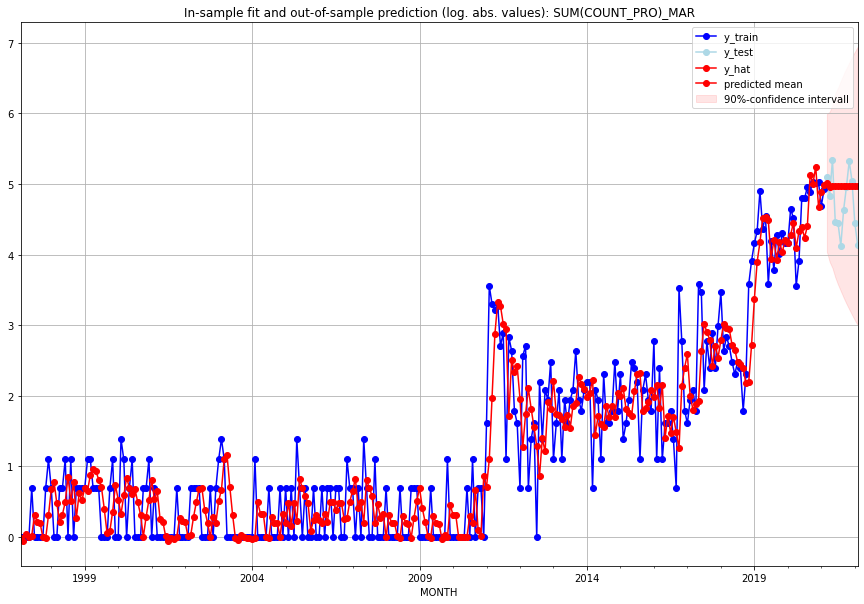

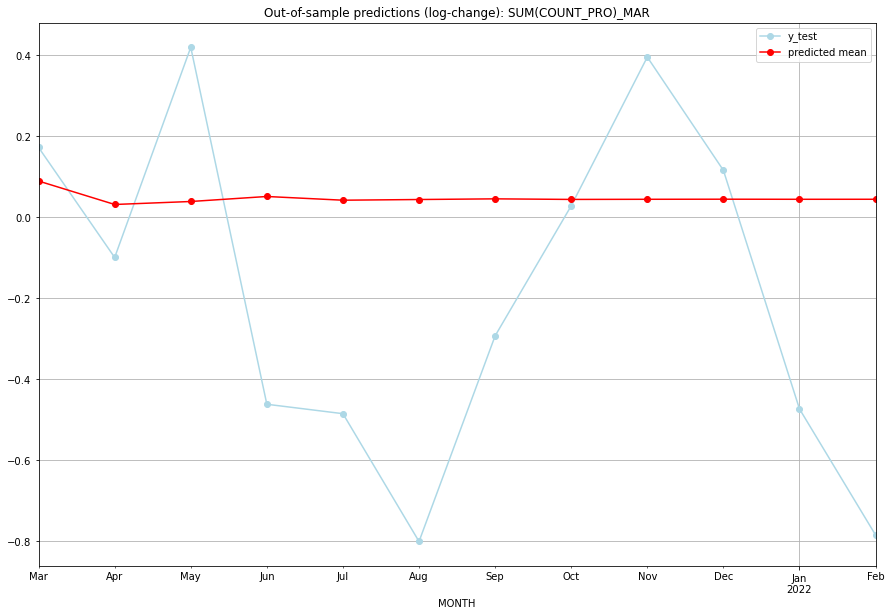

TADDA: 0.4088673100731337
Evaluation finished.
        MONTH    FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  149.954610       163.0      0.089726        0.172613   MAR   
1  2021-04-01  141.466840       124.0      0.031856       -0.098940   MAR   
2  2021-05-01  142.518442       209.0      0.039210        0.419854   MAR   
3  2021-06-01  144.303652        86.0      0.051572       -0.461346   MAR   
4  2021-07-01  142.978720        84.0      0.042412       -0.484602   MAR   
5  2021-08-01  143.222357        61.0      0.044103       -0.800119   MAR   
6  2021-09-01  143.461418       102.0      0.045759       -0.292525   MAR   
7  2021-10-01  143.255116       141.0      0.044330        0.028573   MAR   
8  2021-11-01  143.304421       204.0      0.044671        0.395756   MAR   
9  2021-12-01  143.335290       154.0      0.044885        0.116171   MAR   
10 2022-01-01  143.303559        85.0      0.044665       -0.472906   MAR   
11 2022-02-01  143.312836    

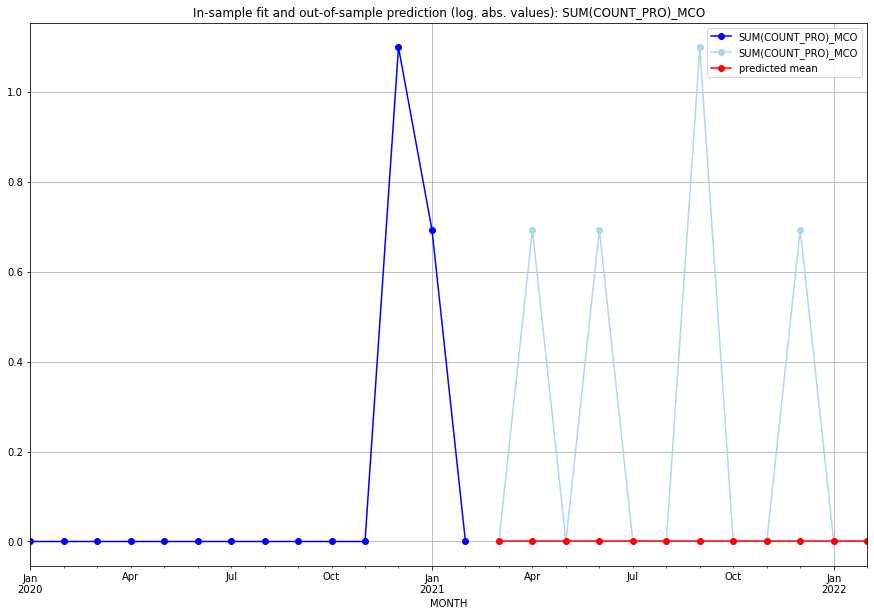

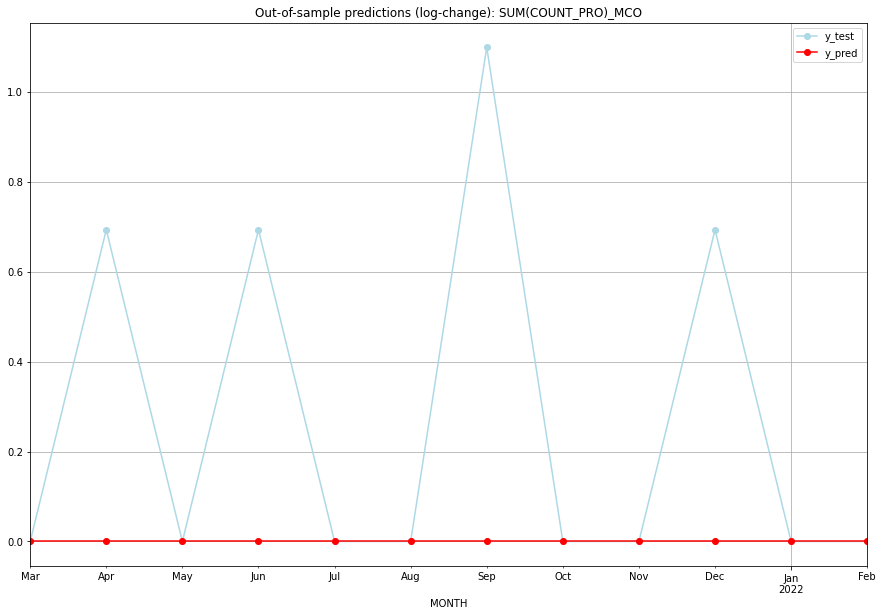

TADDA: 0.2648378191956621
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0    0.000000           0.0        0.000000   MCO   
1  2021-04-01       0.0    0.693147           0.0        0.693147   MCO   
2  2021-05-01       0.0    0.000000           0.0        0.000000   MCO   
3  2021-06-01       0.0    0.693147           0.0        0.693147   MCO   
4  2021-07-01       0.0    0.000000           0.0        0.000000   MCO   
5  2021-08-01       0.0    0.000000           0.0        0.000000   MCO   
6  2021-09-01       0.0    1.098612           0.0        1.098612   MCO   
7  2021-10-01       0.0    0.000000           0.0        0.000000   MCO   
8  2021-11-01       0.0    0.000000           0.0        0.000000   MCO   
9  2021-12-01       0.0    0.693147           0.0        0.693147   MCO   
10 2022-01-01       0.0    0.000000           0.0        0.000000   MCO   
11 2022-02-01       0.0    0.000000           0.0    

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (2, 1, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.6547074424440777, 'fold_results': [0.6547074424440777]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_MDA   No. Observations:                   38
Model:               SARIMAX(2, 1, 3)   Log Likelihood                 -30.486
Date:                Fri, 16 Sep 2022   AIC                             72.972
Time:                        14:30:10   BIC                             82.637
Sample:                    01-31-2018   HQIC                            76.379
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -1.4337      0.617     -2.326      0.020   

<Figure size 432x288 with 0 Axes>

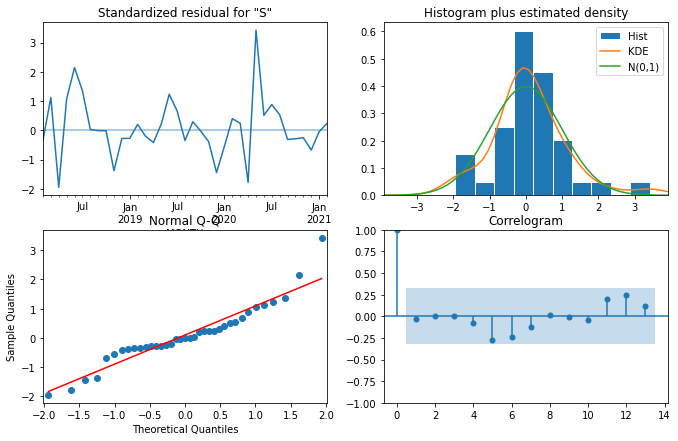

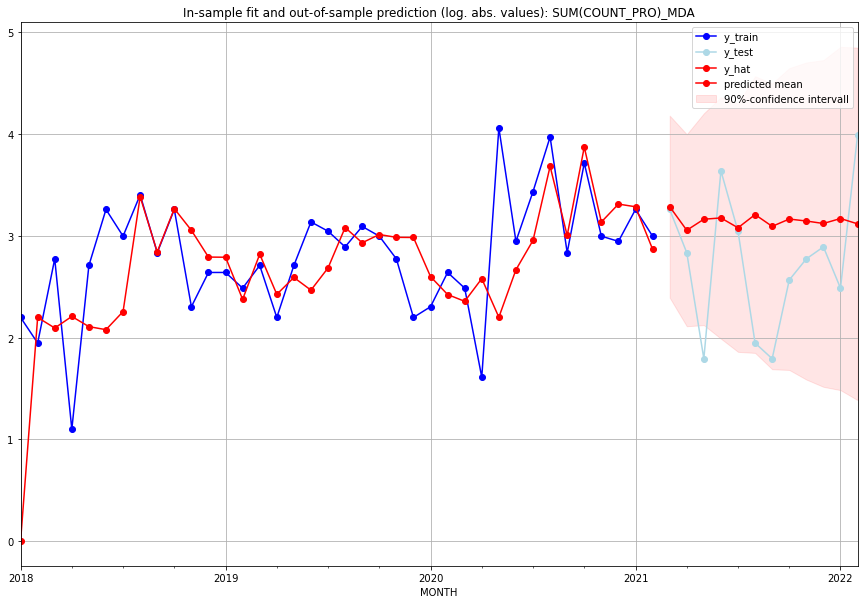

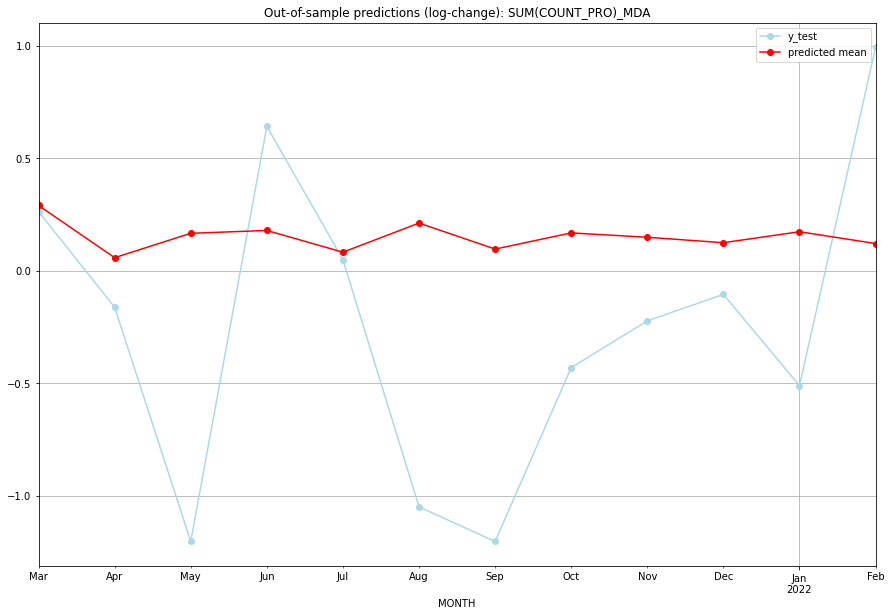

TADDA: 0.7149845404647085
Evaluation finished.
        MONTH   FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  25.726773        25.0      0.289934        0.262364   MDA   
1  2021-04-01  20.191542        16.0      0.057870       -0.162519   MDA   
2  2021-05-01  22.618912         5.0      0.166315       -1.203973   MDA   
3  2021-06-01  22.919215        37.0      0.178950        0.641854   MDA   
4  2021-07-01  20.715046        20.0      0.082273        0.048790   MDA   
5  2021-08-01  23.716255         6.0      0.211729       -1.049822   MDA   
6  2021-09-01  21.018715         5.0      0.096160       -1.203973   MDA   
7  2021-10-01  22.660427        12.0      0.168072       -0.430783   MDA   
8  2021-11-01  22.206328        15.0      0.148693       -0.223144   MDA   
9  2021-12-01  21.648957        17.0      0.124382       -0.105361   MDA   
10 2022-01-01  22.783889        11.0      0.173276       -0.510826   MDA   
11 2022-02-01  21.567676        53.0     

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (2, 1, 1), (0, 0, 0, 0), 'n'], 'cv_score': 0.2558226839826015, 'fold_results': [0.2558226839826015]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_MDG   No. Observations:                  289
Model:               SARIMAX(2, 1, 1)   Log Likelihood                -294.093
Date:                Fri, 16 Sep 2022   AIC                            596.185
Time:                        14:30:52   BIC                            610.837
Sample:                    02-28-1997   HQIC                           602.057
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.3762      0.044      8.526      0.000   

<Figure size 432x288 with 0 Axes>

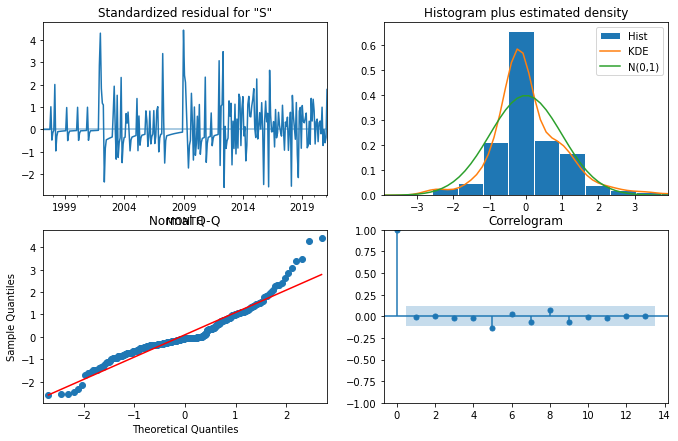

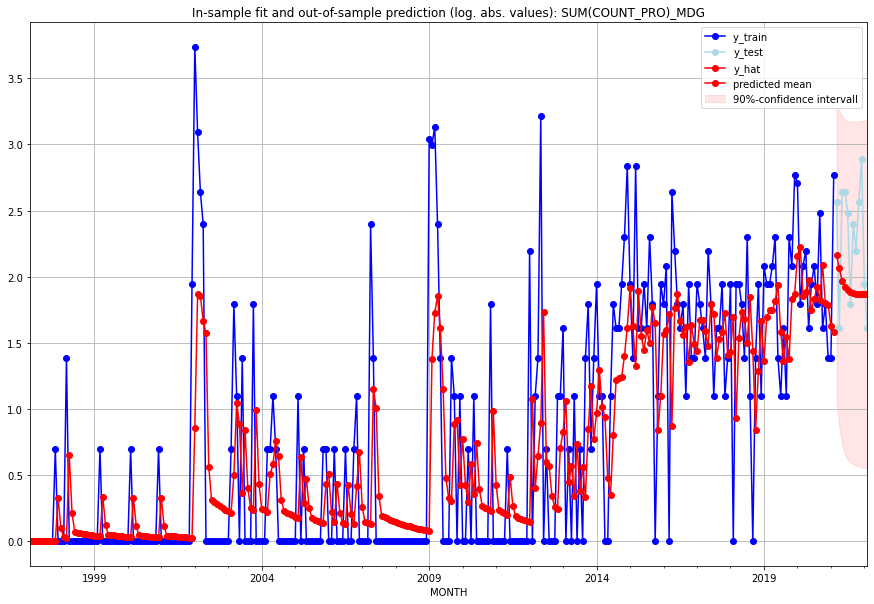

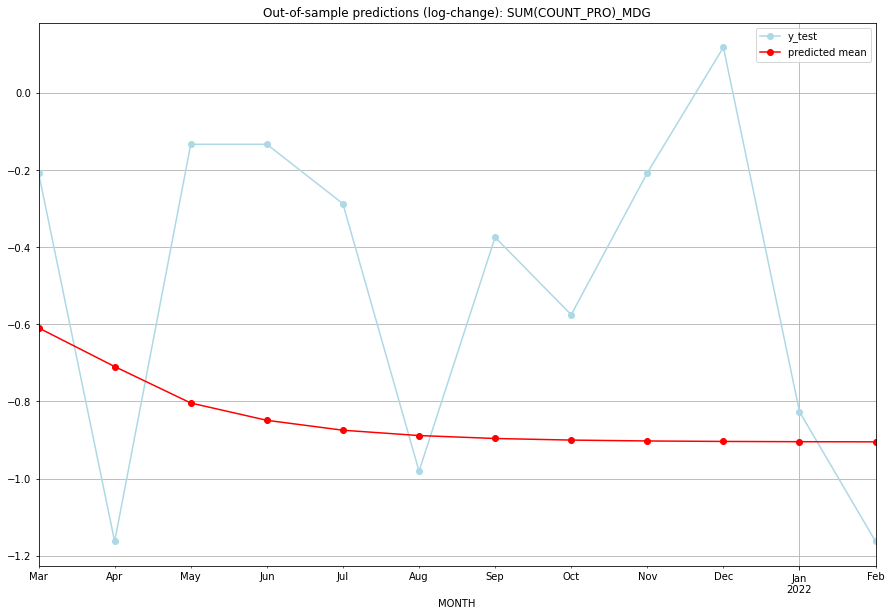

TADDA: 0.5602992756729831
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  7.698271        12.0     -0.609464       -0.207639   MDG   
1  2021-04-01  6.868387         4.0     -0.709736       -1.163151   MDG   
2  2021-05-01  6.159214        13.0     -0.804189       -0.133531   MDG   
3  2021-06-01  5.845082        13.0     -0.849058       -0.133531   MDG   
4  2021-07-01  5.671585        11.0     -0.874731       -0.287682   MDG   
5  2021-08-01  5.579916         5.0     -0.888567       -0.980829   MDG   
6  2021-09-01  5.530130        10.0     -0.896162       -0.374693   MDG   
7  2021-10-01  5.503117         8.0     -0.900307       -0.575364   MDG   
8  2021-11-01  5.488394        12.0     -0.902574       -0.207639   MDG   
9  2021-12-01  5.480363        17.0     -0.903812        0.117783   MDG   
10 2022-01-01  5.475977         6.0     -0.904489       -0.826679   MDG   
11 2022-02-01  5.473582         4.0     -0.904859    

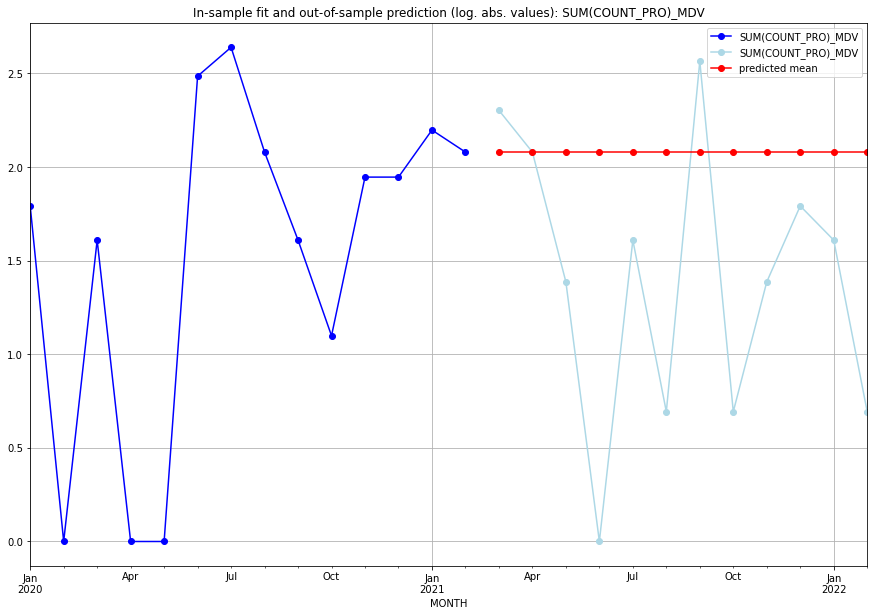

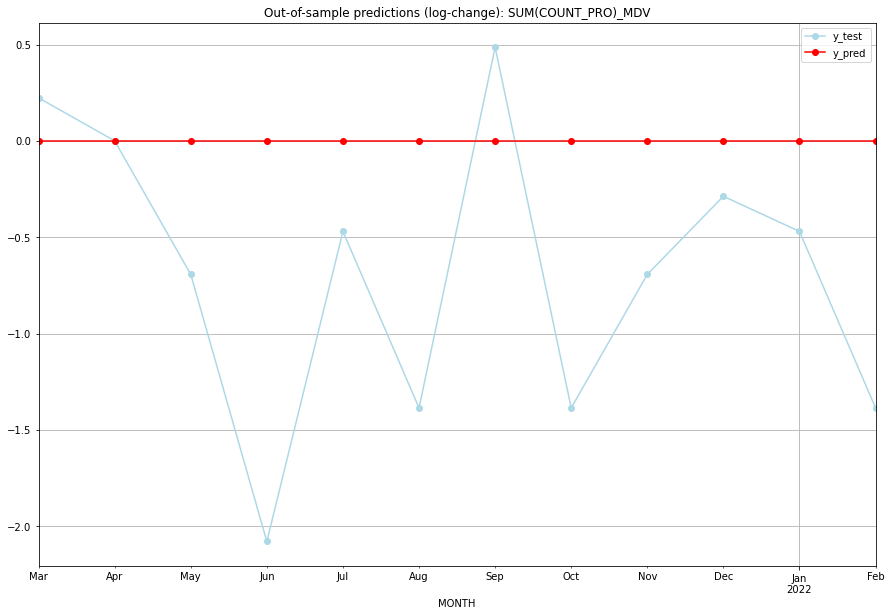

TADDA: 0.7967466403498801
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  2.079442    2.302585           0.0        0.223144   MDV   
1  2021-04-01  2.079442    2.079442           0.0        0.000000   MDV   
2  2021-05-01  2.079442    1.386294           0.0       -0.693147   MDV   
3  2021-06-01  2.079442    0.000000           0.0       -2.079442   MDV   
4  2021-07-01  2.079442    1.609438           0.0       -0.470004   MDV   
5  2021-08-01  2.079442    0.693147           0.0       -1.386294   MDV   
6  2021-09-01  2.079442    2.564949           0.0        0.485508   MDV   
7  2021-10-01  2.079442    0.693147           0.0       -1.386294   MDV   
8  2021-11-01  2.079442    1.386294           0.0       -0.693147   MDV   
9  2021-12-01  2.079442    1.791759           0.0       -0.287682   MDV   
10 2022-01-01  2.079442    1.609438           0.0       -0.470004   MDV   
11 2022-02-01  2.079442    0.693147           0.0    

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [3, (1, 1, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.21390462918441022, 'fold_results': [0.21390462918441022]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_MEX   No. Observations:                   38
Model:               SARIMAX(1, 1, 3)   Log Likelihood                  14.779
Date:                Fri, 16 Sep 2022   AIC                            -13.557
Time:                        14:31:48   BIC                             -0.670
Sample:                    01-31-2018   HQIC                            -9.014
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1             0.0258      0.027      0.955      0.340 

<Figure size 432x288 with 0 Axes>

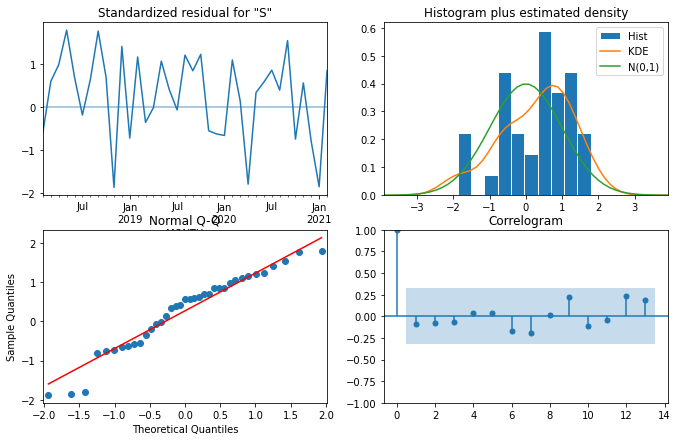

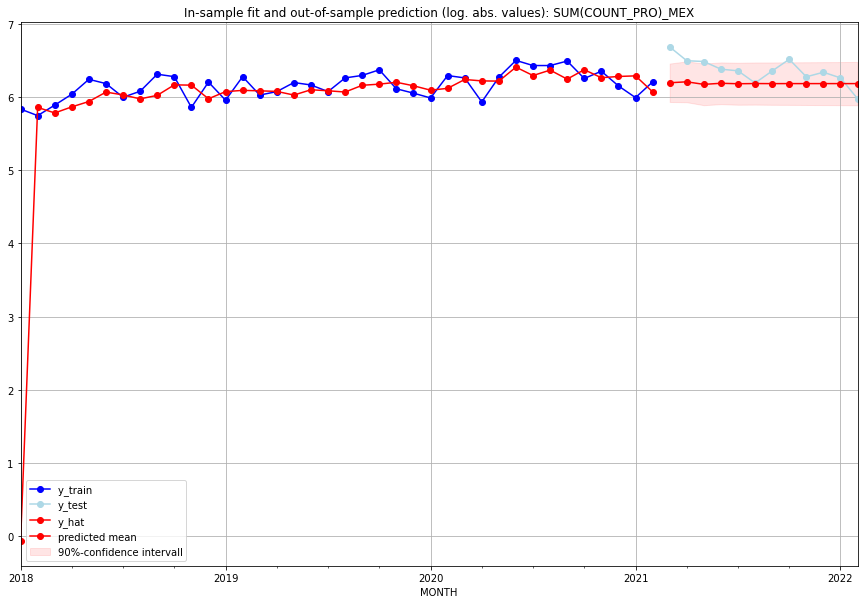

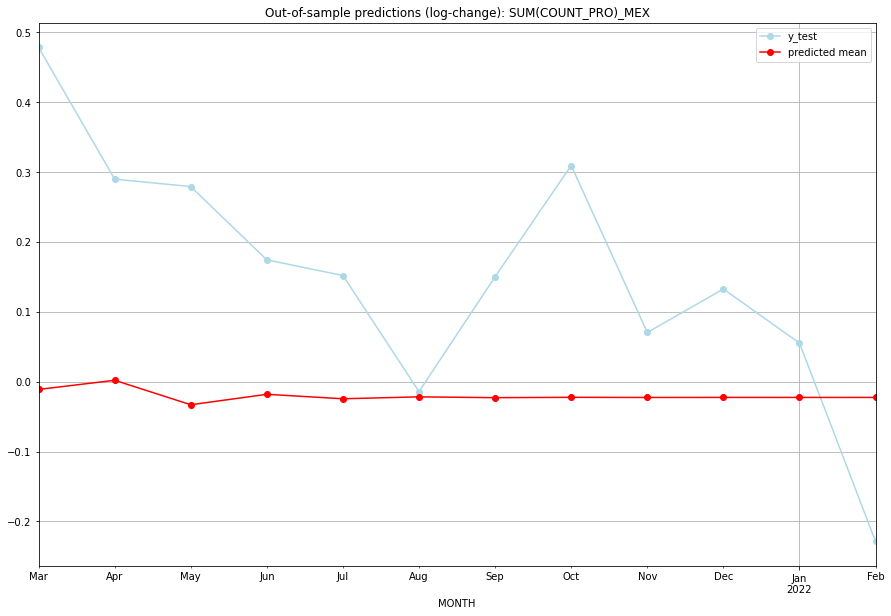

TADDA: 0.22520574902484328
Evaluation finished.
        MONTH    FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  487.514459       796.0     -0.011166        0.478319   MEX   
1  2021-04-01  493.941864       659.0      0.001905        0.289704   MEX   
2  2021-05-01  476.930581       652.0     -0.033070        0.279042   MEX   
3  2021-06-01  484.119520       587.0     -0.018140        0.174191   MEX   
4  2021-07-01  481.037623       574.0     -0.024513        0.151835   MEX   
5  2021-08-01  482.350799       486.0     -0.021793       -0.014271   MEX   
6  2021-09-01  481.789803       573.0     -0.022954        0.150094   MEX   
7  2021-10-01  482.029197       672.0     -0.022458        0.309210   MEX   
8  2021-11-01  481.926992       529.0     -0.022670        0.070341   MEX   
9  2021-12-01  481.970618       563.0     -0.022580        0.132519   MEX   
10 2022-01-01  481.951994       521.0     -0.022618        0.055132   MEX   
11 2022-02-01  481.959944   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.8319536497896932, 'fold_results': [0.8319536497896932]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_MKD   No. Observations:                   38
Model:               SARIMAX(0, 1, 0)   Log Likelihood                 -41.882
Date:                Fri, 16 Sep 2022   AIC                             85.763
Time:                        14:32:31   BIC                             87.374
Sample:                    01-31-2018   HQIC                            86.331
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.5633      0.149      3.787      0.000   

<Figure size 432x288 with 0 Axes>

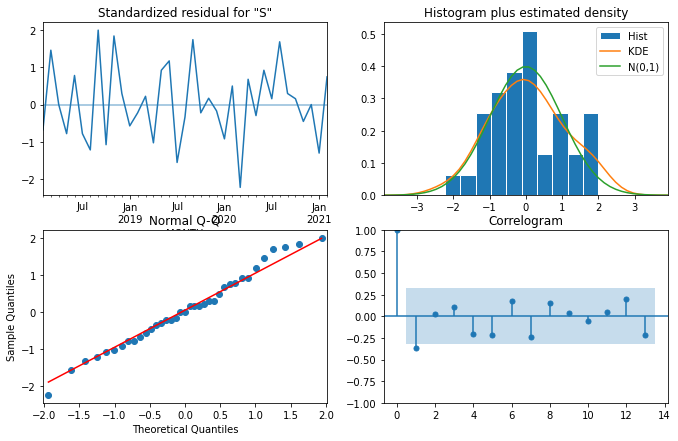

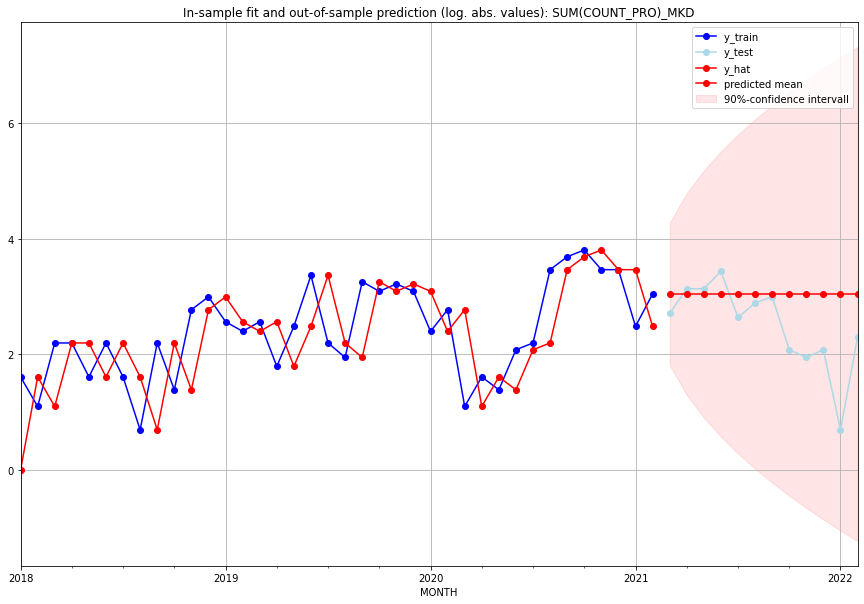

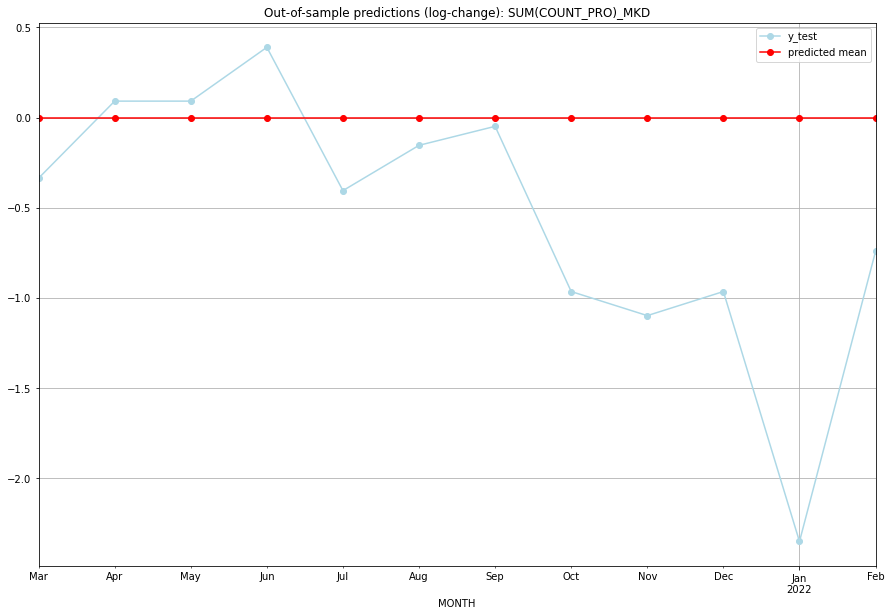

TADDA: 0.6365310995456154
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01      20.0        14.0           0.0       -0.336472   MKD   
1  2021-04-01      20.0        22.0           0.0        0.090972   MKD   
2  2021-05-01      20.0        22.0           0.0        0.090972   MKD   
3  2021-06-01      20.0        30.0           0.0        0.389465   MKD   
4  2021-07-01      20.0        13.0           0.0       -0.405465   MKD   
5  2021-08-01      20.0        17.0           0.0       -0.154151   MKD   
6  2021-09-01      20.0        19.0           0.0       -0.048790   MKD   
7  2021-10-01      20.0         7.0           0.0       -0.965081   MKD   
8  2021-11-01      20.0         6.0           0.0       -1.098612   MKD   
9  2021-12-01      20.0         7.0           0.0       -0.965081   MKD   
10 2022-01-01      20.0         1.0           0.0       -2.351375   MKD   
11 2022-02-01      20.0         9.0           0.0    

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (1, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.5130444792717942, 'fold_results': [0.5130444792717942]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_MLI   No. Observations:                  289
Model:               SARIMAX(1, 1, 0)   Log Likelihood                -209.281
Date:                Fri, 16 Sep 2022   AIC                            422.562
Time:                        14:33:28   BIC                            429.888
Sample:                    02-28-1997   HQIC                           425.497
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.5667      0.036    -15.678      0.000   

<Figure size 432x288 with 0 Axes>

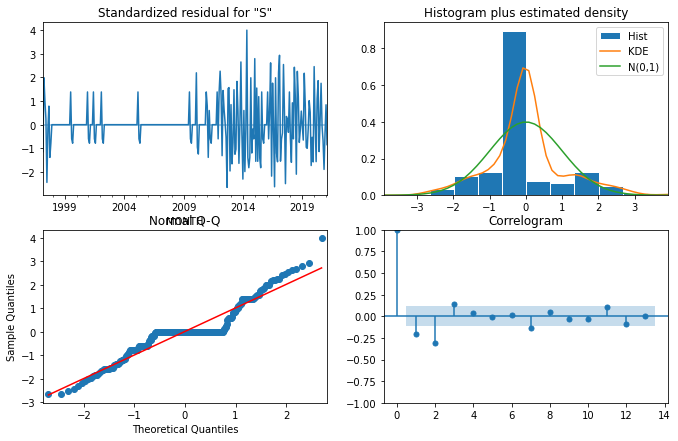

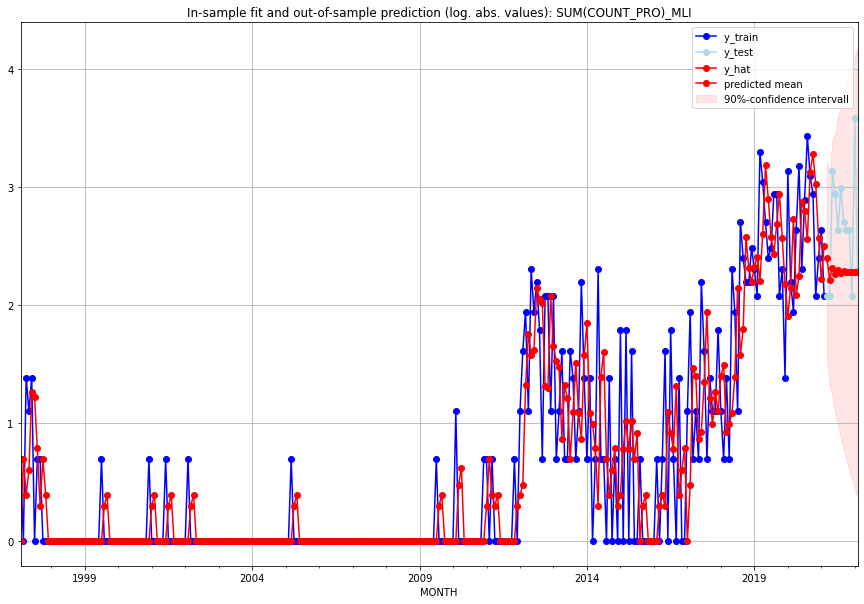

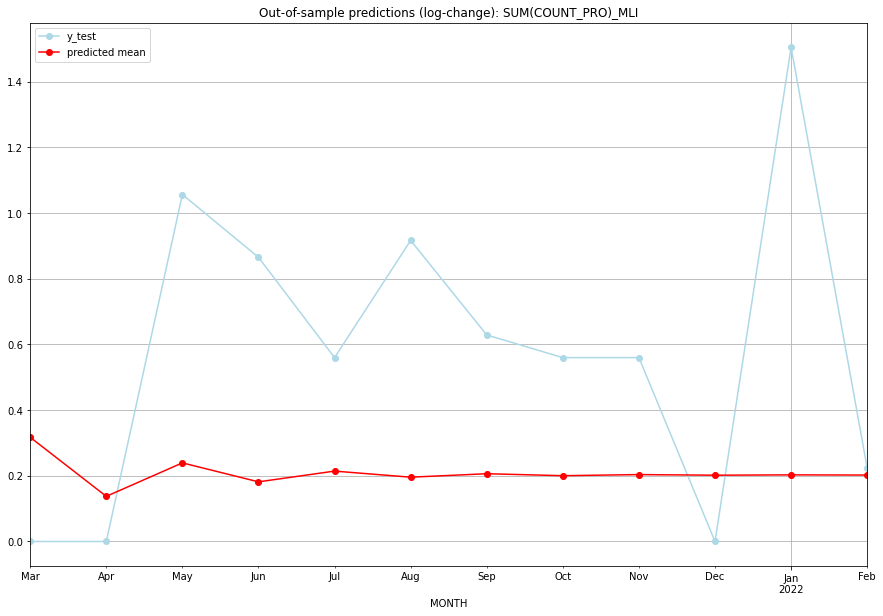

TADDA: 0.4735326833034435
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  9.985424         7.0      0.317128        0.000000   MLI   
1  2021-04-01  8.178435         7.0      0.137415        0.000000   MLI   
2  2021-05-01  9.162432        22.0      0.239256        1.056053   MLI   
3  2021-06-01  8.592539        18.0      0.181544        0.864997   MLI   
4  2021-07-01  8.911448        13.0      0.214249        0.559616   MLI   
5  2021-08-01  8.729446        19.0      0.195715        0.916291   MLI   
6  2021-09-01  8.832170        14.0      0.206218        0.628609   MLI   
7  2021-10-01  8.773825        13.0      0.200266        0.559616   MLI   
8  2021-11-01  8.806846        13.0      0.203639        0.559616   MLI   
9  2021-12-01  8.788120         7.0      0.201728        0.000000   MLI   
10 2022-01-01  8.798727        35.0      0.202811        1.504077   MLI   
11 2022-02-01  8.792715         9.0      0.202197    

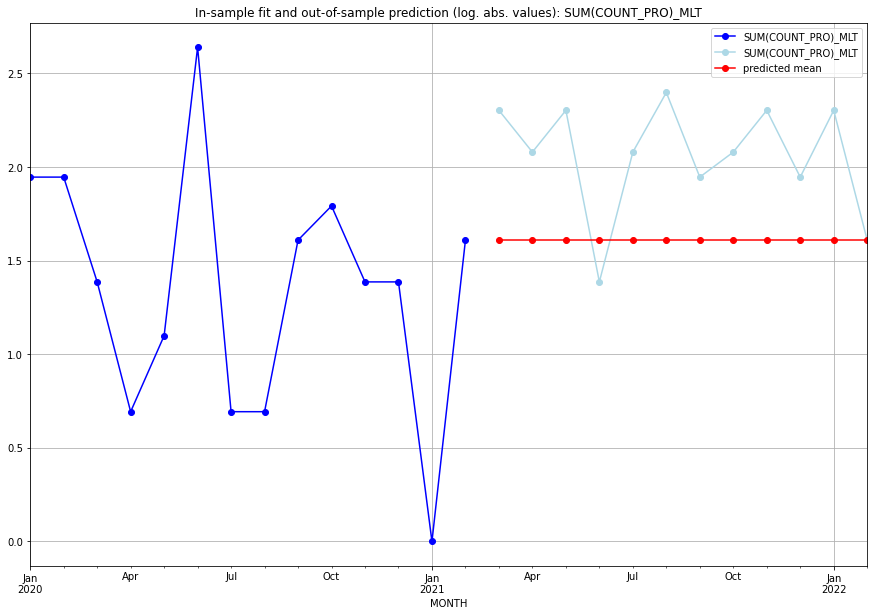

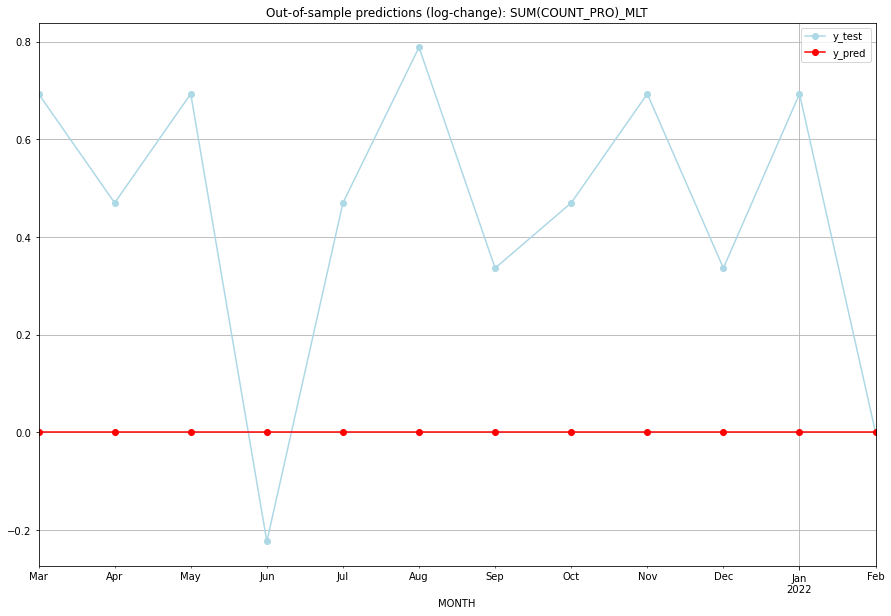

TADDA: 0.4889287495748244
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  1.609438    2.302585           0.0        0.693147   MLT   
1  2021-04-01  1.609438    2.079442           0.0        0.470004   MLT   
2  2021-05-01  1.609438    2.302585           0.0        0.693147   MLT   
3  2021-06-01  1.609438    1.386294           0.0       -0.223144   MLT   
4  2021-07-01  1.609438    2.079442           0.0        0.470004   MLT   
5  2021-08-01  1.609438    2.397895           0.0        0.788457   MLT   
6  2021-09-01  1.609438    1.945910           0.0        0.336472   MLT   
7  2021-10-01  1.609438    2.079442           0.0        0.470004   MLT   
8  2021-11-01  1.609438    2.302585           0.0        0.693147   MLT   
9  2021-12-01  1.609438    1.945910           0.0        0.336472   MLT   
10 2022-01-01  1.609438    2.302585           0.0        0.693147   MLT   
11 2022-02-01  1.609438    1.609438           0.0    

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [1, (1, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.9260613947057396, 'fold_results': [0.9260613947057396]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_MMR   No. Observations:                  134
Model:               SARIMAX(1, 0, 0)   Log Likelihood                -160.772
Date:                Fri, 16 Sep 2022   AIC                            327.543
Time:                        14:34:10   BIC                            336.237
Sample:                    01-31-2010   HQIC                           331.076
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            -0.0630      0.093     -0.677      0.499   

<Figure size 432x288 with 0 Axes>

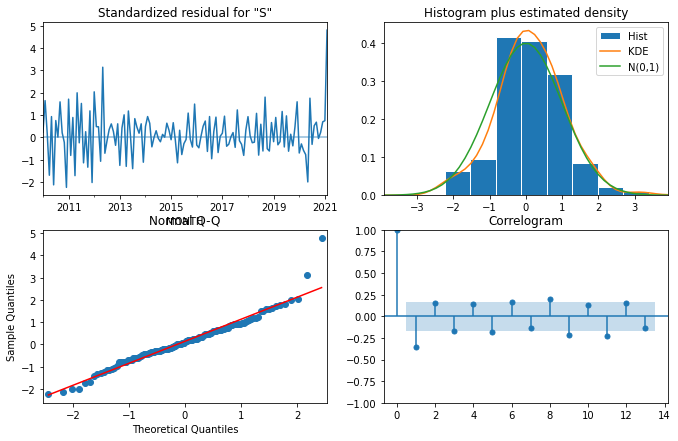

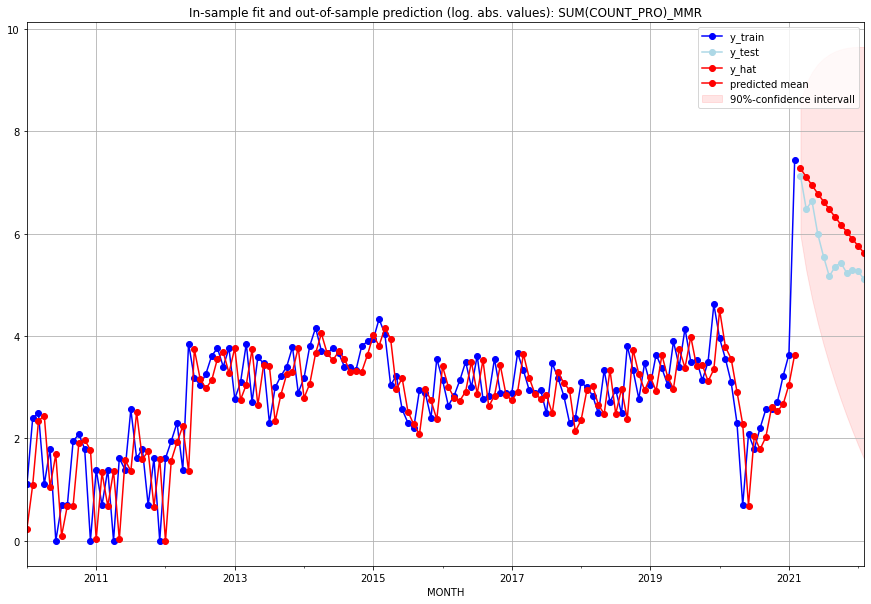

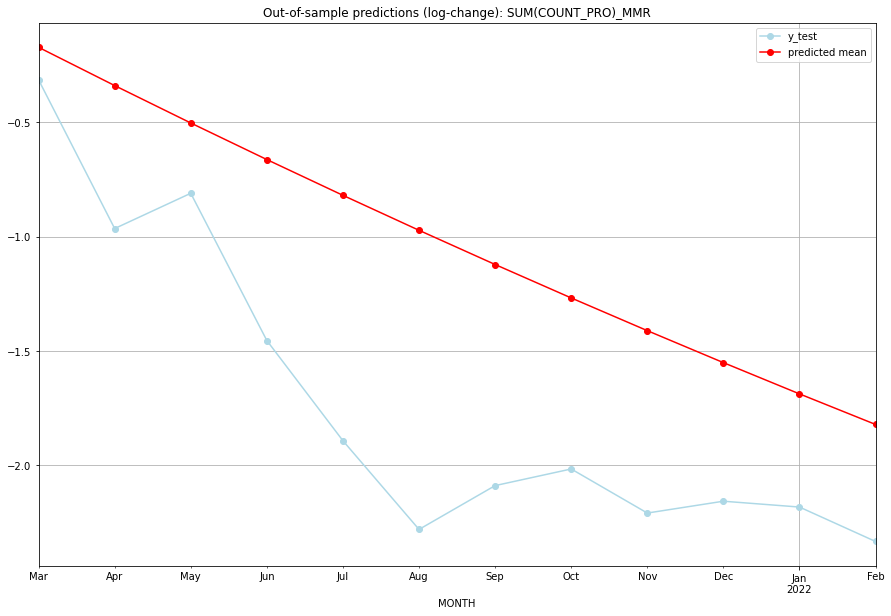

TADDA: 0.6982761401022698
Evaluation finished.
        MONTH     FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  1442.423231      1251.0     -0.171229       -0.313504   MMR   
1  2021-04-01  1219.895162       652.0     -0.338662       -0.964424   MMR   
2  2021-05-01  1035.513282       761.0     -0.502384       -0.810055   MMR   
3  2021-06-01   882.176408       399.0     -0.662477       -1.454537   MMR   
4  2021-07-01   754.198642       257.0     -0.819021       -1.893042   MMR   
5  2021-08-01   647.010336       174.0     -0.972095       -2.281216   MMR   
6  2021-09-01   556.925555       211.0     -1.121776       -2.089415   MMR   
7  2021-10-01   480.960558       227.0     -1.268139       -2.016656   MMR   
8  2021-11-01   416.691586       187.0     -1.411258       -2.209560   MMR   
9  2021-12-01   362.143026       197.0     -1.551205       -2.157734   MMR   
10 2022-01-01   315.699154       192.0     -1.688049       -2.183311   MMR   
11 2022-02-01   2

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [1, (2, 0, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.6377649824025037, 'fold_results': [0.6377649824025037]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_MNE   No. Observations:                   38
Model:               SARIMAX(2, 0, 3)   Log Likelihood                 -48.845
Date:                Fri, 16 Sep 2022   AIC                            111.689
Time:                        14:34:37   BIC                            123.153
Sample:                    01-31-2018   HQIC                           115.768
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1             0.0875      0.104      0.842      0.400   

<Figure size 432x288 with 0 Axes>

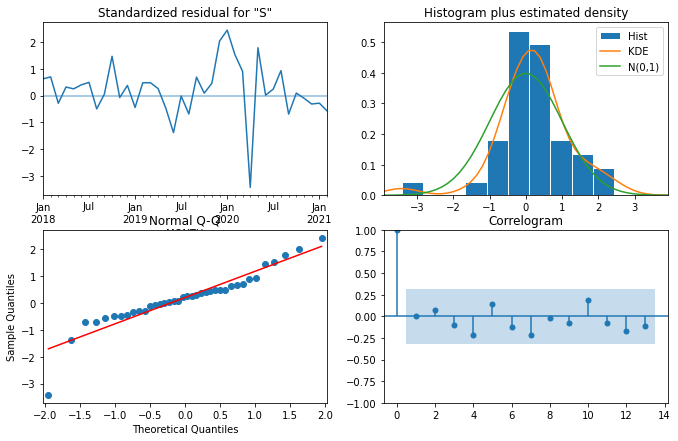

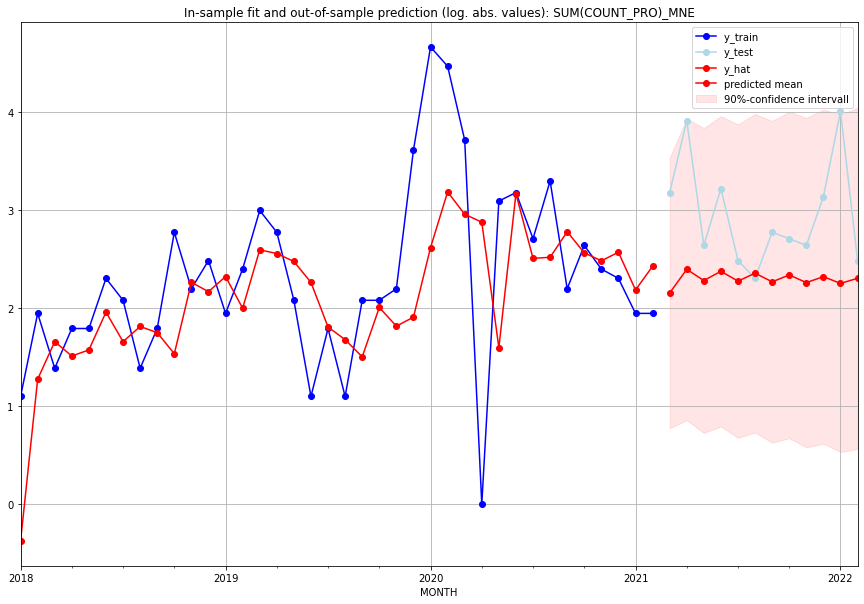

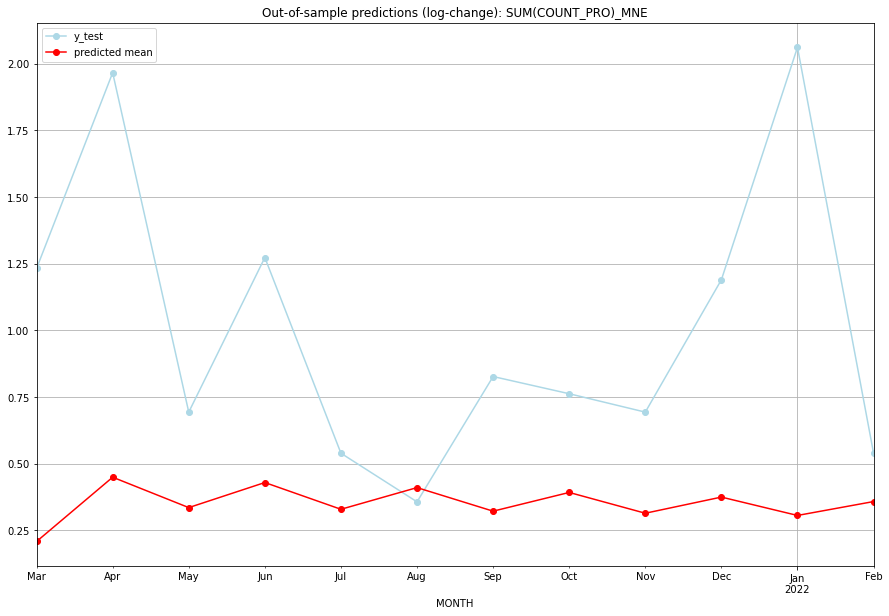

TADDA: 0.6677703219798431
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  7.618290        23.0      0.207977        1.232144   MNE   
1  2021-04-01  9.967915        49.0      0.449064        1.966113   MNE   
2  2021-05-01  8.786461        13.0      0.335090        0.693147   MNE   
3  2021-06-01  9.751106        24.0      0.429099        1.272966   MNE   
4  2021-07-01  8.724855        11.0      0.328775        0.538997   MNE   
5  2021-08-01  9.548697         9.0      0.410092        0.356675   MNE   
6  2021-09-01  8.656240        15.0      0.321694        0.826679   MNE   
7  2021-10-01  9.358856        14.0      0.391932        0.762140   MNE   
8  2021-11-01  8.581777        13.0      0.313953        0.693147   MNE   
9  2021-12-01  9.180033        22.0      0.374518        1.189584   MNE   
10 2022-01-01  8.502483        54.0      0.305643        2.061423   MNE   
11 2022-02-01  9.010907        11.0      0.357765    

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [3, (0, 1, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.550546010512169, 'fold_results': [0.550546010512169]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_MNG   No. Observations:                   38
Model:               SARIMAX(0, 1, 3)   Log Likelihood                 -34.387
Date:                Fri, 16 Sep 2022   AIC                             82.774
Time:                        14:35:14   BIC                             94.051
Sample:                    01-31-2018   HQIC                            86.750
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            -0.0170      0.050     -0.340      0.734     

<Figure size 432x288 with 0 Axes>

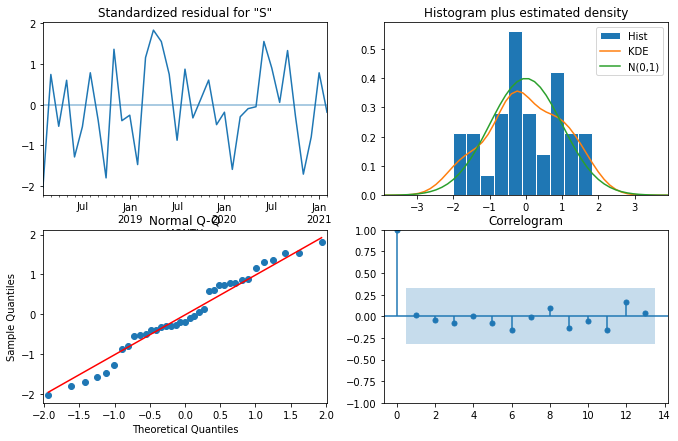

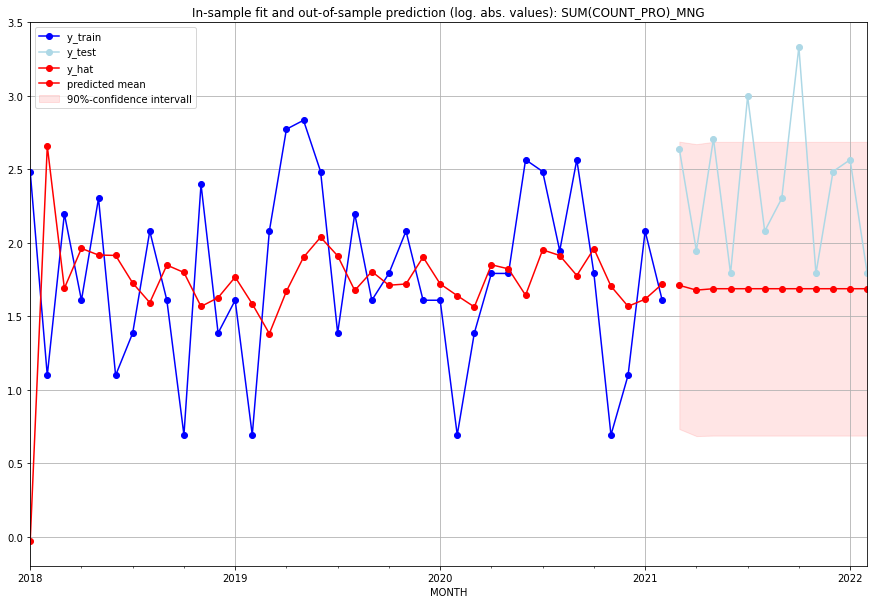

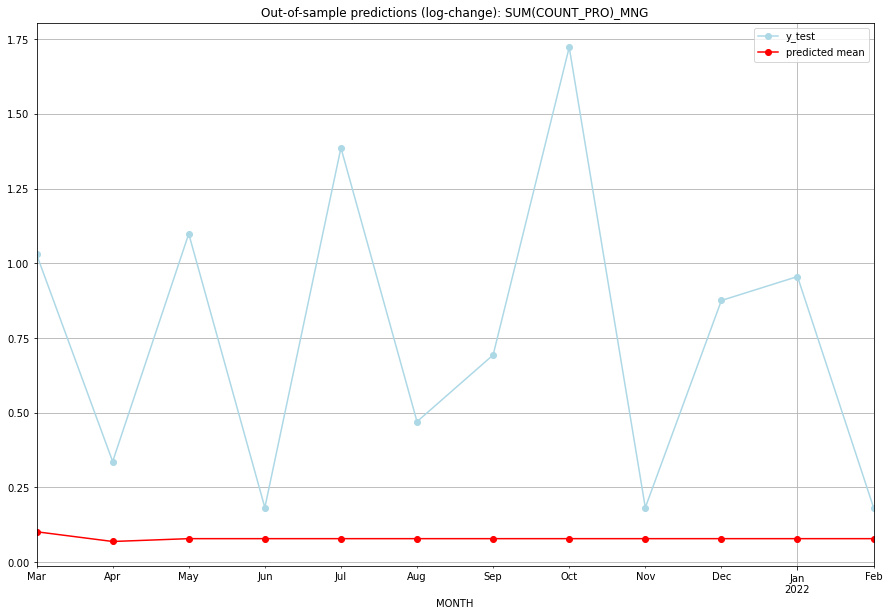

TADDA: 0.6800816351355738
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  4.533747        13.0      0.101427        1.029619   MNG   
1  2021-04-01  4.356489         6.0      0.068871        0.336472   MNG   
2  2021-05-01  4.407550        14.0      0.078358        1.098612   MNG   
3  2021-06-01  4.407550         5.0      0.078358        0.182322   MNG   
4  2021-07-01  4.407550        19.0      0.078358        1.386294   MNG   
5  2021-08-01  4.407550         7.0      0.078358        0.470004   MNG   
6  2021-09-01  4.407550         9.0      0.078358        0.693147   MNG   
7  2021-10-01  4.407550        27.0      0.078358        1.722767   MNG   
8  2021-11-01  4.407550         5.0      0.078358        0.182322   MNG   
9  2021-12-01  4.407550        11.0      0.078358        0.875469   MNG   
10 2022-01-01  4.407550        12.0      0.078358        0.955511   MNG   
11 2022-02-01  4.407550         5.0      0.078358    

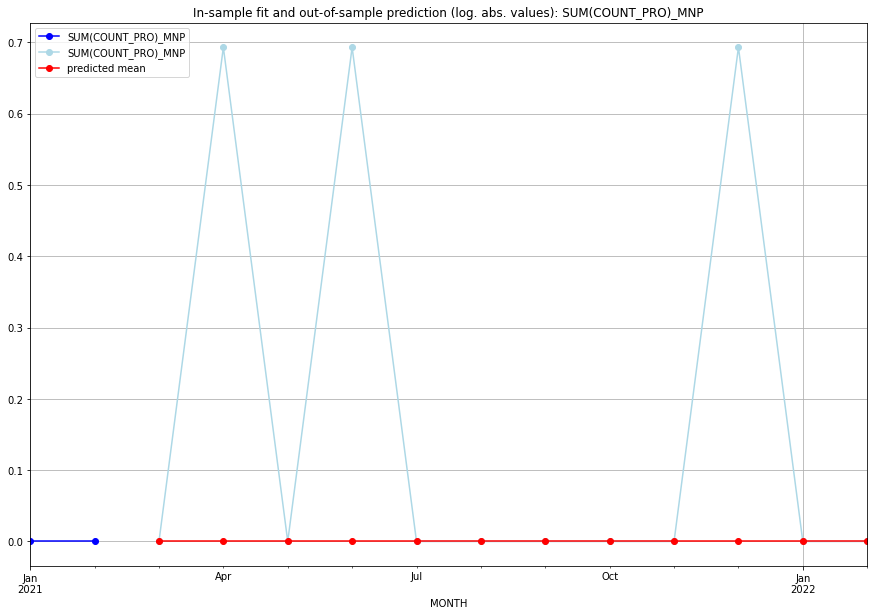

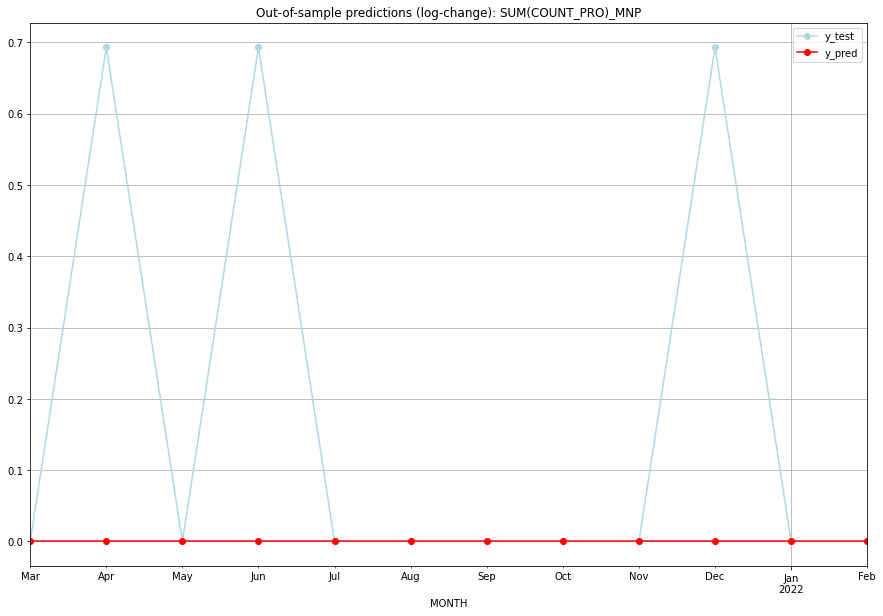

TADDA: 0.17328679513998632
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0    0.000000           0.0        0.000000   MNP   
1  2021-04-01       0.0    0.693147           0.0        0.693147   MNP   
2  2021-05-01       0.0    0.000000           0.0        0.000000   MNP   
3  2021-06-01       0.0    0.693147           0.0        0.693147   MNP   
4  2021-07-01       0.0    0.000000           0.0        0.000000   MNP   
5  2021-08-01       0.0    0.000000           0.0        0.000000   MNP   
6  2021-09-01       0.0    0.000000           0.0        0.000000   MNP   
7  2021-10-01       0.0    0.000000           0.0        0.000000   MNP   
8  2021-11-01       0.0    0.000000           0.0        0.000000   MNP   
9  2021-12-01       0.0    0.693147           0.0        0.693147   MNP   
10 2022-01-01       0.0    0.000000           0.0        0.000000   MNP   
11 2022-02-01       0.0    0.000000           0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [1, (1, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.46597291067705465, 'fold_results': [0.46597291067705465]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_MOZ   No. Observations:                  289
Model:               SARIMAX(1, 1, 0)   Log Likelihood                -302.808
Date:                Fri, 16 Sep 2022   AIC                            611.616
Time:                        14:36:18   BIC                            622.605
Sample:                    02-28-1997   HQIC                           616.020
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1             0.0448      0.028      1.601      0.109 

<Figure size 432x288 with 0 Axes>

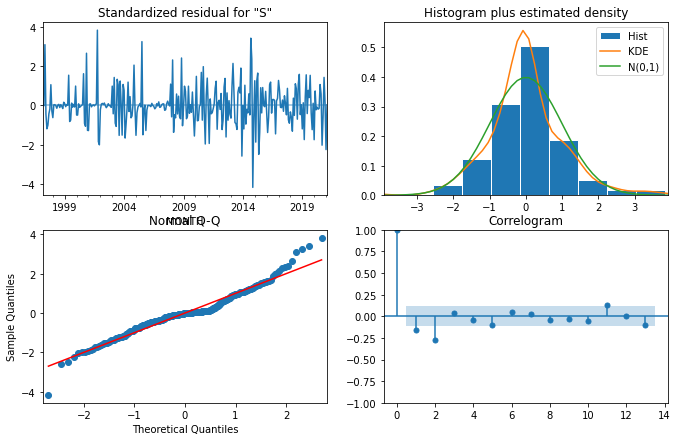

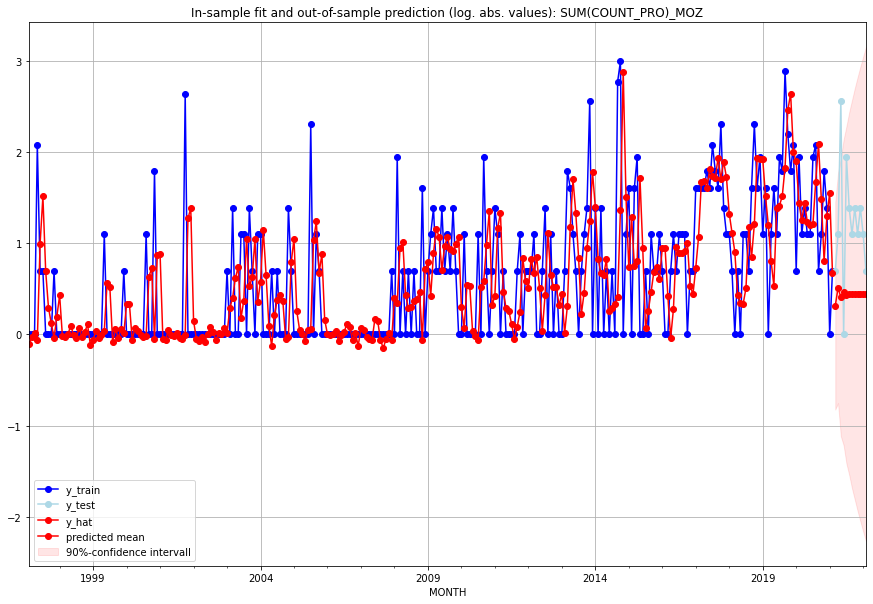

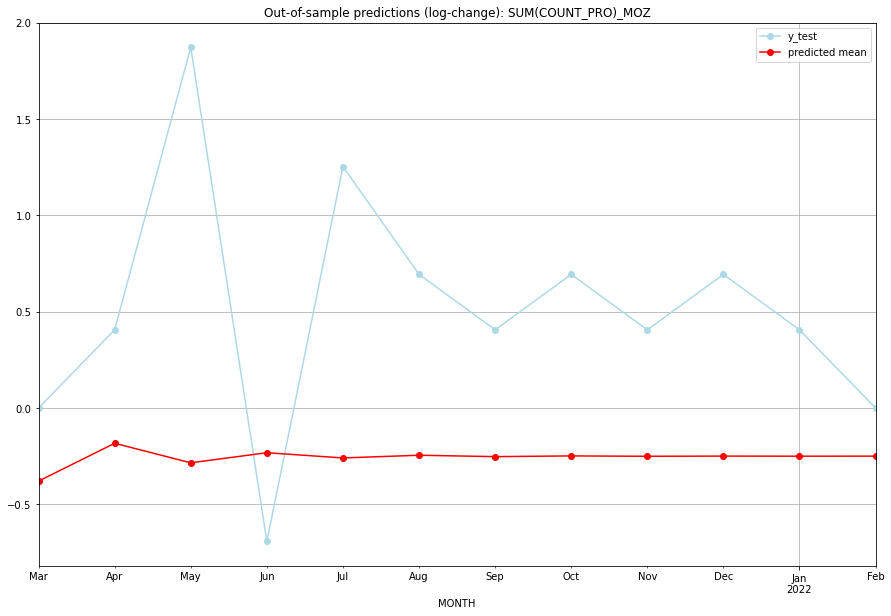

TADDA: 1.0307139416054594
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  0.368298         1.0     -0.379580        0.000000   MOZ   
1  2021-04-01  0.664846         2.0     -0.183415        0.405465   MOZ   
2  2021-05-01  0.504341        12.0     -0.284792        1.871802   MOZ   
3  2021-06-01  0.585257         0.0     -0.232401       -0.693147   MOZ   
4  2021-07-01  0.542911         6.0     -0.259476        1.252763   MOZ   
5  2021-08-01  0.564652         3.0     -0.245484        0.693147   MOZ   
6  2021-09-01  0.553378         2.0     -0.252715        0.405465   MOZ   
7  2021-10-01  0.559194         3.0     -0.248978        0.693147   MOZ   
8  2021-11-01  0.556186         2.0     -0.250909        0.405465   MOZ   
9  2021-12-01  0.557740         3.0     -0.249911        0.693147   MOZ   
10 2022-01-01  0.556937         2.0     -0.250427        0.405465   MOZ   
11 2022-02-01  0.557352         1.0     -0.250160    

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (1, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.3839555789536069, 'fold_results': [0.3839555789536069]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_MRT   No. Observations:                  289
Model:               SARIMAX(1, 1, 0)   Log Likelihood                -249.559
Date:                Fri, 16 Sep 2022   AIC                            503.118
Time:                        14:37:12   BIC                            510.444
Sample:                    02-28-1997   HQIC                           506.054
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.4634      0.046    -10.142      0.000   

<Figure size 432x288 with 0 Axes>

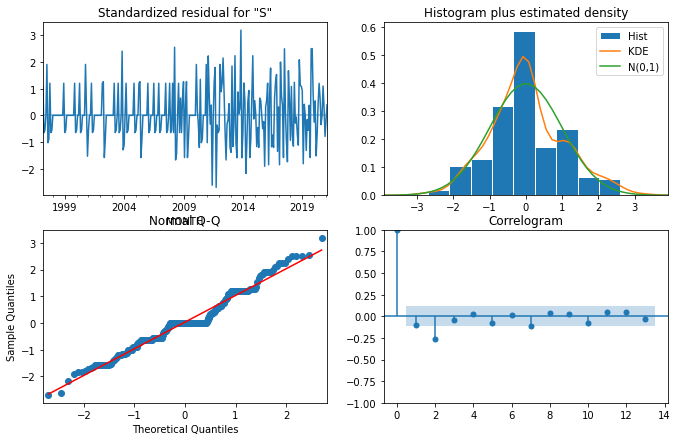

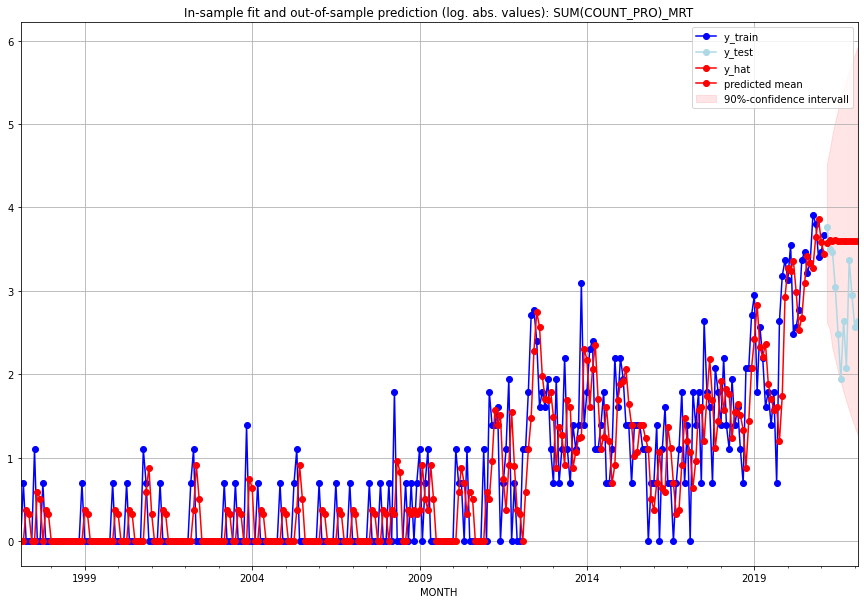

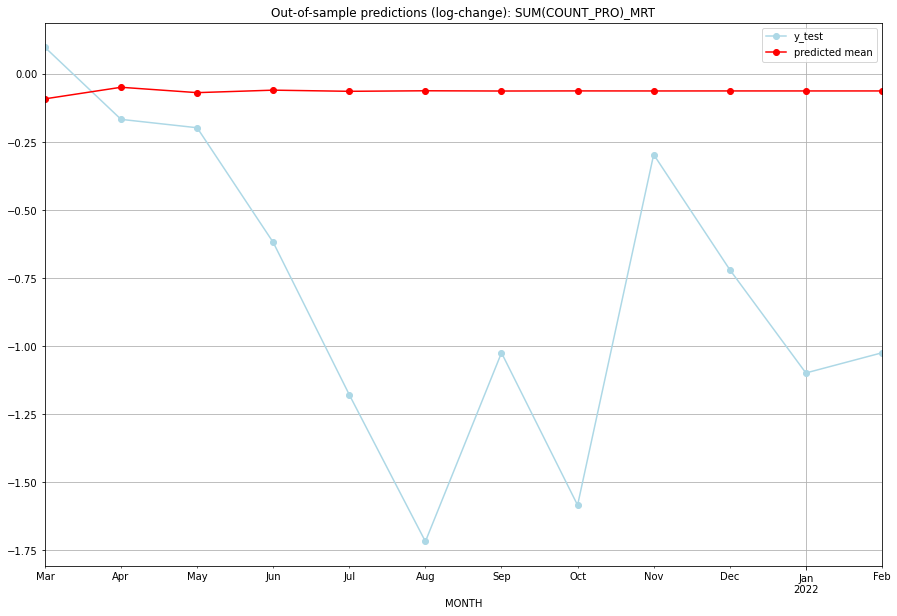

TADDA: 0.7690383241902073
Evaluation finished.
        MONTH   FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  34.583820        42.0     -0.091671        0.097638   MRT   
1  2021-04-01  36.127961        32.0     -0.049191       -0.167054   MRT   
2  2021-05-01  35.404261        31.0     -0.068876       -0.197826   MRT   
3  2021-06-01  35.737846        20.0     -0.059754       -0.619039   MRT   
4  2021-07-01  35.582888        11.0     -0.063981       -1.178655   MRT   
5  2021-08-01  35.654613         6.0     -0.062022       -1.717651   MRT   
6  2021-09-01  35.621358        13.0     -0.062930       -1.024504   MRT   
7  2021-10-01  35.636764         7.0     -0.062509       -1.584120   MRT   
8  2021-11-01  35.629625        28.0     -0.062704       -0.296266   MRT   
9  2021-12-01  35.632933        18.0     -0.062614       -0.719123   MRT   
10 2022-01-01  35.631400        12.0     -0.062656       -1.098612   MRT   
11 2022-02-01  35.632110        13.0     

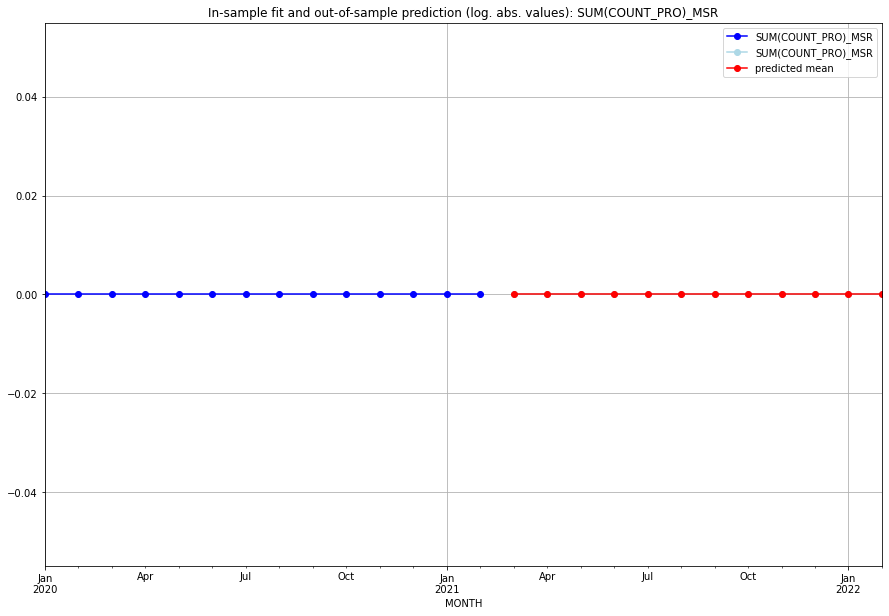

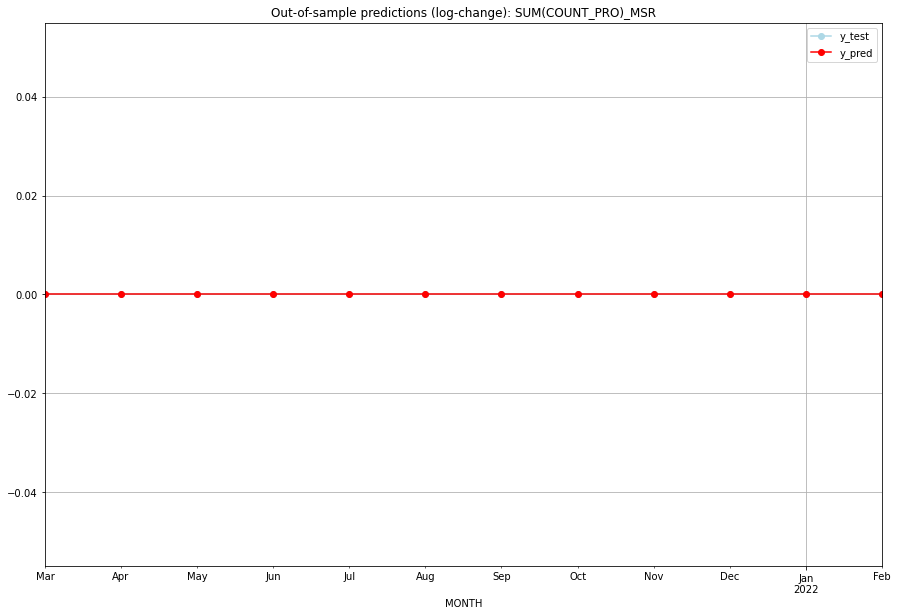

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   MSR   
1  2021-04-01       0.0         0.0           0.0             0.0   MSR   
2  2021-05-01       0.0         0.0           0.0             0.0   MSR   
3  2021-06-01       0.0         0.0           0.0             0.0   MSR   
4  2021-07-01       0.0         0.0           0.0             0.0   MSR   
5  2021-08-01       0.0         0.0           0.0             0.0   MSR   
6  2021-09-01       0.0         0.0           0.0             0.0   MSR   
7  2021-10-01       0.0         0.0           0.0             0.0   MSR   
8  2021-11-01       0.0         0.0           0.0             0.0   MSR   
9  2021-12-01       0.0         0.0           0.0             0.0   MSR   
10 2022-01-01       0.0         0.0           0.0             0.0   MSR   
11 2022-02-01       0.0         0.0           0.0             0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (2, 1, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.6514319223437584, 'fold_results': [0.6514319223437584]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_MTQ   No. Observations:                   38
Model:               SARIMAX(2, 1, 3)   Log Likelihood                 -41.092
Date:                Fri, 16 Sep 2022   AIC                             94.183
Time:                        14:37:43   BIC                            103.849
Sample:                    01-31-2018   HQIC                            97.591
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -1.0618      0.260     -4.086      0.000   

<Figure size 432x288 with 0 Axes>

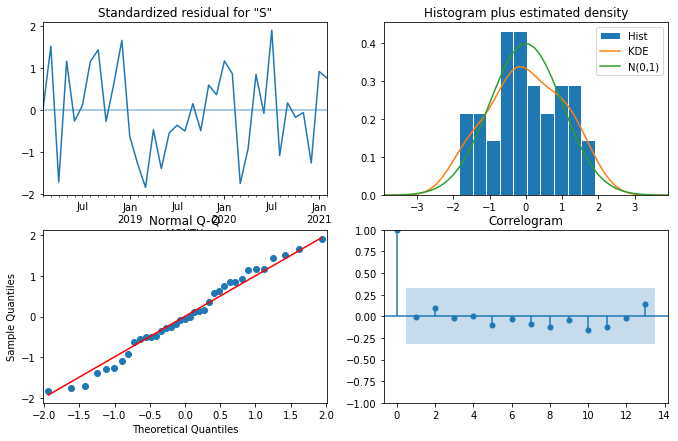

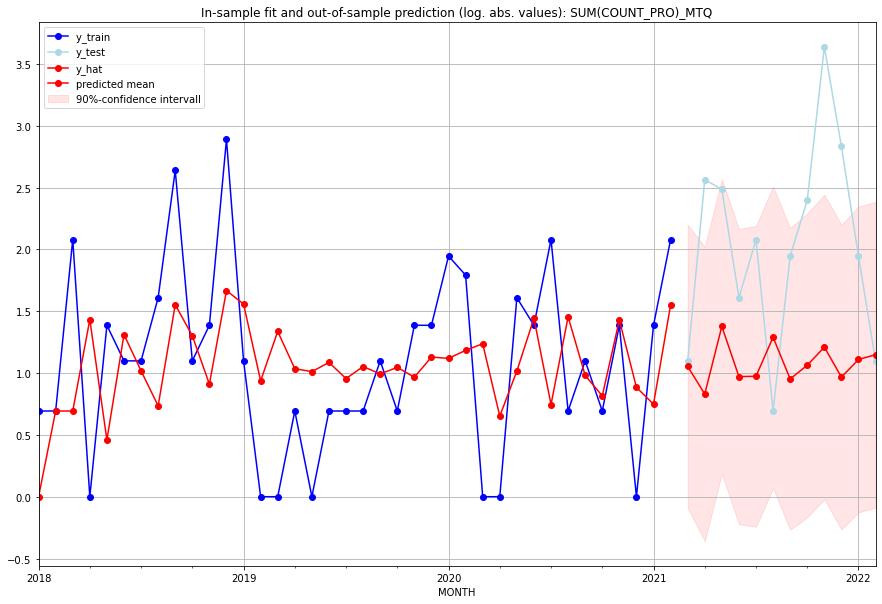

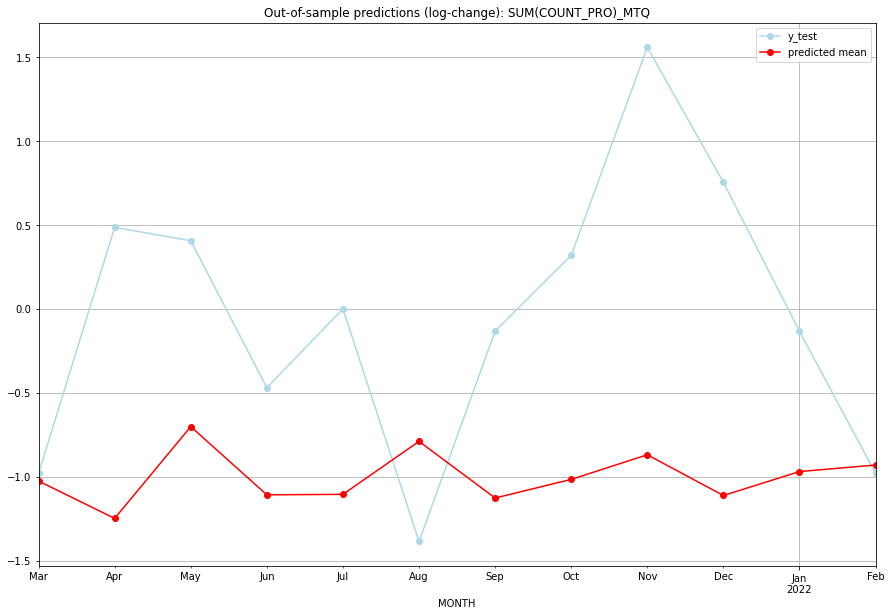

TADDA: 1.4736831123542908
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  1.866325         2.0     -1.026411       -0.980829   MTQ   
1  2021-04-01  1.295092        12.0     -1.248669        0.485508   MTQ   
2  2021-05-01  2.965299        11.0     -0.701860        0.405465   MTQ   
3  2021-06-01  1.641197         4.0     -1.108209       -0.470004   MTQ   
4  2021-07-01  1.648579         7.0     -1.105418        0.000000   MTQ   
5  2021-08-01  2.631358         1.0     -0.789835       -1.386294   MTQ   
6  2021-09-01  1.591775         6.0     -1.127098       -0.133531   MTQ   
7  2021-10-01  1.895172        10.0     -1.016397        0.318454   MTQ   
8  2021-11-01  2.353132        37.0     -0.869547        1.558145   MTQ   
9  2021-12-01  1.630549        16.0     -1.112249        0.753772   MTQ   
10 2022-01-01  2.033648         6.0     -0.969676       -0.133531   MTQ   
11 2022-02-01  2.153921         2.0     -0.930795    

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (3, 1, 2), (0, 0, 0, 0), 'n'], 'cv_score': 0.9660215575208205, 'fold_results': [0.9660215575208205]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_MUS   No. Observations:                  289
Model:               SARIMAX(3, 1, 2)   Log Likelihood                 191.781
Date:                Fri, 16 Sep 2022   AIC                           -371.562
Time:                        14:37:59   BIC                           -349.584
Sample:                    02-28-1997   HQIC                          -362.755
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.7180      0.034     21.286      0.000   

<Figure size 432x288 with 0 Axes>

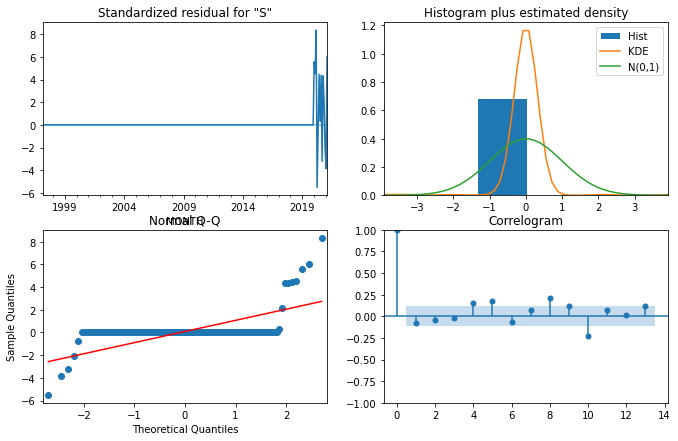

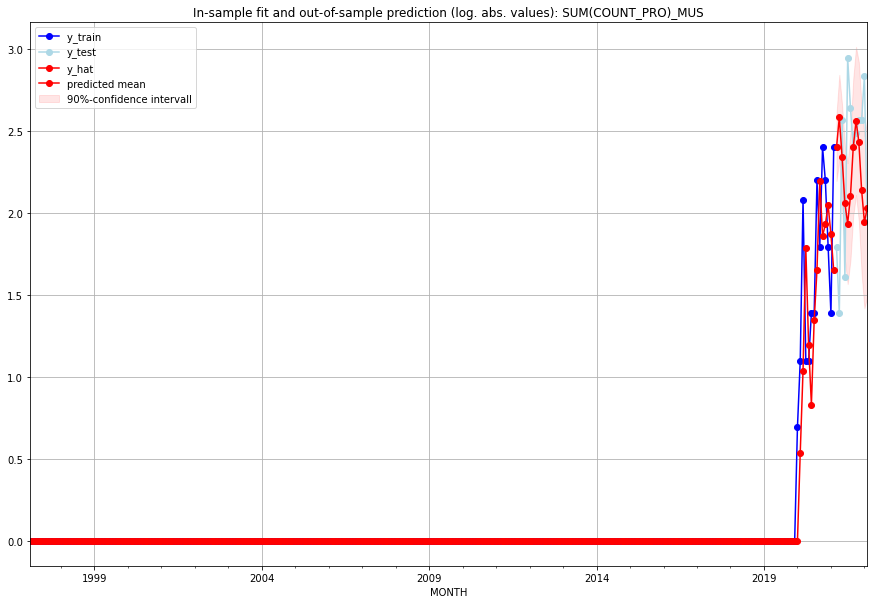

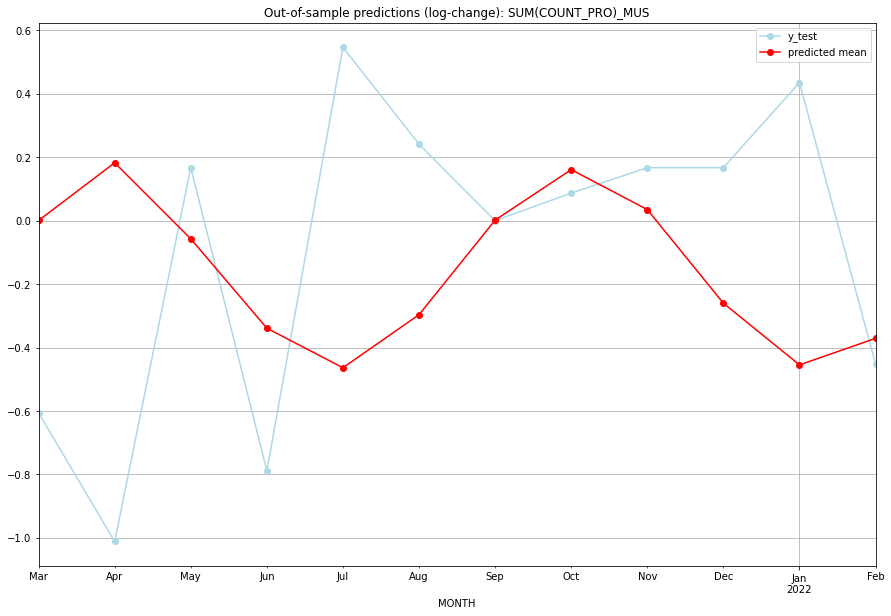

TADDA: 0.611998315783595
Evaluation finished.
        MONTH   FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  10.005596         5.0      0.000509       -0.606136   MUS   
1  2021-04-01  12.201877         3.0      0.182464       -1.011601   MUS   
2  2021-05-01   9.386528        12.0     -0.057386        0.167054   MUS   
3  2021-06-01   6.836995         4.0     -0.339040       -0.788457   MUS   
4  2021-07-01   5.917697        18.0     -0.463812        0.546544   MUS   
5  2021-08-01   7.177640        13.0     -0.296492        0.241162   MUS   
6  2021-09-01  10.017971        10.0      0.001632        0.000000   MUS   
7  2021-10-01  11.919703        11.0      0.160858        0.087011   MUS   
8  2021-11-01  10.390958        12.0      0.034925        0.167054   MUS   
9  2021-12-01   7.479861        12.0     -0.260201        0.167054   MUS   
10 2022-01-01   5.980777        16.0     -0.454735        0.435318   MUS   
11 2022-02-01   6.589749         6.0     -

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [2, (3, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.24097734438206553, 'fold_results': [0.24097734438206553]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_MWI   No. Observations:                  289
Model:               SARIMAX(3, 1, 0)   Log Likelihood                -226.527
Date:                Fri, 16 Sep 2022   AIC                            465.055
Time:                        14:38:38   BIC                            487.032
Sample:                    02-28-1997   HQIC                           473.862
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1             0.0419      0.025      1.693      0.090 

<Figure size 432x288 with 0 Axes>

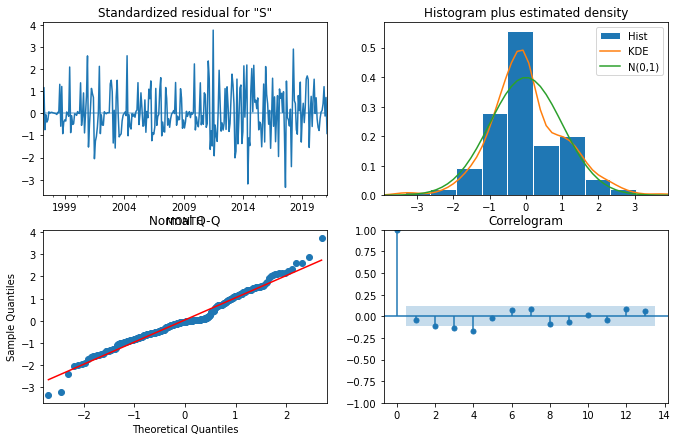

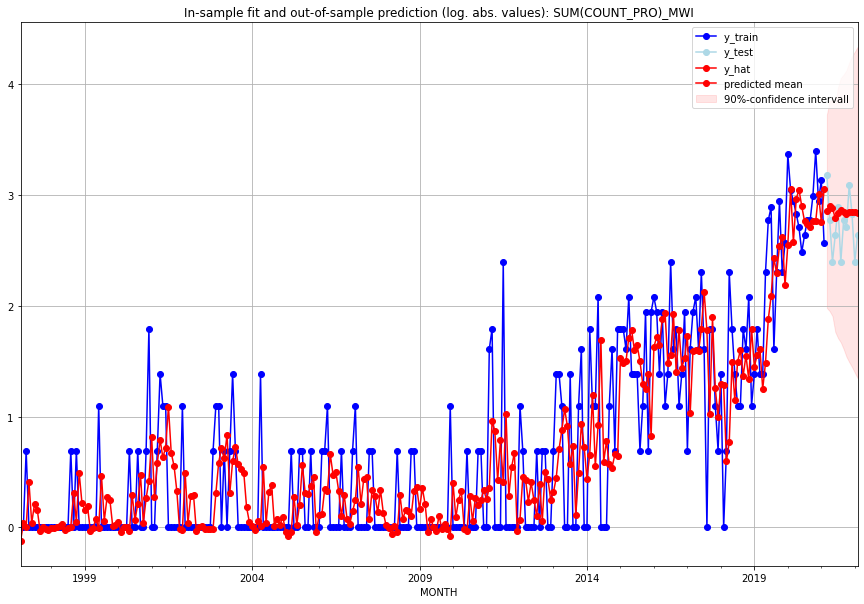

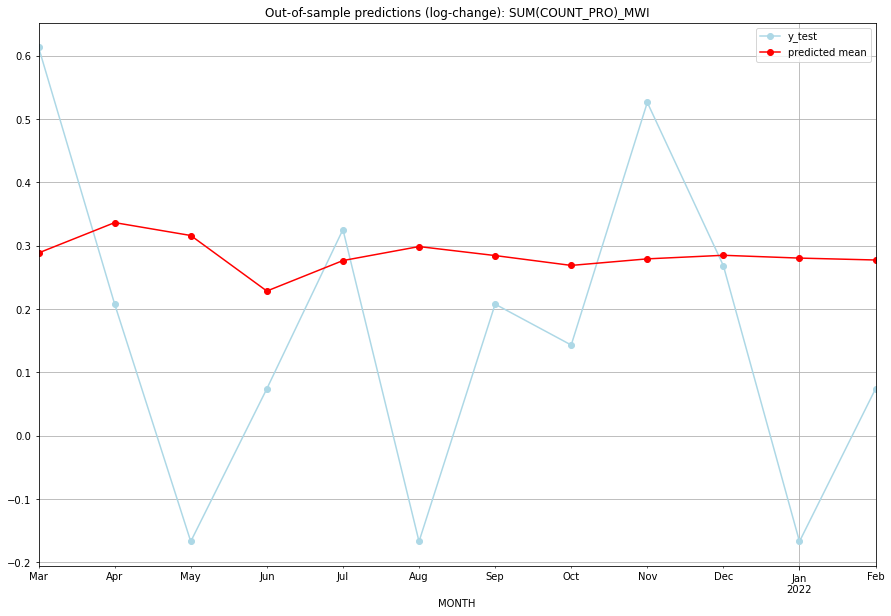

TADDA: 0.30137931100258586
Evaluation finished.
        MONTH   FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  16.347266        23.0      0.288486        0.613104   MWI   
1  2021-04-01  17.198121        15.0      0.336369        0.207639   MWI   
2  2021-05-01  16.831349        10.0      0.316009       -0.167054   MWI   
3  2021-06-01  15.334566        13.0      0.228334        0.074108   MWI   
4  2021-07-01  16.139529        17.0      0.276438        0.325422   MWI   
5  2021-08-01  16.522254        10.0      0.298522       -0.167054   MWI   
6  2021-09-01  16.275651        15.0      0.284349        0.207639   MWI   
7  2021-10-01  16.008686        14.0      0.268775        0.143101   MWI   
8  2021-11-01  16.185658        21.0      0.279126        0.526093   MWI   
9  2021-12-01  16.282794        16.0      0.284762        0.268264   MWI   
10 2022-01-01  16.206675        10.0      0.280348       -0.167054   MWI   
11 2022-02-01  16.154850        13.0    

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [3, (1, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.6738033063659548, 'fold_results': [0.6738033063659548]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_MYS   No. Observations:                   38
Model:               SARIMAX(1, 0, 0)   Log Likelihood                 -43.008
Date:                Fri, 16 Sep 2022   AIC                             96.016
Time:                        14:39:12   BIC                            104.204
Sample:                    01-31-2018   HQIC                            98.929
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            -0.1472      0.119     -1.233      0.218   

<Figure size 432x288 with 0 Axes>

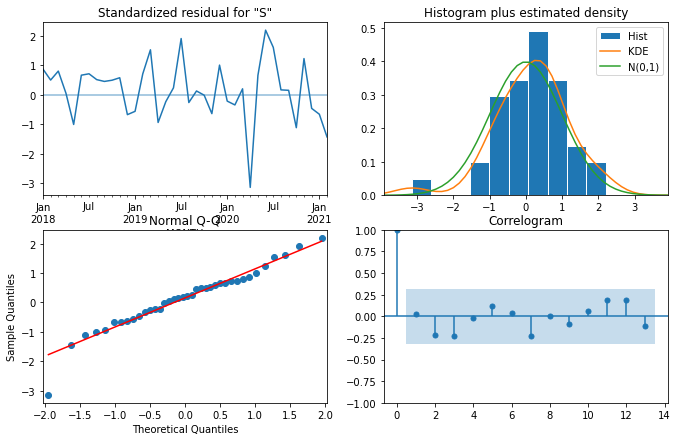

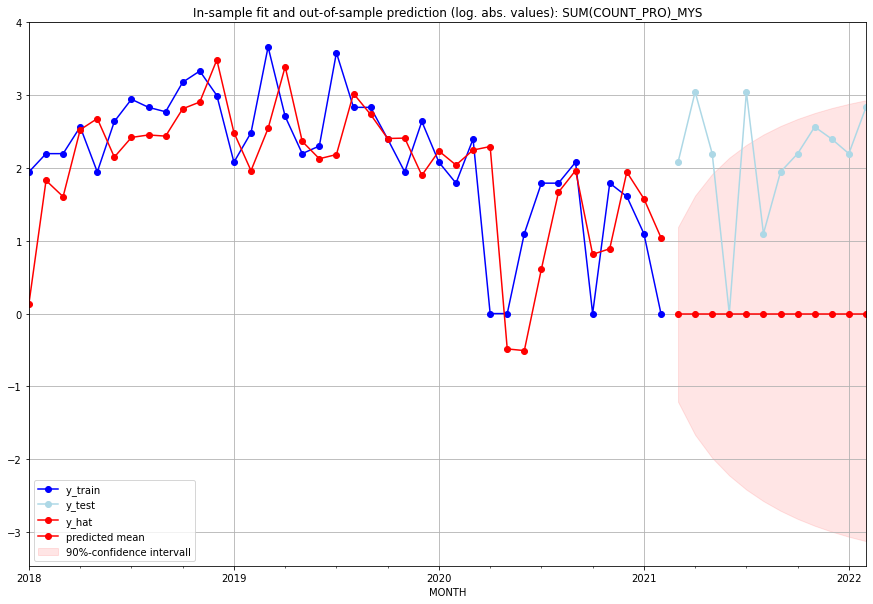

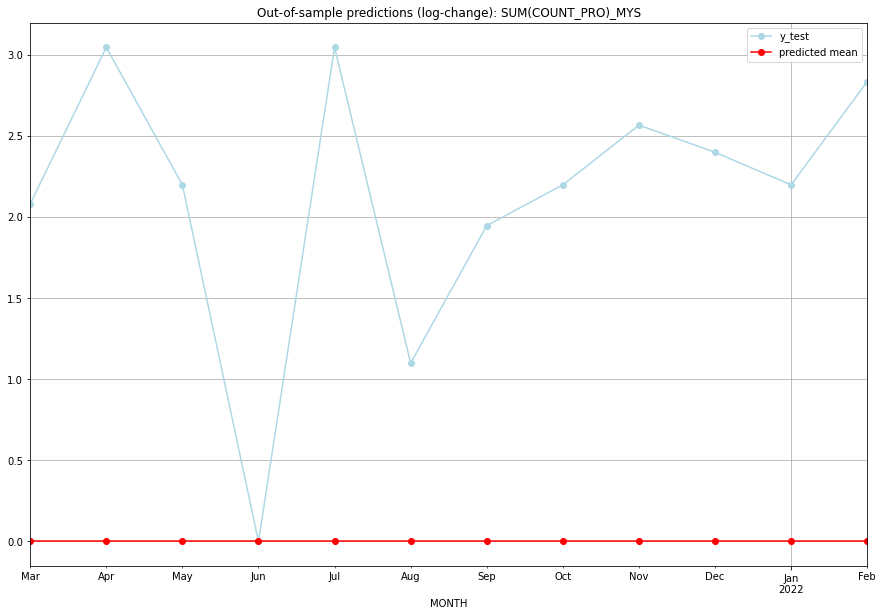

TADDA: 2.133395046764574
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         7.0           0.0        2.079442   MYS   
1  2021-04-01       0.0        20.0           0.0        3.044522   MYS   
2  2021-05-01       0.0         8.0           0.0        2.197225   MYS   
3  2021-06-01       0.0         0.0           0.0        0.000000   MYS   
4  2021-07-01       0.0        20.0           0.0        3.044522   MYS   
5  2021-08-01       0.0         2.0           0.0        1.098612   MYS   
6  2021-09-01       0.0         6.0           0.0        1.945910   MYS   
7  2021-10-01       0.0         8.0           0.0        2.197225   MYS   
8  2021-11-01       0.0        12.0           0.0        2.564949   MYS   
9  2021-12-01       0.0        10.0           0.0        2.397895   MYS   
10 2022-01-01       0.0         8.0           0.0        2.197225   MYS   
11 2022-02-01       0.0        16.0           0.0     

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (2, 1, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.4915438792873836, 'fold_results': [0.4915438792873836]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_MYT   No. Observations:                  289
Model:               SARIMAX(2, 1, 3)   Log Likelihood                 183.868
Date:                Fri, 16 Sep 2022   AIC                           -355.736
Time:                        14:39:33   BIC                           -333.758
Sample:                    02-28-1997   HQIC                          -346.928
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.8633      0.040    -21.651      0.000   

<Figure size 432x288 with 0 Axes>

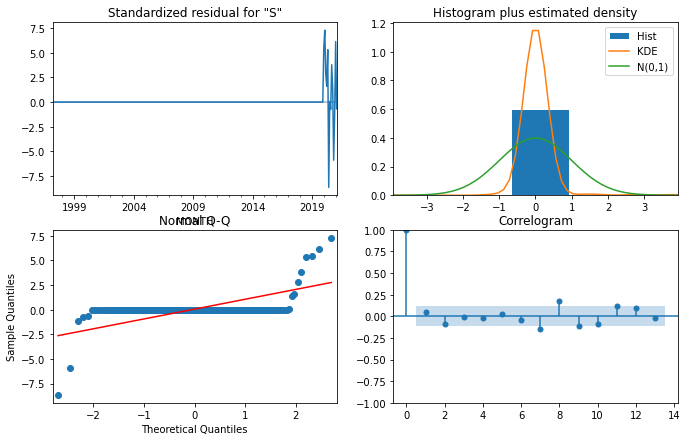

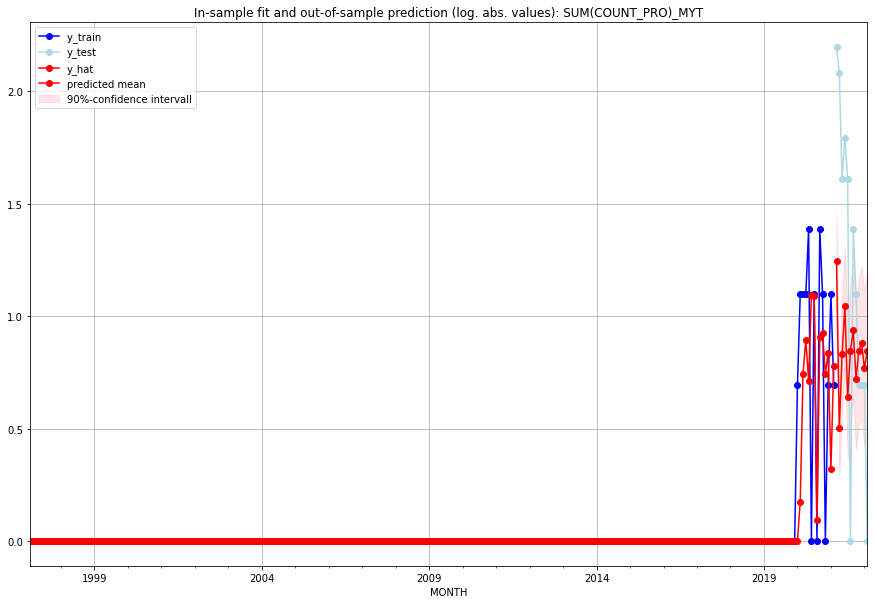

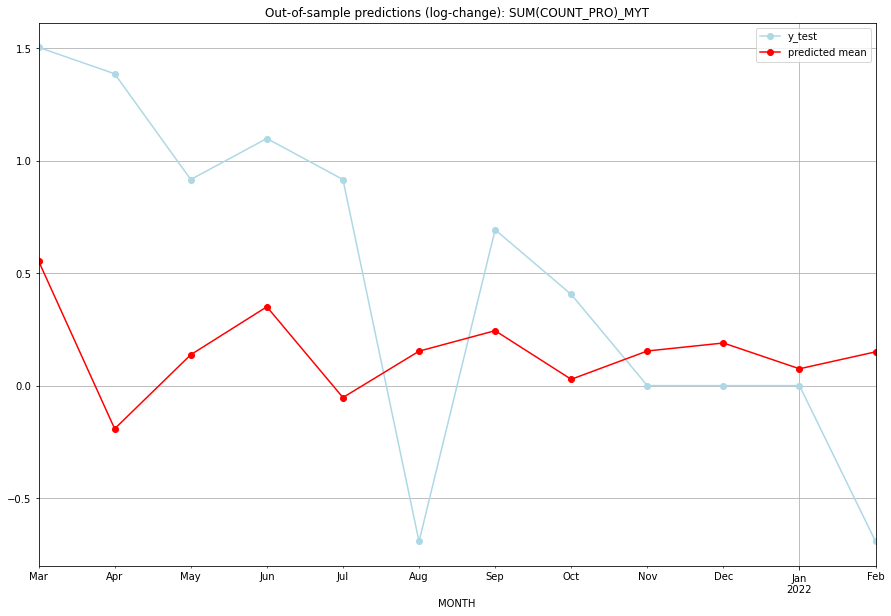

TADDA: 0.7089285812337537
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  2.479722         8.0      0.553805        1.504077   MYT   
1  2021-04-01  0.650740         7.0     -0.191924        1.386294   MYT   
2  2021-05-01  1.294172         4.0      0.137225        0.916291   MYT   
3  2021-06-01  1.839289         5.0      0.350407        1.098612   MYT   
4  2021-07-01  0.896503         4.0     -0.053136        0.916291   MYT   
5  2021-08-01  1.330789         0.0      0.153060       -0.693147   MYT   
6  2021-09-01  1.553146         3.0      0.244179        0.693147   MYT   
7  2021-10-01  1.056806         2.0      0.028007        0.405465   MYT   
8  2021-11-01  1.332642         1.0      0.153854        0.000000   MYT   
9  2021-12-01  1.416998         1.0      0.189379        0.000000   MYT   
10 2022-01-01  1.155303         1.0      0.074784        0.000000   MYT   
11 2022-02-01  1.323713         0.0      0.150019    

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.6848150299703583, 'fold_results': [0.6848150299703583]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_NAM   No. Observations:                  289
Model:               SARIMAX(0, 1, 0)   Log Likelihood                -307.122
Date:                Fri, 16 Sep 2022   AIC                            616.245
Time:                        14:40:10   BIC                            619.908
Sample:                    02-28-1997   HQIC                           617.713
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.4941      0.034     14.674      0.000   

<Figure size 432x288 with 0 Axes>

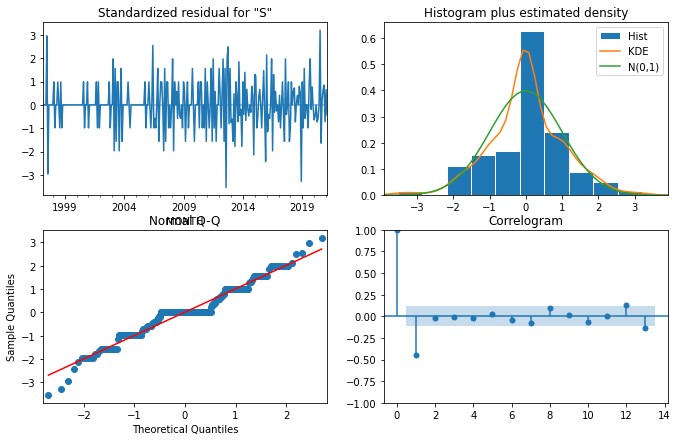

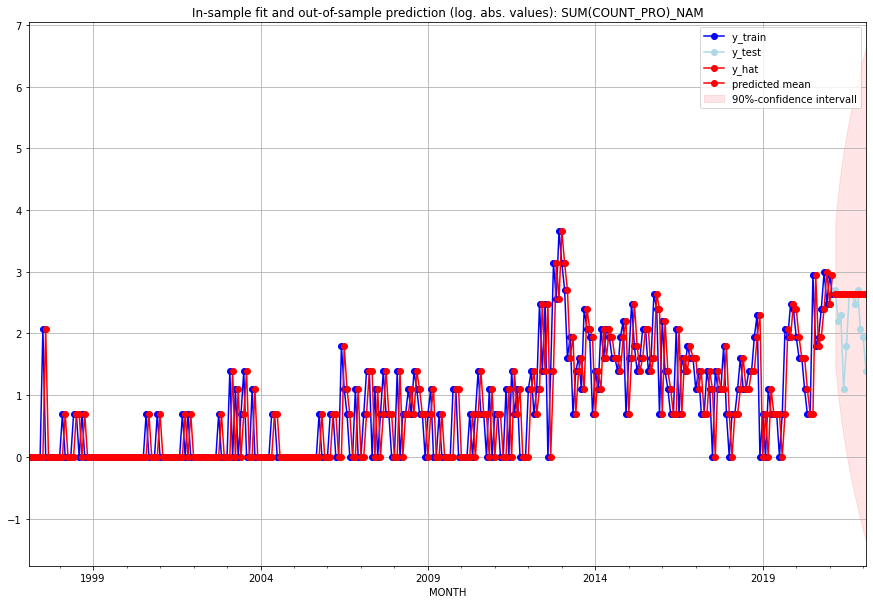

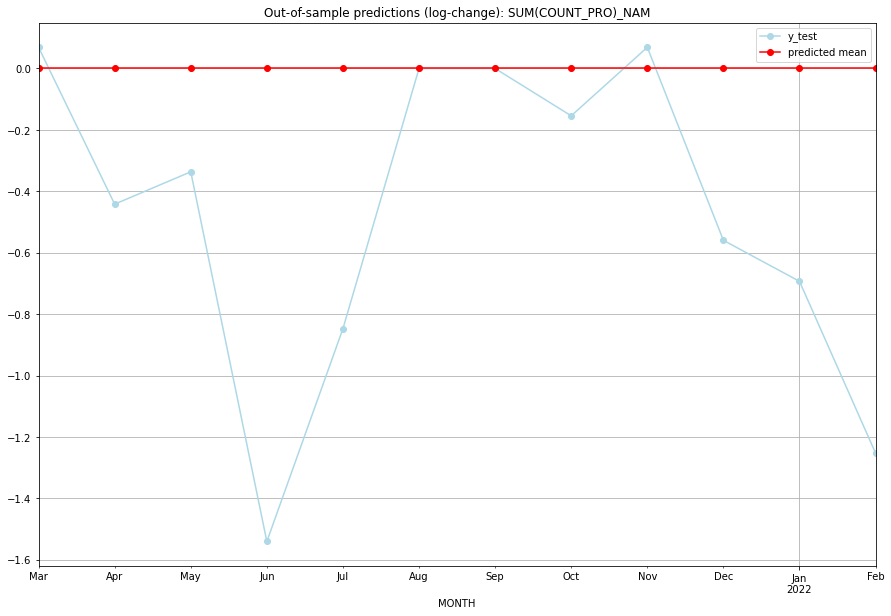

TADDA: 0.49697585416887496
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01      13.0        14.0           0.0        0.068993   NAM   
1  2021-04-01      13.0         8.0           0.0       -0.441833   NAM   
2  2021-05-01      13.0         9.0           0.0       -0.336472   NAM   
3  2021-06-01      13.0         2.0           0.0       -1.540445   NAM   
4  2021-07-01      13.0         5.0           0.0       -0.847298   NAM   
5  2021-08-01      13.0        13.0           0.0        0.000000   NAM   
6  2021-09-01      13.0        13.0           0.0        0.000000   NAM   
7  2021-10-01      13.0        11.0           0.0       -0.154151   NAM   
8  2021-11-01      13.0        14.0           0.0        0.068993   NAM   
9  2021-12-01      13.0         7.0           0.0       -0.559616   NAM   
10 2022-01-01      13.0         6.0           0.0       -0.693147   NAM   
11 2022-02-01      13.0         3.0           0.0   

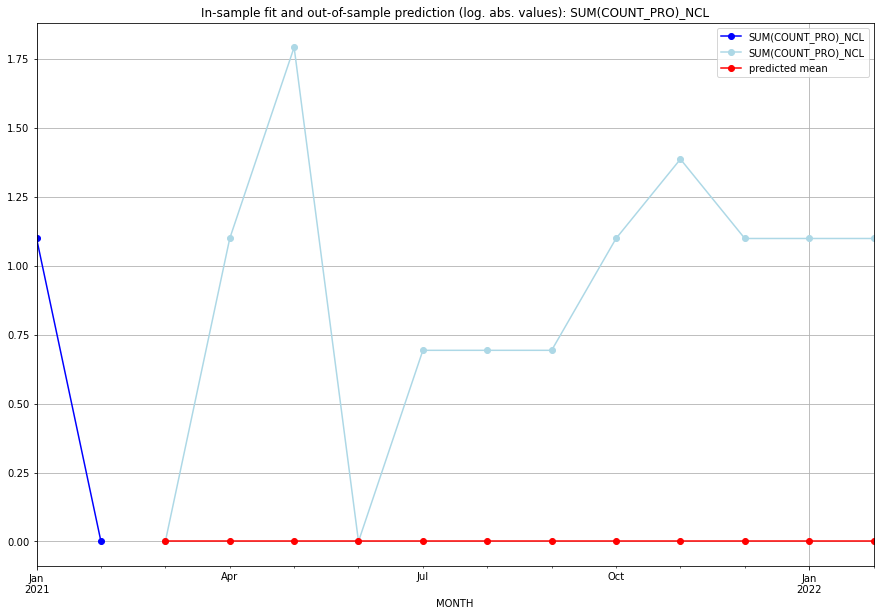

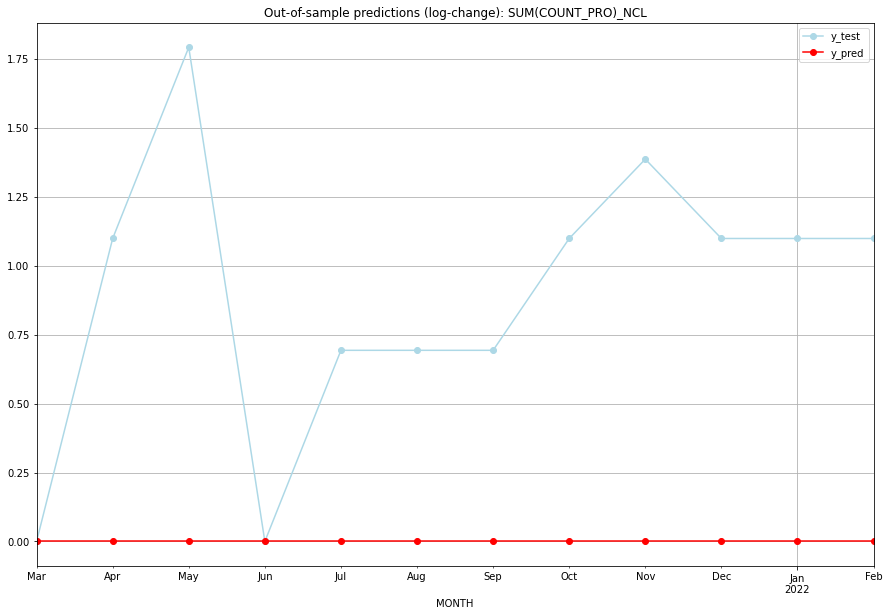

TADDA: 0.8958797346140274
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0    0.000000           0.0        0.000000   NCL   
1  2021-04-01       0.0    1.098612           0.0        1.098612   NCL   
2  2021-05-01       0.0    1.791759           0.0        1.791759   NCL   
3  2021-06-01       0.0    0.000000           0.0        0.000000   NCL   
4  2021-07-01       0.0    0.693147           0.0        0.693147   NCL   
5  2021-08-01       0.0    0.693147           0.0        0.693147   NCL   
6  2021-09-01       0.0    0.693147           0.0        0.693147   NCL   
7  2021-10-01       0.0    1.098612           0.0        1.098612   NCL   
8  2021-11-01       0.0    1.386294           0.0        1.386294   NCL   
9  2021-12-01       0.0    1.098612           0.0        1.098612   NCL   
10 2022-01-01       0.0    1.098612           0.0        1.098612   NCL   
11 2022-02-01       0.0    1.098612           0.0    

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (3, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.5023130236833484, 'fold_results': [0.5023130236833484]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_NER   No. Observations:                  289
Model:               SARIMAX(3, 0, 0)   Log Likelihood                -230.619
Date:                Fri, 16 Sep 2022   AIC                            469.239
Time:                        14:41:06   BIC                            483.904
Sample:                    02-28-1997   HQIC                           475.115
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.3756      0.054      6.957      0.000   

<Figure size 432x288 with 0 Axes>

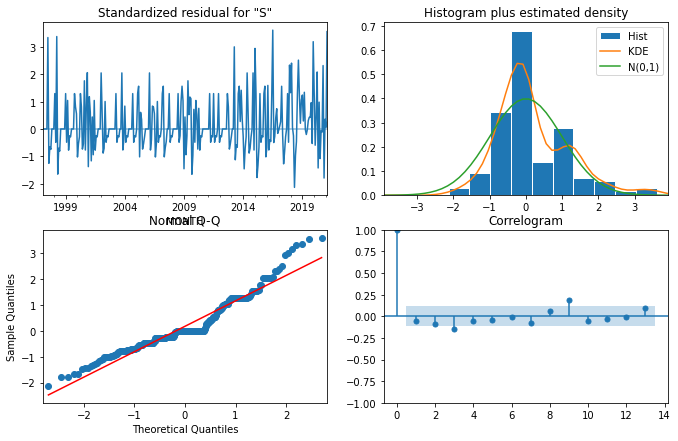

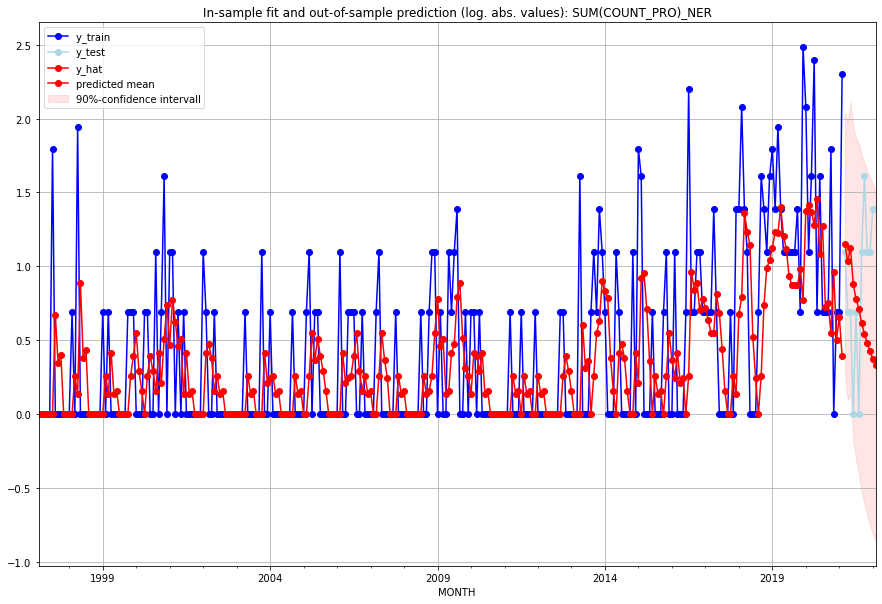

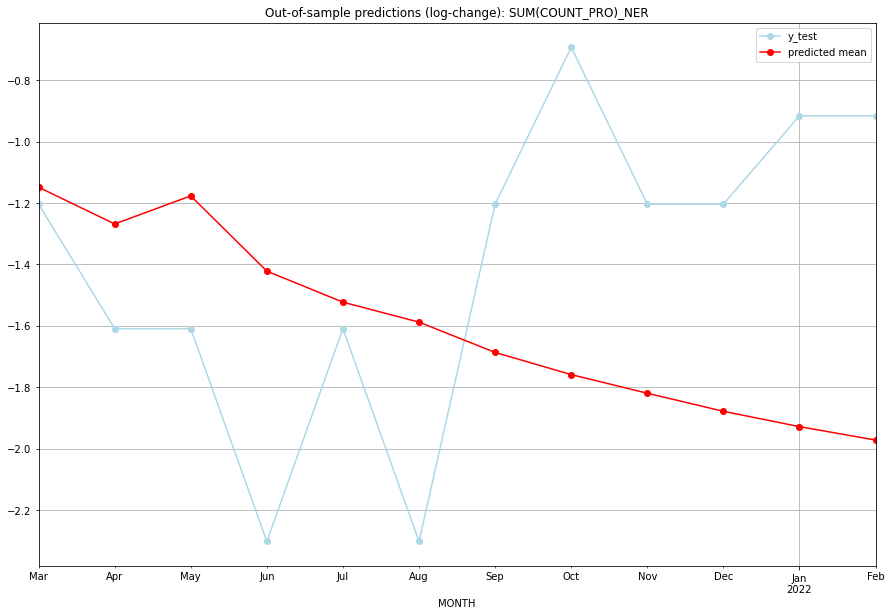

TADDA: 0.6180969087137951
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  2.170103         2.0     -1.148821       -1.203973   NER   
1  2021-04-01  1.812780         1.0     -1.268412       -1.609438   NER   
2  2021-05-01  2.081831         1.0     -1.177061       -1.609438   NER   
3  2021-06-01  1.412026         0.0     -1.422118       -2.302585   NER   
4  2021-07-01  1.180289         1.0     -1.523128       -1.609438   NER   
5  2021-08-01  1.042956         0.0     -1.588188       -2.302585   NER   
6  2021-09-01  0.851019         2.0     -1.686849       -1.203973   NER   
7  2021-10-01  0.722101         4.0     -1.759040       -0.693147   NER   
8  2021-11-01  0.620607         2.0     -1.819785       -1.203973   NER   
9  2021-12-01  0.528050         2.0     -1.878593       -1.203973   NER   
10 2022-01-01  0.453584         3.0     -1.928553       -0.916291   NER   
11 2022-02-01  0.391419         3.0     -1.972261    

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (1, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.3196185719420999, 'fold_results': [0.3196185719420999]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_NGA   No. Observations:                  289
Model:               SARIMAX(1, 1, 0)   Log Likelihood                -300.047
Date:                Fri, 16 Sep 2022   AIC                            604.095
Time:                        14:41:52   BIC                            611.420
Sample:                    02-28-1997   HQIC                           607.030
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.5082      0.037    -13.565      0.000   

<Figure size 432x288 with 0 Axes>

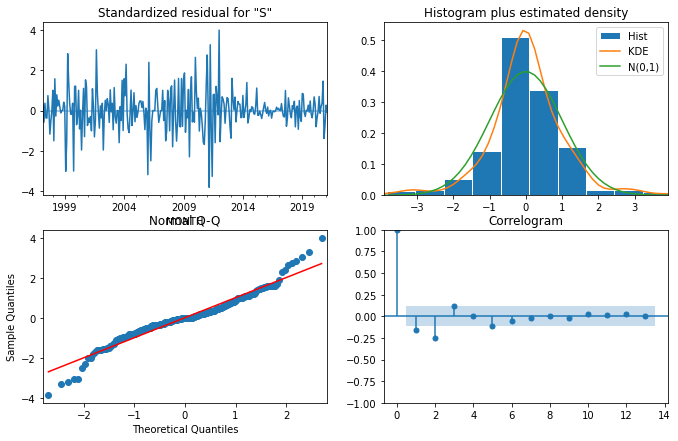

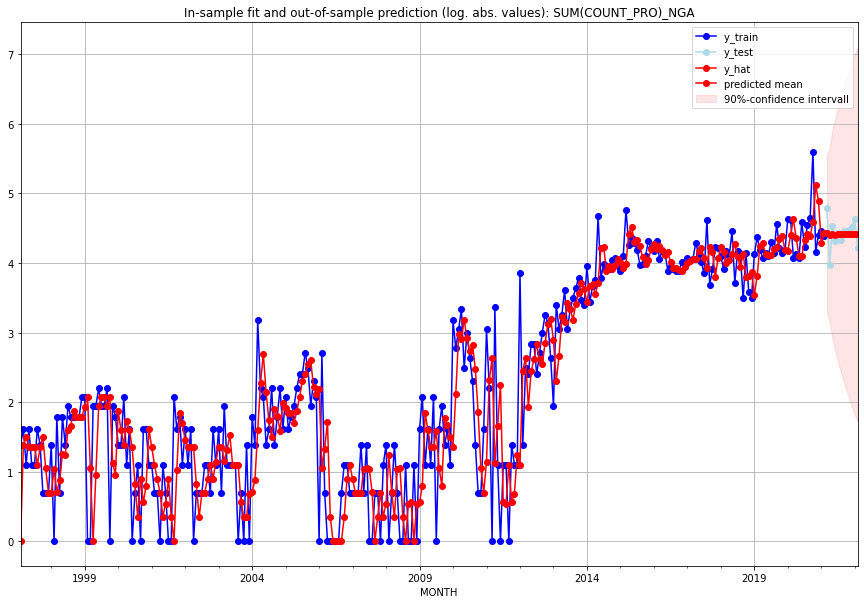

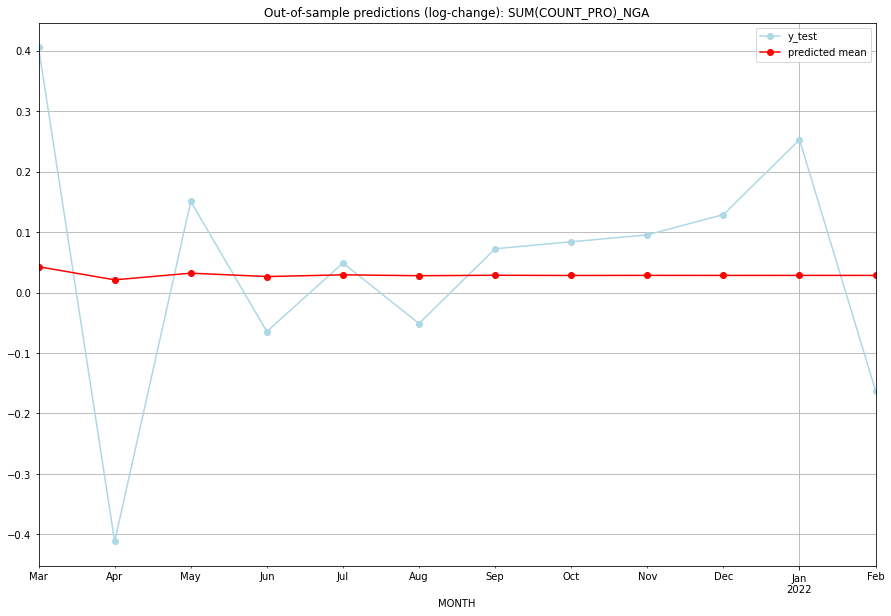

TADDA: 0.15744935736841834
Evaluation finished.
        MONTH   FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  82.484233       119.0      0.042631        0.405465   NGA   
1  2021-04-01  80.694879        52.0      0.020965       -0.411735   NGA   
2  2021-05-01  81.599439        92.0      0.031976        0.150573   NGA   
3  2021-06-01  81.138469        74.0      0.026380       -0.064539   NGA   
4  2021-07-01  81.372426        83.0      0.029224        0.048790   NGA   
5  2021-08-01  81.253439        75.0      0.027779       -0.051293   NGA   
6  2021-09-01  81.313890        85.0      0.028513        0.072321   NGA   
7  2021-10-01  81.283161        86.0      0.028140        0.083881   NGA   
8  2021-11-01  81.298777        87.0      0.028330        0.095310   NGA   
9  2021-12-01  81.290841        90.0      0.028233        0.128833   NGA   
10 2022-01-01  81.294874       102.0      0.028282        0.252702   NGA   
11 2022-02-01  81.292824        67.0    

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [1, (2, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.44698747176126025, 'fold_results': [0.44698747176126025]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_NIC   No. Observations:                   38
Model:               SARIMAX(2, 0, 0)   Log Likelihood                 -48.048
Date:                Fri, 16 Sep 2022   AIC                            104.096
Time:                        14:42:27   BIC                            110.646
Sample:                    01-31-2018   HQIC                           106.426
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1             0.0155      0.133      0.117      0.907 

<Figure size 432x288 with 0 Axes>

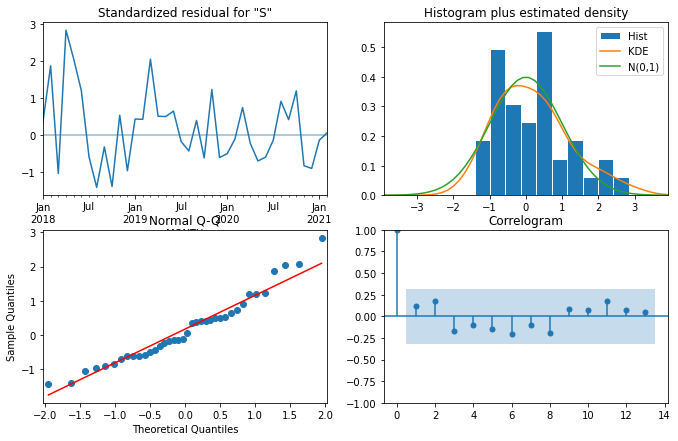

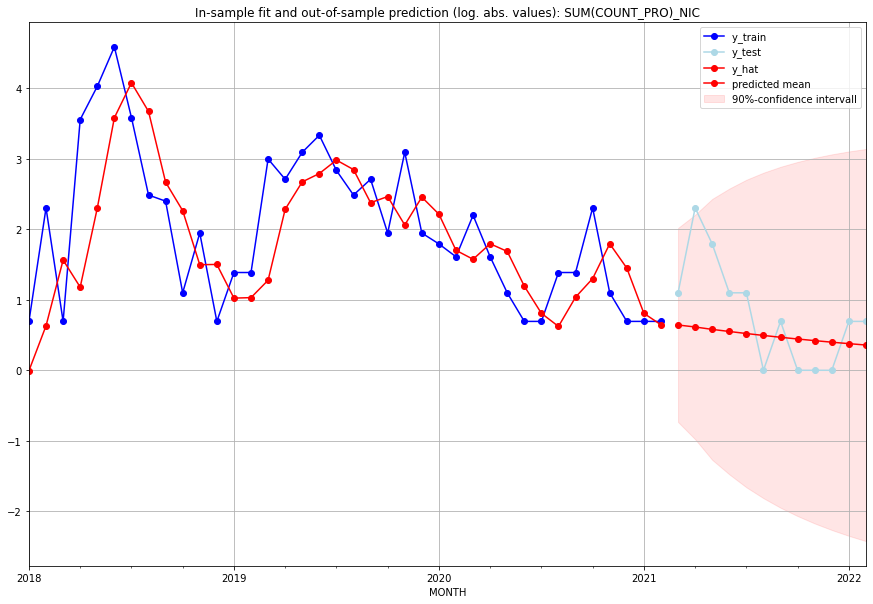

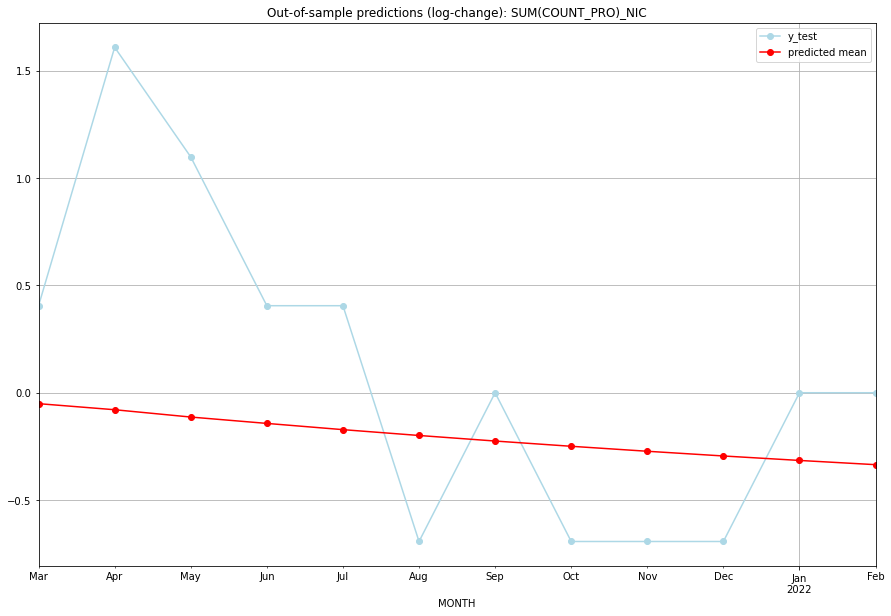

TADDA: 0.6394763230880982
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  0.900654         2.0     -0.050949        0.405465   NIC   
1  2021-04-01  0.847650         9.0     -0.079232        1.609438   NIC   
2  2021-05-01  0.785705         5.0     -0.113334        1.098612   NIC   
3  2021-06-01  0.733558         2.0     -0.142971        0.405465   NIC   
4  2021-07-01  0.683915         2.0     -0.172026        0.405465   NIC   
5  2021-08-01  0.638779         0.0     -0.199196       -0.693147   NIC   
6  2021-09-01  0.596925         1.0     -0.225067        0.000000   NIC   
7  2021-10-01  0.558334         0.0     -0.249530       -0.693147   NIC   
8  2021-11-01  0.522606         0.0     -0.272724       -0.693147   NIC   
9  2021-12-01  0.489522         0.0     -0.294692       -0.693147   NIC   
10 2022-01-01  0.458839         1.0     -0.315506        0.000000   NIC   
11 2022-02-01  0.430354         1.0     -0.335226    

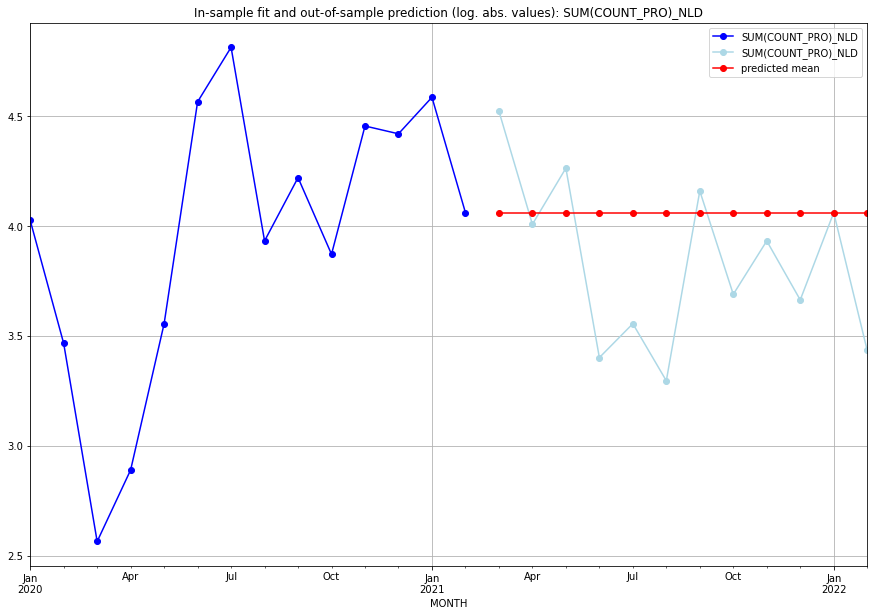

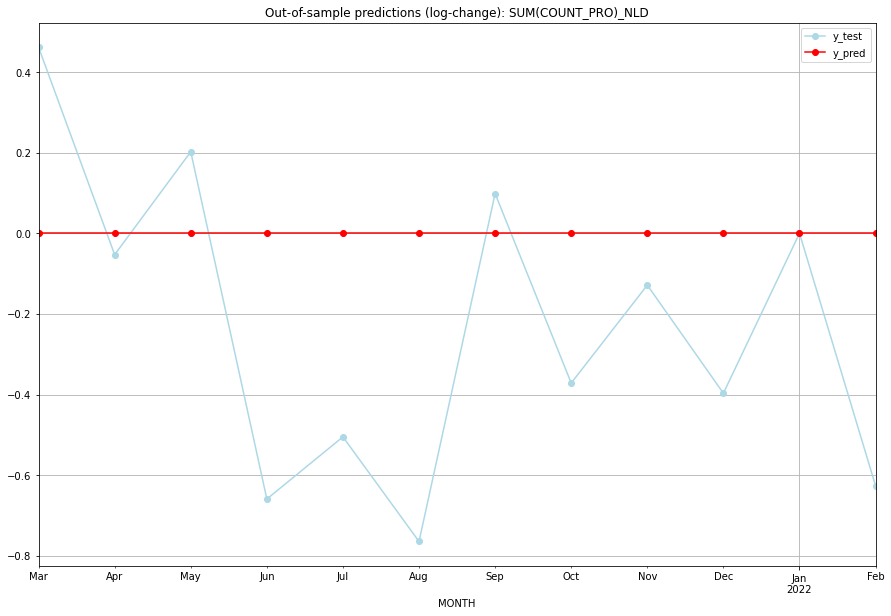

TADDA: 0.3556330965283918
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  4.060443    4.521789           0.0        0.461346   NLD   
1  2021-04-01  4.060443    4.007333           0.0       -0.053110   NLD   
2  2021-05-01  4.060443    4.262680           0.0        0.202237   NLD   
3  2021-06-01  4.060443    3.401197           0.0       -0.659246   NLD   
4  2021-07-01  4.060443    3.555348           0.0       -0.505095   NLD   
5  2021-08-01  4.060443    3.295837           0.0       -0.764606   NLD   
6  2021-09-01  4.060443    4.158883           0.0        0.098440   NLD   
7  2021-10-01  4.060443    3.688879           0.0       -0.371564   NLD   
8  2021-11-01  4.060443    3.931826           0.0       -0.128617   NLD   
9  2021-12-01  4.060443    3.663562           0.0       -0.396881   NLD   
10 2022-01-01  4.060443    4.060443           0.0        0.000000   NLD   
11 2022-02-01  4.060443    3.433987           0.0    

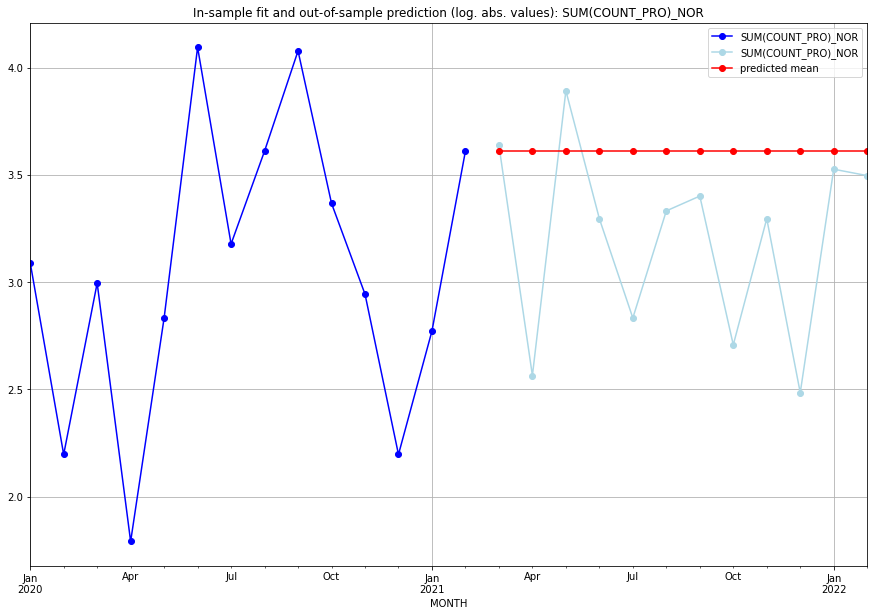

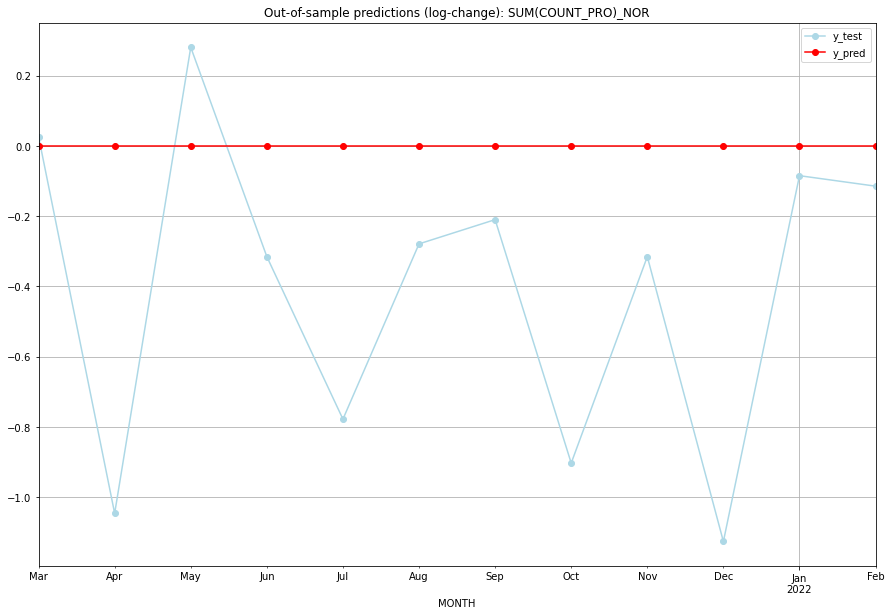

TADDA: 0.45647387472118184
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  3.610918    3.637586           0.0        0.026668   NOR   
1  2021-04-01  3.610918    2.564949           0.0       -1.045969   NOR   
2  2021-05-01  3.610918    3.891820           0.0        0.280902   NOR   
3  2021-06-01  3.610918    3.295837           0.0       -0.315081   NOR   
4  2021-07-01  3.610918    2.833213           0.0       -0.777705   NOR   
5  2021-08-01  3.610918    3.332205           0.0       -0.278713   NOR   
6  2021-09-01  3.610918    3.401197           0.0       -0.209721   NOR   
7  2021-10-01  3.610918    2.708050           0.0       -0.902868   NOR   
8  2021-11-01  3.610918    3.295837           0.0       -0.315081   NOR   
9  2021-12-01  3.610918    2.484907           0.0       -1.126011   NOR   
10 2022-01-01  3.610918    3.526361           0.0       -0.084557   NOR   
11 2022-02-01  3.610918    3.496508           0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (1, 0, 1), (0, 0, 0, 0), 'n'], 'cv_score': 0.8070389010767128, 'fold_results': [0.8070389010767128]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_NPL   No. Observations:                  134
Model:               SARIMAX(1, 0, 1)   Log Likelihood                -160.960
Date:                Fri, 16 Sep 2022   AIC                            327.920
Time:                        14:43:23   BIC                            336.613
Sample:                    01-31-2010   HQIC                           331.453
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.9992      0.002    425.324      0.000   

<Figure size 432x288 with 0 Axes>

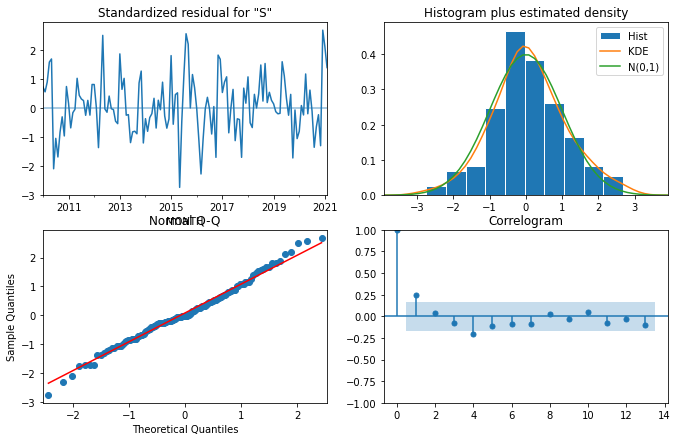

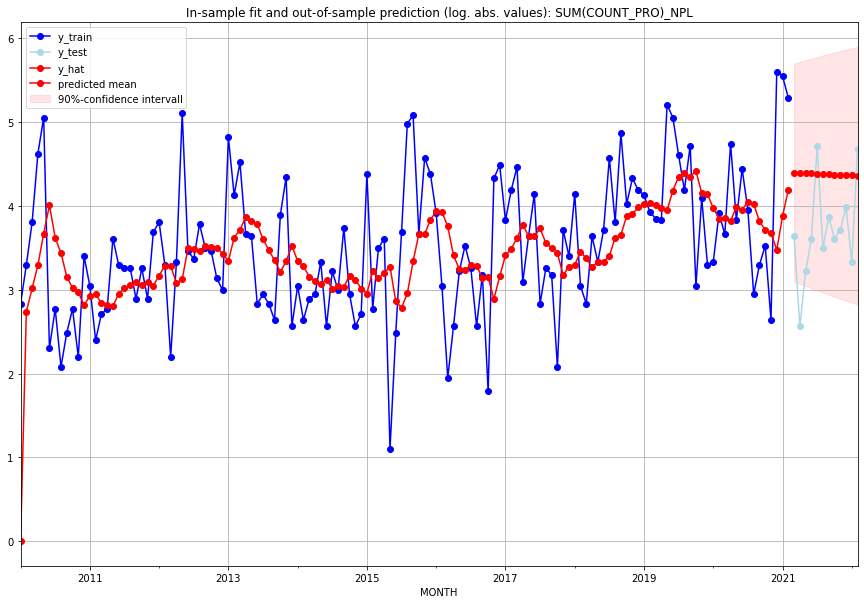

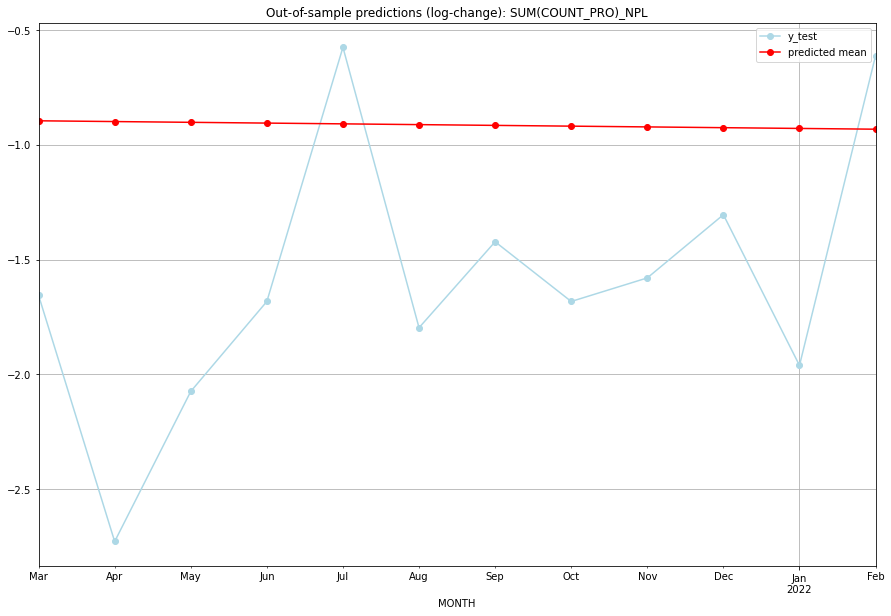

TADDA: 0.7850876988758397
Evaluation finished.
        MONTH   FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  80.310929        37.0     -0.895024       -1.655719   NPL   
1  2021-04-01  80.039548        12.0     -0.898368       -2.728355   NPL   
2  2021-05-01  79.769278        24.0     -0.901708       -2.074429   NPL   
3  2021-06-01  79.500113        36.0     -0.905046       -1.682387   NPL   
4  2021-07-01  79.232050       111.0     -0.908382       -0.574806   NPL   
5  2021-08-01  78.965081        32.0     -0.911715       -1.796797   NPL   
6  2021-09-01  78.699203        47.0     -0.915045       -1.422104   NPL   
7  2021-10-01  78.434410        36.0     -0.918373       -1.682387   NPL   
8  2021-11-01  78.170697        40.0     -0.921699       -1.579733   NPL   
9  2021-12-01  77.908059        53.0     -0.925021       -1.304321   NPL   
10 2022-01-01  77.646491        27.0     -0.928342       -1.961100   NPL   
11 2022-02-01  77.385988       107.0     

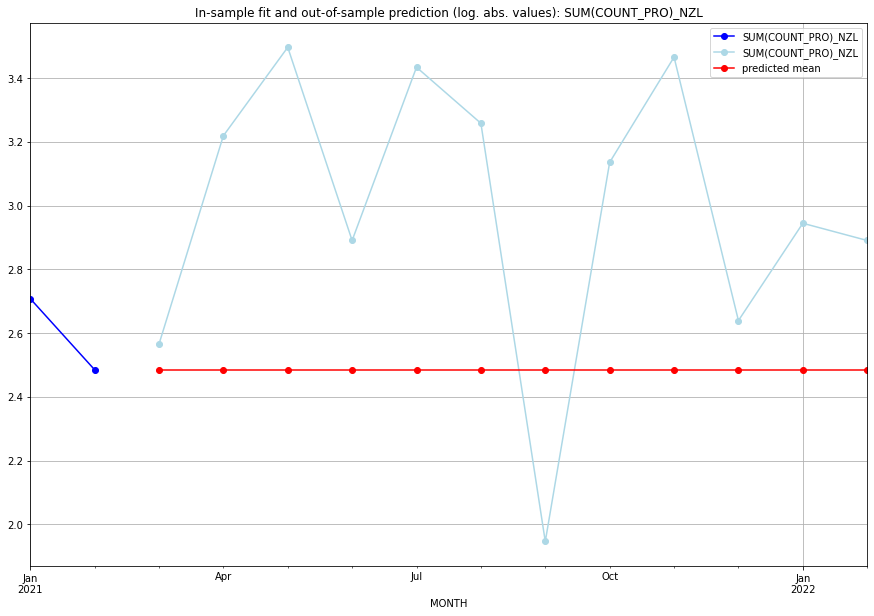

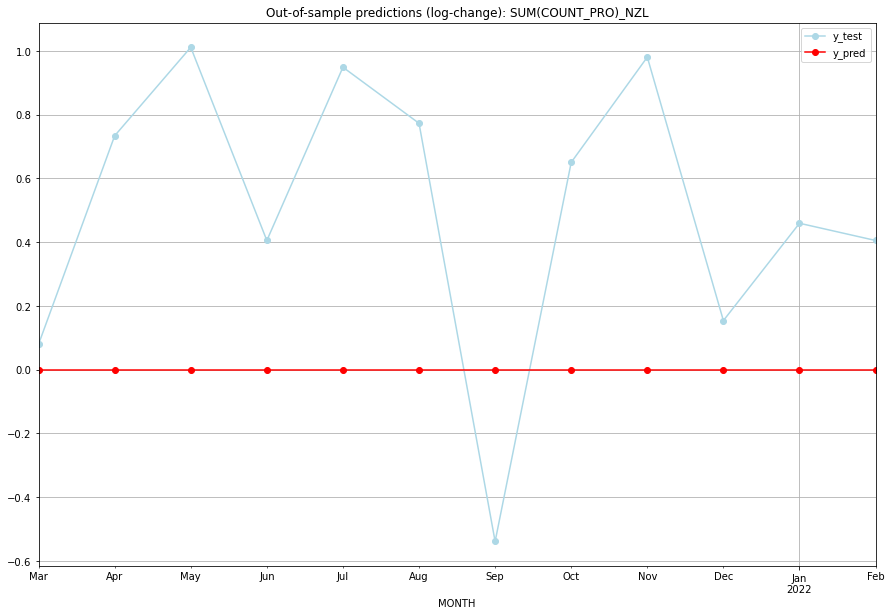

TADDA: 0.5952424818892027
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  2.484907    2.564949           0.0        0.080043   NZL   
1  2021-04-01  2.484907    3.218876           0.0        0.733969   NZL   
2  2021-05-01  2.484907    3.496508           0.0        1.011601   NZL   
3  2021-06-01  2.484907    2.890372           0.0        0.405465   NZL   
4  2021-07-01  2.484907    3.433987           0.0        0.949081   NZL   
5  2021-08-01  2.484907    3.258097           0.0        0.773190   NZL   
6  2021-09-01  2.484907    1.945910           0.0       -0.538997   NZL   
7  2021-10-01  2.484907    3.135494           0.0        0.650588   NZL   
8  2021-11-01  2.484907    3.465736           0.0        0.980829   NZL   
9  2021-12-01  2.484907    2.639057           0.0        0.154151   NZL   
10 2022-01-01  2.484907    2.944439           0.0        0.459532   NZL   
11 2022-02-01  2.484907    2.890372           0.0    

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.0, 'fold_results': [0.0]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_OMN   No. Observations:                   62
Model:                        SARIMAX   Log Likelihood                   0.179
Date:                Fri, 16 Sep 2022   AIC                              1.642
Time:                        14:43:58   BIC                              3.770
Sample:                    01-31-2016   HQIC                             2.478
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.0582      0.003     19.531      0.000       0.052       0.064
Ljung-Bo

<Figure size 432x288 with 0 Axes>

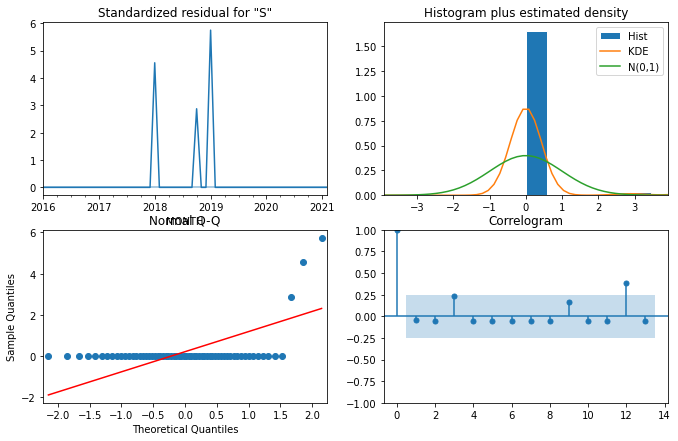

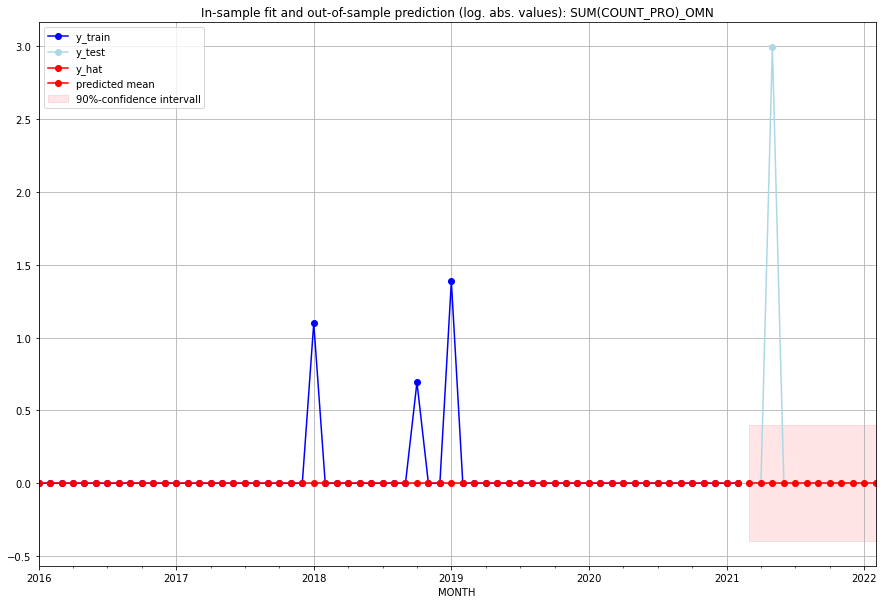

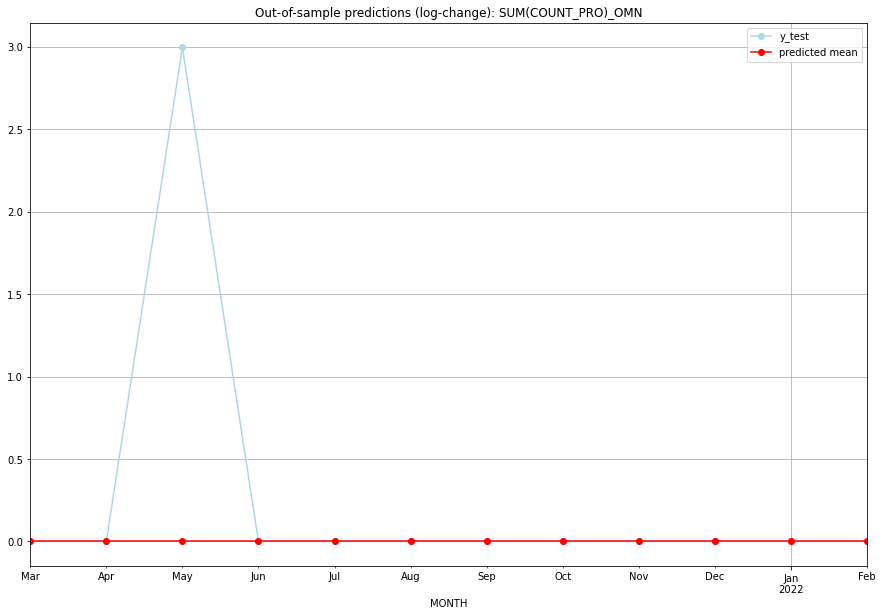

TADDA: 0.24964435612949923
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0        0.000000   OMN   
1  2021-04-01       0.0         0.0           0.0        0.000000   OMN   
2  2021-05-01       0.0        19.0           0.0        2.995732   OMN   
3  2021-06-01       0.0         0.0           0.0        0.000000   OMN   
4  2021-07-01       0.0         0.0           0.0        0.000000   OMN   
5  2021-08-01       0.0         0.0           0.0        0.000000   OMN   
6  2021-09-01       0.0         0.0           0.0        0.000000   OMN   
7  2021-10-01       0.0         0.0           0.0        0.000000   OMN   
8  2021-11-01       0.0         0.0           0.0        0.000000   OMN   
9  2021-12-01       0.0         0.0           0.0        0.000000   OMN   
10 2022-01-01       0.0         0.0           0.0        0.000000   OMN   
11 2022-02-01       0.0         0.0           0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 1, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.38731443491538564, 'fold_results': [0.38731443491538564]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_PAK   No. Observations:                  134
Model:               SARIMAX(0, 1, 3)   Log Likelihood                 -74.276
Date:                Fri, 16 Sep 2022   AIC                            156.553
Time:                        14:44:46   BIC                            168.114
Sample:                    01-31-2010   HQIC                           161.251
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ma.L1         -0.6769      0.068     -9.943      0.000 

<Figure size 432x288 with 0 Axes>

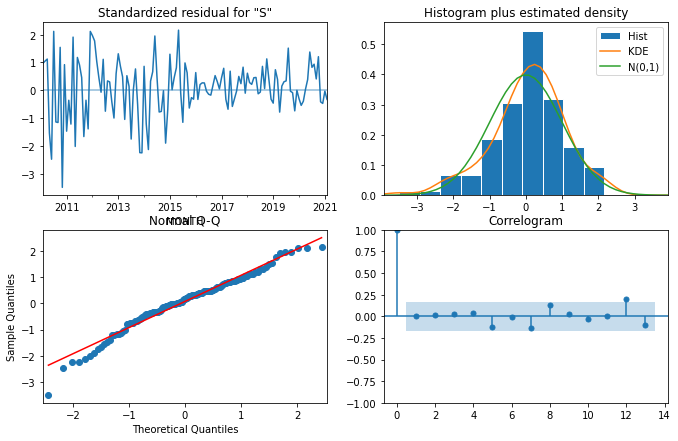

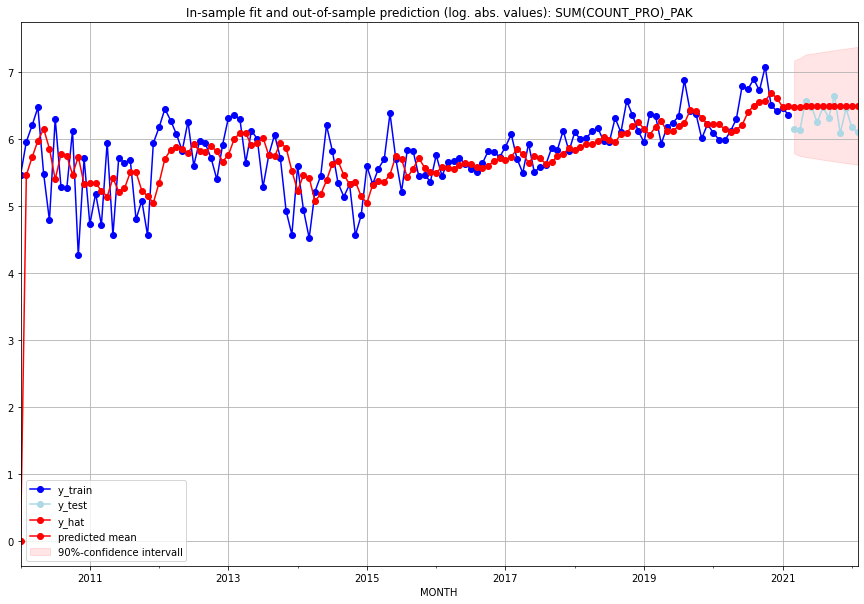

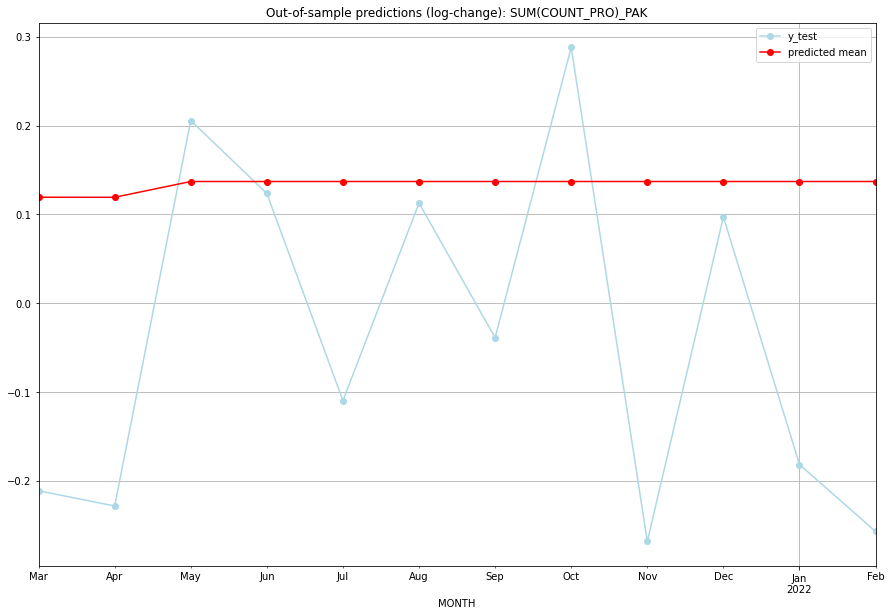

TADDA: 0.286630720457499
Evaluation finished.
        MONTH    FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  650.249430       467.0      0.119319       -0.211106   PAK   
1  2021-04-01  650.205477       459.0      0.119251       -0.228347   PAK   
2  2021-05-01  661.888253       709.0      0.137033        0.205691   PAK   
3  2021-06-01  661.888253       653.0      0.137033        0.123533   PAK   
4  2021-07-01  661.888253       517.0      0.137033       -0.109599   PAK   
5  2021-08-01  661.888253       646.0      0.137033        0.112772   PAK   
6  2021-09-01  661.888253       555.0      0.137033       -0.038806   PAK   
7  2021-10-01  661.888253       770.0      0.137033        0.288115   PAK   
8  2021-11-01  661.888253       441.0      0.137033       -0.268264   PAK   
9  2021-12-01  661.888253       636.0      0.137033        0.097196   PAK   
10 2022-01-01  661.888253       481.0      0.137033       -0.181630   PAK   
11 2022-02-01  661.888253     

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.2336637364864731, 'fold_results': [0.2336637364864731]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_PAN   No. Observations:                   38
Model:               SARIMAX(0, 1, 0)   Log Likelihood                 -27.629
Date:                Fri, 16 Sep 2022   AIC                             57.258
Time:                        14:45:33   BIC                             58.869
Sample:                    01-31-2018   HQIC                            57.826
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.2607      0.056      4.649      0.000   

<Figure size 432x288 with 0 Axes>

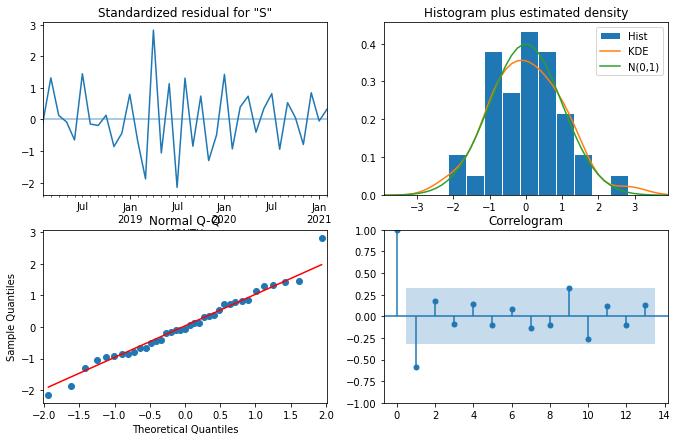

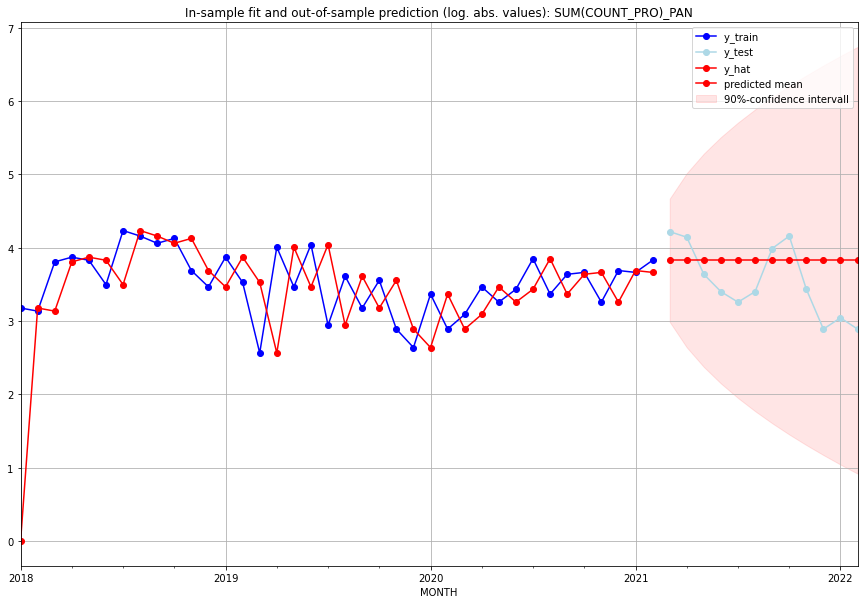

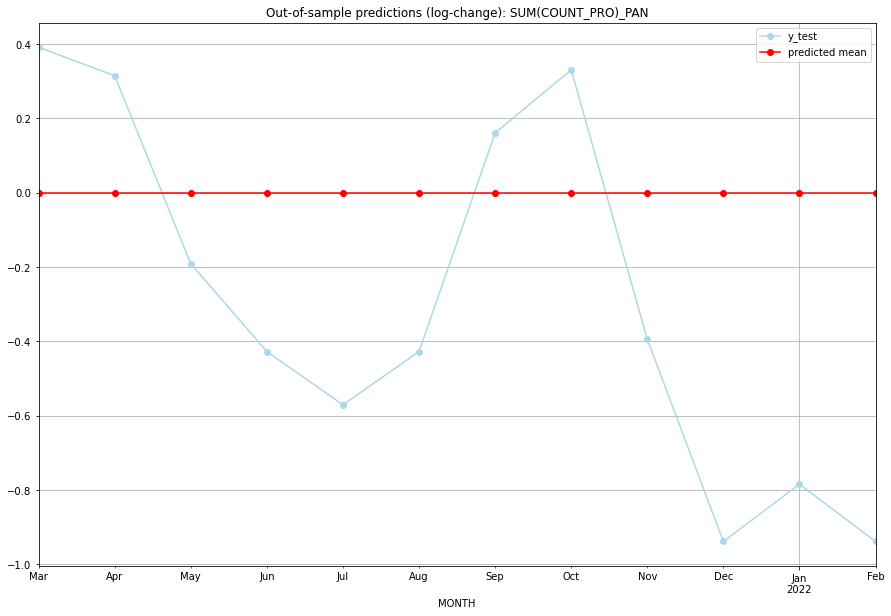

TADDA: 0.4889787106979075
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01      45.0        67.0           0.0        0.390866   PAN   
1  2021-04-01      45.0        62.0           0.0        0.314493   PAN   
2  2021-05-01      45.0        37.0           0.0       -0.191055   PAN   
3  2021-06-01      45.0        29.0           0.0       -0.427444   PAN   
4  2021-07-01      45.0        25.0           0.0       -0.570545   PAN   
5  2021-08-01      45.0        29.0           0.0       -0.427444   PAN   
6  2021-09-01      45.0        53.0           0.0        0.160343   PAN   
7  2021-10-01      45.0        63.0           0.0        0.330242   PAN   
8  2021-11-01      45.0        30.0           0.0       -0.394654   PAN   
9  2021-12-01      45.0        17.0           0.0       -0.938270   PAN   
10 2022-01-01      45.0        20.0           0.0       -0.784119   PAN   
11 2022-02-01      45.0        17.0           0.0    

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [3, (1, 1, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.4265769705777475, 'fold_results': [0.4265769705777475]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_PER   No. Observations:                   38
Model:               SARIMAX(1, 1, 3)   Log Likelihood                  -5.186
Date:                Fri, 16 Sep 2022   AIC                             26.372
Time:                        14:46:28   BIC                             39.259
Sample:                    01-31-2018   HQIC                            30.915
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            -0.0096      0.025     -0.380      0.704   

<Figure size 432x288 with 0 Axes>

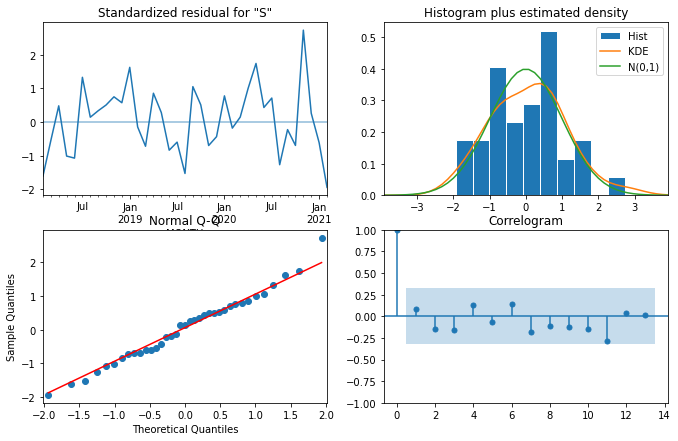

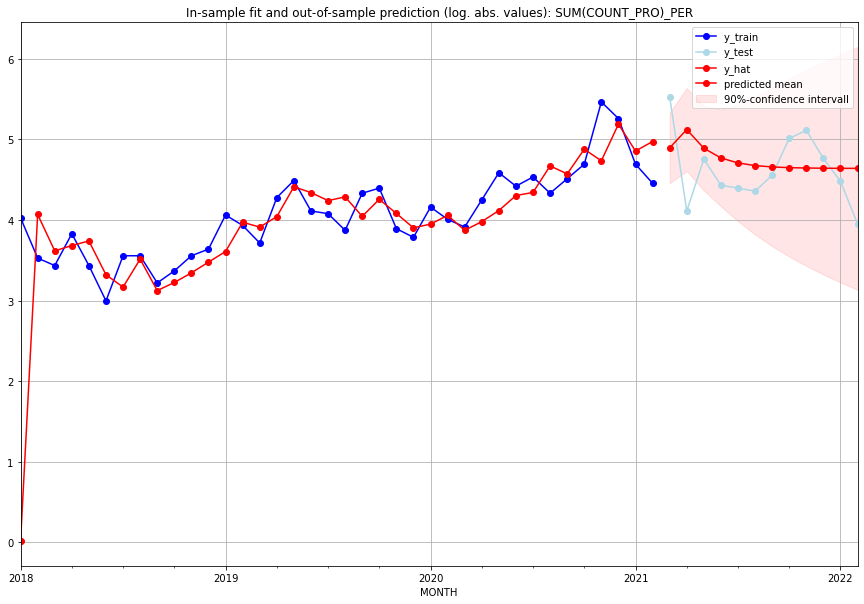

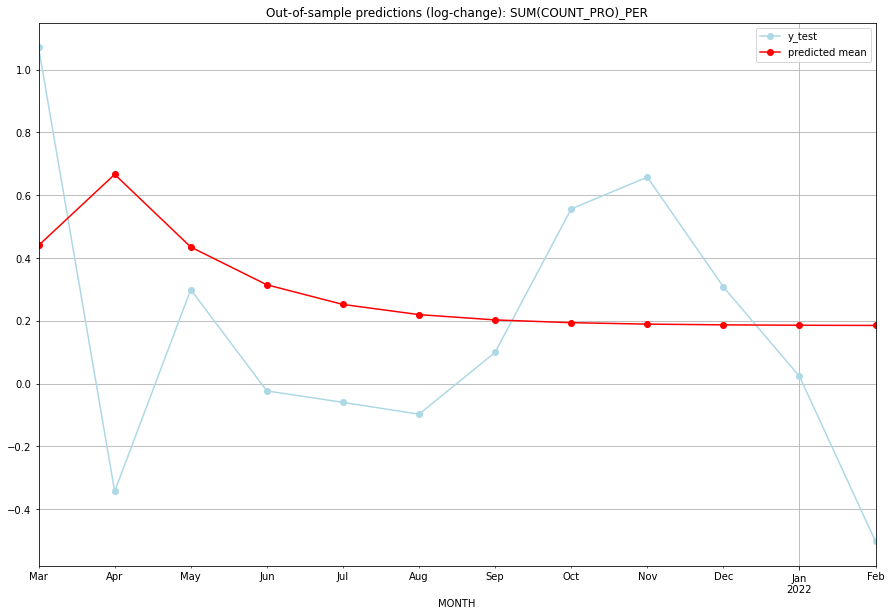

TADDA: 0.5238976740671116
Evaluation finished.
        MONTH    FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  132.536694       250.0      0.440029        1.071106   PER   
1  2021-04-01  166.438351        60.0      0.666268       -0.343473   PER   
2  2021-05-01  131.843938       115.0      0.434828        0.299243   PER   
3  2021-06-01  116.789215        83.0      0.314549       -0.023530   PER   
4  2021-07-01  109.651836        80.0      0.252041       -0.059898   PER   
5  2021-08-01  106.115054        77.0      0.219556       -0.097638   PER   
6  2021-09-01  104.321878        94.0      0.202674        0.099530   PER   
7  2021-10-01  103.401860       149.0      0.193900        0.556288   PER   
8  2021-11-01  102.926909       165.0      0.189341        0.657640   PER   
9  2021-12-01  102.680933       116.0      0.186971        0.307827   PER   
10 2022-01-01  102.553330        87.0      0.185739        0.022990   PER   
11 2022-02-01  102.487078    

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (3, 1, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.4648611545807335, 'fold_results': [0.4648611545807335]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_PHL   No. Observations:                   62
Model:               SARIMAX(3, 1, 3)   Log Likelihood                 -58.567
Date:                Fri, 16 Sep 2022   AIC                            131.134
Time:                        14:47:03   BIC                            145.910
Sample:                    01-31-2016   HQIC                           136.925
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.1362      0.204      0.669      0.503   

<Figure size 432x288 with 0 Axes>

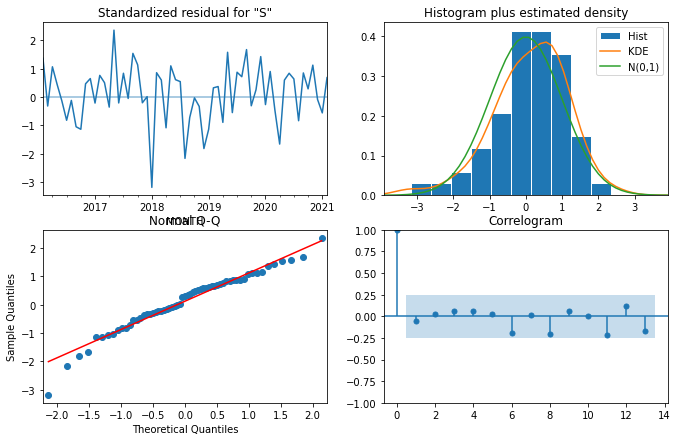

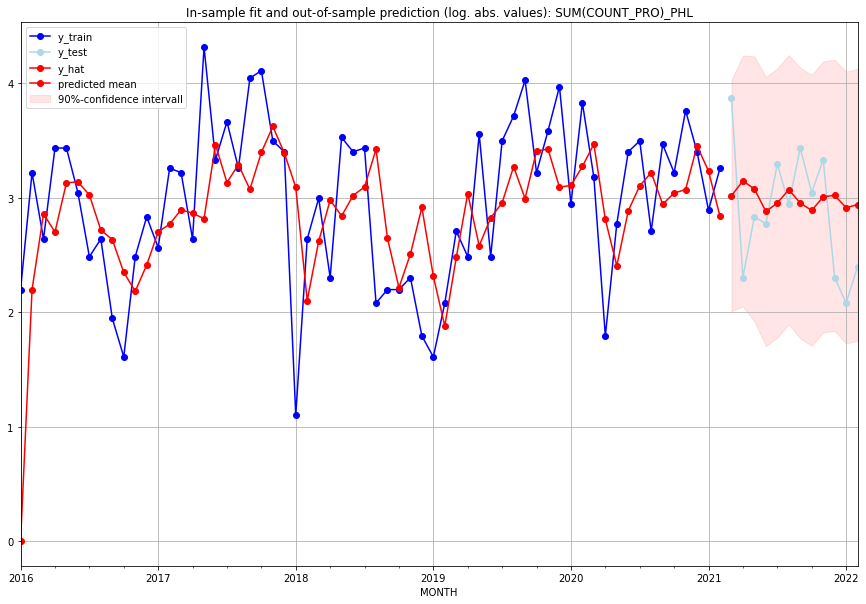

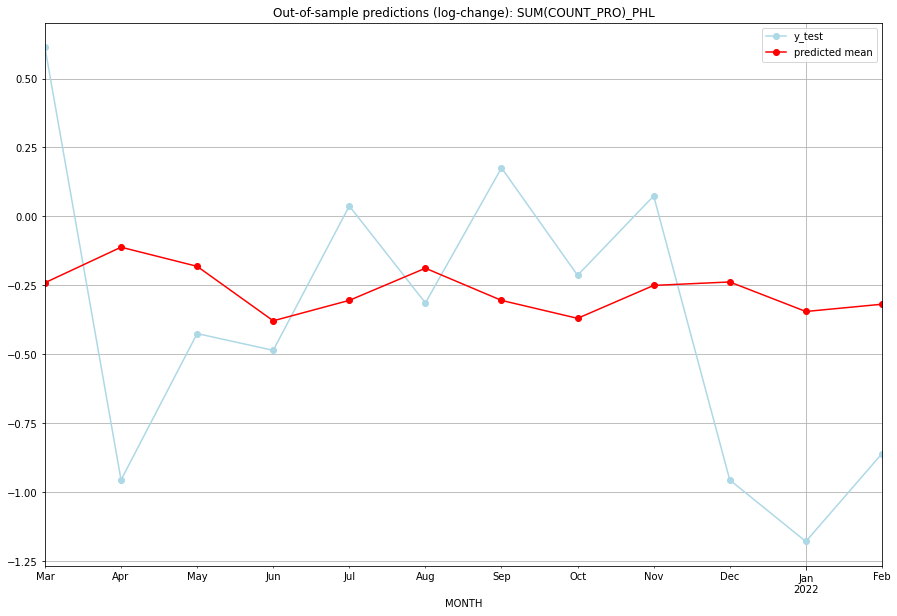

TADDA: 0.5558446488590195
Evaluation finished.
        MONTH   FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  19.441943        47.0     -0.240508        0.613104   PHL   
1  2021-04-01  22.253978         9.0     -0.111620       -0.955511   PHL   
2  2021-05-01  20.694593        16.0     -0.181033       -0.424883   PHL   
3  2021-06-01  16.807696        15.0     -0.378466       -0.485508   PHL   
4  2021-07-01  18.176794        26.0     -0.304396        0.037740   PHL   
5  2021-08-01  20.547972        18.0     -0.187815       -0.313658   PHL   
6  2021-09-01  18.174804        30.0     -0.304499        0.175891   PHL   
7  2021-10-01  16.966878        20.0     -0.369567       -0.213574   PHL   
8  2021-11-01  19.245225        27.0     -0.250178        0.074108   PHL   
9  2021-12-01  19.499540         9.0     -0.237694       -0.955511   PHL   
10 2022-01-01  17.418319         7.0     -0.344751       -1.178655   PHL   
11 2022-02-01  17.909933        10.0     

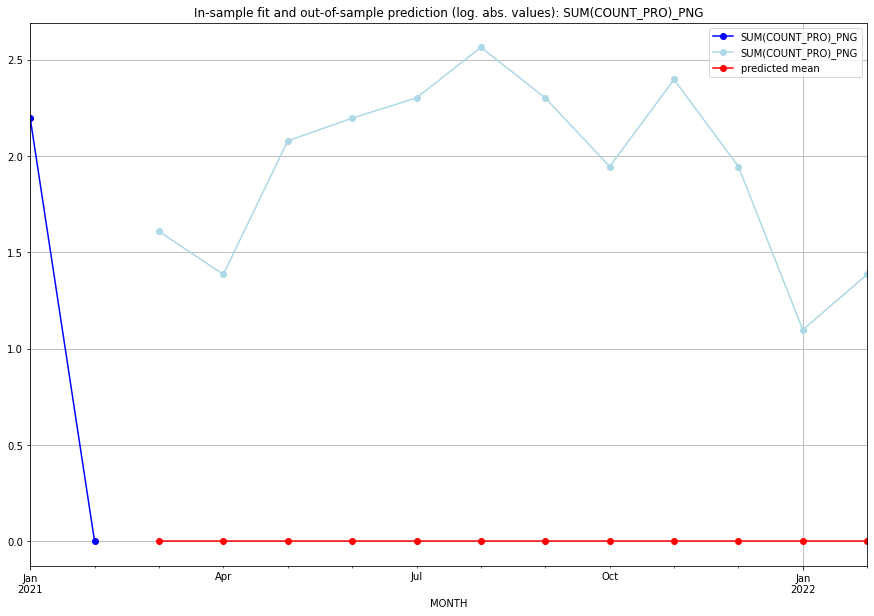

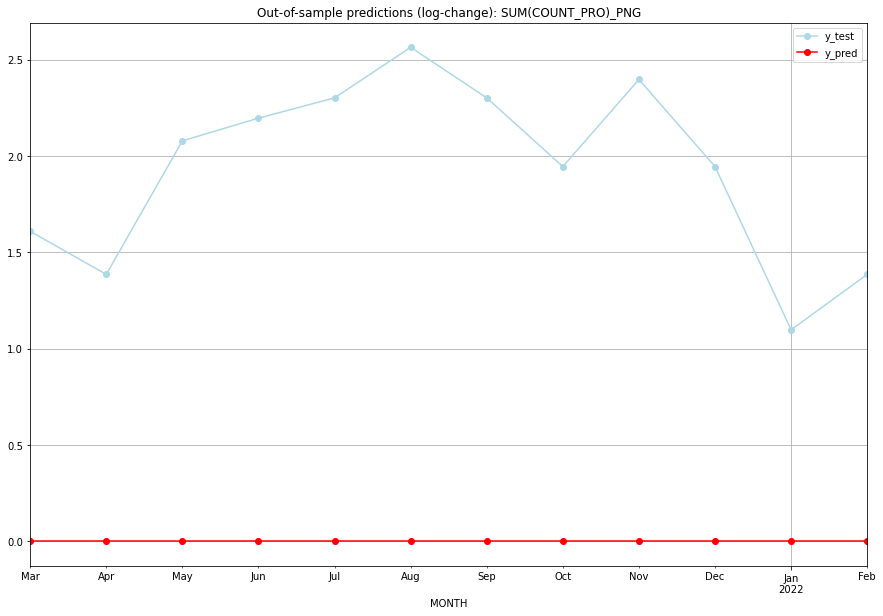

TADDA: 1.9347616797263891
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0    1.609438           0.0        1.609438   PNG   
1  2021-04-01       0.0    1.386294           0.0        1.386294   PNG   
2  2021-05-01       0.0    2.079442           0.0        2.079442   PNG   
3  2021-06-01       0.0    2.197225           0.0        2.197225   PNG   
4  2021-07-01       0.0    2.302585           0.0        2.302585   PNG   
5  2021-08-01       0.0    2.564949           0.0        2.564949   PNG   
6  2021-09-01       0.0    2.302585           0.0        2.302585   PNG   
7  2021-10-01       0.0    1.945910           0.0        1.945910   PNG   
8  2021-11-01       0.0    2.397895           0.0        2.397895   PNG   
9  2021-12-01       0.0    1.945910           0.0        1.945910   PNG   
10 2022-01-01       0.0    1.098612           0.0        1.098612   PNG   
11 2022-02-01       0.0    1.386294           0.0    

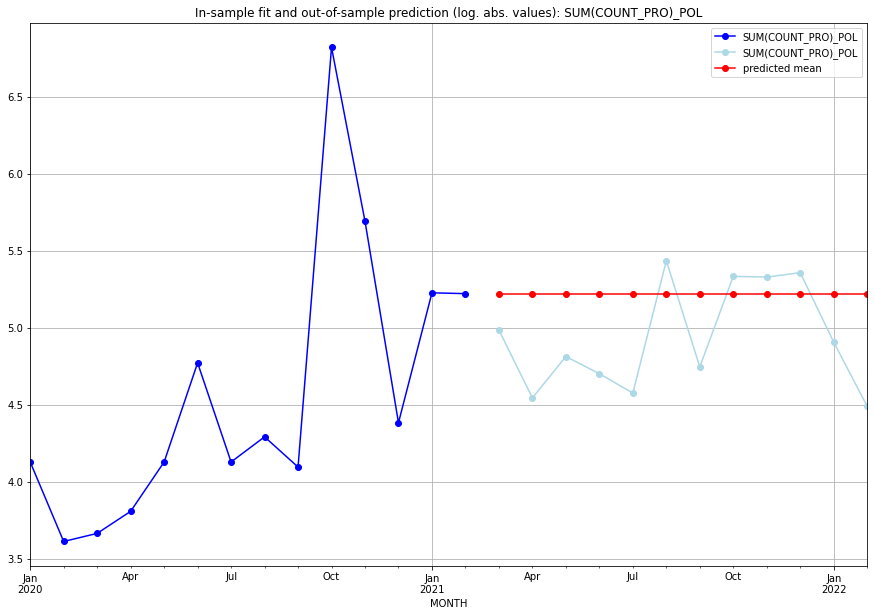

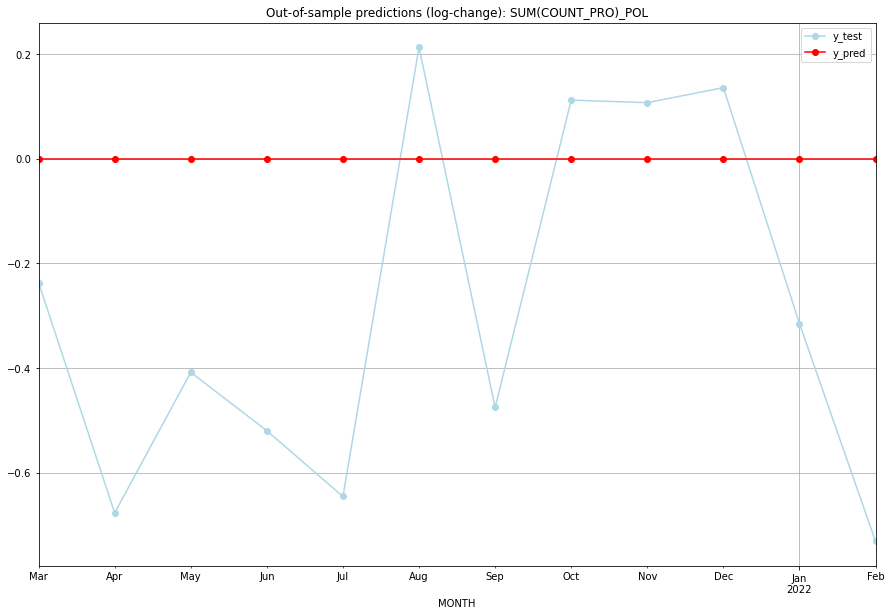

TADDA: 0.3816005133678437
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  5.220356    4.983607           0.0       -0.236749   POL   
1  2021-04-01  5.220356    4.543295           0.0       -0.677061   POL   
2  2021-05-01  5.220356    4.812184           0.0       -0.408171   POL   
3  2021-06-01  5.220356    4.700480           0.0       -0.519875   POL   
4  2021-07-01  5.220356    4.574711           0.0       -0.645645   POL   
5  2021-08-01  5.220356    5.433722           0.0        0.213366   POL   
6  2021-09-01  5.220356    4.744932           0.0       -0.475424   POL   
7  2021-10-01  5.220356    5.332719           0.0        0.112363   POL   
8  2021-11-01  5.220356    5.327876           0.0        0.107520   POL   
9  2021-12-01  5.220356    5.356586           0.0        0.136230   POL   
10 2022-01-01  5.220356    4.905275           0.0       -0.315081   POL   
11 2022-02-01  5.220356    4.488636           0.0    

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (2, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.5503123135685867, 'fold_results': [0.5503123135685867]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_PRI   No. Observations:                   38
Model:               SARIMAX(2, 0, 0)   Log Likelihood                 -37.823
Date:                Fri, 16 Sep 2022   AIC                             81.646
Time:                        14:47:42   BIC                             86.558
Sample:                    01-31-2018   HQIC                            83.394
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.6513      0.186      3.494      0.000   

<Figure size 432x288 with 0 Axes>

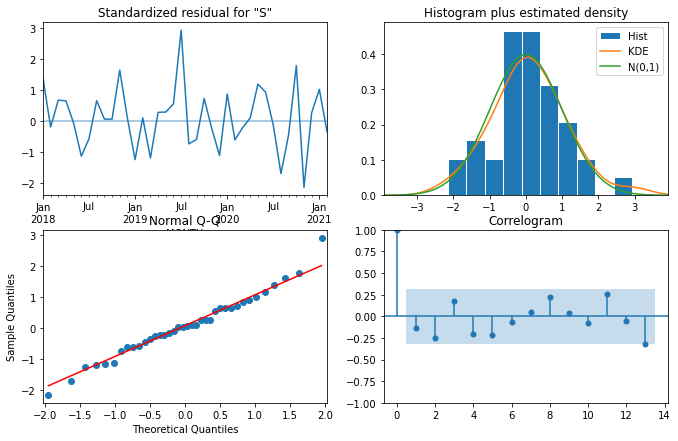

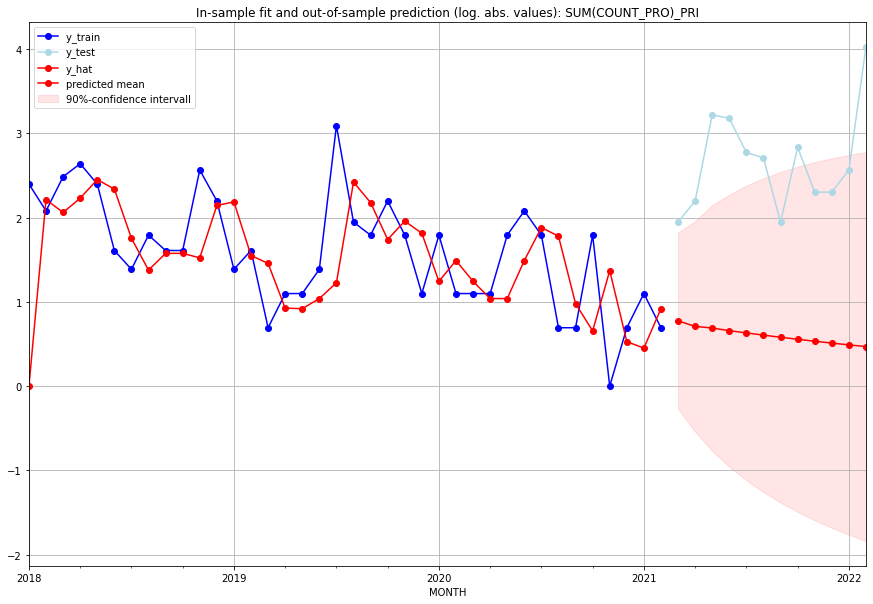

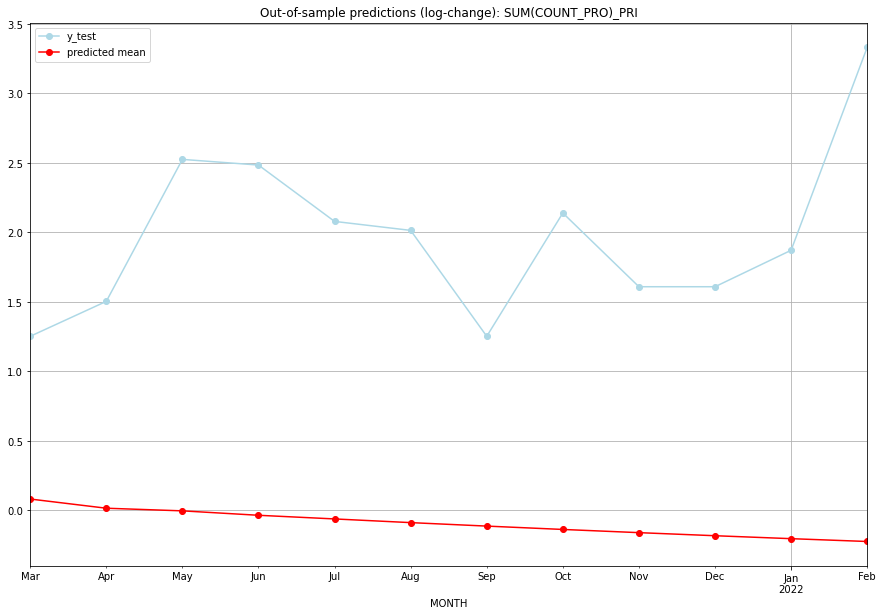

TADDA: 2.1661396117798657
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  1.170522         6.0      0.081821        1.252763   PRI   
1  2021-04-01  1.031660         8.0      0.015706        1.504077   PRI   
2  2021-05-01  0.993493        24.0     -0.003259        2.525729   PRI   
3  2021-06-01  0.931055        23.0     -0.035080        2.484907   PRI   
4  2021-07-01  0.880912        15.0     -0.061391        2.079442   PRI   
5  2021-08-01  0.831710        14.0     -0.087897        2.014903   PRI   
6  2021-09-01  0.786465         6.0     -0.112909        1.252763   PRI   
7  2021-10-01  0.743933        16.0     -0.137004        2.140066   PRI   
8  2021-11-01  0.704180         9.0     -0.160063        1.609438   PRI   
9  2021-12-01  0.666908         9.0     -0.182177        1.609438   PRI   
10 2022-01-01  0.631952        12.0     -0.203370        1.871802   PRI   
11 2022-02-01  0.599134        55.0     -0.223685    

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.057762265046662105, 'fold_results': [0.057762265046662105]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_PRK   No. Observations:                   38
Model:                        SARIMAX   Log Likelihood                  -4.921
Date:                Fri, 16 Sep 2022   AIC                             11.843
Time:                        14:48:07   BIC                             13.481
Sample:                    01-31-2018   HQIC                            12.426
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.0759      0.006     13.077      0.00

<Figure size 432x288 with 0 Axes>

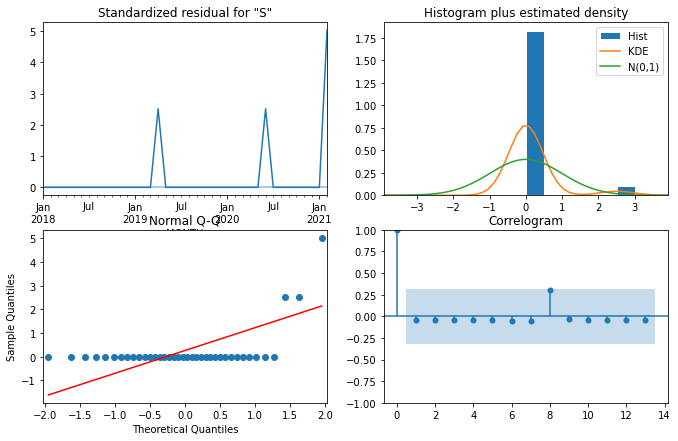

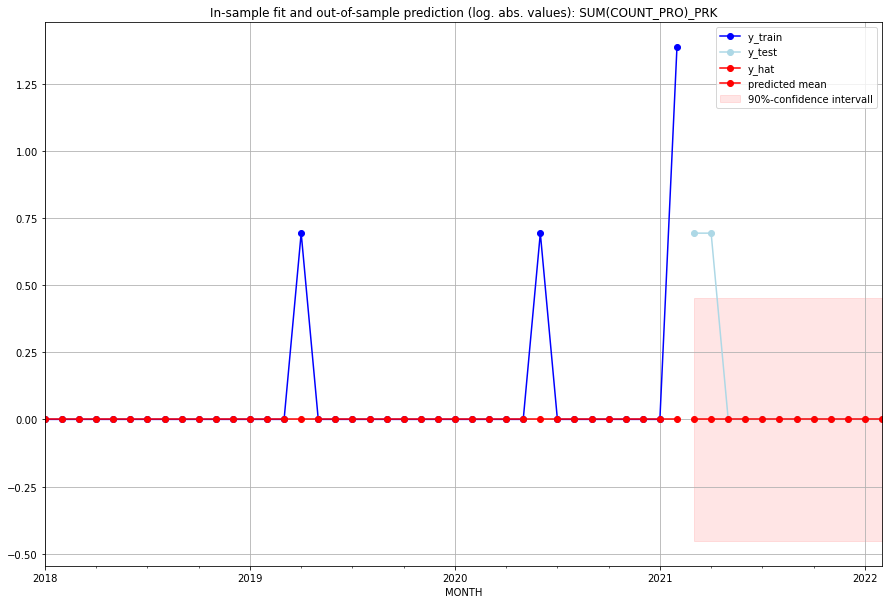

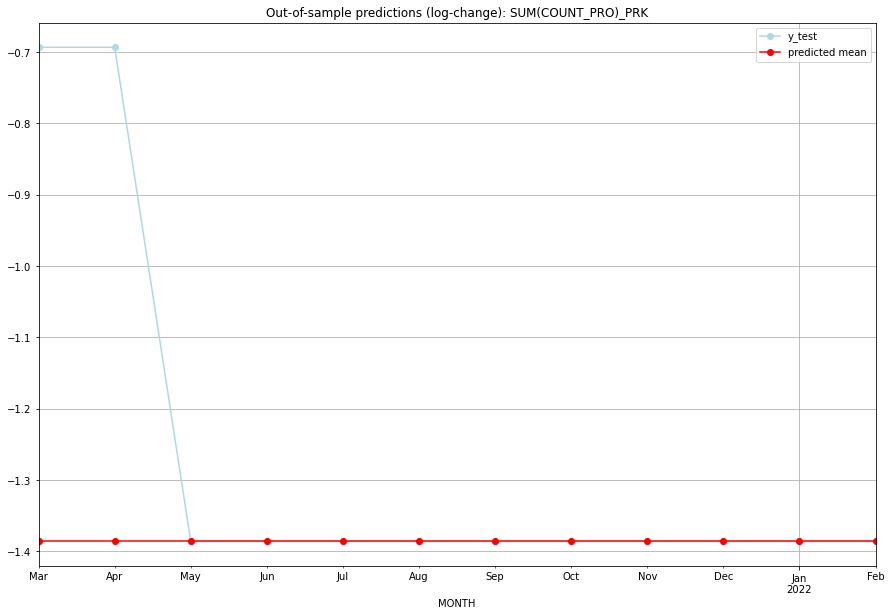

TADDA: 0.11552453009332421
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         1.0     -1.386294       -0.693147   PRK   
1  2021-04-01       0.0         1.0     -1.386294       -0.693147   PRK   
2  2021-05-01       0.0         0.0     -1.386294       -1.386294   PRK   
3  2021-06-01       0.0         0.0     -1.386294       -1.386294   PRK   
4  2021-07-01       0.0         0.0     -1.386294       -1.386294   PRK   
5  2021-08-01       0.0         0.0     -1.386294       -1.386294   PRK   
6  2021-09-01       0.0         0.0     -1.386294       -1.386294   PRK   
7  2021-10-01       0.0         0.0     -1.386294       -1.386294   PRK   
8  2021-11-01       0.0         0.0     -1.386294       -1.386294   PRK   
9  2021-12-01       0.0         0.0     -1.386294       -1.386294   PRK   
10 2022-01-01       0.0         0.0     -1.386294       -1.386294   PRK   
11 2022-02-01       0.0         0.0     -1.386294   

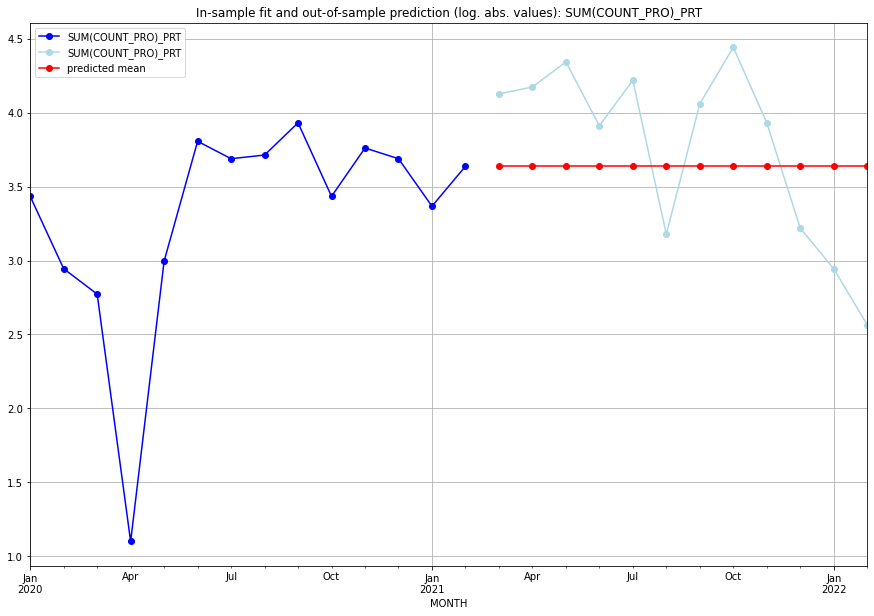

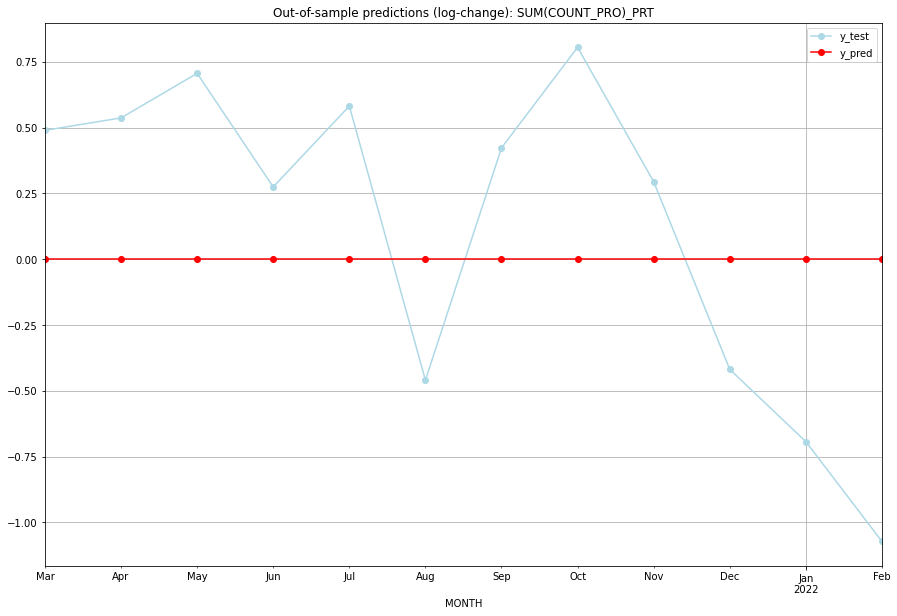

TADDA: 0.5629262547008383
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  3.637586    4.127134           0.0        0.489548   PRT   
1  2021-04-01  3.637586    4.174387           0.0        0.536801   PRT   
2  2021-05-01  3.637586    4.343805           0.0        0.706219   PRT   
3  2021-06-01  3.637586    3.912023           0.0        0.274437   PRT   
4  2021-07-01  3.637586    4.219508           0.0        0.581922   PRT   
5  2021-08-01  3.637586    3.178054           0.0       -0.459532   PRT   
6  2021-09-01  3.637586    4.060443           0.0        0.422857   PRT   
7  2021-10-01  3.637586    4.442651           0.0        0.805065   PRT   
8  2021-11-01  3.637586    3.931826           0.0        0.294239   PRT   
9  2021-12-01  3.637586    3.218876           0.0       -0.418710   PRT   
10 2022-01-01  3.637586    2.944439           0.0       -0.693147   PRT   
11 2022-02-01  3.637586    2.564949           0.0    

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (3, 1, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.5163860235280305, 'fold_results': [0.5163860235280305]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_PRY   No. Observations:                   38
Model:               SARIMAX(3, 1, 3)   Log Likelihood                 -24.972
Date:                Fri, 16 Sep 2022   AIC                             63.943
Time:                        14:48:38   BIC                             75.220
Sample:                    01-31-2018   HQIC                            67.919
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.2782      0.955     -0.291      0.771   

<Figure size 432x288 with 0 Axes>

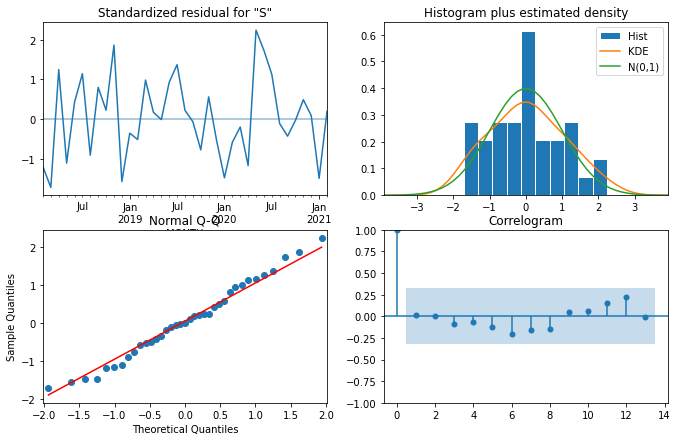

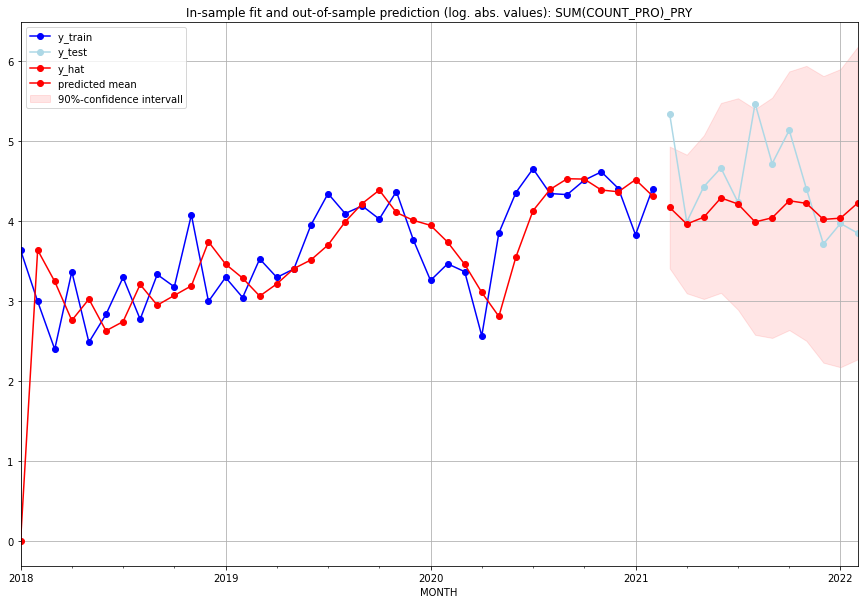

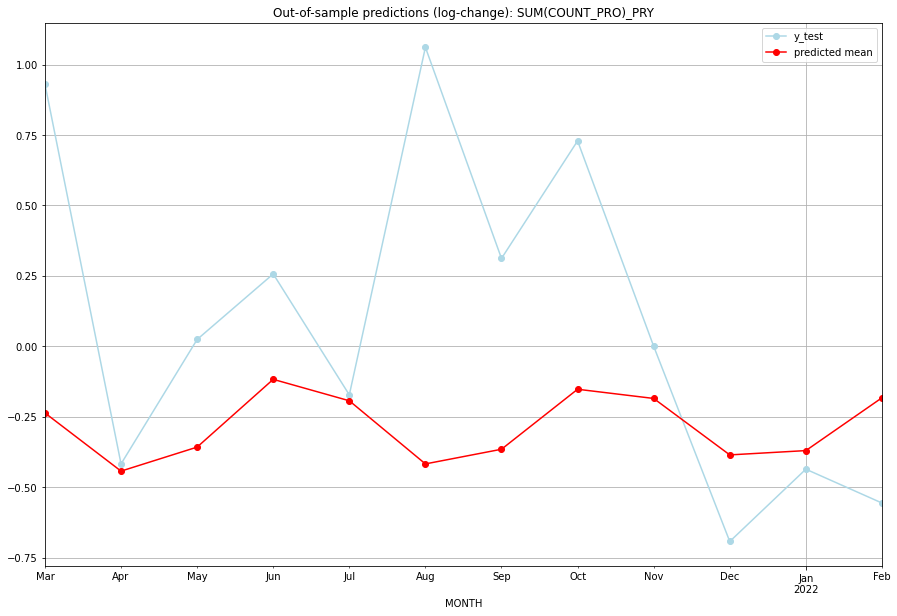

TADDA: 0.6324508535683637
Evaluation finished.
        MONTH   FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  63.709789       207.0     -0.236807        0.930819   PRY   
1  2021-04-01  51.638349        53.0     -0.443274       -0.417735   PRY   
2  2021-05-01  56.320382        83.0     -0.358063        0.024098   PRY   
3  2021-06-01  71.911334       105.0     -0.117475        0.256720   PRY   
4  2021-07-01  66.570058        68.0     -0.193554       -0.172613   PRY   
5  2021-08-01  53.001597       236.0     -0.417706        1.061341   PRY   
6  2021-09-01  55.886766       111.0     -0.365657        0.311780   PRY   
7  2021-10-01  69.390057       169.0     -0.152667        0.729079   PRY   
8  2021-11-01  67.129844        81.0     -0.185304        0.000000   PRY   
9  2021-12-01  54.756952        40.0     -0.385717       -0.693147   PRY   
10 2022-01-01  55.614856        52.0     -0.370448       -0.436427   PRY   
11 2022-02-01  67.291090        46.0     

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [1, (2, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.31803611723254127, 'fold_results': [0.31803611723254127]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_PSE   No. Observations:                   62
Model:               SARIMAX(2, 1, 0)   Log Likelihood                 -29.335
Date:                Fri, 16 Sep 2022   AIC                             66.669
Time:                        14:49:05   BIC                             75.113
Sample:                    01-31-2016   HQIC                            69.978
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            -0.0339      0.034     -0.993      0.321 

<Figure size 432x288 with 0 Axes>

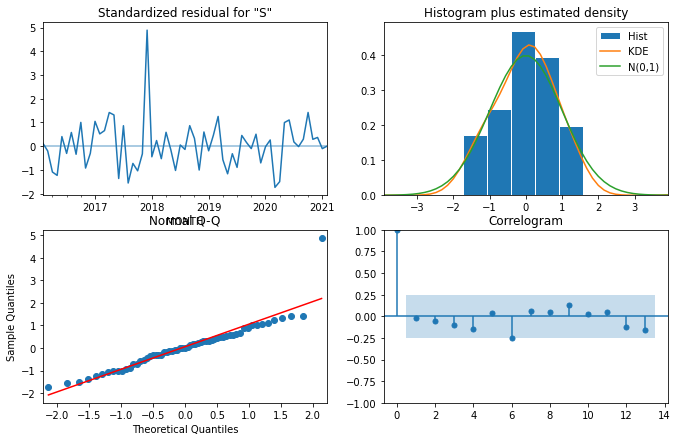

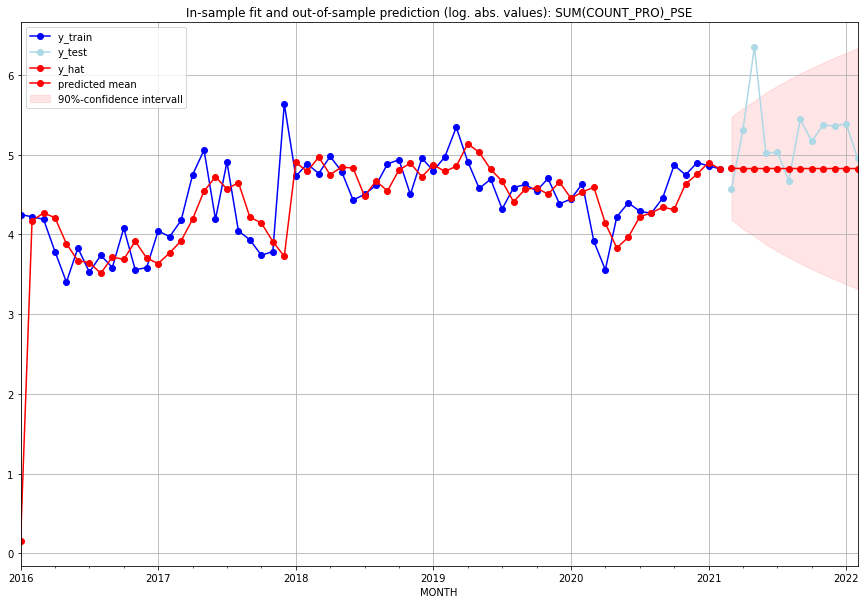

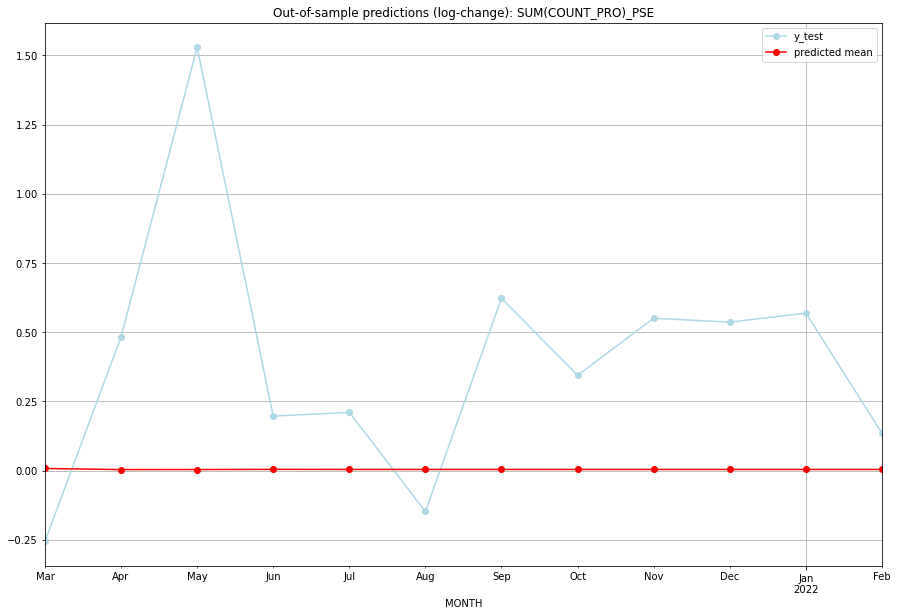

TADDA: 0.46347138909561303
Evaluation finished.
        MONTH    FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  123.970075        95.0      0.007793       -0.255933   PSE   
1  2021-04-01  123.469540       200.0      0.003779        0.483023   PSE   
2  2021-05-01  123.488259       571.0      0.003930        1.528857   PSE   
3  2021-06-01  123.568601       150.0      0.004575        0.196998   PSE   
4  2021-07-01  123.535026       152.0      0.004305        0.210156   PSE   
5  2021-08-01  123.533633       106.0      0.004294       -0.147453   PSE   
6  2021-09-01  123.540030       230.0      0.004346        0.622136   PSE   
7  2021-10-01  123.537861       174.0      0.004328        0.344504   PSE   
8  2021-11-01  123.537560       214.0      0.004326        0.550356   PSE   
9  2021-12-01  123.538053       211.0      0.004330        0.536305   PSE   
10 2022-01-01  123.537920       218.0      0.004329        0.568790   PSE   
11 2022-02-01  123.537884   

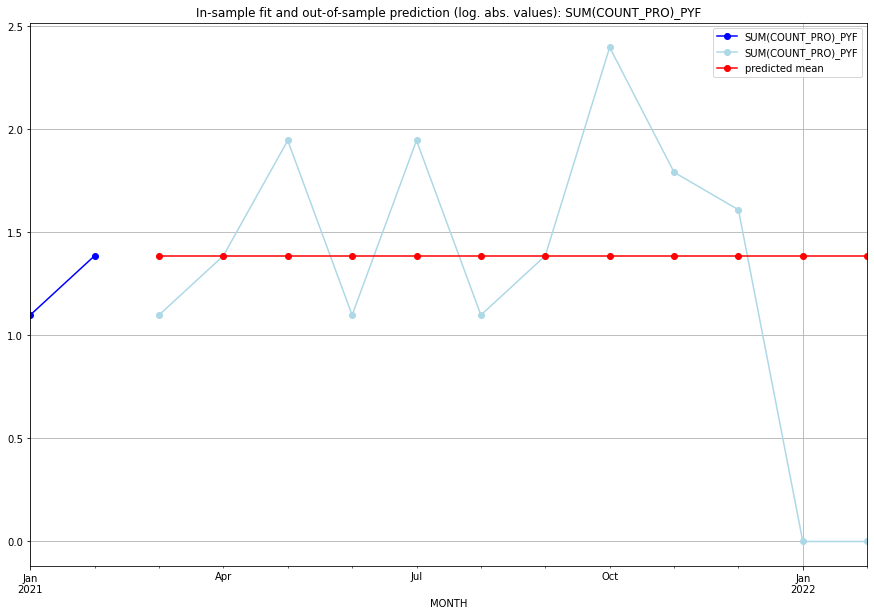

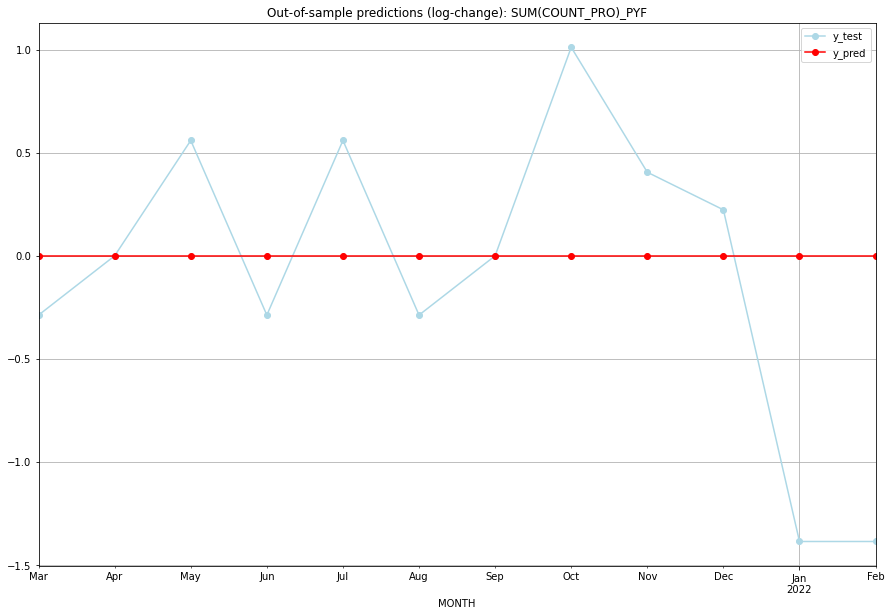

TADDA: 0.5329230072139018
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  1.386294    1.098612           0.0       -0.287682   PYF   
1  2021-04-01  1.386294    1.386294           0.0        0.000000   PYF   
2  2021-05-01  1.386294    1.945910           0.0        0.559616   PYF   
3  2021-06-01  1.386294    1.098612           0.0       -0.287682   PYF   
4  2021-07-01  1.386294    1.945910           0.0        0.559616   PYF   
5  2021-08-01  1.386294    1.098612           0.0       -0.287682   PYF   
6  2021-09-01  1.386294    1.386294           0.0        0.000000   PYF   
7  2021-10-01  1.386294    2.397895           0.0        1.011601   PYF   
8  2021-11-01  1.386294    1.791759           0.0        0.405465   PYF   
9  2021-12-01  1.386294    1.609438           0.0        0.223144   PYF   
10 2022-01-01  1.386294    0.000000           0.0       -1.386294   PYF   
11 2022-02-01  1.386294    0.000000           0.0    

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.09155102405567582, 'fold_results': [0.09155102405567582]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_QAT   No. Observations:                   50
Model:                        SARIMAX   Log Likelihood                  -3.555
Date:                Fri, 16 Sep 2022   AIC                              9.110
Time:                        14:49:37   BIC                             11.022
Sample:                    01-31-2017   HQIC                             9.838
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.0675      0.005     13.142      0.000 

<Figure size 432x288 with 0 Axes>

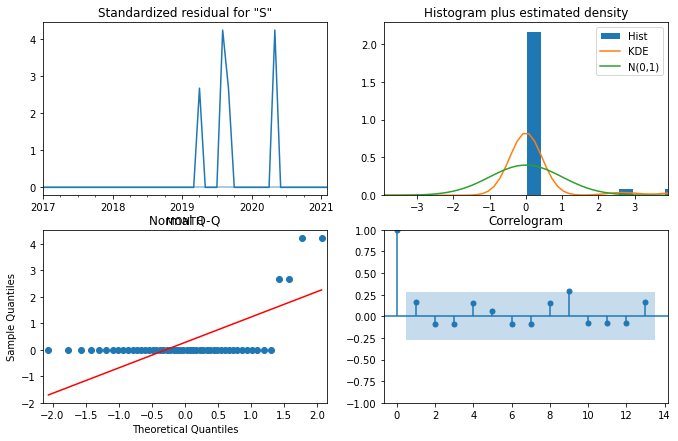

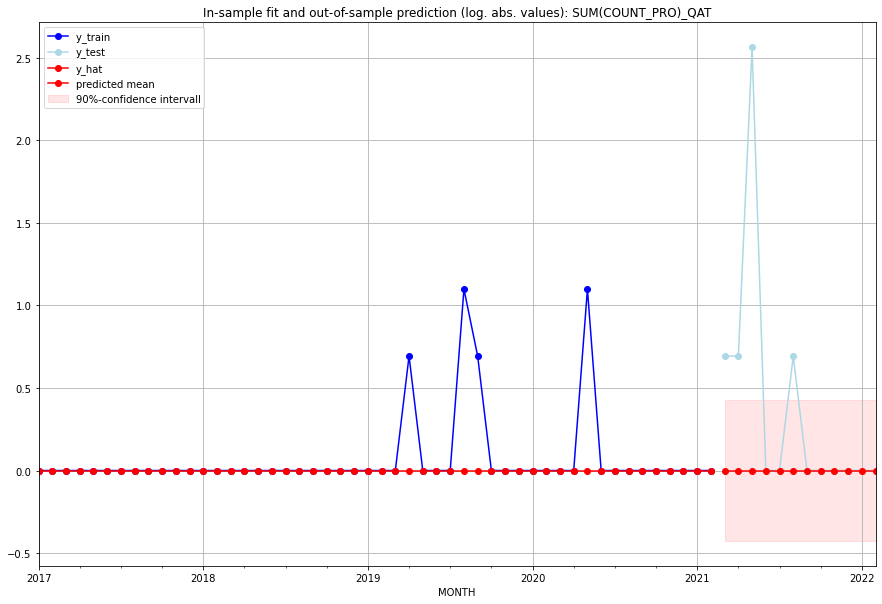

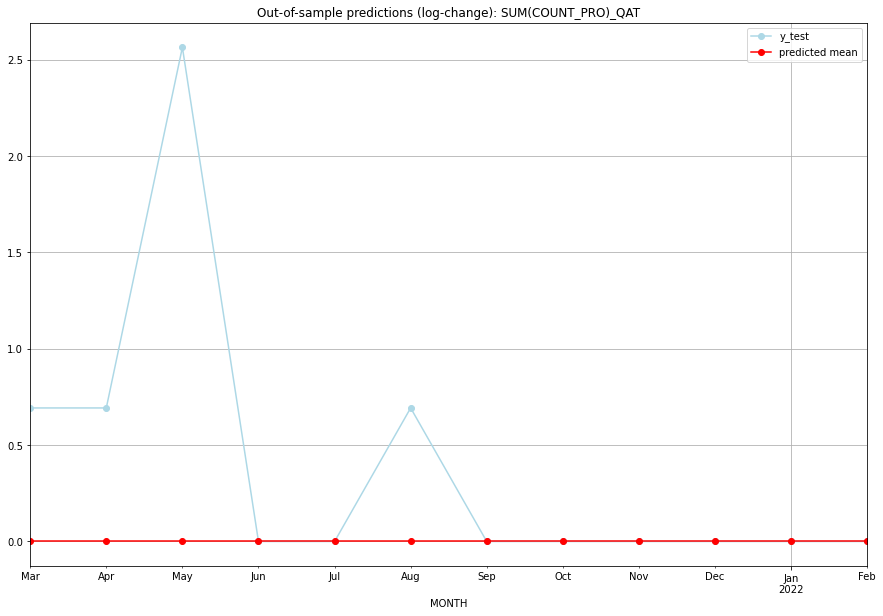

TADDA: 0.3870325749284477
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         1.0           0.0        0.693147   QAT   
1  2021-04-01       0.0         1.0           0.0        0.693147   QAT   
2  2021-05-01       0.0        12.0           0.0        2.564949   QAT   
3  2021-06-01       0.0         0.0           0.0        0.000000   QAT   
4  2021-07-01       0.0         0.0           0.0        0.000000   QAT   
5  2021-08-01       0.0         1.0           0.0        0.693147   QAT   
6  2021-09-01       0.0         0.0           0.0        0.000000   QAT   
7  2021-10-01       0.0         0.0           0.0        0.000000   QAT   
8  2021-11-01       0.0         0.0           0.0        0.000000   QAT   
9  2021-12-01       0.0         0.0           0.0        0.000000   QAT   
10 2022-01-01       0.0         0.0           0.0        0.000000   QAT   
11 2022-02-01       0.0         0.0           0.0    

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (1, 1, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.40675842139205987, 'fold_results': [0.40675842139205987]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_REU   No. Observations:                  289
Model:               SARIMAX(1, 1, 3)   Log Likelihood                 114.840
Date:                Fri, 16 Sep 2022   AIC                           -219.681
Time:                        14:49:51   BIC                           -201.366
Sample:                    02-28-1997   HQIC                          -212.341
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.5221      0.227     -2.296      0.022 

<Figure size 432x288 with 0 Axes>

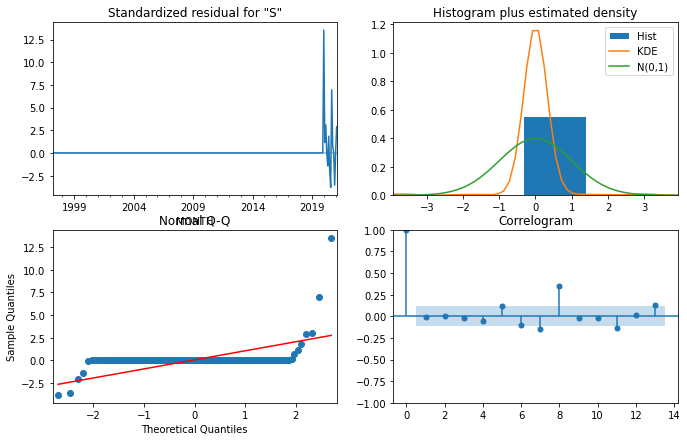

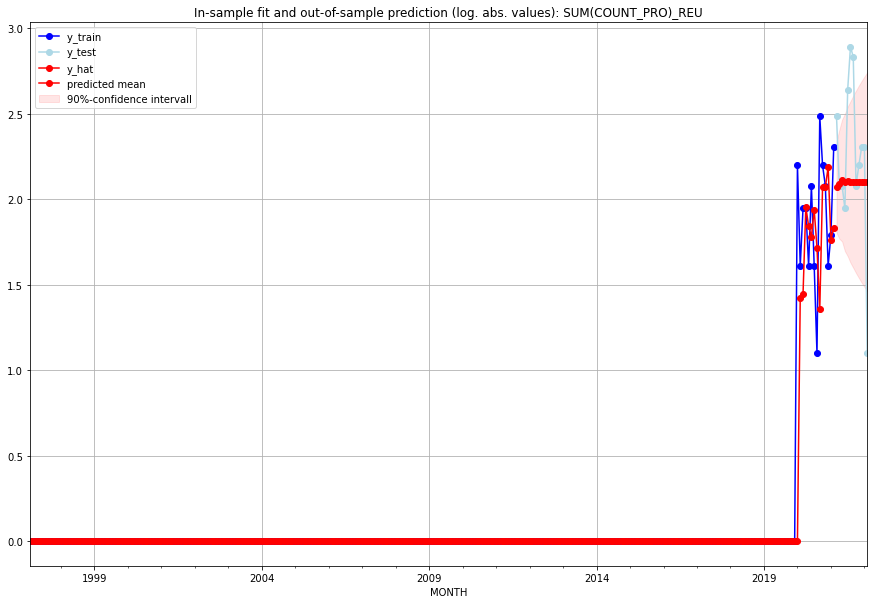

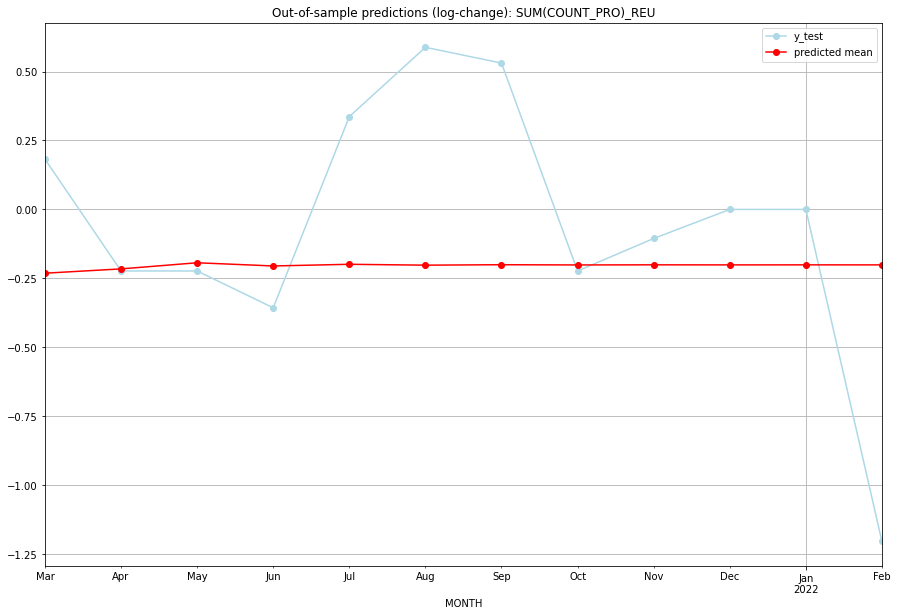

TADDA: 0.4178276365300598
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  6.935574        11.0     -0.231229        0.182322   REU   
1  2021-04-01  7.060372         7.0     -0.215625       -0.223144   REU   
2  2021-05-01  7.241613         7.0     -0.193389       -0.223144   REU   
3  2021-06-01  7.146491         6.0     -0.204998       -0.356675   REU   
4  2021-07-01  7.196013        13.0     -0.198937        0.336472   REU   
5  2021-08-01  7.170122        17.0     -0.202101        0.587787   REU   
6  2021-09-01  7.183628        16.0     -0.200450        0.530628   REU   
7  2021-10-01  7.176574         7.0     -0.201312       -0.223144   REU   
8  2021-11-01  7.180256         8.0     -0.200862       -0.105361   REU   
9  2021-12-01  7.178334         9.0     -0.201097        0.000000   REU   
10 2022-01-01  7.179337         9.0     -0.200974        0.000000   REU   
11 2022-02-01  7.178813         2.0     -0.201038    

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.3686663092856916, 'fold_results': [0.3686663092856916]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_ROU   No. Observations:                   38
Model:               SARIMAX(0, 1, 0)   Log Likelihood                 -22.736
Date:                Fri, 16 Sep 2022   AIC                             47.472
Time:                        14:50:25   BIC                             49.083
Sample:                    01-31-2018   HQIC                            48.040
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.2001      0.028      7.100      0.000   

<Figure size 432x288 with 0 Axes>

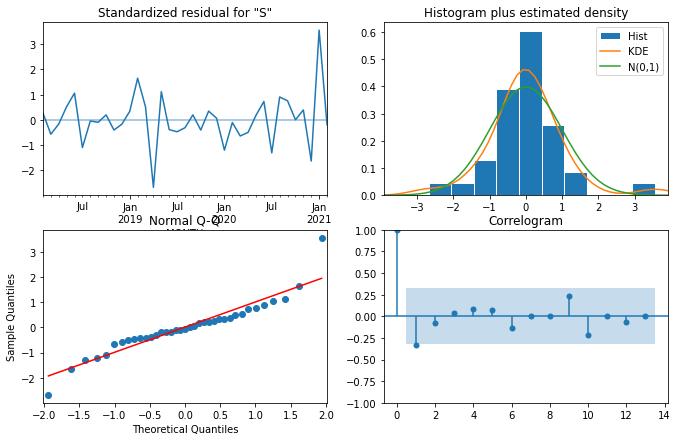

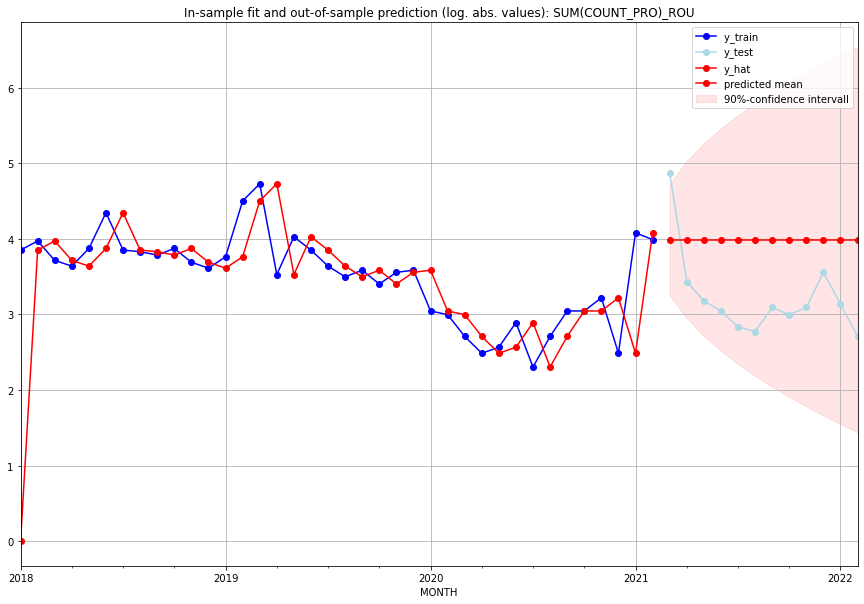

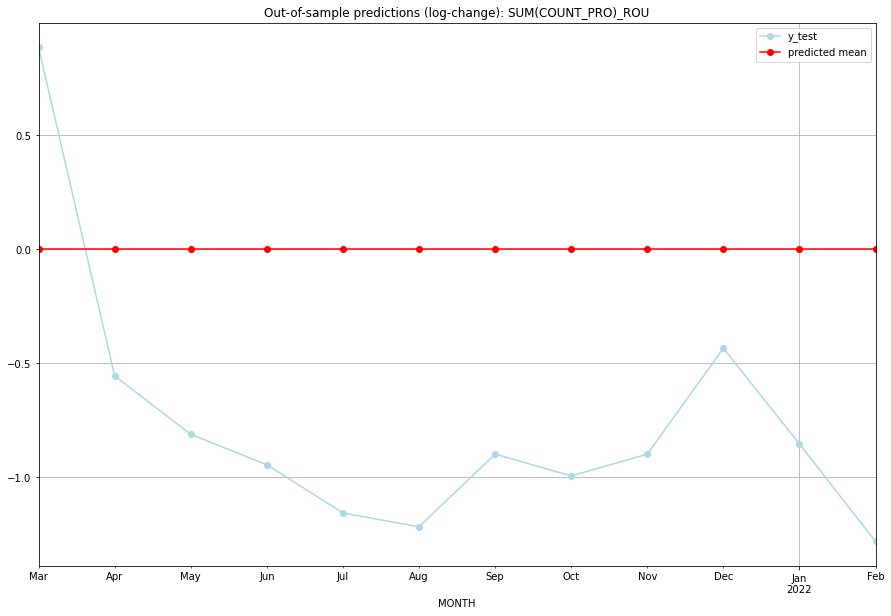

TADDA: 0.9104968825999998
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01      53.0       130.0  4.440892e-16        0.886213   ROU   
1  2021-04-01      53.0        30.0  4.440892e-16       -0.554997   ROU   
2  2021-05-01      53.0        23.0  4.440892e-16       -0.810930   ROU   
3  2021-06-01      53.0        20.0  4.440892e-16       -0.944462   ROU   
4  2021-07-01      53.0        16.0  4.440892e-16       -1.155771   ROU   
5  2021-08-01      53.0        15.0  4.440892e-16       -1.216395   ROU   
6  2021-09-01      53.0        21.0  4.440892e-16       -0.897942   ROU   
7  2021-10-01      53.0        19.0  4.440892e-16       -0.993252   ROU   
8  2021-11-01      53.0        21.0  4.440892e-16       -0.897942   ROU   
9  2021-12-01      53.0        34.0  4.440892e-16       -0.433636   ROU   
10 2022-01-01      53.0        22.0  4.440892e-16       -0.853490   ROU   
11 2022-02-01      53.0        14.0  4.440892e-16    

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [3, (3, 0, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.49563521207532063, 'fold_results': [0.49563521207532063]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_RUS   No. Observations:                   38
Model:               SARIMAX(3, 0, 3)   Log Likelihood                 -27.854
Date:                Fri, 16 Sep 2022   AIC                             75.708
Time:                        14:51:07   BIC                             92.083
Sample:                    01-31-2018   HQIC                            81.534
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1             0.0302      0.070      0.431      0.666 

<Figure size 432x288 with 0 Axes>

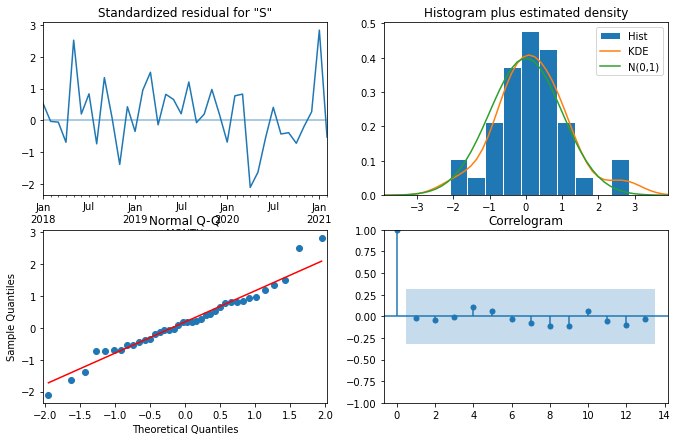

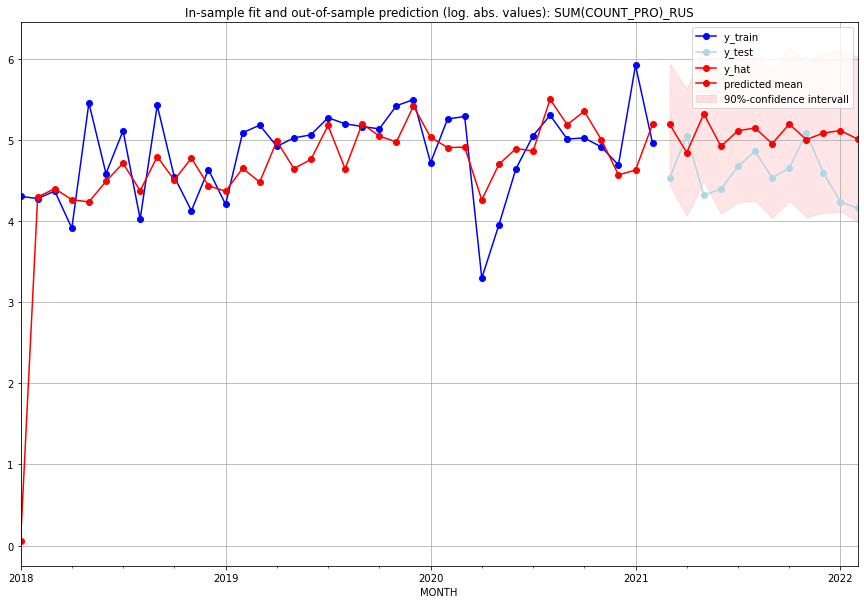

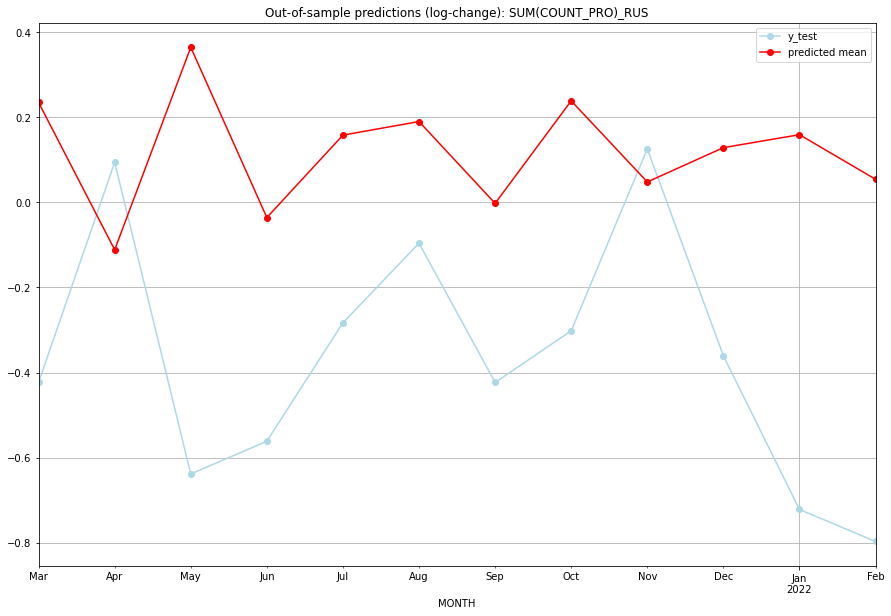

TADDA: 0.6681131980284652
Evaluation finished.
        MONTH    FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  178.578559        92.0      0.234786       -0.423228   RUS   
1  2021-04-01  126.021101       155.0     -0.111474        0.094029   RUS   
2  2021-05-01  203.416966        74.0      0.364335       -0.638339   RUS   
3  2021-06-01  136.019205        80.0     -0.035706       -0.561378   RUS   
4  2021-07-01  165.303085       106.0      0.157985       -0.282998   RUS   
5  2021-08-01  170.690912       128.0      0.189869       -0.096015   RUS   
6  2021-09-01  140.662730        92.0     -0.002378       -0.423228   RUS   
7  2021-10-01  179.243942       104.0      0.238484       -0.301867   RUS   
8  2021-11-01  147.975922       160.0      0.047958        0.125577   RUS   
9  2021-12-01  160.480026        98.0      0.128554       -0.360707   RUS   
10 2022-01-01  165.474386        68.0      0.159014       -0.721721   RUS   
11 2022-02-01  148.906435    

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.11552453009332421, 'fold_results': [0.11552453009332421]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_RWA   No. Observations:                  289
Model:                        SARIMAX   Log Likelihood                -105.894
Date:                Fri, 16 Sep 2022   AIC                            213.788
Time:                        14:51:55   BIC                            217.455
Sample:                    02-28-1997   HQIC                           215.258
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.1218      0.003     42.743      0.000 

<Figure size 432x288 with 0 Axes>

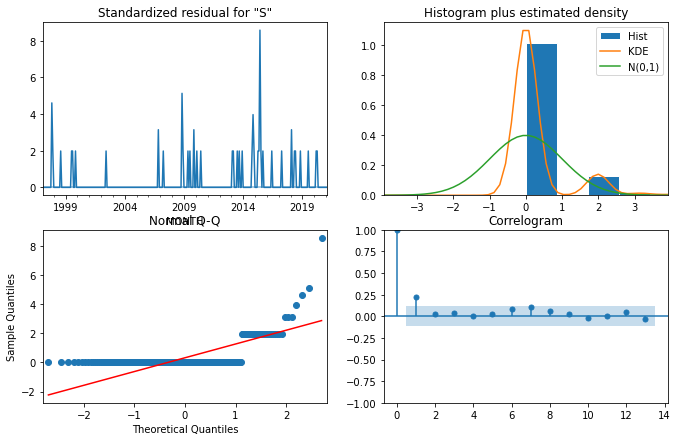

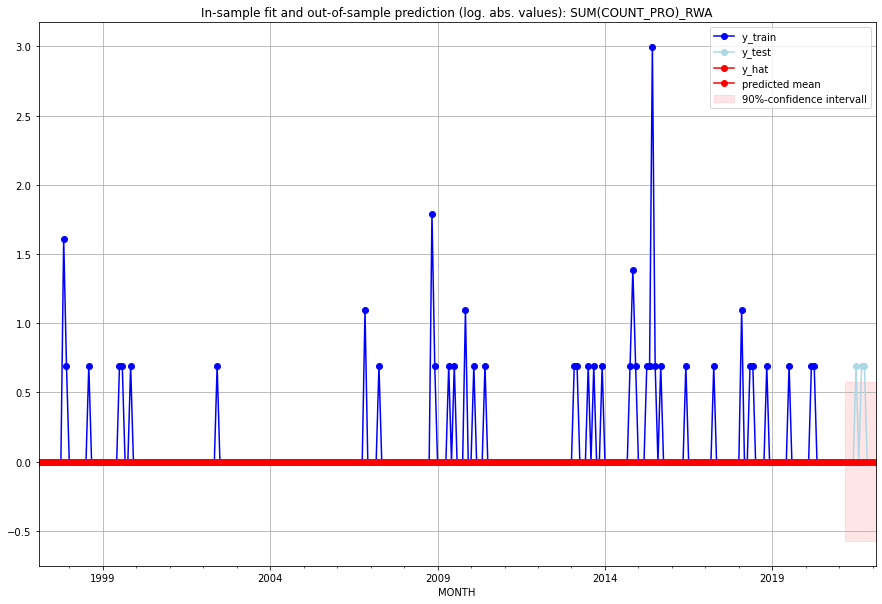

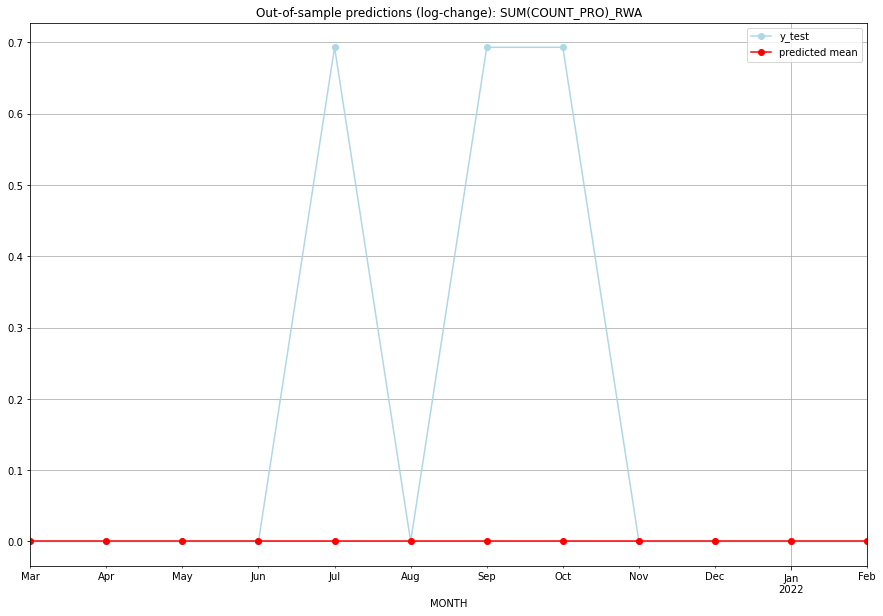

TADDA: 0.17328679513998632
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0        0.000000   RWA   
1  2021-04-01       0.0         0.0           0.0        0.000000   RWA   
2  2021-05-01       0.0         0.0           0.0        0.000000   RWA   
3  2021-06-01       0.0         0.0           0.0        0.000000   RWA   
4  2021-07-01       0.0         1.0           0.0        0.693147   RWA   
5  2021-08-01       0.0         0.0           0.0        0.000000   RWA   
6  2021-09-01       0.0         1.0           0.0        0.693147   RWA   
7  2021-10-01       0.0         1.0           0.0        0.693147   RWA   
8  2021-11-01       0.0         0.0           0.0        0.000000   RWA   
9  2021-12-01       0.0         0.0           0.0        0.000000   RWA   
10 2022-01-01       0.0         0.0           0.0        0.000000   RWA   
11 2022-02-01       0.0         0.0           0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.1493132891023379, 'fold_results': [0.1493132891023379]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_SAU   No. Observations:                   74
Model:                        SARIMAX   Log Likelihood                 -37.290
Date:                Fri, 16 Sep 2022   AIC                             76.580
Time:                        14:52:37   BIC                             78.884
Sample:                    01-31-2015   HQIC                            77.499
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.1604      0.014     11.794      0.000   

<Figure size 432x288 with 0 Axes>

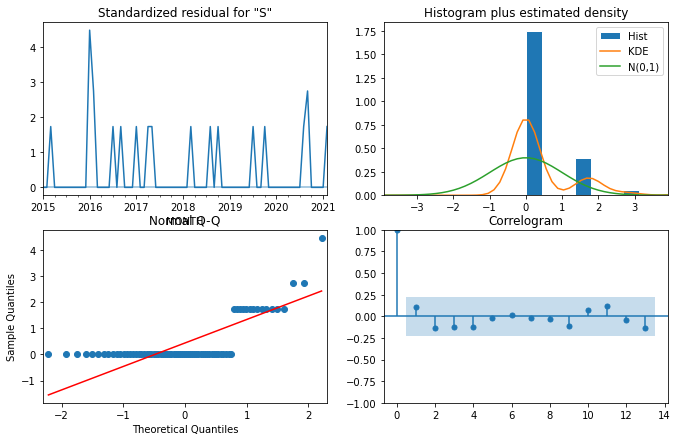

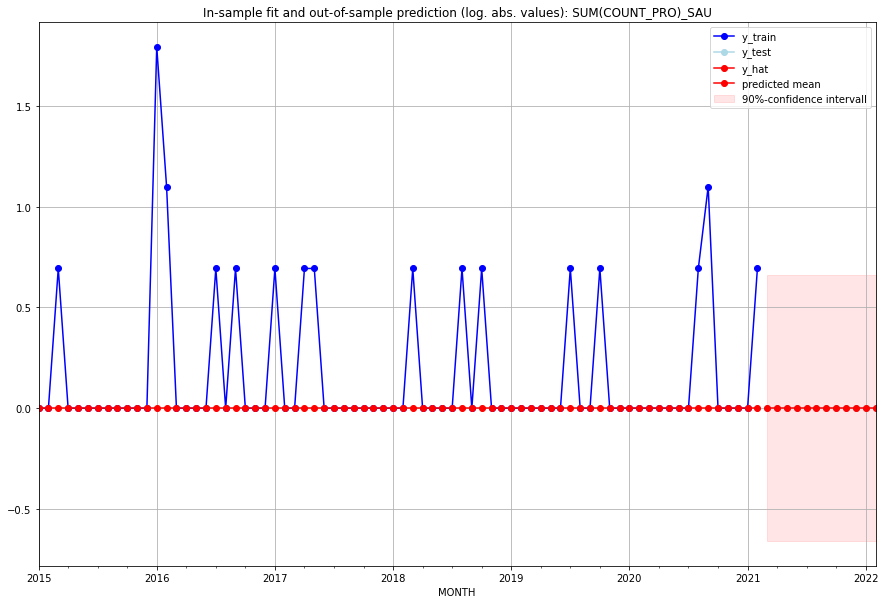

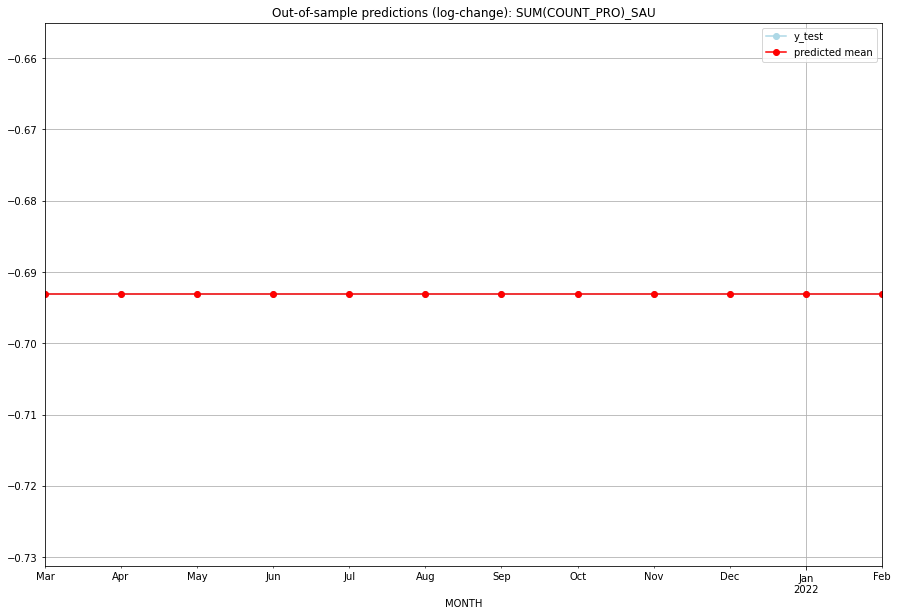

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0     -0.693147       -0.693147   SAU   
1  2021-04-01       0.0         0.0     -0.693147       -0.693147   SAU   
2  2021-05-01       0.0         0.0     -0.693147       -0.693147   SAU   
3  2021-06-01       0.0         0.0     -0.693147       -0.693147   SAU   
4  2021-07-01       0.0         0.0     -0.693147       -0.693147   SAU   
5  2021-08-01       0.0         0.0     -0.693147       -0.693147   SAU   
6  2021-09-01       0.0         0.0     -0.693147       -0.693147   SAU   
7  2021-10-01       0.0         0.0     -0.693147       -0.693147   SAU   
8  2021-11-01       0.0         0.0     -0.693147       -0.693147   SAU   
9  2021-12-01       0.0         0.0     -0.693147       -0.693147   SAU   
10 2022-01-01       0.0         0.0     -0.693147       -0.693147   SAU   
11 2022-02-01       0.0         0.0     -0.693147       -0.693147   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.33124853026320616, 'fold_results': [0.33124853026320616]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_SDN   No. Observations:                  289
Model:               SARIMAX(0, 1, 0)   Log Likelihood                -348.702
Date:                Fri, 16 Sep 2022   AIC                            699.404
Time:                        14:53:21   BIC                            703.067
Sample:                    02-28-1997   HQIC                           700.872
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.6595      0.036     18.097      0.000 

<Figure size 432x288 with 0 Axes>

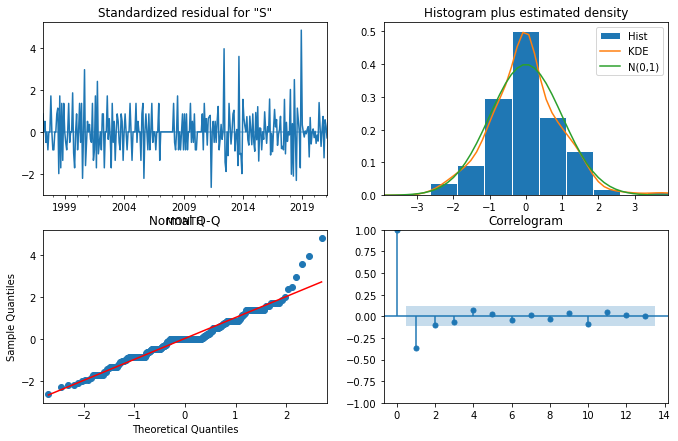

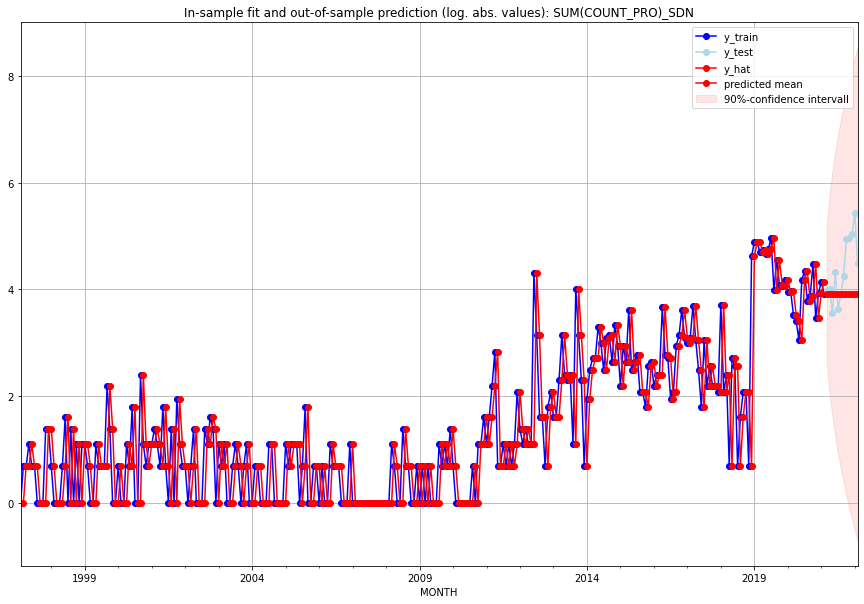

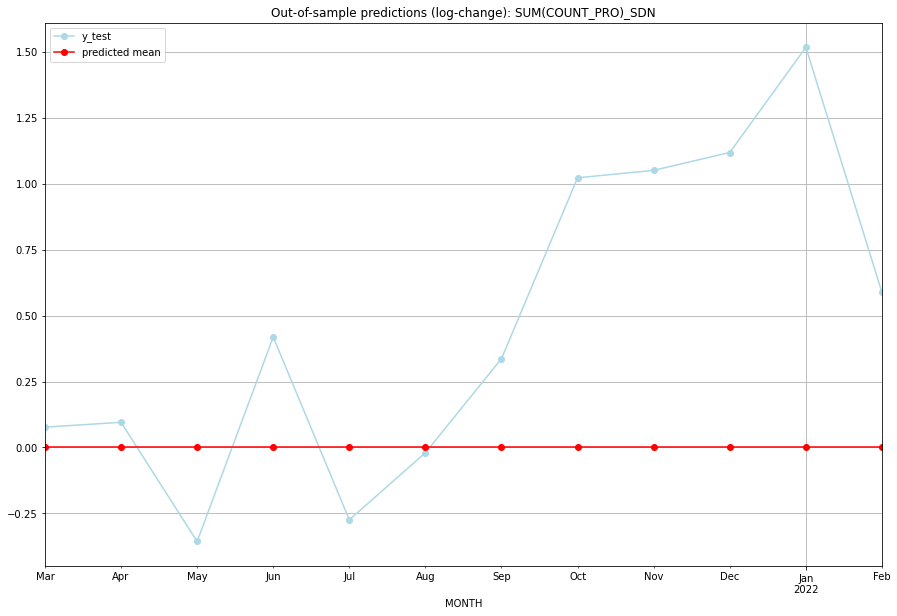

TADDA: 0.5729637538587397
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01      49.0        53.0           0.0        0.076961   SDN   
1  2021-04-01      49.0        54.0           0.0        0.095310   SDN   
2  2021-05-01      49.0        34.0           0.0       -0.356675   SDN   
3  2021-06-01      49.0        75.0           0.0        0.418710   SDN   
4  2021-07-01      49.0        37.0           0.0       -0.274437   SDN   
5  2021-08-01      49.0        48.0           0.0       -0.020203   SDN   
6  2021-09-01      49.0        69.0           0.0        0.336472   SDN   
7  2021-10-01      49.0       138.0           0.0        1.022451   SDN   
8  2021-11-01      49.0       142.0           0.0        1.050822   SDN   
9  2021-12-01      49.0       152.0           0.0        1.118415   SDN   
10 2022-01-01      49.0       227.0           0.0        1.517323   SDN   
11 2022-02-01      49.0        89.0           0.0    

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [1, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.5554112785846604, 'fold_results': [0.5554112785846604]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_SEN   No. Observations:                  289
Model:                        SARIMAX   Log Likelihood                -422.090
Date:                Fri, 16 Sep 2022   AIC                            848.179
Time:                        14:54:10   BIC                            855.512
Sample:                    02-28-1997   HQIC                           851.118
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1             0.1760      0.023      7.714      0.000   

<Figure size 432x288 with 0 Axes>

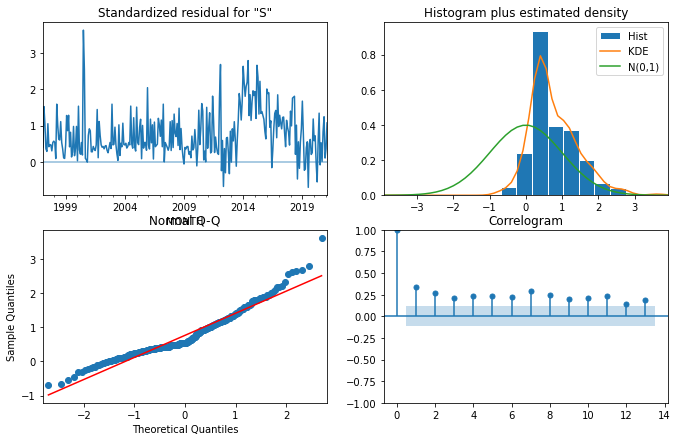

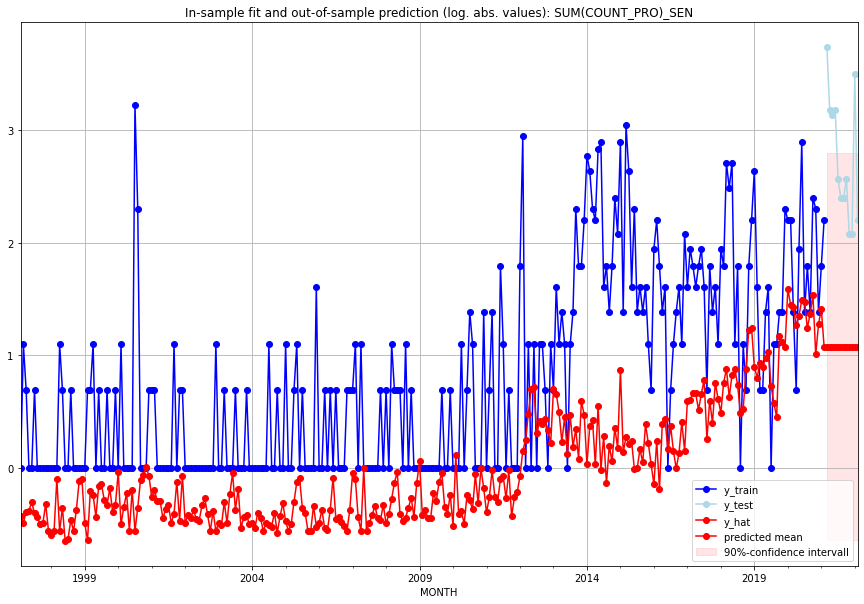

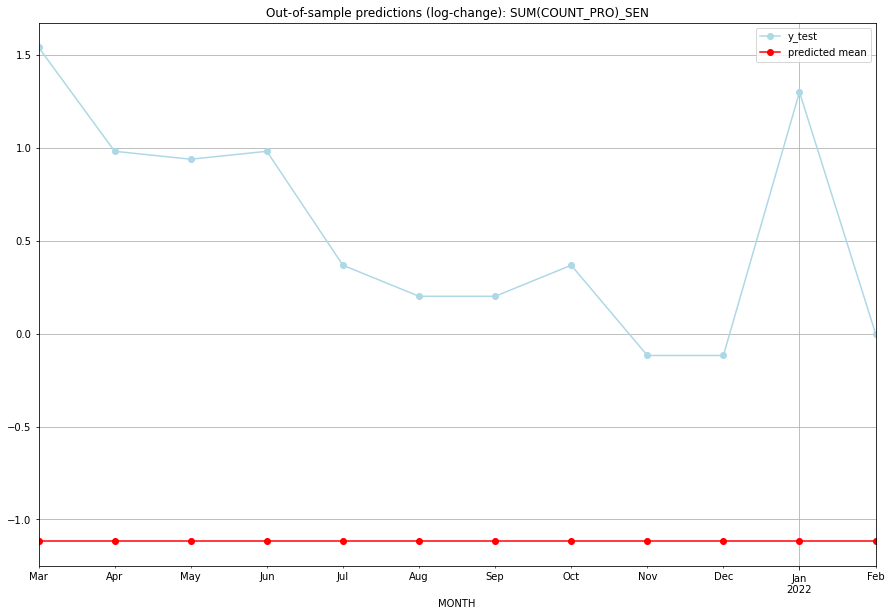

TADDA: 2.5112504947893015
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  1.940139        41.0     -1.118768        1.540445   SEN   
1  2021-04-01  1.940139        23.0     -1.118768        0.980829   SEN   
2  2021-05-01  1.940139        22.0     -1.118768        0.938270   SEN   
3  2021-06-01  1.940139        23.0     -1.118768        0.980829   SEN   
4  2021-07-01  1.940139        12.0     -1.118768        0.367725   SEN   
5  2021-08-01  1.940139        10.0     -1.118768        0.200671   SEN   
6  2021-09-01  1.940139        10.0     -1.118768        0.200671   SEN   
7  2021-10-01  1.940139        12.0     -1.118768        0.367725   SEN   
8  2021-11-01  1.940139         7.0     -1.118768       -0.117783   SEN   
9  2021-12-01  1.940139         7.0     -1.118768       -0.117783   SEN   
10 2022-01-01  1.940139        32.0     -1.118768        1.299283   SEN   
11 2022-02-01  1.940139         8.0     -1.118768    

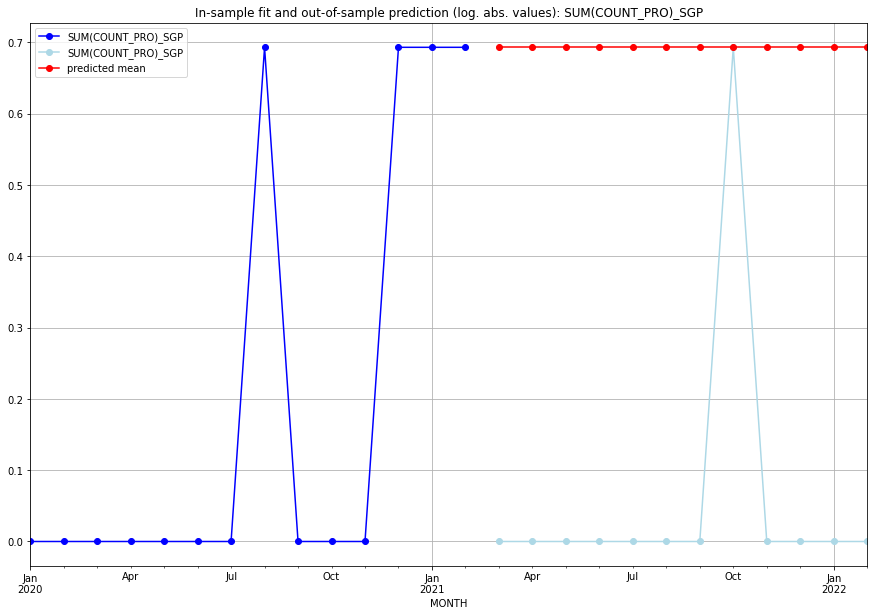

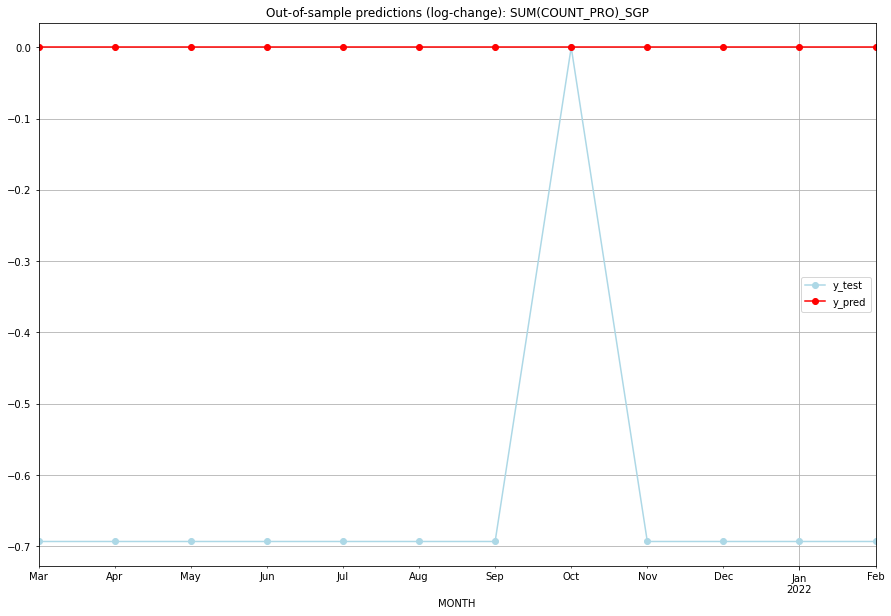

TADDA: 0.6353849155132832
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  0.693147    0.000000           0.0       -0.693147   SGP   
1  2021-04-01  0.693147    0.000000           0.0       -0.693147   SGP   
2  2021-05-01  0.693147    0.000000           0.0       -0.693147   SGP   
3  2021-06-01  0.693147    0.000000           0.0       -0.693147   SGP   
4  2021-07-01  0.693147    0.000000           0.0       -0.693147   SGP   
5  2021-08-01  0.693147    0.000000           0.0       -0.693147   SGP   
6  2021-09-01  0.693147    0.000000           0.0       -0.693147   SGP   
7  2021-10-01  0.693147    0.693147           0.0        0.000000   SGP   
8  2021-11-01  0.693147    0.000000           0.0       -0.693147   SGP   
9  2021-12-01  0.693147    0.000000           0.0       -0.693147   SGP   
10 2022-01-01  0.693147    0.000000           0.0       -0.693147   SGP   
11 2022-02-01  0.693147    0.000000           0.0    

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.09155102405567582, 'fold_results': [0.09155102405567582]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_SHN   No. Observations:                  289
Model:                        SARIMAX   Log Likelihood                 381.546
Date:                Fri, 16 Sep 2022   AIC                           -761.091
Time:                        14:54:37   BIC                           -757.425
Sample:                    02-28-1997   HQIC                          -759.622
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.0042    2.9e-05    144.250      0.000 

<Figure size 432x288 with 0 Axes>

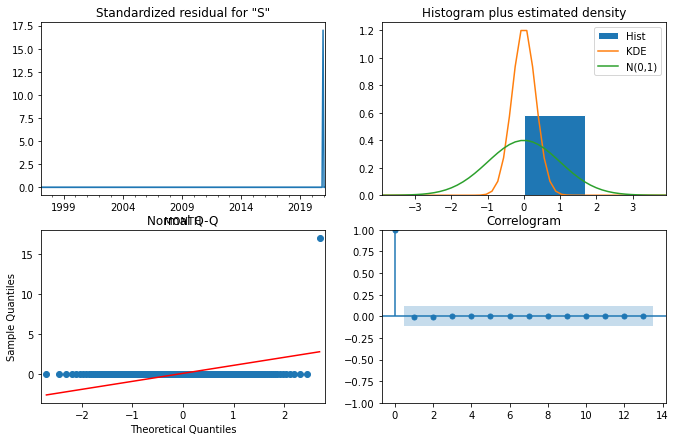

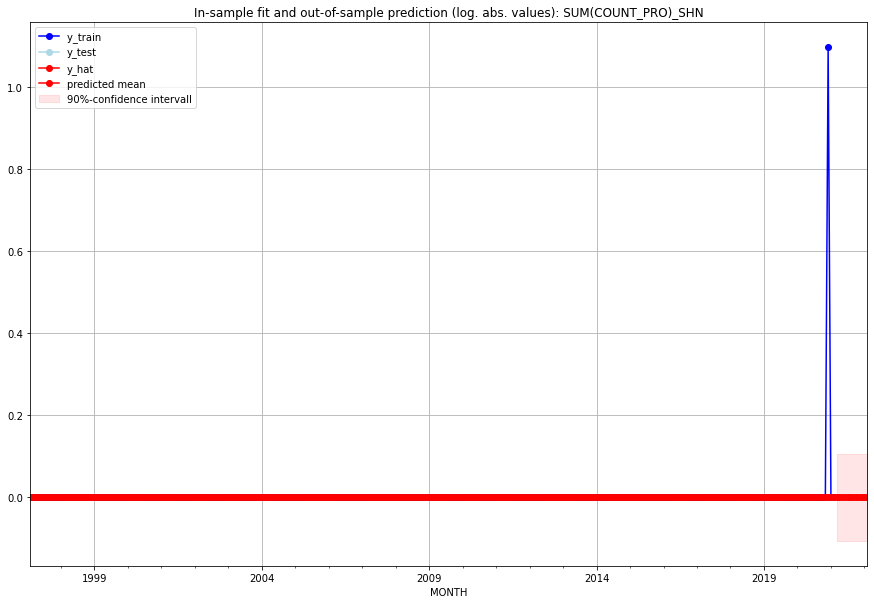

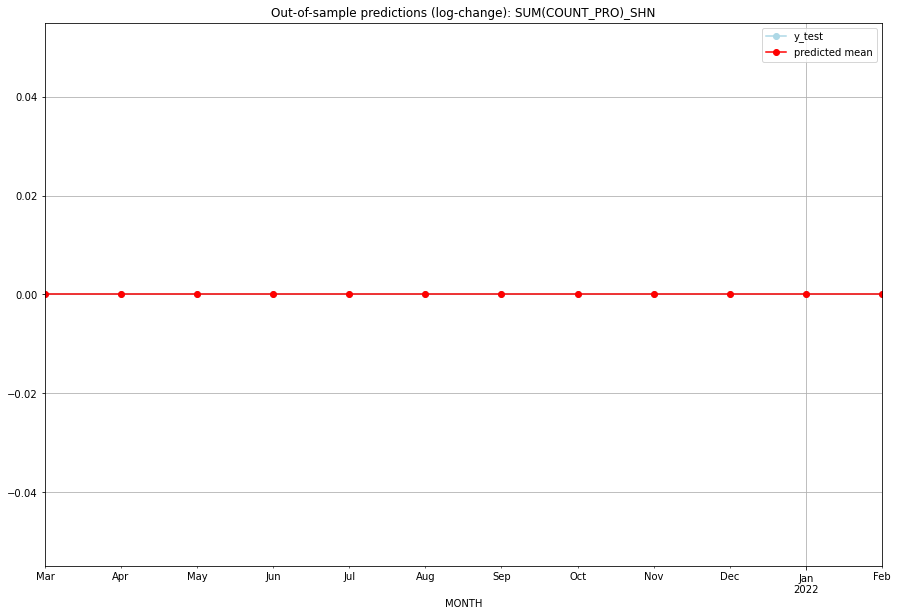

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   SHN   
1  2021-04-01       0.0         0.0           0.0             0.0   SHN   
2  2021-05-01       0.0         0.0           0.0             0.0   SHN   
3  2021-06-01       0.0         0.0           0.0             0.0   SHN   
4  2021-07-01       0.0         0.0           0.0             0.0   SHN   
5  2021-08-01       0.0         0.0           0.0             0.0   SHN   
6  2021-09-01       0.0         0.0           0.0             0.0   SHN   
7  2021-10-01       0.0         0.0           0.0             0.0   SHN   
8  2021-11-01       0.0         0.0           0.0             0.0   SHN   
9  2021-12-01       0.0         0.0           0.0             0.0   SHN   
10 2022-01-01       0.0         0.0           0.0             0.0   SHN   
11 2022-02-01       0.0         0.0           0.0             0.0   

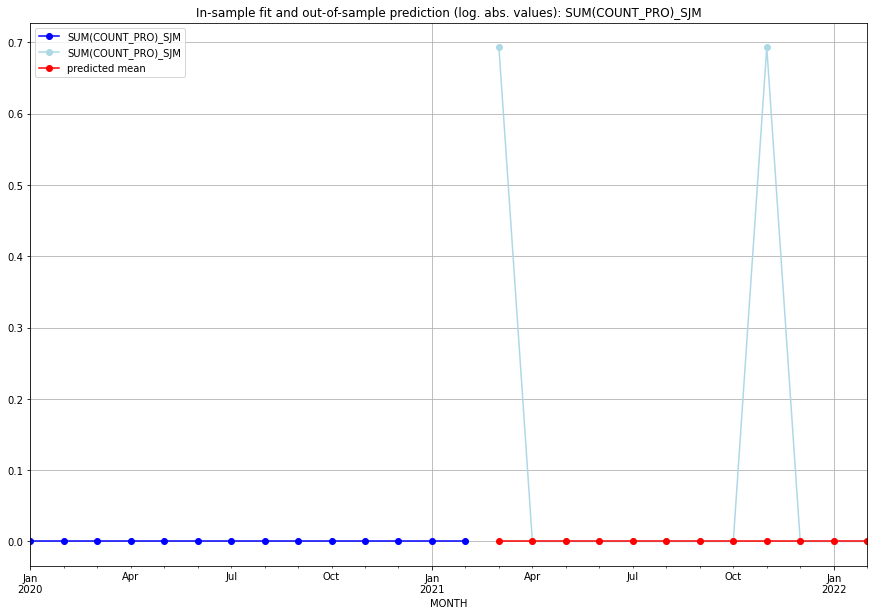

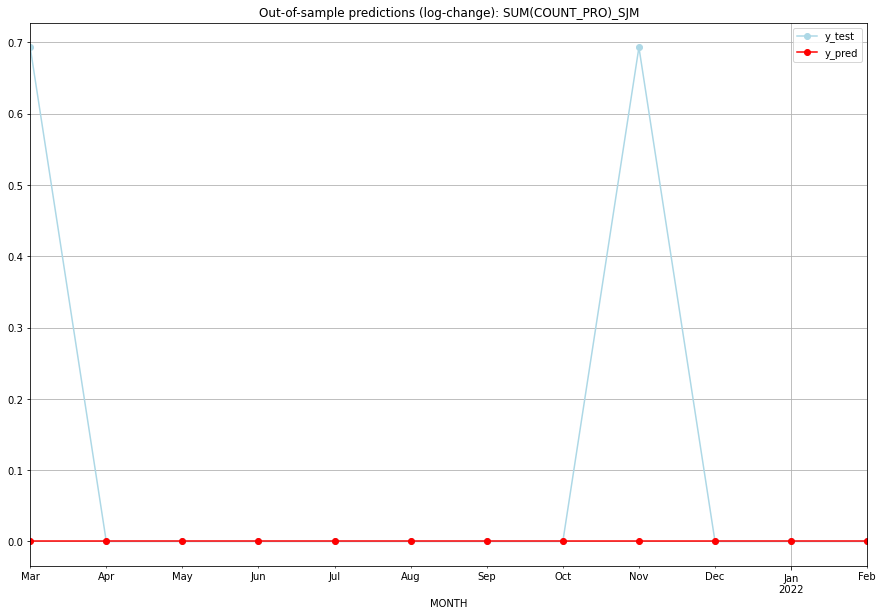

TADDA: 0.11552453009332421
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0    0.693147           0.0        0.693147   SJM   
1  2021-04-01       0.0    0.000000           0.0        0.000000   SJM   
2  2021-05-01       0.0    0.000000           0.0        0.000000   SJM   
3  2021-06-01       0.0    0.000000           0.0        0.000000   SJM   
4  2021-07-01       0.0    0.000000           0.0        0.000000   SJM   
5  2021-08-01       0.0    0.000000           0.0        0.000000   SJM   
6  2021-09-01       0.0    0.000000           0.0        0.000000   SJM   
7  2021-10-01       0.0    0.000000           0.0        0.000000   SJM   
8  2021-11-01       0.0    0.693147           0.0        0.693147   SJM   
9  2021-12-01       0.0    0.000000           0.0        0.000000   SJM   
10 2022-01-01       0.0    0.000000           0.0        0.000000   SJM   
11 2022-02-01       0.0    0.000000           0.0   

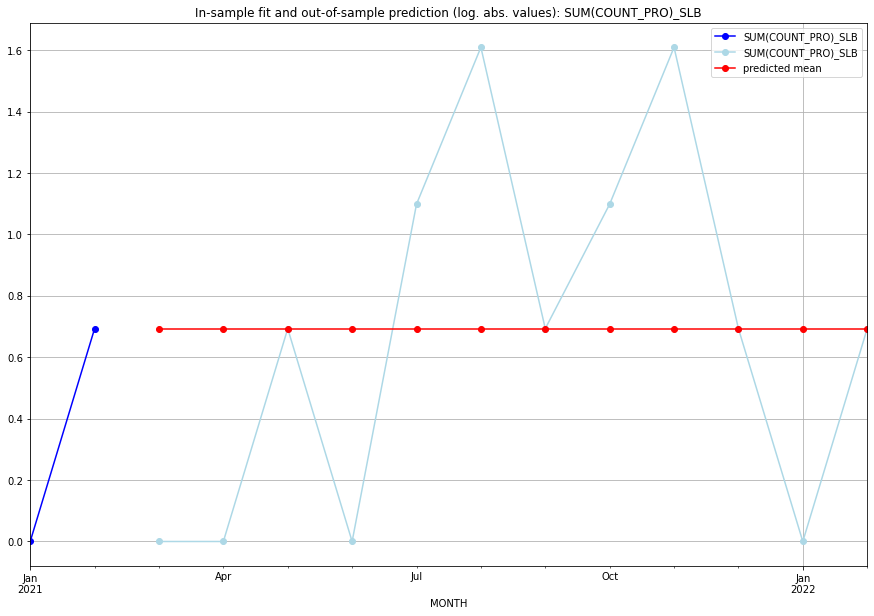

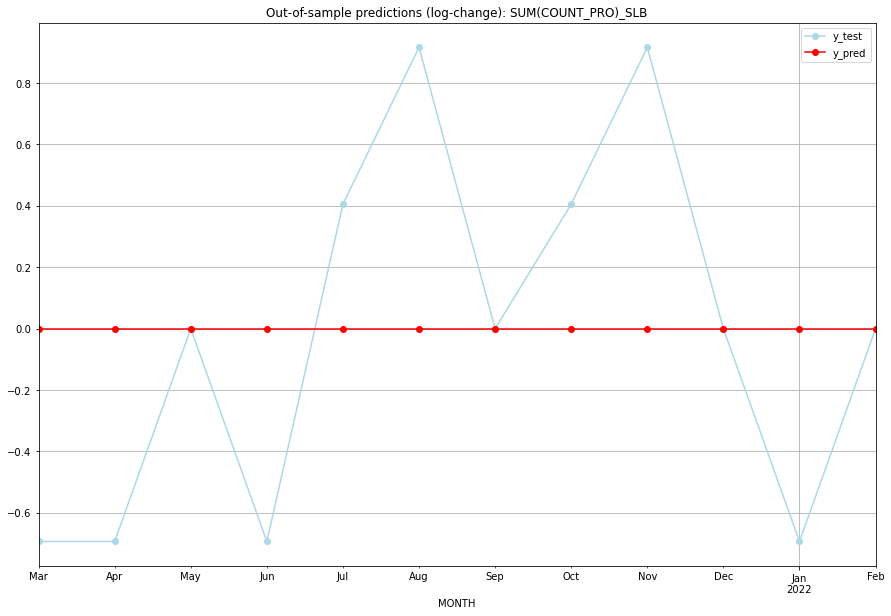

TADDA: 0.45134170018370173
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  0.693147    0.000000           0.0       -0.693147   SLB   
1  2021-04-01  0.693147    0.000000           0.0       -0.693147   SLB   
2  2021-05-01  0.693147    0.693147           0.0        0.000000   SLB   
3  2021-06-01  0.693147    0.000000           0.0       -0.693147   SLB   
4  2021-07-01  0.693147    1.098612           0.0        0.405465   SLB   
5  2021-08-01  0.693147    1.609438           0.0        0.916291   SLB   
6  2021-09-01  0.693147    0.693147           0.0        0.000000   SLB   
7  2021-10-01  0.693147    1.098612           0.0        0.405465   SLB   
8  2021-11-01  0.693147    1.609438           0.0        0.916291   SLB   
9  2021-12-01  0.693147    0.693147           0.0        0.000000   SLB   
10 2022-01-01  0.693147    0.000000           0.0       -0.693147   SLB   
11 2022-02-01  0.693147    0.693147           0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [3, (3, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.48954303684420547, 'fold_results': [0.48954303684420547]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_SLE   No. Observations:                  289
Model:               SARIMAX(3, 0, 0)   Log Likelihood                -225.010
Date:                Fri, 16 Sep 2022   AIC                            464.020
Time:                        14:55:31   BIC                            489.685
Sample:                    02-28-1997   HQIC                           474.304
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1             0.0676      0.023      2.947      0.003 

<Figure size 432x288 with 0 Axes>

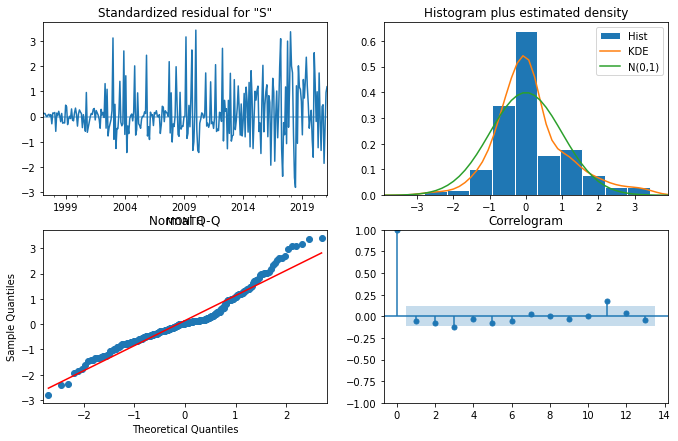

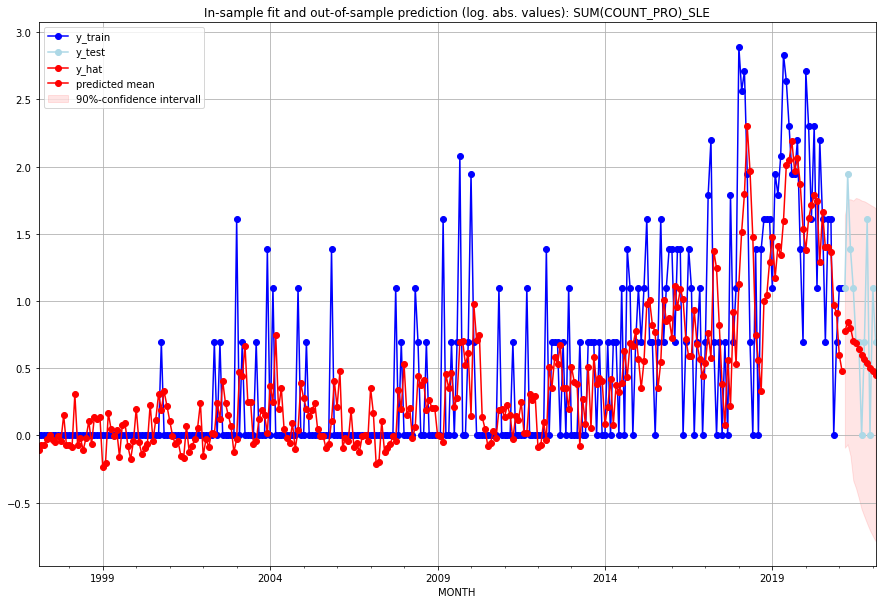

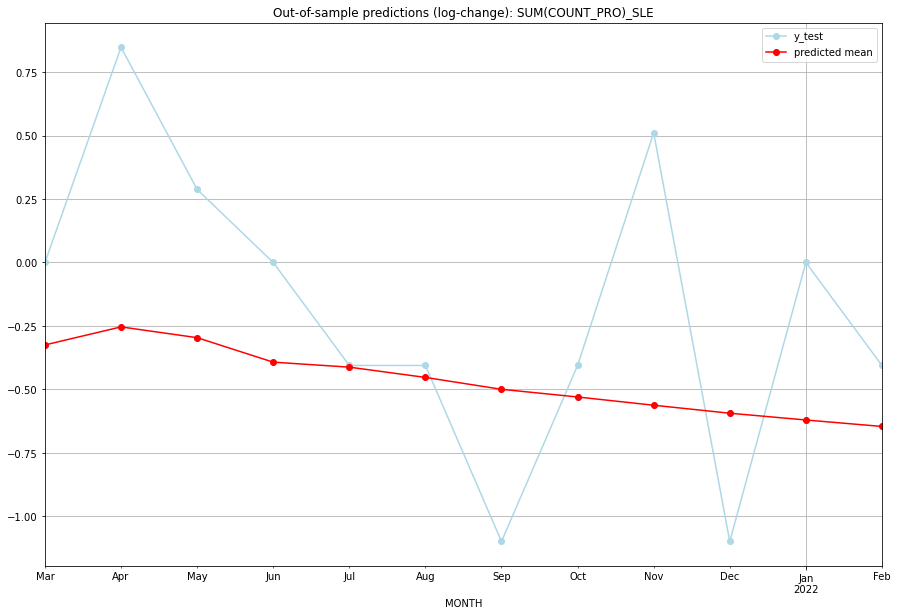

TADDA: 0.5607471177785491
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  1.168420         2.0     -0.324613        0.000000   SLE   
1  2021-04-01  1.327945         6.0     -0.253626        0.847298   SLE   
2  2021-05-01  1.231219         3.0     -0.296064        0.287682   SLE   
3  2021-06-01  1.026178         2.0     -0.392461        0.000000   SLE   
4  2021-07-01  0.986777         1.0     -0.412099       -0.405465   SLE   
5  2021-08-01  0.907942         1.0     -0.452587       -0.405465   SLE   
6  2021-09-01  0.820771         0.0     -0.499352       -1.098612   SLE   
7  2021-10-01  0.766542         1.0     -0.529588       -0.405465   SLE   
8  2021-11-01  0.710101         4.0     -0.562060        0.510826   SLE   
9  2021-12-01  0.657127         0.0     -0.593527       -1.098612   SLE   
10 2022-01-01  0.613570         2.0     -0.620163        0.000000   SLE   
11 2022-02-01  0.572945         1.0     -0.645663    

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [1, (1, 1, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.6665621815081026, 'fold_results': [0.6665621815081026]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_SLV   No. Observations:                   38
Model:               SARIMAX(1, 1, 3)   Log Likelihood                 -25.811
Date:                Fri, 16 Sep 2022   AIC                             63.621
Time:                        14:55:54   BIC                             73.287
Sample:                    01-31-2018   HQIC                            67.029
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1             0.0653      0.044      1.479      0.139   

<Figure size 432x288 with 0 Axes>

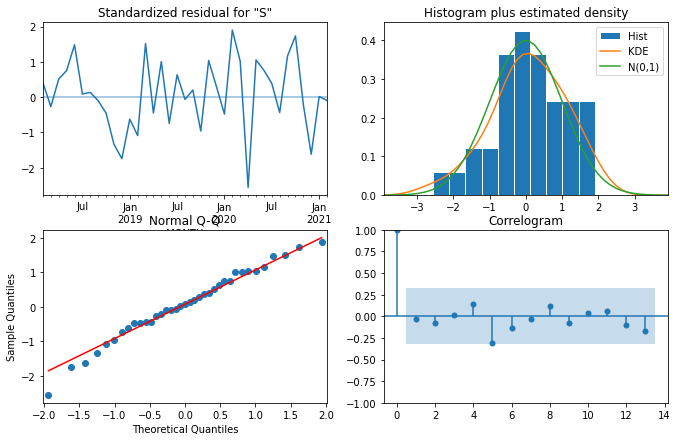

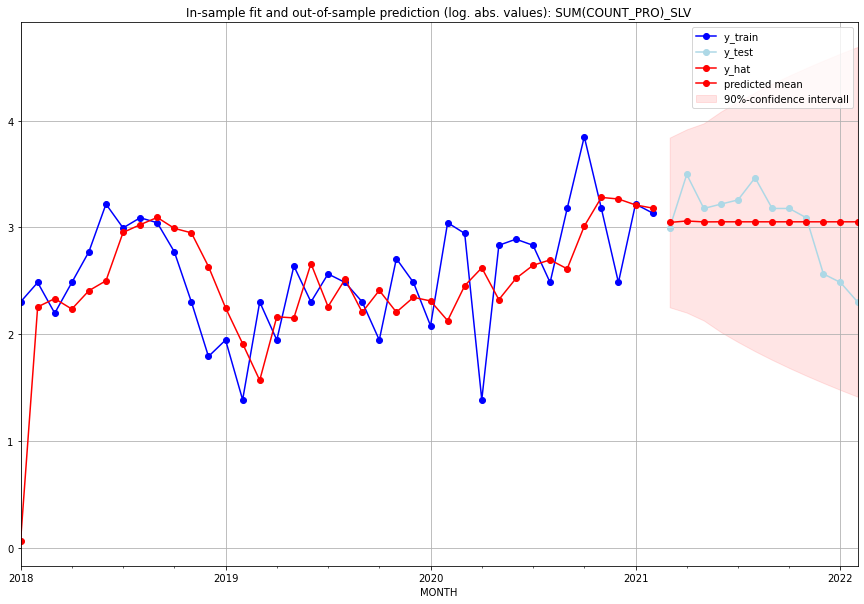

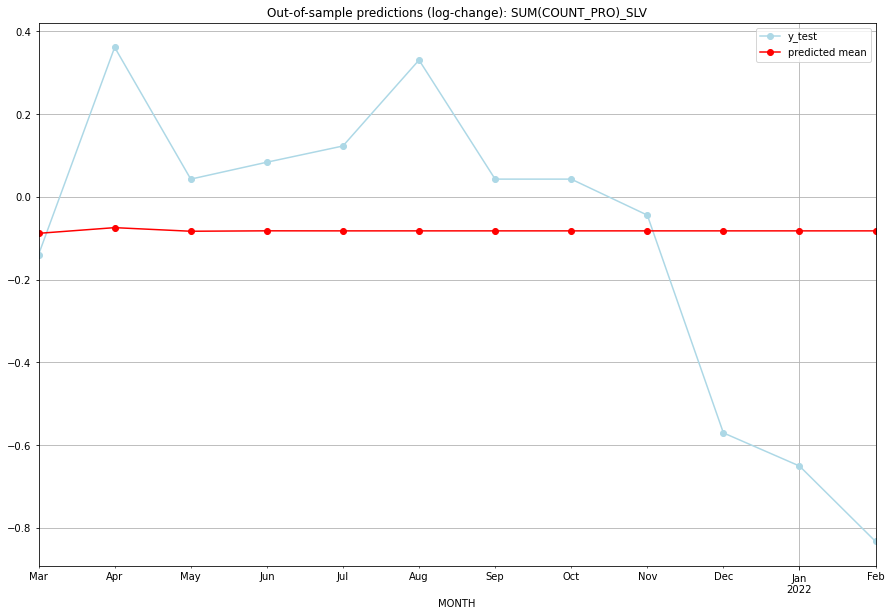

TADDA: 0.3384504818036474
Evaluation finished.
        MONTH   FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  20.054008        19.0     -0.088403       -0.139762   SLV   
1  2021-04-01  20.345293        32.0     -0.074663        0.361013   SLV   
2  2021-05-01  20.160232        23.0     -0.083371        0.042560   SLV   
3  2021-06-01  20.181817        24.0     -0.082351        0.083382   SLV   
4  2021-07-01  20.179289        25.0     -0.082470        0.122602   SLV   
5  2021-08-01  20.179585        31.0     -0.082456        0.330242   SLV   
6  2021-09-01  20.179550        23.0     -0.082458        0.042560   SLV   
7  2021-10-01  20.179554        23.0     -0.082458        0.042560   SLV   
8  2021-11-01  20.179554        21.0     -0.082458       -0.044452   SLV   
9  2021-12-01  20.179554        12.0     -0.082458       -0.570545   SLV   
10 2022-01-01  20.179554        11.0     -0.082458       -0.650588   SLV   
11 2022-02-01  20.179554         9.0     

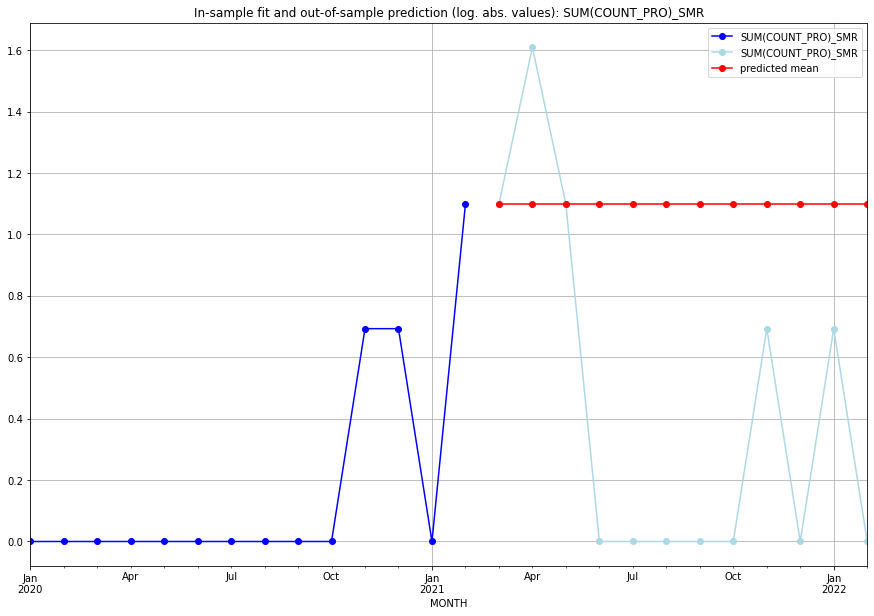

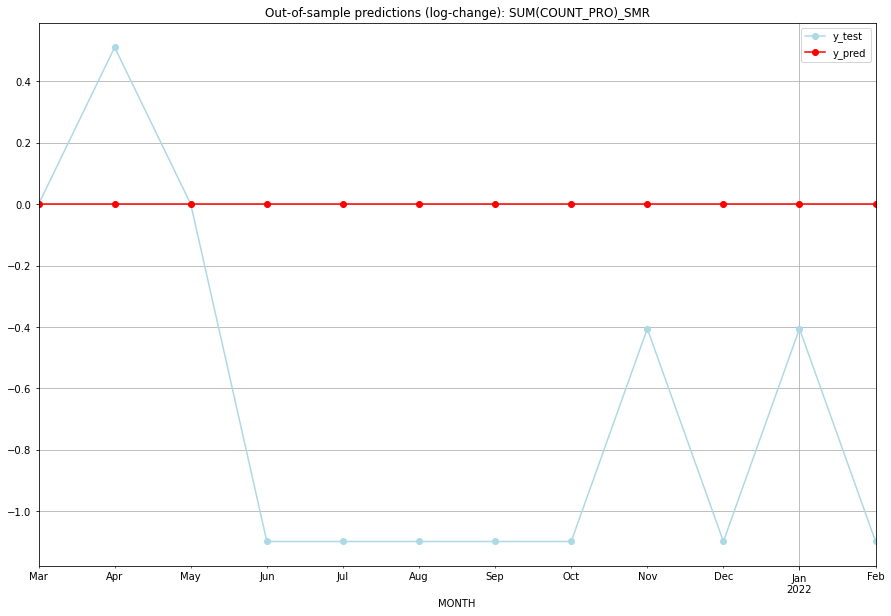

TADDA: 0.7510034883882574
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  1.098612    1.098612           0.0        0.000000   SMR   
1  2021-04-01  1.098612    1.609438           0.0        0.510826   SMR   
2  2021-05-01  1.098612    1.098612           0.0        0.000000   SMR   
3  2021-06-01  1.098612    0.000000           0.0       -1.098612   SMR   
4  2021-07-01  1.098612    0.000000           0.0       -1.098612   SMR   
5  2021-08-01  1.098612    0.000000           0.0       -1.098612   SMR   
6  2021-09-01  1.098612    0.000000           0.0       -1.098612   SMR   
7  2021-10-01  1.098612    0.000000           0.0       -1.098612   SMR   
8  2021-11-01  1.098612    0.693147           0.0       -0.405465   SMR   
9  2021-12-01  1.098612    0.000000           0.0       -1.098612   SMR   
10 2022-01-01  1.098612    0.693147           0.0       -0.405465   SMR   
11 2022-02-01  1.098612    0.000000           0.0    

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [2, (1, 1, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.5213642181421164, 'fold_results': [0.5213642181421164]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_SOM   No. Observations:                  289
Model:               SARIMAX(1, 1, 3)   Log Likelihood                -181.537
Date:                Fri, 16 Sep 2022   AIC                            377.074
Time:                        14:56:36   BIC                            402.715
Sample:                    02-28-1997   HQIC                           387.350
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1             0.0293      0.021      1.373      0.170   

<Figure size 432x288 with 0 Axes>

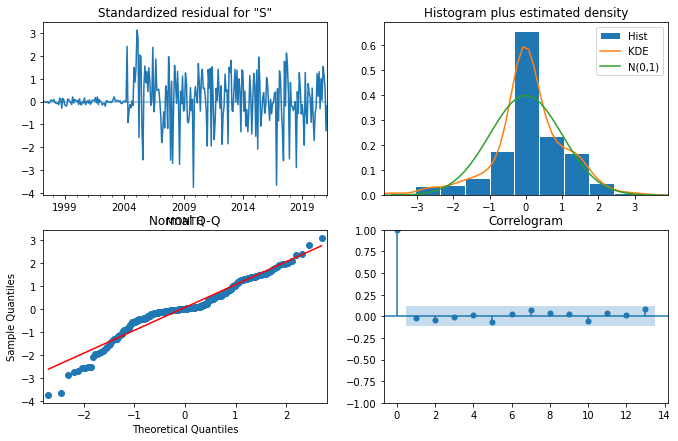

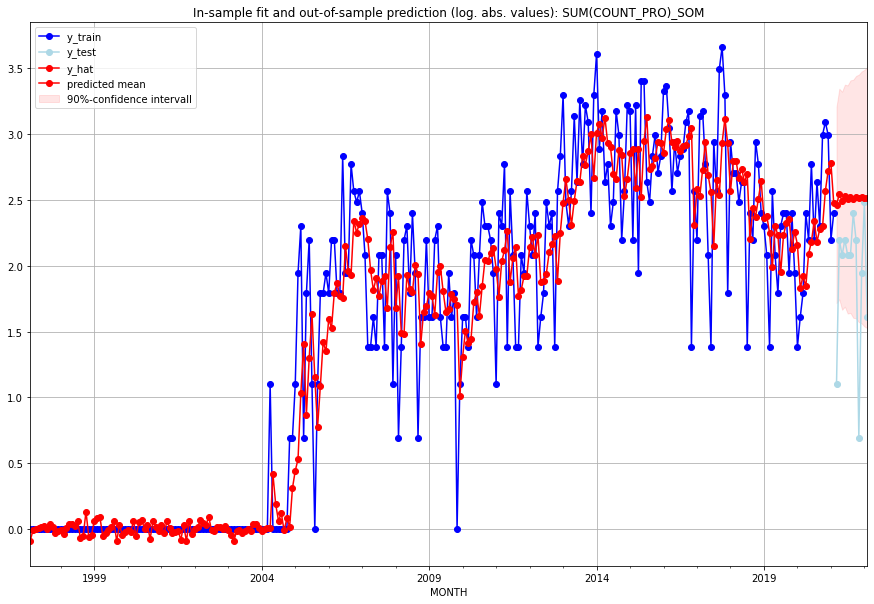

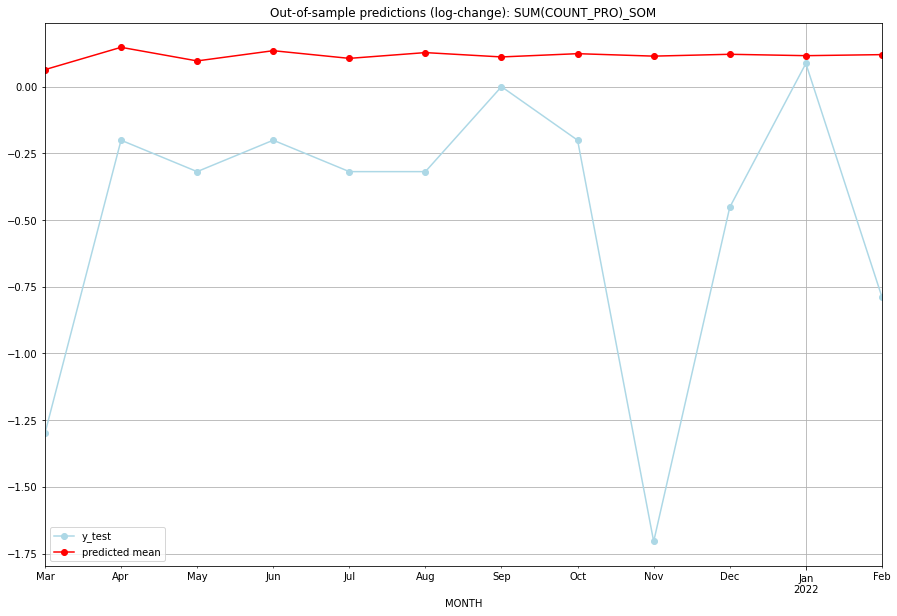

TADDA: 0.6878632006374484
Evaluation finished.
        MONTH   FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  10.724804         2.0      0.063811       -1.299283   SOM   
1  2021-04-01  11.748423         8.0      0.147512       -0.200671   SOM   
2  2021-05-01  11.114709         7.0      0.096525       -0.318454   SOM   
3  2021-06-01  11.587894         8.0      0.134840       -0.200671   SOM   
4  2021-07-01  11.230624         7.0      0.106048       -0.318454   SOM   
5  2021-08-01  11.498138         7.0      0.127684       -0.318454   SOM   
6  2021-09-01  11.296570        10.0      0.111425        0.000000   SOM   
7  2021-10-01  11.447735         8.0      0.123643       -0.200671   SOM   
8  2021-11-01  11.333968         1.0      0.114462       -1.704748   SOM   
9  2021-12-01  11.419363         6.0      0.121361       -0.451985   SOM   
10 2022-01-01  11.355136        11.0      0.116177        0.087011   SOM   
11 2022-02-01  11.403369         4.0     

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [2, (1, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.4895266955778892, 'fold_results': [0.4895266955778892]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_SRB   No. Observations:                   38
Model:               SARIMAX(1, 0, 0)   Log Likelihood                 -45.325
Date:                Fri, 16 Sep 2022   AIC                             98.650
Time:                        14:57:02   BIC                            105.200
Sample:                    01-31-2018   HQIC                           100.980
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1             0.1142      0.079      1.448      0.148   

<Figure size 432x288 with 0 Axes>

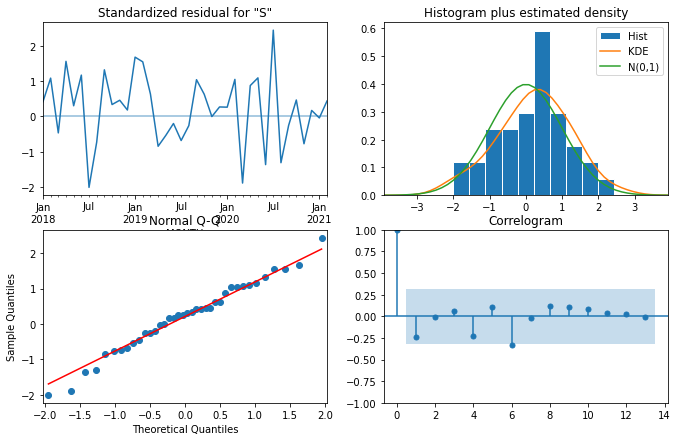

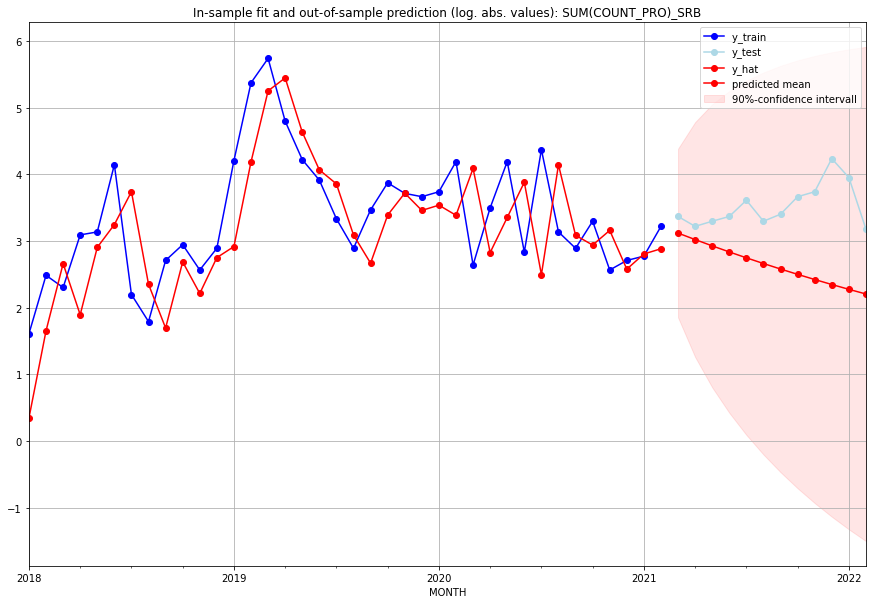

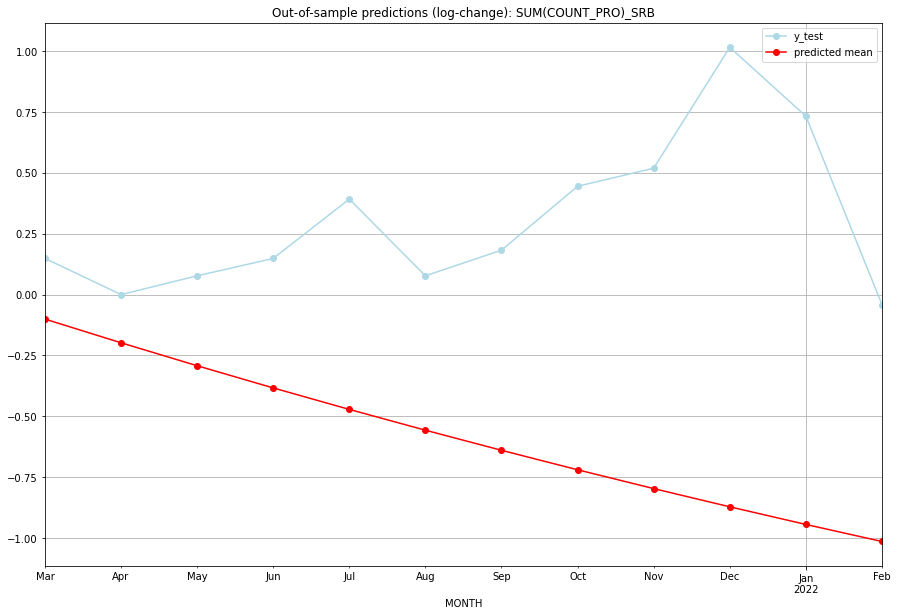

TADDA: 1.371433061704149
Evaluation finished.
        MONTH   FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  21.606923        28.0     -0.100620        0.148420   SRB   
1  2021-04-01  19.509711        24.0     -0.197977        0.000000   SRB   
2  2021-05-01  17.665875        26.0     -0.292179        0.076961   SRB   
3  2021-06-01  16.039760        28.0     -0.383326        0.148420   SRB   
4  2021-07-01  14.601338        36.0     -0.471519        0.392042   SRB   
5  2021-08-01  13.325241        26.0     -0.556853        0.076961   SRB   
6  2021-09-01  12.189959        29.0     -0.639420        0.182322   SRB   
7  2021-10-01  11.177200        38.0     -0.719310        0.444686   SRB   
8  2021-11-01  10.271358        41.0     -0.796611        0.518794   SRB   
9  2021-12-01   9.459077        68.0     -0.871406        1.015231   SRB   
10 2022-01-01   8.728896        51.0     -0.943775        0.732368   SRB   
11 2022-02-01   8.070947        23.0     -

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [1, (3, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.676350522606325, 'fold_results': [0.676350522606325]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_SSD   No. Observations:                  289
Model:               SARIMAX(3, 1, 0)   Log Likelihood                -205.130
Date:                Fri, 16 Sep 2022   AIC                            420.261
Time:                        14:57:48   BIC                            438.575
Sample:                    02-28-1997   HQIC                           427.600
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            -0.0369      0.030     -1.211      0.226     

<Figure size 432x288 with 0 Axes>

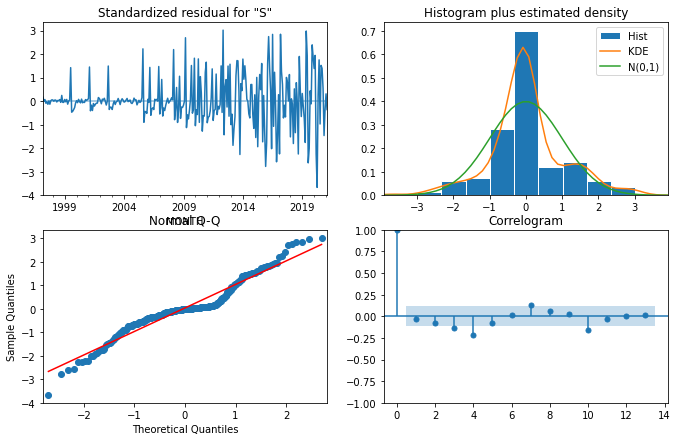

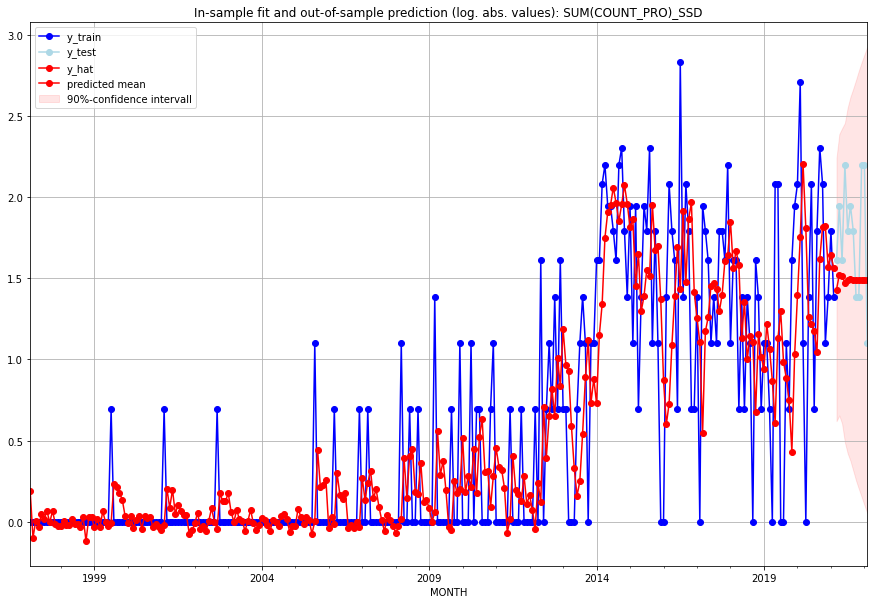

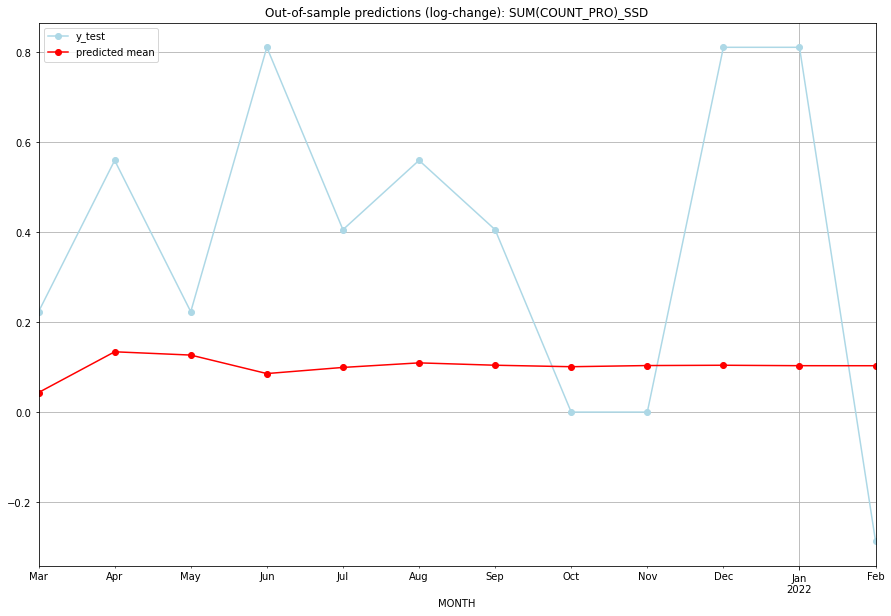

TADDA: 0.38310966518105677
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  3.177712         4.0      0.043469        0.223144   SSD   
1  2021-04-01  3.573820         6.0      0.134054        0.559616   SSD   
2  2021-05-01  3.540485         4.0      0.126739        0.223144   SSD   
3  2021-06-01  3.357610         8.0      0.085629        0.810930   SSD   
4  2021-07-01  3.417451         5.0      0.099269        0.405465   SSD   
5  2021-08-01  3.462482         6.0      0.109411        0.559616   SSD   
6  2021-09-01  3.439111         5.0      0.104160        0.405465   SSD   
7  2021-10-01  3.424482         3.0      0.100859        0.000000   SSD   
8  2021-11-01  3.435974         3.0      0.103453        0.000000   SSD   
9  2021-12-01  3.438891         8.0      0.104110        0.810930   SSD   
10 2022-01-01  3.434635         8.0      0.103151        0.810930   SSD   
11 2022-02-01  3.434133         2.0      0.103038   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.11552453009332421, 'fold_results': [0.11552453009332421]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_STP   No. Observations:                  289
Model:                        SARIMAX   Log Likelihood                 414.488
Date:                Fri, 16 Sep 2022   AIC                           -826.976
Time:                        14:58:08   BIC                           -823.309
Sample:                    02-28-1997   HQIC                          -825.507
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.0033   3.27e-05    101.823      0.000 

<Figure size 432x288 with 0 Axes>

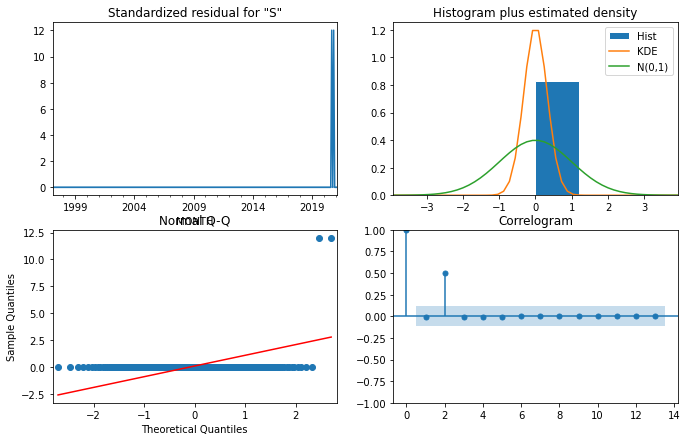

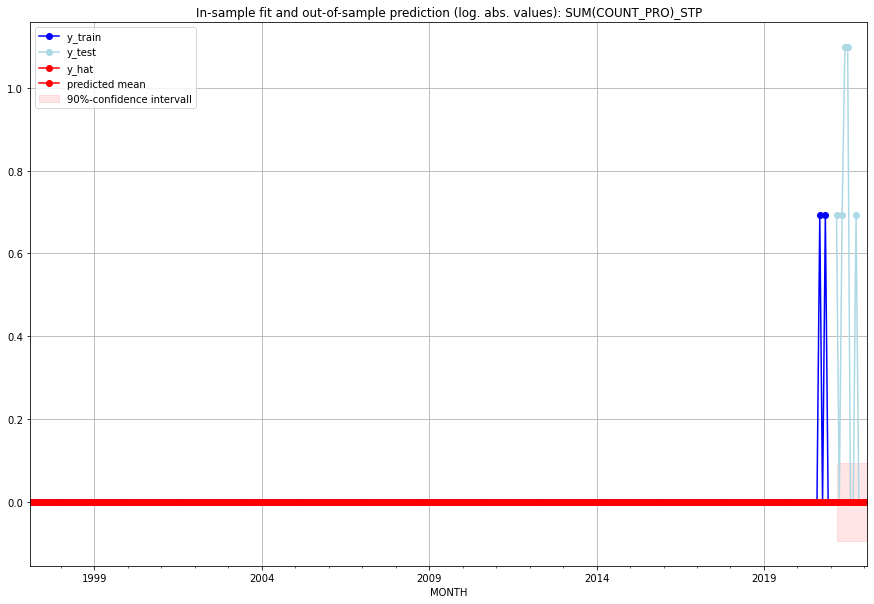

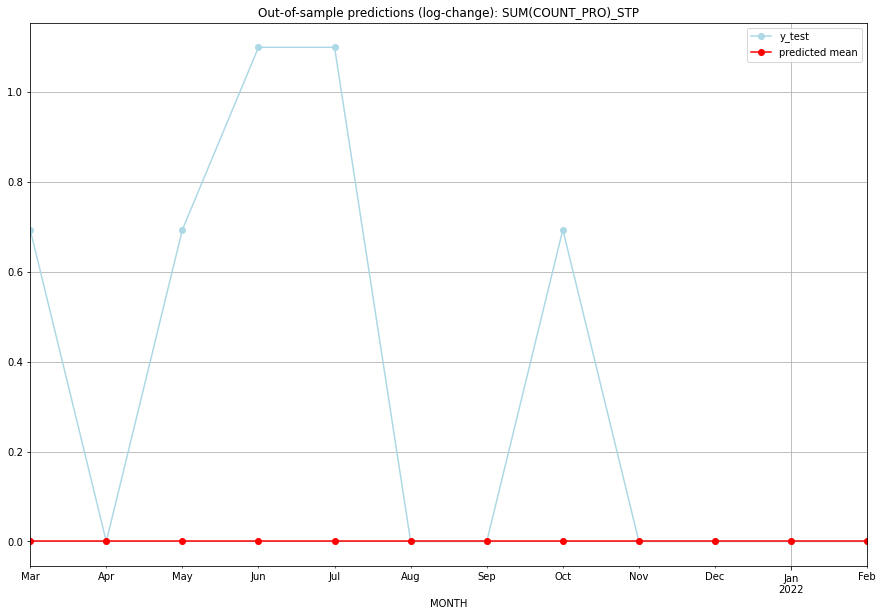

TADDA: 0.35638884325133796
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         1.0           0.0        0.693147   STP   
1  2021-04-01       0.0         0.0           0.0        0.000000   STP   
2  2021-05-01       0.0         1.0           0.0        0.693147   STP   
3  2021-06-01       0.0         2.0           0.0        1.098612   STP   
4  2021-07-01       0.0         2.0           0.0        1.098612   STP   
5  2021-08-01       0.0         0.0           0.0        0.000000   STP   
6  2021-09-01       0.0         0.0           0.0        0.000000   STP   
7  2021-10-01       0.0         1.0           0.0        0.693147   STP   
8  2021-11-01       0.0         0.0           0.0        0.000000   STP   
9  2021-12-01       0.0         0.0           0.0        0.000000   STP   
10 2022-01-01       0.0         0.0           0.0        0.000000   STP   
11 2022-02-01       0.0         0.0           0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [3, (0, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.6395448053090521, 'fold_results': [0.6395448053090521]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_SUR   No. Observations:                   38
Model:               SARIMAX(0, 1, 0)   Log Likelihood                 -36.717
Date:                Fri, 16 Sep 2022   AIC                             81.434
Time:                        14:58:30   BIC                             87.878
Sample:                    01-31-2018   HQIC                            83.706
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1             0.0516      0.076      0.678      0.498   

<Figure size 432x288 with 0 Axes>

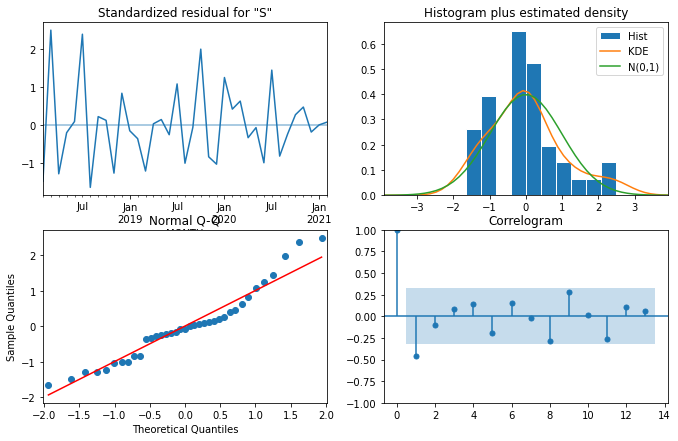

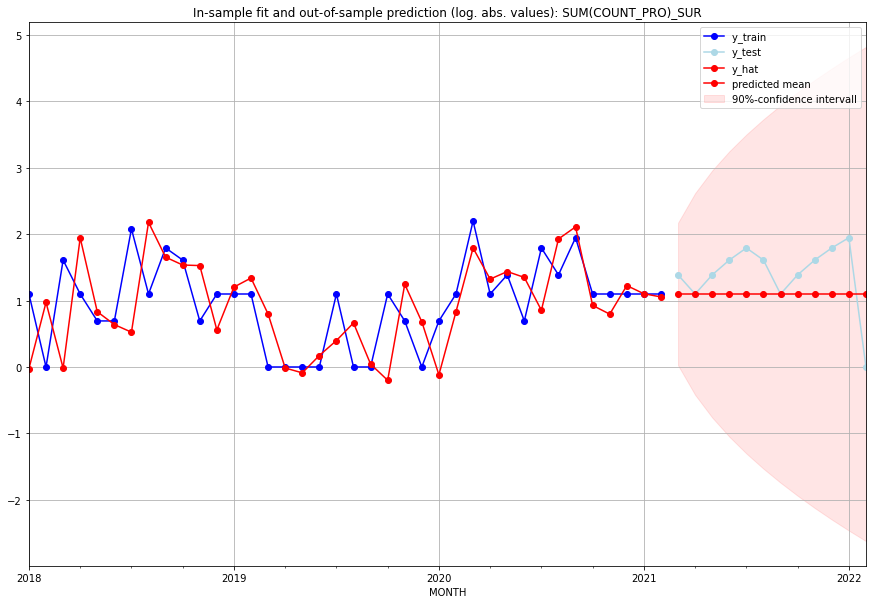

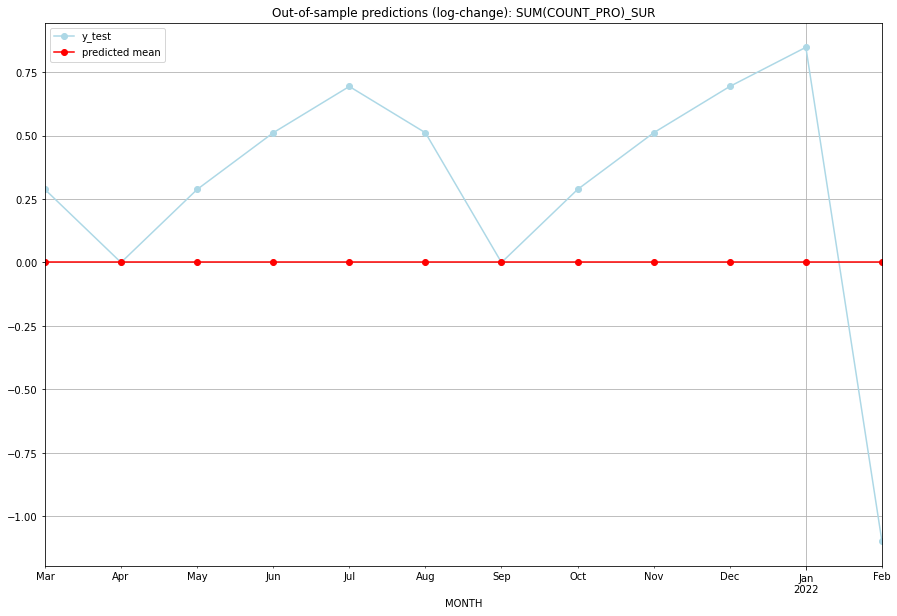

TADDA: 0.4773106332357098
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       2.0         3.0           0.0        0.287682   SUR   
1  2021-04-01       2.0         2.0           0.0        0.000000   SUR   
2  2021-05-01       2.0         3.0           0.0        0.287682   SUR   
3  2021-06-01       2.0         4.0           0.0        0.510826   SUR   
4  2021-07-01       2.0         5.0           0.0        0.693147   SUR   
5  2021-08-01       2.0         4.0           0.0        0.510826   SUR   
6  2021-09-01       2.0         2.0           0.0        0.000000   SUR   
7  2021-10-01       2.0         3.0           0.0        0.287682   SUR   
8  2021-11-01       2.0         4.0           0.0        0.510826   SUR   
9  2021-12-01       2.0         5.0           0.0        0.693147   SUR   
10 2022-01-01       2.0         6.0           0.0        0.847298   SUR   
11 2022-02-01       2.0         0.0           0.0    

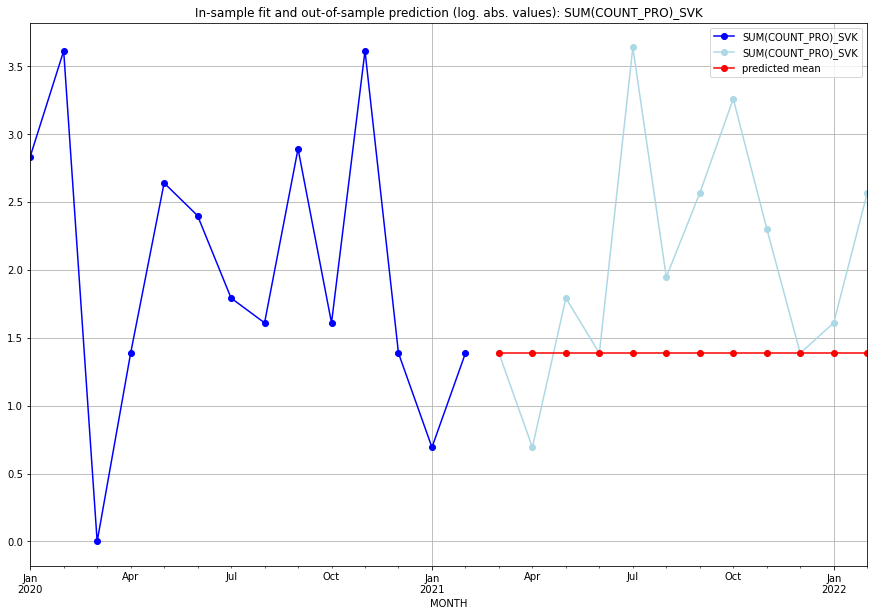

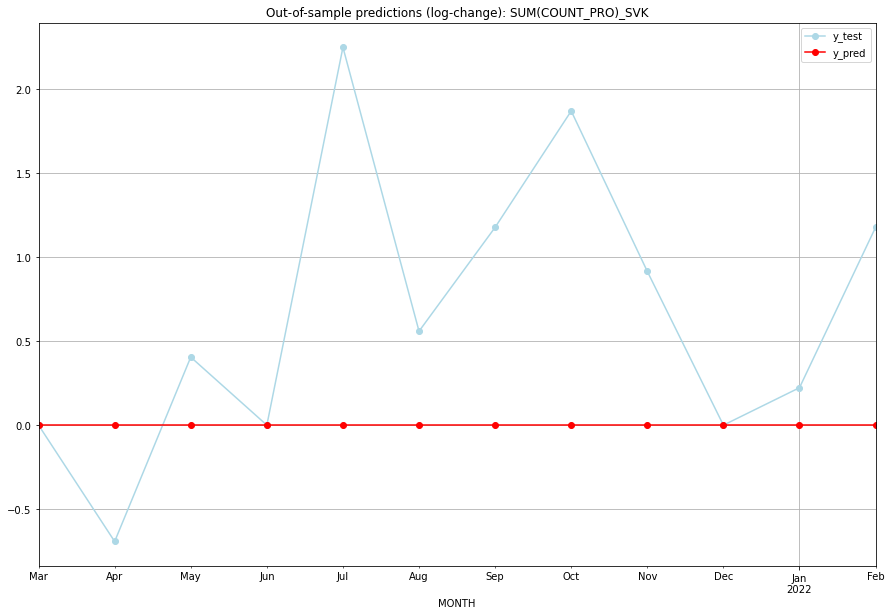

TADDA: 0.7731721939986063
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  1.386294    1.386294           0.0        0.000000   SVK   
1  2021-04-01  1.386294    0.693147           0.0       -0.693147   SVK   
2  2021-05-01  1.386294    1.791759           0.0        0.405465   SVK   
3  2021-06-01  1.386294    1.386294           0.0        0.000000   SVK   
4  2021-07-01  1.386294    3.637586           0.0        2.251292   SVK   
5  2021-08-01  1.386294    1.945910           0.0        0.559616   SVK   
6  2021-09-01  1.386294    2.564949           0.0        1.178655   SVK   
7  2021-10-01  1.386294    3.258097           0.0        1.871802   SVK   
8  2021-11-01  1.386294    2.302585           0.0        0.916291   SVK   
9  2021-12-01  1.386294    1.386294           0.0        0.000000   SVK   
10 2022-01-01  1.386294    1.609438           0.0        0.223144   SVK   
11 2022-02-01  1.386294    2.564949           0.0    

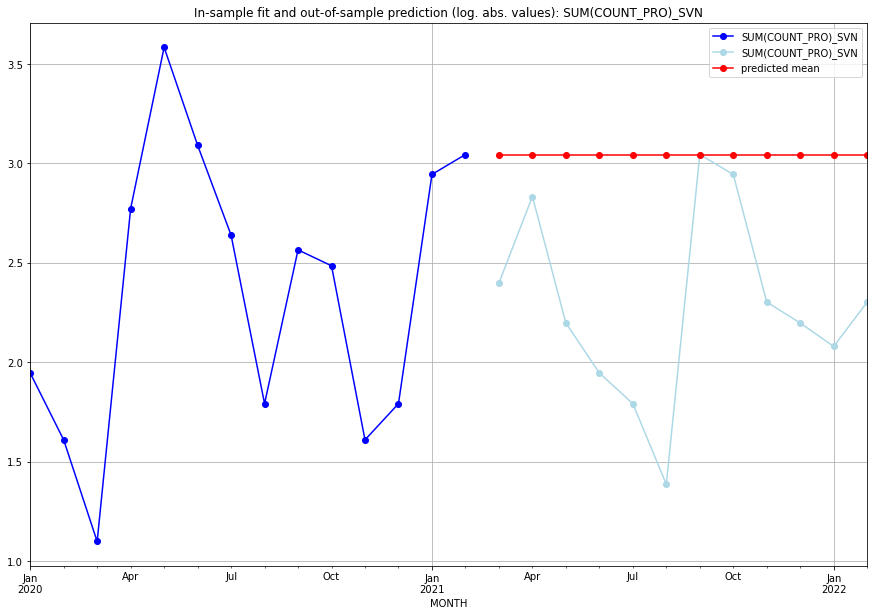

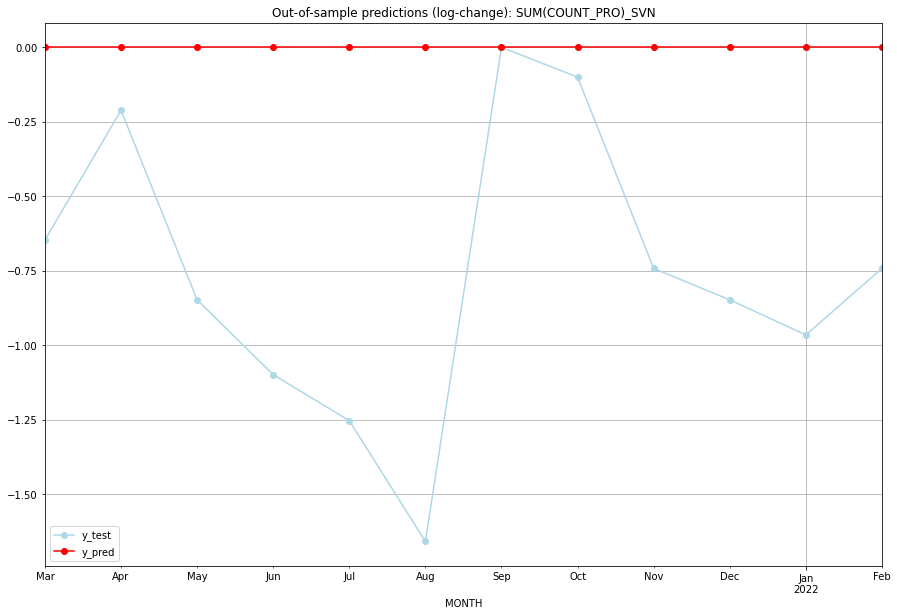

TADDA: 0.7592645297660834
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  3.044522    2.397895           0.0       -0.646627   SVN   
1  2021-04-01  3.044522    2.833213           0.0       -0.211309   SVN   
2  2021-05-01  3.044522    2.197225           0.0       -0.847298   SVN   
3  2021-06-01  3.044522    1.945910           0.0       -1.098612   SVN   
4  2021-07-01  3.044522    1.791759           0.0       -1.252763   SVN   
5  2021-08-01  3.044522    1.386294           0.0       -1.658228   SVN   
6  2021-09-01  3.044522    3.044522           0.0        0.000000   SVN   
7  2021-10-01  3.044522    2.944439           0.0       -0.100083   SVN   
8  2021-11-01  3.044522    2.302585           0.0       -0.741937   SVN   
9  2021-12-01  3.044522    2.197225           0.0       -0.847298   SVN   
10 2022-01-01  3.044522    2.079442           0.0       -0.965081   SVN   
11 2022-02-01  3.044522    2.302585           0.0    

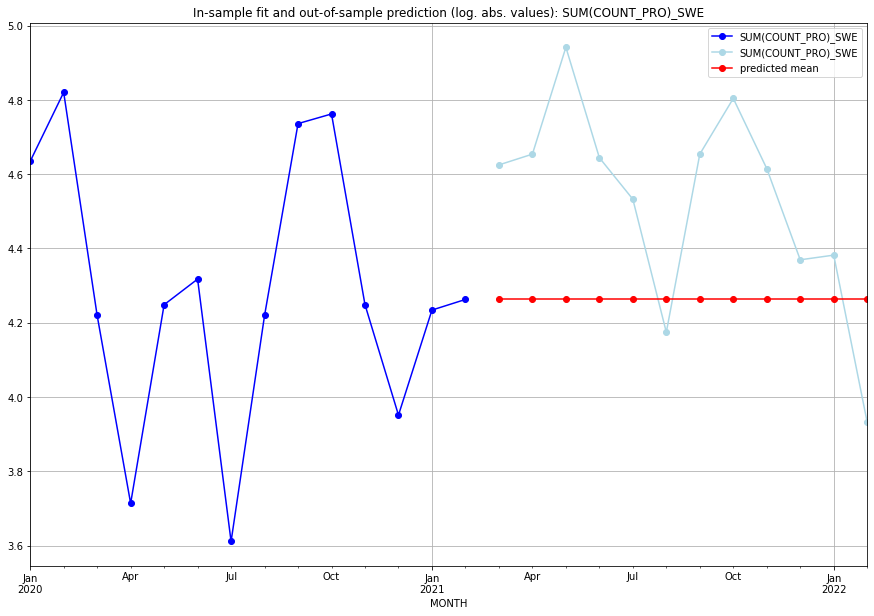

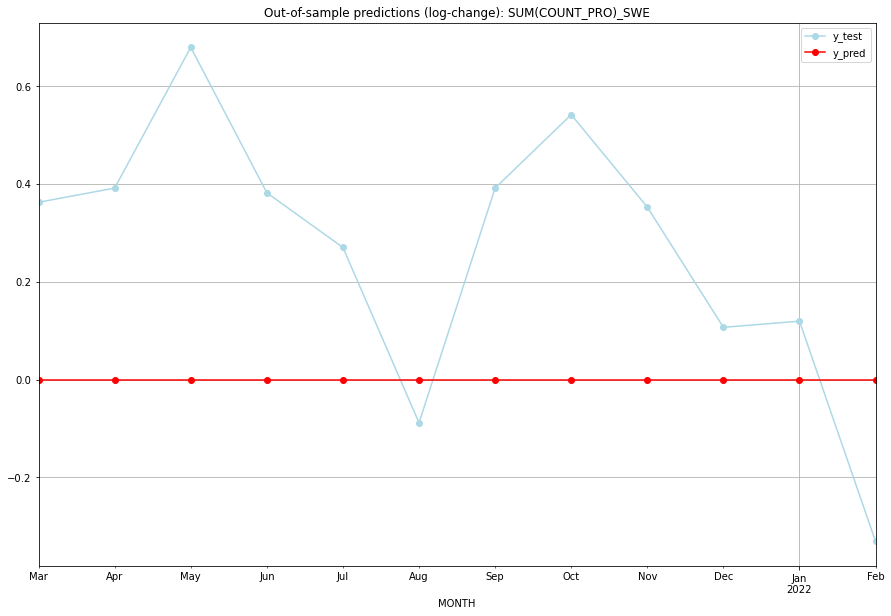

TADDA: 0.33454087152234796
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01   4.26268    4.624973           0.0        0.362293   SWE   
1  2021-04-01   4.26268    4.653960           0.0        0.391280   SWE   
2  2021-05-01   4.26268    4.941642           0.0        0.678963   SWE   
3  2021-06-01   4.26268    4.644391           0.0        0.381711   SWE   
4  2021-07-01   4.26268    4.532599           0.0        0.269920   SWE   
5  2021-08-01   4.26268    4.174387           0.0       -0.088293   SWE   
6  2021-09-01   4.26268    4.653960           0.0        0.391280   SWE   
7  2021-10-01   4.26268    4.804021           0.0        0.541341   SWE   
8  2021-11-01   4.26268    4.615121           0.0        0.352441   SWE   
9  2021-12-01   4.26268    4.369448           0.0        0.106768   SWE   
10 2022-01-01   4.26268    4.382027           0.0        0.119347   SWE   
11 2022-02-01   4.26268    3.931826           0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [1, (3, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.46345310073555684, 'fold_results': [0.46345310073555684]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_SWZ   No. Observations:                  289
Model:               SARIMAX(3, 1, 0)   Log Likelihood                -195.585
Date:                Fri, 16 Sep 2022   AIC                            401.169
Time:                        14:59:27   BIC                            419.484
Sample:                    02-28-1997   HQIC                           408.509
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1             0.0541      0.027      2.007      0.045 

<Figure size 432x288 with 0 Axes>

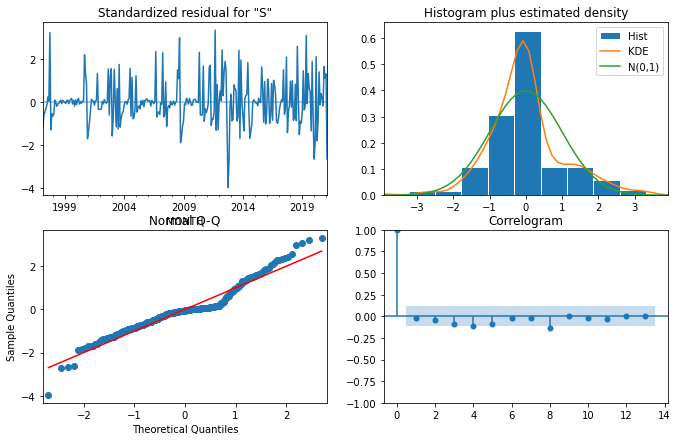

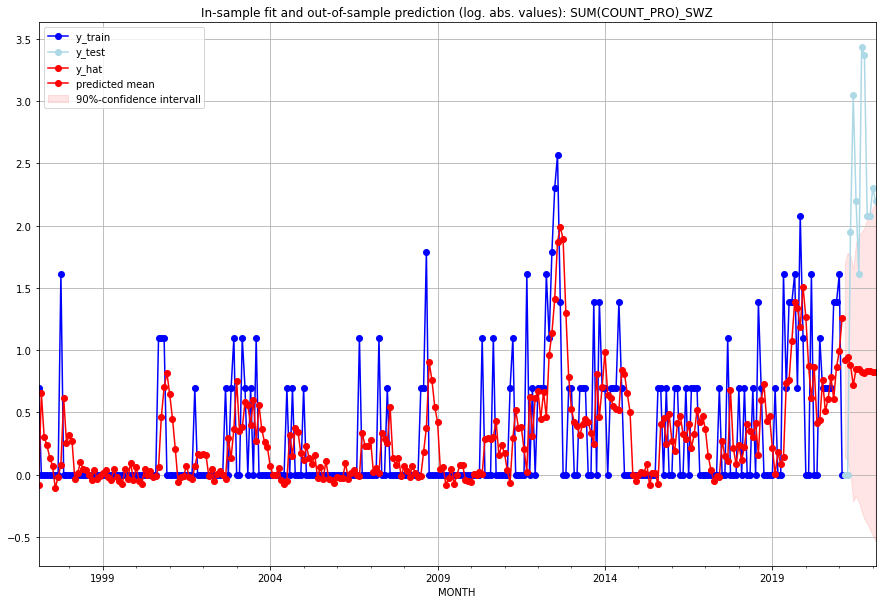

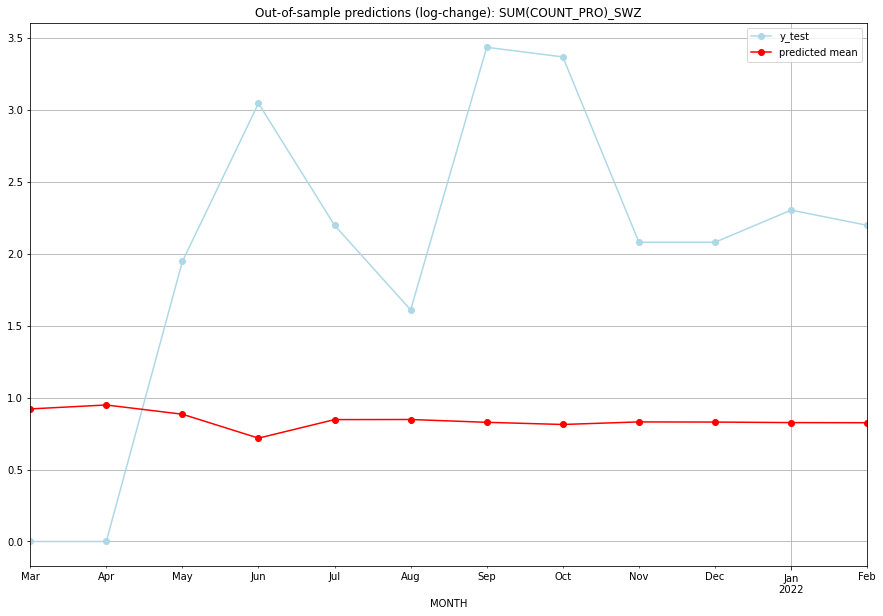

TADDA: 1.4896643595307062
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  1.512242         0.0      0.921176        0.000000   SWZ   
1  2021-04-01  1.582122         0.0      0.948612        0.000000   SWZ   
2  2021-05-01  1.421478         6.0      0.884378        1.945910   SWZ   
3  2021-06-01  1.050837        20.0      0.718248        3.044522   SWZ   
4  2021-07-01  1.332623         8.0      0.846994        2.197225   SWZ   
5  2021-08-01  1.334251         4.0      0.847691        1.609438   SWZ   
6  2021-09-01  1.289060        30.0      0.828141        3.433987   SWZ   
7  2021-10-01  1.254854        28.0      0.813085        3.367296   SWZ   
8  2021-11-01  1.295477         7.0      0.830941        2.079442   SWZ   
9  2021-12-01  1.293147         7.0      0.829925        2.079442   SWZ   
10 2022-01-01  1.284697         9.0      0.826234        2.302585   SWZ   
11 2022-02-01  1.282451         8.0      0.825250    

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (3, 1, 2), (0, 0, 0, 0), 'n'], 'cv_score': 0.4342340745968891, 'fold_results': [0.4342340745968891]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_SXM   No. Observations:                   38
Model:               SARIMAX(3, 1, 2)   Log Likelihood                 -12.535
Date:                Fri, 16 Sep 2022   AIC                             37.071
Time:                        14:59:49   BIC                             46.736
Sample:                    01-31-2018   HQIC                            40.479
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.4461      0.546     -0.817      0.414   

<Figure size 432x288 with 0 Axes>

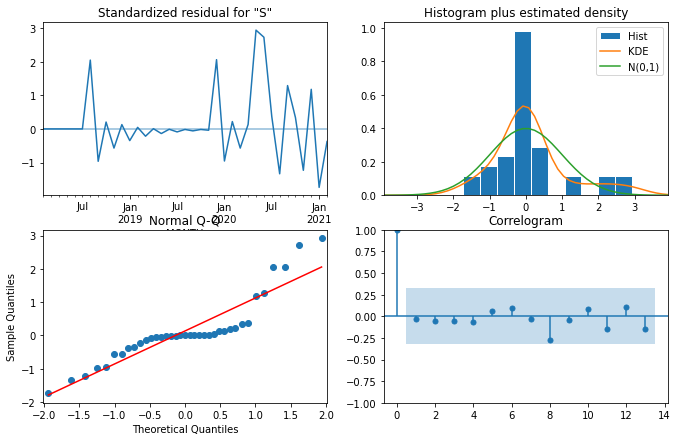

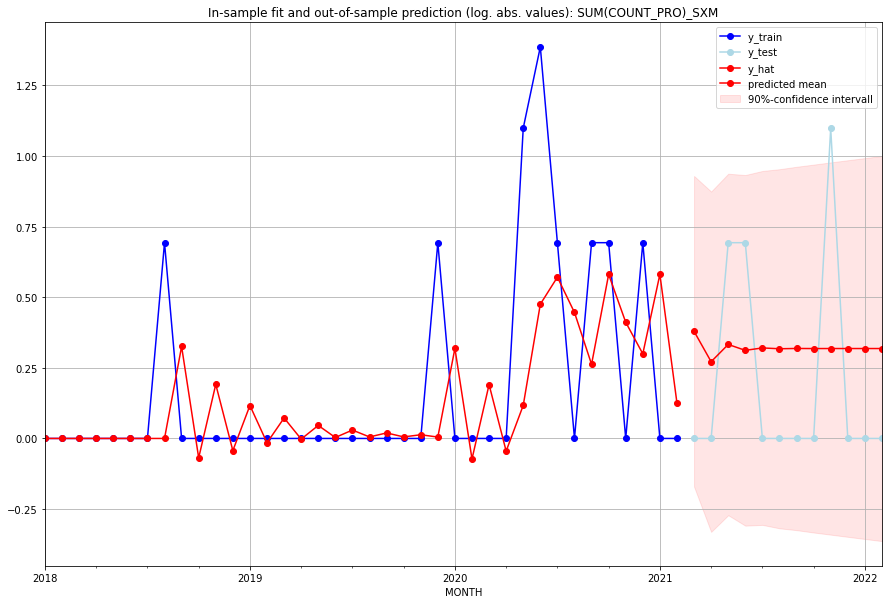

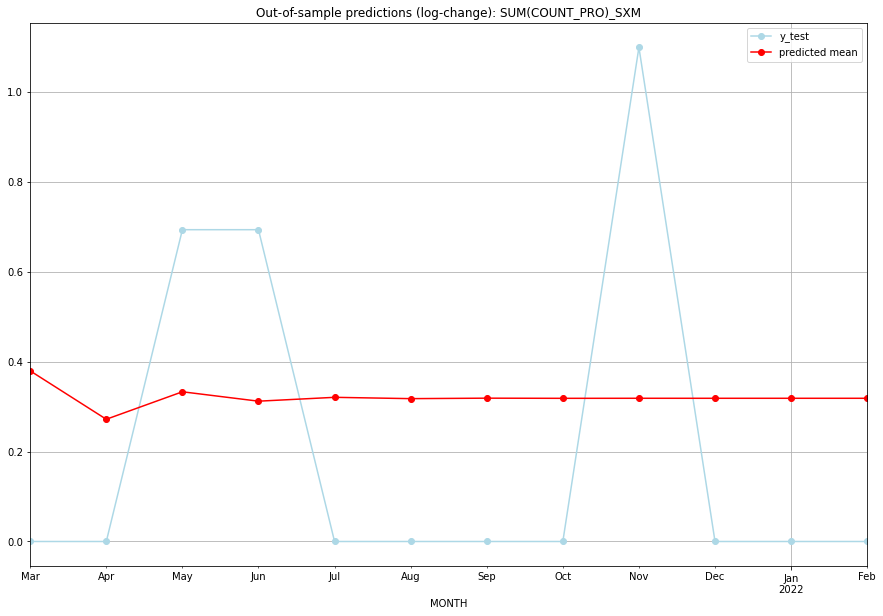

TADDA: 0.36690369247054094
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  0.461275         0.0      0.379309        0.000000   SXM   
1  2021-04-01  0.312213         0.0      0.271715        0.000000   SXM   
2  2021-05-01  0.394891         1.0      0.332816        0.693147   SXM   
3  2021-06-01  0.366047         1.0      0.311921        0.693147   SXM   
4  2021-07-01  0.377808         0.0      0.320494        0.000000   SXM   
5  2021-08-01  0.373788         0.0      0.317572        0.000000   SXM   
6  2021-09-01  0.375224         0.0      0.318616        0.000000   SXM   
7  2021-10-01  0.374757         0.0      0.318277        0.000000   SXM   
8  2021-11-01  0.374908         2.0      0.318387        1.098612   SXM   
9  2021-12-01  0.374863         0.0      0.318354        0.000000   SXM   
10 2022-01-01  0.374876         0.0      0.318363        0.000000   SXM   
11 2022-02-01  0.374872         0.0      0.318361   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.35638884325133796, 'fold_results': [0.35638884325133796]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_SYC   No. Observations:                  289
Model:                        SARIMAX   Log Likelihood                 196.760
Date:                Fri, 16 Sep 2022   AIC                           -391.521
Time:                        15:00:11   BIC                           -387.855
Sample:                    02-28-1997   HQIC                          -390.052
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.0150      0.000     64.726      0.000 

<Figure size 432x288 with 0 Axes>

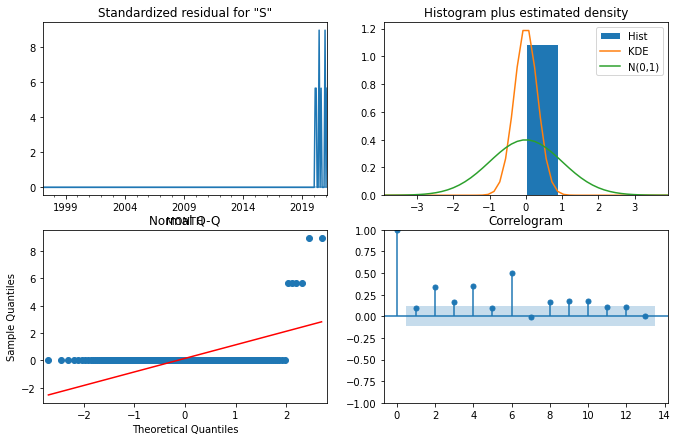

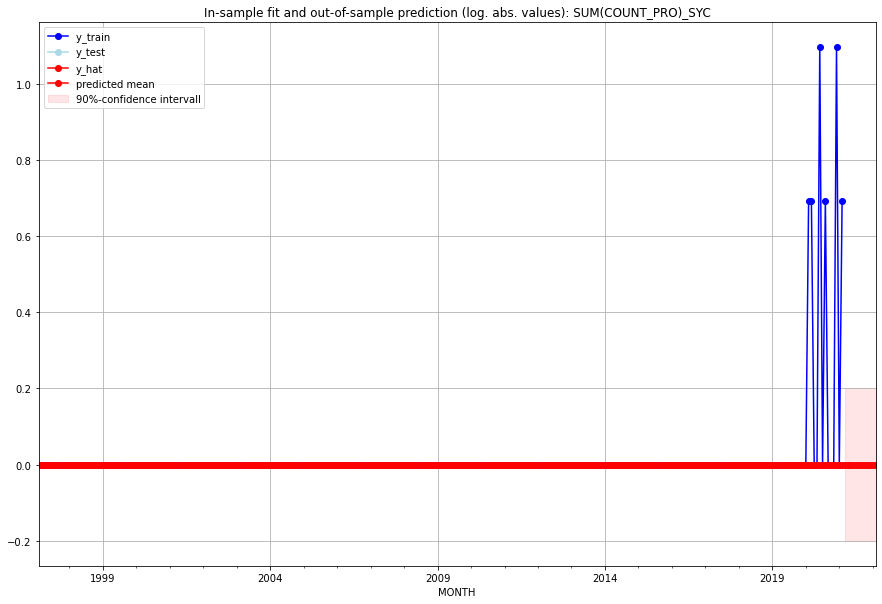

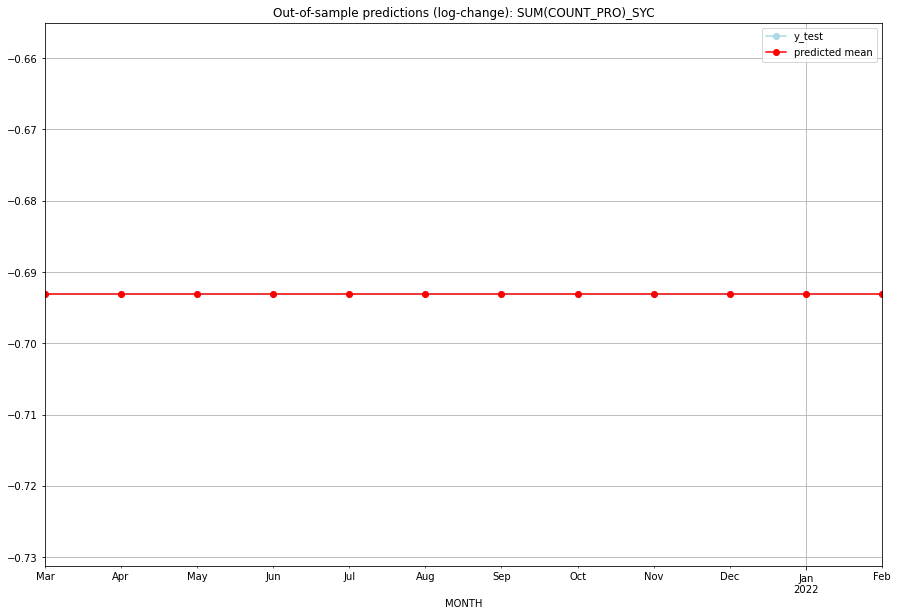

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0     -0.693147       -0.693147   SYC   
1  2021-04-01       0.0         0.0     -0.693147       -0.693147   SYC   
2  2021-05-01       0.0         0.0     -0.693147       -0.693147   SYC   
3  2021-06-01       0.0         0.0     -0.693147       -0.693147   SYC   
4  2021-07-01       0.0         0.0     -0.693147       -0.693147   SYC   
5  2021-08-01       0.0         0.0     -0.693147       -0.693147   SYC   
6  2021-09-01       0.0         0.0     -0.693147       -0.693147   SYC   
7  2021-10-01       0.0         0.0     -0.693147       -0.693147   SYC   
8  2021-11-01       0.0         0.0     -0.693147       -0.693147   SYC   
9  2021-12-01       0.0         0.0     -0.693147       -0.693147   SYC   
10 2022-01-01       0.0         0.0     -0.693147       -0.693147   SYC   
11 2022-02-01       0.0         0.0     -0.693147       -0.693147   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.4962580062633937, 'fold_results': [0.4962580062633937]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_SYR   No. Observations:                   50
Model:               SARIMAX(0, 1, 0)   Log Likelihood                 -62.053
Date:                Fri, 16 Sep 2022   AIC                            126.106
Time:                        15:00:40   BIC                            127.998
Sample:                    01-31-2017   HQIC                           126.824
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.7370      0.149      4.958      0.000   

<Figure size 432x288 with 0 Axes>

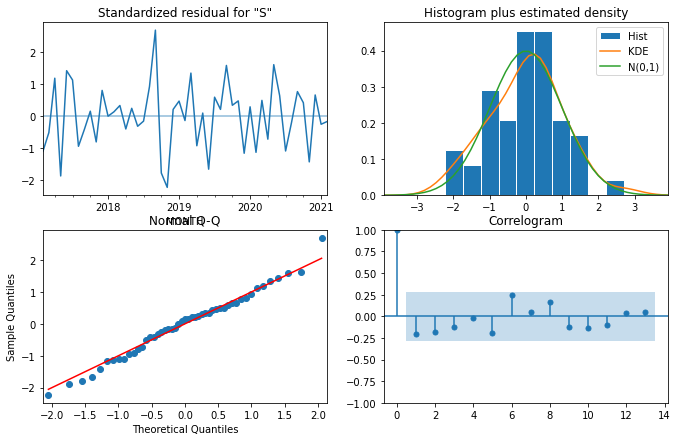

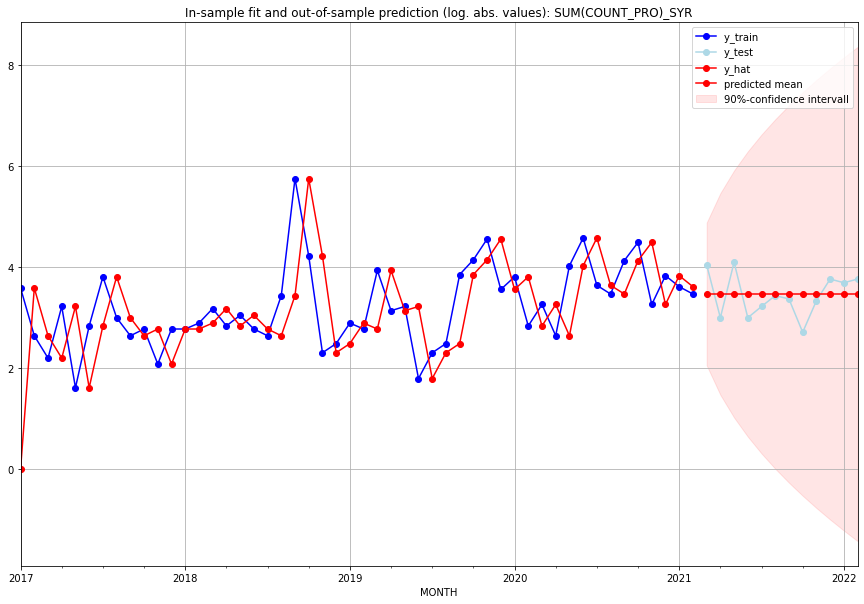

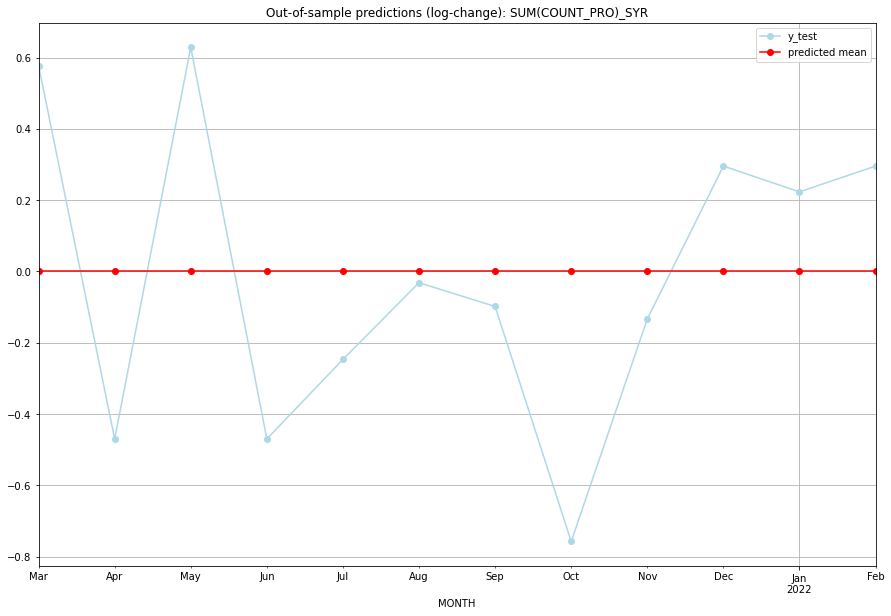

TADDA: 0.3523557669526622
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01      31.0        56.0           0.0        0.577315   SYR   
1  2021-04-01      31.0        19.0           0.0       -0.470004   SYR   
2  2021-05-01      31.0        59.0           0.0        0.628609   SYR   
3  2021-06-01      31.0        19.0           0.0       -0.470004   SYR   
4  2021-07-01      31.0        24.0           0.0       -0.246860   SYR   
5  2021-08-01      31.0        30.0           0.0       -0.031749   SYR   
6  2021-09-01      31.0        28.0           0.0       -0.098440   SYR   
7  2021-10-01      31.0        14.0           0.0       -0.757686   SYR   
8  2021-11-01      31.0        27.0           0.0       -0.133531   SYR   
9  2021-12-01      31.0        42.0           0.0        0.295464   SYR   
10 2022-01-01      31.0        39.0           0.0        0.223144   SYR   
11 2022-02-01      31.0        42.0           0.0    

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.09155102405567582, 'fold_results': [0.09155102405567582]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_TCA   No. Observations:                   38
Model:                        SARIMAX   Log Likelihood                  -7.916
Date:                Fri, 16 Sep 2022   AIC                             17.832
Time:                        15:00:54   BIC                             19.469
Sample:                    01-31-2018   HQIC                            18.415
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.0888      0.009      9.873      0.000 

<Figure size 432x288 with 0 Axes>

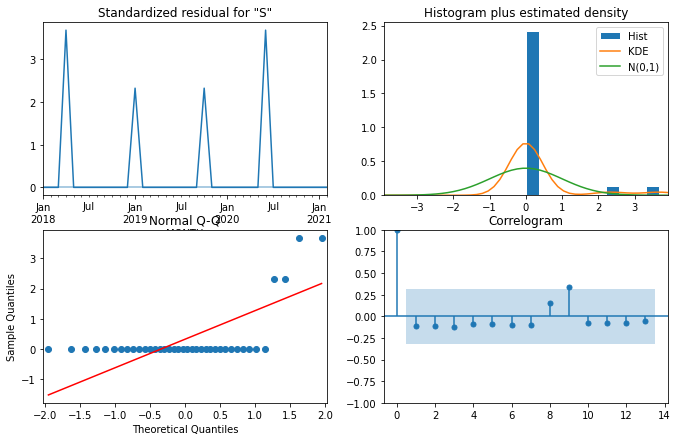

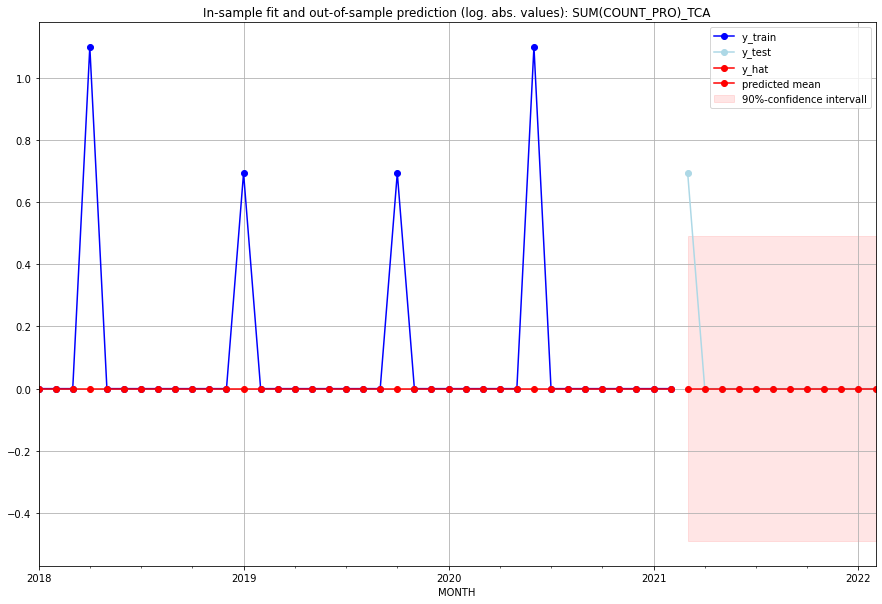

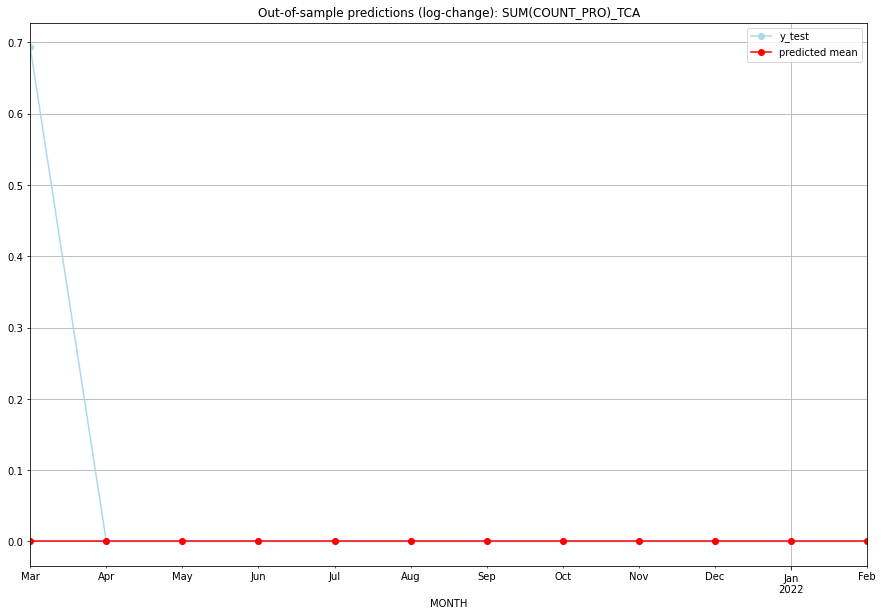

TADDA: 0.057762265046662105
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         1.0           0.0        0.693147   TCA   
1  2021-04-01       0.0         0.0           0.0        0.000000   TCA   
2  2021-05-01       0.0         0.0           0.0        0.000000   TCA   
3  2021-06-01       0.0         0.0           0.0        0.000000   TCA   
4  2021-07-01       0.0         0.0           0.0        0.000000   TCA   
5  2021-08-01       0.0         0.0           0.0        0.000000   TCA   
6  2021-09-01       0.0         0.0           0.0        0.000000   TCA   
7  2021-10-01       0.0         0.0           0.0        0.000000   TCA   
8  2021-11-01       0.0         0.0           0.0        0.000000   TCA   
9  2021-12-01       0.0         0.0           0.0        0.000000   TCA   
10 2022-01-01       0.0         0.0           0.0        0.000000   TCA   
11 2022-02-01       0.0         0.0           0.0  

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [2, (2, 1, 1), (0, 0, 0, 0), 'n'], 'cv_score': 0.31955977971819965, 'fold_results': [0.31955977971819965]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_TCD   No. Observations:                  289
Model:               SARIMAX(2, 1, 1)   Log Likelihood                -113.447
Date:                Fri, 16 Sep 2022   AIC                            238.894
Time:                        15:01:35   BIC                            260.872
Sample:                    02-28-1997   HQIC                           247.701
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1             0.0550      0.021      2.670      0.008 

<Figure size 432x288 with 0 Axes>

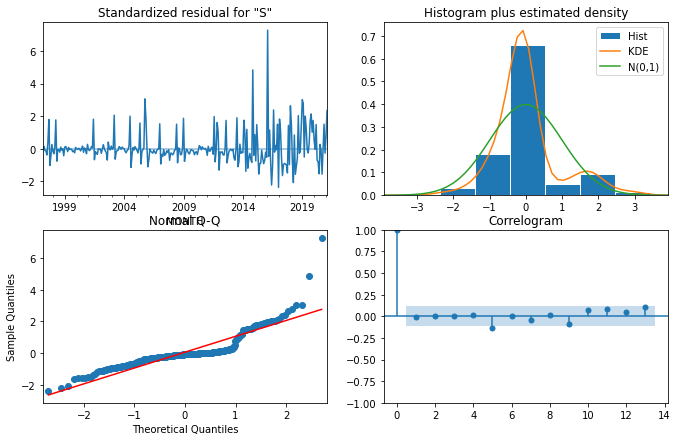

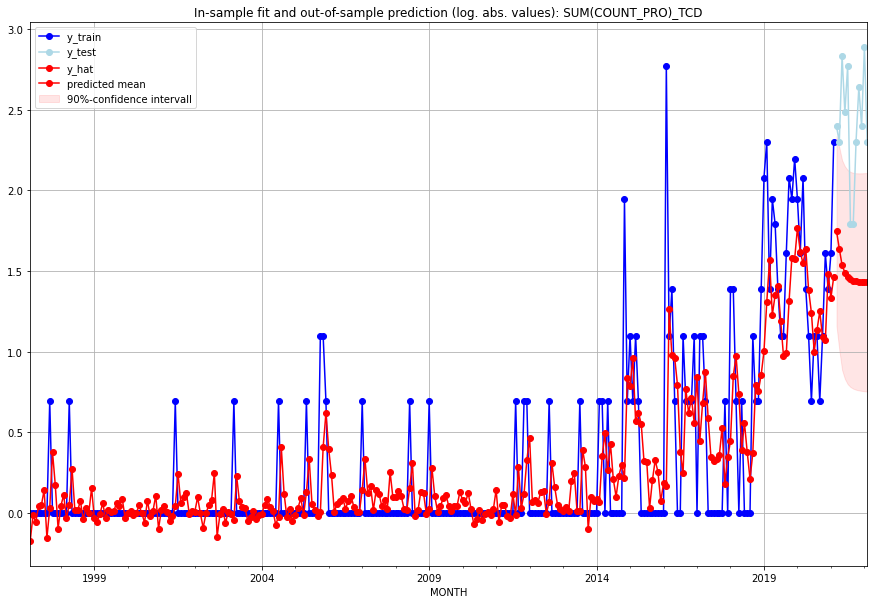

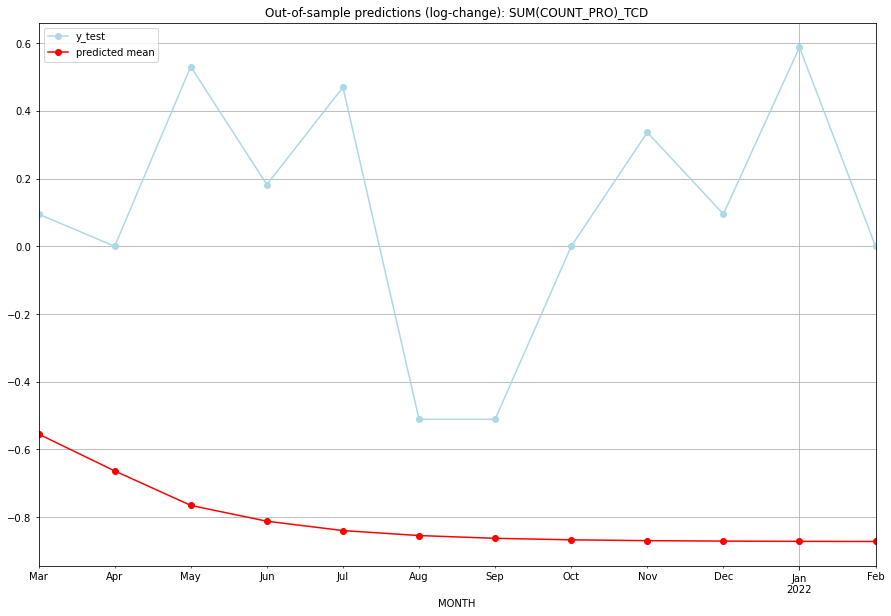

TADDA: 1.3799250991927066
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  4.743908        10.0     -0.554445        0.095310   TCD   
1  2021-04-01  4.151423         9.0     -0.663312        0.000000   TCD   
2  2021-05-01  3.652600        16.0     -0.765159        0.530628   TCD   
3  2021-06-01  3.440121        11.0     -0.811904        0.182322   TCD   
4  2021-07-01  3.319256        15.0     -0.839502        0.470004   TCD   
5  2021-08-01  3.256189         5.0     -0.854211       -0.510826   TCD   
6  2021-09-01  3.221611         5.0     -0.862368       -0.510826   TCD   
7  2021-10-01  3.202852         9.0     -0.866822        0.000000   TCD   
8  2021-11-01  3.192584        13.0     -0.869268        0.336472   TCD   
9  2021-12-01  3.186967        10.0     -0.870608        0.095310   TCD   
10 2022-01-01  3.183890        17.0     -0.871344        0.587787   TCD   
11 2022-02-01  3.182204         9.0     -0.871747    

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.6040568221627275, 'fold_results': [0.6040568221627275]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_TGO   No. Observations:                  289
Model:               SARIMAX(0, 1, 0)   Log Likelihood                -340.832
Date:                Fri, 16 Sep 2022   AIC                            683.663
Time:                        15:02:12   BIC                            687.326
Sample:                    02-28-1997   HQIC                           685.131
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.6244      0.039     15.893      0.000   

<Figure size 432x288 with 0 Axes>

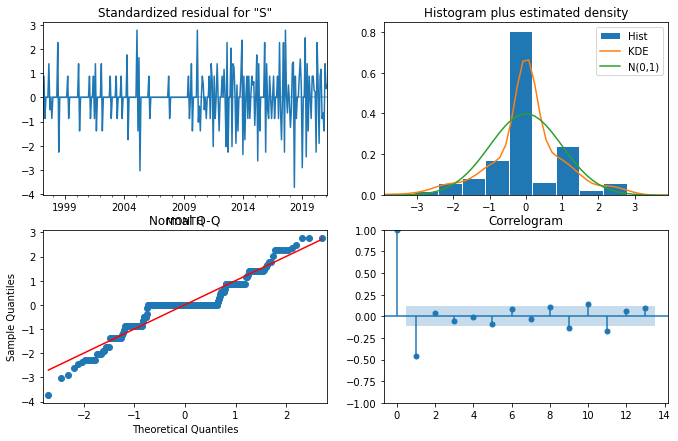

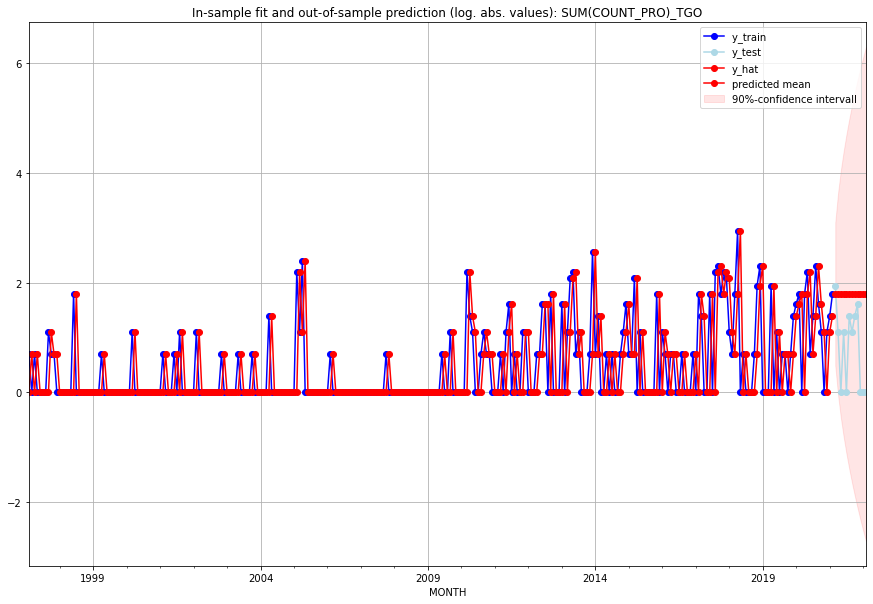

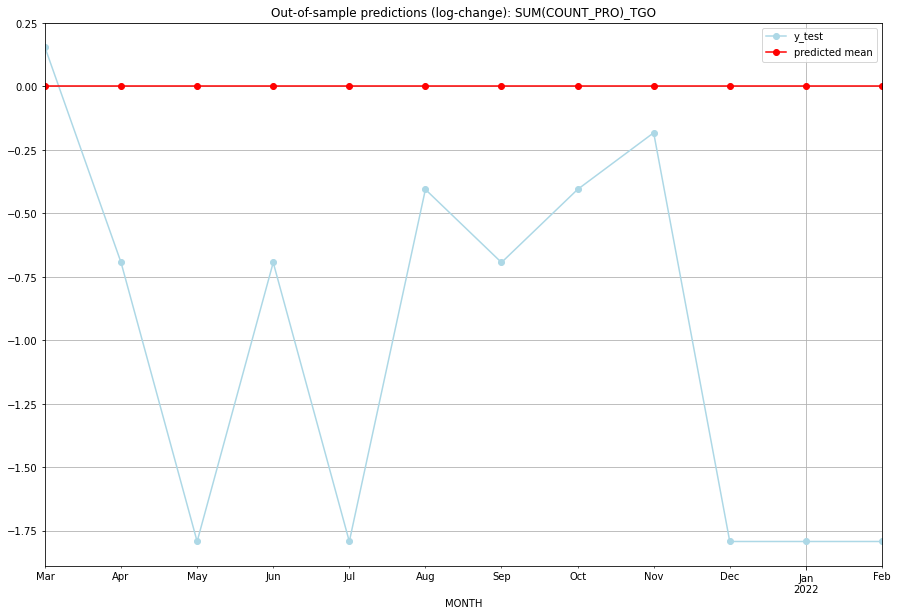

TADDA: 1.015470111721471
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       5.0         6.0           0.0        0.154151   TGO   
1  2021-04-01       5.0         2.0           0.0       -0.693147   TGO   
2  2021-05-01       5.0         0.0           0.0       -1.791759   TGO   
3  2021-06-01       5.0         2.0           0.0       -0.693147   TGO   
4  2021-07-01       5.0         0.0           0.0       -1.791759   TGO   
5  2021-08-01       5.0         3.0           0.0       -0.405465   TGO   
6  2021-09-01       5.0         2.0           0.0       -0.693147   TGO   
7  2021-10-01       5.0         3.0           0.0       -0.405465   TGO   
8  2021-11-01       5.0         4.0           0.0       -0.182322   TGO   
9  2021-12-01       5.0         0.0           0.0       -1.791759   TGO   
10 2022-01-01       5.0         0.0           0.0       -1.791759   TGO   
11 2022-02-01       5.0         0.0           0.0     

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.852782885410428, 'fold_results': [0.852782885410428]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_THA   No. Observations:                  134
Model:               SARIMAX(0, 1, 0)   Log Likelihood                -164.530
Date:                Fri, 16 Sep 2022   AIC                            331.061
Time:                        15:02:41   BIC                            333.951
Sample:                    01-31-2010   HQIC                           332.235
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.6951      0.079      8.818      0.000     

<Figure size 432x288 with 0 Axes>

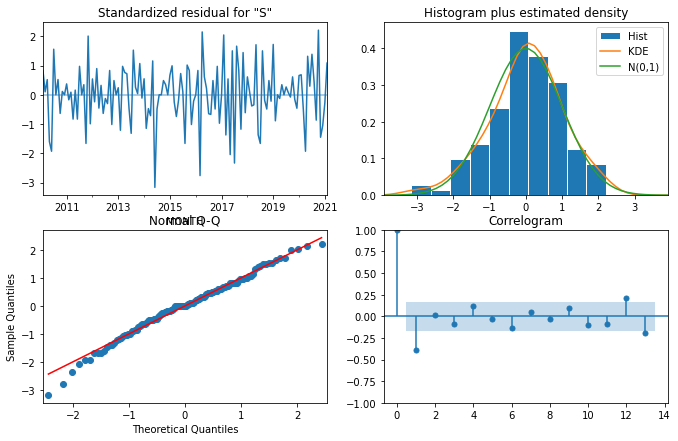

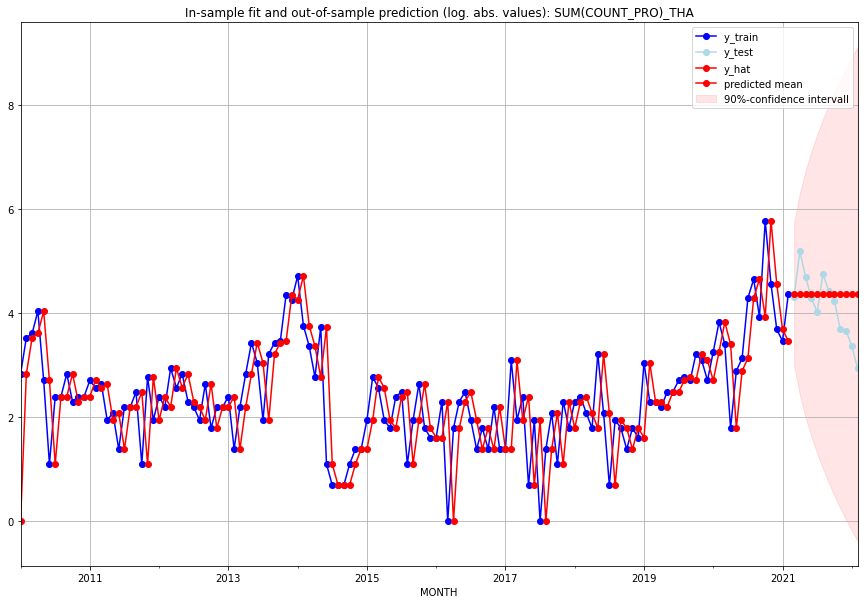

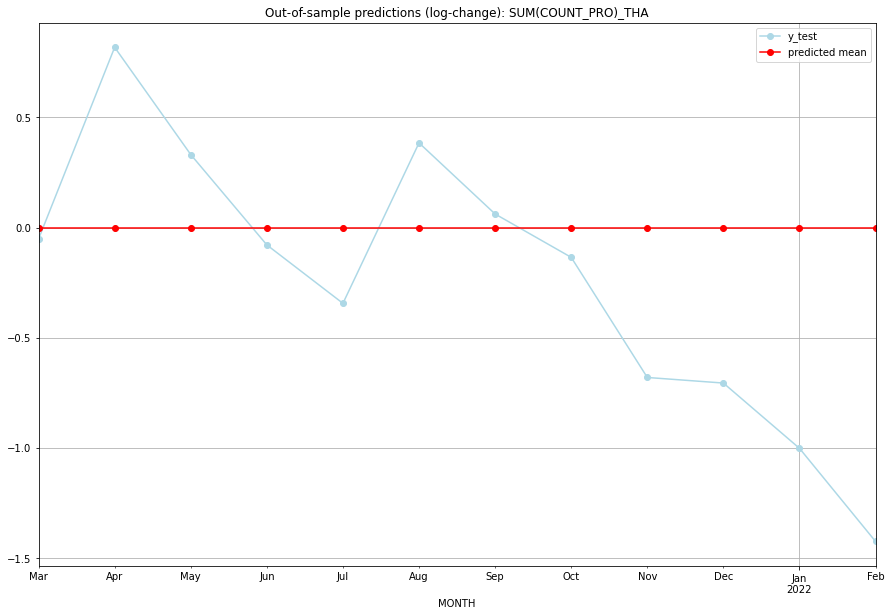

TADDA: 0.5015402426697774
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01      78.0        74.0           0.0       -0.051960   THA   
1  2021-04-01      78.0       178.0           0.0        0.817938   THA   
2  2021-05-01      78.0       109.0           0.0        0.331033   THA   
3  2021-06-01      78.0        72.0           0.0       -0.078988   THA   
4  2021-07-01      78.0        55.0           0.0       -0.344096   THA   
5  2021-08-01      78.0       115.0           0.0        0.384142   THA   
6  2021-09-01      78.0        83.0           0.0        0.061369   THA   
7  2021-10-01      78.0        68.0           0.0       -0.135341   THA   
8  2021-11-01      78.0        39.0           0.0       -0.680568   THA   
9  2021-12-01      78.0        38.0           0.0       -0.705886   THA   
10 2022-01-01      78.0        28.0           0.0       -1.002152   THA   
11 2022-02-01      78.0        18.0           0.0    

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.6565445163450302, 'fold_results': [0.6565445163450302]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_TJK   No. Observations:                   38
Model:                        SARIMAX   Log Likelihood                 -51.257
Date:                Fri, 16 Sep 2022   AIC                            104.515
Time:                        15:03:05   BIC                            106.153
Sample:                    01-31-2018   HQIC                           105.098
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.8693      0.197      4.419      0.000   

<Figure size 432x288 with 0 Axes>

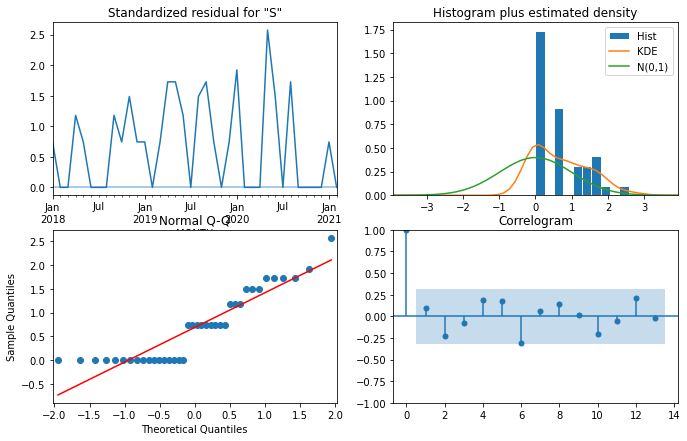

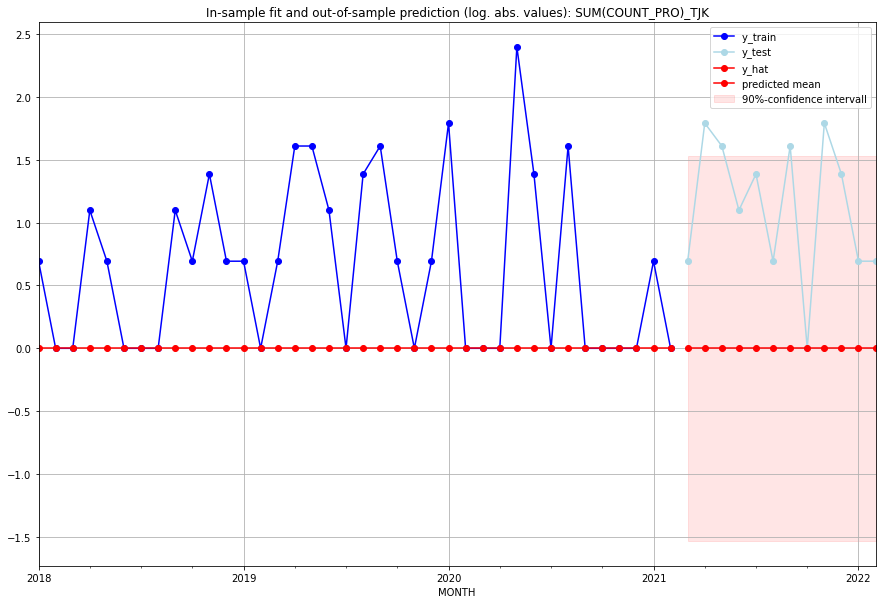

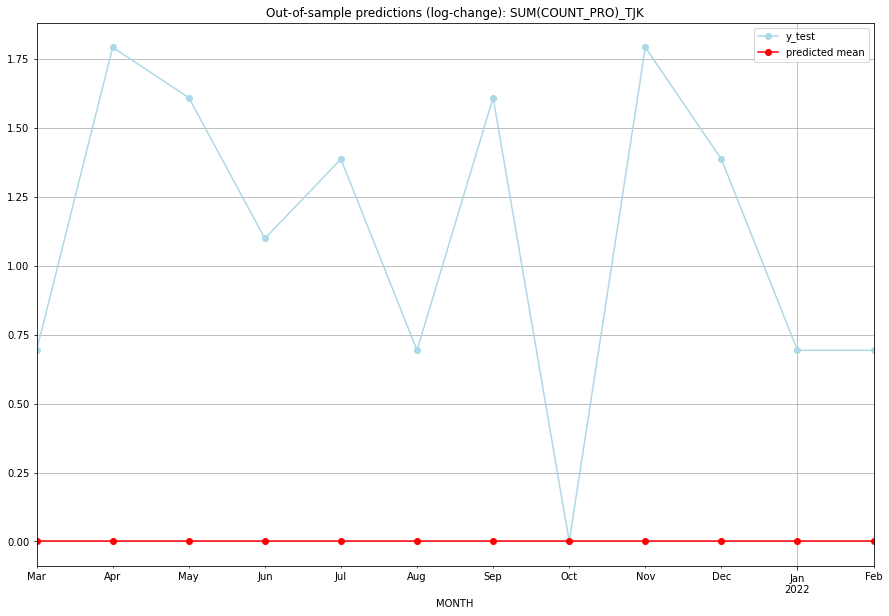

TADDA: 1.1205153747059986
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         1.0           0.0        0.693147   TJK   
1  2021-04-01       0.0         5.0           0.0        1.791759   TJK   
2  2021-05-01       0.0         4.0           0.0        1.609438   TJK   
3  2021-06-01       0.0         2.0           0.0        1.098612   TJK   
4  2021-07-01       0.0         3.0           0.0        1.386294   TJK   
5  2021-08-01       0.0         1.0           0.0        0.693147   TJK   
6  2021-09-01       0.0         4.0           0.0        1.609438   TJK   
7  2021-10-01       0.0         0.0           0.0        0.000000   TJK   
8  2021-11-01       0.0         5.0           0.0        1.791759   TJK   
9  2021-12-01       0.0         3.0           0.0        1.386294   TJK   
10 2022-01-01       0.0         1.0           0.0        0.693147   TJK   
11 2022-02-01       0.0         1.0           0.0    

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [1, (2, 1, 1), (0, 0, 0, 0), 'n'], 'cv_score': 0.471248905484193, 'fold_results': [0.471248905484193]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_TKM   No. Observations:                   38
Model:               SARIMAX(2, 1, 1)   Log Likelihood                 -19.374
Date:                Fri, 16 Sep 2022   AIC                             48.749
Time:                        15:03:31   BIC                             56.803
Sample:                    01-31-2018   HQIC                            51.588
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1             0.0444      0.033      1.348      0.178     

<Figure size 432x288 with 0 Axes>

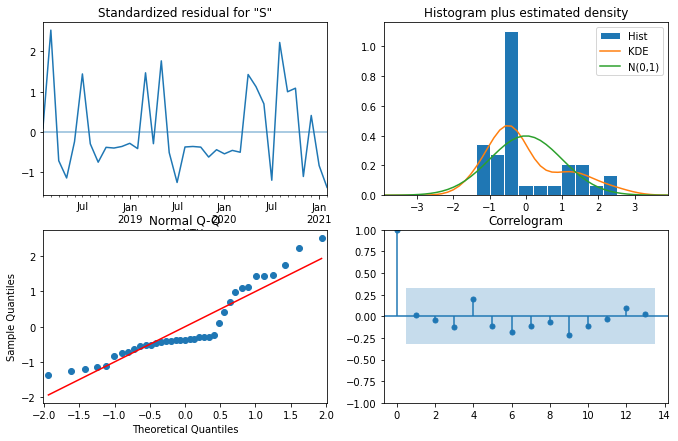

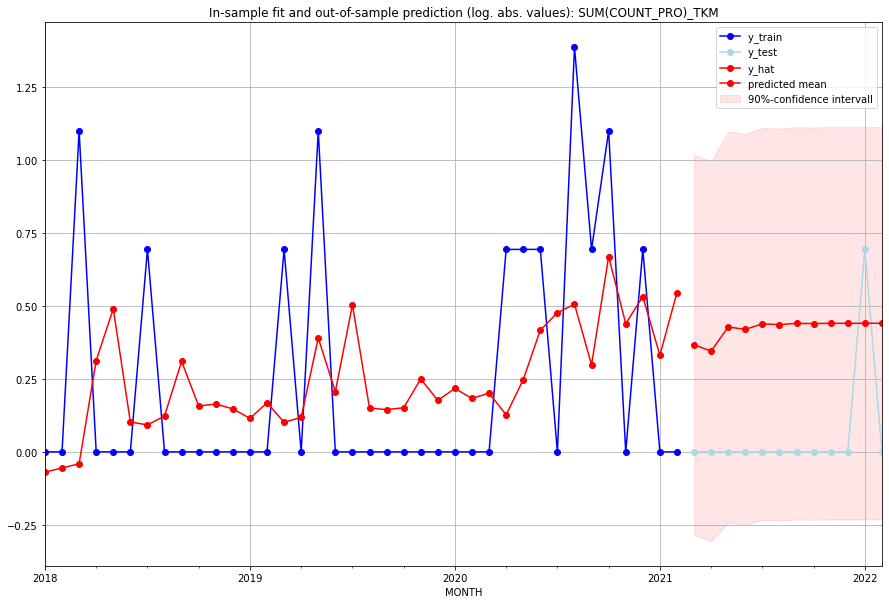

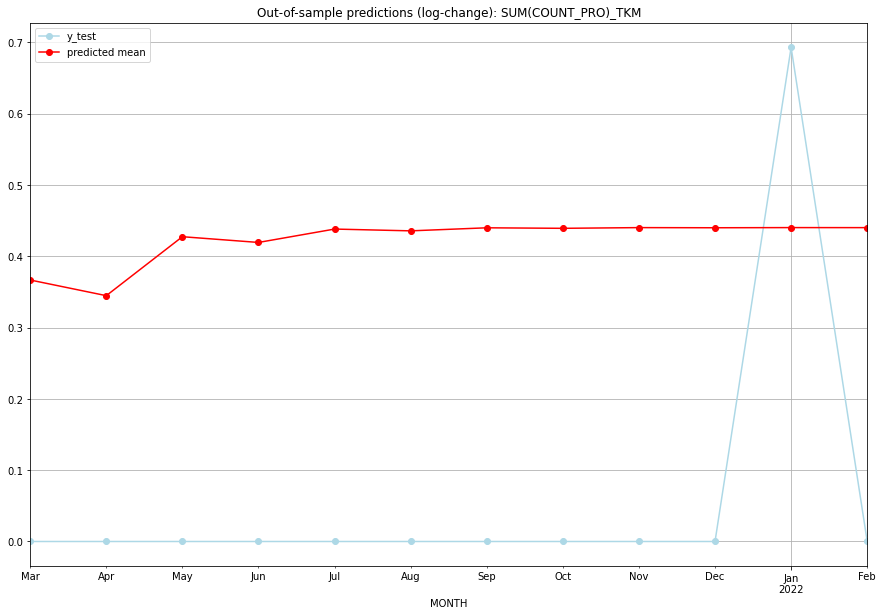

TADDA: 0.40708701532537145
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  0.443047         0.0      0.366757        0.000000   TKM   
1  2021-04-01  0.411698         0.0      0.344793        0.000000   TKM   
2  2021-05-01  0.533403         0.0      0.427490        0.000000   TKM   
3  2021-06-01  0.521121         0.0      0.419447        0.000000   TKM   
4  2021-07-01  0.549932         0.0      0.438211        0.000000   TKM   
5  2021-08-01  0.546050         0.0      0.435703        0.000000   TKM   
6  2021-09-01  0.552687         0.0      0.439987        0.000000   TKM   
7  2021-10-01  0.551565         0.0      0.439264        0.000000   TKM   
8  2021-11-01  0.553092         0.0      0.440248        0.000000   TKM   
9  2021-12-01  0.552784         0.0      0.440049        0.000000   TKM   
10 2022-01-01  0.553136         1.0      0.440276        0.693147   TKM   
11 2022-02-01  0.553054         0.0      0.440223   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.2888113252333105, 'fold_results': [0.2888113252333105]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_TLS   No. Observations:                  289
Model:                        SARIMAX   Log Likelihood                 197.149
Date:                Fri, 16 Sep 2022   AIC                           -392.297
Time:                        15:05:09   BIC                           -388.631
Sample:                    02-28-1997   HQIC                          -390.828
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.0150      0.000     91.840      0.000   

<Figure size 432x288 with 0 Axes>

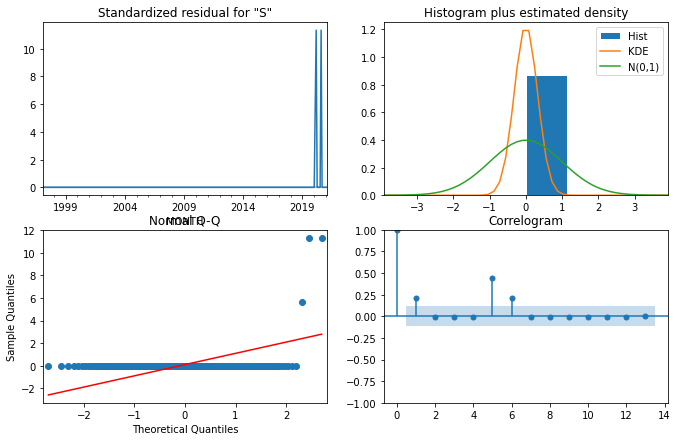

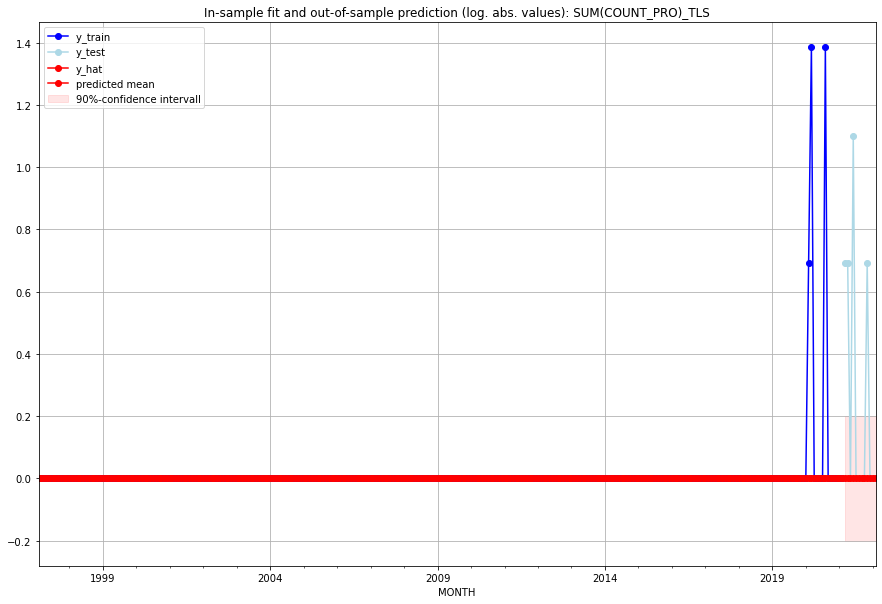

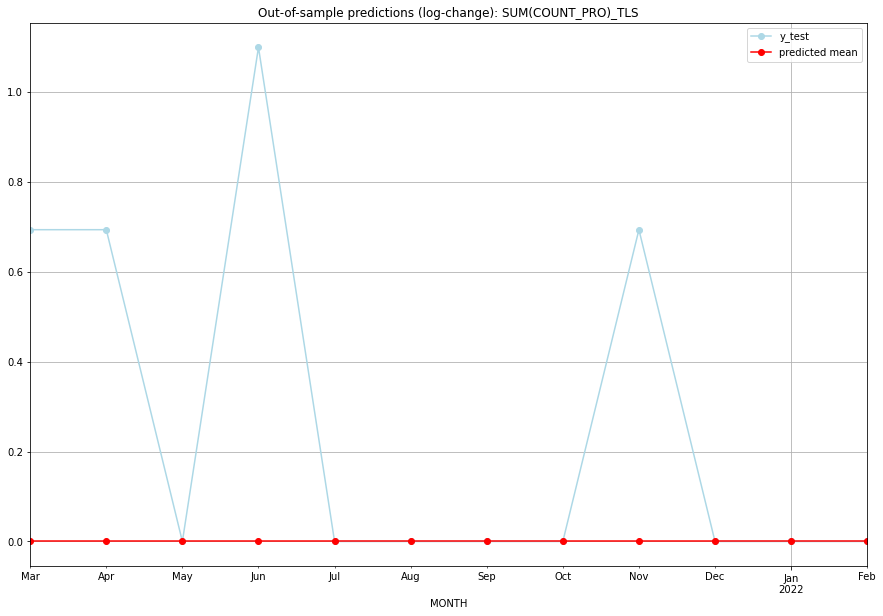

TADDA: 0.2648378191956621
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         1.0           0.0        0.693147   TLS   
1  2021-04-01       0.0         1.0           0.0        0.693147   TLS   
2  2021-05-01       0.0         0.0           0.0        0.000000   TLS   
3  2021-06-01       0.0         2.0           0.0        1.098612   TLS   
4  2021-07-01       0.0         0.0           0.0        0.000000   TLS   
5  2021-08-01       0.0         0.0           0.0        0.000000   TLS   
6  2021-09-01       0.0         0.0           0.0        0.000000   TLS   
7  2021-10-01       0.0         0.0           0.0        0.000000   TLS   
8  2021-11-01       0.0         1.0           0.0        0.693147   TLS   
9  2021-12-01       0.0         0.0           0.0        0.000000   TLS   
10 2022-01-01       0.0         0.0           0.0        0.000000   TLS   
11 2022-02-01       0.0         0.0           0.0    

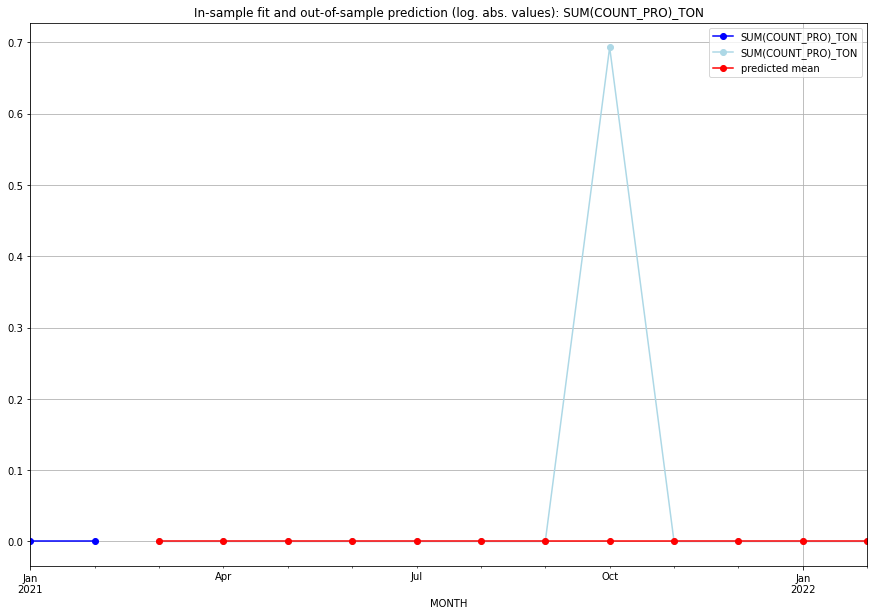

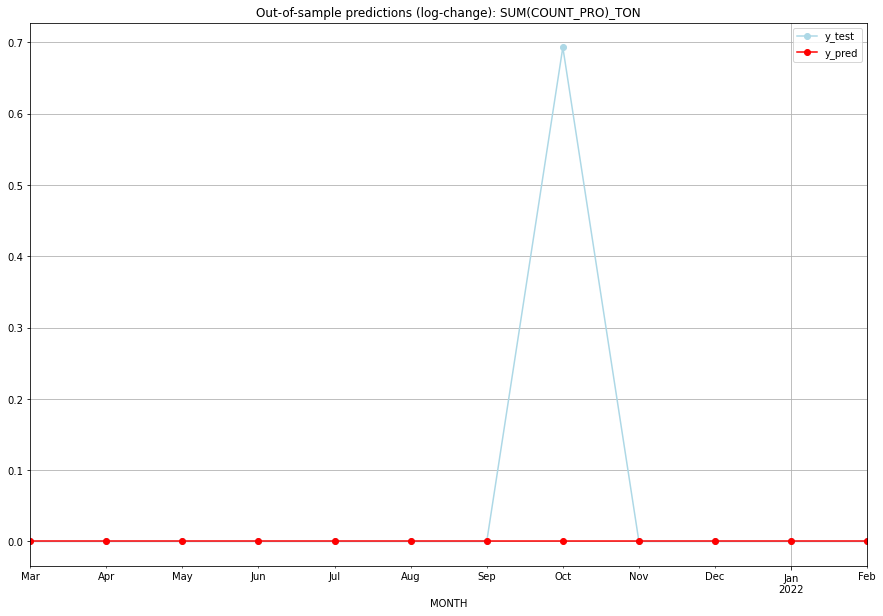

TADDA: 0.057762265046662105
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0    0.000000           0.0        0.000000   TON   
1  2021-04-01       0.0    0.000000           0.0        0.000000   TON   
2  2021-05-01       0.0    0.000000           0.0        0.000000   TON   
3  2021-06-01       0.0    0.000000           0.0        0.000000   TON   
4  2021-07-01       0.0    0.000000           0.0        0.000000   TON   
5  2021-08-01       0.0    0.000000           0.0        0.000000   TON   
6  2021-09-01       0.0    0.000000           0.0        0.000000   TON   
7  2021-10-01       0.0    0.693147           0.0        0.693147   TON   
8  2021-11-01       0.0    0.000000           0.0        0.000000   TON   
9  2021-12-01       0.0    0.000000           0.0        0.000000   TON   
10 2022-01-01       0.0    0.000000           0.0        0.000000   TON   
11 2022-02-01       0.0    0.000000           0.0  

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.5385497241444598, 'fold_results': [0.5385497241444598]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_TTO   No. Observations:                   38
Model:               SARIMAX(0, 1, 0)   Log Likelihood                 -42.882
Date:                Fri, 16 Sep 2022   AIC                             87.764
Time:                        15:05:34   BIC                             89.375
Sample:                    01-31-2018   HQIC                            88.332
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.5946      0.147      4.055      0.000   

<Figure size 432x288 with 0 Axes>

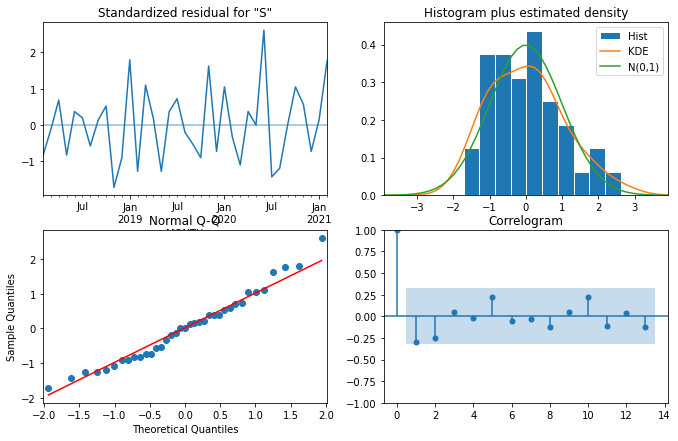

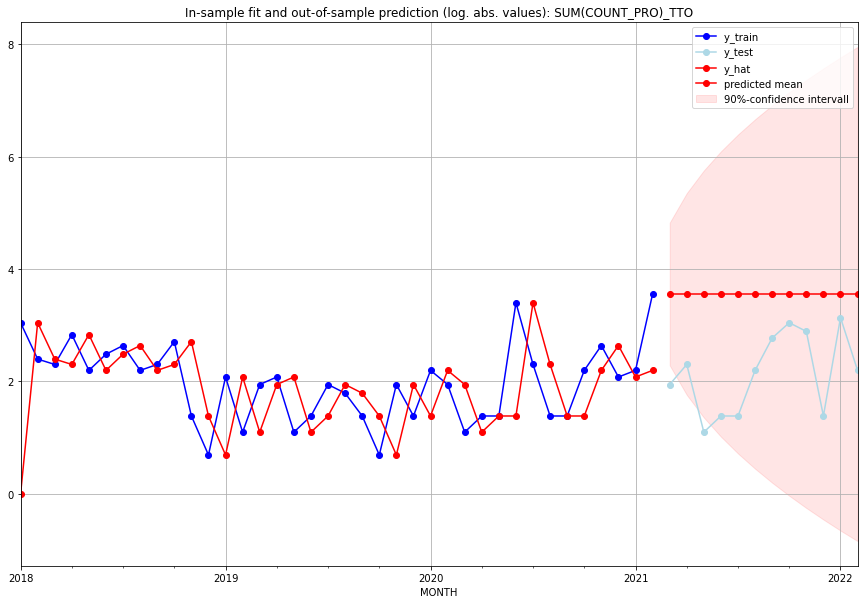

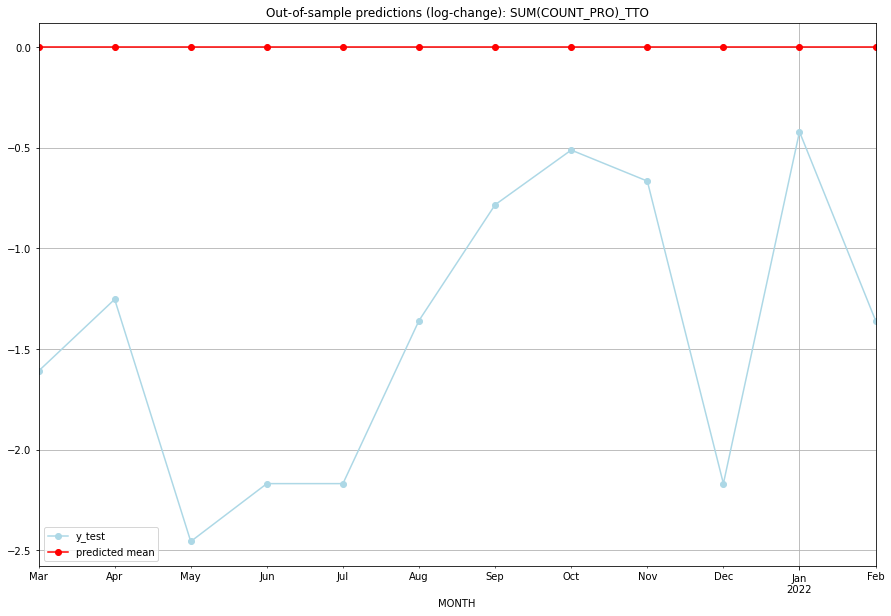

TADDA: 1.4100633196112382
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01      34.0         6.0           0.0       -1.609438   TTO   
1  2021-04-01      34.0         9.0           0.0       -1.252763   TTO   
2  2021-05-01      34.0         2.0           0.0       -2.456736   TTO   
3  2021-06-01      34.0         3.0           0.0       -2.169054   TTO   
4  2021-07-01      34.0         3.0           0.0       -2.169054   TTO   
5  2021-08-01      34.0         8.0           0.0       -1.358123   TTO   
6  2021-09-01      34.0        15.0           0.0       -0.782759   TTO   
7  2021-10-01      34.0        20.0           0.0       -0.510826   TTO   
8  2021-11-01      34.0        17.0           0.0       -0.664976   TTO   
9  2021-12-01      34.0         3.0           0.0       -2.169054   TTO   
10 2022-01-01      34.0        22.0           0.0       -0.419854   TTO   
11 2022-02-01      34.0         8.0           0.0    

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.5679547161019579, 'fold_results': [0.5679547161019579]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_TUN   No. Observations:                  289
Model:               SARIMAX(0, 1, 0)   Log Likelihood                -249.601
Date:                Fri, 16 Sep 2022   AIC                            501.202
Time:                        15:06:20   BIC                            504.865
Sample:                    02-28-1997   HQIC                           502.670
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.3314      0.015     21.852      0.000   

<Figure size 432x288 with 0 Axes>

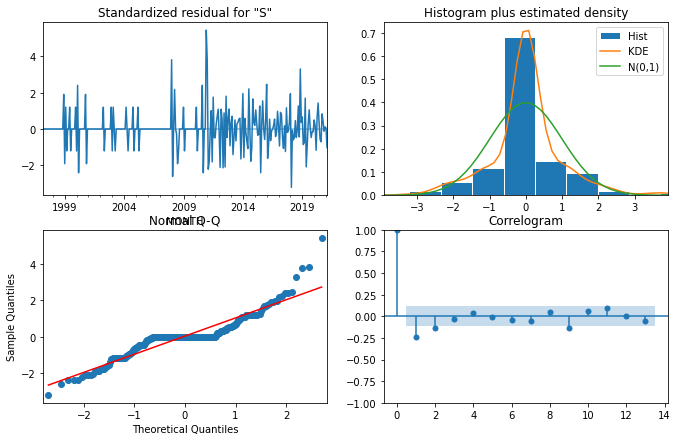

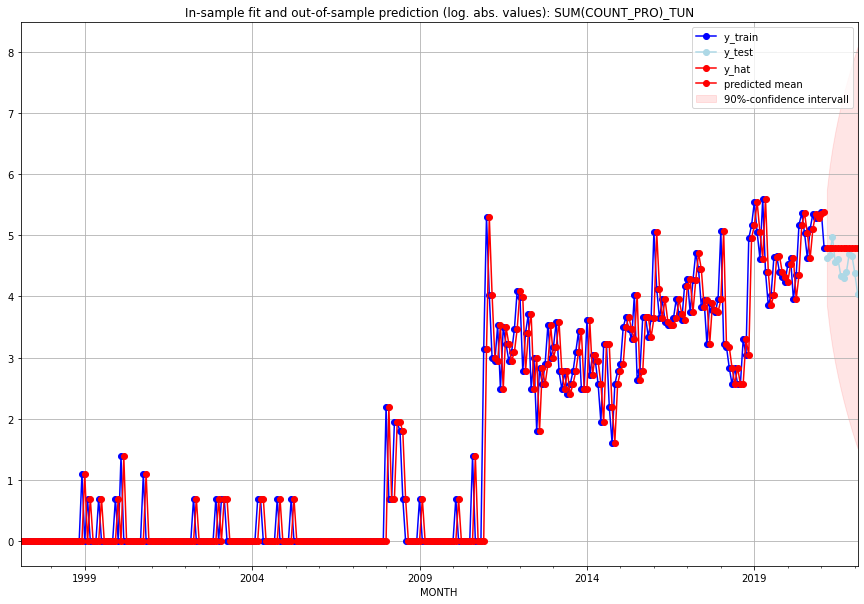

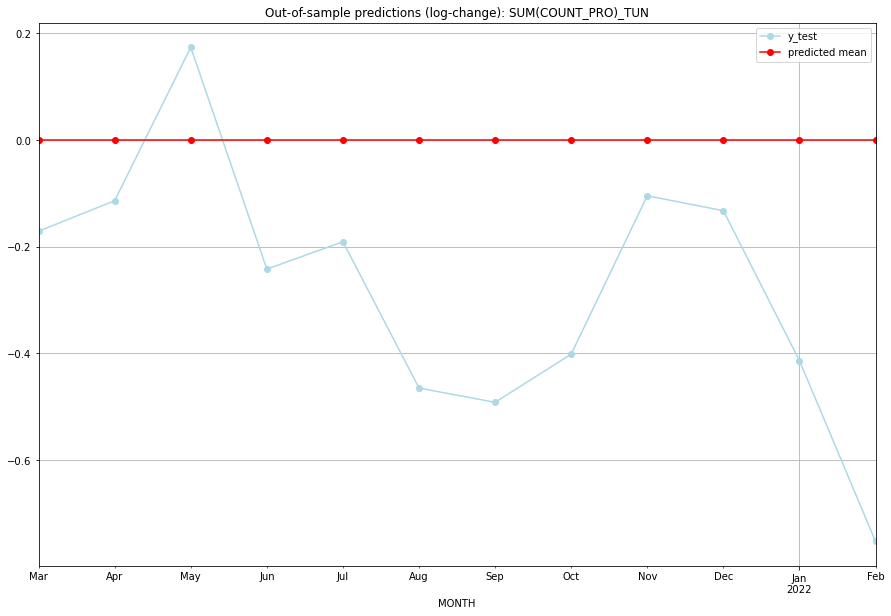

TADDA: 0.3043712642111423
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01     120.0       101.0           0.0       -0.170818   TUN   
1  2021-04-01     120.0       107.0           0.0       -0.113659   TUN   
2  2021-05-01     120.0       143.0           0.0        0.174023   TUN   
3  2021-06-01     120.0        94.0           0.0       -0.241914   TUN   
4  2021-07-01     120.0        99.0           0.0       -0.190620   TUN   
5  2021-08-01     120.0        75.0           0.0       -0.465057   TUN   
6  2021-09-01     120.0        73.0           0.0       -0.491725   TUN   
7  2021-10-01     120.0        80.0           0.0       -0.401341   TUN   
8  2021-11-01     120.0       108.0           0.0       -0.104443   TUN   
9  2021-12-01     120.0       105.0           0.0       -0.132351   TUN   
10 2022-01-01     120.0        79.0           0.0       -0.413764   TUN   
11 2022-02-01     120.0        56.0           0.0    

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [2, (2, 1, 2), (0, 0, 0, 0), 'n'], 'cv_score': 0.18557405436367472, 'fold_results': [0.18557405436367472]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_TUR   No. Observations:                   62
Model:               SARIMAX(2, 1, 2)   Log Likelihood                 -77.280
Date:                Fri, 16 Sep 2022   AIC                            168.560
Time:                        15:06:53   BIC                            183.336
Sample:                    01-31-2016   HQIC                           174.350
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1             0.1193      0.140      0.851      0.395 

<Figure size 432x288 with 0 Axes>

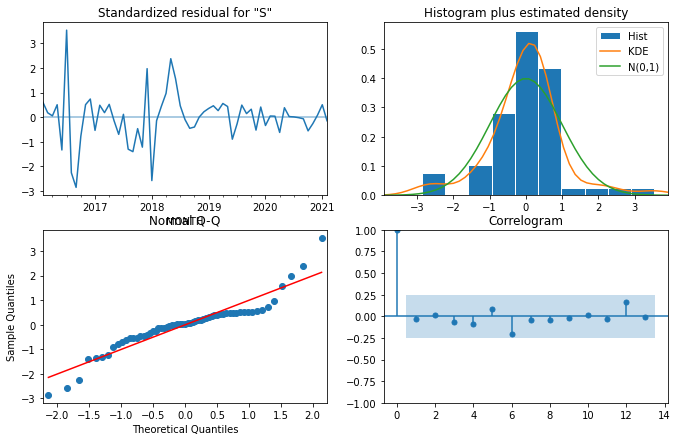

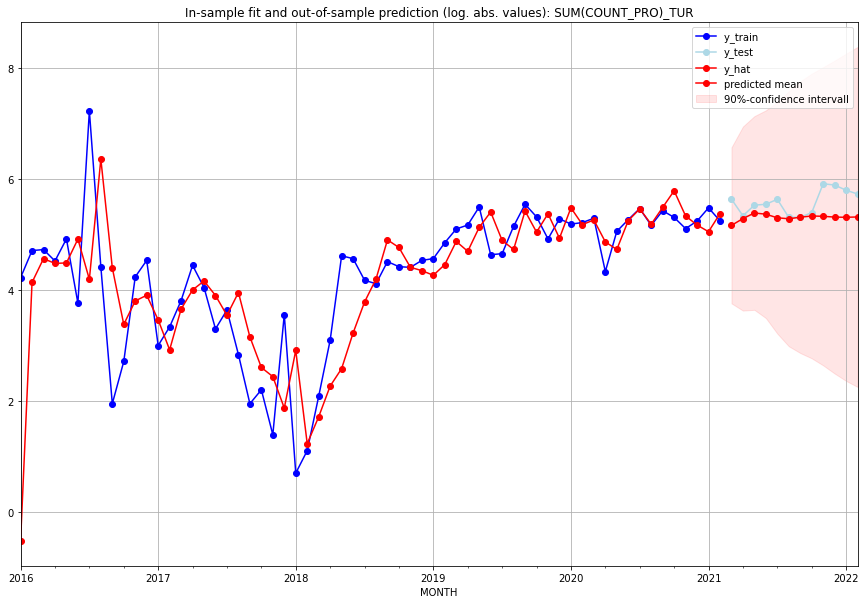

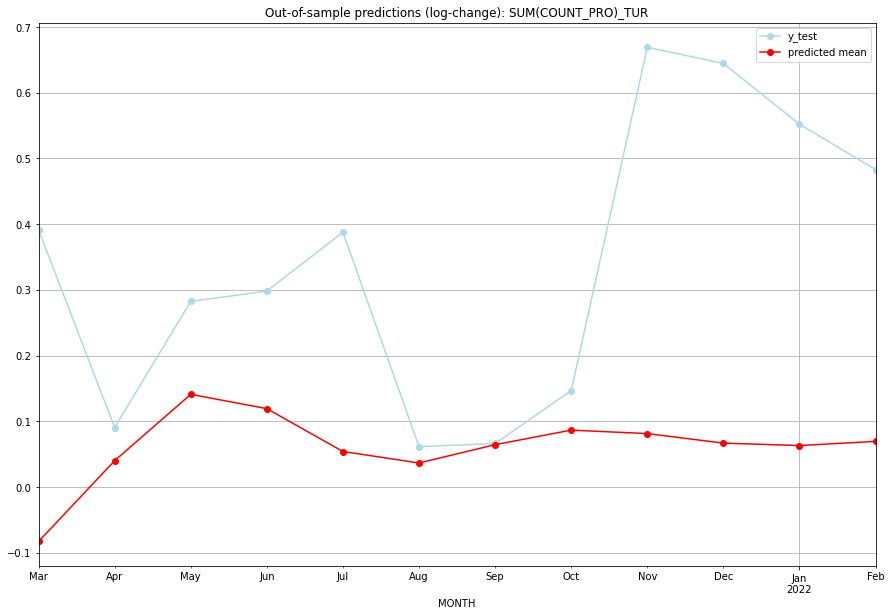

TADDA: 0.2847477438479596
Evaluation finished.
        MONTH    FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  173.869660       280.0     -0.082983        0.391331   TUR   
1  2021-04-01  196.761818       207.0      0.040039        0.090514   TUR   
2  2021-05-01  217.780035       251.0      0.141043        0.282405   TUR   
3  2021-06-01  213.052682       255.0      0.119198        0.298153   TUR   
4  2021-07-01  199.538048       279.0      0.053980        0.387766   TUR   
5  2021-08-01  196.066971       201.0      0.036520        0.061244   TUR   
6  2021-09-01  201.635634       202.0      0.064385        0.066182   TUR   
7  2021-10-01  206.173254       219.0      0.086531        0.146603   TUR   
8  2021-11-01  205.082562       370.0      0.081253        0.669178   TUR   
9  2021-12-01  202.111793       361.0      0.066732        0.644620   TUR   
10 2022-01-01  201.369770       329.0      0.063072        0.552069   TUR   
11 2022-02-01  202.650104    

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (1, 1, 1), (0, 0, 0, 0), 'n'], 'cv_score': 0.33411683622907, 'fold_results': [0.33411683622907]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_TWN   No. Observations:                   38
Model:               SARIMAX(1, 1, 1)   Log Likelihood                  -8.117
Date:                Fri, 16 Sep 2022   AIC                             22.233
Time:                        15:07:13   BIC                             27.066
Sample:                    01-31-2018   HQIC                            23.937
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.7163      0.324     -2.213      0.027      -

<Figure size 432x288 with 0 Axes>

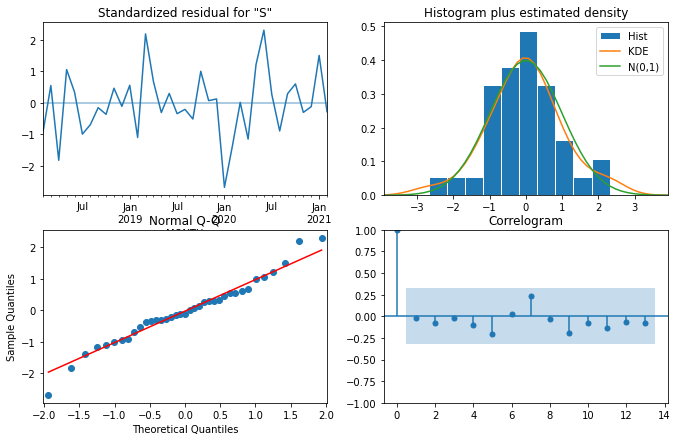

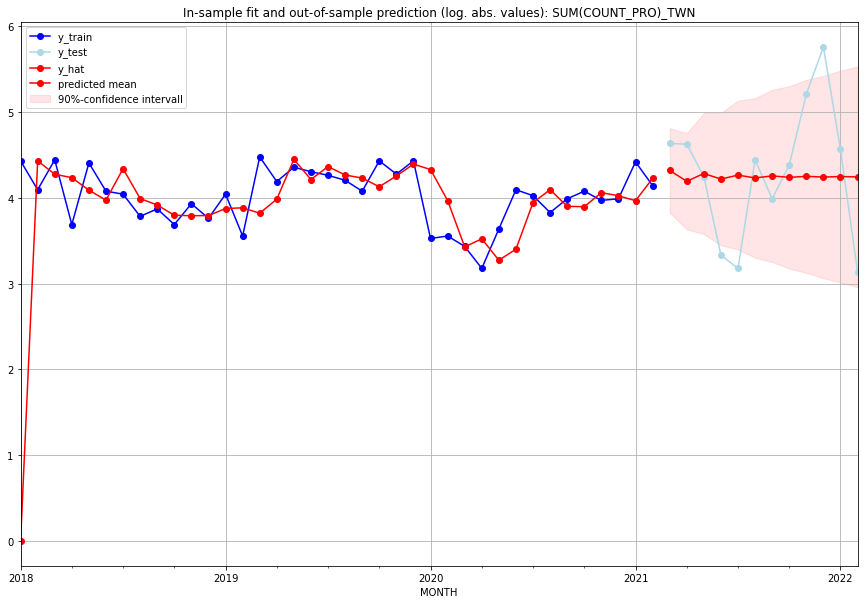

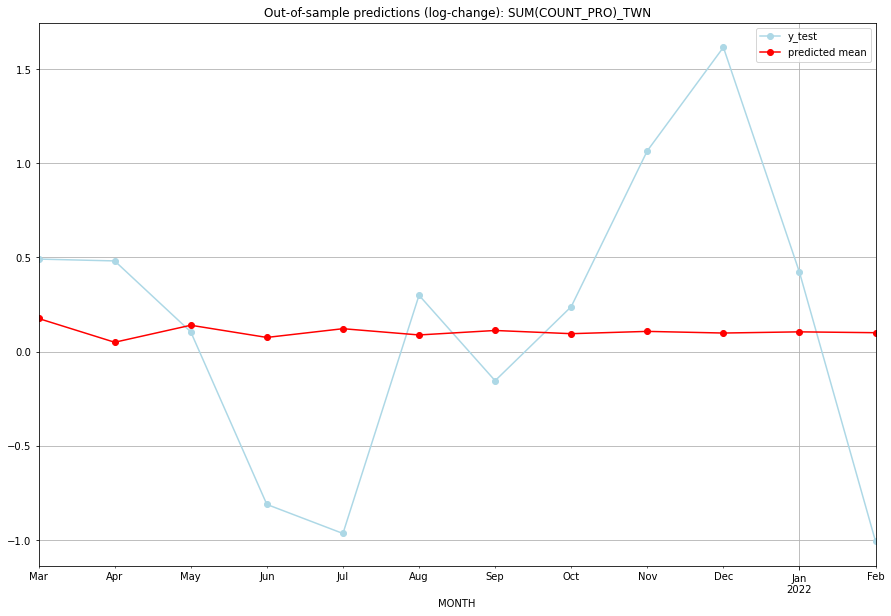

TADDA: 0.6406203419625641
Evaluation finished.
        MONTH   FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  74.134357       102.0      0.176143        0.491594   TWN   
1  2021-04-01  65.227941       101.0      0.049968        0.481838   TWN   
2  2021-05-01  71.492629        69.0      0.140350        0.105361   TWN   
3  2021-06-01  66.947941        27.0      0.075607       -0.810930   TWN   
4  2021-07-01  70.173375        23.0      0.121984       -0.965081   TWN   
5  2021-08-01  67.847774        84.0      0.088763        0.299517   TWN   
6  2021-09-01  69.505788        53.0      0.112560       -0.154151   TWN   
7  2021-10-01  68.314112        79.0      0.095514        0.238892   TWN   
8  2021-11-01  69.165671       182.0      0.107724        1.066351   TWN   
9  2021-12-01  68.554624       316.0      0.098978        1.615767   TWN   
10 2022-01-01  68.991788        95.0      0.105243        0.421213   TWN   
11 2022-02-01  68.678359        22.0     

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [1, (3, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.6015004548922595, 'fold_results': [0.6015004548922595]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_TZA   No. Observations:                  289
Model:               SARIMAX(3, 0, 0)   Log Likelihood                -257.585
Date:                Fri, 16 Sep 2022   AIC                            525.170
Time:                        15:08:04   BIC                            543.502
Sample:                    02-28-1997   HQIC                           532.516
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1             0.0729      0.025      2.892      0.004   

<Figure size 432x288 with 0 Axes>

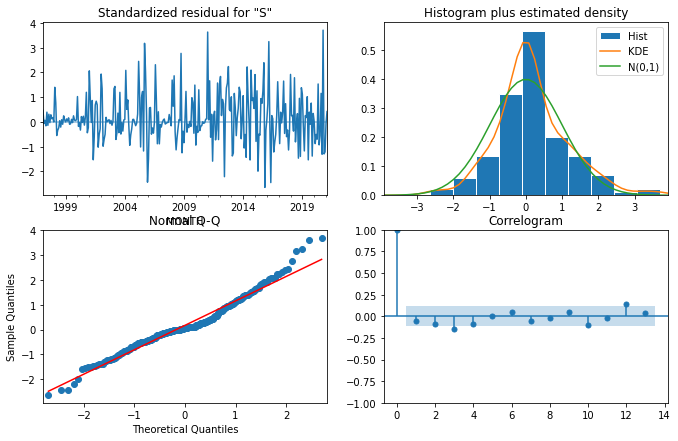

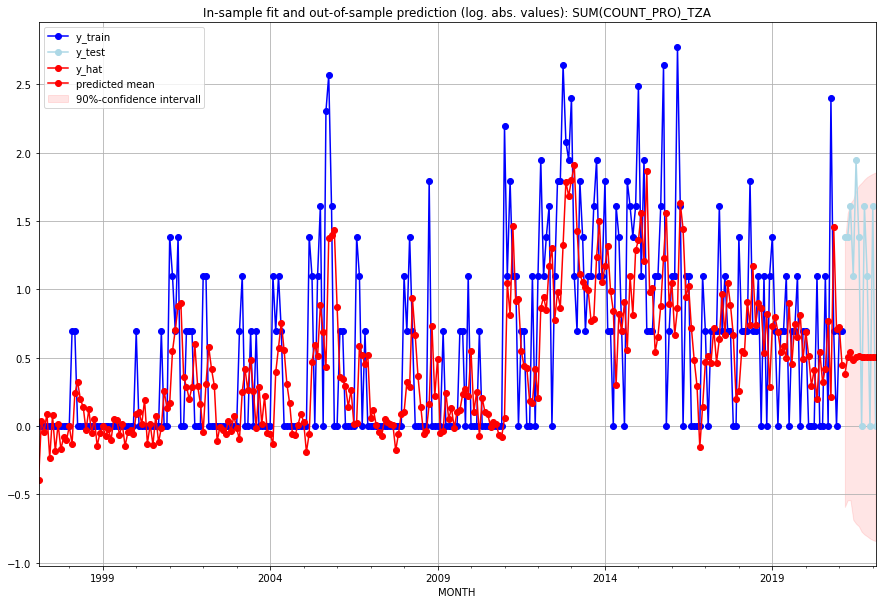

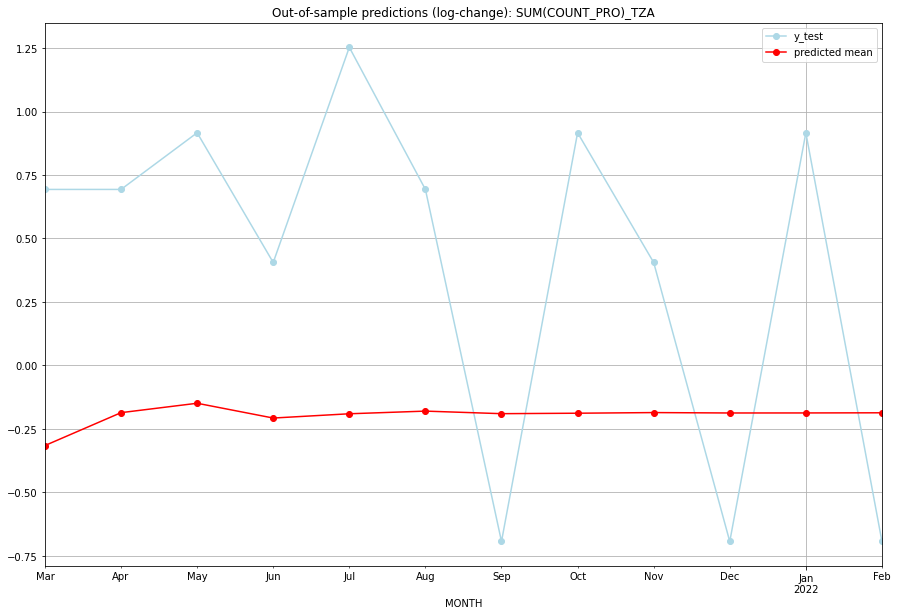

TADDA: 0.9986096031628269
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  0.459064         3.0     -0.315352        0.693147   TZA   
1  2021-04-01  0.660839         3.0     -0.185824        0.693147   TZA   
2  2021-05-01  0.723419         4.0     -0.148837        0.916291   TZA   
3  2021-06-01  0.625938         2.0     -0.207062        0.405465   TZA   
4  2021-07-01  0.653523         6.0     -0.190239        1.252763   TZA   
5  2021-08-01  0.670932         3.0     -0.179765        0.693147   TZA   
6  2021-09-01  0.654166         0.0     -0.189850       -0.693147   TZA   
7  2021-10-01  0.657171         4.0     -0.188035        0.916291   TZA   
8  2021-11-01  0.661330         2.0     -0.185529        0.405465   TZA   
9  2021-12-01  0.658689         0.0     -0.187119       -0.693147   TZA   
10 2022-01-01  0.658941         4.0     -0.186968        0.916291   TZA   
11 2022-02-01  0.659904         0.0     -0.186387    

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [1, (0, 1, 1), (0, 0, 0, 0), 'n'], 'cv_score': 0.46702564553881887, 'fold_results': [0.46702564553881887]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_UGA   No. Observations:                  289
Model:               SARIMAX(0, 1, 1)   Log Likelihood                -287.308
Date:                Fri, 16 Sep 2022   AIC                            580.616
Time:                        15:09:10   BIC                            591.605
Sample:                    02-28-1997   HQIC                           585.020
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1             0.0374      0.026      1.429      0.153 

<Figure size 432x288 with 0 Axes>

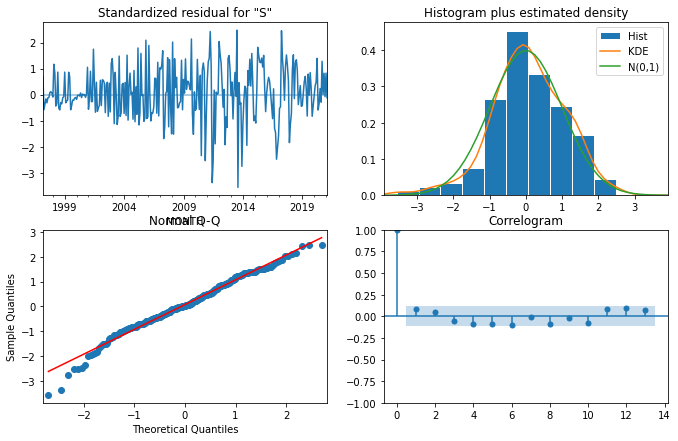

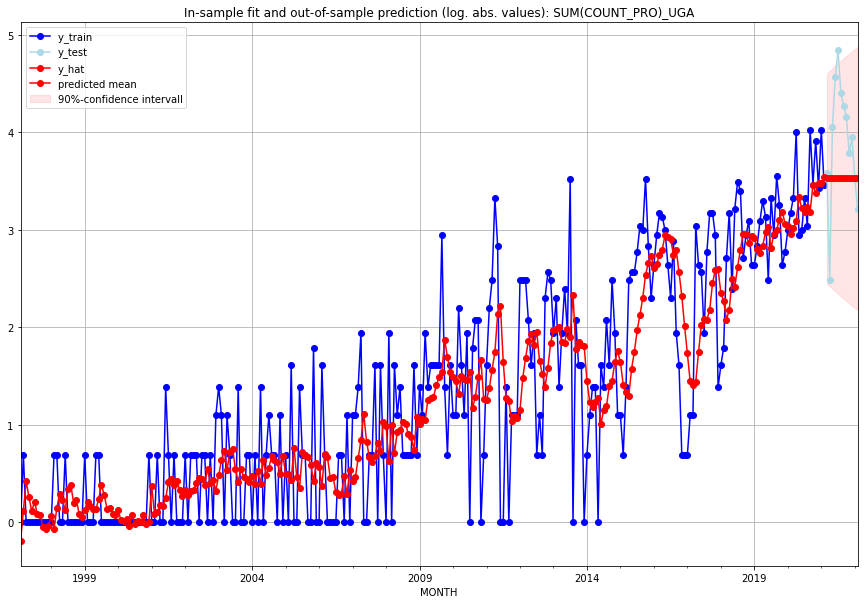

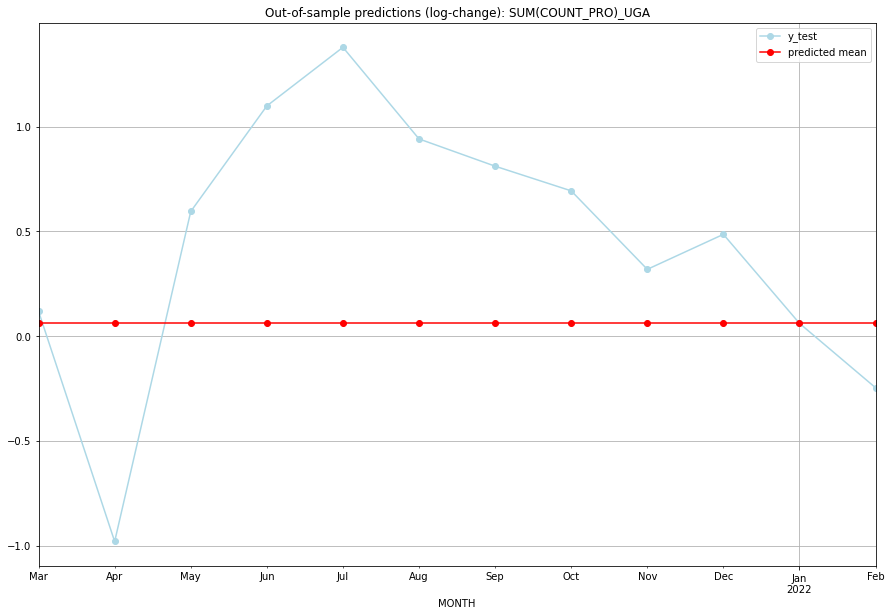

TADDA: 0.6131791110898135
Evaluation finished.
        MONTH   FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  33.042465        35.0      0.061873        0.117783   UGA   
1  2021-04-01  33.042465        11.0      0.061873       -0.980829   UGA   
2  2021-05-01  33.042465        57.0      0.061873        0.594707   UGA   
3  2021-06-01  33.042465        95.0      0.061873        1.098612   UGA   
4  2021-07-01  33.042465       126.0      0.061873        1.378451   UGA   
5  2021-08-01  33.042465        81.0      0.061873        0.940983   UGA   
6  2021-09-01  33.042465        71.0      0.061873        0.810930   UGA   
7  2021-10-01  33.042465        63.0      0.061873        0.693147   UGA   
8  2021-11-01  33.042465        43.0      0.061873        0.318454   UGA   
9  2021-12-01  33.042465        51.0      0.061873        0.485508   UGA   
10 2022-01-01  33.042465        33.0      0.061873        0.060625   UGA   
11 2022-02-01  33.042465        24.0     

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (3, 0, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.31565319394795904, 'fold_results': [0.31565319394795904]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_UKR   No. Observations:                   38
Model:               SARIMAX(3, 0, 3)   Log Likelihood                 -19.102
Date:                Fri, 16 Sep 2022   AIC                             52.203
Time:                        15:09:52   BIC                             63.666
Sample:                    01-31-2018   HQIC                            56.282
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.5687      0.334     -1.703      0.088 

<Figure size 432x288 with 0 Axes>

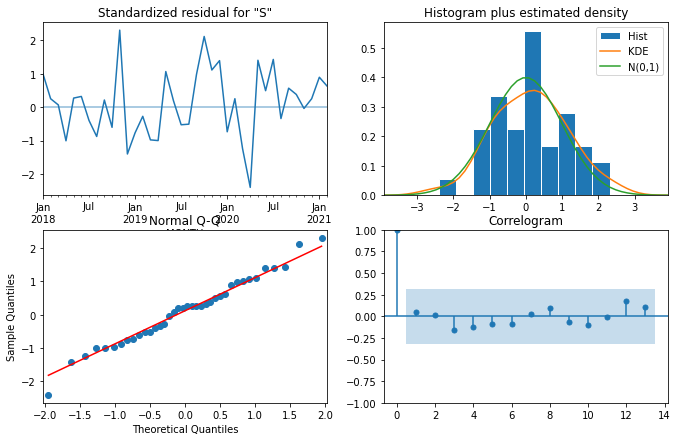

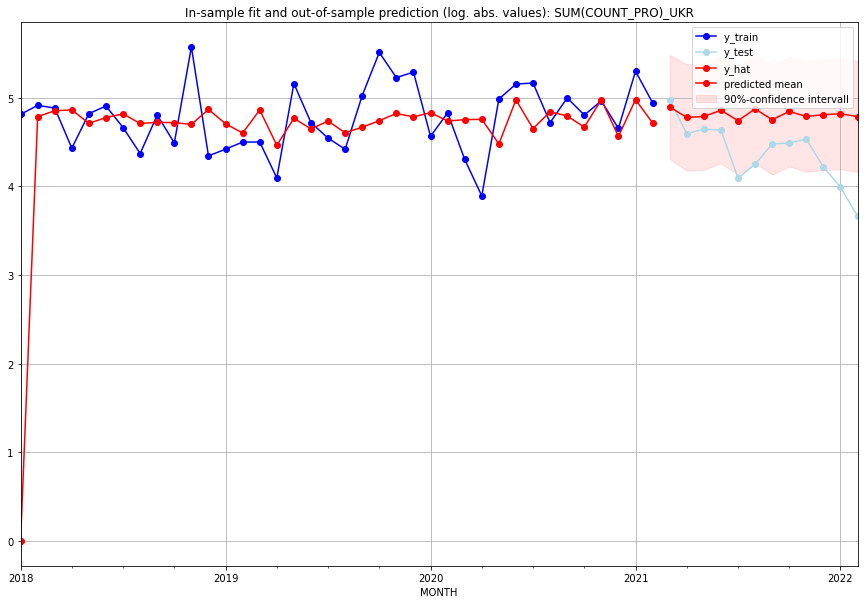

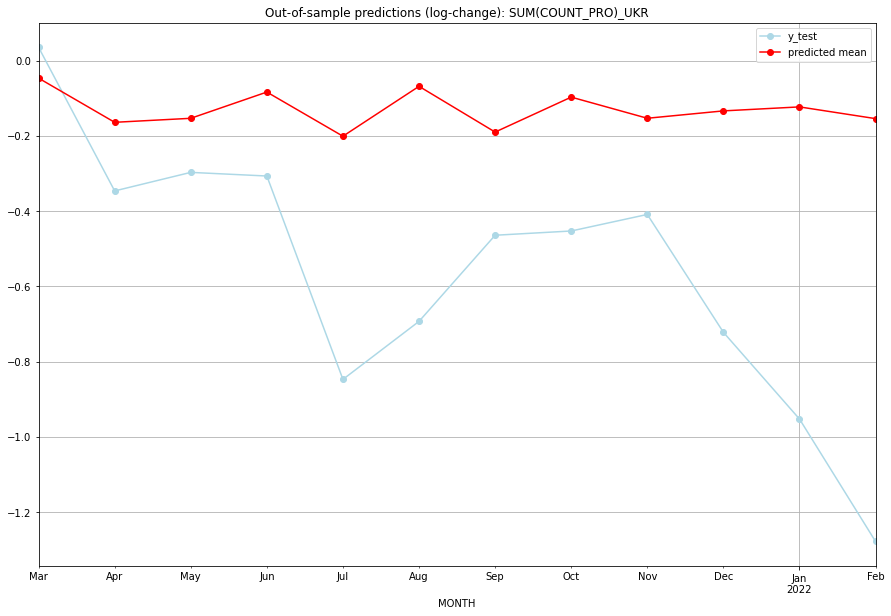

TADDA: 0.4479513352819509
Evaluation finished.
        MONTH    FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  132.594052       144.0     -0.046837        0.035091   UKR   
1  2021-04-01  117.800764        98.0     -0.164195       -0.346523   UKR   
2  2021-05-01  119.071021       103.0     -0.153559       -0.297252   UKR   
3  2021-06-01  127.743334       102.0     -0.083822       -0.306913   UKR   
4  2021-07-01  113.490712        59.0     -0.201149       -0.847298   UKR   
5  2021-08-01  129.719278        69.0     -0.068590       -0.693147   UKR   
6  2021-09-01  114.758208        87.0     -0.190139       -0.464306   UKR   
7  2021-10-01  126.023979        88.0     -0.097267       -0.453006   UKR   
8  2021-11-01  119.084509        92.0     -0.153447       -0.409043   UKR   
9  2021-12-01  121.459176        67.0     -0.133865       -0.722135   UKR   
10 2022-01-01  122.764874        53.0     -0.123259       -0.952658   UKR   
11 2022-02-01  118.967708    

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [1, (1, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.6182713762380755, 'fold_results': [0.6182713762380755]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_URY   No. Observations:                   38
Model:               SARIMAX(1, 1, 0)   Log Likelihood                 -36.530
Date:                Fri, 16 Sep 2022   AIC                             79.059
Time:                        15:10:20   BIC                             83.892
Sample:                    01-31-2018   HQIC                            80.763
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            -0.0489      0.061     -0.798      0.425   

<Figure size 432x288 with 0 Axes>

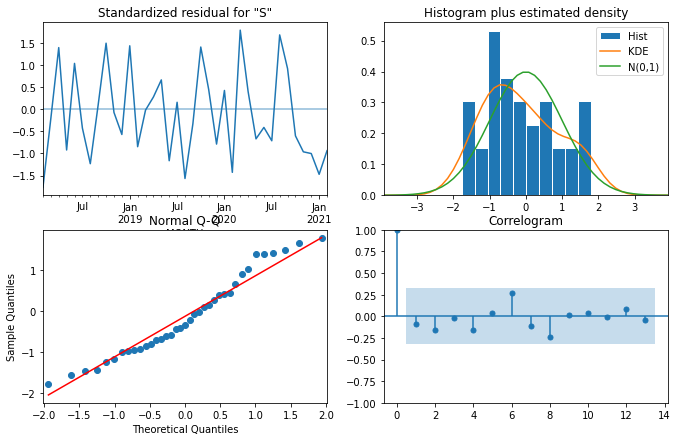

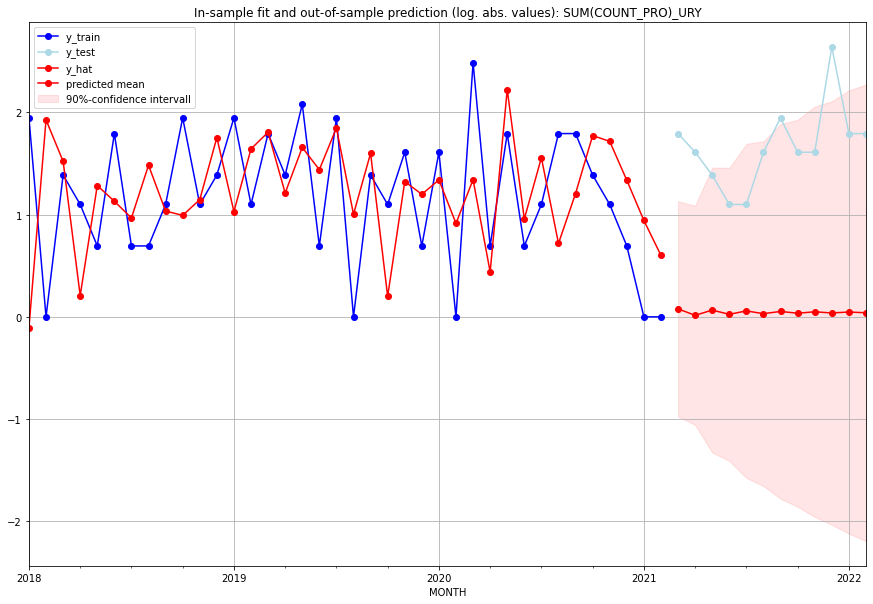

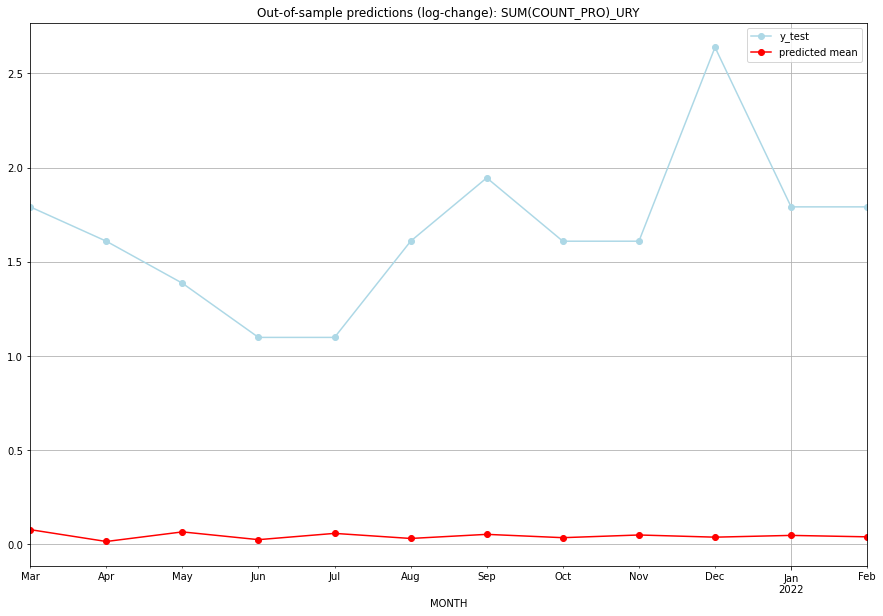

TADDA: 1.6206569029434634
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  0.080889         5.0      0.077784        1.791759   URY   
1  2021-04-01  0.014951         4.0      0.014840        1.609438   URY   
2  2021-05-01  0.067987         3.0      0.065775        1.386294   URY   
3  2021-06-01  0.024862         2.0      0.024558        1.098612   URY   
4  2021-07-01  0.059621         2.0      0.057912        1.098612   URY   
5  2021-08-01  0.031404         4.0      0.030921        1.609438   URY   
6  2021-09-01  0.054179         6.0      0.052762        1.945910   URY   
7  2021-10-01  0.035711         4.0      0.035088        1.609438   URY   
8  2021-11-01  0.050630         4.0      0.049390        1.609438   URY   
9  2021-12-01  0.038541        13.0      0.037817        2.639057   URY   
10 2022-01-01  0.048313         5.0      0.047182        1.791759   URY   
11 2022-02-01  0.040398         5.0      0.039604    

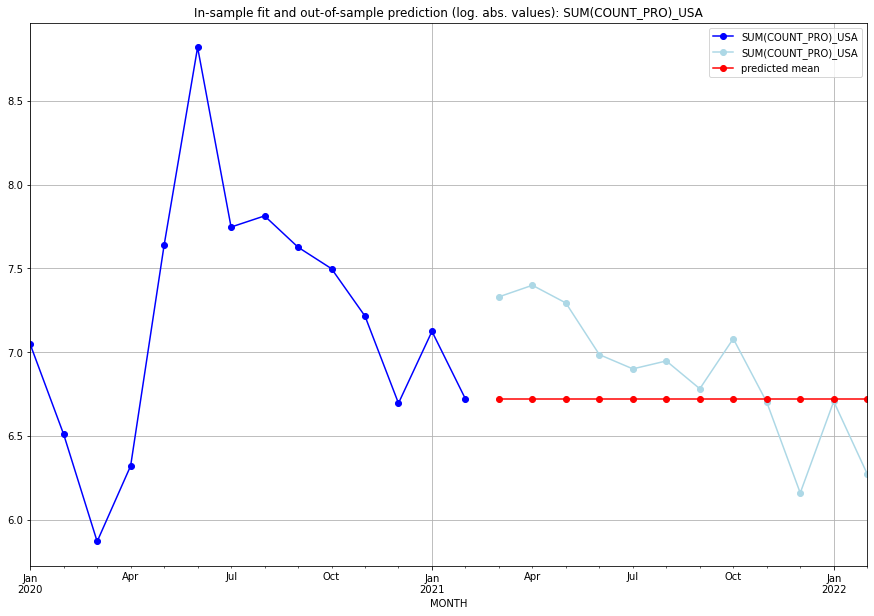

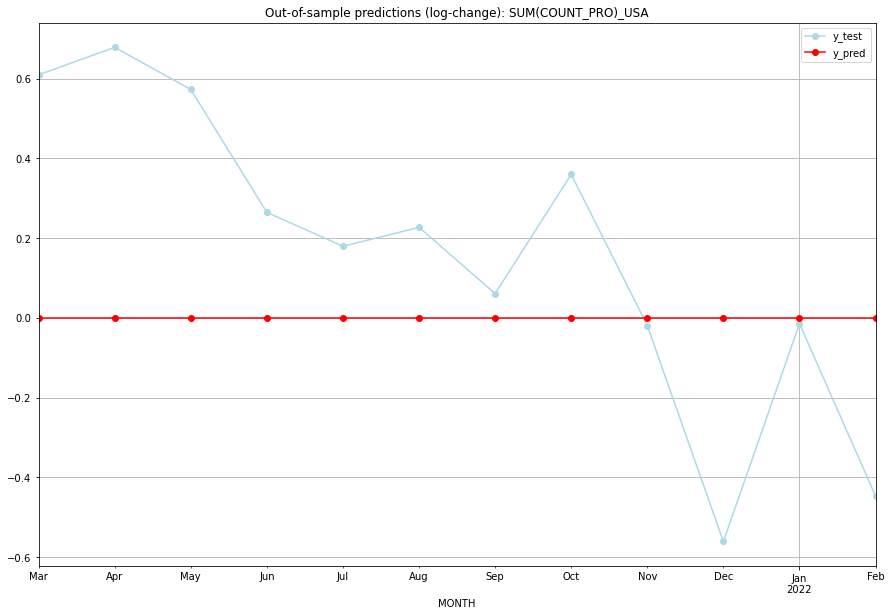

TADDA: 0.332902497470373
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01   6.72022    7.329750           0.0        0.609530   USA   
1  2021-04-01   6.72022    7.398786           0.0        0.678566   USA   
2  2021-05-01   6.72022    7.293018           0.0        0.572798   USA   
3  2021-06-01   6.72022    6.984716           0.0        0.264496   USA   
4  2021-07-01   6.72022    6.899723           0.0        0.179503   USA   
5  2021-08-01   6.72022    6.946976           0.0        0.226756   USA   
6  2021-09-01   6.72022    6.781058           0.0        0.060837   USA   
7  2021-10-01   6.72022    7.080026           0.0        0.359806   USA   
8  2021-11-01   6.72022    6.700731           0.0       -0.019489   USA   
9  2021-12-01   6.72022    6.159095           0.0       -0.561125   USA   
10 2022-01-01   6.72022    6.705639           0.0       -0.014581   USA   
11 2022-02-01   6.72022    6.272877           0.0     

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [2, (2, 1, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.4297719948114411, 'fold_results': [0.4297719948114411]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_UZB   No. Observations:                   38
Model:               SARIMAX(2, 1, 3)   Log Likelihood                 -24.532
Date:                Fri, 16 Sep 2022   AIC                             65.064
Time:                        15:10:53   BIC                             77.952
Sample:                    01-31-2018   HQIC                            69.608
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1             0.0467      0.044      1.072      0.284   

<Figure size 432x288 with 0 Axes>

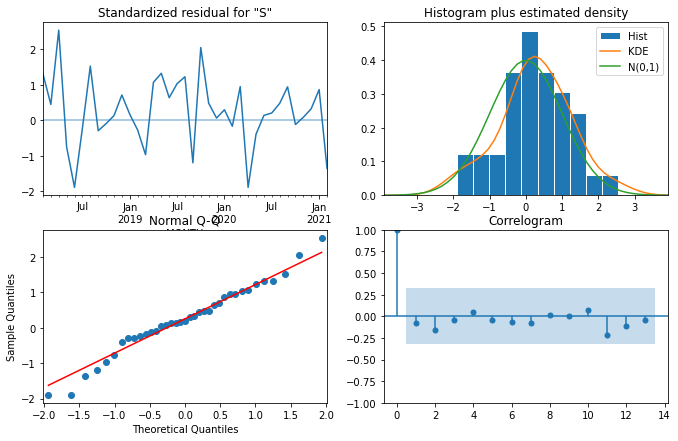

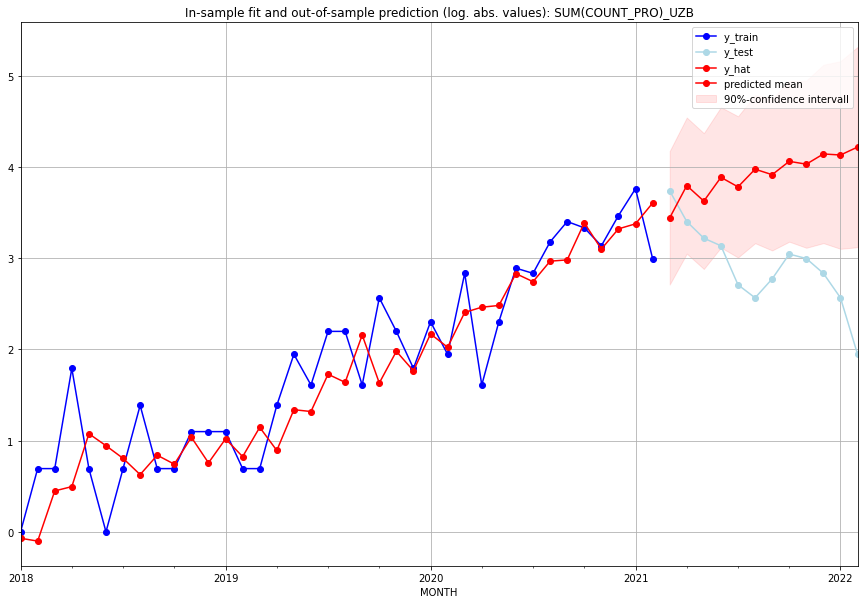

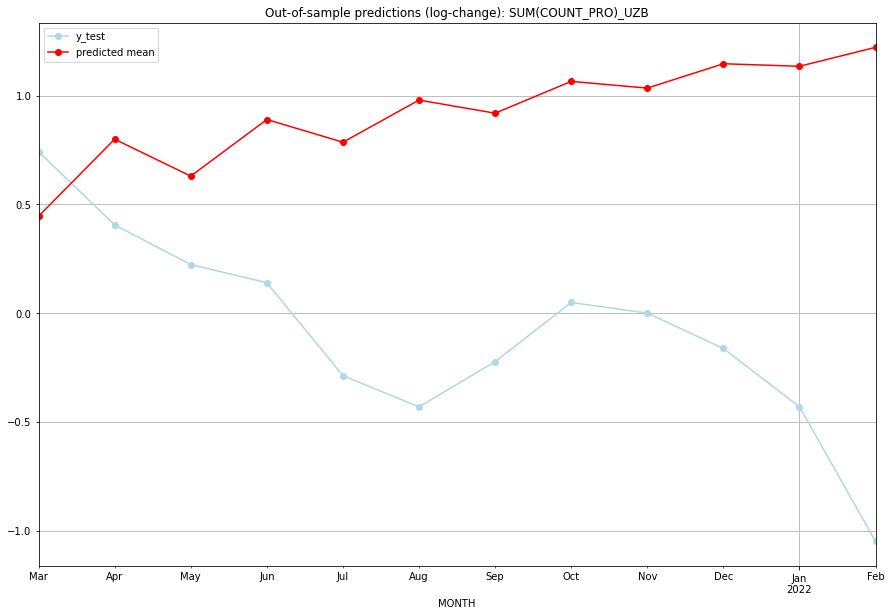

TADDA: 1.5712978002579963
Evaluation finished.
        MONTH   FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  30.224900        41.0      0.445484        0.741937   UZB   
1  2021-04-01  43.484372        29.0      0.799406        0.405465   UZB   
2  2021-05-01  36.538868        24.0      0.629645        0.223144   UZB   
3  2021-06-01  47.699114        22.0      0.889929        0.139762   UZB   
4  2021-07-01  42.871958        14.0      0.785543       -0.287682   UZB   
5  2021-08-01  52.252040        12.0      0.979304       -0.430783   UZB   
6  2021-09-01  49.134361        15.0      0.918974       -0.223144   UZB   
7  2021-10-01  57.028491        20.0      1.065202        0.048790   UZB   
8  2021-11-01  55.260027        19.0      1.034252        0.000000   UZB   
9  2021-12-01  61.929010        16.0      1.146275       -0.162519   UZB   
10 2022-01-01  61.200506        12.0      1.134631       -0.430783   UZB   
11 2022-02-01  66.867880         6.0     

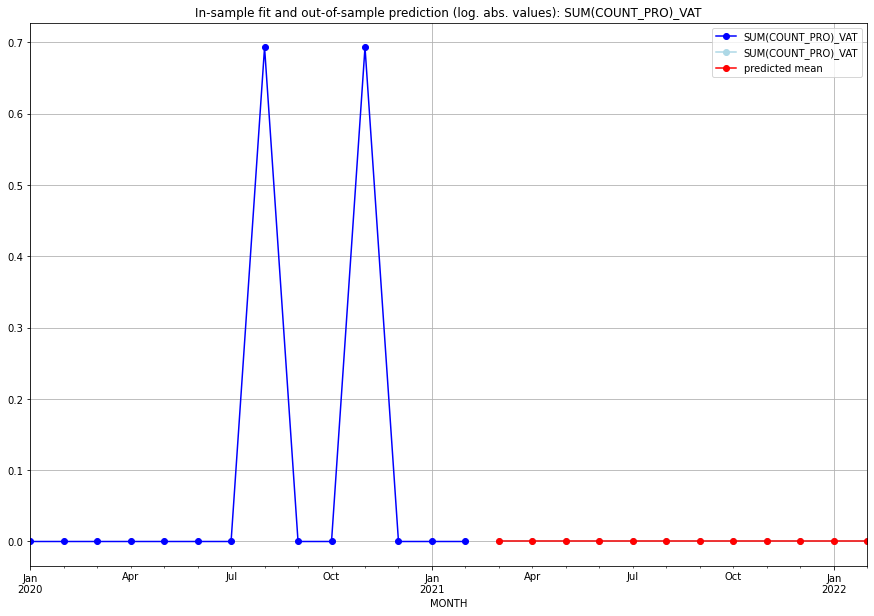

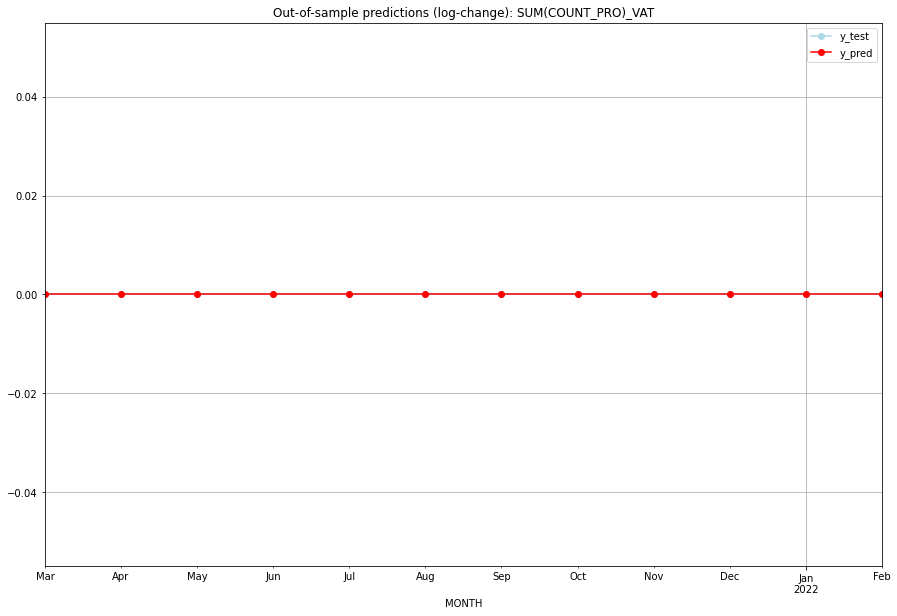

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   VAT   
1  2021-04-01       0.0         0.0           0.0             0.0   VAT   
2  2021-05-01       0.0         0.0           0.0             0.0   VAT   
3  2021-06-01       0.0         0.0           0.0             0.0   VAT   
4  2021-07-01       0.0         0.0           0.0             0.0   VAT   
5  2021-08-01       0.0         0.0           0.0             0.0   VAT   
6  2021-09-01       0.0         0.0           0.0             0.0   VAT   
7  2021-10-01       0.0         0.0           0.0             0.0   VAT   
8  2021-11-01       0.0         0.0           0.0             0.0   VAT   
9  2021-12-01       0.0         0.0           0.0             0.0   VAT   
10 2022-01-01       0.0         0.0           0.0             0.0   VAT   
11 2022-02-01       0.0         0.0           0.0             0.0   

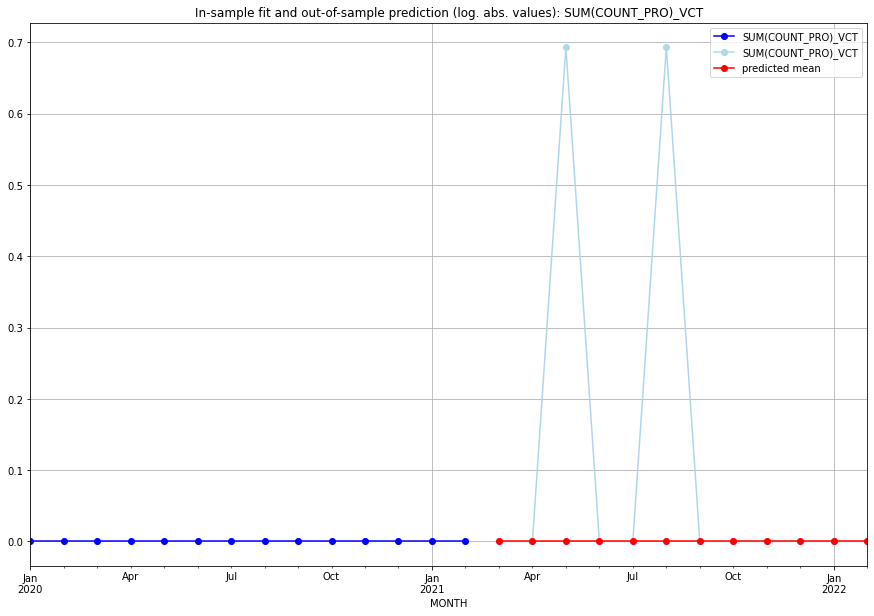

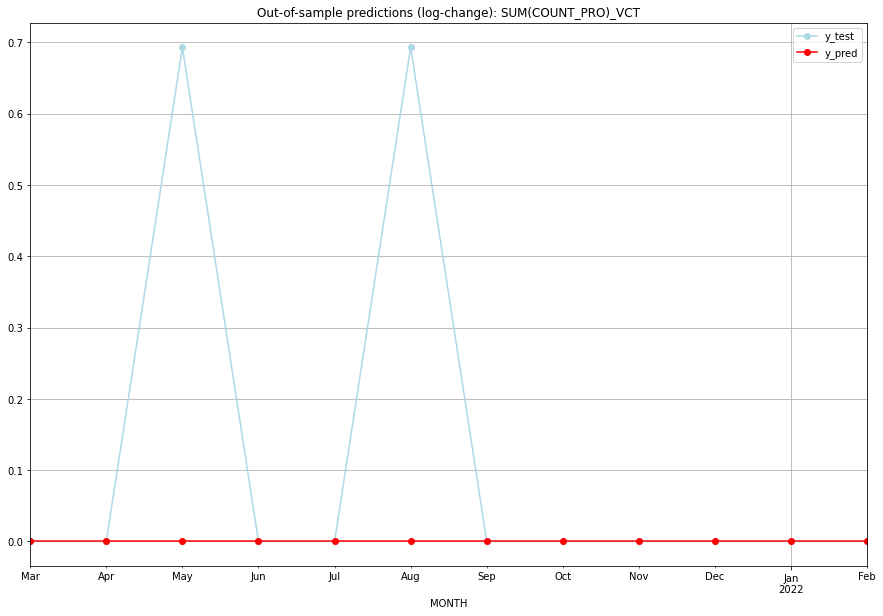

TADDA: 0.11552453009332421
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0    0.000000           0.0        0.000000   VCT   
1  2021-04-01       0.0    0.000000           0.0        0.000000   VCT   
2  2021-05-01       0.0    0.693147           0.0        0.693147   VCT   
3  2021-06-01       0.0    0.000000           0.0        0.000000   VCT   
4  2021-07-01       0.0    0.000000           0.0        0.000000   VCT   
5  2021-08-01       0.0    0.693147           0.0        0.693147   VCT   
6  2021-09-01       0.0    0.000000           0.0        0.000000   VCT   
7  2021-10-01       0.0    0.000000           0.0        0.000000   VCT   
8  2021-11-01       0.0    0.000000           0.0        0.000000   VCT   
9  2021-12-01       0.0    0.000000           0.0        0.000000   VCT   
10 2022-01-01       0.0    0.000000           0.0        0.000000   VCT   
11 2022-02-01       0.0    0.000000           0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [1, (3, 1, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.2652816353465834, 'fold_results': [0.2652816353465834]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_VEN   No. Observations:                   38
Model:               SARIMAX(3, 1, 3)   Log Likelihood                  -7.504
Date:                Fri, 16 Sep 2022   AIC                             31.008
Time:                        15:11:42   BIC                             43.895
Sample:                    01-31-2018   HQIC                            35.551
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1             0.0024      0.054      0.045      0.964   

<Figure size 432x288 with 0 Axes>

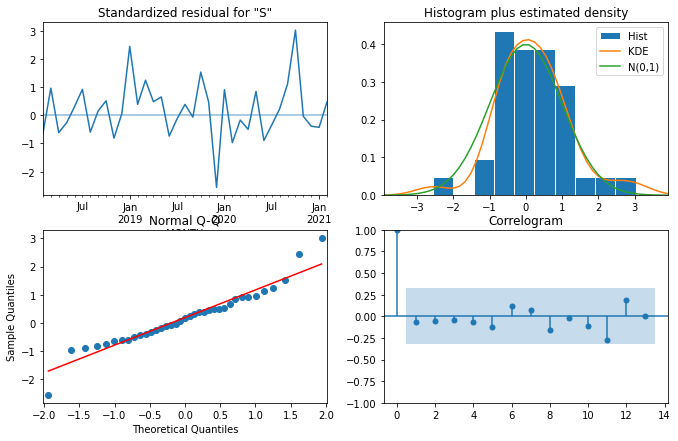

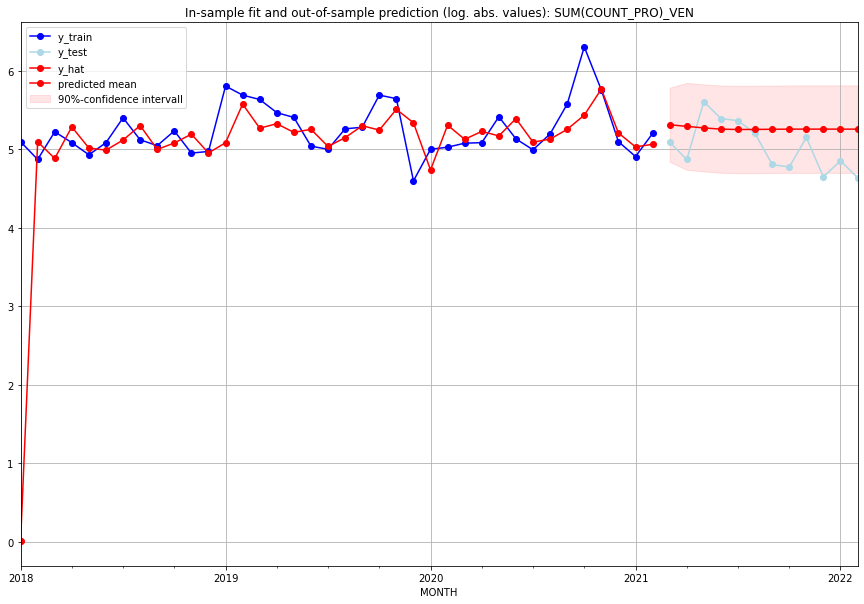

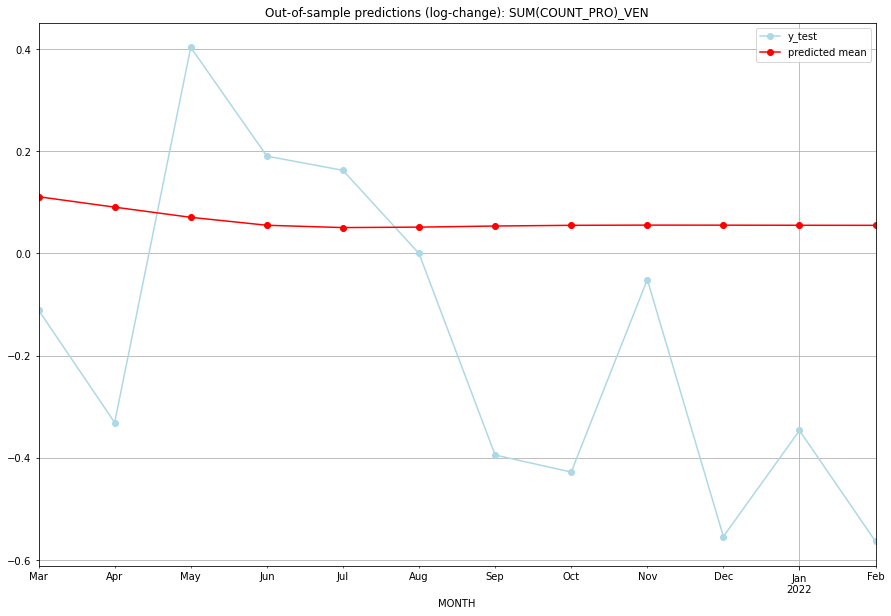

TADDA: 0.3729744798791133
Evaluation finished.
        MONTH    FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  201.272368       161.0      0.111118       -0.110901   VEN   
1  2021-04-01  197.186933       129.0      0.090714       -0.330963   VEN   
2  2021-05-01  193.281671       270.0      0.070812        0.403622   VEN   
3  2021-06-01  190.288644       218.0      0.055286        0.190575   VEN   
4  2021-07-01  189.417068       212.0      0.050720        0.162795   VEN   
5  2021-08-01  189.590190       180.0      0.051628        0.000000   VEN   
6  2021-09-01  190.001486       121.0      0.053784       -0.394476   VEN   
7  2021-10-01  190.264294       117.0      0.055159       -0.427812   VEN   
8  2021-11-01  190.342429       171.0      0.055568       -0.051003   VEN   
9  2021-12-01  190.322546       103.0      0.055464       -0.554106   VEN   
10 2022-01-01  190.283415       127.0      0.055259       -0.346467   VEN   
11 2022-02-01  190.259240    

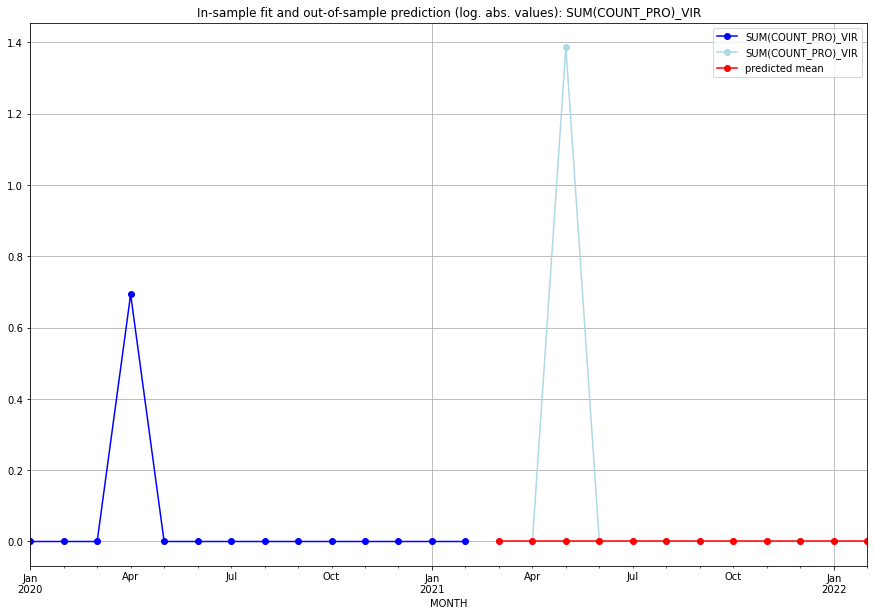

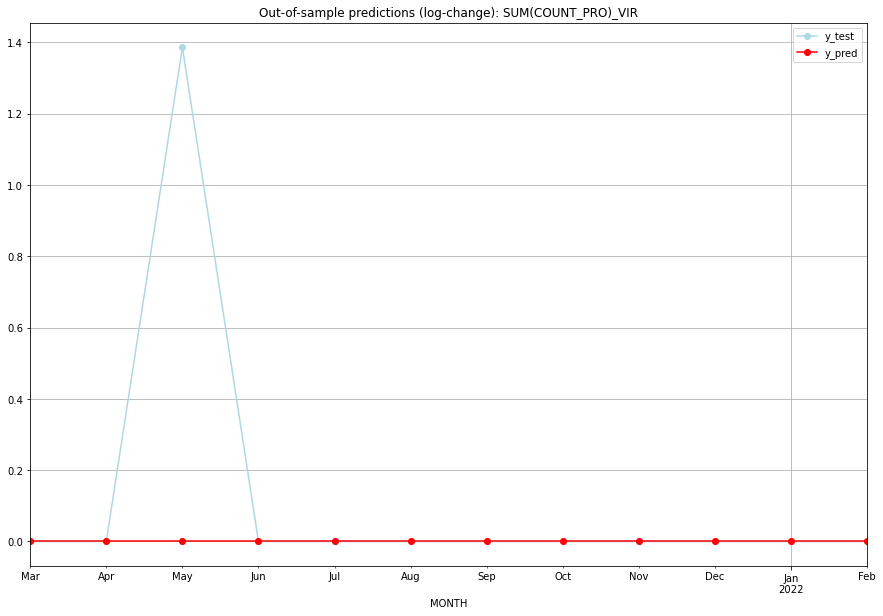

TADDA: 0.11552453009332421
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0    0.000000           0.0        0.000000   VIR   
1  2021-04-01       0.0    0.000000           0.0        0.000000   VIR   
2  2021-05-01       0.0    1.386294           0.0        1.386294   VIR   
3  2021-06-01       0.0    0.000000           0.0        0.000000   VIR   
4  2021-07-01       0.0    0.000000           0.0        0.000000   VIR   
5  2021-08-01       0.0    0.000000           0.0        0.000000   VIR   
6  2021-09-01       0.0    0.000000           0.0        0.000000   VIR   
7  2021-10-01       0.0    0.000000           0.0        0.000000   VIR   
8  2021-11-01       0.0    0.000000           0.0        0.000000   VIR   
9  2021-12-01       0.0    0.000000           0.0        0.000000   VIR   
10 2022-01-01       0.0    0.000000           0.0        0.000000   VIR   
11 2022-02-01       0.0    0.000000           0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.3803623492889863, 'fold_results': [0.3803623492889863]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_VNM   No. Observations:                  134
Model:               SARIMAX(0, 1, 0)   Log Likelihood                -185.200
Date:                Fri, 16 Sep 2022   AIC                            372.401
Time:                        15:12:23   BIC                            375.291
Sample:                    01-31-2010   HQIC                           373.575
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.9485      0.103      9.206      0.000   

<Figure size 432x288 with 0 Axes>

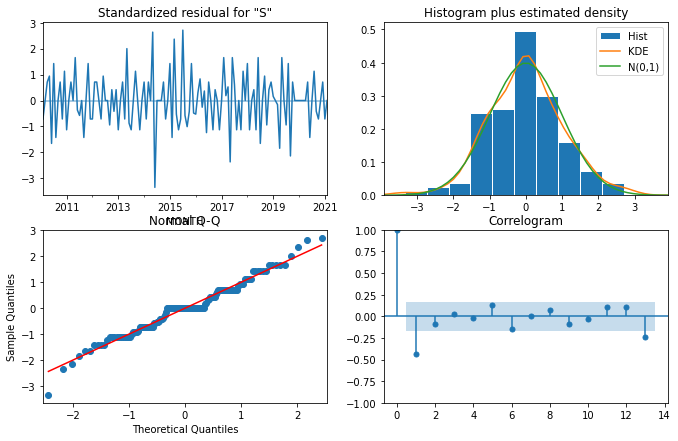

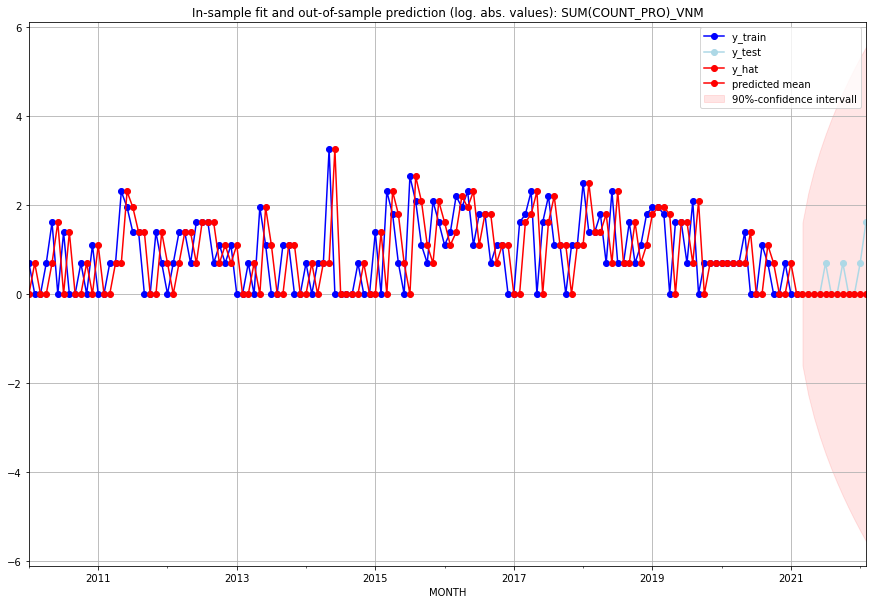

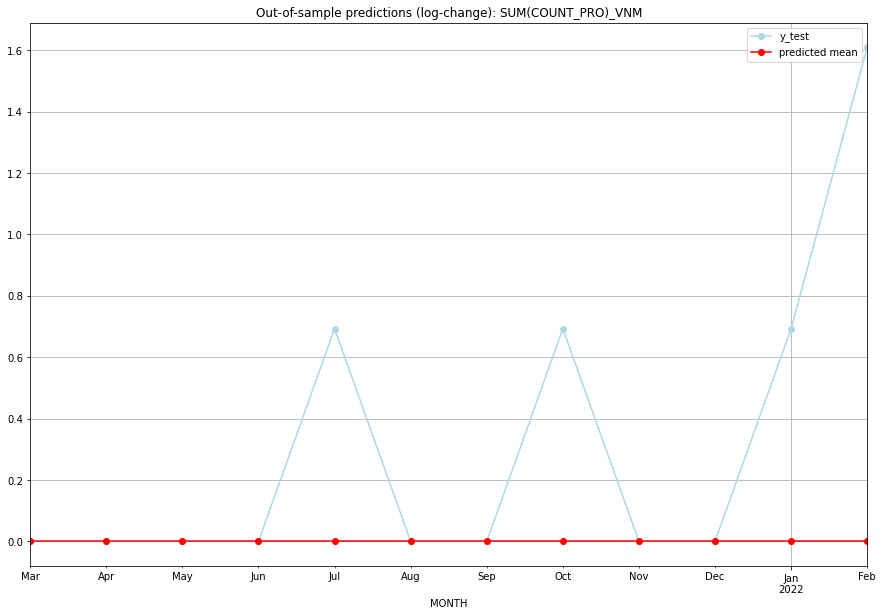

TADDA: 0.30740662117616135
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0        0.000000   VNM   
1  2021-04-01       0.0         0.0           0.0        0.000000   VNM   
2  2021-05-01       0.0         0.0           0.0        0.000000   VNM   
3  2021-06-01       0.0         0.0           0.0        0.000000   VNM   
4  2021-07-01       0.0         1.0           0.0        0.693147   VNM   
5  2021-08-01       0.0         0.0           0.0        0.000000   VNM   
6  2021-09-01       0.0         0.0           0.0        0.000000   VNM   
7  2021-10-01       0.0         1.0           0.0        0.693147   VNM   
8  2021-11-01       0.0         0.0           0.0        0.000000   VNM   
9  2021-12-01       0.0         0.0           0.0        0.000000   VNM   
10 2022-01-01       0.0         1.0           0.0        0.693147   VNM   
11 2022-02-01       0.0         4.0           0.0   

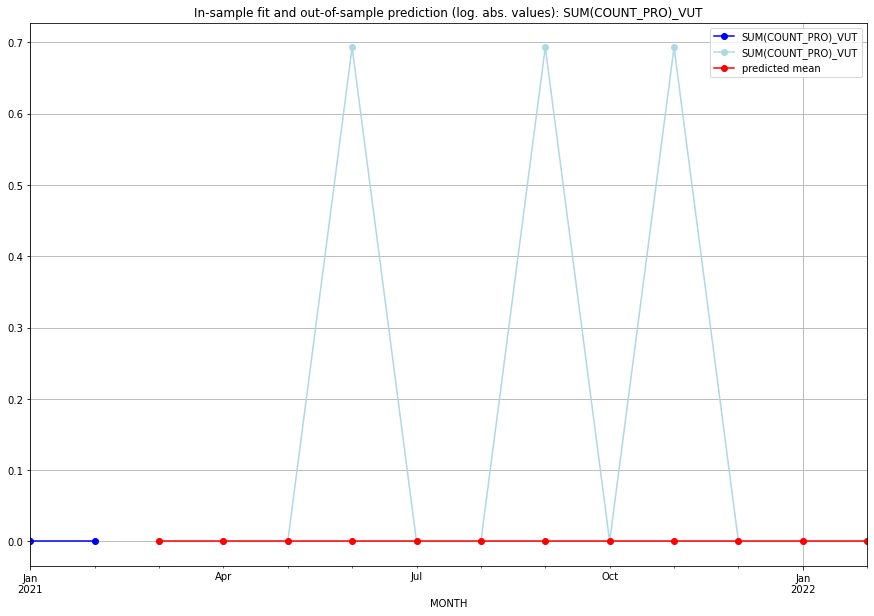

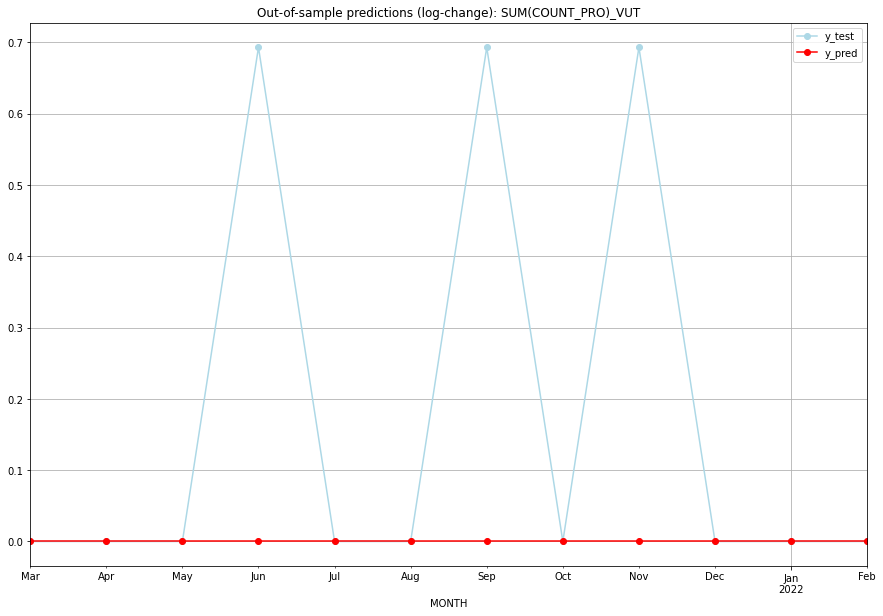

TADDA: 0.17328679513998632
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0    0.000000           0.0        0.000000   VUT   
1  2021-04-01       0.0    0.000000           0.0        0.000000   VUT   
2  2021-05-01       0.0    0.000000           0.0        0.000000   VUT   
3  2021-06-01       0.0    0.693147           0.0        0.693147   VUT   
4  2021-07-01       0.0    0.000000           0.0        0.000000   VUT   
5  2021-08-01       0.0    0.000000           0.0        0.000000   VUT   
6  2021-09-01       0.0    0.693147           0.0        0.693147   VUT   
7  2021-10-01       0.0    0.000000           0.0        0.000000   VUT   
8  2021-11-01       0.0    0.693147           0.0        0.693147   VUT   
9  2021-12-01       0.0    0.000000           0.0        0.000000   VUT   
10 2022-01-01       0.0    0.000000           0.0        0.000000   VUT   
11 2022-02-01       0.0    0.000000           0.0   

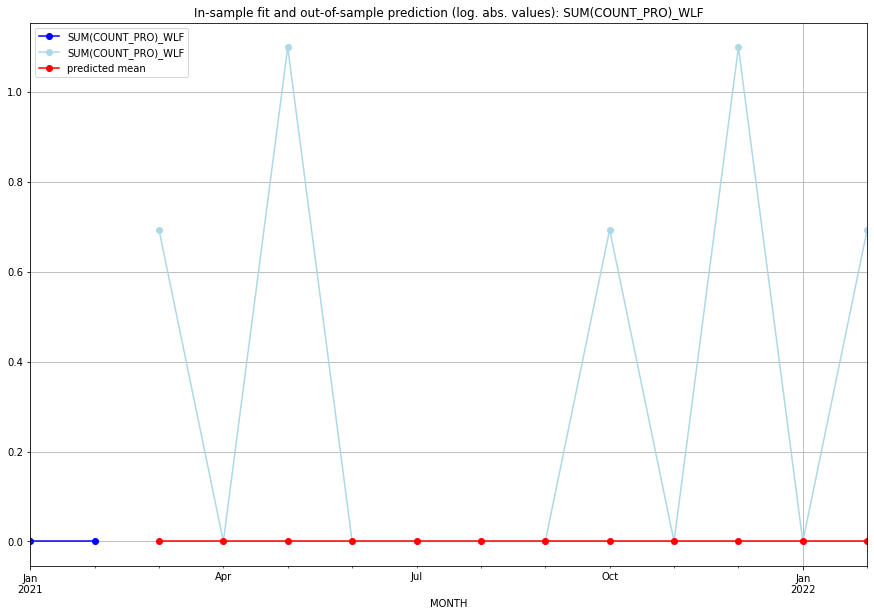

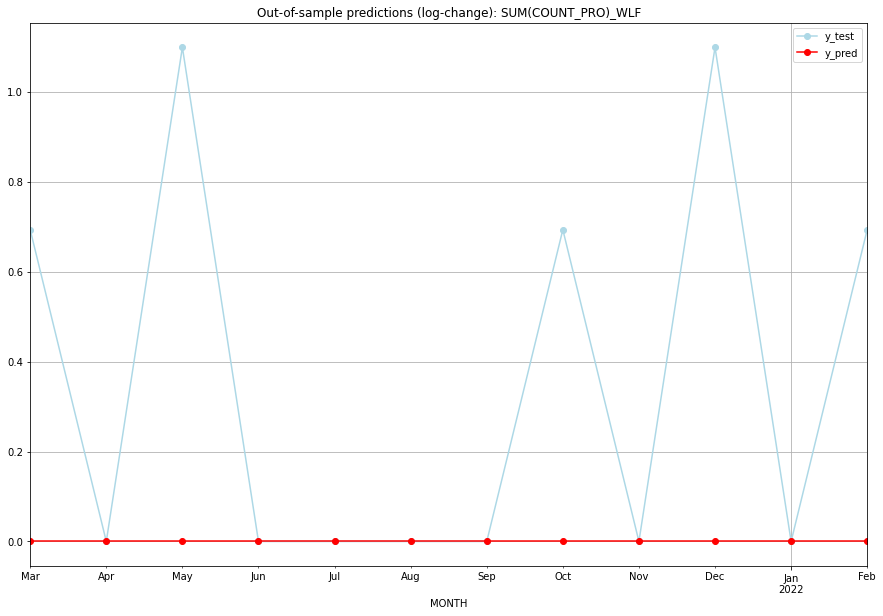

TADDA: 0.35638884325133796
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0    0.693147           0.0        0.693147   WLF   
1  2021-04-01       0.0    0.000000           0.0        0.000000   WLF   
2  2021-05-01       0.0    1.098612           0.0        1.098612   WLF   
3  2021-06-01       0.0    0.000000           0.0        0.000000   WLF   
4  2021-07-01       0.0    0.000000           0.0        0.000000   WLF   
5  2021-08-01       0.0    0.000000           0.0        0.000000   WLF   
6  2021-09-01       0.0    0.000000           0.0        0.000000   WLF   
7  2021-10-01       0.0    0.693147           0.0        0.693147   WLF   
8  2021-11-01       0.0    0.000000           0.0        0.000000   WLF   
9  2021-12-01       0.0    1.098612           0.0        1.098612   WLF   
10 2022-01-01       0.0    0.000000           0.0        0.000000   WLF   
11 2022-02-01       0.0    0.693147           0.0   

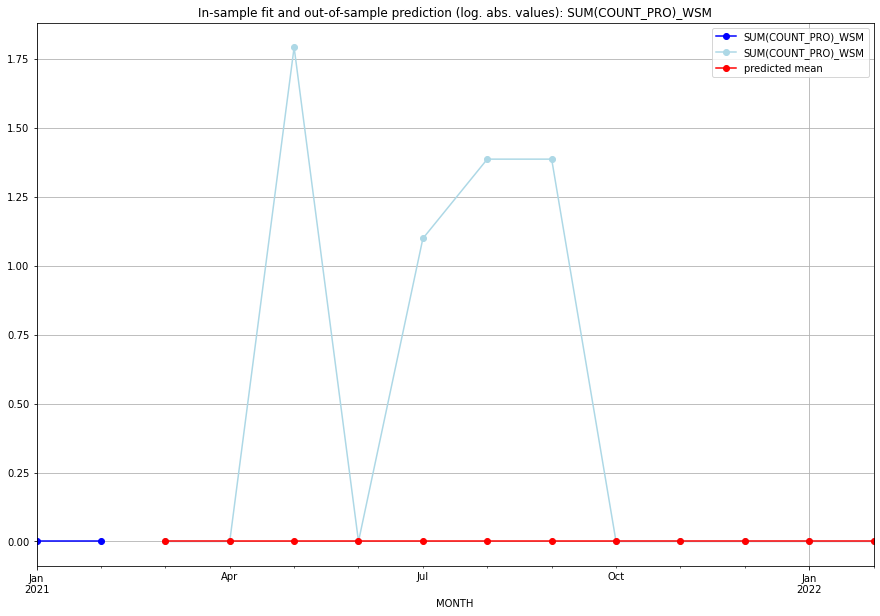

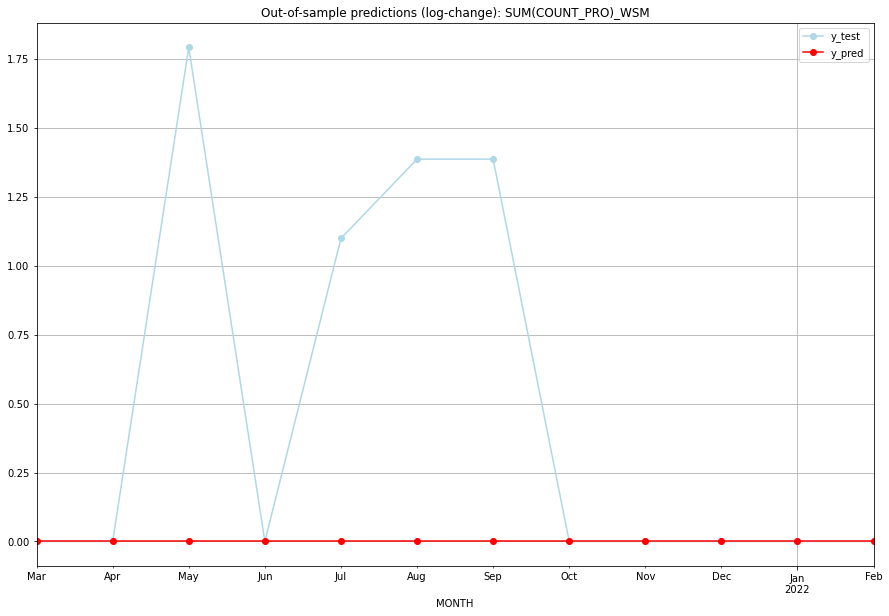

TADDA: 0.47191337334466216
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0    0.000000           0.0        0.000000   WSM   
1  2021-04-01       0.0    0.000000           0.0        0.000000   WSM   
2  2021-05-01       0.0    1.791759           0.0        1.791759   WSM   
3  2021-06-01       0.0    0.000000           0.0        0.000000   WSM   
4  2021-07-01       0.0    1.098612           0.0        1.098612   WSM   
5  2021-08-01       0.0    1.386294           0.0        1.386294   WSM   
6  2021-09-01       0.0    1.386294           0.0        1.386294   WSM   
7  2021-10-01       0.0    0.000000           0.0        0.000000   WSM   
8  2021-11-01       0.0    0.000000           0.0        0.000000   WSM   
9  2021-12-01       0.0    0.000000           0.0        0.000000   WSM   
10 2022-01-01       0.0    0.000000           0.0        0.000000   WSM   
11 2022-02-01       0.0    0.000000           0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.11552453009332421, 'fold_results': [0.11552453009332421]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_XAR   No. Observations:                  289
Model:                        SARIMAX   Log Likelihood                  96.989
Date:                Fri, 16 Sep 2022   AIC                           -191.978
Time:                        15:13:42   BIC                           -188.311
Sample:                    02-28-1997   HQIC                          -190.509
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.0299      0.001     43.141      0.000 

<Figure size 432x288 with 0 Axes>

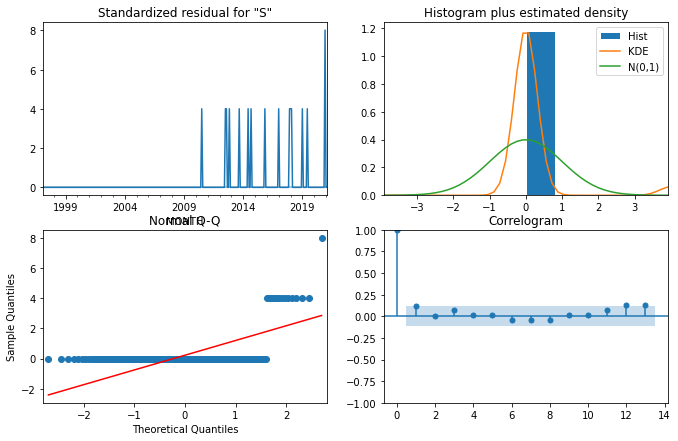

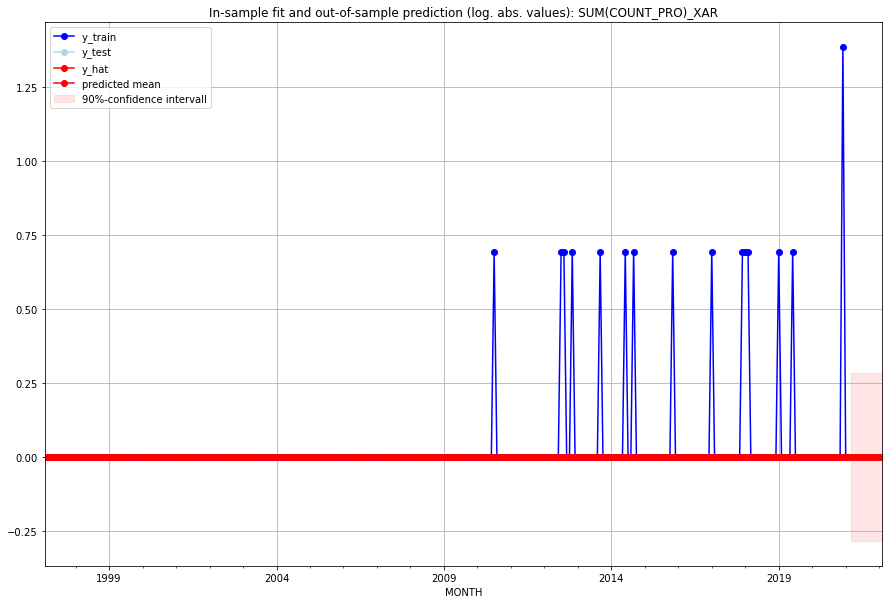

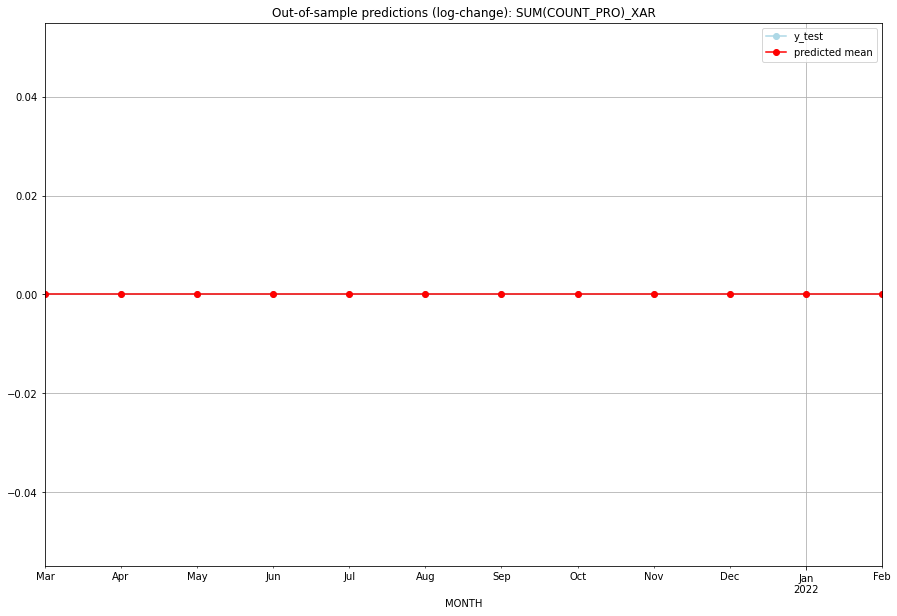

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   XAR   
1  2021-04-01       0.0         0.0           0.0             0.0   XAR   
2  2021-05-01       0.0         0.0           0.0             0.0   XAR   
3  2021-06-01       0.0         0.0           0.0             0.0   XAR   
4  2021-07-01       0.0         0.0           0.0             0.0   XAR   
5  2021-08-01       0.0         0.0           0.0             0.0   XAR   
6  2021-09-01       0.0         0.0           0.0             0.0   XAR   
7  2021-10-01       0.0         0.0           0.0             0.0   XAR   
8  2021-11-01       0.0         0.0           0.0             0.0   XAR   
9  2021-12-01       0.0         0.0           0.0             0.0   XAR   
10 2022-01-01       0.0         0.0           0.0             0.0   XAR   
11 2022-02-01       0.0         0.0           0.0             0.0   

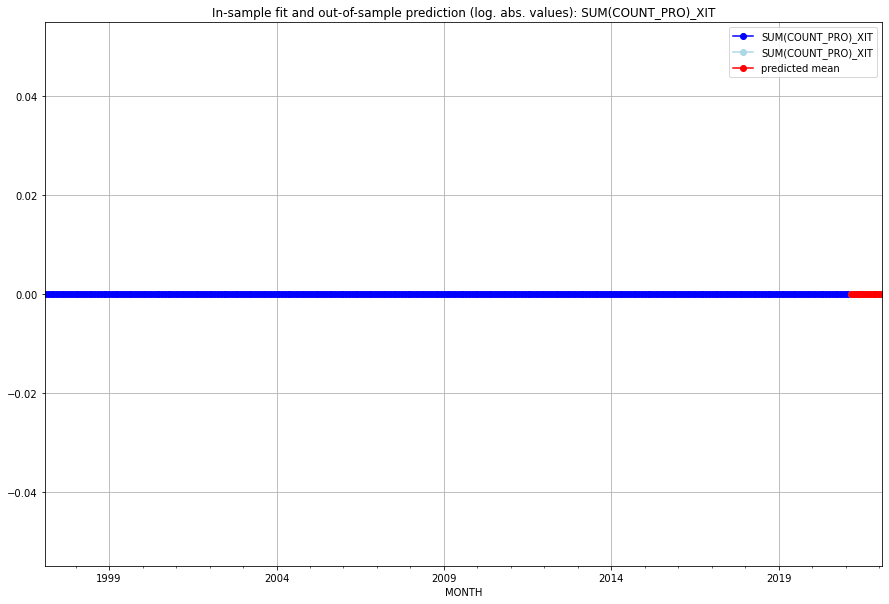

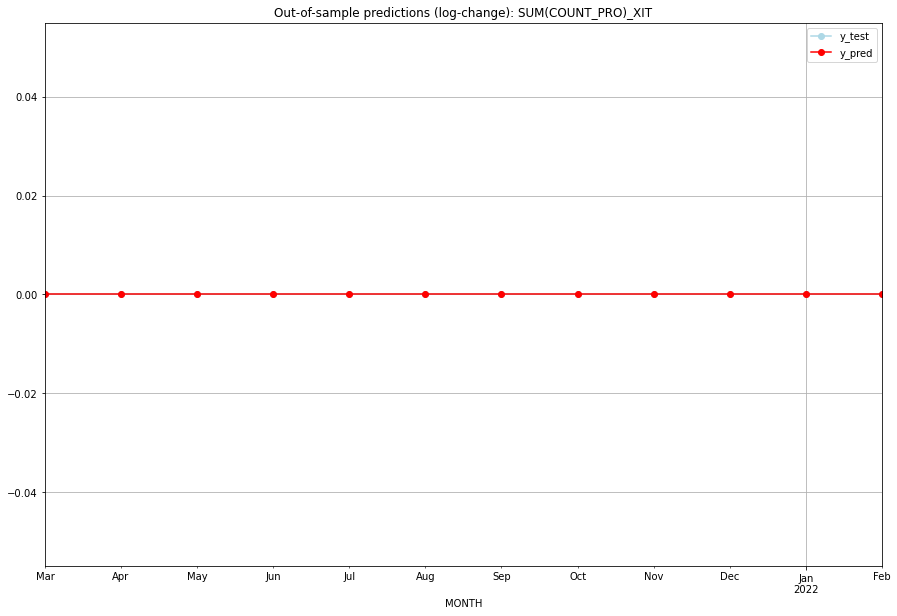

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   XIT   
1  2021-04-01       0.0         0.0           0.0             0.0   XIT   
2  2021-05-01       0.0         0.0           0.0             0.0   XIT   
3  2021-06-01       0.0         0.0           0.0             0.0   XIT   
4  2021-07-01       0.0         0.0           0.0             0.0   XIT   
5  2021-08-01       0.0         0.0           0.0             0.0   XIT   
6  2021-09-01       0.0         0.0           0.0             0.0   XIT   
7  2021-10-01       0.0         0.0           0.0             0.0   XIT   
8  2021-11-01       0.0         0.0           0.0             0.0   XIT   
9  2021-12-01       0.0         0.0           0.0             0.0   XIT   
10 2022-01-01       0.0         0.0           0.0             0.0   XIT   
11 2022-02-01       0.0         0.0           0.0             0.0   

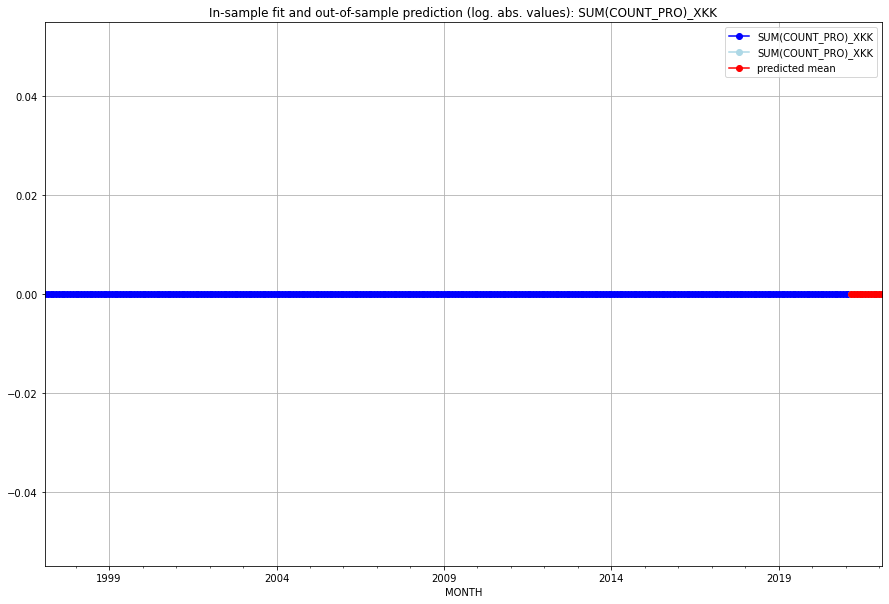

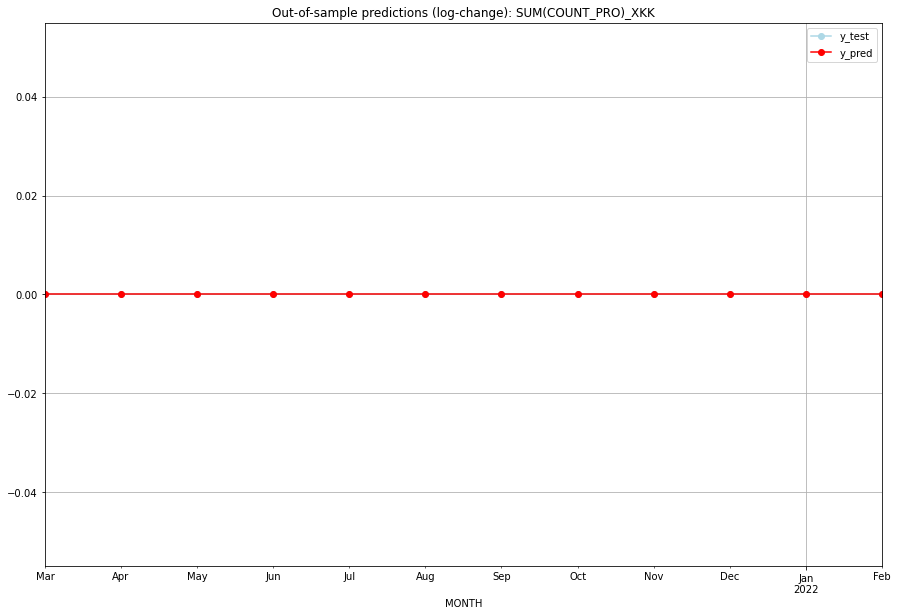

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   XKK   
1  2021-04-01       0.0         0.0           0.0             0.0   XKK   
2  2021-05-01       0.0         0.0           0.0             0.0   XKK   
3  2021-06-01       0.0         0.0           0.0             0.0   XKK   
4  2021-07-01       0.0         0.0           0.0             0.0   XKK   
5  2021-08-01       0.0         0.0           0.0             0.0   XKK   
6  2021-09-01       0.0         0.0           0.0             0.0   XKK   
7  2021-10-01       0.0         0.0           0.0             0.0   XKK   
8  2021-11-01       0.0         0.0           0.0             0.0   XKK   
9  2021-12-01       0.0         0.0           0.0             0.0   XKK   
10 2022-01-01       0.0         0.0           0.0             0.0   XKK   
11 2022-02-01       0.0         0.0           0.0             0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [1, (2, 0, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.31358443251143225, 'fold_results': [0.31358443251143225]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_XKO   No. Observations:                   38
Model:               SARIMAX(2, 0, 3)   Log Likelihood                 -26.968
Date:                Fri, 16 Sep 2022   AIC                             67.936
Time:                        15:14:24   BIC                             79.399
Sample:                    01-31-2018   HQIC                            72.014
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            -0.0291      0.043     -0.681      0.496 

<Figure size 432x288 with 0 Axes>

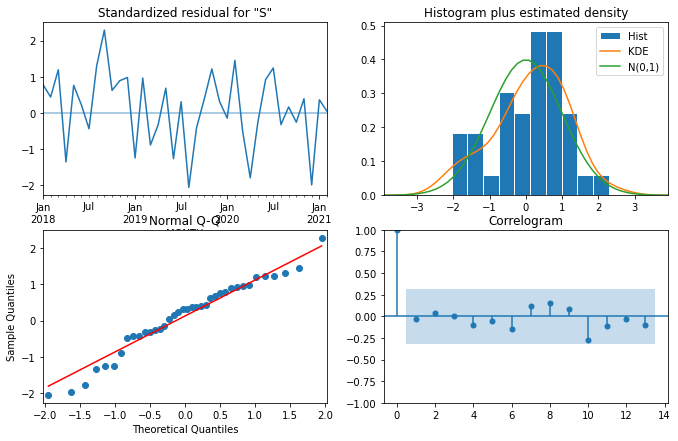

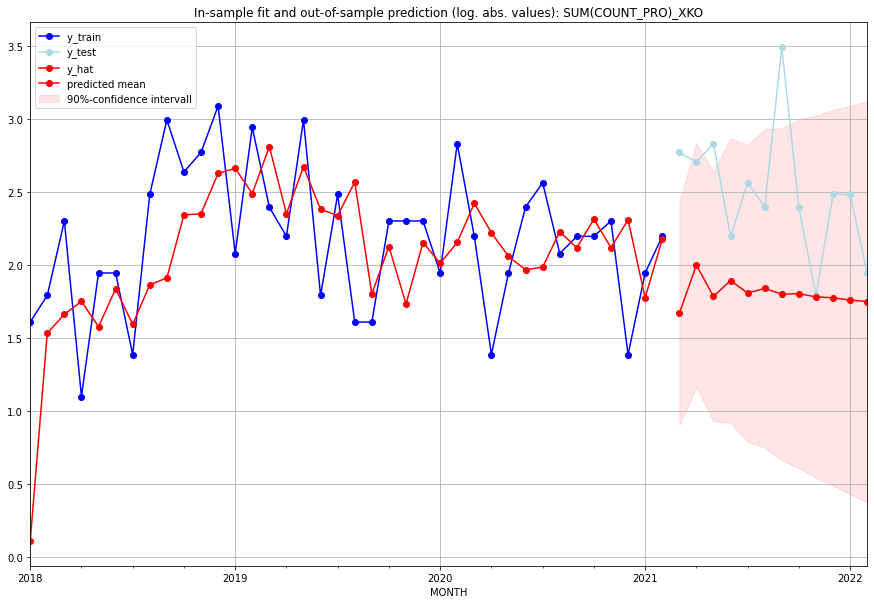

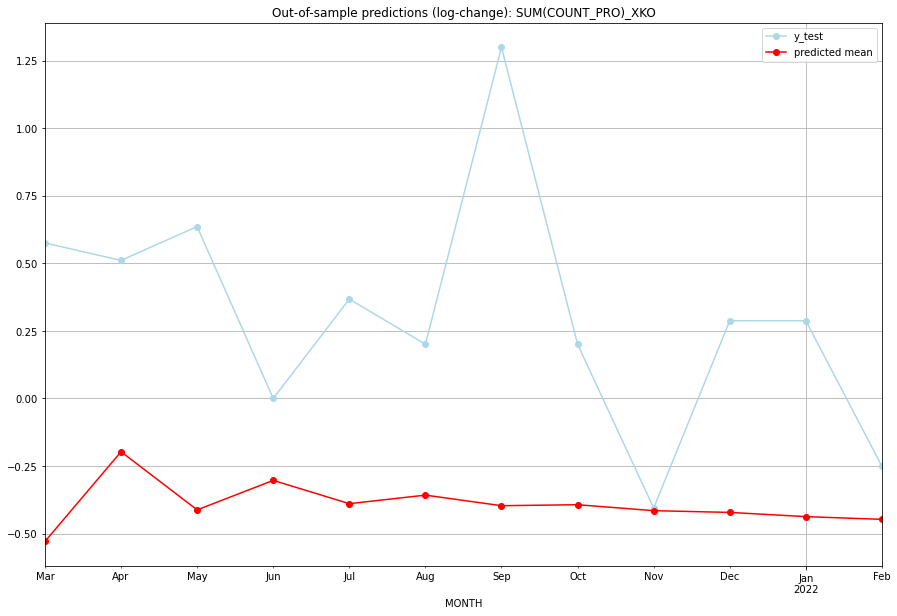

TADDA: 0.9950619799576246
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  4.302311        15.0     -0.529082        0.575364   XKO   
1  2021-04-01  6.390598        14.0     -0.197016        0.510826   XKO   
2  2021-05-01  4.960299        16.0     -0.412104        0.635989   XKO   
3  2021-06-01  5.647052         8.0     -0.303051        0.000000   XKO   
4  2021-07-01  5.098751        12.0     -0.389141        0.367725   XKO   
5  2021-08-01  5.294685        10.0     -0.357519        0.200671   XKO   
6  2021-09-01  5.052986        32.0     -0.396673        1.299283   XKO   
7  2021-10-01  5.074983        10.0     -0.393045        0.200671   XKO   
8  2021-11-01  4.942750         5.0     -0.415053       -0.405465   XKO   
9  2021-12-01  4.904697        11.0     -0.421476        0.287682   XKO   
10 2022-01-01  4.812867        11.0     -0.437151        0.287682   XKO   
11 2022-02-01  4.755235         6.0     -0.447115    

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.4092165281195194, 'fold_results': [0.4092165281195194]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_XNC   No. Observations:                   38
Model:               SARIMAX(0, 1, 0)   Log Likelihood                 -36.573
Date:                Fri, 16 Sep 2022   AIC                             75.145
Time:                        15:14:53   BIC                             76.756
Sample:                    01-31-2018   HQIC                            75.713
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.4227      0.073      5.827      0.000   

<Figure size 432x288 with 0 Axes>

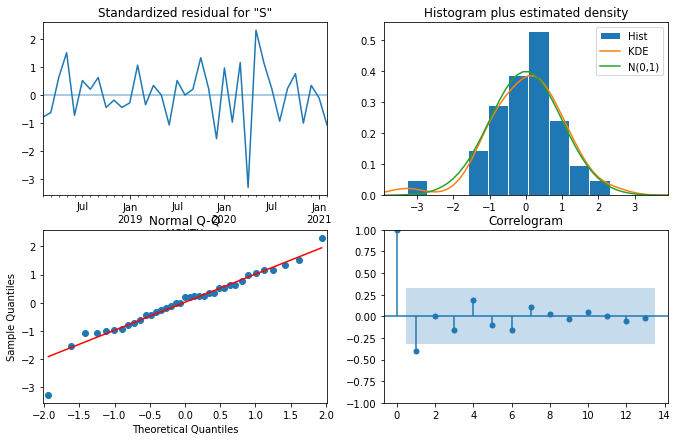

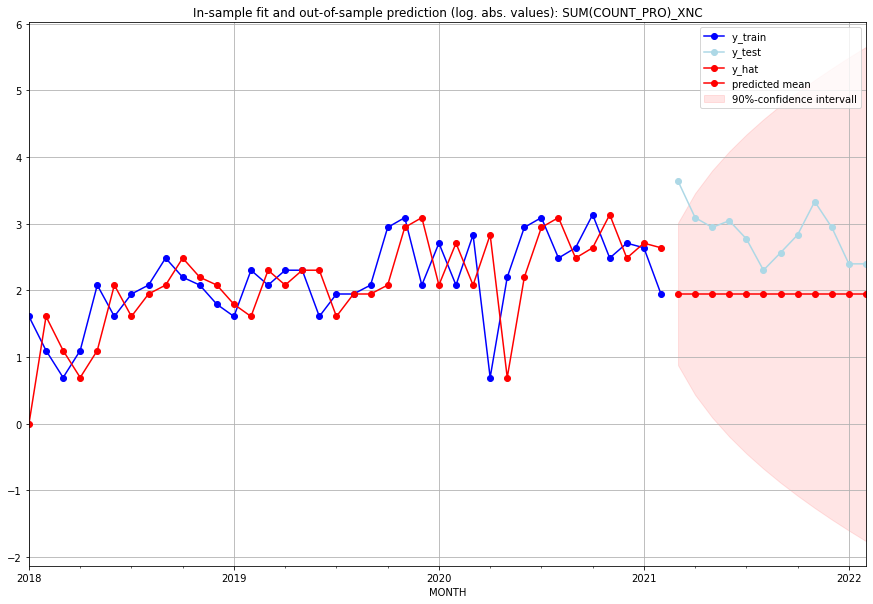

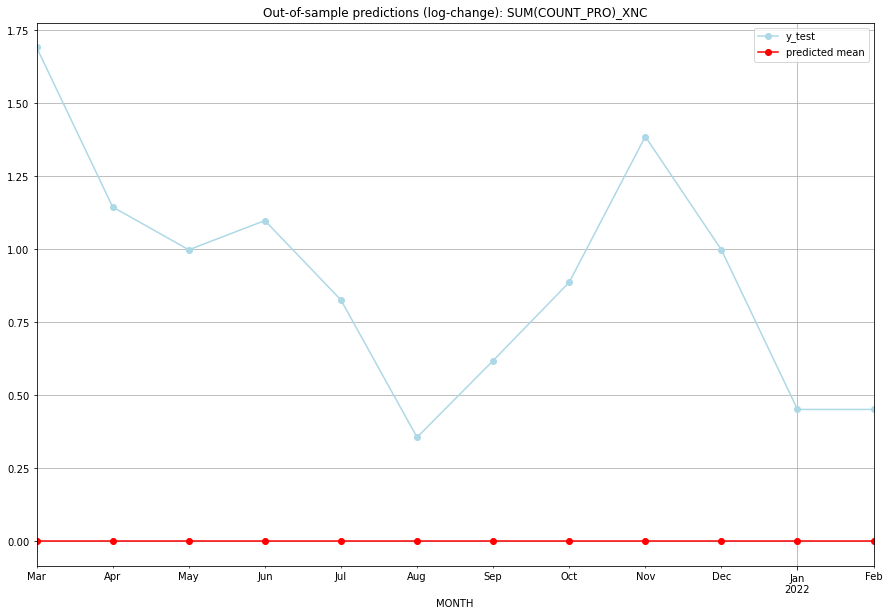

TADDA: 0.9093698994167312
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       6.0        37.0           0.0        1.691676   XNC   
1  2021-04-01       6.0        21.0           0.0        1.145132   XNC   
2  2021-05-01       6.0        18.0           0.0        0.998529   XNC   
3  2021-06-01       6.0        20.0           0.0        1.098612   XNC   
4  2021-07-01       6.0        15.0           0.0        0.826679   XNC   
5  2021-08-01       6.0         9.0           0.0        0.356675   XNC   
6  2021-09-01       6.0        12.0           0.0        0.619039   XNC   
7  2021-10-01       6.0        16.0           0.0        0.887303   XNC   
8  2021-11-01       6.0        27.0           0.0        1.386294   XNC   
9  2021-12-01       6.0        18.0           0.0        0.998529   XNC   
10 2022-01-01       6.0        10.0           0.0        0.451985   XNC   
11 2022-02-01       6.0        10.0           0.0    

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [3, (1, 1, 1), (0, 0, 0, 0), 'n'], 'cv_score': 0.3876915443216886, 'fold_results': [0.3876915443216886]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_YEM   No. Observations:                   74
Model:               SARIMAX(1, 1, 1)   Log Likelihood                 -70.342
Date:                Fri, 16 Sep 2022   AIC                            152.685
Time:                        15:15:23   BIC                            166.428
Sample:                    01-31-2015   HQIC                           158.162
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1             0.1179      0.068      1.732      0.083   

<Figure size 432x288 with 0 Axes>

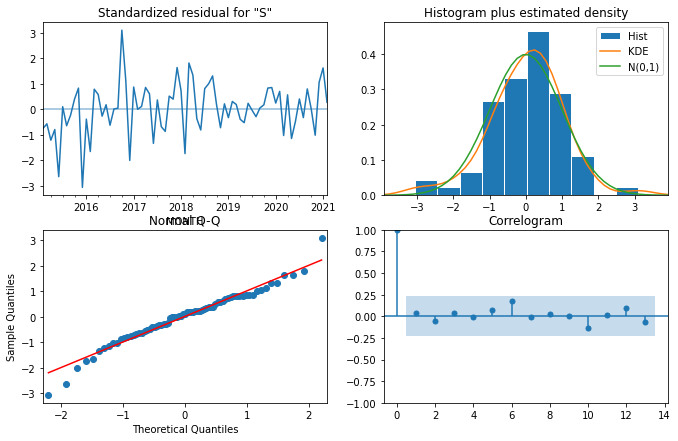

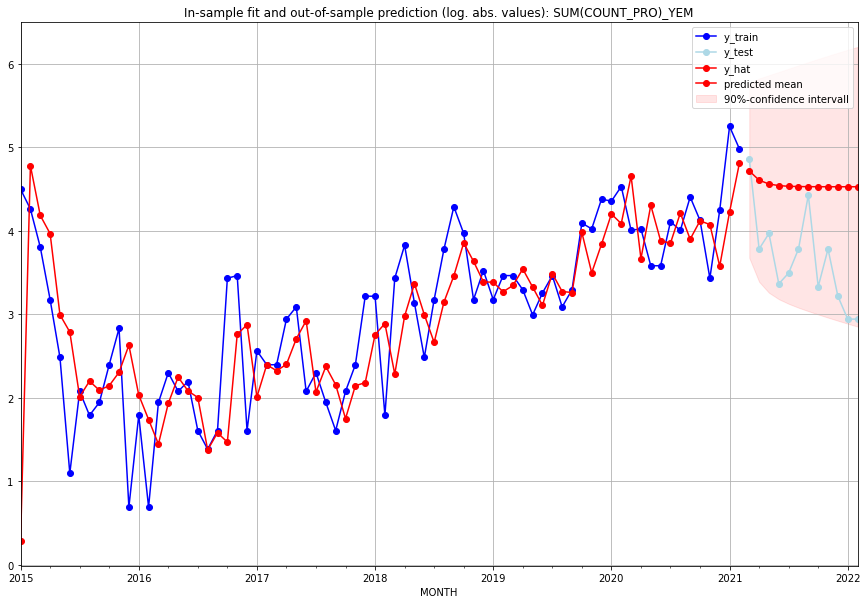

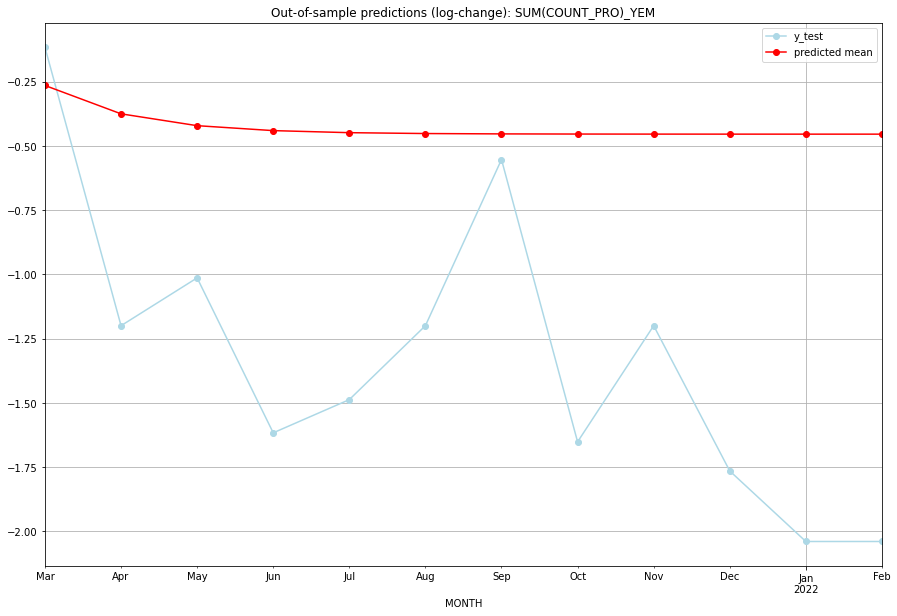

TADDA: 0.9210082975203737
Evaluation finished.
        MONTH    FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  111.063244       129.0     -0.264543       -0.116072   YEM   
1  2021-04-01   99.349403        43.0     -0.374948       -1.199417   YEM   
2  2021-05-01   94.830524        52.0     -0.421025       -1.013315   YEM   
3  2021-06-01   93.005323        28.0     -0.440255       -1.616311   YEM   
4  2021-07-01   92.253907        32.0     -0.448281       -1.487099   YEM   
5  2021-08-01   91.942088        43.0     -0.451630       -1.199417   YEM   
6  2021-09-01   91.812262        83.0     -0.453028       -0.552790   YEM   
7  2021-10-01   91.758133        27.0     -0.453611       -1.651402   YEM   
8  2021-11-01   91.735552        43.0     -0.453855       -1.199417   YEM   
9  2021-12-01   91.726130        24.0     -0.453956       -1.764731   YEM   
10 2022-01-01   91.722198        18.0     -0.453999       -2.039168   YEM   
11 2022-02-01   91.720557    

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [3, (3, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.5926911779245735, 'fold_results': [0.5926911779245735]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_ZAF   No. Observations:                  289
Model:               SARIMAX(3, 1, 0)   Log Likelihood                -255.206
Date:                Fri, 16 Sep 2022   AIC                            524.413
Time:                        15:16:07   BIC                            550.054
Sample:                    02-28-1997   HQIC                           534.688
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1             0.0545      0.032      1.688      0.091   

<Figure size 432x288 with 0 Axes>

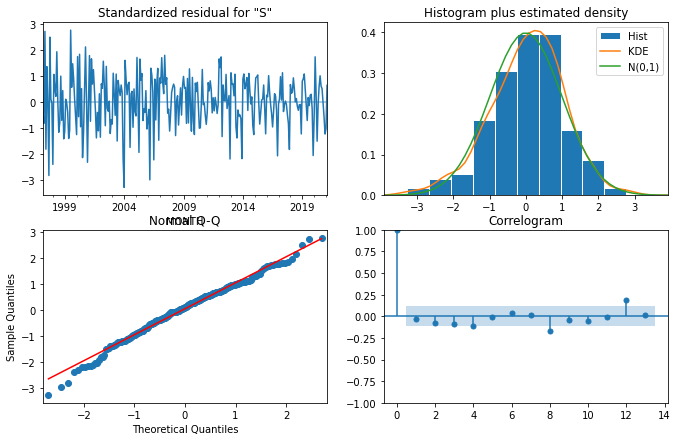

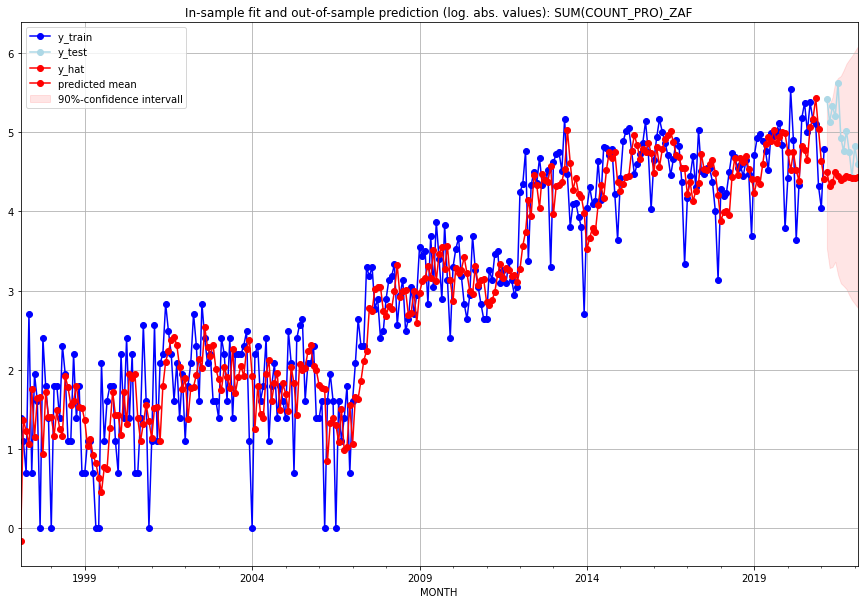

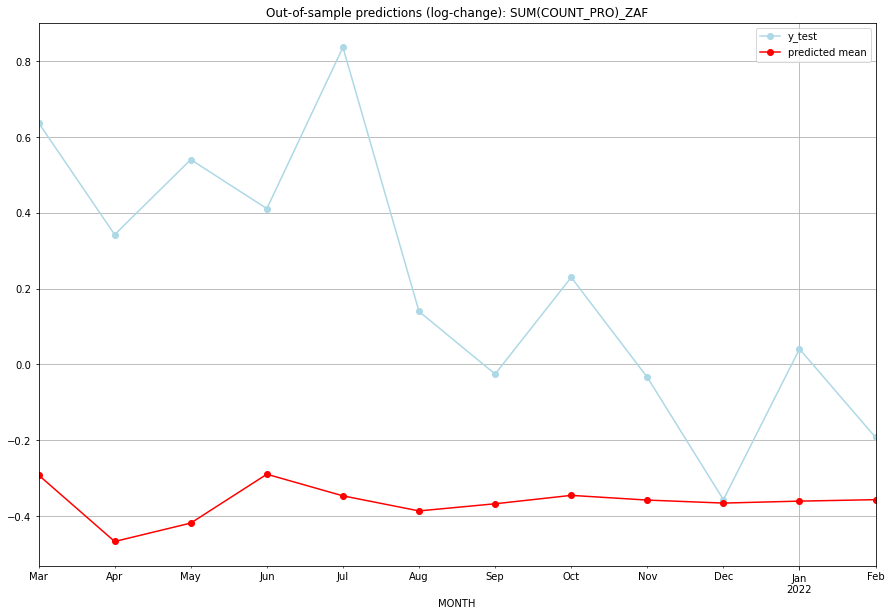

TADDA: 0.8189924271883301
Evaluation finished.
        MONTH   FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  88.635404       226.0     -0.291741        0.637458   ZAF   
1  2021-04-01  74.229158       168.0     -0.466953        0.342407   ZAF   
2  2021-05-01  77.972005       205.0     -0.418398        0.540384   ZAF   
3  2021-06-01  88.833131       180.0     -0.289538        0.411005   ZAF   
4  2021-07-01  83.852569       276.0     -0.346576        0.836526   ZAF   
5  2021-08-01  80.549738       137.0     -0.386279        0.139762   ZAF   
6  2021-09-01  82.097965       116.0     -0.367472       -0.025318   ZAF   
7  2021-10-01  83.960296       150.0     -0.345308        0.229788   ZAF   
8  2021-11-01  82.912346       115.0     -0.357719       -0.033902   ZAF   
9  2021-12-01  82.251633        83.0     -0.365624       -0.356675   ZAF   
10 2022-01-01  82.680511       124.0     -0.360486        0.040822   ZAF   
11 2022-02-01  83.002067        98.0     

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [1, (0, 0, 1), (0, 0, 0, 0), 'n'], 'cv_score': 0.860788823215049, 'fold_results': [0.860788823215049]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_ZMB   No. Observations:                  289
Model:               SARIMAX(0, 0, 1)   Log Likelihood                -433.565
Date:                Fri, 16 Sep 2022   AIC                            873.129
Time:                        15:16:50   BIC                            884.128
Sample:                    02-28-1997   HQIC                           877.536
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1             0.0823      0.027      3.084      0.002     

<Figure size 432x288 with 0 Axes>

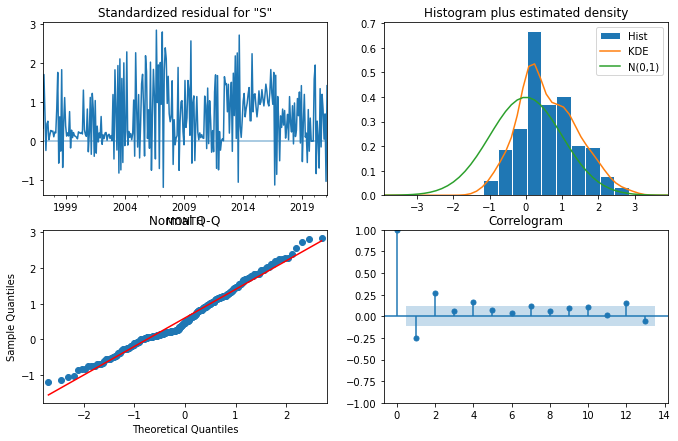

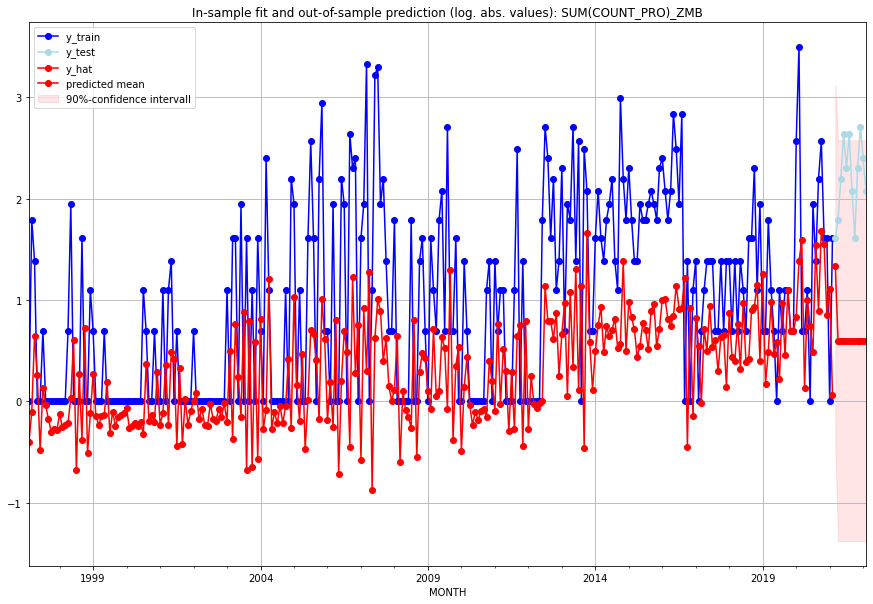

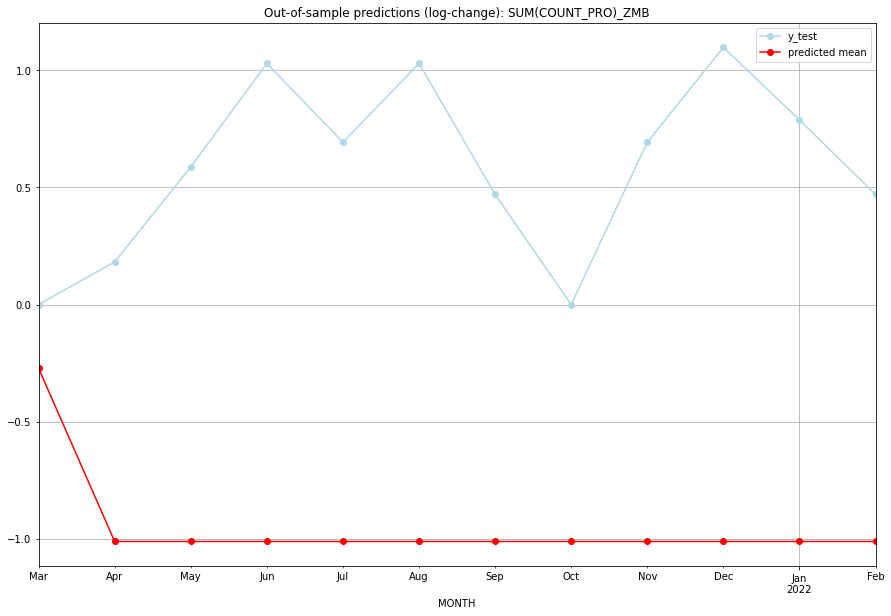

TADDA: 2.3806099171625696
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  2.808711         4.0     -0.272147        0.000000   ZMB   
1  2021-04-01  0.817417         5.0     -1.012022        0.182322   ZMB   
2  2021-05-01  0.817417         8.0     -1.012022        0.587787   ZMB   
3  2021-06-01  0.817417        13.0     -1.012022        1.029619   ZMB   
4  2021-07-01  0.817417         9.0     -1.012022        0.693147   ZMB   
5  2021-08-01  0.817417        13.0     -1.012022        1.029619   ZMB   
6  2021-09-01  0.817417         7.0     -1.012022        0.470004   ZMB   
7  2021-10-01  0.817417         4.0     -1.012022        0.000000   ZMB   
8  2021-11-01  0.817417         9.0     -1.012022        0.693147   ZMB   
9  2021-12-01  0.817417        14.0     -1.012022        1.098612   ZMB   
10 2022-01-01  0.817417        10.0     -1.012022        0.788457   ZMB   
11 2022-02-01  0.817417         7.0     -1.012022    

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [2, (1, 0, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.5108128979181896, 'fold_results': [0.5108128979181896]}
Training finished.
                               SARIMAX Results                                
Dep. Variable:     SUM(COUNT_PRO)_ZWE   No. Observations:                  289
Model:               SARIMAX(1, 0, 3)   Log Likelihood                -312.139
Date:                Fri, 16 Sep 2022   AIC                            638.279
Time:                        15:17:28   BIC                            663.944
Sample:                    02-28-1997   HQIC                           648.562
                         - 02-28-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1             0.0093      0.041      0.228      0.820   

<Figure size 432x288 with 0 Axes>

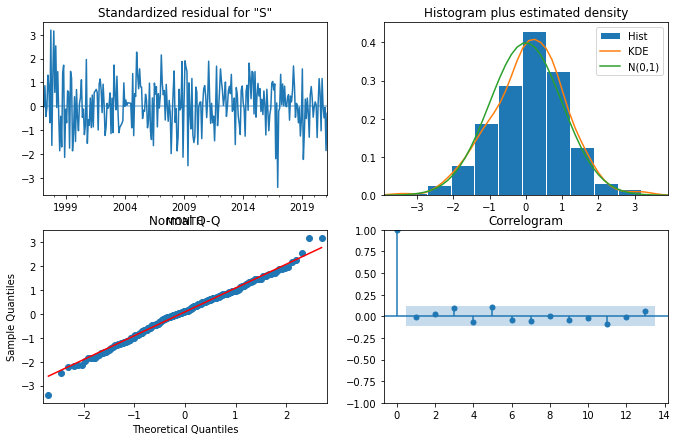

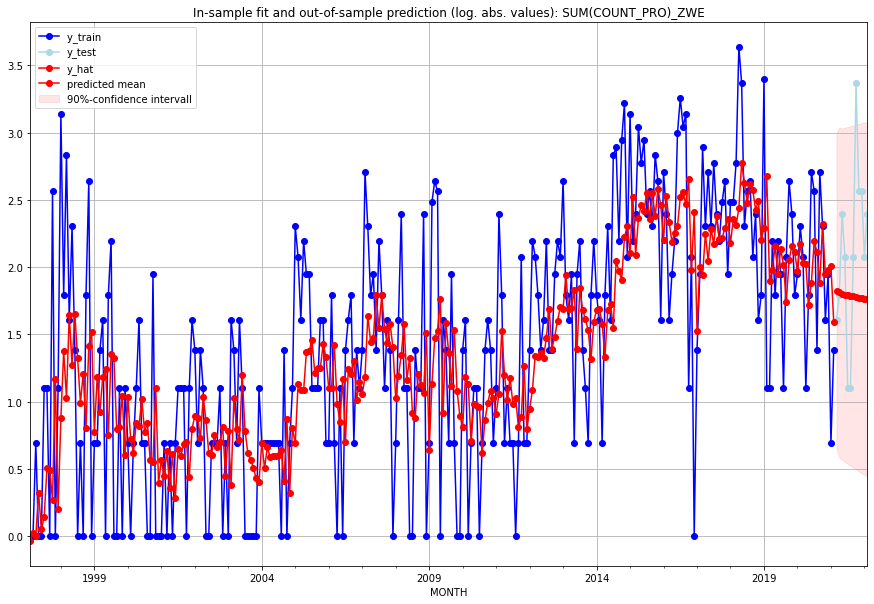

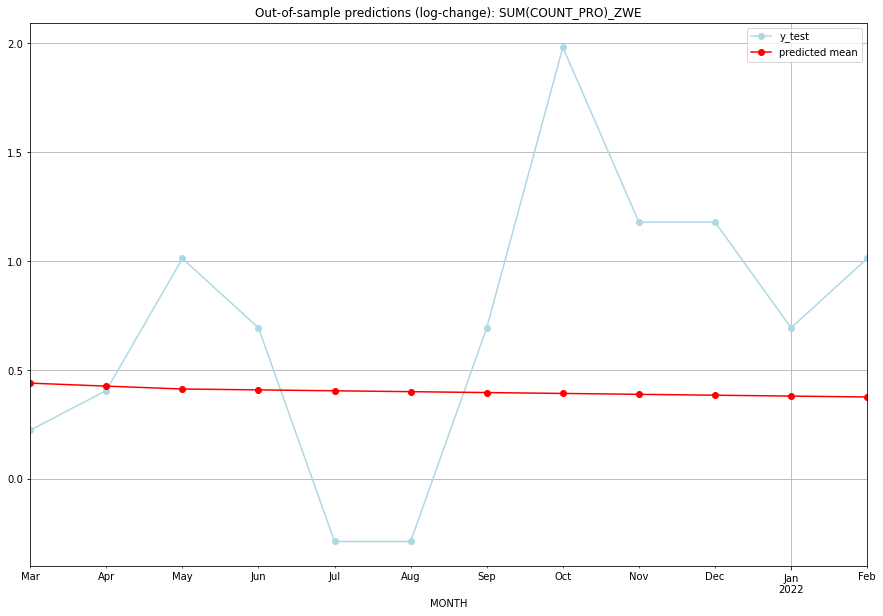

TADDA: 0.6437546157593176
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  5.206633         4.0      0.439324        0.223144   ZWE   
1  2021-04-01  5.121915         5.0      0.425581        0.405465   ZWE   
2  2021-05-01  5.041839        10.0      0.412414        1.011601   ZWE   
3  2021-06-01  5.017093         7.0      0.408310        0.693147   ZWE   
4  2021-07-01  4.992505         2.0      0.404215       -0.287682   ZWE   
5  2021-08-01  4.968075         2.0      0.400130       -0.287682   ZWE   
6  2021-09-01  4.943801         7.0      0.396054        0.693147   ZWE   
7  2021-10-01  4.919683        28.0      0.391988        1.981001   ZWE   
8  2021-11-01  4.895718        12.0      0.387932        1.178655   ZWE   
9  2021-12-01  4.871906        12.0      0.383885        1.178655   ZWE   
10 2022-01-01  4.848245         7.0      0.379847        0.693147   ZWE   
11 2022-02-01  4.824735        10.0      0.375819    

In [8]:
# warnings.simplefilter(action='ignore')

varimax_res = pd.DataFrame(columns=["MONTH", "FAT_PRED", "FAT_ACTUAL", "LC(FAT_PRED)", "LC(FAT_ACTUAL)", "GID_0", "PARAMETERS", "TIMESTAMP"])
csv_file = "../data/"+MODEL_NAME+"_PREDICTIONS.csv"

if os.path.exists(csv_file):
    existing_res = pd.read_csv("../data/"+MODEL_NAME+"_PREDICTIONS.csv")
    # print(existing_res)
    print("File already exists.")
    
else:
    varimax_res.to_csv(csv_file, index=False, mode="a", header=True)
    existing_res = varimax_res

for i, g in enumerate(gid_list):
# for i, g in enumerate(["XNC"]):
    print("######## "+g+" ("+str(i+1)+"/"+str(len(gid_list))+") #########")
    # print(existing_res[existing_res["GID_0"] == g])
    print(len(existing_res[existing_res["GID_0"] == g]))
    
    
    # skip country if results already exiast
    if len(existing_res[existing_res["GID_0"] == g]) > 0:
        print("Model for this country has already been fitted.")
        continue
    
    # add time series of neighboring  countries as predictor variables

    if NEIGHBORS == True:
        neighbor = gid0_neighbors[gid0_neighbors["GID_0"] == g]["NEIGHBOUR"].tolist()
    else:
        neighbor = []
    print("Neighbor countries: "+ str(neighbor))

    # measure time 
    st = time.time()

    res = varimax(target_variable = TARGET_VARIABLE,
                  target_country = g,
                  predictor_countries = neighbor,
                  n_lags_X = N_LAGS_X,
                  seasonal_periodicity = SEASONAL_PERIODICITY)

    # append country results to csv with timestamp
    res["TIMESTAMP"] = datetime.datetime.now()
    
    res.to_csv(csv_file, index=False, mode="a", header=False)

    et = time.time()
    elapsed_time = et - st
    print('Execution time:', time.strftime("%M:%S", time.gmtime(elapsed_time)))

    varimax_res = pd.concat([varimax_res, res], ignore_index=True)

    # break

In [9]:
# varimax_res.to_csv("../data/"+MODEL_NAME+"_PREDICTIONS.csv", index=False)

In [10]:
varimax_res

,MONTH,FAT_PRED,FAT_ACTUAL,LC(FAT_PRED),LC(FAT_ACTUAL),GID_0,PARAMETERS,TIMESTAMP
0,2021-03-01,0.000000,0.0,0.000000,0.000000,ABW,"{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...",2022-09-16 13:46:10.600810
1,2021-04-01,0.000000,0.0,0.000000,0.000000,ABW,"{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...",2022-09-16 13:46:10.600810
2,2021-05-01,0.000000,0.0,0.000000,0.000000,ABW,"{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...",2022-09-16 13:46:10.600810
3,2021-06-01,0.000000,0.0,0.000000,0.000000,ABW,"{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...",2022-09-16 13:46:10.600810
4,2021-07-01,0.000000,0.0,0.000000,0.000000,ABW,"{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...",2022-09-16 13:46:10.600810
...,...,...,...,...,...,...,...,...
2803,2021-10-01,4.919683,28.0,0.391988,1.981001,ZWE,"{'params': [2, (1, 0, 3), (0, 0, 0, 0), 'n'], ...",2022-09-16 15:17:31.046341
2804,2021-11-01,4.895718,12.0,0.387932,1.178655,ZWE,"{'params': [2, (1, 0, 3), (0, 0, 0, 0), 'n'], ...",2022-09-16 15:17:31.046341
2805,2021-12-01,4.871906,12.0,0.383885,1.178655,ZWE,"{'params': [2, (1, 0, 3), (0, 0, 0, 0), 'n'], ...",2022-09-16 15:17:31.046341
2806,2022-01-01,4.848245,7.0,0.379847,0.693147,ZWE,"{'params': [2, (1, 0, 3), (0, 0, 0, 0), 'n'], ...",2022-09-16 15:17:31.046341


In [11]:
!jupyter nbextension enable --py widgetsnbextension

Enabling notebook extension jupyter-js-widgets/extension...
      - Validating: ok
